# Multilevel atom from their tutorial

In [2]:
import math
import meep as mp

# This file realizes a 1D, one-sided Fabry-Perot laser, as described in Fig. 2 of Optics Express, Vol. 20, pp. 474-88, 2012.

# Cavity definitions
resolution = 400
ncav = 1.5        # cavity refractive index
Lcav = 1          # cavity length
dpad = 1          # padding thickness
dpml = 1          # PML thickness
sz = Lcav + dpad + dpml
cell_size = mp.Vector3(z=sz)
dimensions = 1
pml_layers = [mp.PML(dpml, side=mp.High)]



In [6]:
# For defining laser properties in MEEP, the transition rates / frequencies are specified in units of 2*pi*a/c.
# gamma_21 in MEEP is the Full-Width Half-Max, as opposed to gamma_perp, which is the HWHM in SALT.
# Additionally, the classical coupling element sigma = 2*theta^2*omega_a/hbar, where
# theta is the off-diagonal dipole matrix element.

# These different conventions can cause a bit of confusion when comparing against SALT, so here we perform
# this transformation explicitly.

omega_a = 40                           # omega_a in SALT
freq_21 = omega_a/(2*math.pi)          # emission frequency  (units of 2πc/a)

gamma_perp = 4                         # HWHM in angular frequency, SALT
gamma_21 = (2*gamma_perp)/(2*math.pi)  # FWHM emission linewidth in sec^-1 (units of 2πc/a)
# Note that 2*pi*gamma_21 = 2*gamma_perp in SALT.

theta = 1                              # theta, the off-diagonal dipole matrix element, in SALT
sigma_21 = 2*theta*theta*omega_a       # dipole coupling strength (hbar = 1)

# The gain medium in MEEP is allowed to have an arbitrary number of levels, and is not
# restricted to a two-level gain medium, as it simulates the populations of every individual
# atomic energy level.

# If you are using a 2 level gain model, you can compare against
# results which only simulate the atomic inversion, using the definitions
# gamma_parallel = pumping_rate + rate_21
# D_0 = (pumping_rate - rate_21)/(pumping_rate + rate_21) * N0

# In fact, even if you arn't using a 2 level gain model, you can compare against an effective
# two level model using the formula provided in Cerjan et al., Opt. Express 20, 474 (2012).

# Here, D_0 as written above is not yet in "SALT" units. To make this conversion,
# D_0 (SALT) = theta^2/(hbar*gamma_perp) * D_0 (as written above)

# Finally, note the lack of 4*pi in the above conversion that is written in many published SALT papers.
# This 4*pi comes from using Gaussian units, in which the displacement field, D = E + 4*pi*P, whereas
# in SI units, D = eps0*E + P, which is what MEEP uses.

# Gain medium pump and decay rates are specified in units of c/a.

rate_21 = 0.005        # non-radiative rate  (units of c/a)
N0 = 37                # initial population density of ground state
Rp = 0.0051            # pumping rate of ground to excited state
# so for example, these parameters have D_0 (SALT) = 0.0693.

In [16]:
# Make the actual medium in MEEP:
transitions = [mp.Transition(1, 2, pumping_rate=Rp, frequency=freq_21, gamma=gamma_21,
                             sigma_diag=mp.Vector3(sigma_21,0,0)),
               mp.Transition(2, 1, transition_rate=rate_21)]
ml_atom = mp.MultilevelAtom(sigma=1, transitions=transitions, initial_populations=[N0])
two_level = mp.Medium(index=ncav, E_susceptibilities=[ml_atom])

# Specify the cavity geometry:
geometry = [mp.Block(center=mp.Vector3(z=-0.5*sz+0.5*Lcav),
                     size=mp.Vector3(mp.inf,mp.inf,Lcav), material=two_level)]

sim = mp.Simulation(cell_size=cell_size,
                    resolution=resolution,
                    boundary_layers=pml_layers,
                    geometry=geometry,
                    dimensions=dimensions)

In [23]:
sim.init_sim()

def field_func(p):
    return 1 if p.z==-0.5*sz + 0.5*Lcav else 0

sim.fields.initialize_field(mp.Ex, field_func)

# Specify the end time:
endt = 700
# Note that the total number of time steps run is endt*resolution*2. This is the origin of the extra
# factor of 2 in the definition of dt in fieldfft_meep.m.

x = []
y = []
def print_field(sim):
    fp = sim.get_field_point(mp.Ex, mp.Vector3(z=(-0.5 * sz) + Lcav + (0.5 * dpad))).real
    x.append(sim.meep_time())
    y.append(fp)
    print("field:, {}, {}".format(sim.meep_time(), fp))

In [24]:
sim.run(mp.after_time(endt - 250, print_field), until=endt)

FloatProgress(value=700.0, description='0% done ', max=1400.0, min=700.0)

field:, 700.0, -3.536794757034517e-05
on time step 560000 (time=700), 0.0183957 s/step
field:, 700.00125, -3.787593592945786e-05
field:, 700.0025, -2.3568962409030066e-05
field:, 700.00375, 1.2001735773211518e-06
field:, 700.005, 2.543456511941173e-05
field:, 700.00625, 3.837556366772646e-05
field:, 700.0075, 3.427898761581408e-05
field:, 700.00875, 1.496481746913245e-05
field:, 700.01, -1.0991366099205703e-05
field:, 700.01125, -3.206598114461009e-05
field:, 700.0125, -3.8903487481467157e-05
field:, 700.01375, -2.84695402767965e-05
field:, 700.015, -5.397567928491679e-06
field:, 700.01625, 2.0068807580848906e-05
field:, 700.0175, 3.662379185359895e-05
field:, 700.0187500000001, 3.691862410881554e-05
field:, 700.02, 2.0823692201478354e-05
field:, 700.02125, -4.514495680356642e-06
field:, 700.0225, -2.784652147181422e-05
field:, 700.0237500000001, -3.881447224573743e-05
field:, 700.025, -3.2550184183683027e-05
field:, 700.02625, -1.1835992585849231e-05
field:, 700.0275, 1.41310670768493

field:, 701.47125, -0.01766068743457877
field:, 701.4725, -0.02049892240197578
field:, 701.47375, -0.019854659778517452
field:, 701.475, -0.015820361664407093
field:, 701.47625, -0.00907072354343897
field:, 701.4775, -0.000753013118040418
field:, 701.47875, 0.007704873088676251
field:, 701.48, 0.014837325164192661
field:, 701.48125, 0.019394486286812958
field:, 701.4825, 0.020563103290406125
field:, 701.48375, 0.018115854442234285
field:, 701.485, 0.012461181285640008
field:, 701.48625, 0.0045818826344068316
field:, 701.4875000000001, -0.004130118903925806
field:, 701.48875, -0.012116503820048264
field:, 701.49, -0.017931219392579016
field:, 701.49125, -0.02050515629993763
field:, 701.4925000000001, -0.019347525659006867
field:, 701.49375, -0.014644706258075253
field:, 701.495, -0.007235450257155461
field:, 701.49625, 0.001535731094171917
field:, 701.4975000000001, 0.01006184916778592
field:, 701.49875, 0.01676919473534852
field:, 701.5, 0.020410557763888067
field:, 701.50125, 0.020300

field:, 702.72, 0.009984488321403882
field:, 702.72125, 0.011473679474918626
field:, 702.7225, 0.008104460295633713
field:, 702.72375, 0.001171492700874706
field:, 702.725, -0.006630251849512147
field:, 702.72625, -0.012267566625472019
field:, 702.7275, -0.013564124561538809
field:, 702.72875, -0.01005769684807603
field:, 702.73, -0.0031816331924842765
field:, 702.73125, 0.004300927035228485
field:, 702.7325, 0.009387045370308243
field:, 702.73375, 0.010018377214711525
field:, 702.735, 0.00589287765585398
field:, 702.73625, -0.0014163279417832176
field:, 702.7375000000001, -0.009081768805618694
field:, 702.73875, -0.014137152615797366
field:, 702.74, -0.014647339572792394
field:, 702.74125, -0.010470981885452903
field:, 702.7425000000001, -0.00331480146848373
field:, 702.74375, 0.003941867048276
field:, 702.745, 0.008385477985076275
field:, 702.74625, 0.008219971423667878
field:, 702.7475000000001, 0.0034768359037383456
field:, 702.74875, -0.0039969389023009234
field:, 702.75, -0.01126

field:, 703.97, 0.015334794197434536
field:, 703.97125, 0.017304472085553826
field:, 703.9725, 0.013667238334444434
field:, 703.97375, 0.006022210780368943
field:, 703.975, -0.0028227933766159837
field:, 703.97625, -0.009926749478795668
field:, 703.9775, -0.013248188754605667
field:, 703.97875, -0.012253796361442117
field:, 703.98, -0.007912679174978983
field:, 703.98125, -0.0021401119158254364
field:, 703.9825, 0.0030347937703054193
field:, 703.98375, 0.006219087395376011
field:, 703.985, 0.007034792843237703
field:, 703.98625, 0.006022063083143068
field:, 703.9875000000001, 0.004176008510464952
field:, 703.98875, 0.0023758282341393862
field:, 703.99, 0.0009879137481887536
field:, 703.99125, -0.00018239299908743472
field:, 703.9925000000001, -0.0015985022283000953
field:, 703.99375, -0.003539609755967201
field:, 703.995, -0.00574749279780468
field:, 703.99625, -0.007385374538970714
field:, 703.9975000000001, -0.007366316706034003
field:, 703.99875, -0.004918723279875659
field:, 704.0,

field:, 705.21875, 0.00935735002569604
field:, 705.22, 0.007454662050202093
field:, 705.22125, 0.0031298890272299477
field:, 705.2225, -0.0019602089683539922
field:, 705.22375, -0.006028447136513121
field:, 705.225, -0.007795716027118032
field:, 705.22625, -0.006877256022237403
field:, 705.2275, -0.003807787647194817
field:, 705.22875, 0.0002545061386746159
field:, 705.23, 0.003991586598160454
field:, 705.23125, 0.006365492404319936
field:, 705.2325, 0.006885788584866381
field:, 705.23375, 0.005648730049513476
field:, 705.235, 0.003189149350930274
field:, 705.23625, 0.00024530326137570547
field:, 705.2375000000001, -0.002459698335985572
field:, 705.23875, -0.004358459068485754
field:, 705.24, -0.00509797344431396
field:, 705.24125, -0.00455238934289926
field:, 705.2425000000001, -0.002829330999436004
field:, 705.24375, -0.0002806196032054996
field:, 705.245, 0.0025092688367757774
field:, 705.24625, 0.004801556253283556
field:, 705.2475000000001, 0.005874066727276027
field:, 705.24875, 

field:, 706.46875, 0.005626032025591216
field:, 706.47, -0.0006133510551375688
field:, 706.47125, -0.005809594712325621
field:, 706.4725, -0.007965870864476038
field:, 706.47375, -0.006366308790399889
field:, 706.475, -0.0018151345504312487
field:, 706.47625, 0.0037343667155274917
field:, 706.4775, 0.007994245314904997
field:, 706.47875, 0.00926204018404101
field:, 706.48, 0.00707859635533034
field:, 706.48125, 0.0023724850422249645
field:, 706.4825, -0.0029475752694514273
field:, 706.48375, -0.0067713049583279705
field:, 706.485, -0.0076163695325528495
field:, 706.48625, -0.005181984500101467
field:, 706.4875000000001, -0.00042228211530017604
field:, 706.48875, 0.004867615336856469
field:, 706.49, 0.008769346254655759
field:, 706.49125, 0.00997045325997454
field:, 706.4925000000001, 0.008223678667374744
field:, 706.49375, 0.004375466741740097
field:, 706.495, -2.13741918615026e-05
field:, 706.49625, -0.003336618581648902
field:, 706.4975000000001, -0.004477445913620636
field:, 706.498

field:, 707.77, 0.0019725116950426932
field:, 707.77125, -0.003719738810629737
field:, 707.7725, -0.00802125092674167
field:, 707.7737500000001, -0.00907698115155215
field:, 707.775, -0.006402275114949143
field:, 707.77625, -0.0010893021686039644
field:, 707.7775, 0.004648689009881952
field:, 707.7787500000001, 0.008403388755523836
field:, 707.78, 0.008579479553711446
field:, 707.78125, 0.005063179826952034
field:, 707.7825, -0.0007272452982744447
field:, 707.78375, -0.006428711859108277
field:, 707.785, -0.009712038080121742
field:, 707.78625, -0.009243915142213142
field:, 707.7875, -0.005232871649557942
field:, 707.78875, 0.0006648332594009904
field:, 707.79, 0.006036186869430898
field:, 707.79125, 0.008708743090911589
field:, 707.7925, 0.007639206187715351
field:, 707.79375, 0.0033272022684635947
field:, 707.795, -0.002411290100513255
field:, 707.79625, -0.00720924409993844
field:, 707.7975, -0.009129129777620438
field:, 707.79875, -0.007450341737768689
field:, 707.8000000000001, -0

field:, 709.1025, 0.00904690447739535
field:, 709.10375, 0.008120900812686791
field:, 709.105, 0.004270317442563982
field:, 709.10625, -0.0008661107811175706
field:, 709.1075, -0.005115457524916574
field:, 709.10875, -0.006685389468299122
field:, 709.11, -0.004915202471829088
field:, 709.11125, -0.0005483488304234563
field:, 709.1125000000001, 0.004585631158176084
field:, 709.11375, 0.008343091435865155
field:, 709.115, 0.009165575491674965
field:, 709.11625, 0.006728321844595757
field:, 709.1175000000001, 0.002067601629821997
field:, 709.11875, -0.0028628828061663426
field:, 709.12, -0.006016353806104855
field:, 709.12125, -0.0061095852324701255
field:, 709.1225000000001, -0.003152572972895336
field:, 709.12375, 0.0015678389969932482
field:, 709.125, 0.006038580308929573
field:, 709.12625, 0.008369560494614108
field:, 709.1275, 0.007582885478002038
field:, 709.12875, 0.004012195176865967
field:, 709.13, -0.0008510182359152312
field:, 709.13125, -0.00499382397300264
field:, 709.1325, -

field:, 710.42375, 0.005732969687113002
field:, 710.4250000000001, 0.003982391179736453
field:, 710.42625, -0.00023222883300507303
field:, 710.4275, -0.005137751160465154
field:, 710.42875, -0.008662200769740933
field:, 710.4300000000001, -0.009311929845314738
field:, 710.43125, -0.006804154038276733
field:, 710.4325, -0.002187095370416308
field:, 710.43375, 0.0026026976268245412
field:, 710.4350000000001, 0.005557864363969494
field:, 710.43625, 0.005446270659947905
field:, 710.4375, 0.0023280032749349302
field:, 710.43875, -0.0024740483663370843
field:, 710.44, -0.006935621905018748
field:, 710.44125, -0.009185315005444497
field:, 710.4425, -0.008289784170781508
field:, 710.44375, -0.0046391088778619995
field:, 710.445, 0.00022768034839156827
field:, 710.44625, 0.004279436016327975
field:, 710.4475, 0.005851414621748786
field:, 710.44875, 0.004341704585681198
field:, 710.45, 0.00045314315772617244
field:, 710.45125, -0.004117207103788809
field:, 710.4525, -0.007404643501615795
field:,

field:, 711.55625, 0.0029254802341818964
field:, 711.5575, 0.006360939389820583
field:, 711.55875, 0.007405347881794935
field:, 711.5600000000001, 0.0056307088111314605
field:, 711.56125, 0.0018110546496689695
field:, 711.5625, -0.0024144623351552773
field:, 711.56375, -0.0052459107764684775
field:, 711.565, -0.005491668258700132
field:, 711.56625, -0.003073207070005136
field:, 711.5675, 0.0009489105063926646
field:, 711.56875, 0.004836390986327455
field:, 711.57, 0.006921759670130333
field:, 711.57125, 0.00632187991192474
field:, 711.5725, 0.003310826484215159
field:, 711.57375, -0.0008058980579560416
field:, 711.575, -0.004259069204230399
field:, 711.57625, -0.005579193873579446
field:, 711.5775, -0.004226649284499865
field:, 711.57875, -0.0008182920039869097
field:, 711.58, 0.0031449433747571063
field:, 711.5812500000001, 0.005929876104843796
field:, 711.5825, 0.00632000498807667
field:, 711.58375, 0.004138546992969153
field:, 711.585, 0.00032111720507563973
field:, 711.586250000000

field:, 712.905, -0.007261320082303827
field:, 712.90625, -0.006629496239392692
field:, 712.9075, -0.0042156125294326875
field:, 712.90875, -0.0009781651584725498
field:, 712.91, 0.0017642636755297722
field:, 712.91125, 0.002891072102092066
field:, 712.9125, 0.0019597309651559203
field:, 712.91375, -0.0005983474089807147
field:, 712.915, -0.0036531036026190844
field:, 712.91625, -0.005851265085236079
field:, 712.9175, -0.006191633650109352
field:, 712.91875, -0.004455169826942402
field:, 712.92, -0.0013046426255922472
field:, 712.92125, 0.001991587682362269
field:, 712.9225, 0.004096537181153525
field:, 712.92375, 0.004174609999499094
field:, 712.9250000000001, 0.0022510539553933276
field:, 712.92625, -0.000794315494404437
field:, 712.9275, -0.0035986893598215462
field:, 712.92875, -0.004896206433449796
field:, 712.9300000000001, -0.004059126731354935
field:, 712.93125, -0.0013683644972950822
field:, 712.9325, 0.002103654154510423
field:, 712.93375, 0.004949168996070341
field:, 712.935

field:, 714.255, 0.00044858774171947086
field:, 714.25625, 0.0030864144003834642
field:, 714.2575, 0.00413208963874106
field:, 714.25875, 0.0030772980182011294
field:, 714.26, 0.00030738376137330733
field:, 714.26125, -0.003055362995782876
field:, 714.2625, -0.005624678026984706
field:, 714.26375, -0.006339730046542228
field:, 714.265, -0.004919955599934451
field:, 714.26625, -0.0019901803368259185
field:, 714.2675, 0.0011794789769259766
field:, 714.2687500000001, 0.003210293631963533
field:, 714.27, 0.0032009351672138827
field:, 714.27125, 0.00111338922366003
field:, 714.2725, -0.002206520667681065
field:, 714.2737500000001, -0.005384315702903794
field:, 714.275, -0.00709811555950648
field:, 714.27625, -0.006639592543506155
field:, 714.2775, -0.0042161510448848905
field:, 714.2787500000001, -0.0008652826940592859
field:, 714.28, 0.001983381485862716
field:, 714.28125, 0.0031130440053513905
field:, 714.2825, 0.0020352635192911715
field:, 714.28375, -0.0008027236144310715
field:, 714.28

field:, 715.3775, -0.001389241239304307
field:, 715.37875, 0.0019599463883940432
field:, 715.38, 0.0042897039109678955
field:, 715.38125, 0.0046676795102036485
field:, 715.3825, 0.002995637327904868
field:, 715.38375, 4.4187229709057117e-05
field:, 715.385, -0.002881115431620602
field:, 715.38625, -0.004497636164853404
field:, 715.3875, -0.00408890106278733
field:, 715.38875, -0.0018028431901015692
field:, 715.39, 0.0014192583027480407
field:, 715.39125, 0.004249507357686936
field:, 715.3925, 0.005539924129874017
field:, 715.3937500000001, 0.0048067644430211404
field:, 715.395, 0.002427951327496107
field:, 715.39625, -0.0005270956204496005
field:, 715.3975, -0.002758955356597781
field:, 715.3987500000001, -0.003291839060895518
field:, 715.4, -0.0018832776676779336
field:, 715.40125, 0.0008823412835386615
field:, 715.4025, 0.0038522270471525776
field:, 715.4037500000001, 0.0058014651413885515
field:, 715.405, 0.005953308403091366
field:, 715.40625, 0.004302180395705291
field:, 715.4075,

field:, 716.98875, 0.004022862551521863
field:, 716.99, 0.00450735914595138
field:, 716.99125, 0.0056075945942394515
field:, 716.9925000000001, 0.006818829573532461
field:, 716.99375, 0.007596455624906096
field:, 716.995, 0.007580780358919973
field:, 716.99625, 0.006740456974313658
field:, 716.9975000000001, 0.005377532022970446
field:, 716.99875, 0.003995407949719153
field:, 717.0, 0.0030873790738489017
field:, 717.00125, 0.002934632217430755
field:, 717.0025, 0.003496470900631321
field:, 717.00375, 0.004435495793871757
field:, 717.005, 0.005263900925605193
field:, 717.00625, 0.005547639505589513
field:, 717.0075, 0.005083116466537524
field:, 717.00875, 0.003974639309024296
field:, 717.01, 0.0025835578855206683
field:, 717.01125, 0.001373492812866388
field:, 717.0125, 0.0007180122710420236
field:, 717.01375, 0.000750646837719393
field:, 717.015, 0.0013174822322146252
field:, 717.01625, 0.002048768675354414
field:, 717.0175, 0.002516724801003206
field:, 717.0187500000001, 0.00241237660

field:, 718.2787500000001, -0.004976734309088171
field:, 718.28, -0.004519596127510469
field:, 718.28125, -0.003203559675599067
field:, 718.2825, -0.001640939895640569
field:, 718.28375, -0.0005459899377344864
field:, 718.285, -0.000418319375293261
field:, 718.28625, -0.0013230587976135113
field:, 718.2875, -0.002864377415221363
field:, 718.28875, -0.004363048962553493
field:, 718.29, -0.005158560178804891
field:, 718.29125, -0.0049015915375146685
field:, 718.2925, -0.0037075389634603846
field:, 718.29375, -0.002103698996638868
field:, 718.295, -0.0007942262133726775
field:, 718.29625, -0.00034747953931885795
field:, 718.2975, -0.0009443809085769989
field:, 718.29875, -0.002299036965869638
field:, 718.3000000000001, -0.0037863881017164295
field:, 718.30125, -0.004719968970664724
field:, 718.3025, -0.0046565383530102755
field:, 718.30375, -0.00359262689813429
field:, 718.3050000000001, -0.0019660440016231037
field:, 718.30625, -0.00046178583526015177
field:, 718.3075, 0.0002916365040842

field:, 719.5875, 0.009748983510190528
field:, 719.58875, 0.01108361249114588
field:, 719.59, 0.011148466902841356
field:, 719.5912500000001, 0.009975145855455943
field:, 719.5925, 0.00812017763997683
field:, 719.59375, 0.006421446759727893
field:, 719.595, 0.005634713475403879
field:, 719.59625, 0.006108032724112621
field:, 719.5975, 0.007634442976858379
field:, 719.59875, 0.009545280780097164
field:, 719.6, 0.011002056129637951
field:, 719.60125, 0.011359356334886786
field:, 719.6025, 0.010441554610390116
field:, 719.60375, 0.008614591983564067
field:, 719.605, 0.006623586813855634
field:, 719.60625, 0.005268394175087789
field:, 719.6075, 0.005058564588002518
field:, 719.60875, 0.005996753240769842
field:, 719.61, 0.007582781495676808
field:, 719.61125, 0.00903442273944816
field:, 719.6125000000001, 0.009627492253536901
field:, 719.61375, 0.009007336425070261
field:, 719.615, 0.0073377149990995335
field:, 719.61625, 0.0052246751333267375
field:, 719.6175000000001, 0.00345077802800953

field:, 720.8575, 0.009200641218602092
field:, 720.85875, 0.008437311387308546
field:, 720.86, 0.007405706829049938
field:, 720.86125, 0.0064055262687988225
field:, 720.8625000000001, 0.005710317635553309
field:, 720.86375, 0.005453129402027638
field:, 720.865, 0.00557335969165326
field:, 720.86625, 0.00584621012577752
field:, 720.8675000000001, 0.005980859164783307
field:, 720.86875, 0.005744649107505792
field:, 720.87, 0.005060347506081592
field:, 720.87125, 0.004035919245867749
field:, 720.8725000000001, 0.002915578706988605
field:, 720.87375, 0.0019744245479864564
field:, 720.875, 0.001402380493937051
field:, 720.87625, 0.0012267273632057098
field:, 720.8775, 0.0013050996620106697
field:, 720.87875, 0.0013902634006539413
field:, 720.88, 0.0012375535047186052
field:, 720.88125, 0.0007084647886817792
field:, 720.8825, -0.00017334132589578695
field:, 720.88375, -0.0012360744029569987
field:, 720.885, -0.0022360639293655523
field:, 720.88625, -0.0029621954124561594
field:, 720.8875, -0

field:, 722.0862500000001, 0.006972950402313021
field:, 722.0875, 0.005465514503970649
field:, 722.08875, 0.0033252736384393254
field:, 722.09, 0.001356406488941158
field:, 722.0912500000001, 0.0002929649820105592
field:, 722.0925, 0.0004780473722091266
field:, 722.09375, 0.0017100556143225631
field:, 722.095, 0.0033250137682533164
field:, 722.09625, 0.004481573020971692
field:, 722.0975, 0.004526458435998485
field:, 722.09875, 0.0032817003811605088
field:, 722.1, 0.0011274958794999612
field:, 722.10125, -0.0011575303135596222
field:, 722.1025, -0.0027313947753189296
field:, 722.10375, -0.0030547104285186663
field:, 722.105, -0.002128212050023162
field:, 722.10625, -0.0004970578302354498
field:, 722.1075, 0.0009821242764947026
field:, 722.10875, 0.0015120295407058523
field:, 722.11, 0.0007028887599470003
field:, 722.11125, -0.0012538808241398486
field:, 722.1125000000001, -0.003663760917490313
field:, 722.11375, -0.005627028176778678
field:, 722.115, -0.006428449749026621
field:, 722.1

field:, 723.3362500000001, 0.002044194793849626
field:, 723.3375, 0.0010893848362059128
field:, 723.33875, 0.00044998283932260624
field:, 723.34, 1.354093372744246e-05
field:, 723.3412500000001, -0.0004166067190946105
field:, 723.3425, -0.001034801751868578
field:, 723.34375, -0.001949743947654443
field:, 723.345, -0.003139737558514563
field:, 723.34625, -0.004464546230065798
field:, 723.3475, -0.0057273350959627725
field:, 723.34875, -0.006758999538949395
field:, 723.35, -0.007488351448131207
field:, 723.35125, -0.007968627013112666
field:, 723.3525, -0.008350214325552392
field:, 723.35375, -0.008812748351476187
field:, 723.355, -0.009486734803440302
field:, 723.35625, -0.010398513105011288
field:, 723.3575, -0.011461432955737653
field:, 723.35875, -0.012515671572894942
field:, 723.36, -0.013398189836557495
field:, 723.36125, -0.014011921515172684
field:, 723.3625000000001, -0.014364516242412487
field:, 723.36375, -0.014560917201620439
field:, 723.365, -0.014754387242256854
field:, 72

field:, 724.585, 0.00167187910689792
field:, 724.5862500000001, 0.0005650763128953809
field:, 724.5875, -0.001487011600289816
field:, 724.58875, -0.003951332367475342
field:, 724.59, -0.006124089264218031
field:, 724.5912500000001, -0.007433553334054916
field:, 724.5925, -0.007681456954421927
field:, 724.59375, -0.007120627823091892
field:, 724.595, -0.0063383440417039095
field:, 724.59625, -0.005998615756249855
field:, 724.5975, -0.00655612608328896
field:, 724.59875, -0.008064770578286447
field:, 724.6, -0.010161079518074042
field:, 724.60125, -0.012226490941054421
Meep progress: 24.60125000000005/1400.0 = 1.8% done in 4.0s, 223.6s to go
field:, 724.6025, -0.013655776277349804
field:, 724.60375, -0.014114783362044622
field:, 724.605, -0.013677392983230582
field:, 724.60625, -0.012785370471264868
field:, 724.6075, -0.012051701937186793
field:, 724.60875, -0.011994628207114218
field:, 724.61, -0.012817560755145563
field:, 724.61125, -0.014328137299083716
field:, 724.6125000000001, -0.0

field:, 725.83, -0.016495483641357514
field:, 725.8312500000001, -0.017234614132689
field:, 725.8325, -0.01680331210558666
field:, 725.83375, -0.01556532029658953
field:, 725.835, -0.014219754770204382
field:, 725.8362500000001, -0.013496741627695581
field:, 725.8375, -0.013839121875947501
field:, 725.83875, -0.01520879225082624
field:, 725.84, -0.01710214957071715
field:, 725.8412500000001, -0.0187681900054242
field:, 725.8425, -0.019534621371245006
field:, 725.84375, -0.019100252124919358
field:, 725.845, -0.017666441355333518
field:, 725.84625, -0.01585025566198399
field:, 725.8475, -0.014416836961409746
field:, 725.84875, -0.01394711295199912
field:, 725.85, -0.0145851903708368
field:, 725.85125, -0.01597527253038688
field:, 725.8525, -0.017415695081553217
field:, 725.85375, -0.01816338677071276
field:, 725.855, -0.017756684861672214
field:, 725.85625, -0.016216371606577733
field:, 725.8575, -0.014037570340479243
field:, 725.85875, -0.011975857317159609
field:, 725.86, -0.010720244

field:, 727.105, -0.025835881472950746
field:, 727.10625, -0.023638358625596934
field:, 727.1075, -0.020330939812694505
field:, 727.10875, -0.01673156365183185
field:, 727.11, -0.013769596602200819
field:, 727.11125, -0.012085405403889991
field:, 727.1125000000001, -0.011751990774470427
field:, 727.11375, -0.01224041934183868
field:, 727.115, -0.01264601027738951
field:, 727.11625, -0.012079254989299109
field:, 727.1175000000001, -0.010053239643054213
field:, 727.11875, -0.00669955528470597
field:, 727.12, -0.0027177826482551876
field:, 727.12125, 0.0009215381906761879
field:, 727.1225000000001, 0.0033935050661693467
field:, 727.12375, 0.0043753090416402355
field:, 727.125, 0.00418763409894048
field:, 727.12625, 0.0036582330096083626
field:, 727.1275, 0.003764910488799486
field:, 727.12875, 0.00521114550775552
field:, 727.13, 0.008117793532030085
field:, 727.13125, 0.01196519257390321
field:, 727.1325, 0.015812337700847785
field:, 727.13375, 0.018699893489428937
field:, 727.135, 0.0200

field:, 728.1675, -0.02895977730247813
field:, 728.16875, -0.02854272190435922
field:, 728.17, -0.02908243915929562
field:, 728.17125, -0.03035335199957326
field:, 728.1725, -0.03178035685926885
field:, 728.17375, -0.032691632187581504
field:, 728.1750000000001, -0.032611108236458644
field:, 728.17625, -0.031463328005288456
field:, 728.1775, -0.02960264337372212
field:, 728.17875, -0.02765575579330836
field:, 728.1800000000001, -0.026247718211929137
field:, 728.18125, -0.025731416268696895
field:, 728.1825, -0.026037875707259697
field:, 728.18375, -0.026711162295812385
field:, 728.1850000000001, -0.027110902158120946
field:, 728.18625, -0.02669286950123189
field:, 728.1875, -0.025245096097421184
field:, 728.18875, -0.022977486792053442
field:, 728.19, -0.0204275345197866
field:, 728.19125, -0.018224926565032877
field:, 728.1925, -0.016818645155003985
field:, 728.19375, -0.016285382843584693
field:, 728.195, -0.01630157246662381
field:, 728.19625, -0.01628945812170878
field:, 728.1975, 

field:, 729.57625, -0.016028354797383668
field:, 729.5775, -0.01244469837625574
field:, 729.57875, -0.008897173692738639
field:, 729.58, -0.006108863636533197
field:, 729.5812500000001, -0.004454686987847971
field:, 729.5825, -0.0038011854085265853
field:, 729.58375, -0.0035691521561631
field:, 729.585, -0.002990853353268279
field:, 729.5862500000001, -0.0014486303097681716
field:, 729.5875, 0.001253477426924245
field:, 729.58875, 0.004803591086462589
field:, 729.59, 0.008518265321654646
field:, 729.5912500000001, 0.011640688179024476
field:, 729.5925, 0.013669730583501627
field:, 729.59375, 0.014575787146626653
field:, 729.595, 0.014809447631910845
field:, 729.59625, 0.015100058073769997
field:, 729.5975, 0.016133187050941224
field:, 729.59875, 0.018248655326881698
field:, 729.6, 0.021291220568290227
field:, 729.60125, 0.024678655058490314
field:, 729.6025, 0.027656519647518783
field:, 729.60375, 0.02962731491682558
field:, 729.605, 0.030409571483658738
field:, 729.60625, 0.0303137046

field:, 730.825, -0.005355923434878686
field:, 730.82625, -0.002101172231061228
field:, 730.8275, 0.0013500604576997983
field:, 730.82875, 0.004930078765841777
field:, 730.83, 0.008512414534520106
field:, 730.8312500000001, 0.011962072806152623
field:, 730.8325, 0.015190452224371358
field:, 730.83375, 0.018191120152007516
field:, 730.835, 0.02104053940595533
field:, 730.8362500000001, 0.023862823375442016
field:, 730.8375, 0.02677322908513318
field:, 730.83875, 0.029824587072636605
field:, 730.84, 0.032979985660317845
field:, 730.8412500000001, 0.036123997344858494
field:, 730.8425, 0.03910819686235914
field:, 730.84375, 0.0418117775445494
field:, 730.845, 0.04419123750598672
field:, 730.84625, 0.04629746278240998
field:, 730.8475, 0.04825234773246461
field:, 730.84875, 0.05019450332744668
field:, 730.85, 0.05221711327462903
field:, 730.85125, 0.05432470253683517
field:, 730.8525, 0.05642775330487361
field:, 730.85375, 0.05837798511092836
field:, 730.855, 0.060029581570368015
field:, 7

field:, 732.1225000000001, 0.03559635886688747
field:, 732.12375, 0.03223451211709763
field:, 732.125, 0.029431150931230624
field:, 732.12625, 0.027441259706921496
field:, 732.1275, 0.026124393583808605
field:, 732.12875, 0.025011545287075675
field:, 732.13, 0.023516261131076008
field:, 732.13125, 0.021196252496366502
field:, 732.1325, 0.017950068096574064
field:, 732.13375, 0.014062640541472349
field:, 732.135, 0.010080540075241897
field:, 732.13625, 0.006572845328021262
field:, 732.1375, 0.0038835769963789526
field:, 732.13875, 0.0019847437738625164
field:, 732.14, 0.0004941152135050073
field:, 732.14125, -0.0011510802624710686
field:, 732.1425, -0.0034419613980855336
field:, 732.1437500000001, -0.006578866111828195
field:, 732.145, -0.01038164412367303
field:, 732.14625, -0.014368150571309714
field:, 732.1475, -0.017965382262674575
field:, 732.1487500000001, -0.0207594461451147
field:, 732.15, -0.0226739681327673
field:, 732.15125, -0.023998719353870553
field:, 732.1525, -0.02525670

field:, 733.4175, -0.08129348849756812
field:, 733.41875, -0.07858346168094768
field:, 733.42, -0.07562898523168753
field:, 733.42125, -0.07264915697152238
field:, 733.4225, -0.0697903015104207
field:, 733.42375, -0.06706777084031958
field:, 733.4250000000001, -0.06436284053603634
field:, 733.42625, -0.06147585420306705
field:, 733.4275, -0.05821327987543317
field:, 733.42875, -0.05447221709142412
field:, 733.4300000000001, -0.05028701350351942
field:, 733.43125, -0.04581853226484032
field:, 733.4325, -0.041290613346244204
field:, 733.43375, -0.03690036224798718
field:, 733.4350000000001, -0.03273984443824646
field:, 733.43625, -0.02876198310360023
field:, 733.4375, -0.02480494301219763
field:, 733.43875, -0.020664773712681512
field:, 733.44, -0.016185839980690786
field:, 733.44125, -0.011331076593180516
field:, 733.4425, -0.00620253033018704
field:, 733.44375, -0.0010034904121841671
field:, 733.445, 0.0040419605884497375
field:, 733.44625, 0.008778213681169073
field:, 733.4475, 0.0131

field:, 734.57375, 0.12103456676813189
field:, 734.575, 0.11964106616439502
field:, 734.57625, 0.11789934397344626
field:, 734.5775, 0.11593813718917673
field:, 734.57875, 0.11384551958270156
field:, 734.58, 0.11162994074665128
field:, 734.5812500000001, 0.10921971628079616
field:, 734.5825, 0.10650083398627477
field:, 734.58375, 0.10337490012190062
field:, 734.585, 0.09980966030032982
field:, 734.5862500000001, 0.09585815500502634
field:, 734.5875, 0.09163746594046579
field:, 734.58875, 0.08727715401746478
field:, 734.59, 0.08286187177842033
field:, 734.5912500000001, 0.07839547064832486
field:, 734.5925, 0.07380384448253988
field:, 734.59375, 0.0689754521685656
field:, 734.595, 0.06382053172120042
field:, 734.59625, 0.05832092737692806
field:, 734.5975, 0.05254657565731434
field:, 734.59875, 0.04663022861245157
field:, 734.6, 0.04071173152198379
field:, 734.60125, 0.03487784844494691
field:, 734.6025, 0.02912623300123225
field:, 734.60375, 0.02337124687875562
field:, 734.605, 0.01748

field:, 735.8225, 0.07316922003961836
field:, 735.82375, 0.07027395731849491
field:, 735.825, 0.06704970804945676
field:, 735.82625, 0.06302336030328734
field:, 735.8275, 0.05799573628246209
field:, 735.82875, 0.052132803543877185
field:, 735.83, 0.04589826222554594
field:, 735.8312500000001, 0.039857063477818006
field:, 735.8325, 0.03443544563927965
field:, 735.83375, 0.0297418099888342
field:, 735.835, 0.02552612690433048
field:, 735.8362500000001, 0.02129522701798304
field:, 735.8375, 0.01653357495446752
field:, 735.83875, 0.010933400666904357
field:, 735.84, 0.004534194804638762
field:, 735.8412500000001, -0.002288847608047463
field:, 735.8425, -0.008982113577527373
field:, 735.84375, -0.015047983975111614
field:, 735.845, -0.020254421023490034
field:, 735.84625, -0.024728790727819167
field:, 735.8475, -0.02889545933554275
field:, 735.84875, -0.033284636992394936
field:, 735.85, -0.03829578498979736
field:, 735.85125, -0.044018432745706215
field:, 735.8525, -0.05018807441636543
fie

field:, 737.17375, 0.16417598839721917
field:, 737.1750000000001, 0.16890853823950092
field:, 737.17625, 0.1732464387921357
field:, 737.1775, 0.17721586654175228
field:, 737.17875, 0.18081211543802128
field:, 737.1800000000001, 0.1839977299323134
field:, 737.18125, 0.1867152377792524
field:, 737.1825, 0.18890873393494587
field:, 737.18375, 0.19054486688597433
field:, 737.1850000000001, 0.19162421557539788
field:, 737.18625, 0.1921783556636552
field:, 737.1875, 0.19225416982090376
field:, 737.18875, 0.19189242479192026
field:, 737.19, 0.19110997318699205
field:, 737.19125, 0.18989318952210152
field:, 737.1925, 0.18820524798371838
field:, 737.19375, 0.18600381521041678
field:, 737.195, 0.18326129344209602
field:, 737.19625, 0.17997879874817063
field:, 737.1975, 0.17618794342458854
field:, 737.19875, 0.17193989120946096
field:, 737.2, 0.16728668184417841
field:, 737.20125, 0.16226307715670565
field:, 737.2025, 0.1568767920770426
field:, 737.20375, 0.15111117555707762
field:, 737.205, 0.14

field:, 738.245, 0.09577946988547772
field:, 738.24625, 0.10476492804919707
field:, 738.2475000000001, 0.11352804110742067
field:, 738.24875, 0.12261169682801502
field:, 738.25, 0.13228730219888535
field:, 738.25125, 0.14242399668326422
field:, 738.2525, 0.1525357401133805
field:, 738.25375, 0.1619855361535929
field:, 738.255, 0.17025671280071186
field:, 738.25625, 0.17717158207647438
field:, 738.2575, 0.18296100499360063
field:, 738.25875, 0.18815416270128066
field:, 738.26, 0.19333716474661117
field:, 738.26125, 0.19888701057751904
field:, 738.2625, 0.20479831692630118
field:, 738.26375, 0.2106793148734894
field:, 738.265, 0.21591894528512245
field:, 738.26625, 0.21995138060406055
field:, 738.2675, 0.2225012871215169
field:, 738.2687500000001, 0.22370160227859953
field:, 738.27, 0.22403181815063072
field:, 738.27125, 0.2241039457827952
field:, 738.2725, 0.22439055566578342
field:, 738.2737500000001, 0.2250148843310239
field:, 738.275, 0.22569565793553192
field:, 738.27625, 0.22587105

field:, 739.1225000000001, -0.20888496337962345
field:, 739.12375, -0.20702845214035703
field:, 739.125, -0.20517091747323943
field:, 739.12625, -0.20345897422672782
field:, 739.1275, -0.20174006602162226
field:, 739.12875, -0.1996337960179551
field:, 739.13, -0.19670245414010154
field:, 739.13125, -0.1926456091685043
field:, 739.1325, -0.18743380139840946
field:, 739.13375, -0.1813236436927056
field:, 739.135, -0.17474880720100827
field:, 739.13625, -0.16813547839579157
field:, 739.1375, -0.16172332828737157
field:, 739.13875, -0.15546988534139922
field:, 739.14, -0.14907914862109972
field:, 739.14125, -0.1421407781423495
field:, 739.1425, -0.1343181676093312
field:, 739.1437500000001, -0.12550300962144256
field:, 739.145, -0.11586936114238323
field:, 739.14625, -0.1058046481843889
field:, 739.1475, -0.09574886812262248
field:, 739.1487500000001, -0.0860129115925243
field:, 739.15, -0.07665529283308606
field:, 739.15125, -0.06747031936609073
field:, 739.1525, -0.05809164539942408
fiel

field:, 740.24125, 0.08972105226500826
field:, 740.2425000000001, 0.1037282334346479
field:, 740.24375, 0.1182857427580756
field:, 740.245, 0.13305496778841183
field:, 740.24625, 0.14747718944618837
field:, 740.2475000000001, 0.16100223412269912
field:, 740.24875, 0.1733136527735788
field:, 740.25, 0.18445212722954074
field:, 740.25125, 0.1947833115573533
field:, 740.2525, 0.2048242866570451
field:, 740.25375, 0.21500453263243513
field:, 740.255, 0.225465852925444
field:, 740.25625, 0.23598858841502443
field:, 740.2575, 0.24607624813953902
field:, 740.25875, 0.25516150180588193
field:, 740.26, 0.26284354631845114
field:, 740.26125, 0.26905326291329734
field:, 740.2625, 0.2740742100775417
field:, 740.26375, 0.27841048813867497
field:, 740.265, 0.28255933175463377
field:, 740.26625, 0.28678777153744894
field:, 740.2675, 0.2910107902839
field:, 740.2687500000001, 0.2948239839856204
field:, 740.27, 0.2976762668902575
field:, 740.27125, 0.29910710446859046
field:, 740.2725, 0.29894474013390

field:, 741.33875, 0.302320443142024
field:, 741.34, 0.316847966018778
field:, 741.3412500000001, 0.33029470932500854
field:, 741.3425, 0.3421319886790628
field:, 741.34375, 0.35216790941857556
field:, 741.345, 0.3606205174607036
field:, 741.34625, 0.36801258906520545
field:, 741.3475, 0.37493321065952134
field:, 741.34875, 0.3817699721622231
field:, 741.35, 0.3885290618595691
field:, 741.35125, 0.3948226509756864
field:, 741.3525, 0.400030032680175
field:, 741.35375, 0.403562826269442
field:, 741.355, 0.40511855385815976
field:, 741.35625, 0.4048113791774973
field:, 741.3575, 0.40312206614780766
field:, 741.35875, 0.40068816435506777
field:, 741.36, 0.3980255732799105
field:, 741.36125, 0.3953031759939337
field:, 741.3625000000001, 0.39226957685044805
field:, 741.36375, 0.38836479482585673
field:, 741.365, 0.3829688558824288
field:, 741.36625, 0.3756789922689828
field:, 741.3675000000001, 0.36649409940573807
field:, 741.36875, 0.3558251699288041
field:, 741.37, 0.3443263050975249
fiel

field:, 742.27625, 0.3678232007201568
field:, 742.2775, 0.37369556885379523
field:, 742.2787500000001, 0.37877238256479195
field:, 742.28, 0.3830621923900682
field:, 742.28125, 0.38649063595212274
field:, 742.2825, 0.38893126058215866
field:, 742.28375, 0.3902581297799713
field:, 742.285, 0.39039687107799337
field:, 742.28625, 0.38935257420858793
field:, 742.2875, 0.38720382645436546
field:, 742.28875, 0.38406709030911934
field:, 742.29, 0.38004801408101285
field:, 742.29125, 0.37520095509470797
field:, 742.2925, 0.36951338158167646
field:, 742.29375, 0.36292036374849945
field:, 742.295, 0.35534132539646524
field:, 742.29625, 0.3467222535077449
field:, 742.2975, 0.33706524641514435
field:, 742.29875, 0.3264337307918068
field:, 742.3000000000001, 0.3149326755221995
field:, 742.30125, 0.3026737111620302
field:, 742.3025, 0.28974075359540324
field:, 742.30375, 0.27617043712940437
field:, 742.3050000000001, 0.2619544167832152
field:, 742.30625, 0.2470609032229644
field:, 742.3075, 0.231464

field:, 743.4325, -0.4478809598831005
field:, 743.43375, -0.4501722946763024
field:, 743.4350000000001, -0.4505188297815099
field:, 743.43625, -0.44937640857082634
field:, 743.4375, -0.44734574305327574
field:, 743.43875, -0.44490786885754763
field:, 743.44, -0.44221231067376315
field:, 743.44125, -0.43901151889874995
field:, 743.4425, -0.43477116584975545
field:, 743.44375, -0.42890857945902816
field:, 743.445, -0.4210549339290549
field:, 743.44625, -0.4112258601731711
field:, 743.4475, -0.3998249189847663
field:, 743.44875, -0.3874776099385467
field:, 743.45, -0.3747681750504381
field:, 743.45125, -0.3619945657625401
field:, 743.4525, -0.3490494581930206
field:, 743.45375, -0.3354801996446687
field:, 743.455, -0.3207020554715797
field:, 743.4562500000001, -0.30427155644682197
field:, 743.4575, -0.2860999053930159
field:, 743.45875, -0.2665122681178822
field:, 743.46, -0.24612618071424863
field:, 743.4612500000001, -0.2256017616371141
field:, 743.4625, -0.2053730129754213
field:, 743.

field:, 744.54375, -0.3037551131071706
field:, 744.545, -0.276267007958129
field:, 744.54625, -0.24835912863201398
field:, 744.5475, -0.21962576730040811
field:, 744.54875, -0.18974213661095315
field:, 744.5500000000001, -0.15863811670711214
field:, 744.55125, -0.12656134658544682
field:, 744.5525, -0.0940025165651086
field:, 744.55375, -0.06151572116768977
field:, 744.5550000000001, -0.029512244257529234
field:, 744.55625, 0.001882569358727465
field:, 744.5575, 0.032847438340001534
field:, 744.55875, 0.06375090945782601
field:, 744.5600000000001, 0.094954977606589
field:, 744.56125, 0.12662231433403728
field:, 744.5625, 0.15861098839594528
field:, 744.56375, 0.19050222844155335
field:, 744.565, 0.2217487758937839
field:, 744.56625, 0.25187899312777867
field:, 744.5675, 0.28066788315612695
field:, 744.56875, 0.3082008794372082
field:, 744.57, 0.3348031472648387
field:, 744.57125, 0.3608657025185213
field:, 744.5725, 0.3866443953816264
field:, 744.57375, 0.41211932395762657
field:, 744.

field:, 745.3625000000001, 0.6088629518440927
field:, 745.36375, 0.6171626962673873
field:, 745.365, 0.6238253142138797
field:, 745.36625, 0.6288037669412031
field:, 745.3675000000001, 0.6320848307466762
field:, 745.36875, 0.6336896053599579
field:, 745.37, 0.633661804691285
field:, 745.37125, 0.6320484802699775
field:, 745.3725000000001, 0.628880925548823
field:, 745.37375, 0.6241635123829709
field:, 745.375, 0.6178750795333381
field:, 745.37625, 0.6099824492109158
field:, 745.3775, 0.6004607046599708
field:, 745.37875, 0.5893120257416025
field:, 745.38, 0.5765753384086636
field:, 745.38125, 0.5623226599133909
field:, 745.3825, 0.5466433949579267
field:, 745.38375, 0.5296227970026531
field:, 745.385, 0.5113233146629139
field:, 745.38625, 0.49177651611931683
field:, 745.3875, 0.4709890704976262
field:, 745.38875, 0.44896052873224146
field:, 745.39, 0.42570571930912926
field:, 745.39125, 0.4012725112673456
field:, 745.3925, 0.37574741926938837
field:, 745.3937500000001, 0.34924640957305

field:, 746.44125, 0.5696520589053284
field:, 746.4425, 0.5750071764296532
field:, 746.44375, 0.5789030465770935
field:, 746.445, 0.5813265397026353
field:, 746.44625, 0.58224817168337
field:, 746.4475, 0.5816320738120032
field:, 746.44875, 0.5794505851614723
field:, 746.45, 0.5756970709314719
field:, 746.45125, 0.5703913080472773
field:, 746.4525, 0.5635750151242446
field:, 746.45375, 0.5552994272745209
field:, 746.455, 0.5456103284385457
field:, 746.4562500000001, 0.5345371020803942
field:, 746.4575, 0.5220906247643735
field:, 746.45875, 0.5082709541592758
field:, 746.46, 0.49308144761979117
field:, 746.4612500000001, 0.47654308921152155
field:, 746.4625, 0.45870267057763786
field:, 746.46375, 0.4396311390928207
field:, 746.465, 0.4194127358295694
field:, 746.4662500000001, 0.3981296060233628
field:, 746.4675, 0.375848584412062
field:, 746.46875, 0.35261593440712713
field:, 746.47, 0.3284623431949313
field:, 746.47125, 0.3034159625236623
field:, 746.4725, 0.27751772081010123
field:, 

field:, 746.8575, -0.2667199215664465
field:, 746.85875, -0.23769742442402264
field:, 746.86, -0.20827885676959879
field:, 746.86125, -0.17827104468892807
field:, 746.8625000000001, -0.14749054696303948
field:, 746.86375, -0.11587827938688924
field:, 746.865, -0.08356184880770903
field:, 746.86625, -0.05083767871225396
field:, 746.8675000000001, -0.018079664520426947
field:, 746.86875, 0.01438676950236295
field:, 746.87, 0.04639078049374353
field:, 746.87125, 0.07795595578326756
field:, 746.8725000000001, 0.1092558253571666
field:, 746.87375, 0.14050353878976762
field:, 746.875, 0.17182314438636426
field:, 746.87625, 0.20315849156997617
field:, 746.8775, 0.2342600231914273
field:, 746.87875, 0.2647562203776035
field:, 746.88, 0.2942796177342156
field:, 746.88125, 0.3225931554207629
field:, 746.8825, 0.3496618592769931
field:, 746.88375, 0.37563804881889257
field:, 746.885, 0.400765617701486
field:, 746.88625, 0.4252442847532322
field:, 746.8875, 0.449112632878054
field:, 746.88875, 0.4

field:, 747.52125, 0.7476229481042374
field:, 747.5225, 0.7504407149772526
field:, 747.5237500000001, 0.7504984383190035
field:, 747.525, 0.7481962801857741
field:, 747.52625, 0.7441270312868329
field:, 747.5275, 0.7388159902991199
field:, 747.5287500000001, 0.7324927929135576
field:, 747.53, 0.7249955314135088
field:, 747.53125, 0.7158492819530435
field:, 747.5325, 0.7044844259679159
field:, 747.53375, 0.6904986702096015
field:, 747.535, 0.6738474752009698
field:, 747.53625, 0.6548791241294265
field:, 747.5375, 0.634199021800842
field:, 747.53875, 0.6124229264751132
field:, 747.54, 0.5899276444637185
field:, 747.54125, 0.5667087898380809
field:, 747.5425, 0.5424080740734216
field:, 747.54375, 0.5164979940189545
field:, 747.545, 0.48854255370056254
field:, 747.54625, 0.45841923778472815
field:, 747.5475, 0.4264045384885997
field:, 747.54875, 0.3930853896858943
field:, 747.5500000000001, 0.35913545019675036
field:, 747.55125, 0.32505460691506094
field:, 747.5525, 0.29098620283229015
fie

field:, 748.4075, -0.21763580683066666
field:, 748.40875, -0.17929196432465452
field:, 748.41, -0.1397812900634826
field:, 748.41125, -0.09939829799862059
field:, 748.4125, -0.05867204477145643
field:, 748.41375, -0.018176908943930814
field:, 748.415, 0.021676838670926735
field:, 748.41625, 0.06078007109139141
field:, 748.4175, 0.09932872261927955
field:, 748.41875, 0.13769269039577775
field:, 748.42, 0.17620760446274816
field:, 748.42125, 0.21498162079611288
field:, 748.4225, 0.2538029302115534
field:, 748.42375, 0.29218926506413556
field:, 748.4250000000001, 0.3295579103033456
field:, 748.42625, 0.3654413356213909
field:, 748.4275, 0.3996532097089407
field:, 748.42875, 0.4323313104310553
field:, 748.4300000000001, 0.46383816401102645
field:, 748.43125, 0.49456316116433874
field:, 748.4325, 0.5247135877824867
field:, 748.43375, 0.5541871028185354
field:, 748.4350000000001, 0.5825823632439644
field:, 748.43625, 0.6093435027424413
field:, 748.4375, 0.6339749453313278
field:, 748.43875, 

field:, 748.6850000000001, -0.7554131359830436
field:, 748.68625, -0.7555363662257
field:, 748.6875, -0.7532313052929567
field:, 748.68875, -0.7483937892503137
field:, 748.69, -0.7411873036407877
field:, 748.69125, -0.7319742784917714
field:, 748.6925, -0.7211628928255644
field:, 748.69375, -0.7090373667480121
field:, 748.695, -0.6956463457616058
field:, 748.69625, -0.6807977942716301
field:, 748.6975, -0.6641616064745718
field:, 748.69875, -0.6454338350805924
field:, 748.7, -0.6244898104697283
field:, 748.70125, -0.6014589819490359
field:, 748.7025, -0.5766893203937742
field:, 748.70375, -0.550617925354683
field:, 748.705, -0.5236055091635641
field:, 748.7062500000001, -0.49580773150972
field:, 748.7075, -0.46713945112603433
field:, 748.70875, -0.4373465842589489
field:, 748.71, -0.4061528328937832
field:, 748.7112500000001, -0.37341597337117005
field:, 748.7125, -0.33922485080206444
field:, 748.71375, -0.3038949796104144
field:, 748.715, -0.2678656426485295
field:, 748.7162500000001,

field:, 749.18375, -0.0940657289750471
field:, 749.1850000000001, -0.05980857054982792
field:, 749.18625, -0.02477218260407181
field:, 749.1875, 0.01059549567484773
field:, 749.18875, 0.04571873813639301
field:, 749.19, 0.08010803897339501
field:, 749.19125, 0.11353651548568493
field:, 749.1925, 0.1461012234426941
field:, 749.19375, 0.17814241993609287
field:, 749.195, 0.2100562307457863
field:, 749.19625, 0.24208307142611307
field:, 749.1975, 0.27416490190163256
field:, 749.19875, 0.3059342131696469
field:, 749.2, 0.33683978606841397
field:, 749.20125, 0.36635414091532725
field:, 749.2025, 0.39417164346465944
field:, 749.20375, 0.4203102719777475
field:, 749.205, 0.44507233540833663
field:, 749.2062500000001, 0.46888140047279114
field:, 749.2075, 0.4920671062554256
field:, 749.20875, 0.514692489941618
field:, 749.21, 0.5364998107142298
field:, 749.2112500000001, 0.5569988101194536
field:, 749.2125, 0.5756587491579854
field:, 749.21375, 0.5921199274382818
field:, 749.215, 0.60633178646

field:, 749.9375, -0.385805836735053
field:, 749.93875, -0.36140529610229877
field:, 749.94, -0.3363799970188748
field:, 749.94125, -0.3107463089270861
field:, 749.9425, -0.28440081513737264
field:, 749.94375, -0.2571938931893232
field:, 749.945, -0.22902520928903708
field:, 749.94625, -0.19991951326786156
field:, 749.9475, -0.17004928998607832
field:, 749.94875, -0.13969372093226906
field:, 749.95, -0.10915117014217855
field:, 749.95125, -0.07864292662730422
field:, 749.9525, -0.04825014745909342
field:, 749.95375, -0.017911834677573263
field:, 749.955, 0.012514764139692519
field:, 749.9562500000001, 0.04315725978212391
field:, 749.9575, 0.07403689076159492
field:, 749.95875, 0.10502304314282587
field:, 749.96, 0.13585394959018565
field:, 749.9612500000001, 0.16621520190457967
field:, 749.9625, 0.19584231003928887
field:, 749.96375, 0.22460269810006397
field:, 749.965, 0.25252113366432694
field:, 749.9662500000001, 0.27973704898987106
field:, 749.9675, 0.3064119524953713
field:, 749.9

field:, 750.36875, -0.6012453673832194
field:, 750.37, -0.6110950217110469
field:, 750.37125, -0.6199200435340861
field:, 750.3725000000001, -0.6272515150948614
field:, 750.37375, -0.6325696488620897
field:, 750.375, -0.635525158067427
field:, 750.37625, -0.6360882051843431
field:, 750.3775, -0.6345590717514675
field:, 750.37875, -0.6314353603158156
field:, 750.38, -0.6271937086123378
field:, 750.38125, -0.6220818496007898
field:, 750.3825, -0.616012626118349
field:, 750.38375, -0.608606980916498
field:, 750.385, -0.5993674922255747
field:, 750.38625, -0.5879064677284862
field:, 750.3875, -0.574128322002958
field:, 750.38875, -0.5582857517726284
field:, 750.39, -0.5408845207325259
field:, 750.39125, -0.5224782364718135
field:, 750.3925, -0.5034430681157658
field:, 750.3937500000001, -0.48383147137464916
field:, 750.395, -0.46336951708738955
field:, 750.39625, -0.44159939998164327
field:, 750.3975, -0.4181047935890622
field:, 750.3987500000001, -0.3927200503259135
field:, 750.4, -0.3656

field:, 751.43125, -0.32671061667844276
field:, 751.4325, -0.3574814586442018
field:, 751.43375, -0.3870536061822918
field:, 751.4350000000001, -0.4157707058994696
field:, 751.43625, -0.4439144671218186
field:, 751.4375, -0.471548246616999
field:, 751.43875, -0.498458154773486
field:, 751.44, -0.5242172932866017
field:, 751.44125, -0.5483446231079234
field:, 751.4425, -0.5704885278645965
field:, 751.44375, -0.5905545207444509
field:, 751.445, -0.6087213023490927
field:, 751.44625, -0.6253385378124625
field:, 751.4475, -0.6407516369560278
field:, 751.44875, -0.6551307045399144
field:, 751.45, -0.6683787526800418
field:, 751.45125, -0.6801592509049279
field:, 751.4525, -0.6900305976019657
field:, 751.45375, -0.6976282151241409
field:, 751.455, -0.7028142517321262
field:, 751.4562500000001, -0.7057293267041593
field:, 751.4575, -0.706723930838915
field:, 751.45875, -0.7061999616998842
field:, 751.46, -0.7044322062639035
field:, 751.4612500000001, -0.7014481668969492
field:, 751.4625, -0.6

field:, 751.8825, 0.054221856935281865
field:, 751.88375, 0.020169400911814794
field:, 751.885, -0.013751393934781878
field:, 751.88625, -0.047340887171055335
field:, 751.8875, -0.08052059186265736
field:, 751.88875, -0.11332899214248715
field:, 751.89, -0.145867194429897
field:, 751.89125, -0.17821834576860726
field:, 751.8925, -0.21037584347477456
field:, 751.8937500000001, -0.2422112699437871
field:, 751.895, -0.2734956089096834
field:, 751.89625, -0.3039642347257512
field:, 751.8975, -0.333397397192817
field:, 751.8987500000001, -0.3616814963978723
field:, 751.9, -0.38882501489449856
field:, 751.90125, -0.4149227249519754
field:, 751.9025, -0.44008411353127197
field:, 751.9037500000001, -0.4643572314761104
field:, 751.905, -0.48768086619184425
field:, 751.90625, -0.509885449967638
field:, 751.9075, -0.5307419509983391
field:, 751.90875, -0.5500373404162133
field:, 751.91, -0.5676439736241405
field:, 751.91125, -0.5835531296957267
field:, 751.9125, -0.5978586415932936
field:, 751.91

field:, 752.7162500000001, -0.3349526575851244
field:, 752.7175, -0.31506503662108026
field:, 752.71875, -0.29406439292505654
field:, 752.72, -0.27205518156120095
field:, 752.72125, -0.2492597306855329
field:, 752.7225, -0.22594610536099508
field:, 752.72375, -0.20233572841515748
field:, 752.725, -0.17853139668074042
field:, 752.72625, -0.15449772041199877
field:, 752.7275, -0.13010312570371346
field:, 752.72875, -0.10520538495782789
field:, 752.73, -0.07974317226254987
field:, 752.73125, -0.053793082554070795
field:, 752.7325, -0.027566429649720992
field:, 752.73375, -0.0013465441103378793
field:, 752.735, 0.024606350035360422
field:, 752.73625, 0.05014096525135653
field:, 752.7375000000001, 0.07525346177424516
field:, 752.73875, 0.10006118138881032
field:, 752.74, 0.12472265206863194
field:, 752.74125, 0.14933881545424985
field:, 752.7425000000001, 0.17387909684114472
field:, 752.74375, 0.19816537694978953
field:, 752.745, 0.22192161902061242
field:, 752.74625, 0.24486791128774965
fi

field:, 753.0812500000001, 0.4558107326789822
field:, 753.0825, 0.45405430112021056
field:, 753.08375, 0.45050690858860043
field:, 753.085, 0.44491766490322743
field:, 753.0862500000001, 0.4374172441496782
field:, 753.0875, 0.4284676886962723
field:, 753.08875, 0.4186681095209365
field:, 753.09, 0.40850118884847947
field:, 753.0912500000001, 0.39813152680432823
field:, 753.0925, 0.38734435139572004
field:, 753.09375, 0.3756517134601292
field:, 753.095, 0.3625198737603653
field:, 753.09625, 0.3476183415858121
field:, 753.0975, 0.33098134080653985
field:, 753.09875, 0.31301068951148125
field:, 753.1, 0.2943185084060348
field:, 753.10125, 0.275478419740677
field:, 753.1025, 0.25679414857621996
field:, 753.10375, 0.2381869836078197
field:, 753.105, 0.21925158561323102
field:, 753.10625, 0.19945587192021894
field:, 753.1075, 0.1783974757863369
field:, 753.10875, 0.15600433300502708
field:, 753.11, 0.13259128597961015
field:, 753.11125, 0.10874761562886352
field:, 753.1125000000001, 0.085104

field:, 753.92875, -0.4550998973128358
field:, 753.9300000000001, -0.44784766045313495
field:, 753.93125, -0.4399130261381987
field:, 753.9325, -0.43124752287775936
field:, 753.93375, -0.42161880110470906
field:, 753.9350000000001, -0.4107242950164682
field:, 753.93625, -0.39833769650866413
field:, 753.9375, -0.3844230106618204
field:, 753.93875, -0.36916527544479605
field:, 753.94, -0.352904049258879
field:, 753.94125, -0.335999054414737
field:, 753.9425, -0.318687647777478
field:, 753.94375, -0.30099755826186897
field:, 753.945, -0.28275385058918734
field:, 753.94625, -0.26367718688911984
field:, 753.9475, -0.24352977807445686
field:, 753.94875, -0.22224406428605437
field:, 753.95, -0.19997669228667186
field:, 753.95125, -0.1770634841928551
field:, 753.9525, -0.15389512775210967
field:, 753.95375, -0.1307686817950237
field:, 753.955, -0.10778091222600525
field:, 753.9562500000001, -0.08481102643678143
field:, 753.9575, -0.06160069243543421
field:, 753.95875, -0.03789592338012891
fiel

field:, 754.7975, 0.2694320666955871
field:, 754.79875, 0.24763679922472506
field:, 754.8000000000001, 0.22532896030631194
field:, 754.80125, 0.20257011133775749
field:, 754.8025, 0.1793709368527837
field:, 754.80375, 0.15571118335213868
field:, 754.8050000000001, 0.13157364918887843
field:, 754.80625, 0.1069777329373334
field:, 754.8075, 0.08199805954170442
field:, 754.80875, 0.05675993807063285
field:, 754.8100000000001, 0.031413264744835724
field:, 754.81125, 0.0060957766881818455
field:, 754.8125, -0.01909872180000603
field:, 754.81375, -0.0441334901383995
field:, 754.815, -0.06901753623124883
field:, 754.81625, -0.0937745206545848
field:, 754.8175, -0.11840513433149533
field:, 754.81875, -0.1428591799223654
field:, 754.82, -0.1670295919419751
field:, 754.82125, -0.1907712992652178
field:, 754.8225, -0.21393713086281857
field:, 754.82375, -0.23641550276777495
field:, 754.825, -0.258153672434536
field:, 754.82625, -0.2791564011106609
field:, 754.8275, -0.29946039225180077
field:, 75

field:, 755.5500000000001, 0.4174322852663025
field:, 755.55125, 0.4141199343029619
field:, 755.5525, 0.40949760230743115
field:, 755.55375, 0.40408582318279174
field:, 755.5550000000001, 0.39829179897245937
field:, 755.55625, 0.3922362615306286
field:, 755.5575, 0.38570747718983167
field:, 755.55875, 0.378262417498504
field:, 755.5600000000001, 0.3694304712903771
field:, 755.56125, 0.35893010043538826
field:, 755.5625, 0.3468032701615964
field:, 755.56375, 0.33340871223548463
field:, 755.565, 0.31927714200447876
field:, 755.56625, 0.30489215859994734
field:, 755.5675, 0.290493096592662
field:, 755.56875, 0.27598631619511
field:, 755.57, 0.26100367344019043
field:, 755.57125, 0.24508222496123472
field:, 755.5725, 0.22788602723066514
field:, 755.57375, 0.2093725309571958
field:, 755.575, 0.18983055616609862
field:, 755.57625, 0.16977334128921812
field:, 755.5775, 0.14973382218409304
field:, 755.57875, 0.13005214420805622
field:, 755.58, 0.11074866056029045
field:, 755.5812500000001, 0.0

field:, 756.31375, 0.2990322473865204
field:, 756.315, 0.3007795015924032
field:, 756.31625, 0.30183811534133703
field:, 756.3175, 0.3023886756686063
field:, 756.31875, 0.30248736551086397
field:, 756.32, 0.30203868861895256
field:, 756.32125, 0.3008366044201126
field:, 756.3225, 0.2986565385152412
field:, 756.32375, 0.29535776817426673
field:, 756.325, 0.29095054416663557
field:, 756.32625, 0.2855975099256003
field:, 756.3275, 0.27954796411376837
field:, 756.32875, 0.27303349362922014
field:, 756.33, 0.26617109819707263
field:, 756.3312500000001, 0.2589171314309782
field:, 756.3325, 0.2510932085719919
field:, 756.33375, 0.2424733551679693
field:, 756.335, 0.23289421218463616
field:, 756.3362500000001, 0.22233937758184236
field:, 756.3375, 0.21095993288439777
field:, 756.33875, 0.19902122711565218
field:, 756.34, 0.18679876019113345
field:, 756.3412500000001, 0.17446896105171167
field:, 756.3425, 0.16204344812735016
field:, 756.34375, 0.1493765238572363
field:, 756.345, 0.1362433503497

field:, 756.5975, 0.1311138687052878
field:, 756.59875, 0.14482735948309539
field:, 756.6, 0.15810633924771178
field:, 756.60125, 0.17047538338727725
field:, 756.6025, 0.1816754246610747
field:, 756.60375, 0.1917650081268757
field:, 756.605, 0.201082294531936
field:, 756.60625, 0.21008418924977845
field:, 756.6075, 0.2191332155193164
field:, 756.60875, 0.22832600425877614
field:, 756.61, 0.23743919130080593
field:, 756.61125, 0.2460169518483737
field:, 756.6125000000001, 0.25356200600936296
field:, 756.61375, 0.2597461866151317
field:, 756.615, 0.26454779238415804
field:, 756.61625, 0.2682549709756109
field:, 756.6175000000001, 0.2713332804868378
field:, 756.61875, 0.274215462784073
field:, 756.62, 0.27710592193984557
field:, 756.62125, 0.27988617008337424
field:, 756.6225000000001, 0.2821632177386974
field:, 756.62375, 0.2834399709193549
field:, 756.625, 0.2833328447115676
field:, 756.62625, 0.2817407824771453
field:, 756.6275, 0.2788910367550169
field:, 756.62875, 0.2752412008071776


field:, 757.67375, 0.16006361053948928
field:, 757.6750000000001, 0.17434199919517715
field:, 757.67625, 0.18865022008070229
field:, 757.6775, 0.20258276208256237
field:, 757.67875, 0.21568900532378193
field:, 757.6800000000001, 0.2276574568628313
field:, 757.68125, 0.23843871822949364
field:, 757.6825, 0.2482530969258002
field:, 757.68375, 0.25747981439440165
field:, 757.6850000000001, 0.266477030202592
field:, 757.68625, 0.27541232215127254
field:, 757.6875, 0.2841784562331342
field:, 757.68875, 0.2924314507137331
field:, 757.69, 0.2997338609744865
field:, 757.69125, 0.305739797599471
field:, 757.6925, 0.31033991382354875
field:, 757.69375, 0.3137024647993336
field:, 757.695, 0.3161925787398749
field:, 757.69625, 0.31820569617115363
field:, 757.6975, 0.3199889466775421
field:, 757.69875, 0.3215293813622144
field:, 757.7, 0.3225582648731966
field:, 757.70125, 0.32266925590456763
field:, 757.7025, 0.32149800885722557
field:, 757.70375, 0.3188837235880323
field:, 757.705, 0.314941329716

field:, 758.9225, 0.19939498424923507
field:, 758.92375, 0.20751934503108227
field:, 758.9250000000001, 0.21487471991529816
field:, 758.92625, 0.2218129233894417
field:, 758.9275, 0.22862389172675662
field:, 758.92875, 0.23540037919923007
field:, 758.9300000000001, 0.24198976958984425
field:, 758.93125, 0.2480540808189891
field:, 758.9325, 0.25321183074018627
field:, 758.93375, 0.2571995883106543
field:, 758.9350000000001, 0.2599824490239068
field:, 758.93625, 0.26176508808737214
field:, 758.9375, 0.26289861994459734
field:, 758.93875, 0.2637241282531108
field:, 758.94, 0.26442143801457463
field:, 758.94125, 0.264929359439122
field:, 758.9425, 0.2649722885715974
field:, 758.94375, 0.2641814500356761
field:, 758.945, 0.26225762970266875
field:, 758.94625, 0.2591041108983544
field:, 758.9475, 0.25487162027093097
field:, 758.94875, 0.24989565295739347
field:, 758.95, 0.24455367762366675
field:, 758.95125, 0.23910477885827708
field:, 758.9525, 0.23358193819382217
field:, 758.95375, 0.22778

field:, 760.17625, 0.16014414769380755
field:, 760.1775, 0.15695014606111754
field:, 760.17875, 0.15332258957629846
field:, 760.1800000000001, 0.1493284459778679
field:, 760.18125, 0.14501794125994347
field:, 760.1825, 0.14040750949697955
field:, 760.18375, 0.13547786936874057
field:, 760.1850000000001, 0.13018791148807668
field:, 760.18625, 0.12449827089504215
field:, 760.1875, 0.11839434405699142
field:, 760.18875, 0.11189883797340683
field:, 760.19, 0.10506853082093004
field:, 760.19125, 0.09797676470875337
field:, 760.1925, 0.0906893161084342
field:, 760.19375, 0.08324406753966881
field:, 760.195, 0.0756431693845
field:, 760.19625, 0.06786092182197187
field:, 760.1975, 0.05986380931317848
field:, 760.19875, 0.051633923804283305
field:, 760.2, 0.04318564035262841
field:, 760.20125, 0.034568414232210604
field:, 760.2025, 0.025854614349737154
field:, 760.20375, 0.017117759754396927
field:, 760.205, 0.008410600997974766
field:, 760.2062500000001, -0.0002475449391159852
field:, 760.2075

field:, 760.95375, 0.151570124047277
field:, 760.955, 0.1444662265442302
field:, 760.9562500000001, 0.1370243646867887
field:, 760.9575, 0.12933653136667855
field:, 760.95875, 0.12144684641868797
field:, 760.96, 0.11334072204318597
field:, 760.9612500000001, 0.10496012397631274
field:, 760.9625, 0.09623822611789534
field:, 760.96375, 0.08713825799565872
field:, 760.965, 0.07767950439991951
field:, 760.9662500000001, 0.06793904203486761
field:, 760.9675, 0.058028425163941896
field:, 760.96875, 0.04805550520399948
field:, 760.97, 0.038088080481835554
field:, 760.97125, 0.028135269231839417
field:, 760.9725, 0.01815473361156149
field:, 760.97375, 0.008082557683986327
field:, 760.975, -0.002127340203388124
field:, 760.97625, -0.012471553712635555
field:, 760.9775, -0.022887183911768184
field:, 760.97875, -0.03326788793354561
field:, 760.98, -0.043498972560394644
field:, 760.98125, -0.05349618568687703
field:, 760.9825, -0.0632312453627847
field:, 760.98375, -0.07273296226809224
field:, 760

field:, 761.69, 0.13017035393515983
field:, 761.69125, 0.13813055227850488
field:, 761.6925, 0.14571869779640903
field:, 761.69375, 0.15290113388469673
field:, 761.695, 0.15965910882116457
field:, 761.69625, 0.16598898115798705
field:, 761.6975, 0.17189617706196633
field:, 761.69875, 0.1773856329878862
field:, 761.7, 0.182452996335823
field:, 761.70125, 0.18708049405432745
field:, 761.7025, 0.19123928632950385
field:, 761.70375, 0.19489723698746744
field:, 761.705, 0.19802863730098375
field:, 761.7062500000001, 0.20062157393348573
field:, 761.7075, 0.20267970052488724
field:, 761.70875, 0.20421767090145176
field:, 761.71, 0.20525230418638718
field:, 761.7112500000001, 0.20579342975175208
field:, 761.7125, 0.20583847620578832
field:, 761.71375, 0.20537318243625902
field:, 761.715, 0.20437807848438597
field:, 761.7162500000001, 0.20283782651003746
field:, 761.7175, 0.20074926033205082
field:, 761.71875, 0.1981245632419867
field:, 761.72, 0.19498820023242588
field:, 761.72125, 0.191368997

field:, 762.535, -0.04986059510090385
field:, 762.53625, -0.056360543638053366
field:, 762.5375, -0.06302383594485245
field:, 762.53875, -0.07003551627637367
field:, 762.54, -0.07735339929288049
field:, 762.54125, -0.08471796469911144
field:, 762.5425, -0.09175736477496832
field:, 762.54375, -0.09814207878689349
field:, 762.545, -0.10372191081596546
field:, 762.54625, -0.1085854899486264
field:, 762.5475, -0.11301604372992989
field:, 762.54875, -0.1173623987016851
field:, 762.5500000000001, -0.12188123218185481
field:, 762.55125, -0.1266193443562644
field:, 762.5525, -0.13138748872123415
field:, 762.55375, -0.1358375089082653
field:, 762.5550000000001, -0.13960947354141778
field:, 762.55625, -0.14248483061296613
field:, 762.5575, -0.14447875863192083
field:, 762.55875, -0.14583121029072588
field:, 762.5600000000001, -0.14690023388159223
field:, 762.56125, -0.1480038284724019
field:, 762.5625, -0.14927920600166922
field:, 762.56375, -0.15062095585293322
field:, 762.565, -0.1517253578942

field:, 763.5825, 0.061137638669718816
field:, 763.58375, 0.05735952575966996
field:, 763.585, 0.05279165116325422
field:, 763.5862500000001, 0.04744192558603484
field:, 763.5875, 0.04160276387556307
field:, 763.58875, 0.0357276366790651
field:, 763.59, 0.030236615642684515
field:, 763.5912500000001, 0.025336692081767045
field:, 763.5925, 0.02093617165896373
field:, 763.59375, 0.01669096344261693
field:, 763.595, 0.012162383986499097
field:, 763.59625, 0.007016865236924295
field:, 763.5975, 0.0011794238653229988
field:, 763.59875, -0.005126886299656158
field:, 763.6, -0.01147302672829663
field:, 763.60125, -0.017406985220893387
field:, 763.6025, -0.022647032116839563
field:, 763.60375, -0.02719994594198598
field:, 763.605, -0.03135200630977087
field:, 763.60625, -0.03553668207531932
field:, 763.6075, -0.04013736675239326
field:, 763.60875, -0.04531220936291865
field:, 763.61, -0.05091837935785681
field:, 763.61125, -0.05656925594846947
field:, 763.6125000000001, -0.06179938154874792
fi

field:, 764.695, -0.0943984852824544
field:, 764.69625, -0.09906814750426118
field:, 764.6975, -0.10407402342076419
field:, 764.69875, -0.10928751540545162
field:, 764.7, -0.11437018754406536
field:, 764.7012500000001, -0.11891788369852452
field:, 764.7025, -0.12263457552322049
field:, 764.70375, -0.12545913338403628
field:, 764.705, -0.12758885541959264
field:, 764.7062500000001, -0.1293891196521726
field:, 764.7075, -0.1312288593470854
field:, 764.70875, -0.13331445206567472
field:, 764.71, -0.13559547493929963
field:, 764.7112500000001, -0.1377841626127071
field:, 764.7125, -0.13948022146805233
field:, 764.71375, -0.14034605451276894
field:, 764.715, -0.14025504692322682
field:, 764.7162500000001, -0.1393473079263095
field:, 764.7175, -0.1379680368921331
field:, 764.71875, -0.13651551360558595
field:, 764.72, -0.1352657135036142
field:, 764.72125, -0.13425101305261172
field:, 764.7225, -0.1332466959744622
field:, 764.72375, -0.13187143211075925
field:, 764.725, -0.12975754397256917


field:, 765.79375, -0.09979846886539853
field:, 765.7950000000001, -0.10086441551852957
field:, 765.79625, -0.10206020344682844
field:, 765.7975, -0.10360210962485973
field:, 765.79875, -0.10543658854753372
field:, 765.8000000000001, -0.10726313721368698
field:, 765.80125, -0.10866600439711002
field:, 765.8025, -0.10929650607497778
field:, 765.80375, -0.10902562127303779
field:, 765.8050000000001, -0.10799984927637704
field:, 765.80625, -0.10657605284392137
field:, 765.8075, -0.10516430475405691
field:, 765.80875, -0.10404812504815256
field:, 765.8100000000001, -0.10326122690918679
field:, 765.81125, -0.1025747939950265
field:, 765.8125, -0.1016005357131419
field:, 765.81375, -0.09996383530186205
field:, 765.815, -0.09747062546915251
field:, 765.81625, -0.09419462694560374
field:, 765.8175, -0.09044683978532844
field:, 765.81875, -0.08664107754486969
field:, 765.82, -0.08311500182081008
field:, 765.82125, -0.07998548587024915
field:, 765.8225, -0.07710177873818591
field:, 765.82375, -0

field:, 766.515, 0.04875789388062064
field:, 766.51625, 0.04563029399476583
field:, 766.5175, 0.04267252410521123
field:, 766.5187500000001, 0.03997311444040711
field:, 766.52, 0.037457146474154976
field:, 766.52125, 0.034922023761822414
field:, 766.5225, 0.032130088151175615
field:, 766.5237500000001, 0.028917345019134635
field:, 766.525, 0.025270216441663933
field:, 766.52625, 0.02133615717013391
field:, 766.5275, 0.017363089118238053
field:, 766.5287500000001, 0.013594112567831884
field:, 766.53, 0.010163892964465678
field:, 766.53125, 0.007042609413875826
field:, 766.5325, 0.004052510169732775
field:, 766.53375, 0.0009500833777582006
field:, 766.535, -0.002462244763624806
field:, 766.53625, -0.006244223925587173
field:, 766.5375, -0.010286505443273255
field:, 766.53875, -0.01435412699180018
field:, 766.54, -0.018185857647503762
field:, 766.54125, -0.021605674898166893
field:, 766.5425, -0.02459706865178772
field:, 766.54375, -0.027307104474680106
field:, 766.5450000000001, -0.02997

field:, 767.03875, -0.05993293797356383
field:, 767.04, -0.058237460454871895
field:, 767.04125, -0.05579815772041219
field:, 767.0425, -0.052890324117100165
field:, 767.04375, -0.04993058399039681
field:, 767.0450000000001, -0.04729540036510903
field:, 767.04625, -0.045157643675552896
field:, 767.0475, -0.04341322166804092
field:, 767.04875, -0.04173000244500201
field:, 767.0500000000001, -0.039697328411864116
field:, 767.05125, -0.03701010721639477
field:, 767.0525, -0.03360629828658207
field:, 767.05375, -0.02969724483065183
field:, 767.0550000000001, -0.02567759842016206
field:, 767.05625, -0.02195466897742869
field:, 767.0575, -0.01877250067963128
field:, 767.05875, -0.01610820968720637
field:, 767.0600000000001, -0.013686175402179677
field:, 767.06125, -0.01110367416787933
field:, 767.0625, -0.008012430105002601
field:, 767.06375, -0.0042759791580870045
field:, 767.065, -3.350460225779849e-05
field:, 767.06625, 0.004357882244168381
field:, 767.0675, 0.00847682457892101
field:, 76

field:, 767.6625, -0.05532544570615419
field:, 767.66375, -0.05265595670318006
field:, 767.665, -0.04960159348292774
field:, 767.66625, -0.04596147813006007
field:, 767.6675, -0.04173609168114916
field:, 767.66875, -0.03713058071283838
field:, 767.6700000000001, -0.03246855076180618
field:, 767.67125, -0.028054345550423278
field:, 767.6725, -0.024044265207042184
field:, 767.67375, -0.02038308652393473
field:, 767.6750000000001, -0.01683348379912201
field:, 767.67625, -0.01308518239678865
field:, 767.6775, -0.00889579977724355
field:, 767.67875, -0.004201597258675206
field:, 767.6800000000001, 0.00085027128741614
field:, 767.68125, 0.0059619061511919725
field:, 767.6825, 0.010810599351466438
field:, 767.68375, 0.015185237614362274
field:, 767.6850000000001, 0.019073438422003673
field:, 767.68625, 0.022661444995768172
field:, 767.6875, 0.026247118243500296
field:, 767.68875, 0.030104402687228554
field:, 767.69, 0.03435875770082947
field:, 767.69125, 0.038928048814944605
field:, 767.6925,

field:, 768.15625, 0.039044660284725155
field:, 768.1575, 0.043468401281566635
field:, 768.15875, 0.04791459929537614
field:, 768.16, 0.052285638399113835
field:, 768.16125, 0.05646405625753619
field:, 768.1625, 0.060358907408013404
field:, 768.16375, 0.06394080847421509
field:, 768.165, 0.06725047849089968
field:, 768.16625, 0.0703770619530984
field:, 768.1675, 0.07341561726356274
field:, 768.16875, 0.076422194434698
field:, 768.1700000000001, 0.07938598890182604
field:, 768.17125, 0.08223067266187084
field:, 768.1725, 0.08484436192868283
field:, 768.17375, 0.08712525817397697
field:, 768.1750000000001, 0.08902318522872954
field:, 768.17625, 0.09055900252088316
field:, 768.1775, 0.09181345270976626
field:, 768.17875, 0.09289025570279835
field:, 768.1800000000001, 0.09386944381585952
field:, 768.18125, 0.09477118809946078
field:, 768.1825, 0.09554583633089908
field:, 768.18375, 0.09609452220566658
field:, 768.1850000000001, 0.09631143533086223
field:, 768.18625, 0.09612942219558158
fie

field:, 768.91125, -0.04453150932912646
field:, 768.9125, -0.040151888136203184
field:, 768.91375, -0.03563856252803877
field:, 768.915, -0.03129860218968629
field:, 768.91625, -0.02732498720256033
field:, 768.9175, -0.023714890911317926
field:, 768.91875, -0.02027432789190229
field:, 768.9200000000001, -0.016707590728172725
field:, 768.92125, -0.012752326417160072
field:, 768.9225, -0.008300661683184832
field:, 768.92375, -0.0034526282722480836
field:, 768.9250000000001, 0.0015221759467213547
field:, 768.92625, 0.006298242497360322
field:, 768.9275, 0.01063322255963283
field:, 768.92875, 0.014470971113595068
field:, 768.9300000000001, 0.017962733724758657
field:, 768.93125, 0.021396640725556894
field:, 768.9325, 0.025066226984033758
field:, 768.93375, 0.029135871390249726
field:, 768.9350000000001, 0.033562739099242206
field:, 768.93625, 0.03811012216192055
field:, 768.9375, 0.04244679673179635
field:, 768.93875, 0.046288896793918066
field:, 768.94, 0.04952173593003976
field:, 768.941

field:, 770.00375, 0.002733157251640138
field:, 770.005, 0.005116198034476974
field:, 770.00625, 0.007186274045396402
field:, 770.0075, 0.009000515358513272
field:, 770.00875, 0.010720803375121955
field:, 770.01, 0.012538507295097171
field:, 770.01125, 0.014586457732784799
field:, 770.0125, 0.01687746908509362
field:, 770.0137500000001, 0.01929671152758173
field:, 770.015, 0.021651101047113035
field:, 770.01625, 0.023753433057400776
field:, 770.0175, 0.025503583732216072
field:, 770.0187500000001, 0.02693057131226941
field:, 770.02, 0.02817688407272253
field:, 770.02125, 0.02943231958914358
field:, 770.0225, 0.030847080756661184
field:, 770.0237500000001, 0.032463010484075364
field:, 770.025, 0.03419359355193566
field:, 770.02625, 0.03586146110220798
field:, 770.0275, 0.03727642477931326
field:, 770.0287500000001, 0.03831903500810739
field:, 770.03, 0.03899232433124981
field:, 770.03125, 0.03941874724995288
field:, 770.0325, 0.03978389416561906
field:, 770.03375, 0.04025233044458687
fi

field:, 770.8125, 0.04726171454359997
field:, 770.81375, 0.046724762597783645
field:, 770.815, 0.04566115857989295
field:, 770.81625, 0.0439097403366991
field:, 770.8175, 0.041561795139658506
field:, 770.81875, 0.03892199023231158
field:, 770.82, 0.03637532271597118
field:, 770.82125, 0.034218993168391894
field:, 770.8225, 0.03253348044535293
field:, 770.82375, 0.031149649929777153
field:, 770.825, 0.029726225774890584
field:, 770.8262500000001, 0.027903208922488806
field:, 770.8275, 0.025463360029640718
field:, 770.82875, 0.02243043496019677
field:, 770.83, 0.019060919362715218
field:, 770.8312500000001, 0.01573311121190866
field:, 770.8325, 0.012782714048575627
field:, 770.83375, 0.010357625195955473
field:, 770.835, 0.00835598782401108
field:, 770.8362500000001, 0.006474687912370244
field:, 770.8375, 0.004346658121893198
field:, 770.83875, 0.0017061794627766828
field:, 770.84, -0.001490872999216638
field:, 770.8412500000001, -0.005044856398125832
field:, 770.8425, -0.008597863922277

field:, 771.76, 0.02976489560525715
field:, 771.76125, 0.026510728114838136
field:, 771.7625, 0.02360641653587315
field:, 771.7637500000001, 0.020924546215187162
field:, 771.765, 0.018213841721430167
field:, 771.76625, 0.01521313736413587
field:, 771.7675, 0.011769517034355722
field:, 771.7687500000001, 0.00790883735675962
field:, 771.77, 0.0038278174175651655
field:, 771.77125, -0.00018869198347382186
field:, 771.7725, -0.003888870593822726
field:, 771.7737500000001, -0.007160368839189067
field:, 771.775, -0.010075430789766977
field:, 771.77625, -0.01285506445712082
field:, 771.7775, -0.015768130054153826
field:, 771.7787500000001, -0.01900969615609952
field:, 771.78, -0.022612004449685193
field:, 771.78125, -0.02642698857659643
field:, 771.7825, -0.03018786718894177
field:, 771.78375, -0.033622677990415156
field:, 771.785, -0.03656992463547082
field:, 771.78625, -0.03904568717970401
field:, 771.7875, -0.04123291193002014
field:, 771.78875, -0.043397742239811174
field:, 771.79, -0.045

field:, 772.29375, -0.049984581573670764
field:, 772.2950000000001, -0.04835323537788948
field:, 772.29625, -0.046556141522824085
field:, 772.2975, -0.044510885791544476
field:, 772.29875, -0.04219349090958909
field:, 772.3000000000001, -0.03965068140849289
field:, 772.30125, -0.03698155275086869
field:, 772.3025, -0.034296829824557284
field:, 772.30375, -0.03167353526272801
field:, 772.3050000000001, -0.02912472560046074
field:, 772.30625, -0.026597263264066515
field:, 772.3075, -0.023998344215961392
field:, 772.30875, -0.021239045690424452
field:, 772.3100000000001, -0.01827589058648416
field:, 772.31125, -0.015132446744904752
field:, 772.3125, -0.011891776475013082
field:, 772.31375, -0.00866324828823959
field:, 772.315, -0.005538288492128396
field:, 772.31625, -0.0025543093697938807
field:, 772.3175, 0.00031765709438247
field:, 772.31875, 0.003156486659892804
field:, 772.32, 0.0060530429377377345
field:, 772.32125, 0.009067415975884022
field:, 772.3225, 0.012199871145621719
field:,

field:, 773.28125, 0.03098630862366978
field:, 773.2825, 0.030967858580539877
field:, 773.28375, 0.03085861735368813
field:, 773.285, 0.030666371760255457
field:, 773.28625, 0.030399516918119332
field:, 773.2875, 0.03006340774682144
field:, 773.28875, 0.029658159822340276
field:, 773.29, 0.029178957375403446
field:, 773.29125, 0.02861877619803502
field:, 773.2925, 0.027972299385696196
field:, 773.29375, 0.02723922083760573
field:, 773.2950000000001, 0.02642537761872512
field:, 773.29625, 0.02554112995729918
field:, 773.2975, 0.02459767714833473
field:, 773.29875, 0.023602974751229668
field:, 773.3000000000001, 0.02255914270571506
field:, 773.30125, 0.02146260468674846
field:, 773.3025, 0.02030695832330764
field:, 773.30375, 0.0190873064136667
field:, 773.3050000000001, 0.01780406930043804
field:, 773.30625, 0.016464490242654242
field:, 773.3075, 0.01508107112107326
field:, 773.30875, 0.013667579737244855
field:, 773.3100000000001, 0.012234411341417877
field:, 773.31125, 0.0107854314453

field:, 773.5525, 0.0071584230761644625
field:, 773.55375, 0.008625930923500303
field:, 773.5550000000001, 0.01011648517783675
field:, 773.55625, 0.011556483552977177
field:, 773.5575, 0.012881535244526393
field:, 773.55875, 0.014063703089401781
field:, 773.5600000000001, 0.015122934071790092
field:, 773.56125, 0.016117367662629525
field:, 773.5625, 0.017116544383284554
field:, 773.56375, 0.018169209122051715
field:, 773.565, 0.019279974749096658
field:, 773.56625, 0.020405365356709844
field:, 773.5675, 0.02147127556229042
field:, 773.56875, 0.022404374667139394
field:, 773.57, 0.023163671596972857
field:, 773.57125, 0.023758193524789396
field:, 773.5725, 0.02424271840576286
field:, 773.57375, 0.024693159657217047
field:, 773.575, 0.025172280619244
field:, 773.5762500000001, 0.02570086746064832
field:, 773.5775, 0.026247267240154963
field:, 773.57875, 0.026740200882799357
field:, 773.58, 0.027099469624827146
field:, 773.5812500000001, 0.027271137096077078
field:, 773.5825, 0.0272515947

field:, 774.53, 0.017511611104515892
field:, 774.53125, 0.016321697519353702
field:, 774.5325, 0.01471380637021143
field:, 774.53375, 0.01244641540229022
field:, 774.535, 0.009553448631838764
field:, 774.53625, 0.006331592082411476
field:, 774.5375, 0.003211622005411474
field:, 774.53875, 0.0005706269186998691
field:, 774.54, -0.0014319268467481603
field:, 774.54125, -0.0029219135853154705
field:, 774.5425, -0.004252209375799655
field:, 774.54375, -0.005844139757089097
field:, 774.5450000000001, -0.007998797841447946
field:, 774.54625, -0.010761581252592514
field:, 774.5475, -0.013899744872175976
field:, 774.54875, -0.017002821041457037
field:, 774.5500000000001, -0.019661491982721255
field:, 774.55125, -0.021645879169974385
field:, 774.5525, -0.023004519161207826
field:, 774.55375, -0.024040370059699563
field:, 774.5550000000001, -0.02517452659705917
field:, 774.55625, -0.026757907359844776
field:, 774.5575, -0.02891411845672831
field:, 774.55875, -0.031482877950020555
field:, 774.560

field:, 775.76, 0.041215603961876776
field:, 775.76125, 0.04019387299599558
field:, 775.7625, 0.03880757067148963
field:, 775.7637500000001, 0.037175796374859
field:, 775.765, 0.035483252331262635
field:, 775.76625, 0.03389900544936128
field:, 775.7675, 0.03250295736617567
field:, 775.7687500000001, 0.03125265920191006
field:, 775.77, 0.03000490993107267
field:, 775.77125, 0.02858209532582689
field:, 775.7725, 0.026853396264551257
field:, 775.7737500000001, 0.02479460826134742
field:, 775.775, 0.022500110653908084
field:, 775.77625, 0.020142024173913302
field:, 775.7775, 0.01789514314929245
field:, 775.7787500000001, 0.01586132546180683
field:, 775.78, 0.014027009786519525
field:, 775.78125, 0.01227252194416849
field:, 775.7825, 0.010428623409895098
field:, 775.78375, 0.008354742533126883
field:, 775.785, 0.006003858079324091
field:, 775.78625, 0.003445212432976685
field:, 775.7875, 0.0008350398939541114
field:, 775.78875, -0.0016512588664059852
field:, 775.79, -0.0038949740174483213
f

field:, 776.64125, 0.003792630762918881
field:, 776.6425, 0.004088031735815013
field:, 776.6437500000001, 0.004420234037036646
field:, 776.645, 0.005140163009357197
field:, 776.64625, 0.006419849507018668
field:, 776.6475, 0.00817547288360473
field:, 776.6487500000001, 0.01010339517503311
field:, 776.65, 0.011813152384398678
field:, 776.65125, 0.012998613157643595
field:, 776.6525, 0.013571749282654377
field:, 776.6537500000001, 0.013700051997042493
field:, 776.655, 0.013731212855734323
field:, 776.65625, 0.014038446964487482
field:, 776.6575, 0.014854806287368471
field:, 776.65875, 0.0161696004412432
field:, 776.66, 0.017732545278621996
field:, 776.66125, 0.019163668959453373
field:, 776.6625, 0.02012034532477939
field:, 776.66375, 0.020447682244616086
field:, 776.665, 0.020245934392833266
field:, 776.66625, 0.019825309773276754
field:, 776.6675, 0.019568265234106624
field:, 776.66875, 0.019760179083180028
field:, 776.6700000000001, 0.020463160044114782
field:, 776.67125, 0.0214886158

field:, 777.415, 0.02051139053269288
field:, 777.41625, 0.021482104480363952
field:, 777.4175, 0.02216574487861306
field:, 777.41875, 0.022528338547092006
field:, 777.4200000000001, 0.022652185994381988
field:, 777.42125, 0.02269831957226264
field:, 777.4225, 0.022834955624324443
field:, 777.42375, 0.02316345682249426
field:, 777.4250000000001, 0.02367415095988041
field:, 777.42625, 0.02425105203042724
field:, 777.4275, 0.024723022322068987
field:, 777.42875, 0.024938659090182107
field:, 777.4300000000001, 0.02483201976873453
field:, 777.43125, 0.024450571996934428
field:, 777.4325, 0.02393348324938867
field:, 777.43375, 0.023450141894609887
field:, 777.4350000000001, 0.023126077489766347
field:, 777.43625, 0.022988719126663885
field:, 777.4375, 0.02295649729860029
field:, 777.43875, 0.022875677341355677
field:, 777.44, 0.02258844273912164
field:, 777.44125, 0.02200224895033739
field:, 777.4425, 0.021130170974265068
field:, 777.44375, 0.020084886675498022
field:, 777.445, 0.01902932023

field:, 778.42125, -0.031122997471571892
field:, 778.4225, -0.03221236570293158
field:, 778.42375, -0.03307666271189344
field:, 778.4250000000001, -0.03383797980345707
field:, 778.42625, -0.034628207417303145
field:, 778.4275, -0.03552943117121382
field:, 778.42875, -0.03653611676313595
field:, 778.4300000000001, -0.03755599348428109
field:, 778.43125, -0.038449498830101014
field:, 778.4325, -0.03909054905184736
field:, 778.43375, -0.039421832795276744
field:, 778.4350000000001, -0.03948007857823558
field:, 778.43625, -0.03937989979998182
field:, 778.4375, -0.03926311256765733
field:, 778.43875, -0.03923577504353534
field:, 778.44, -0.039320785430182165
field:, 778.44125, -0.03944715754738576
field:, 778.4425, -0.039480966899862524
field:, 778.44375, -0.039284515370242704
field:, 778.445, -0.03877766276556287
field:, 778.44625, -0.037974143444298
field:, 778.4475, -0.03697660181469287
field:, 778.44875, -0.03593227969851932
field:, 778.45, -0.034968748691855574
field:, 778.451250000000

field:, 779.5237500000001, -0.02778674193048599
field:, 779.525, -0.027637697049904972
field:, 779.52625, -0.027207426167502283
field:, 779.5275, -0.026823738307185707
field:, 779.5287500000001, -0.026762040377041503
field:, 779.53, -0.027123425430278278
field:, 779.53125, -0.02779019771427987
field:, 779.5325, -0.028478344492096838
field:, 779.53375, -0.028863542408655542
field:, 779.535, -0.028724808242873295
field:, 779.53625, -0.028042215142161958
field:, 779.5375, -0.027005546292043422
field:, 779.53875, -0.025930244374962566
field:, 779.54, -0.02511803093903188
field:, 779.54125, -0.024723967749267984
field:, 779.5425, -0.02468875334735967
field:, 779.54375, -0.024766066339911047
field:, 779.5450000000001, -0.02463265695094146
field:, 779.54625, -0.024032306428739984
field:, 779.5475, -0.022889892685950132
field:, 779.54875, -0.021345159125055975
field:, 779.5500000000001, -0.019691413795767027
field:, 779.55125, -0.018246478227910274
field:, 779.5525, -0.01721312306494465
field:

field:, 780.68875, 0.010180683425593442
field:, 780.69, 0.009522317906273278
field:, 780.69125, 0.008841243617881002
field:, 780.6925, 0.008150613829270617
field:, 780.69375, 0.007455305122308247
field:, 780.695, 0.006751077979553941
field:, 780.69625, 0.006028137515604128
field:, 780.6975, 0.005277131235830905
field:, 780.69875, 0.0044945642641771606
field:, 780.7, 0.003685051839190281
field:, 780.7012500000001, 0.002859489522657684
field:, 780.7025, 0.0020302537449984467
field:, 780.70375, 0.0012059506100496394
field:, 780.705, 0.00038834757717782424
field:, 780.7062500000001, -0.00042706406348638716
field:, 780.7075, -0.0012472957521477554
field:, 780.70875, -0.0020769046019664048
field:, 780.71, -0.0029144341540489923
field:, 780.7112500000001, -0.003752076812994931
field:, 780.7125, -0.004578709247620149
field:, 780.71375, -0.005384713281356337
field:, 780.715, -0.006166067443123206
field:, 780.7162500000001, -0.006925548858499411
field:, 780.7175, -0.0076703503686710185
field:, 7

field:, 781.70875, -0.006525843028649286
field:, 781.71, -0.004245712012185875
field:, 781.7112500000001, -0.0017234099008852687
field:, 781.7125, 0.0006136114542334677
field:, 781.71375, 0.002422166199568858
field:, 781.715, 0.0035929151661081614
field:, 781.7162500000001, 0.004296906097567105
field:, 781.7175, 0.004908524848982949
field:, 781.71875, 0.005838788943181645
field:, 781.72, 0.007352453083046178
field:, 781.72125, 0.009449555286086847
field:, 781.7225, 0.011863645715739491
field:, 781.72375, 0.014177513163671721
field:, 781.725, 0.016005424117592565
field:, 781.72625, 0.01716155465381785
field:, 781.7275, 0.017740364913395007
field:, 781.72875, 0.01807347164927601
field:, 781.73, 0.018582014093812202
field:, 781.73125, 0.019589583411714333
field:, 781.7325000000001, 0.021178181030220202
field:, 781.73375, 0.0231507124913444
field:, 781.735, 0.02511656458437845
field:, 781.73625, 0.026662554196947484
field:, 781.7375000000001, 0.027533898583085185
field:, 781.73875, 0.02774

field:, 782.7825, -0.022098668244101435
field:, 782.78375, -0.021434319135684884
field:, 782.785, -0.020488831589705554
field:, 782.78625, -0.01934778319626608
field:, 782.7875, -0.01816267316687714
field:, 782.78875, -0.017084414307118354
field:, 782.79, -0.016196730003588688
field:, 782.79125, -0.01547928090726857
field:, 782.7925, -0.014817211534127898
field:, 782.79375, -0.014053122302787189
field:, 782.7950000000001, -0.0130584540646349
field:, 782.79625, -0.011792443248093323
field:, 782.7975, -0.010322177630868234
field:, 782.79875, -0.008794534044406875
field:, 782.8000000000001, -0.007372258903838518
field:, 782.80125, -0.006162573059696282
field:, 782.8025, -0.0051701993613207185
field:, 782.80375, -0.004295976981818418
field:, 782.8050000000001, -0.0033819595791160766
field:, 782.80625, -0.0022831050041968886
field:, 782.8075, -0.0009336486765891491
field:, 782.80875, 0.0006215631542561702
field:, 782.8100000000001, 0.0022450133202910755
field:, 782.81125, 0.0037660113986107

field:, 783.83, -0.00854733276464312
field:, 783.8312500000001, -0.008459183147823759
field:, 783.8325, -0.00867834896310931
field:, 783.83375, -0.009146090305745404
field:, 783.835, -0.009681859061690903
field:, 783.8362500000001, -0.010063877701440781
field:, 783.8375, -0.010127767724619532
field:, 783.83875, -0.009839345873020423
field:, 783.84, -0.009309340559854641
field:, 783.8412500000001, -0.008743700500709592
field:, 783.8425, -0.008351806891048707
field:, 783.84375, -0.00825352580712753
field:, 783.845, -0.008426407941642303
field:, 783.84625, -0.008716356716494792
field:, 783.8475, -0.008906798650554515
field:, 783.84875, -0.008815407262468489
field:, 783.85, -0.008375292874338518
field:, 783.85125, -0.007664623605315123
field:, 783.8525, -0.006871688375457781
field:, 783.85375, -0.006211154153365433
field:, 783.855, -0.005828912411919733
field:, 783.85625, -0.005737856511308559
field:, 783.8575000000001, -0.0058130382716251126
field:, 783.85875, -0.0058481564707191045
field

field:, 784.4350000000001, -0.016745213813958933
field:, 784.43625, -0.017769021004731503
field:, 784.4375, -0.018478343418654404
field:, 784.43875, -0.01865004506647825
field:, 784.44, -0.018278818400799056
field:, 784.44125, -0.017579620935352494
field:, 784.4425, -0.01689280844618038
field:, 784.44375, -0.016533757501833123
field:, 784.445, -0.016653366470460416
field:, 784.44625, -0.01717110937780563
field:, 784.4475, -0.017810333946263364
field:, 784.44875, -0.018220343512826725
field:, 784.45, -0.018131422565887168
field:, 784.4512500000001, -0.017474331529219303
field:, 784.4525, -0.01641140878682929
field:, 784.45375, -0.015265416240170259
field:, 784.455, -0.014377442083811465
field:, 784.4562500000001, -0.013956570285609586
field:, 784.4575, -0.013987745587000198
field:, 784.45875, -0.014238626357524906
field:, 784.46, -0.014362519401981315
field:, 784.4612500000001, -0.014052022444197235
field:, 784.4625, -0.013175533470098776
field:, 784.46375, -0.011836275693739004
field:,

field:, 785.77, 0.024592049247623413
field:, 785.77125, 0.024759084605093837
field:, 785.7725, 0.0252678849274895
field:, 785.7737500000001, 0.025860696644504584
field:, 785.775, 0.02621437557734263
field:, 785.77625, 0.026083739005310844
field:, 785.7775, 0.02541037524750836
field:, 785.7787500000001, 0.02434873078307507
field:, 785.78, 0.023197962175943474
field:, 785.78125, 0.0222697876693034
field:, 785.7825, 0.021750907289511942
field:, 785.78375, 0.02162093718448847
field:, 785.785, 0.02166218354609357
field:, 785.78625, 0.0215568821251833
field:, 785.7875, 0.021028786207256567
field:, 785.78875, 0.01996635946869038
field:, 785.79, 0.018473005659535174
field:, 785.79125, 0.016822111287683062
field:, 785.7925, 0.015336853104752336
field:, 785.79375, 0.014248042865478552
field:, 785.7950000000001, 0.013592990924916044
field:, 785.79625, 0.0132001757667585
field:, 785.7975, 0.012766478406040942
field:, 785.79875, 0.011992731460202955
field:, 785.8000000000001, 0.01071750990107333
fi

field:, 787.015, 0.008638698961662025
field:, 787.01625, 0.00884852645518813
field:, 787.0175, 0.008566835959454445
field:, 787.0187500000001, 0.007854104348056966
field:, 787.02, 0.006951587982435888
field:, 787.02125, 0.006175082292308875
field:, 787.0225, 0.005775956103277622
field:, 787.0237500000001, 0.005830722698830459
field:, 787.025, 0.006207780027621356
field:, 787.02625, 0.0066259054750518066
field:, 787.0275, 0.006778647573620648
field:, 787.0287500000001, 0.006469743905697267
field:, 787.03, 0.005699884840699823
field:, 787.03125, 0.004666634150237072
field:, 787.0325, 0.003677616834334
field:, 787.03375, 0.003015301183849647
field:, 787.035, 0.002812997206342283
field:, 787.03625, 0.002996699012868288
field:, 787.0375, 0.003318338521096025
field:, 787.03875, 0.003465717543792108
field:, 787.04, 0.003200611863318298
field:, 787.04125, 0.0024641696553964173
field:, 787.0425, 0.0014031898883752822
field:, 787.04375, 0.0003057680242882742
field:, 787.0450000000001, -0.0005252

field:, 788.26, 0.002068460960129341
field:, 788.26125, 0.00103782871238533
field:, 788.2625, -0.0002498749873502508
field:, 788.2637500000001, -0.0016688796599696775
field:, 788.265, -0.0030362075642113295
field:, 788.26625, -0.004190681223886531
field:, 788.2675, -0.0050622403721181835
field:, 788.2687500000001, -0.005701285785232173
field:, 788.27, -0.006255306014250195
field:, 788.27125, -0.006903116748260045
field:, 788.2725, -0.0077755522693508765
field:, 788.2737500000001, -0.00889731152441194
field:, 788.275, -0.010175341001750503
field:, 788.27625, -0.01143873932575414
field:, 788.2775, -0.012512634622123778
field:, 788.2787500000001, -0.013293670772011257
field:, 788.28, -0.013794102893998114
field:, 788.28125, -0.01413529377690166
field:, 788.2825, -0.014493562147042574
field:, 788.28375, -0.015022156139818485
field:, 788.285, -0.015783511690511526
field:, 788.28625, -0.01672138772236241
field:, 788.2875, -0.01768497653545932
field:, 788.28875, -0.018494343011820985
field:, 

field:, 789.50875, 0.00533218577315591
field:, 789.51, 0.004435319596604537
field:, 789.51125, 0.0035149443942912835
field:, 789.5125, 0.0025540985902589995
field:, 789.5137500000001, 0.0015501971549265919
field:, 789.515, 0.0005170907401006249
field:, 789.51625, -0.0005199416081524547
field:, 789.5175, -0.0015340691289805382
field:, 789.5187500000001, -0.0025073836126242657
field:, 789.52, -0.0034374733785570407
field:, 789.52125, -0.004337305515301268
field:, 789.5225, -0.005228517398767755
field:, 789.5237500000001, -0.0061310467997927175
field:, 789.525, -0.007053580388611451
field:, 789.52625, -0.00798891683654861
field:, 789.5275, -0.008916201687300484
field:, 789.5287500000001, -0.0098090276061686
field:, 789.53, -0.010645883525286958
field:, 789.53125, -0.011418453615942433
field:, 789.5325, -0.012134222486250481
field:, 789.53375, -0.012812312261705597
field:, 789.535, -0.013474389424094752
field:, 789.53625, -0.014134581413154301
field:, 789.5375, -0.014792738893426232
field:

field:, 790.66625, 0.001346558398297189
field:, 790.6675, 0.0016205632554759518
field:, 790.66875, 0.0019473248246312316
field:, 790.6700000000001, 0.0023023503630342887
field:, 790.67125, 0.0026461116695413065
field:, 790.6725, 0.002941099194460272
field:, 790.67375, 0.003168055404668542
field:, 790.6750000000001, 0.0033342176972488606
field:, 790.67625, 0.0034699029122251257
field:, 790.6775, 0.0036148997164160914
field:, 790.67875, 0.003800640743419839
field:, 790.6800000000001, 0.004036011578849365
field:, 790.68125, 0.00430307646400396
field:, 790.6825, 0.004564644752015847
field:, 790.68375, 0.004780380919665261
field:, 790.6850000000001, 0.004924376633905868
field:, 790.68625, 0.004996432180106378
field:, 790.6875, 0.005022044108816438
field:, 790.68875, 0.0050410645295622825
field:, 790.69, 0.005089999190181747
field:, 790.69125, 0.00518573794265705
field:, 790.6925, 0.005317906584927232
field:, 790.69375, 0.005453248061235826
field:, 790.695, 0.005550141740314333
field:, 790.6

field:, 791.8125, -0.001857142888150148
field:, 791.81375, -0.0028394765621800114
field:, 791.815, -0.0037849740028412845
field:, 791.81625, -0.004685075292927261
field:, 791.8175, -0.00554767229359707
field:, 791.81875, -0.006392561163083123
field:, 791.82, -0.007241632262316369
field:, 791.82125, -0.008108156839282172
field:, 791.8225, -0.008989924982587796
field:, 791.82375, -0.00986927550453285
field:, 791.825, -0.010719998341929746
field:, 791.8262500000001, -0.01151804247129477
field:, 791.8275, -0.012251278668029691
field:, 791.82875, -0.012923991560545425
field:, 791.83, -0.013554118097734727
field:, 791.8312500000001, -0.014164468443237455
field:, 791.8325, -0.01477183192314254
field:, 791.83375, -0.015378803257629234
field:, 791.835, -0.015971951652292794
field:, 791.8362500000001, -0.016527137976144746
field:, 791.8375, -0.01701961461185754
field:, 791.83875, -0.01743442500652783
field:, 791.84, -0.017772493000781375
field:, 791.8412500000001, -0.018049709260240285
field:, 7

field:, 793.04625, 0.01135350033507397
field:, 793.0475, 0.010665613957713283
field:, 793.04875, 0.009921890703566735
field:, 793.0500000000001, 0.009165339676752987
field:, 793.05125, 0.0084345349898917
field:, 793.0525, 0.007747323054091797
field:, 793.05375, 0.007093535133842084
field:, 793.0550000000001, 0.006440002954350126
field:, 793.05625, 0.005745781875240312
field:, 793.0575, 0.0049809658437010166
field:, 793.05875, 0.004140832140710187
field:, 793.0600000000001, 0.0032490344213905176
field:, 793.06125, 0.0023483304920191572
field:, 793.0625, 0.0014828109496811096
field:, 793.06375, 0.0006793776718936292
field:, 793.065, -6.337568611812028e-05
field:, 793.06625, -0.0007739144280470015
field:, 793.0675, -0.0014945814244067008
field:, 793.06875, -0.0022621812070721887
field:, 793.07, -0.0030908265501733362
field:, 793.07125, -0.003964626558899894
field:, 793.0725, -0.00484353040272972
field:, 793.07375, -0.00567987715049453
field:, 793.075, -0.006438464653250664
field:, 793.076

field:, 794.46, -0.009083671704655644
field:, 794.4612500000001, -0.009181682335270306
field:, 794.4625, -0.008795461968510901
field:, 794.46375, -0.008100348900026432
field:, 794.465, -0.007398524852380237
field:, 794.4662500000001, -0.00698594410727556
field:, 794.4675, -0.0070219392545241765
field:, 794.46875, -0.007458953967282494
field:, 794.47, -0.008063402637548962
field:, 794.47125, -0.008518529390731909
field:, 794.4725, -0.008564004886950742
field:, 794.47375, -0.008110781649974908
field:, 794.475, -0.007280586945805086
field:, 794.47625, -0.0063526014203960516
field:, 794.4775, -0.005640753143785996
field:, 794.47875, -0.005355643350045647
field:, 794.48, -0.00551192821129146
field:, 794.48125, -0.0059219942266125185
field:, 794.4825000000001, -0.006278771023035815
field:, 794.48375, -0.00629125262875664
field:, 794.485, -0.00581304984101326
field:, 794.48625, -0.004907326823160191
field:, 794.4875000000001, -0.003819467201145944
field:, 794.48875, -0.0028694517629137013
fie

field:, 795.6625, 0.008423136166241088
field:, 795.66375, 0.006862171814239108
field:, 795.665, 0.005218969218310998
field:, 795.66625, 0.003824411556862638
field:, 795.6675, 0.002893027638660751
field:, 795.66875, 0.002429226359078619
field:, 795.6700000000001, 0.0022263965786039185
field:, 795.67125, 0.0019592547853902052
field:, 795.6725, 0.0013286220450675534
field:, 795.67375, 0.0001946519817659989
field:, 795.6750000000001, -0.0013603565343850042
field:, 795.67625, -0.0030673073415894104
field:, 795.6775, -0.004588185325453565
field:, 795.67875, -0.005664371817493005
field:, 795.6800000000001, -0.0062298632892464016
field:, 795.68125, -0.006439376946180588
field:, 795.6825, -0.006598941281313331
field:, 795.68375, -0.007029657912786846
field:, 795.6850000000001, -0.007924843785367007
field:, 795.68625, -0.009263677658536796
field:, 795.6875, -0.010819498130150321
field:, 795.68875, -0.012259072747636325
field:, 795.69, -0.01328896335898759
field:, 795.69125, -0.013784311317273184

field:, 796.65125, -0.014140610034164718
field:, 796.6525, -0.013964890779344635
field:, 796.6537500000001, -0.013409104867279009
field:, 796.655, -0.012717600487404107
field:, 796.65625, -0.012180292671397268
field:, 796.6575, -0.012004385783182362
field:, 796.65875, -0.012222708051000591
field:, 796.66, -0.012679258396363042
field:, 796.66125, -0.01309839196071174
field:, 796.6625, -0.013207039772551303
field:, 796.66375, -0.01285586549622645
field:, 796.665, -0.012085714486911451
field:, 796.66625, -0.011109914952686258
field:, 796.6675, -0.010220238507570775
field:, 796.66875, -0.0096581300809888
field:, 796.6700000000001, -0.009508207472663982
field:, 796.67125, -0.009661188963654494
field:, 796.6725, -0.009862683160711675
field:, 796.67375, -0.009826265537114744
field:, 796.6750000000001, -0.009360797431623106
field:, 796.67625, -0.00845562266011925
field:, 796.6775, -0.007285909114442912
field:, 796.67875, -0.006135745669883663
field:, 796.6800000000001, -0.005273015581488675
fi

field:, 796.9625, -0.009730404150931559
field:, 796.96375, -0.010011215225164996
field:, 796.965, -0.009846210718797772
field:, 796.9662500000001, -0.009308751825369568
field:, 796.9675, -0.008627010377988846
field:, 796.96875, -0.008082840526375364
field:, 796.97, -0.007886916343664629
field:, 796.97125, -0.008085487851348171
field:, 796.9725, -0.008540075708127318
field:, 796.97375, -0.008989081795436327
field:, 796.975, -0.009163980286225849
field:, 796.97625, -0.00890856817832744
field:, 796.9775, -0.008248412755014643
field:, 796.97875, -0.007379724523392472
field:, 796.98, -0.0065826095525570155
field:, 796.98125, -0.006097175323956726
field:, 796.9825000000001, -0.006017421063750269
field:, 796.98375, -0.006249946103598752
field:, 796.985, -0.006555764553476214
field:, 796.98625, -0.006656668651714179
field:, 796.9875000000001, -0.006358972001898761
field:, 796.98875, -0.005639769181110869
field:, 796.99, -0.004657476859426616
field:, 796.99125, -0.0036819972675200194
field:, 79

field:, 797.55625, -0.004092052150723911
field:, 797.5575, -0.003439235304317879
field:, 797.55875, -0.0028124743006846184
field:, 797.5600000000001, -0.0024850251327228996
field:, 797.56125, -0.002592708856769265
field:, 797.5625, -0.003074127359600628
field:, 797.56375, -0.0036981478586869806
field:, 797.565, -0.004166367191485617
field:, 797.56625, -0.004245148832394172
field:, 797.5675, -0.003868829710796111
field:, 797.56875, -0.003168531973559963
field:, 797.57, -0.0024139706850890034
field:, 797.57125, -0.0018941229345010374
field:, 797.5725, -0.0017896021585013609
field:, 797.57375, -0.002093158173264377
field:, 797.575, -0.0026133564529149987
field:, 797.5762500000001, -0.0030596657963133755
field:, 797.5775, -0.0031712046684616063
field:, 797.57875, -0.0028321650753448916
field:, 797.58, -0.0021229209560683767
field:, 797.5812500000001, -0.0012843455002200866
field:, 797.5825, -0.00061126397929399
field:, 797.58375, -0.00032226330981683016
field:, 797.585, -0.0004634456332181

field:, 797.86375, -0.006284573076333146
field:, 797.865, -0.006643082446830206
field:, 797.86625, -0.006791040970849755
field:, 797.8675000000001, -0.006591588295788769
field:, 797.86875, -0.006055085082789736
field:, 797.87, -0.00533454198986307
field:, 797.87125, -0.004657649391667618
field:, 797.8725000000001, -0.004225683811023014
field:, 797.87375, -0.004124266319499819
field:, 797.875, -0.0042856402666210346
field:, 797.87625, -0.004519197037890045
field:, 797.8775, -0.004596621203689612
field:, 797.87875, -0.004353752337719181
field:, 797.88, -0.003763857073357267
field:, 797.88125, -0.0029497506113965633
field:, 797.8825, -0.0021294205548198454
field:, 797.88375, -0.0015193780477313838
field:, 797.885, -0.0012387419126626733
field:, 797.88625, -0.001256707571037702
field:, 797.8875, -0.0014067335279656572
field:, 797.8887500000001, -0.001461095732779266
field:, 797.89, -0.001232618542964145
field:, 797.89125, -0.0006583239499253538
field:, 797.8925, 0.00017219411062290306
fiel

field:, 798.74625, 0.002144095722608841
field:, 798.7475000000001, 0.001377494702367414
field:, 798.74875, 0.0008983139189424823
field:, 798.75, 0.0005514447983670098
field:, 798.75125, 0.00012234718055820768
field:, 798.7525, -0.0005669307626190522
field:, 798.75375, -0.0015783376310083532
field:, 798.755, -0.0028300437320766016
field:, 798.75625, -0.0041323540663438085
field:, 798.7575, -0.005271146394649367
field:, 798.75875, -0.006101732370445489
field:, 798.76, -0.006611598989112757
field:, 798.76125, -0.00692443529152708
field:, 798.7625, -0.007243935744436713
field:, 798.7637500000001, -0.007762507252198121
field:, 798.765, -0.00857541044215791
field:, 798.76625, -0.009638276599031076
field:, 798.7675, -0.010786585916335377
field:, 798.7687500000001, -0.011808206646403516
field:, 798.77, -0.012536671141678906
field:, 798.77125, -0.012923844576996295
field:, 798.7725, -0.013059948721548692
field:, 798.7737500000001, -0.013132335984638623
field:, 798.775, -0.01334153849533284
fiel

field:, 799.0175, 0.01742542485588093
field:, 799.0187500000001, 0.017650229964140812
field:, 799.02, 0.01765897203751504
field:, 799.02125, 0.017545837732197388
field:, 799.0225, 0.017439997898602073
field:, 799.0237500000001, 0.01744749827374424
field:, 799.025, 0.017603653701752403
field:, 799.02625, 0.017857244169218772
field:, 799.0275, 0.01809353884694585
field:, 799.0287500000001, 0.018185778828266677
field:, 799.03, 0.018052021851766457
field:, 799.03125, 0.017691883849601242
field:, 799.0325, 0.01718674877212504
field:, 799.03375, 0.016663399110768792
field:, 799.035, 0.016237401485319526
field:, 799.03625, 0.015961629599039535
field:, 799.0375, 0.015802977716184597
field:, 799.03875, 0.015657666749292122
field:, 799.04, 0.015398247776942047
field:, 799.04125, 0.014931215001209783
field:, 799.0425, 0.01423940527817568
field:, 799.04375, 0.013390197172875267
field:, 799.0450000000001, 0.012505858435930656
field:, 799.04625, 0.011709351807409781
field:, 799.0475, 0.0110698968446

field:, 799.4625, 0.002525878434879057
field:, 799.46375, 0.0036287008688014586
field:, 799.465, 0.004977541610922705
field:, 799.4662500000001, 0.006347596427652752
field:, 799.4675, 0.007498177651385843
field:, 799.46875, 0.00827846275334404
field:, 799.47, 0.008693747242238474
field:, 799.47125, 0.008902706846978428
field:, 799.4725, 0.009146671515136491
field:, 799.47375, 0.009642060483838841
field:, 799.475, 0.01048355598837169
field:, 799.47625, 0.011600977450723927
field:, 799.4775, 0.012789140899717583
field:, 799.47875, 0.01379768978181345
field:, 799.48, 0.01444125688838592
field:, 799.48125, 0.014681184507096497
field:, 799.4825000000001, 0.014642492179146545
field:, 799.48375, 0.01455837800974756
field:, 799.485, 0.014666640730248919
field:, 799.48625, 0.01510379508342792
field:, 799.4875000000001, 0.015843810780334776
field:, 799.48875, 0.016708762725304256
field:, 799.49, 0.0174468840144271
field:, 799.49125, 0.01784362275247301
field:, 799.4925000000001, 0.01781657430175

field:, 799.99625, 0.004843201758138848
field:, 799.9975000000001, 0.004723843327318258
field:, 799.99875, 0.004782463769961205
field:, 800.0, 0.004712985753266025
field:, 800.00125, 0.0042618419944062515
field:, 800.0025, 0.003340565842275037
field:, 800.00375, 0.0020653623382876603
field:, 800.005, 0.0007062823801572016
field:, 800.00625, -0.0004314476299428806
field:, 800.0075, -0.0011414661294796807
field:, 800.00875, -0.0014064952113220436
field:, 800.01, -0.001404970017292407
field:, 800.01125, -0.0014312656211601174
field:, 800.0125, -0.0017648560492091957
field:, 800.0137500000001, -0.002546237322892048
field:, 800.015, -0.0037143817640743447
field:, 800.01625, -0.005033251736685824
field:, 800.0175, -0.00619554611189882
field:, 800.0187500000001, -0.006957773391249325
field:, 800.02, -0.007246979992018288
field:, 800.02125, -0.007192059730841305
field:, 800.0225, -0.007065932419671964
field:, 800.0237500000001, -0.007164247491520266
field:, 800.025, -0.007674253617877788
field

field:, 801.13625, 0.0006864549023025746
field:, 801.1375, 0.0006289429979056741
field:, 801.1387500000001, 0.000774512341095759
field:, 801.14, 0.0011602551781268347
field:, 801.14125, 0.001715679960817167
field:, 801.1425, 0.002293367174827499
field:, 801.1437500000001, 0.0027339365015082084
field:, 801.145, 0.002936570898791676
field:, 801.14625, 0.002903767873161833
field:, 801.1475, 0.0027403313660189603
field:, 801.1487500000001, 0.0026068872013920346
field:, 801.15, 0.0026484222933189456
field:, 801.15125, 0.002929524833294404
field:, 801.1525, 0.003405137989942654
field:, 801.1537500000001, 0.003939956164009058
field:, 801.155, 0.004368016601925047
field:, 801.15625, 0.004566140766896425
field:, 801.1575, 0.004508629152854238
field:, 801.15875, 0.0042788305051134935
field:, 801.16, 0.0040322902644526
field:, 801.16125, 0.003927688521400065
field:, 801.1625, 0.004056153407965508
field:, 801.16375, 0.004400365933463239
field:, 801.165, 0.004841739980500083
field:, 801.16625, 0.00

field:, 802.075, 0.0059487678013224925
field:, 802.0762500000001, 0.0062807259182286095
field:, 802.0775, 0.007076205181458371
field:, 802.07875, 0.008280438234050867
field:, 802.08, 0.009649366296191472
field:, 802.0812500000001, 0.010857029319360108
field:, 802.0825, 0.011639129735489822
field:, 802.08375, 0.011909227512598822
field:, 802.085, 0.011796181231274315
field:, 802.0862500000001, 0.011586332306205604
field:, 802.0875, 0.011596087118698844
field:, 802.08875, 0.012031327032826954
field:, 802.09, 0.01289586119465669
field:, 802.0912500000001, 0.01398939072575194
field:, 802.0925, 0.014995817579697056
field:, 802.09375, 0.015622757101958706
field:, 802.095, 0.015730487419382218
field:, 802.09625, 0.015393289405622457
field:, 802.0975, 0.014866089088756765
field:, 802.09875, 0.014471235686909938
field:, 802.1, 0.014455575039244346
field:, 802.10125, 0.014881083746974444
field:, 802.1025, 0.01559743138055553
field:, 802.10375, 0.016308549495373255
field:, 802.105, 0.016703680013

field:, 802.62, -0.005085652270637272
field:, 802.62125, -0.0060333006240512535
field:, 802.6225000000001, -0.006528871262829625
field:, 802.62375, -0.0067222130552167456
field:, 802.625, -0.006890140956777934
field:, 802.62625, -0.00731318946654105
field:, 802.6275, -0.008150818848575908
field:, 802.62875, -0.009370196540240013
field:, 802.63, -0.01075997671325034
field:, 802.63125, -0.012022938439786236
field:, 802.6325, -0.01290651754160023
field:, 802.63375, -0.013313558593573912
field:, 802.635, -0.013344388734619538
field:, 802.63625, -0.013251680263169852
field:, 802.6375, -0.013328098049984988
field:, 802.6387500000001, -0.01377639836229078
field:, 802.64, -0.014619360370140834
field:, 802.64125, -0.01568929937997239
field:, 802.6425, -0.01670173736758857
field:, 802.6437500000001, -0.017380638198829984
field:, 802.645, -0.017579867662014324
field:, 802.64625, -0.017347246589851553
field:, 802.6475, -0.0169029558508799
field:, 802.6487500000001, -0.01654189412566561
field:, 802

field:, 803.40625, -0.00329294534480201
field:, 803.4075, -0.004044161950539313
field:, 803.40875, -0.004791020177407725
field:, 803.41, -0.005484353934259558
field:, 803.41125, -0.006093320385788311
field:, 803.4125, -0.006617737517195036
field:, 803.41375, -0.007087001944878529
field:, 803.415, -0.0075462869094559525
field:, 803.41625, -0.008036194644322672
field:, 803.4175, -0.00857475152315063
field:, 803.41875, -0.009149467484734511
field:, 803.4200000000001, -0.009722706411420695
field:, 803.42125, -0.010247820398472603
field:, 803.4225, -0.010688909168348056
field:, 803.42375, -0.011035632630676369
field:, 803.4250000000001, -0.01130678905835893
field:, 803.42625, -0.011541321106565503
field:, 803.4275, -0.011780846555697545
field:, 803.42875, -0.01205138213857639
field:, 803.4300000000001, -0.0123521352956031
field:, 803.43125, -0.012656054646972933
field:, 803.4325, -0.012921688621162577
field:, 803.43375, -0.013111050389016499
field:, 803.4350000000001, -0.01320570540853859
f

field:, 803.92125, -0.006190984668175274
field:, 803.9225, -0.006062741574353076
field:, 803.92375, -0.005870969785489732
field:, 803.9250000000001, -0.0056018757910036915
field:, 803.92625, -0.0052702104739837715
field:, 803.9275, -0.004913083382370143
field:, 803.92875, -0.004573720362446659
field:, 803.9300000000001, -0.004282407485574282
field:, 803.93125, -0.004043163037990521
field:, 803.9325, -0.0038321501720600926
field:, 803.93375, -0.0036086017931563547
field:, 803.9350000000001, -0.0033334152299666006
field:, 803.93625, -0.0029871053317740044
field:, 803.9375, -0.0025790491038503553
field:, 803.93875, -0.002143822505377965
field:, 803.94, -0.0017262035807489135
field:, 803.94125, -0.0013615139995278914
field:, 803.9425, -0.0010601010825807685
field:, 803.94375, -0.0008029520172008867
field:, 803.945, -0.0005504721807954103
field:, 803.94625, -0.00026055939773729985
field:, 803.9475, 9.209087854442782e-05
field:, 803.94875, 0.000504114102425527
field:, 803.95, 0.0009444160234

field:, 804.71375, 0.006275828893020871
field:, 804.715, 0.006772236111864688
field:, 804.7162500000001, 0.006933794810723084
field:, 804.7175, 0.006684005968089159
field:, 804.71875, 0.006121048989701868
field:, 804.72, 0.005474802557427933
field:, 804.72125, 0.00500554610013895
field:, 804.7225, 0.004888986825166511
field:, 804.72375, 0.005138414120160004
field:, 804.725, 0.005598492003696751
field:, 804.72625, 0.006013609620095616
field:, 804.7275, 0.006140750792391128
field:, 804.72875, 0.005857086612162794
field:, 804.73, 0.005214707882514196
field:, 804.73125, 0.004418171448427899
field:, 804.7325000000001, 0.003734603069712839
field:, 804.73375, 0.003375941619274011
field:, 804.735, 0.003405320188945179
field:, 804.73625, 0.00370903055471178
field:, 804.7375000000001, 0.004046618693357626
field:, 804.73875, 0.004157145110390703
field:, 804.74, 0.003874761504215735
field:, 804.74125, 0.003202528335407338
field:, 804.7425000000001, 0.002311742606434632
field:, 804.74375, 0.0014669

field:, 805.19625, 0.009231775339167692
field:, 805.1975, 0.008763454366675728
field:, 805.19875, 0.008699533679867616
field:, 805.2, 0.008899825847744642
field:, 805.2012500000001, 0.009096670848089357
field:, 805.2025, 0.009013849920683246
field:, 805.20375, 0.008489219319792057
field:, 805.205, 0.0075468173537626
field:, 805.2062500000001, 0.0063865885552358975
field:, 805.2075, 0.005296333002549375
field:, 805.20875, 0.0045248869224942655
field:, 805.21, 0.004172658932870867
field:, 805.2112500000001, 0.004147925768937739
field:, 805.2125, 0.004208166067554277
field:, 805.21375, 0.004068080369190541
field:, 805.215, 0.0035264619784521373
field:, 805.2162500000001, 0.0025557823194794858
field:, 805.2175, 0.001314891535507458
field:, 805.21875, 7.927592302630422e-05
field:, 805.22, -0.0008802132578945559
field:, 805.22125, -0.0014164758774230686
field:, 805.2225, -0.0015704362434633618
field:, 805.22375, -0.0015520879874748226
field:, 805.225, -0.001646764386125149
field:, 805.22625,

field:, 805.58, -0.016123241828443803
field:, 805.5812500000001, -0.015538994694159265
field:, 805.5825, -0.014746371161819028
field:, 805.58375, -0.013985630993134473
field:, 805.585, -0.013465971051425853
field:, 805.5862500000001, -0.01327325386696228
field:, 805.5875, -0.013332553581122107
field:, 805.58875, -0.013442005310189815
field:, 805.59, -0.013362840860616393
field:, 805.5912500000001, -0.012925640658144912
field:, 805.5925, -0.012105722374710842
field:, 805.59375, -0.011034337887253519
field:, 805.595, -0.009940835425584856
field:, 805.59625, -0.009051522608318084
field:, 805.5975, -0.008490093343369892
field:, 805.59875, -0.008223707467114412
field:, 805.6, -0.00807851507656684
field:, 805.60125, -0.007817621377685846
field:, 805.6025, -0.007246849571810685
field:, 805.60375, -0.006301412814947983
field:, 805.605, -0.005075147055623834
field:, 805.60625, -0.003779464303437949
field:, 805.6075000000001, -0.0026503331157683276
field:, 805.60875, -0.0018445753918907566
field

field:, 805.855, -0.004675993293117463
field:, 805.85625, -0.005751284229826991
field:, 805.8575000000001, -0.006537659439865864
field:, 805.85875, -0.007048817307045193
field:, 805.86, -0.007414475909395105
field:, 805.86125, -0.007821573302088557
field:, 805.8625000000001, -0.00843012443888954
field:, 805.86375, -0.009301212695119899
field:, 805.865, -0.010369136690749976
field:, 805.86625, -0.01147003835630387
field:, 805.8675000000001, -0.012414189211784214
field:, 805.86875, -0.013069705611966263
field:, 805.87, -0.013420426126755054
field:, 805.87125, -0.013572236033293654
field:, 805.8725000000001, -0.013705101590853051
field:, 805.87375, -0.0139922400782066
field:, 805.875, -0.014522446643229214
field:, 805.87625, -0.015260144092744605
field:, 805.8775, -0.016060885771483846
field:, 805.87875, -0.016735337358876383
field:, 805.88, -0.01713319538714218
field:, 805.88125, -0.017209663520092164
field:, 805.8825, -0.01704491913025695
field:, 805.88375, -0.01680796515129253
field:, 

field:, 806.765, 0.013893210881341139
field:, 806.76625, 0.013347220737192005
field:, 806.7675, 0.012387183403398422
field:, 806.7687500000001, 0.011267315121153157
field:, 806.77, 0.010299286323376546
field:, 806.77125, 0.009714958298587031
field:, 806.7725, 0.009564500208843335
field:, 806.7737500000001, 0.009694878973301908
field:, 806.775, 0.009818173434341397
field:, 806.77625, 0.00963946942675448
field:, 806.7775, 0.008987785963620445
field:, 806.7787500000001, 0.00789217994936094
field:, 806.78, 0.006569437295382673
field:, 806.78125, 0.005328845860419963
field:, 806.7825, 0.004436179421970873
field:, 806.78375, 0.003997016488310894
field:, 806.785, 0.003910934333320217
field:, 806.78625, 0.003916767472468997
field:, 806.7875, 0.003708868971935305
field:, 806.78875, 0.003072953802332885
field:, 806.79, 0.001981486368718077
field:, 806.79125, 0.000606491472649919
field:, 806.7925, -0.0007558158130515657
field:, 806.79375, -0.0018152186004117023
field:, 806.7950000000001, -0.00241

field:, 807.07375, 0.010049511269187636
field:, 807.075, 0.010460623919696536
field:, 807.0762500000001, 0.010861113210426564
field:, 807.0775, 0.010985145723404253
field:, 807.07875, 0.010678171538619856
field:, 807.08, 0.009965428444250125
field:, 807.0812500000001, 0.009040951505365345
field:, 807.0825, 0.008182009410052038
field:, 807.08375, 0.007626845687430741
field:, 807.085, 0.007469790883284295
field:, 807.0862500000001, 0.007620090029901579
field:, 807.0875, 0.007842590787585724
field:, 807.08875, 0.007862241694402836
field:, 807.09, 0.007486161481214414
field:, 807.0912500000001, 0.006689311553260951
field:, 807.0925, 0.005625933791842992
field:, 807.09375, 0.004561756277776329
field:, 807.095, 0.0037569921971406196
field:, 807.09625, 0.0033518812763071774
field:, 807.0975, 0.0033053580014182457
field:, 807.09875, 0.003413910058037711
field:, 807.1, 0.0034022273282672036
field:, 807.10125, 0.0030455194321315346
field:, 807.1025, 0.002269415243392075
field:, 807.10375, 0.0011

field:, 807.63375, -0.0009850652815537853
field:, 807.635, -0.0007473290735486041
field:, 807.63625, -0.0008084286955239657
field:, 807.6375, -0.001065968742300485
field:, 807.6387500000001, -0.0013304708977806795
field:, 807.64, -0.0014092094334249806
field:, 807.64125, -0.0011912427970548248
field:, 807.6425, -0.0006962236566621052
field:, 807.6437500000001, -6.561207723770803e-05
field:, 807.645, 0.0004996810914328177
field:, 807.64625, 0.0008276346287195715
field:, 807.6475, 0.0008505004717126066
field:, 807.6487500000001, 0.0006341006181894056
field:, 807.65, 0.00034827872204792377
field:, 807.65125, 0.0001916743891832591
field:, 807.6525, 0.00030404732399038573
field:, 807.6537500000001, 0.0007047612431896794
field:, 807.655, 0.001284417661486709
field:, 807.65625, 0.0018531685097543105
field:, 807.6575, 0.00222429030973866
field:, 807.65875, 0.00229615100411496
field:, 807.66, 0.0020965141285535986
field:, 807.66125, 0.0017697986990756304
field:, 807.6625, 0.001513065280169416
f

field:, 808.23875, 0.004908367168748661
field:, 808.24, 0.005172084449812119
field:, 808.24125, 0.0053409855658624545
field:, 808.2425000000001, 0.005460469221930301
field:, 808.24375, 0.005591802363924396
field:, 808.245, 0.005784932846649805
field:, 808.24625, 0.006056489905518922
field:, 808.2475000000001, 0.0063825282740164815
field:, 808.24875, 0.0067090546584384035
field:, 808.25, 0.006975588742247952
field:, 808.25125, 0.007141364339259387
field:, 808.2525, 0.007202715361247105
field:, 808.25375, 0.00719413871365239
field:, 808.255, 0.007172715272447198
field:, 808.25625, 0.007192834720279623
field:, 808.2575, 0.007282339218623404
field:, 808.25875, 0.007430482702506916
field:, 808.26, 0.007592853957548997
field:, 808.26125, 0.007710963516931173
field:, 808.2625, 0.007737816777293706
field:, 808.2637500000001, 0.00765826203912117
field:, 808.265, 0.0074952834058365034
field:, 808.26625, 0.007299621059802851
field:, 808.2675, 0.007127399636390783
field:, 808.2687500000001, 0.0070

field:, 808.8625000000001, 0.008527418999435803
field:, 808.86375, 0.009131206738761336
field:, 808.865, 0.009674168068118359
field:, 808.86625, 0.010175197558387968
field:, 808.8675000000001, 0.010661604799987361
field:, 808.86875, 0.011156475979829288
field:, 808.87, 0.011667867495085547
field:, 808.87125, 0.012184605757438243
field:, 808.8725000000001, 0.012680575282555439
field:, 808.87375, 0.013125642491893172
field:, 808.875, 0.01349842880293717
field:, 808.87625, 0.013795310870920157
field:, 808.8775, 0.014031665734292308
field:, 808.87875, 0.014234781299638169
field:, 808.88, 0.014431524826874364
field:, 808.88125, 0.014636185551939868
field:, 808.8825, 0.014843852259180144
field:, 808.88375, 0.015032267385059542
field:, 808.885, 0.015171373562310459
field:, 808.88625, 0.015236374162141651
field:, 808.8875, 0.015218564366404173
field:, 808.8887500000001, 0.015129150631220093
field:, 808.89, 0.014994349675708004
field:, 808.89125, 0.014843896068292386
field:, 808.8925, 0.0146980

field:, 809.4875000000001, 0.007667036574537725
field:, 809.48875, 0.00843130937088059
field:, 809.49, 0.00916319944284148
field:, 809.49125, 0.009888335866571304
field:, 809.4925000000001, 0.010625443992030631
field:, 809.49375, 0.011376952841219682
field:, 809.495, 0.012126883244151433
field:, 809.49625, 0.012847049852329762
field:, 809.4975000000001, 0.013508870364024612
field:, 809.49875, 0.014095516952043328
field:, 809.5, 0.014608934049726612
field:, 809.50125, 0.01506850298268236
field:, 809.5025, 0.01550186603937474
field:, 809.50375, 0.015931963456983084
field:, 809.505, 0.016366088225719055
field:, 809.50625, 0.016791917109083794
field:, 809.5075, 0.017182385661947276
field:, 809.50875, 0.017507309124097814
field:, 809.51, 0.017746587598003336
field:, 809.51125, 0.017899062926534308
field:, 809.5125, 0.017982988273381358
field:, 809.5137500000001, 0.018027805380465157
field:, 809.515, 0.018060836862934547
field:, 809.51625, 0.018094831508836104
field:, 809.5175, 0.01812198252

field:, 810.00625, 0.012948250049707205
field:, 810.0075, 0.012403480662325323
field:, 810.00875, 0.011580767064025763
field:, 810.01, 0.010579580544195721
field:, 810.01125, 0.009566865327436846
field:, 810.0125, 0.008704220892452812
field:, 810.0137500000001, 0.008077075022193665
field:, 810.015, 0.007657206283775026
field:, 810.01625, 0.00731538555815653
field:, 810.0175, 0.006878814387879333
field:, 810.0187500000001, 0.006208181037394898
field:, 810.02, 0.0052603347714802375
field:, 810.02125, 0.004108759113913867
field:, 810.0225, 0.0029125516275629896
field:, 810.0237500000001, 0.0018473576867723074
field:, 810.025, 0.0010286167143478474
field:, 810.02625, 0.0004610452507133473
field:, 810.0275, 3.6852089856880704e-05
field:, 810.0287500000001, -0.0004162654309870212
field:, 810.03, -0.0010583200101868615
field:, 810.03125, -0.0019652633307460647
field:, 810.0325, -0.00309403483894137
field:, 810.03375, -0.00430009466708314
field:, 810.035, -0.005399962460425536
field:, 810.0362

field:, 810.38, -0.012536815420926897
field:, 810.38125, -0.01316960040427401
field:, 810.3825, -0.013744613820452351
field:, 810.38375, -0.01399318570778096
field:, 810.385, -0.013776007187813391
field:, 810.38625, -0.01314494479223784
field:, 810.3875, -0.012320583662744909
field:, 810.3887500000001, -0.011595279740527098
field:, 810.39, -0.011204406569431263
field:, 810.39125, -0.011222592991097083
field:, 810.3925, -0.011530803186038552
field:, 810.3937500000001, -0.011868903135960607
field:, 810.395, -0.011950635378751722
field:, 810.39625, -0.011590333026639803
field:, 810.3975, -0.010785443024217998
field:, 810.3987500000001, -0.009718355051808215
field:, 810.4, -0.008676606409861683
field:, 810.40125, -0.007926571450955199
field:, 810.4025, -0.00759633451666899
field:, 810.4037500000001, -0.007619472874862994
field:, 810.405, -0.0077646582322150656
field:, 810.40625, -0.007738129764678081
field:, 810.4075, -0.007313897420346351
field:, 810.40875, -0.006434225355966547
field:, 8

field:, 810.71875, -0.005641881182488248
field:, 810.72, -0.005593512555273625
field:, 810.72125, -0.005067004840654995
field:, 810.7225, -0.004124970084528898
field:, 810.72375, -0.003009815019205257
field:, 810.725, -0.0020370190505276326
field:, 810.72625, -0.001456109942731048
field:, 810.7275, -0.001340806388140028
field:, 810.72875, -0.0015569009112455204
field:, 810.73, -0.0018220830854731962
field:, 810.73125, -0.0018312502423482454
field:, 810.7325000000001, -0.0013918961271016227
field:, 810.73375, -0.0005097114653011914
field:, 810.735, 0.0006134548411538194
field:, 810.73625, 0.0016683732033861774
field:, 810.7375000000001, 0.0023746948203889288
field:, 810.73875, 0.002604445925363184
field:, 810.74, 0.0024381491604063173
field:, 810.74125, 0.002128757955944199
field:, 810.7425000000001, 0.0019893539144101575
field:, 810.74375, 0.002254268360254834
field:, 810.745, 0.0029750404352509047
field:, 810.74625, 0.0039972189308928405
field:, 810.7475000000001, 0.005028265577387722

field:, 811.39125, -0.0015144309705580033
field:, 811.3925, -0.0017163642671668635
field:, 811.3937500000001, -0.0015142412911738012
field:, 811.395, -0.0010704893861292963
field:, 811.39625, -0.000653754289540757
field:, 811.3975, -0.0005196479707895477
field:, 811.3987500000001, -0.0007974055632566234
field:, 811.4, -0.0014326153760812913
field:, 811.40125, -0.0022113072698957724
field:, 811.4025, -0.002854642191846692
field:, 811.4037500000001, -0.0031422066877307307
field:, 811.405, -0.003009303367570098
field:, 811.40625, -0.0025752031866457126
field:, 811.4075, -0.002089936124356648
field:, 811.40875, -0.0018232709543307831
field:, 811.41, -0.0019450971739620208
field:, 811.41125, -0.0024501695390958295
field:, 811.4125, -0.003160474875901707
field:, 811.41375, -0.003804080552303635
field:, 811.415, -0.004135469632578506
field:, 811.41625, -0.004044045086103148
field:, 811.4175, -0.003602786946937549
field:, 811.41875, -0.0030355969205575024
field:, 811.4200000000001, -0.00261788

field:, 811.75625, -0.003400363501917314
field:, 811.7575, -0.0031640126132519266
field:, 811.75875, -0.0031962889995900213
field:, 811.76, -0.003312809067475863
field:, 811.76125, -0.0032873584585717923
field:, 811.7625, -0.002952822340924934
field:, 811.7637500000001, -0.0022758013531403516
field:, 811.765, -0.0013717935906012832
field:, 811.76625, -0.00045424358257618695
field:, 811.7675, 0.00025986464809924566
field:, 811.7687500000001, 0.0006459098500566681
field:, 811.77, 0.0007264364731174142
field:, 811.77125, 0.0006605474750303681
field:, 811.7725, 0.0006726447170467252
field:, 811.7737500000001, 0.0009522103695554678
field:, 811.775, 0.0015691640570016062
field:, 811.77625, 0.0024423832605710676
field:, 811.7775, 0.003375336992518677
field:, 811.7787500000001, 0.0041429640026183715
field:, 811.78, 0.004591174700676199
field:, 811.78125, 0.004704771874579047
field:, 811.7825, 0.00461363929539761
field:, 811.78375, 0.004534485742120174
field:, 811.785, 0.004674059842370856
fiel

field:, 812.78, 0.0068435072721173
field:, 812.78125, 0.005856147453481026
field:, 812.7825, 0.005097008974195061
field:, 812.78375, 0.004510184850906554
field:, 812.785, 0.003957925459309523
field:, 812.78625, 0.003282759395285329
field:, 812.7875, 0.002377998768937491
field:, 812.78875, 0.0012355048715628207
field:, 812.79, -5.022425436155089e-05
field:, 812.79125, -0.0013232200682744349
field:, 812.7925, -0.0024340832274122462
field:, 812.79375, -0.0033047674010357147
field:, 812.7950000000001, -0.003961572269273103
field:, 812.79625, -0.0045219751730883224
field:, 812.7975, -0.005141354587753642
field:, 812.79875, -0.0059433050378011314
field:, 812.8000000000001, -0.0069643482159575405
field:, 812.80125, -0.008137333446707464
field:, 812.8025, -0.009320636044049922
field:, 812.80375, -0.010360037415581355
field:, 812.8050000000001, -0.011155837598798377
field:, 812.80625, -0.011705595178259438
field:, 812.8075, -0.012103794729420097
field:, 812.80875, -0.01249882927712811
field:, 8

field:, 813.0675, 0.019096715552906127
field:, 813.06875, 0.018874281874840027
field:, 813.07, 0.01863648920249402
field:, 813.07125, 0.018421442732279126
field:, 813.0725, 0.018236098864747113
field:, 813.07375, 0.018054042548167185
field:, 813.075, 0.017828025704886702
field:, 813.0762500000001, 0.017511462526398174
field:, 813.0775, 0.01707925114602639
field:, 813.07875, 0.016538778435131005
field:, 813.08, 0.01592646645890831
field:, 813.0812500000001, 0.015291673853821044
field:, 813.0825, 0.014675291692601431
field:, 813.08375, 0.014092556271673468
field:, 813.085, 0.013527547295975488
field:, 813.0862500000001, 0.012941540762222453
field:, 813.0875, 0.012291242846272676
field:, 813.08875, 0.011548667944662461
field:, 813.09, 0.010713879035578053
field:, 813.0912500000001, 0.009815142436166416
field:, 813.0925, 0.00889670926176583
field:, 813.09375, 0.007999877626281343
field:, 813.095, 0.007145819586053433
field:, 813.09625, 0.006327685839327921
field:, 813.0975, 0.0055152425947

field:, 813.85125, 0.013294171751001484
field:, 813.8525, 0.0130403360015264
field:, 813.85375, 0.012999574084218642
field:, 813.855, 0.013171151784125604
field:, 813.85625, 0.013445099474538104
field:, 813.8575000000001, 0.01365078141768511
field:, 813.85875, 0.013632620029930717
field:, 813.86, 0.013319440024409844
field:, 813.86125, 0.012756611351390165
field:, 813.8625000000001, 0.012086581962065518
field:, 813.86375, 0.011486261176625915
field:, 813.865, 0.011088907834881433
field:, 813.86625, 0.01092515736462104
field:, 813.8675000000001, 0.010909445311135236
field:, 813.86875, 0.010878017473446851
field:, 813.87, 0.010661829182639599
field:, 813.87125, 0.01016208277281922
field:, 813.8725000000001, 0.009394866044097599
field:, 813.87375, 0.00848495712540654
field:, 813.875, 0.00761136451724825
field:, 813.87625, 0.006928613393313062
field:, 813.8775, 0.006498644752944649
field:, 813.87875, 0.006263604792873373
field:, 813.88, 0.006071751354322197
field:, 813.88125, 0.00574516056

field:, 814.4525, 0.0028336362868750195
field:, 814.45375, 0.0023589909454485437
field:, 814.455, 0.0021518645488752697
field:, 814.4562500000001, 0.0023775872911836905
field:, 814.4575, 0.003005904695485129
field:, 814.45875, 0.0038241367451851537
field:, 814.46, 0.004530981978630826
field:, 814.4612500000001, 0.004869529785538523
field:, 814.4625, 0.004740702675303127
field:, 814.46375, 0.004246984076795468
field:, 814.465, 0.003647087203273749
field:, 814.4662500000001, 0.003241578704091544
field:, 814.4675, 0.003239992805708013
field:, 814.46875, 0.0036681643363760123
field:, 814.47, 0.004356745932035002
field:, 814.47125, 0.005016001288908667
field:, 814.4725, 0.00536383476256677
field:, 814.47375, 0.005250481644480888
field:, 814.475, 0.004724748876376017
field:, 814.47625, 0.004012519800905859
field:, 814.4775, 0.003417009088511044
field:, 814.47875, 0.0031848400892850693
field:, 814.48, 0.00339712895126897
field:, 814.48125, 0.00393371551621795
field:, 814.4825000000001, 0.0045

field:, 814.755, 0.0014396107885842212
field:, 814.75625, 0.0010726982324722732
field:, 814.7575, 0.0011042788527201295
field:, 814.75875, 0.0015053734219447612
field:, 814.76, 0.002080510029267994
field:, 814.76125, 0.00255446660766591
field:, 814.7625, 0.0026941683725508706
field:, 814.7637500000001, 0.0024117713725502954
field:, 814.765, 0.0018033645450701782
field:, 814.76625, 0.001106267269689193
field:, 814.7675, 0.0005939318312611938
field:, 814.7687500000001, 0.0004550310651044169
field:, 814.77, 0.0007102375039646527
field:, 814.77125, 0.0012034482486183895
field:, 814.7725, 0.001671224645734826
field:, 814.7737500000001, 0.0018596125783857918
field:, 814.775, 0.00163659695818269
field:, 814.77625, 0.0010504531350824992
field:, 814.7775, 0.00030826553968390797
field:, 814.7787500000001, -0.00031576289948465107
field:, 814.78, -0.0006015441232645572
field:, 814.78125, -0.00048020797424250077
field:, 814.7825, -6.41579734886338e-05
field:, 814.78375, 0.0004031120536327639
field:

field:, 815.13625, -0.006901501391960914
field:, 815.1375, -0.007062772481423834
field:, 815.1387500000001, -0.006946730711329144
field:, 815.14, -0.006504604801360218
field:, 815.14125, -0.005824742962901052
field:, 815.1425, -0.005093363603930362
field:, 815.1437500000001, -0.004512023926928042
field:, 815.145, -0.004208499073194642
field:, 815.14625, -0.004180601853034548
field:, 815.1475, -0.004297776318892473
field:, 815.1487500000001, -0.004359623982081283
field:, 815.15, -0.004185278741088821
field:, 815.15125, -0.003693927782546263
field:, 815.1525, -0.002940793352020999
field:, 815.1537500000001, -0.002092722657439796
field:, 815.155, -0.0013543497513572678
field:, 815.15625, -0.0008776863817947823
field:, 815.1575, -0.0006952711531268635
field:, 815.15875, -0.0007064662899145379
field:, 815.16, -0.0007228537040082604
field:, 815.16125, -0.0005524595012986513
field:, 815.1625, -8.536360292285463e-05
field:, 815.16375, 0.0006572761829489491
field:, 815.165, 0.00153244277997508


field:, 815.865, 0.0008973532169270393
field:, 815.86625, -0.0002249491188534901
field:, 815.8675000000001, -0.0009761625691905168
field:, 815.86875, -0.0014147887557831003
field:, 815.87, -0.0017382225301951896
field:, 815.87125, -0.00219457634356134
field:, 815.8725000000001, -0.0029718368291087325
field:, 815.87375, -0.004113439064543853
field:, 815.875, -0.0054977376210700495
field:, 815.87625, -0.006890610224283029
field:, 815.8775, -0.00804803407170179
field:, 815.87875, -0.008823277328621055
field:, 815.88, -0.0092312088860582
field:, 815.88125, -0.009441137482785413
field:, 815.8825, -0.009701209152276177
field:, 815.88375, -0.010227731760307505
field:, 815.885, -0.011108407493318009
field:, 815.88625, -0.012262389439509296
field:, 815.8875, -0.01347498127909976
field:, 815.8887500000001, -0.01449175450689054
field:, 815.89, -0.015130494797190107
field:, 815.89125, -0.015361404922980309
field:, 815.8925, -0.01531996074072211
field:, 815.8937500000001, -0.015246591547547182
fiel

field:, 816.45875, 0.020043851377354354
field:, 816.46, 0.020543711968387078
field:, 816.4612500000001, 0.02099124940750352
field:, 816.4625, 0.021130578147587356
field:, 816.46375, 0.020820158218342294
field:, 816.465, 0.020095534639436113
field:, 816.4662500000001, 0.019153672301543127
field:, 816.4675, 0.018265900874602073
field:, 816.46875, 0.01765808207541377
field:, 816.47, 0.017411083418211064
field:, 816.47125, 0.017425598430370524
field:, 816.4725, 0.017466820723633245
field:, 816.47375, 0.01726910993130821
field:, 816.475, 0.016654247414172513
field:, 816.47625, 0.015610910299717569
field:, 816.4775, 0.014300216132763669
field:, 816.47875, 0.012984958173695996
field:, 816.48, 0.011913939602856999
field:, 816.48125, 0.011212662616105809
field:, 816.4825000000001, 0.010828761872786613
field:, 816.48375, 0.010556283065495872
field:, 816.485, 0.010127972412631886
field:, 816.48625, 0.009334640662559325
field:, 816.4875000000001, 0.008118719460820581
field:, 816.48875, 0.006600609

field:, 817.01625, -0.01669957026698387
field:, 817.0175, -0.01597014006119052
field:, 817.0187500000001, -0.015571327516443426
field:, 817.02, -0.015525409032137536
field:, 817.02125, -0.015680497347243846
field:, 817.0225, -0.01577811463210109
field:, 817.0237500000001, -0.015568083860163708
field:, 817.025, -0.01491988859517181
field:, 817.02625, -0.01388117073507044
field:, 817.0275, -0.012657406940763238
field:, 817.0287500000001, -0.011521694235637833
field:, 817.03, -0.010694539653731213
field:, 817.03125, -0.010246869500057957
field:, 817.0325, -0.010069235677568258
field:, 817.03375, -0.009920914217212345
field:, 817.035, -0.009537217966160774
field:, 817.03625, -0.008747543257123975
field:, 817.0375, -0.007551875244981595
field:, 817.03875, -0.0061218299352204485
field:, 817.04, -0.004725703641482762
field:, 817.04125, -0.0036106560564406237
field:, 817.0425, -0.0028941660567256442
field:, 817.04375, -0.0025128371235395236
field:, 817.0450000000001, -0.002251271688554028
fiel

field:, 817.4475, -0.00254708578087776
field:, 817.44875, -0.0035410457552501893
field:, 817.45, -0.0047488907829521705
field:, 817.4512500000001, -0.00589605721381321
field:, 817.4525, -0.006729080047393822
field:, 817.45375, -0.007127030960573751
field:, 817.455, -0.007154315314180742
field:, 817.4562500000001, -0.007031515274249765
field:, 817.4575, -0.007037214686188967
field:, 817.45875, -0.007384251706576184
field:, 817.46, -0.008125129777369362
field:, 817.4612500000001, -0.009128396482882654
field:, 817.4625, -0.010136398769639964
field:, 817.46375, -0.010878835888526044
field:, 817.465, -0.011191872910757811
field:, 817.4662500000001, -0.011090145137631464
field:, 817.4675, -0.010759841277894804
field:, 817.46875, -0.010475966267226581
field:, 817.47, -0.010480408251455211
field:, 817.47125, -0.010874746066280444
field:, 817.4725, -0.01157518716593223
field:, 817.47375, -0.012349528483517124
field:, 817.475, -0.012919753796247175
field:, 817.47625, -0.01308486707000424
field:,

field:, 818.375, -0.003291266989538833
field:, 818.37625, -0.003526431473800308
field:, 818.3775, -0.003897705864531479
field:, 818.37875, -0.004181588731595236
field:, 818.38, -0.004188408195212755
field:, 818.38125, -0.0038460312463338498
field:, 818.3825, -0.00323166179941237
field:, 818.38375, -0.002537777107829978
field:, 818.385, -0.0019873052013044
field:, 818.38625, -0.0017355027526715634
field:, 818.3875, -0.0018018063305921322
field:, 818.3887500000001, -0.002061659475508212
field:, 818.39, -0.002301838968310175
field:, 818.39125, -0.0023148065237398097
field:, 818.3925, -0.0019904409933219755
field:, 818.3937500000001, -0.001364716101712862
field:, 818.395, -0.0006039218253445747
field:, 818.39625, 6.853034196162007e-05
field:, 818.3975, 0.00047037731827284294
field:, 818.3987500000001, 0.0005404982289782412
field:, 818.4, 0.000365394965041799
field:, 818.40125, 0.00014055868171659533
field:, 818.4025, 8.383972184364322e-05
field:, 818.4037500000001, 0.00033907266489695834
f

field:, 818.64125, -0.0031529583060724434
field:, 818.6425, -0.003780926653676975
field:, 818.6437500000001, -0.0046086993489715565
field:, 818.645, -0.005464447499252843
field:, 818.64625, -0.006160002068516526
field:, 818.6475, -0.0065731854740494495
field:, 818.6487500000001, -0.006700958192488897
field:, 818.65, -0.006660050868353792
field:, 818.65125, -0.006634905642266599
field:, 818.6525, -0.006795936481436265
field:, 818.6537500000001, -0.007224134367004288
field:, 818.655, -0.007875181551929527
field:, 818.65625, -0.008598789939111897
field:, 818.6575, -0.0092046485451257
field:, 818.65875, -0.009545873237030008
field:, 818.66, -0.00958320762416488
field:, 818.66125, -0.009401765428306794
field:, 818.6625, -0.009173041595474404
field:, 818.66375, -0.009079015022215472
field:, 818.665, -0.009231811774744178
field:, 818.66625, -0.00962428476969784
field:, 818.6675, -0.010133193178679525
field:, 818.66875, -0.010573479167643436
field:, 818.6700000000001, -0.010779661236572317
fie

field:, 819.4775, -0.013441796808310365
field:, 819.47875, -0.012590204894783547
field:, 819.48, -0.011794210909825785
field:, 819.48125, -0.011034940987943557
field:, 819.4825000000001, -0.010264415259949537
field:, 819.48375, -0.00942748900705729
field:, 819.485, -0.00848684426457365
field:, 819.48625, -0.007440140852489716
field:, 819.4875000000001, -0.006321896804510171
field:, 819.48875, -0.005189346320234544
field:, 819.49, -0.004098498301229347
field:, 819.49125, -0.003080854140063206
field:, 819.4925000000001, -0.0021309093356009687
field:, 819.49375, -0.0012098258630693216
field:, 819.495, -0.0002636022707797399
field:, 819.49625, 0.0007522317000674445
field:, 819.4975000000001, 0.0018521720571171997
field:, 819.49875, 0.003013427152534662
field:, 819.5, 0.004184860114640088
field:, 819.50125, 0.005308227169210313
field:, 819.5025, 0.006342420274380761
field:, 819.50375, 0.007280156876210192
field:, 819.505, 0.008149892298475988
field:, 819.50625, 0.009002190915526863
field:, 

field:, 820.09625, -0.02041017623520771
field:, 820.0975, -0.01991432265885764
field:, 820.09875, -0.01939440105372907
field:, 820.1, -0.018841915177038104
field:, 820.10125, -0.018241803411517602
field:, 820.1025, -0.01757972467341386
field:, 820.10375, -0.01684899973474109
field:, 820.105, -0.016054182583377666
field:, 820.10625, -0.015209739753597636
field:, 820.1075000000001, -0.014334466372642856
field:, 820.10875, -0.013444120309028102
field:, 820.11, -0.012545505129491707
field:, 820.11125, -0.01163456387997463
field:, 820.1125000000001, -0.010699266717485181
field:, 820.11375, -0.009725975014359107
field:, 820.115, -0.008706463015891789
field:, 820.11625, -0.0076425239065405735
field:, 820.1175000000001, -0.006546176833114102
field:, 820.11875, -0.0054354339149708325
field:, 820.12, -0.0043275238326850275
field:, 820.12125, -0.0032325556407288496
field:, 820.1225000000001, -0.002150378577581444
field:, 820.12375, -0.0010719659181021217
field:, 820.125, 1.5339167211058215e-05
fi

field:, 820.77625, 0.01239304818176055
field:, 820.7775, 0.012886256482047885
field:, 820.7787500000001, 0.013331535338616321
field:, 820.78, 0.013730505663056121
field:, 820.78125, 0.014090212470854896
field:, 820.7825, 0.014419559305416225
field:, 820.78375, 0.014724962983525148
field:, 820.785, 0.015007161114001251
field:, 820.78625, 0.015260589656545552
field:, 820.7875, 0.015475603742216515
field:, 820.78875, 0.015642551213571013
field:, 820.79, 0.01575588649400595
field:, 820.79125, 0.01581649700151533
field:, 820.7925, 0.015831211122396834
field:, 820.79375, 0.01580971060467953
field:, 820.7950000000001, 0.01576022333705524
field:, 820.79625, 0.01568591253890609
field:, 820.7975, 0.01558356617089562
field:, 820.79875, 0.015445165719250569
field:, 820.8000000000001, 0.01526163271888448
field:, 820.80125, 0.015027084071672216
field:, 820.8025, 0.014741702996726686
field:, 820.80375, 0.014411950127185724
field:, 820.8050000000001, 0.014048023287237671
field:, 820.80625, 0.013659697

field:, 821.4075, 0.0043713875964614315
field:, 821.40875, 0.004434539382703325
field:, 821.41, 0.004499398088092919
field:, 821.41125, 0.00455587251694285
field:, 821.4125, 0.004591907514599362
field:, 821.41375, 0.004598847408574174
field:, 821.415, 0.00457531071634881
field:, 821.41625, 0.004527854503338643
field:, 821.4175, 0.004468130470117782
field:, 821.41875, 0.004407792005482509
field:, 821.4200000000001, 0.004353410895730711
field:, 821.42125, 0.004303659973480441
field:, 821.4225, 0.004250013951467485
field:, 821.42375, 0.0041806598996345316
field:, 821.4250000000001, 0.004085883692942714
field:, 821.42625, 0.003962542041705243
field:, 821.4275, 0.0038156335852408967
field:, 821.42875, 0.003656268584097594
field:, 821.4300000000001, 0.003496934825520488
field:, 821.43125, 0.003346158318396363
field:, 821.4325, 0.003204927752768975
field:, 821.43375, 0.003066470731373204
field:, 821.4350000000001, 0.0029194832465340996
field:, 821.43625, 0.0027533810600506026
field:, 821.4375

field:, 822.105, 0.0014825058211282737
field:, 822.10625, 0.002065979639783957
field:, 822.1075000000001, 0.0026321206122647788
field:, 822.10875, 0.0031692131937958875
field:, 822.11, 0.0036765296662694255
field:, 822.11125, 0.004164072730567407
field:, 822.1125000000001, 0.004647586661321425
field:, 822.11375, 0.0051410256970242825
field:, 822.115, 0.00564979641775645
field:, 822.11625, 0.0061677590833145255
field:, 822.1175000000001, 0.006679323450824354
field:, 822.11875, 0.007165731244308303
field:, 822.12, 0.0076127679915568
field:, 822.12125, 0.008016508250140164
field:, 822.1225000000001, 0.008384555531030196
field:, 822.12375, 0.008732217757583087
field:, 822.125, 0.009075291118160363
field:, 822.12625, 0.009422626052148907
field:, 822.1275, 0.009771754781176496
field:, 822.12875, 0.010109519512595647
field:, 822.13, 0.010417440937984907
field:, 822.13125, 0.01067947528644035
field:, 822.1325, 0.010888747523190202
field:, 822.13375, 0.011050289138728197
field:, 822.135, 0.0111

field:, 822.6437500000001, 0.006015507235417784
field:, 822.645, 0.004950607388112736
field:, 822.64625, 0.003820362296147041
field:, 822.6475, 0.002690091835617115
field:, 822.6487500000001, 0.001620659417816609
field:, 822.65, 0.0006427251229830879
field:, 822.65125, -0.00025588539263763776
field:, 822.6525, -0.0011240386354615206
field:, 822.6537500000001, -0.0020249434689416186
field:, 822.655, -0.003007315241124605
field:, 822.65625, -0.004082704397509512
field:, 822.6575, -0.005219020988036691
field:, 822.65875, -0.006353230586077992
field:, 822.66, -0.007417778008314348
field:, 822.66125, -0.008369209804129068
field:, 822.6625, -0.009206411916420604
field:, 822.66375, -0.009970357333607242
field:, 822.665, -0.010725339446489488
field:, 822.66625, -0.01152981886647008
field:, 822.6675, -0.012409645522203491
field:, 822.66875, -0.01334546705540996
field:, 822.6700000000001, -0.014279975835725984
field:, 822.67125, -0.015141953388340209
field:, 822.6725, -0.015876651934653162
field

field:, 823.0775, 0.02356655682400193
field:, 823.07875, 0.023645351758576176
field:, 823.08, 0.023916430176243994
field:, 823.0812500000001, 0.02436100800713374
field:, 823.0825, 0.02485719561601263
field:, 823.08375, 0.025233130604773106
field:, 823.085, 0.025342384562041704
field:, 823.0862500000001, 0.025128500202593378
field:, 823.0875, 0.024650185498453554
field:, 823.08875, 0.024055924263450337
field:, 823.09, 0.023519010034594647
field:, 823.0912500000001, 0.023161487023331973
field:, 823.0925, 0.023000470379347784
field:, 823.09375, 0.022940575415238307
field:, 823.095, 0.02281595242481351
field:, 823.09625, 0.02246357864173427
field:, 823.0975, 0.0217956219248795
field:, 823.09875, 0.020838987299019916
field:, 823.1, 0.019724506452131117
field:, 823.10125, 0.018630357999495178
field:, 823.1025, 0.017704489309738135
field:, 823.10375, 0.017000148500689382
field:, 823.105, 0.016452975507277624
field:, 823.10625, 0.015909886054525285
field:, 823.1075000000001, 0.0151971953028872

field:, 823.7825, -0.021419890534321855
field:, 823.78375, -0.02238259804379911
field:, 823.785, -0.02336625959413005
field:, 823.78625, -0.024097376777961498
field:, 823.7875, -0.024388680274470276
field:, 823.78875, -0.02422162570773792
field:, 823.79, -0.023754435166964235
field:, 823.79125, -0.023252086604083268
field:, 823.7925, -0.022969146403668927
field:, 823.79375, -0.02303719995806853
field:, 823.7950000000001, -0.02340663366289909
field:, 823.79625, -0.023868530054362416
field:, 823.7975, -0.024147046034335637
field:, 823.79875, -0.024021487397068487
field:, 823.8000000000001, -0.023424144026756487
field:, 823.80125, -0.022470631352990746
field:, 823.8025, -0.021409288332429305
field:, 823.80375, -0.020511948828604663
field:, 823.8050000000001, -0.019954327336436685
field:, 823.80625, -0.019738877875735184
field:, 823.8075, -0.019694243034326916
field:, 823.80875, -0.019551578449103706
field:, 823.8100000000001, -0.01906406071103542
field:, 823.81125, -0.01811678114135199
fi

field:, 824.45875, -0.0019307321995713665
field:, 824.46, -0.001054228480202255
field:, 824.4612500000001, 0.00017999852669825164
field:, 824.4625, 0.0015362587528414309
field:, 824.46375, 0.0027232658020086443
field:, 824.465, 0.0035223168585215353
field:, 824.4662500000001, 0.0038833375155972265
field:, 824.4675, 0.003946277933371916
field:, 824.46875, 0.003978396908716606
field:, 824.47, 0.004255207258252132
field:, 824.47125, 0.004937794380540487
field:, 824.4725, 0.006000820753975901
field:, 824.47375, 0.007243085664508519
field:, 824.475, 0.008375959393555718
field:, 824.47625, 0.009150536403053787
field:, 824.4775, 0.00946721460065153
field:, 824.47875, 0.009419192882966007
field:, 824.48, 0.009250638173959913
field:, 824.48125, 0.009248051086478892
field:, 824.4825000000001, 0.009612930848989476
field:, 824.48375, 0.010372114443859158
field:, 824.485, 0.0113654807951072
field:, 824.48625, 0.012316456790664823
field:, 824.4875000000001, 0.012954104162368444
field:, 824.48875, 0.

field:, 825.0825, 0.001562092082295188
field:, 825.08375, 0.0013291028939323203
field:, 825.085, 0.001498003610502799
field:, 825.0862500000001, 0.002009378559883127
field:, 825.0875, 0.002648317090357494
field:, 825.08875, 0.003139620480337774
field:, 825.09, 0.0032697141576494386
field:, 825.0912500000001, 0.0029812403375456117
field:, 825.0925, 0.002398423321645379
field:, 825.09375, 0.0017719834478522596
field:, 825.095, 0.001368026008353307
field:, 825.09625, 0.0013501506387317641
field:, 825.0975, 0.0017070197653809471
field:, 825.09875, 0.0022574702759920314
field:, 825.1, 0.002730886171571856
field:, 825.10125, 0.0028872024234531963
field:, 825.1025, 0.0026233576101353405
field:, 825.10375, 0.0020190291874523686
field:, 825.105, 0.0013013994083219795
field:, 825.10625, 0.0007445816899022954
field:, 825.1075000000001, 0.0005482854864062822
field:, 825.10875, 0.0007494871057743074
field:, 825.11, 0.0012062370344330768
field:, 825.11125, 0.0016607621018269229
field:, 825.112500000

field:, 825.7075, 0.011185179553814886
field:, 825.70875, 0.010503518593386567
field:, 825.71, 0.010152158423918475
field:, 825.7112500000001, 0.010048681648747424
field:, 825.7125, 0.009987811908590464
field:, 825.71375, 0.00973315367092972
field:, 825.715, 0.009122778997646387
field:, 825.7162500000001, 0.008141779571781088
field:, 825.7175, 0.0069295703279585235
field:, 825.71875, 0.0057187010320075785
field:, 825.72, 0.004732341887594977
field:, 825.72125, 0.0040859575097170215
field:, 825.7225, 0.0037368242297075548
field:, 825.72375, 0.0035038041217814522
field:, 825.725, 0.003148595961448975
field:, 825.72625, 0.0024823875126907735
field:, 825.7275, 0.0014505540340787528
field:, 825.72875, 0.0001577931456738144
field:, 825.73, -0.0011774696449646917
field:, 825.73125, -0.00231916736799499
field:, 825.7325000000001, -0.0031175127785396184
field:, 825.73375, -0.003574615262160583
field:, 825.735, -0.003842657757897478
field:, 825.73625, -0.004155438886473637
field:, 825.7375000000

field:, 826.33, 0.02398650414187098
field:, 826.3312500000001, 0.022818198966747832
field:, 826.3325, 0.021691390209123963
field:, 826.33375, 0.020812824488321238
field:, 826.335, 0.020254295528129584
field:, 826.3362500000001, 0.019921828653863834
field:, 826.3375, 0.019598303742690257
field:, 826.33875, 0.01904055837911215
field:, 826.34, 0.01808793557041284
field:, 826.3412500000001, 0.016734235718673766
field:, 826.3425, 0.015131288989237055
field:, 826.34375, 0.013522660309143725
field:, 826.345, 0.012136911629390953
field:, 826.34625, 0.011087697223588558
field:, 826.3475, 0.010324877908063515
field:, 826.34875, 0.009658205593085254
field:, 826.35, 0.008842992372709163
field:, 826.35125, 0.0076897705433650425
field:, 826.3525, 0.006149390917933773
field:, 826.35375, 0.004335944009764751
field:, 826.355, 0.0024774519699552
field:, 826.35625, 0.0008162493676324978
field:, 826.3575000000001, -0.0004968032044061709
field:, 826.35875, -0.0014674662859100128
field:, 826.36, -0.00225387

field:, 826.7737500000001, 0.022481815828165816
field:, 826.775, 0.023594848225503402
field:, 826.77625, 0.024772314438052567
field:, 826.7775, 0.025859827653769915
field:, 826.7787500000001, 0.02671629357921016
field:, 826.78, 0.02727579140942219
field:, 826.78125, 0.027575909272487452
field:, 826.7825, 0.027740019683272228
field:, 826.78375, 0.027921506834567345
field:, 826.785, 0.02823486516948608
field:, 826.78625, 0.02870436438996284
field:, 826.7875, 0.029253078790067978
field:, 826.78875, 0.029737057645756425
field:, 826.79, 0.030009313110048928
field:, 826.79125, 0.02998507226192982
field:, 826.7925, 0.029679250513777247
field:, 826.79375, 0.029199540258239193
field:, 826.7950000000001, 0.02869830442003316
field:, 826.79625, 0.028304791180294324
field:, 826.7975, 0.02806789077927522
field:, 826.79875, 0.027934887413850026
field:, 826.8000000000001, 0.027775573857660767
field:, 826.80125, 0.027440880660640866
field:, 826.8025, 0.02682983398857759
field:, 826.80375, 0.02593501200

field:, 827.26125, 0.027615954837480312
field:, 827.2625, 0.02801780246856453
field:, 827.2637500000001, 0.028113692381800413
field:, 827.265, 0.02785281816814114
field:, 827.26625, 0.027312585634146284
field:, 827.2675, 0.02666469413858933
field:, 827.2687500000001, 0.02609928407917871
field:, 827.27, 0.025740746930642072
field:, 827.27125, 0.02559259402456286
field:, 827.2725, 0.025535968922592463
field:, 827.2737500000001, 0.025382614144982468
field:, 827.275, 0.024958902628104226
field:, 827.27625, 0.02418367238710513
field:, 827.2775, 0.023105253166586015
field:, 827.2787500000001, 0.021881113853885775
field:, 827.28, 0.02070901381632253
field:, 827.28125, 0.019740117959996285
field:, 827.2825, 0.019012634681451167
field:, 827.28375, 0.018435521824331898
field:, 827.285, 0.017829637436314848
field:, 827.28625, 0.017008205071975584
field:, 827.2875, 0.015860943323653412
field:, 827.28875, 0.0144044832370963
field:, 827.29, 0.012776575014806967
field:, 827.29125, 0.01117650081215219

field:, 827.98125, -0.01255507403753572
field:, 827.9825000000001, -0.012321313074669177
field:, 827.98375, -0.012398946367974433
field:, 827.985, -0.012577416902549782
field:, 827.98625, -0.012588288325661195
field:, 827.9875000000001, -0.012224549144889133
field:, 827.98875, -0.011432703909399738
field:, 827.99, -0.010336931370615754
field:, 827.99125, -0.009184664206138234
field:, 827.9925000000001, -0.008237709894726533
field:, 827.99375, -0.007657106552862361
field:, 827.995, -0.007432648382793449
field:, 827.99625, -0.007388223769410639
field:, 827.9975000000001, -0.0072605540237264225
field:, 827.99875, -0.006816454129123925
field:, 828.0, -0.005956719549301576
field:, 828.00125, -0.004760692877334586
field:, 828.0025, -0.0034518340962870248
field:, 828.00375, -0.0022995746661668287
field:, 828.005, -0.0015009098174860898
field:, 828.00625, -0.0010941169222330102
field:, 828.0075, -0.000942741693380934
field:, 828.00875, -0.0007968855607275908
field:, 828.01, -0.0004046291161329

field:, 828.47, 0.0014643975720095349
field:, 828.47125, 0.0011510891929352
field:, 828.4725, 0.0009108505192087327
field:, 828.47375, 0.0009200327886998864
field:, 828.475, 0.001241499875298572
field:, 828.47625, 0.0017968677927757933
field:, 828.4775, 0.002401220569292857
field:, 828.47875, 0.0028448394385687517
field:, 828.48, 0.002985740053213298
field:, 828.48125, 0.0028121094827263885
field:, 828.4825000000001, 0.002447116835524501
field:, 828.48375, 0.0020940888457523263
field:, 828.485, 0.00194639498495915
field:, 828.48625, 0.00210192966523469
field:, 828.4875000000001, 0.0025199663619625287
field:, 828.48875, 0.003039359767056421
field:, 828.49, 0.0034499278304133685
field:, 828.49125, 0.0035853663681121905
field:, 828.4925000000001, 0.0033966010830804457
field:, 828.49375, 0.0029732104349129117
field:, 828.495, 0.0025035632529817266
field:, 828.49625, 0.0021914107809936
field:, 828.4975000000001, 0.0021658739406309182
field:, 828.49875, 0.0024246063941678686
field:, 828.5, 0

field:, 828.9425, 0.00998288272206652
field:, 828.94375, 0.009598151253005527
field:, 828.945, 0.009064228243817564
field:, 828.94625, 0.008444693285405756
field:, 828.9475, 0.007829319976354089
field:, 828.94875, 0.007294701564881869
field:, 828.95, 0.006871062906243617
field:, 828.9512500000001, 0.006529830335043283
field:, 828.9525, 0.006197252517262174
field:, 828.95375, 0.0057878355287116915
field:, 828.955, 0.005242677177395246
field:, 828.9562500000001, 0.004555759519258008
field:, 828.9575, 0.003776718575011531
field:, 828.95875, 0.002989082356864674
field:, 828.96, 0.002273790674432272
field:, 828.9612500000001, 0.0016742084387816128
field:, 828.9625, 0.0011780376032260093
field:, 828.96375, 0.0007239425901758632
field:, 828.965, 0.0002297383627193003
field:, 828.9662500000001, -0.0003704853302769202
field:, 828.9675, -0.0010967516996620245
field:, 828.96875, -0.001914079951607996
field:, 828.97, -0.002747690768707918
field:, 828.97125, -0.0035156038722578956
field:, 828.9725,

field:, 829.32125, -0.021662067524098345
field:, 829.3225, -0.021509868322958897
field:, 829.32375, -0.021323970414856536
field:, 829.325, -0.0210878735137622
field:, 829.3262500000001, -0.020783122322432818
field:, 829.3275, -0.020397967218083124
field:, 829.32875, -0.019933170922761957
field:, 829.33, -0.019402257119652558
field:, 829.3312500000001, -0.01882599275992218
field:, 829.3325, -0.018223526684852193
field:, 829.33375, -0.01760417358123955
field:, 829.335, -0.016963602517009242
field:, 829.3362500000001, -0.016286240452826964
field:, 829.3375, -0.015552895741351961
field:, 829.33875, -0.014750210821717723
field:, 829.34, -0.013877665424753523
field:, 829.3412500000001, -0.012948899172094835
field:, 829.3425, -0.01198665772266363
field:, 829.34375, -0.011013557775592483
field:, 829.345, -0.010042802789953384
field:, 829.34625, -0.009073067881327595
field:, 829.3475, -0.008089942054960574
field:, 829.34875, -0.007073372439270285
field:, 829.35, -0.0060078198306711674
field:, 8

field:, 830.4125, -0.03425136308107321
field:, 830.41375, -0.03458787022116963
field:, 830.415, -0.034529990283890935
field:, 830.41625, -0.034235536739757044
field:, 830.4175, -0.03392996504693635
field:, 830.41875, -0.033806465196114806
field:, 830.4200000000001, -0.03394019630267505
field:, 830.42125, -0.03425467827764963
field:, 830.4225, -0.03455534859083858
field:, 830.42375, -0.034615583944227035
field:, 830.4250000000001, -0.03427721786095687
field:, 830.42625, -0.03352107567929097
field:, 830.4275, -0.03247622051204935
field:, 830.42875, -0.03136367049142319
field:, 830.4300000000001, -0.0303993553391749
field:, 830.43125, -0.029699187775063703
field:, 830.4325, -0.029228288481842828
field:, 830.43375, -0.02881694885528102
field:, 830.4350000000001, -0.028236415491445867
field:, 830.43625, -0.02730107457741237
field:, 830.4375, -0.025951847261326058
field:, 830.43875, -0.024283823130010596
field:, 830.44, -0.022505765570529697
field:, 830.44125, -0.020849261260296455
field:, 8

field:, 830.8412500000001, 0.011536295020736293
field:, 830.8425, 0.010184616747230715
field:, 830.84375, 0.009172992652425015
field:, 830.845, 0.008308023992675575
field:, 830.84625, 0.007321773945693682
field:, 830.8475, 0.0059919329752033835
field:, 830.84875, 0.004241792816846798
field:, 830.85, 0.002175807841427394
field:, 830.85125, 3.502464855450679e-05
field:, 830.8525, -0.0019078901610784507
field:, 830.85375, -0.0034675805345235748
field:, 830.855, -0.004626283219805869
field:, 830.85625, -0.005539963973727197
field:, 830.8575000000001, -0.006467617096666483
field:, 830.85875, -0.007655026747359284
field:, 830.86, -0.009224423853971847
field:, 830.86125, -0.011118850514955222
field:, 830.8625000000001, -0.01312583032468895
field:, 830.86375, -0.014969854935806642
field:, 830.865, -0.016432759063909372
field:, 830.86625, -0.01744873153294621
field:, 830.8675000000001, -0.01813194572872588
field:, 830.86875, -0.018724611833530358
field:, 830.87, -0.019488458973867598
field:, 83

field:, 831.51625, -0.015463946735806564
field:, 831.5175, -0.015084066615213748
field:, 831.5187500000001, -0.014914887178620394
field:, 831.52, -0.015020432645674075
field:, 831.52125, -0.015325332219626626
field:, 831.5225, -0.015648580720009454
field:, 831.5237500000001, -0.01578414932592686
field:, 831.525, -0.015592632328899163
field:, 831.52625, -0.015063267295610453
field:, 831.5275, -0.01431885875867453
field:, 831.5287500000001, -0.013561495037724849
field:, 831.53, -0.012983210672704783
field:, 831.53125, -0.01268126348384988
field:, 831.5325, -0.012615596985455273
field:, 831.53375, -0.012627299007276566
field:, 831.535, -0.012509788165319537
field:, 831.53625, -0.012101082964856373
field:, 831.5375, -0.011356198002941712
field:, 831.53875, -0.010367579615754425
field:, 831.54, -0.009324582632696372
field:, 831.54125, -0.008430040787279606
field:, 831.5425, -0.00781099176185953
field:, 831.54375, -0.007463162490915955
field:, 831.5450000000001, -0.007253793581805977
field:,

field:, 831.9925000000001, 0.00013815135663645798
field:, 831.99375, 0.00019539286492576048
field:, 831.995, 3.22468539859525e-05
field:, 831.99625, -0.00018316955853772506
field:, 831.9975000000001, -0.0002589888641726599
field:, 831.99875, -6.523384923216025e-05
field:, 832.0, 0.00040794035861122673
field:, 832.00125, 0.001045350418504307
field:, 832.0025, 0.0016574946541829218
field:, 832.00375, 0.002064400044710174
field:, 832.005, 0.002175365474706542
field:, 832.00625, 0.002029128810575919
field:, 832.0075, 0.0017765326849619538
field:, 832.00875, 0.0016133099289007248
field:, 832.01, 0.0016928054008253713
field:, 832.01125, 0.0020574204052446594
field:, 832.0125, 0.00261929988093893
field:, 832.0137500000001, 0.0031989306480331783
field:, 832.015, 0.0036045780693558767
field:, 832.01625, 0.0037172996457019566
field:, 832.0175, 0.003543737698277396
field:, 832.0187500000001, 0.003213161792206724
field:, 832.02, 0.0029199862292772437
field:, 832.02125, 0.0028372372318377324
field:

field:, 832.40625, -0.013542667927239946
field:, 832.4075, -0.012769880266967525
field:, 832.40875, -0.012237173414500167
field:, 832.41, -0.012055788101890584
field:, 832.41125, -0.012165962228230414
field:, 832.4125, -0.012363492610384847
field:, 832.41375, -0.012390340314358416
field:, 832.415, -0.01204921915143476
field:, 832.41625, -0.011291441222921143
field:, 832.4175, -0.01023908327254644
field:, 832.41875, -0.009131585091372352
field:, 832.4200000000001, -0.008220349272056414
field:, 832.42125, -0.007657966220866157
field:, 832.4225, -0.007431117753270162
field:, 832.42375, -0.00736691935353984
field:, 832.4250000000001, -0.007209967563569619
field:, 832.42625, -0.006736042389931668
field:, 832.4275, -0.005852145898726711
field:, 832.42875, -0.004638557754763479
field:, 832.4300000000001, -0.0033142218768602676
field:, 832.43125, -0.002140713092847131
field:, 832.4325, -0.0013072483709740859
field:, 832.43375, -0.0008476442666656445
field:, 832.4350000000001, -0.00062602554962

field:, 832.6975, -0.020094082113768084
field:, 832.69875, -0.020535188144989558
field:, 832.7, -0.021329963677529075
field:, 832.7012500000001, -0.022352039598998674
field:, 832.7025, -0.023350900158171713
field:, 832.70375, -0.02406214660219222
field:, 832.705, -0.02432393936503316
field:, 832.7062500000001, -0.024148108265836195
field:, 832.7075, -0.02371448443142924
field:, 832.70875, -0.023290978984222114
field:, 832.71, -0.02311478061395099
field:, 832.7112500000001, -0.023287236180700038
field:, 832.7125, -0.02372891343152897
field:, 832.71375, -0.024214711049648986
field:, 832.715, -0.02447346566252792
field:, 832.7162500000001, -0.02430797738595929
field:, 832.7175, -0.023682353601428775
field:, 832.71875, -0.02273804129647712
field:, 832.72, -0.02173147407166201
field:, 832.72125, -0.020920936868129854
field:, 832.7225, -0.020452708440539116
field:, 832.72375, -0.02029684734264602
field:, 832.725, -0.020261012411841278
field:, 832.72625, -0.020076180678280188
field:, 832.7275

field:, 833.2637500000001, 0.0369343801710701
field:, 833.265, 0.03700810183443211
field:, 833.26625, 0.03667973854087301
field:, 833.2675, 0.03591804983959676
field:, 833.2687500000001, 0.03484401919257627
field:, 833.27, 0.03367772445289054
field:, 833.27125, 0.03264146564244738
field:, 833.2725, 0.031862050836346176
field:, 833.2737500000001, 0.03131549312060822
field:, 833.275, 0.030838577420179276
field:, 833.27625, 0.03020214397139817
field:, 833.2775, 0.029213618290712392
field:, 833.2787500000001, 0.027803386373725453
field:, 833.28, 0.026056785623799643
field:, 833.28125, 0.024177572582461244
field:, 833.2825, 0.022399066391697912
field:, 833.28375, 0.020882320326581764
field:, 833.285, 0.019646397454481115
field:, 833.28625, 0.018561595129372468
field:, 833.2875, 0.017408585231776335
field:, 833.28875, 0.01597725882319682
field:, 833.29, 0.014161501024633677
field:, 833.29125, 0.012007942930211325
field:, 833.2925, 0.009697127266930235
field:, 833.29375, 0.007465449673183017


field:, 833.62125, -0.012062634409510782
field:, 833.6225000000001, -0.01352741112514193
field:, 833.62375, -0.015032995498834158
field:, 833.625, -0.016757222710922164
field:, 833.62625, -0.01876438258585488
field:, 833.6275, -0.020974846403437004
field:, 833.62875, -0.02319834760346576
field:, 833.63, -0.025216164125009703
field:, 833.63125, -0.0268758583421743
field:, 833.6325, -0.02815671395515878
field:, 833.63375, -0.029176990933222652
field:, 833.635, -0.030139848286442027
field:, 833.63625, -0.031241882280324505
field:, 833.6375, -0.03258472212927001
field:, 833.6387500000001, -0.03412873871067905
field:, 833.64, -0.035709282872560796
field:, 833.64125, -0.03710822809351541
field:, 833.6425, -0.038149167018845916
field:, 833.6437500000001, -0.03877419012174071
field:, 833.645, -0.039068348507673524
field:, 833.64625, -0.039221043950436914
field:, 833.6475, -0.039441461209613185
field:, 833.6487500000001, -0.03986544361053969
field:, 833.65, -0.040494958380095085
field:, 833.651

field:, 834.00875, 0.0025170336202500034
field:, 834.01, 0.004213889133560687
field:, 834.01125, 0.00583568861377897
field:, 834.0125, 0.007551920029562191
field:, 834.0137500000001, 0.009483066252193358
field:, 834.015, 0.011645386060795225
field:, 834.01625, 0.013941776327133351
field:, 834.0175, 0.016202664581769027
field:, 834.0187500000001, 0.018258814027019045
field:, 834.02, 0.020013885766624127
field:, 834.02125, 0.021484769907994198
field:, 834.0225, 0.02279196801313975
field:, 834.0237500000001, 0.02410436535560595
field:, 834.025, 0.025562833127590903
field:, 834.02625, 0.02721638876611444
field:, 834.0275, 0.02899904218707962
field:, 834.0287500000001, 0.030757464309220727
field:, 834.03, 0.0323171876932308
field:, 834.03125, 0.03355808361961152
field:, 834.0325, 0.03446582508674281
field:, 834.03375, 0.035136695361685795
field:, 834.035, 0.035733713396413236
field:, 834.03625, 0.03641351431091411
field:, 834.0375, 0.03725627931498979
field:, 834.03875, 0.03822960339424764


field:, 834.5450000000001, 0.01579897930663212
field:, 834.54625, 0.014184526679024707
field:, 834.5475, 0.012655941069578095
field:, 834.54875, 0.011246349237594482
field:, 834.5500000000001, 0.009923639578324595
field:, 834.55125, 0.008606441497472295
field:, 834.5525, 0.007201666026061477
field:, 834.55375, 0.005647061224373759
field:, 834.5550000000001, 0.003940101079686212
field:, 834.55625, 0.0021405906023587423
field:, 834.5575, 0.0003459420911437947
field:, 834.55875, -0.0013499369958738887
field:, 834.5600000000001, -0.0028960617503464283
field:, 834.56125, -0.00430482338870803
field:, 834.5625, -0.00564458996219424
field:, 834.56375, -0.007007810468275928
field:, 834.565, -0.008468704368384388
field:, 834.56625, -0.01004912895532053
field:, 834.5675, -0.011707559317798037
field:, 834.56875, -0.013355925415464204
field:, 834.57, -0.014896820800936808
field:, 834.57125, -0.016264696961466964
field:, 834.5725, -0.017452974507612587
field:, 834.57375, -0.018515246562484097
field:

field:, 835.1425, 0.013264971212812702
field:, 835.1437500000001, 0.013302601830979446
field:, 835.145, 0.01331695020173831
field:, 835.14625, 0.013272079551622126
field:, 835.1475, 0.013143144574447457
field:, 835.1487500000001, 0.012927405865064794
field:, 835.15, 0.012645584346714521
field:, 835.15125, 0.01233300231237566
field:, 835.1525, 0.012024420027836501
field:, 835.1537500000001, 0.011739214174354539
field:, 835.155, 0.011473368240624648
field:, 835.15625, 0.011201743942770315
field:, 835.1575, 0.010889598812221202
field:, 835.15875, 0.01050828125171177
field:, 835.16, 0.010048230401851243
field:, 835.16125, 0.009523612943507103
field:, 835.1625, 0.00896660419717598
field:, 835.16375, 0.00841385151139845
field:, 835.165, 0.007891061815786837
field:, 835.16625, 0.007402450289878855
field:, 835.1675, 0.006929636665392329
field:, 835.16875, 0.0064404308412187835
field:, 835.1700000000001, 0.005903628573723778
field:, 835.17125, 0.005303328893523253
field:, 835.1725, 0.0046465201

field:, 835.47625, -0.0023658769750760857
field:, 835.4775, -0.002652871574974337
field:, 835.47875, -0.0029090815414718244
field:, 835.48, -0.0031275448968585435
field:, 835.48125, -0.0033138493236229602
field:, 835.4825000000001, -0.0034832558278282627
field:, 835.48375, -0.003653612828928541
field:, 835.485, -0.0038371932851826124
field:, 835.48625, -0.0040350408817010795
field:, 835.4875000000001, -0.004236289872783055
field:, 835.48875, -0.00442272784963069
field:, 835.49, -0.004576570364788108
field:, 835.49125, -0.004688020202625265
field:, 835.4925000000001, -0.004759298955840902
field:, 835.49375, -0.004803405138691439
field:, 835.495, -0.004838175808438587
field:, 835.49625, -0.004878284557759441
field:, 835.4975000000001, -0.004928697814932452
field:, 835.49875, -0.004982450679286529
field:, 835.5, -0.005023691978150361
field:, 835.50125, -0.005034631613187667
field:, 835.5025, -0.0050033199839804015
field:, 835.50375, -0.004928842727104503
field:, 835.505, -0.00482166811955

field:, 835.92625, -0.013807549848833797
field:, 835.9275, -0.01456455440440148
field:, 835.92875, -0.015294701311657034
field:, 835.9300000000001, -0.015983756085217043
field:, 835.93125, -0.01661987979663235
field:, 835.9325, -0.017198027865713908
field:, 835.93375, -0.017721405309130377
field:, 835.9350000000001, -0.018199332308499863
field:, 835.93625, -0.01864245366505396
field:, 835.9375, -0.01905739796227908
field:, 835.93875, -0.01944323970758878
field:, 835.94, -0.019791329154054623
field:, 835.94125, -0.02008857477844453
field:, 835.9425, -0.020322742630793717
field:, 835.94375, -0.02048744471860157
field:, 835.945, -0.020584619677099333
field:, 835.94625, -0.020623407948017432
field:, 835.9475, -0.020615908863038664
field:, 835.94875, -0.020571681428012266
field:, 835.95, -0.020493408399638594
field:, 835.9512500000001, -0.020375636782536302
field:, 835.9525, -0.020207157597575735
field:, 835.95375, -0.019975986273300606
field:, 835.955, -0.019674756958050692
field:, 835.956

field:, 836.745, -0.03809624800139044
field:, 836.74625, -0.03681203556196177
field:, 836.7475000000001, -0.035454381586060846
field:, 836.74875, -0.03403047573448848
field:, 836.75, -0.03253704953948085
field:, 836.75125, -0.03096333689343896
field:, 836.7525, -0.029297523693563275
field:, 836.75375, -0.02753380734584307
field:, 836.755, -0.025676893008320607
field:, 836.75625, -0.023741883503564046
field:, 836.7575, -0.02174957562555703
field:, 836.75875, -0.019719239752973995
field:, 836.76, -0.017662104924847353
field:, 836.76125, -0.015578476985445242
field:, 836.7625, -0.013459805406742948
field:, 836.7637500000001, -0.01129479994022801
field:, 836.765, -0.009076871923261152
field:, 836.76625, -0.006809560057414062
field:, 836.7675, -0.004507481690187223
field:, 836.7687500000001, -0.00219234294548282
field:, 836.77, 0.00011424246400652989
field:, 836.77125, 0.0023979292351884334
field:, 836.7725, 0.004655593346013339
field:, 836.7737500000001, 0.006894267771867073
field:, 836.77

field:, 837.55875, 0.004340638681150045
field:, 837.5600000000001, 0.006451469235027535
field:, 837.56125, 0.008504536684737756
field:, 837.5625, 0.010652150589243372
field:, 837.56375, 0.012995158709571273
field:, 837.565, 0.0155355385408001
field:, 837.56625, 0.018172557888612204
field:, 837.5675, 0.02074437796207389
field:, 837.56875, 0.023096884573760863
field:, 837.57, 0.025149422087813716
field:, 837.57125, 0.026928357279171054
field:, 837.5725, 0.028553513857000994
field:, 837.57375, 0.030183301225935478
field:, 837.575, 0.03194264824085377
field:, 837.5762500000001, 0.033865547950908334
field:, 837.5775, 0.035877679370257924
field:, 837.57875, 0.03782694735542098
field:, 837.58, 0.03954862269145036
field:, 837.5812500000001, 0.040936414571636014
field:, 837.5825, 0.04198807634765747
field:, 837.58375, 0.042805287942298376
field:, 837.585, 0.04354769959826691
field:, 837.5862500000001, 0.0443612891649437
field:, 837.5875, 0.04531261743065994
field:, 837.58875, 0.0463580750983168

field:, 837.9612500000001, -0.017710920540715706
field:, 837.9625, -0.01912936597214121
field:, 837.96375, -0.020817742884665584
field:, 837.965, -0.022794584022376736
field:, 837.9662500000001, -0.024925938402263426
field:, 837.9675, -0.02698258425796285
field:, 837.96875, -0.02873948495884958
field:, 837.97, -0.030073585328271667
field:, 837.97125, -0.03101672760669814
field:, 837.9725, -0.03174025166570747
field:, 837.97375, -0.03247801060192785
field:, 837.975, -0.033421759432331374
field:, 837.97625, -0.03463512395719643
field:, 837.9775, -0.03602419745162682
field:, 837.97875, -0.037377827492653455
field:, 837.98, -0.038459867939692305
field:, 837.98125, -0.03911268304992646
field:, 837.9825000000001, -0.03932617144609948
field:, 837.98375, -0.03924176604811038
field:, 837.985, -0.03908957169057311
field:, 837.98625, -0.03908635227684758
field:, 837.9875000000001, -0.0393394137093207
field:, 837.98875, -0.039798872044539246
field:, 837.99, -0.040279456435108926
field:, 837.99125,

field:, 838.7225, 0.0013546536138844296
field:, 838.72375, 0.0010547871034767026
field:, 838.725, 0.0009826206158151684
field:, 838.72625, 0.0008940468173428285
field:, 838.7275, 0.0005533087476041633
field:, 838.72875, -0.00016181827311241798
field:, 838.73, -0.0012051463081597948
field:, 838.73125, -0.002381802352832603
field:, 838.7325000000001, -0.00343382359915538
field:, 838.73375, -0.004153706813731867
field:, 838.735, -0.004475619043325758
field:, 838.73625, -0.004503873975463954
field:, 838.7375000000001, -0.0044660668389928885
field:, 838.73875, -0.004611631637350052
field:, 838.74, -0.00510075678805624
field:, 838.74125, -0.005932862979045148
field:, 838.7425000000001, -0.006946321071688603
field:, 838.74375, -0.007889532053867158
field:, 838.745, -0.008531882986900878
field:, 838.74625, -0.008765432595555506
field:, 838.7475000000001, -0.008652289043046638
field:, 838.74875, -0.008396699365121978
field:, 838.75, -0.008254218428635003
field:, 838.75125, -0.008418193677177601

field:, 839.22875, 0.003026725477863444
field:, 839.23, 0.0033964267879852197
field:, 839.23125, 0.004043331834900081
field:, 839.2325000000001, 0.005054308285360201
field:, 839.23375, 0.006351674712532327
field:, 839.235, 0.007726677427218161
field:, 839.23625, 0.00893103081440115
field:, 839.2375000000001, 0.009785941340328053
field:, 839.23875, 0.010260306291484828
field:, 839.24, 0.01048345640305888
field:, 839.24125, 0.0106868275193655
field:, 839.2425000000001, 0.011100437802898157
field:, 839.24375, 0.011850059911017674
field:, 839.245, 0.012900649779298726
field:, 839.24625, 0.014071079090837185
field:, 839.2475000000001, 0.015113615201548296
field:, 839.24875, 0.015822907512561695
field:, 839.25, 0.016126181207688467
field:, 839.25125, 0.01611468684366691
field:, 839.2525, 0.016002499632185186
field:, 839.25375, 0.01603095765164341
field:, 839.255, 0.016361105982510112
field:, 839.25625, 0.01700180911806478
field:, 839.2575, 0.01780536893552521
field:, 839.25875, 0.01853256105

field:, 839.5, -0.02915674523016376
field:, 839.50125, -0.028376006816350528
field:, 839.5025, -0.027690560585058935
field:, 839.50375, -0.027257205693720178
field:, 839.505, -0.027088485417643637
field:, 839.50625, -0.027047518734849344
field:, 839.5075, -0.026909172568600075
field:, 839.50875, -0.02646042377940758
field:, 839.51, -0.025595393548896034
field:, 839.51125, -0.024362916149357133
field:, 839.5125, -0.022945566672406274
field:, 839.5137500000001, -0.021579471775997037
field:, 839.515, -0.020450481102484885
field:, 839.51625, -0.019612745282669677
field:, 839.5175, -0.018965793567951805
field:, 839.5187500000001, -0.018300250905320503
field:, 839.52, -0.01739189452937829
field:, 839.52125, -0.016102322886719637
field:, 839.5225, -0.01444159278645677
field:, 839.5237500000001, -0.012565060796644354
field:, 839.525, -0.010705850037856093
field:, 839.52625, -0.009072908056114538
field:, 839.5275, -0.00775986841208255
field:, 839.5287500000001, -0.006705121861402723
field:, 839

field:, 839.9200000000001, 0.012647423154717818
field:, 839.92125, 0.010122472268014625
field:, 839.9225, 0.007327951786335995
field:, 839.92375, 0.004482820835228423
field:, 839.9250000000001, 0.001818494991342027
field:, 839.92625, -0.0005210875226709204
field:, 839.9275, -0.0025406230350245866
field:, 839.92875, -0.00438874673327324
field:, 839.9300000000001, -0.006289577317301783
field:, 839.93125, -0.008440834171654381
field:, 839.9325, -0.010923660558037803
field:, 839.93375, -0.013664096268718605
field:, 839.9350000000001, -0.016463263097914342
field:, 839.93625, -0.01908289229975886
field:, 839.9375, -0.021348315010743038
field:, 839.93875, -0.02322330790901496
field:, 839.94, -0.024823657525964785
field:, 839.94125, -0.02636345123158538
field:, 839.9425, -0.028057896908505582
field:, 839.94375, -0.030025721311920793
field:, 839.945, -0.032234376529865744
field:, 839.94625, -0.03451231868179795
field:, 839.9475, -0.03662291546674091
field:, 839.94875, -0.03836724762149699
field

field:, 840.4250000000001, -0.05365346336773086
field:, 840.42625, -0.05467192760235638
field:, 840.4275, -0.05555099951710007
field:, 840.42875, -0.056450339743870766
field:, 840.4300000000001, -0.05745908714077521
field:, 840.43125, -0.05855538230669121
field:, 840.4325, -0.05961530395221562
field:, 840.43375, -0.06046710571155833
field:, 840.4350000000001, -0.06096660326774943
field:, 840.43625, -0.06106027795768002
field:, 840.4375, -0.06080820812689432
field:, 840.43875, -0.06035681117260412
field:, 840.44, -0.0598736268068283
field:, 840.44125, -0.05947313349173487
field:, 840.4425, -0.05916646350790296
field:, 840.44375, -0.0588571949992229
field:, 840.445, -0.058384929904172586
field:, 840.44625, -0.05759720811050849
field:, 840.4475, -0.056417829055284134
field:, 840.44875, -0.05488134802690586
field:, 840.45, -0.05311858808396834
field:, 840.4512500000001, -0.05129974267195514
field:, 840.4525, -0.049560395102231966
field:, 840.45375, -0.04794325794033737
field:, 840.455, -0.

field:, 840.7637500000001, -0.055876867594520124
field:, 840.765, -0.054405683988364414
field:, 840.76625, -0.05293304269653495
field:, 840.7675, -0.051392505382741795
field:, 840.7687500000001, -0.049689512378315384
field:, 840.77, -0.04774560538563531
field:, 840.77125, -0.04553545753025168
field:, 840.7725, -0.043100216235479785
field:, 840.7737500000001, -0.040531283254508124
field:, 840.775, -0.03793186005440981
field:, 840.77625, -0.03537347874193374
field:, 840.7775, -0.032866918003836516
field:, 840.7787500000001, -0.03036042309750607
field:, 840.78, -0.027765927022227722
field:, 840.78125, -0.025001476455643323
field:, 840.7825, -0.022030874647066614
field:, 840.78375, -0.018882855520833235
field:, 840.785, -0.01564129138101232
field:, 840.78625, -0.012410887300442767
field:, 840.7875, -0.009273739013938801
field:, 840.78875, -0.006256160258219198
field:, 840.79, -0.0033205431192968675
field:, 840.79125, -0.0003857985804538891
field:, 840.7925, 0.002632841205535904
field:, 840

field:, 841.4250000000001, 0.00980520950731469
field:, 841.42625, 0.011936148287814535
field:, 841.4275, 0.014218008205868339
field:, 841.42875, 0.016722266042451958
field:, 841.4300000000001, 0.0194037501977933
field:, 841.43125, 0.022117735632062555
field:, 841.4325, 0.02468132965142482
field:, 841.43375, 0.02695202553314546
field:, 841.4350000000001, 0.02888860862920522
field:, 841.43625, 0.03056734045750924
field:, 841.4375, 0.032146124976709295
field:, 841.43875, 0.03379243020400732
field:, 841.44, 0.03560686675668695
field:, 841.44125, 0.03757633595619958
field:, 841.4425, 0.0395776244455224
field:, 841.44375, 0.04142998657069385
field:, 841.445, 0.042973509453338776
field:, 841.44625, 0.04413855206741717
field:, 841.4475, 0.044975420846489145
field:, 841.44875, 0.04563101186106106
field:, 841.45, 0.04628265179977683
field:, 841.4512500000001, 0.04705839143188105
field:, 841.4525, 0.04797909251590893
field:, 841.45375, 0.04894806763097407
field:, 841.455, 0.049792994480766364
fie

field:, 841.6800000000001, -0.03459229554558124
field:, 841.68125, -0.03604372586798264
field:, 841.6825, -0.037133824092202554
field:, 841.68375, -0.03780078067667524
field:, 841.6850000000001, -0.038128658922172196
field:, 841.68625, -0.03830952867452737
field:, 841.6875, -0.03855780320394654
field:, 841.68875, -0.03901465754725349
field:, 841.69, -0.039684858006121794
field:, 841.69125, -0.04043403786825214
field:, 841.6925, -0.04104771832560648
field:, 841.69375, -0.04132602185617966
field:, 841.695, -0.04117217424103295
field:, 841.69625, -0.040635580199810756
field:, 841.6975, -0.03989032266859176
field:, 841.69875, -0.03915851381068915
field:, 841.7, -0.03861236941407188
field:, 841.7012500000001, -0.03829835295002305
field:, 841.7025, -0.038117022235195946
field:, 841.70375, -0.03786758537940997
field:, 841.705, -0.0373375210118773
field:, 841.7062500000001, -0.036397627038579086
field:, 841.7075, -0.03506040028531014
field:, 841.70875, -0.03347583192516344
field:, 841.71, -0.0

field:, 842.335, -0.001616719750500572
field:, 842.3362500000001, -0.0007901063163041617
field:, 842.3375, -0.0002863590108329499
field:, 842.33875, -8.05980045457251e-05
field:, 842.34, -1.5898803917416756e-05
field:, 842.3412500000001, 0.00012630819794574036
field:, 842.3425, 0.0005286015191091357
field:, 842.34375, 0.0012559661023809501
field:, 842.345, 0.0022263556846091577
field:, 842.34625, 0.003246415072339736
field:, 842.3475, 0.004096485530307956
field:, 842.34875, 0.004627201714317699
field:, 842.35, 0.004824887063543573
field:, 842.35125, 0.004816811572541997
field:, 842.3525, 0.004814037517796033
field:, 842.35375, 0.005017224835503127
field:, 842.355, 0.005527152250277722
field:, 842.35625, 0.006299585343058332
field:, 842.3575000000001, 0.0071644455125647296
field:, 842.35875, 0.007900735003669432
field:, 842.36, 0.008333983652758472
field:, 842.36125, 0.008413035571114166
field:, 842.3625000000001, 0.008232182307292916
field:, 842.36375, 0.007988886905130534
field:, 842.

field:, 843.1800000000001, -0.03186170635643792
field:, 843.18125, -0.033447446316282846
field:, 843.1825, -0.03522637852617152
field:, 843.18375, -0.037187298524650456
field:, 843.1850000000001, -0.03920103478079083
field:, 843.18625, -0.04107568526635387
field:, 843.1875, -0.04263959314246672
field:, 843.18875, -0.043815380548310454
field:, 843.19, -0.04465235321667678
field:, 843.19125, -0.045303016679215546
field:, 843.1925, -0.0459541492749833
field:, 843.19375, -0.04674293755190447
field:, 843.195, -0.04769524031163486
field:, 843.19625, -0.04871322705987309
field:, 843.1975, -0.04961779320839411
field:, 843.19875, -0.050226951731754836
field:, 843.2, -0.050435532891059835
field:, 843.2012500000001, -0.05026098890200435
field:, 843.2025, -0.049835115957951204
field:, 843.20375, -0.049345419606003166
field:, 843.205, -0.048952086927614616
field:, 843.2062500000001, -0.04871726996354255
field:, 843.2075, -0.04857789970917541
field:, 843.20875, -0.04837398244538392
field:, 843.21, -

field:, 843.75125, 0.073036137163618
field:, 843.7525, 0.07270122442459198
field:, 843.75375, 0.07215821355455355
field:, 843.755, 0.0715172686206876
field:, 843.75625, 0.070852036702105
field:, 843.7575, 0.07016779863942993
field:, 843.75875, 0.0694000360672643
field:, 843.76, 0.06844393340277649
field:, 843.76125, 0.06720170971512893
field:, 843.7625, 0.06562687213568223
field:, 843.7637500000001, 0.0637459142485782
field:, 843.765, 0.0616479852129218
field:, 843.76625, 0.059447192348435464
field:, 843.7675, 0.05723423158518633
field:, 843.7687500000001, 0.05503867674339153
field:, 843.77, 0.052818486103130585
field:, 843.77125, 0.05048123952999242
field:, 843.7725, 0.047927632075908735
field:, 843.7737500000001, 0.04509798614385106
field:, 843.775, 0.04200128694840406
field:, 843.77625, 0.0387140167260003
field:, 843.7775, 0.035349406749790604
field:, 843.7787500000001, 0.03201074697608133
field:, 843.78, 0.02874935984234868
field:, 843.78125, 0.025545713211657696
field:, 843.7825, 

field:, 844.42875, -0.029288332759868058
field:, 844.4300000000001, -0.03287182610412863
field:, 844.43125, -0.03634249979968479
field:, 844.4325, -0.039702532495842435
field:, 844.43375, -0.04296233682357108
field:, 844.4350000000001, -0.046132262582727575
field:, 844.43625, -0.049214511646238975
field:, 844.4375, -0.05219880430894419
field:, 844.43875, -0.05506366612295764
field:, 844.44, -0.057782731549433315
field:, 844.44125, -0.06033327357479168
field:, 844.4425, -0.06270322002983678
field:, 844.44375, -0.06489361125721037
field:, 844.445, -0.06691547231361601
field:, 844.44625, -0.06878252231243653
field:, 844.4475, -0.0705029496160803
field:, 844.44875, -0.07207386076824569
field:, 844.45, -0.07348081019525218
field:, 844.4512500000001, -0.0747025755493396
field:, 844.4525, -0.07571904919382455
field:, 844.45375, -0.07651877291994816
field:, 844.455, -0.07710282925552817
field:, 844.4562500000001, -0.07748342373557743
field:, 844.4575, -0.077677827085335
field:, 844.45875, -0.0

field:, 844.8575000000001, 0.06453580580357017
field:, 844.85875, 0.06359265560753613
field:, 844.86, 0.062497090544530454
field:, 844.86125, 0.061244086998489725
field:, 844.8625000000001, 0.05983009447737925
field:, 844.86375, 0.058256170700132476
field:, 844.865, 0.056529244140647715
field:, 844.86625, 0.054660912167331266
field:, 844.8675000000001, 0.0526642849629791
field:, 844.86875, 0.05055026912638516
field:, 844.87, 0.04832495070979413
field:, 844.87125, 0.045989259758155696
field:, 844.8725000000001, 0.043541084513896114
field:, 844.87375, 0.04097890371402415
field:, 844.875, 0.03830531322890868
field:, 844.87625, 0.03552885379572317
field:, 844.8775, 0.03266329331322413
field:, 844.87875, 0.029724651793473823
field:, 844.88, 0.02672727381618085
field:, 844.88125, 0.023680694346417813
field:, 844.8825, 0.020588705225286337
field:, 844.88375, 0.01745105573275966
field:, 844.885, 0.01426704225801603
field:, 844.88625, 0.011039386257484626
field:, 844.8875, 0.00777665374863203
f

field:, 845.6775, -0.009858908491769326
field:, 845.67875, -0.010672276149312206
field:, 845.6800000000001, -0.011378983832999397
field:, 845.68125, -0.012037120154154212
field:, 845.6825, -0.012710039205069964
field:, 845.68375, -0.013437312050924563
field:, 845.6850000000001, -0.014216146636563655
field:, 845.68625, -0.01500159761723853
field:, 845.6875, -0.015725578545998452
field:, 845.68875, -0.016326328518307717
field:, 845.69, -0.016775290831217454
field:, 845.69125, -0.017089439935040043
field:, 845.6925, -0.017323496982320614
field:, 845.69375, -0.017545385424586092
field:, 845.695, -0.017805748040296603
field:, 845.69625, -0.01811504636034622
field:, 845.6975, -0.018438466316153132
field:, 845.69875, -0.018710993191010755
field:, 845.7, -0.018866064550137247
field:, 845.7012500000001, -0.018865136877615096
field:, 845.7025, -0.01871502587783278
field:, 845.70375, -0.018465243878901985
field:, 845.705, -0.018186407854117737
field:, 845.7062500000001, -0.017939212719826805
fiel

field:, 845.98875, -0.01608746854496024
field:, 845.99, -0.0159566757877509
field:, 845.99125, -0.015589376088281877
field:, 845.9925000000001, -0.015036358810311616
field:, 845.99375, -0.014409965417399383
field:, 845.995, -0.01383482109286666
field:, 845.99625, -0.013392961901035467
field:, 845.9975000000001, -0.013087665659991704
field:, 845.99875, -0.01284210801276758
field:, 846.0, -0.012533593021980899
field:, 846.00125, -0.01204833521456658
field:, 846.0025, -0.011332589990619108
field:, 846.00375, -0.010417441619061024
field:, 846.005, -0.009406139068678744
field:, 846.00625, -0.008429428357876738
field:, 846.0075, -0.007588545125067871
field:, 846.00875, -0.006911089027113189
field:, 846.01, -0.006339399950764254
field:, 846.01125, -0.005756730020049143
field:, 846.0125, -0.005039769387621195
field:, 846.0137500000001, -0.004114348326585934
field:, 846.015, -0.002989628598766899
field:, 846.01625, -0.0017555272424338857
field:, 846.0175, -0.0005443519050363681
field:, 846.0187

field:, 846.92625, -0.05844547094748509
field:, 846.9275, -0.05616582405972664
field:, 846.92875, -0.05340501068919086
field:, 846.9300000000001, -0.05012177130080585
field:, 846.93125, -0.04644589024763601
field:, 846.9325, -0.0426239749375983
field:, 846.93375, -0.03891369498966713
field:, 846.9350000000001, -0.03547327510864284
field:, 846.93625, -0.03229513198570588
field:, 846.9375, -0.02921300811390429
field:, 846.93875, -0.025979430697982458
field:, 846.94, -0.02237920498166453
field:, 846.94125, -0.018328708473007507
field:, 846.9425, -0.013917039482642928
field:, 846.94375, -0.009370806491636942
field:, 846.945, -0.004958135554998888
field:, 846.94625, -0.0008743678528539064
field:, 846.9475, 0.002839982176372562
field:, 846.94875, 0.006312718062750265
field:, 846.95, 0.00977894977274833
field:, 846.9512500000001, 0.013472596380455672
field:, 846.9525, 0.017518430459732365
field:, 846.95375, 0.021872447207590958
field:, 846.955, 0.02633695187043971
field:, 846.9562500000001, 0

field:, 848.09875, 0.08308078342218489
field:, 848.1, 0.08100704344974263
field:, 848.10125, 0.07876738890255644
field:, 848.1025, 0.07618269211338147
field:, 848.10375, 0.07314158761297776
field:, 848.105, 0.06965305446611186
field:, 848.10625, 0.06584573780728106
field:, 848.1075000000001, 0.061914354744509445
field:, 848.10875, 0.05803701433629748
field:, 848.11, 0.05430016678105898
field:, 848.11125, 0.05066447458900905
field:, 848.1125000000001, 0.046986702957201316
field:, 848.11375, 0.043087847826224004
field:, 848.115, 0.03883720672618666
field:, 848.11625, 0.034215050115259105
field:, 848.1175000000001, 0.029326084702894273
field:, 848.11875, 0.02435776799118411
field:, 848.12, 0.019502017227864807
field:, 848.12125, 0.014875086229028878
field:, 848.1225000000001, 0.010471163758472391
field:, 848.12375, 0.006170245382194399
field:, 848.125, 0.001796720435158423
field:, 848.12625, -0.0027973926647120763
field:, 848.1275, -0.007661546464052493
field:, 848.12875, -0.0127195738078

field:, 848.9875000000001, 0.005410078708706871
field:, 848.98875, 0.007464500291778016
field:, 848.99, 0.009784686824019985
field:, 848.99125, 0.012209982414288683
field:, 848.9925000000001, 0.014517234630846133
field:, 848.99375, 0.01651740485305422
field:, 848.995, 0.018137138195889975
field:, 848.99625, 0.01944918639033441
field:, 848.9975000000001, 0.020638218708640743
field:, 848.99875, 0.021917159440116858
field:, 849.0, 0.023431092636231284
field:, 849.00125, 0.025191279402490514
field:, 849.0025, 0.027068502747736645
field:, 849.00375, 0.028848691063132634
field:, 849.005, 0.030326200713707313
field:, 849.00625, 0.03139346649234517
field:, 849.0075, 0.03208733633852573
field:, 849.00875, 0.03257158195141584
field:, 849.01, 0.03306333079290115
field:, 849.01125, 0.03373598959852746
field:, 849.0125, 0.03464163536378553
field:, 849.0137500000001, 0.03568723065691342
field:, 849.015, 0.03667519211833467
field:, 849.01625, 0.037390352881177494
field:, 849.0175, 0.03769482270378721

field:, 850.6725, 0.08316616023510305
field:, 850.67375, 0.08739814351025915
field:, 850.6750000000001, 0.09143362882070201
field:, 850.67625, 0.09525257188503519
field:, 850.6775, 0.09883168911031237
field:, 850.67875, 0.10215041340054919
field:, 850.6800000000001, 0.10519600063528542
field:, 850.68125, 0.10796552376342344
field:, 850.6825, 0.11046383097474397
field:, 850.68375, 0.11269831539848352
field:, 850.6850000000001, 0.11467276859966767
field:, 850.68625, 0.11638303155042709
field:, 850.6875, 0.11781640298949025
field:, 850.68875, 0.1189551309439367
field:, 850.69, 0.11978250901899419
field:, 850.69125, 0.12028892199720662
field:, 850.6925, 0.12047516692374044
field:, 850.69375, 0.12035154214407016
field:, 850.695, 0.11993304858593498
field:, 850.69625, 0.11923277413316061
field:, 850.6975, 0.11825636580039578
field:, 850.69875, 0.1170000527770056
field:, 850.7, 0.11545314368780249
field:, 850.7012500000001, 0.11360395075717589
field:, 850.7025, 0.11144655982735366
field:, 850

field:, 851.92125, 0.047426506457477466
field:, 851.9225, 0.052098374968717324
field:, 851.92375, 0.05679355622064956
field:, 851.9250000000001, 0.06136463731621118
field:, 851.92625, 0.06565223428951514
field:, 851.9275, 0.06955101867497361
field:, 851.92875, 0.07305218959259581
field:, 851.9300000000001, 0.07624349391576925
field:, 851.93125, 0.07926665357970947
field:, 851.9325, 0.08225094072052686
field:, 851.93375, 0.08525227756806528
field:, 851.9350000000001, 0.08822488600978456
field:, 851.93625, 0.09103817109810217
field:, 851.9375, 0.09353151137223764
field:, 851.93875, 0.09558279948714704
field:, 851.94, 0.09716040058673042
field:, 851.94125, 0.09833544615421336
field:, 851.9425, 0.09924888769658025
field:, 851.94375, 0.10004777036926302
field:, 851.945, 0.10081887785108026
field:, 851.94625, 0.10154915638763304
field:, 851.9475, 0.10213055035547655
field:, 851.94875, 0.1024072516109568
field:, 851.95, 0.10224455661350182
field:, 851.9512500000001, 0.10158887897635296
field:

field:, 853.13625, 0.042547083582277274
field:, 853.1375, 0.04401002812021723
field:, 853.1387500000001, 0.045682923782620476
field:, 853.14, 0.04743996082064757
field:, 853.14125, 0.04906672265526478
field:, 853.1425, 0.05035346278701487
field:, 853.1437500000001, 0.051186392284906915
field:, 853.145, 0.05159653959315422
field:, 853.14625, 0.051744565416610794
field:, 853.1475, 0.05184830283998452
field:, 853.1487500000001, 0.05208516395591576
field:, 853.15, 0.05251267018792172
field:, 853.15125, 0.05304230764241133
field:, 853.1525, 0.05347826166324559
field:, 853.1537500000001, 0.05360383246619346
field:, 853.155, 0.05327721819348187
field:, 853.15625, 0.052494223845263296
field:, 853.1575, 0.0513901331841382
field:, 853.15875, 0.0501799512434985
field:, 853.16, 0.049063530634012434
field:, 853.16125, 0.04813763716492914
field:, 853.1625, 0.04735391010409641
field:, 853.16375, 0.04654131432897267
field:, 853.165, 0.045483095883607993
field:, 853.16625, 0.044014109353224334
field:, 

field:, 854.28125, -0.0011864571393614722
field:, 854.2825, -0.0096097922415357
field:, 854.28375, -0.017794271091045283
field:, 854.285, -0.025727846108589515
field:, 854.28625, -0.033492946883981696
field:, 854.2875, -0.041220790521874565
field:, 854.28875, -0.04902432493701097
field:, 854.29, -0.056939515644970184
field:, 854.29125, -0.06490091487738403
field:, 854.2925, -0.07276223022971612
field:, 854.29375, -0.0803526969796355
field:, 854.2950000000001, -0.08754426563549057
field:, 854.29625, -0.09429991006527984
field:, 854.2975, -0.10068178893588667
field:, 854.29875, -0.10681579239735758
field:, 854.3000000000001, -0.11282828527759663
field:, 854.30125, -0.11878309489828645
field:, 854.3025, -0.12464660004621633
field:, 854.30375, -0.13029627894490414
field:, 854.3050000000001, -0.13556882699920306
field:, 854.30625, -0.14032648359041172
field:, 854.3075, -0.14451222538755462
field:, 854.30875, -0.1481694897257345
field:, 854.3100000000001, -0.15141783482288257
field:, 854.311

field:, 855.57125, -0.11778137968375561
field:, 855.5725, -0.11851745241540287
field:, 855.57375, -0.11889854926868766
field:, 855.575, -0.1188678859345085
field:, 855.5762500000001, -0.11841821684215753
field:, 855.5775, -0.117595610195811
field:, 855.57875, -0.11647983313595262
field:, 855.58, -0.11514999035528392
field:, 855.5812500000001, -0.11365065889400106
field:, 855.5825, -0.1119735982524313
field:, 855.58375, -0.11006323549861294
field:, 855.585, -0.10784356779339796
field:, 855.5862500000001, -0.10525457715676824
field:, 855.5875, -0.10228196999248519
field:, 855.58875, -0.09896696392628607
field:, 855.59, -0.09539167837780434
field:, 855.5912500000001, -0.091646531662391
field:, 855.5925, -0.08779408393080214
field:, 855.59375, -0.08384540246626361
field:, 855.595, -0.0797595103506836
field:, 855.59625, -0.0754662401384007
on time step 684477 (time=855.596), 0.000215619 s/step
field:, 855.5975, -0.0709023925602422
field:, 855.59875, -0.06604513645314872
field:, 855.6, -0.06

field:, 856.7575, -0.06847851714674442
field:, 856.75875, -0.07115848888422634
field:, 856.76, -0.07380044583938378
field:, 856.76125, -0.0765663962828695
field:, 856.7625, -0.0794832657323571
field:, 856.7637500000001, -0.08242740305690474
field:, 856.765, -0.08517595204020306
field:, 856.76625, -0.08750234982959913
field:, 856.7675, -0.0892736808717668
field:, 856.7687500000001, -0.09050679727849056
field:, 856.77, -0.09135837427063248
field:, 856.77125, -0.09205331787016774
field:, 856.7725, -0.09278323192118687
field:, 856.7737500000001, -0.09361990177441704
field:, 856.775, -0.09448209818690101
field:, 856.77625, -0.09517039503419433
field:, 856.7775, -0.09545458244456392
field:, 856.7787500000001, -0.0951749743919462
field:, 856.78, -0.09431276309293307
field:, 856.78125, -0.09299828078375719
field:, 856.7825, -0.09145352136315073
field:, 856.78375, -0.08989437732894068
field:, 856.785, -0.08843587711198642
field:, 856.78625, -0.08704237252506358
field:, 856.7875, -0.085544719470

field:, 857.93125, 0.1763775992022657
field:, 857.9325, 0.18300122405930105
field:, 857.93375, 0.18914104772950224
field:, 857.9350000000001, 0.19490319263343345
field:, 857.93625, 0.20035279305926743
field:, 857.9375, 0.20547863925234977
field:, 857.93875, 0.2101923314090887
field:, 857.94, 0.2143622017526005
field:, 857.94125, 0.2178668493492047
field:, 857.9425, 0.22064449527881497
field:, 857.94375, 0.22271630822880673
field:, 857.945, 0.22417347135935828
field:, 857.94625, 0.22513387214220149
field:, 857.9475, 0.2256877386546468
field:, 857.94875, 0.22585636973768666
field:, 857.95, 0.22558220684278163
field:, 857.9512500000001, 0.2247545287822706
field:, 857.9525, 0.22325923982404688
field:, 857.95375, 0.22103058338762144
field:, 857.955, 0.2180818446339921
field:, 857.9562500000001, 0.21450150843728757
field:, 857.9575, 0.2104167062408433
field:, 857.95875, 0.20594027965971284
field:, 857.96, 0.20112498712739107
field:, 857.9612500000001, 0.19594511889663008
field:, 857.9625, 0.

field:, 858.77625, -0.03701817573346054
field:, 858.7775, -0.0466125112444981
field:, 858.7787500000001, -0.05589078923393169
field:, 858.78, -0.06484820959543897
field:, 858.78125, -0.07355504501678518
field:, 858.7825, -0.08211545476077464
field:, 858.78375, -0.090611327460222
field:, 858.785, -0.09905611287340034
field:, 858.78625, -0.10737922600057208
field:, 858.7875, -0.11544806456588647
field:, 858.78875, -0.12311797114210431
field:, 858.79, -0.1302880170919958
field:, 858.79125, -0.13693783691709294
field:, 858.7925, -0.14312910227061731
field:, 858.79375, -0.1489709056529274
field:, 858.7950000000001, -0.15456437046640387
field:, 858.79625, -0.15995108152998827
field:, 858.7975, -0.16508829488002968
field:, 858.79875, -0.16986203634934152
field:, 858.8000000000001, -0.17413237767258838
field:, 858.80125, -0.17779085379233045
field:, 858.8025, -0.18080453234422733
field:, 858.80375, -0.18322711382636808
field:, 858.8050000000001, -0.18517204898684547
field:, 858.80625, -0.18675

field:, 859.765, 0.00452686816243444
field:, 859.76625, 0.00827647932017556
field:, 859.7675, 0.011708105408089867
field:, 859.7687500000001, 0.014760979312816794
field:, 859.77, 0.01752764928912702
field:, 859.77125, 0.020208777353044556
field:, 859.7725, 0.023020130681853827
field:, 859.7737500000001, 0.026092960093315735
field:, 859.775, 0.029411883362531536
field:, 859.77625, 0.03281778190785307
field:, 859.7775, 0.03607443270831865
field:, 859.7787500000001, 0.03896937947589906
field:, 859.78, 0.04140439123817262
field:, 859.78125, 0.043435471298823636
field:, 859.7825, 0.045244719644854756
field:, 859.78375, 0.04705652432662564
field:, 859.785, 0.049035202645676214
field:, 859.78625, 0.05120942037674316
field:, 859.7875, 0.05345685511221954
field:, 859.78875, 0.05555589266363905
field:, 859.79, 0.057281466345454474
field:, 859.79125, 0.05850260842616215
field:, 859.7925, 0.05923853093872515
field:, 859.79375, 0.059648419562535825
field:, 859.7950000000001, 0.059959474917959714
fi

field:, 861.285, -0.1747954883259057
field:, 861.28625, -0.1633699314185731
field:, 861.2875, -0.15135578564810387
field:, 861.28875, -0.1387427093243278
field:, 861.29, -0.12561592202595856
field:, 861.29125, -0.1121322839629165
field:, 861.2925, -0.09846485515454895
field:, 861.29375, -0.08474048850860455
field:, 861.2950000000001, -0.07099816454628431
field:, 861.29625, -0.05718661146072478
field:, 861.2975, -0.04320232102808451
field:, 861.29875, -0.028951104444411478
field:, 861.3000000000001, -0.014405822751647493
field:, 861.30125, 0.000365434573493046
field:, 861.3025, 0.015213363773680884
field:, 861.30375, 0.029957557035500987
field:, 861.3050000000001, 0.0444505438551404
field:, 861.30625, 0.05862735235588119
field:, 861.3075, 0.07251855520763978
field:, 861.30875, 0.08622095526262244
field:, 861.3100000000001, 0.09983889229682129
field:, 861.31125, 0.11342224729971345
field:, 861.3125, 0.12692874788780178
field:, 861.31375, 0.14022743265595722
field:, 861.315, 0.15314186521

field:, 862.53375, -0.14901798010231965
field:, 862.535, -0.1418651780853291
field:, 862.53625, -0.13425166427845353
field:, 862.5375, -0.1260700907412644
field:, 862.53875, -0.11732274069271525
field:, 862.54, -0.10812994157097998
field:, 862.54125, -0.0986864433969516
field:, 862.5425, -0.08918515084128743
field:, 862.54375, -0.07974204623771713
field:, 862.5450000000001, -0.07035556559376382
field:, 862.54625, -0.06091836587091626
field:, 862.5475, -0.05127616459168717
field:, 862.54875, -0.0413074661357969
field:, 862.5500000000001, -0.03098876284614671
field:, 862.55125, -0.020416288764254577
field:, 862.5525, -0.00977471017559207
field:, 862.55375, 0.0007333187810013107
field:, 862.5550000000001, 0.010965471951744608
field:, 862.55625, 0.020891227560480605
field:, 862.5575, 0.03059374448164295
field:, 862.55875, 0.04022140496267946
field:, 862.5600000000001, 0.04991061240616164
field:, 862.56125, 0.05971415003133175
field:, 862.5625, 0.06956689201181165
field:, 862.56375, 0.07930

field:, 863.78375, 0.16034671916033882
field:, 863.785, 0.16461536510873626
field:, 863.78625, 0.16879117931803195
field:, 863.7875, 0.1728619913717901
field:, 863.78875, 0.17667432499522437
field:, 863.79, 0.17999643306977653
field:, 863.79125, 0.1826165350493876
field:, 863.7925, 0.1844327568465659
field:, 863.79375, 0.1854949267936613
field:, 863.7950000000001, 0.1859796935083673
field:, 863.79625, 0.1861099672181029
field:, 863.7975, 0.18605436138266873
field:, 863.79875, 0.1858511897083977
field:, 863.8000000000001, 0.18539071302073845
field:, 863.80125, 0.1844635339912587
field:, 863.8025, 0.1828537291703523
field:, 863.80375, 0.18043547264919657
field:, 863.8050000000001, 0.17723033771497115
field:, 863.80625, 0.1733998653951684
field:, 863.8075, 0.1691766592826156
field:, 863.80875, 0.16476450539195464
field:, 863.8100000000001, 0.16025175328861277
field:, 863.81125, 0.15557633704180743
field:, 863.8125, 0.15055794853144966
field:, 863.81375, 0.14498312588027076
field:, 863.815

field:, 865.0325, 0.3282907990150946
field:, 865.03375, 0.33775076688713795
field:, 865.035, 0.3466215514879034
field:, 865.03625, 0.3549408827457835
field:, 865.0375, 0.36260688049162887
field:, 865.03875, 0.36941410509128264
field:, 865.04, 0.37513657801131217
field:, 865.04125, 0.3796209904268846
field:, 865.0425, 0.3828487661644203
field:, 865.04375, 0.3849394308443158
field:, 865.0450000000001, 0.3860937590371205
field:, 865.04625, 0.3865018892589811
field:, 865.0475, 0.38625715792221205
field:, 865.04875, 0.3853138946073361
field:, 865.0500000000001, 0.3835079416399406
field:, 865.05125, 0.38063084125805
field:, 865.0525, 0.37652481116171
field:, 865.05375, 0.37115637719392625
field:, 865.0550000000001, 0.36463596656718406
field:, 865.05625, 0.3571747144620531
field:, 865.0575, 0.3489975857012655
field:, 865.05875, 0.3402513080857821
field:, 865.0600000000001, 0.33094794308937275
field:, 865.06125, 0.32096913660953563
field:, 865.0625, 0.31012918636660514
field:, 865.06375, 0.298

field:, 866.14625, 0.22206322165872097
field:, 866.1475, 0.21884725576479672
field:, 866.1487500000001, 0.21522606016441076
field:, 866.15, 0.21101369861931474
field:, 866.15125, 0.20604631717052216
field:, 866.1525, 0.20026077092390152
field:, 866.1537500000001, 0.1937291412521725
field:, 866.155, 0.18663379986932632
field:, 866.15625, 0.17919406597540594
field:, 866.1575, 0.1715769904968541
field:, 866.15875, 0.16383184847334295
field:, 866.16, 0.1558773977247126
field:, 866.16125, 0.1475475390935646
field:, 866.1625, 0.13867508746854634
field:, 866.16375, 0.12917644207137752
field:, 866.165, 0.11909954110429447
field:, 866.16625, 0.10861378024104823
field:, 866.1675, 0.09794633482761383
field:, 866.16875, 0.08729311762431603
field:, 866.1700000000001, 0.07674386580676539
field:, 866.17125, 0.06625458226155903
field:, 866.1725, 0.05567953790844723
field:, 866.17375, 0.04484860253076771
field:, 866.1750000000001, 0.03365554745826775
field:, 866.17625, 0.022118088447547663
field:, 866.

field:, 867.2875, -0.16927445831315763
field:, 867.28875, -0.16076128339176154
field:, 867.29, -0.15168866131818665
field:, 867.29125, -0.1419127422039823
field:, 867.2925, -0.1314161667489036
field:, 867.29375, -0.12032652123357979
field:, 867.2950000000001, -0.10887100736917354
field:, 867.29625, -0.09728739691561003
field:, 867.2975, -0.08573072376777437
field:, 867.29875, -0.07421705622551619
field:, 867.3000000000001, -0.06262925087128027
field:, 867.30125, -0.050782106391140586
field:, 867.3025, -0.03851799644827582
field:, 867.30375, -0.025790544225282458
field:, 867.3050000000001, -0.012699201185310913
field:, 867.30625, 0.0005406403137800386
field:, 867.3075, 0.013678787572217656
field:, 867.30875, 0.026526702285023775
field:, 867.3100000000001, 0.03902653881465011
field:, 867.31125, 0.05126219018277216
field:, 867.3125, 0.06340747871626412
field:, 867.31375, 0.07563449854325782
field:, 867.315, 0.08802278729179452
field:, 867.31625, 0.10050963887669848
field:, 867.3175, 0.112

field:, 868.41625, 0.29487909022758296
field:, 868.4175, 0.3137062032964946
field:, 868.41875, 0.33159382901556606
field:, 868.4200000000001, 0.3483573783318213
field:, 868.42125, 0.3639454789697987
field:, 868.4225, 0.3784440922014075
field:, 868.42375, 0.3920207444149148
field:, 868.4250000000001, 0.4048336425480655
field:, 868.42625, 0.4169459912819901
field:, 868.4275, 0.42828351171068113
field:, 868.42875, 0.43865400791998505
field:, 868.4300000000001, 0.44782032985106646
field:, 868.43125, 0.45559442312055815
field:, 868.4325, 0.4619108195388169
field:, 868.43375, 0.4668470387872693
field:, 868.4350000000001, 0.47058189807693
field:, 868.43625, 0.4733102355602146
field:, 868.4375, 0.47515185603703175
field:, 868.43875, 0.47609505421784143
field:, 868.44, 0.4759997375315089
field:, 868.44125, 0.4746587551845502
field:, 868.4425, 0.4718902489552023
field:, 868.44375, 0.4676201006071594
field:, 868.445, 0.46191794549811865
field:, 868.44625, 0.45497080028907294
field:, 868.4475, 0.4

field:, 869.4925000000001, -0.018722477704268388
field:, 869.49375, -0.002291143515486097
field:, 869.495, 0.01401635273923569
field:, 869.49625, 0.03000176288849899
field:, 869.4975000000001, 0.04557822499007225
field:, 869.49875, 0.060790852246700514
field:, 869.5, 0.07577905927540735
field:, 869.50125, 0.0906973490833077
field:, 869.5025, 0.10562967341262072
field:, 869.50375, 0.12053532368909803
field:, 869.505, 0.13525035032876867
field:, 869.50625, 0.14954392456540916
field:, 869.5075, 0.1632047325255297
field:, 869.50875, 0.17611919452377164
field:, 869.51, 0.18830692001082697
field:, 869.51125, 0.19989773885952672
field:, 869.5125, 0.2110605123253538
field:, 869.5137500000001, 0.22191527270194394
field:, 869.515, 0.23246761969758672
field:, 869.51625, 0.24259444717715584
field:, 869.5175, 0.2520873485877316
field:, 869.5187500000001, 0.2607345134660035
field:, 869.52, 0.26840488550916297
field:, 869.52125, 0.2750973491605038
field:, 869.5225, 0.28093319085162904
field:, 869.523

field:, 870.69125, -0.0981484137713145
field:, 870.6925, -0.08547823715734174
field:, 870.69375, -0.07247313491307271
field:, 870.695, -0.0590152839210868
field:, 870.69625, -0.045086304047062334
field:, 870.6975, -0.03079067435809942
field:, 870.69875, -0.016325082844428174
field:, 870.7, -0.001907236116614714
field:, 870.7012500000001, 0.012304421934016391
field:, 870.7025, 0.02626462181219798
field:, 870.70375, 0.04004501936591826
field:, 870.705, 0.053786181847127745
field:, 870.7062500000001, 0.06761909565267062
field:, 870.7075, 0.08159095456699009
field:, 870.70875, 0.09562808608408611
field:, 870.71, 0.10955244311354406
field:, 870.7112500000001, 0.12314439796376035
field:, 870.7125, 0.13622410243740907
field:, 870.71375, 0.14871547441725325
field:, 870.715, 0.16066456198300302
field:, 870.7162500000001, 0.17220421626222202
field:, 870.7175, 0.18348074733109934
field:, 870.71875, 0.19457504365865727
field:, 870.72, 0.20545307495575948
field:, 870.72125, 0.21596769566734142
fiel

field:, 871.43125, -0.46924202022621353
field:, 871.4325, -0.47738720136242907
field:, 871.43375, -0.4844821954519163
field:, 871.4350000000001, -0.49033606269835006
field:, 871.43625, -0.49477256115183876
field:, 871.4375, -0.4977014279905392
field:, 871.43875, -0.49915301549068136
field:, 871.44, -0.4992609912577484
field:, 871.44125, -0.4982007635831917
field:, 871.4425, -0.49611085647604164
field:, 871.44375, -0.49303198888457966
field:, 871.445, -0.48889078187820056
field:, 871.44625, -0.48353528820086933
field:, 871.4475, -0.47680663116107036
field:, 871.44875, -0.4686150786966776
field:, 871.45, -0.458986917250927
field:, 871.4512500000001, -0.4480613944726103
field:, 871.4525, -0.4360390653431474
field:, 871.45375, -0.4231043503759212
field:, 871.455, -0.40935650650802363
field:, 871.4562500000001, -0.3947794872978884
field:, 871.4575, -0.3792639761398728
field:, 871.45875, -0.3626718139949658
field:, 871.46, -0.3449143045318932
field:, 871.4612500000001, -0.3260097458065756
fi

field:, 872.4725, 0.40364589295313597
field:, 872.47375, 0.3892684905276945
field:, 872.475, 0.3736902427218134
field:, 872.47625, 0.3569917545858486
field:, 872.4775, 0.33934235550810654
field:, 872.47875, 0.3209439183506251
field:, 872.48, 0.30196129981550135
field:, 872.48125, 0.28247006986359396
field:, 872.4825000000001, 0.26244454577924814
field:, 872.48375, 0.24179133699667005
field:, 872.485, 0.22041350868558499
field:, 872.48625, 0.19827696006234358
field:, 872.4875000000001, 0.17544964947436492
field:, 872.48875, 0.1520963011646172
field:, 872.49, 0.12843089179009837
field:, 872.49125, 0.10464785265345221
field:, 872.4925000000001, 0.0808623081003773
field:, 872.49375, 0.057085663492246336
field:, 872.495, 0.033247234125411695
field:, 872.49625, 0.009252273019636992
field:, 872.4975000000001, -0.014949309537747972
field:, 872.49875, -0.039313948115270385
field:, 872.5, -0.06369683544205289
field:, 872.50125, -0.08788914135079923
field:, 872.5025, -0.11168364815100432
field:, 

field:, 873.7975, 0.04747685241044178
field:, 873.79875, 0.05722422834574618
field:, 873.8000000000001, 0.0667853945301924
field:, 873.80125, 0.0762204560618745
field:, 873.8025, 0.08557459183961505
field:, 873.80375, 0.09484640665562272
field:, 873.8050000000001, 0.10397700706465554
field:, 873.80625, 0.11286460671012283
field:, 873.8075, 0.1213982350428569
field:, 873.80875, 0.1294957329386658
field:, 873.8100000000001, 0.1371293543870118
field:, 873.81125, 0.14432776543808803
field:, 873.8125, 0.15115362363522467
field:, 873.81375, 0.15766665732779175
field:, 873.815, 0.16388852397344034
field:, 873.81625, 0.16978492009042426
field:, 873.8175, 0.17527280774266674
field:, 873.81875, 0.18024956774772447
field:, 873.82, 0.18463125316030626
field:, 873.82125, 0.18838313255679912
field:, 873.8225, 0.19152912465123872
field:, 873.82375, 0.19413602323603002
field:, 873.825, 0.19627949856003665
field:, 873.8262500000001, 0.1980068613236558
field:, 873.8275, 0.19931297588478214
field:, 873.8

field:, 875.0275, -0.007568180560806416
field:, 875.0287500000001, 0.020307226659099155
field:, 875.03, 0.04806009749047797
field:, 875.03125, 0.07564911972036686
field:, 875.0325, 0.10305924141058533
field:, 875.03375, 0.13027770076753675
field:, 875.035, 0.15726926395403557
field:, 875.03625, 0.1839616314124064
field:, 875.0375, 0.21024748598574186
field:, 875.03875, 0.23600233095795164
field:, 875.04, 0.2611103270951149
field:, 875.04125, 0.2854868339182637
field:, 875.0425, 0.3090878260752587
field:, 875.04375, 0.3319021385030475
field:, 875.0450000000001, 0.353930045456308
field:, 875.04625, 0.37515767673744715
field:, 875.0475, 0.395538586015103
field:, 875.04875, 0.41499062180230184
field:, 875.0500000000001, 0.43340951049431825
field:, 875.05125, 0.4506932114975773
field:, 875.0525, 0.46676637786468567
field:, 875.05375, 0.4815942248049864
field:, 875.0550000000001, 0.49517977862832774
field:, 875.05625, 0.5075457896403973
field:, 875.0575, 0.5187093267337802
field:, 875.05875,

field:, 876.27625, -0.04937366008521992
field:, 876.2775, -0.029465281452451638
field:, 876.2787500000001, -0.009539256123205261
field:, 876.28, 0.010375833233777835
field:, 876.28125, 0.030248728383127716
field:, 876.2825, 0.050036980837599
field:, 876.28375, 0.06968346109707156
field:, 876.285, 0.08911949183159446
field:, 876.28625, 0.1082732951030973
field:, 876.2875, 0.12708010433078187
field:, 876.28875, 0.14548955252540718
field:, 876.29, 0.16346713724506068
field:, 876.29125, 0.18098916040108137
field:, 876.2925, 0.19803340770898303
field:, 876.29375, 0.2145697081840606
field:, 876.2950000000001, 0.2305545721896699
field:, 876.29625, 0.24593231853442288
field:, 876.2975, 0.26064225013729425
field:, 876.29875, 0.2746287757466977
field:, 876.3000000000001, 0.2878500730086427
field:, 876.30125, 0.3002815206460416
field:, 876.3025, 0.31191241959640437
field:, 876.30375, 0.3227374693404492
field:, 876.3050000000001, 0.33274677169745737
field:, 876.30625, 0.3419187850109903
field:, 87

field:, 877.59625, -0.29632351975721516
field:, 877.5975, -0.300366825733566
field:, 877.59875, -0.3036375079254094
field:, 877.6, -0.30611083276073686
field:, 877.60125, -0.3077708399815385
field:, 877.6025, -0.3086136520012312
field:, 877.60375, -0.3086463272615904
field:, 877.605, -0.30788178036444264
field:, 877.60625, -0.306332031151236
field:, 877.6075000000001, -0.30400278016752336
field:, 877.60875, -0.30089171447182833
field:, 877.61, -0.29699128995207125
field:, 877.61125, -0.2922947498612656
field:, 877.6125000000001, -0.286802704629617
field:, 877.61375, -0.28052735014064667
field:, 877.615, -0.27349244902814285
field:, 877.61625, -0.2657290766117269
field:, 877.6175000000001, -0.25726900721382717
field:, 877.61875, -0.2481386574241263
field:, 877.62, -0.23835625022459467
field:, 877.62125, -0.22793343125688367
field:, 877.6225000000001, -0.2168805921211697
field:, 877.62375, -0.20521351185232184
field:, 877.625, -0.19295834458956299
field:, 877.62625, -0.18015271604571104


field:, 878.85125, -0.5433928300207203
field:, 878.8525, -0.542439161449316
field:, 878.85375, -0.5401342174522039
field:, 878.855, -0.5364948687464542
field:, 878.85625, -0.5315314153631432
field:, 878.8575000000001, -0.5252472074475826
field:, 878.85875, -0.517642851211489
field:, 878.86, -0.5087231189296432
field:, 878.86125, -0.49850347601201106
field:, 878.8625000000001, -0.48701330318250147
field:, 878.86375, -0.4742943549931298
field:, 878.865, -0.4603951078825398
field:, 878.86625, -0.4453634738211767
field:, 878.8675000000001, -0.4292410793667303
field:, 878.86875, -0.41206161265667723
field:, 878.87, -0.39385393162346066
field:, 878.87125, -0.3746485087812188
field:, 878.8725000000001, -0.35448430205041265
field:, 878.87375, -0.3334129476465207
field:, 878.875, -0.31149835658676367
field:, 878.87625, -0.2888118348290672
field:, 878.8775, -0.26542483326562094
field:, 878.87875, -0.24140248536919953
field:, 878.88, -0.21680073966215888
field:, 878.88125, -0.19166829648644187
fi

field:, 879.9575, -0.23691871215890392
field:, 879.95875, -0.22858487784493048
field:, 879.96, -0.21964608114221199
field:, 879.9612500000001, -0.21013873255473198
field:, 879.9625, -0.20011154882412763
field:, 879.96375, -0.18961547319118927
field:, 879.965, -0.178693157102557
field:, 879.9662500000001, -0.16737264021688408
field:, 879.9675, -0.15566800667386535
field:, 879.96875, -0.14358670064899512
field:, 879.97, -0.13114022572285283
field:, 879.97125, -0.11835344439677972
field:, 879.9725, -0.10526830792572828
field:, 879.97375, -0.09194031296586655
field:, 879.975, -0.07842920787112631
field:, 879.97625, -0.0647880263330107
field:, 879.9775, -0.051055274077384735
field:, 879.97875, -0.03725370081027719
field:, 879.98, -0.023396170250011852
field:, 879.98125, -0.009495989971137249
field:, 879.9825000000001, 0.004422921269324536
field:, 879.98375, 0.01832058544287509
field:, 879.985, 0.03214270405983305
field:, 879.98625, 0.045828863723984106
field:, 879.9875000000001, 0.059323615

field:, 880.9325, 0.2080753254084072
field:, 880.93375, 0.20130395426651645
field:, 880.9350000000001, 0.1939750036517819
field:, 880.93625, 0.18607214865872138
field:, 880.9375, 0.17759827600456463
field:, 880.93875, 0.16858273976940913
field:, 880.94, 0.159077525484263
field:, 880.94125, 0.14914399488905994
field:, 880.9425, 0.1388360513019759
field:, 880.94375, 0.1281871495790538
field:, 880.945, 0.11720687340321358
field:, 880.94625, 0.10588856828714824
field:, 880.9475, 0.09422462466793942
field:, 880.94875, 0.08222261765980549
field:, 880.95, 0.06991512813779299
field:, 880.9512500000001, 0.05735886354333459
field:, 880.9525, 0.04462343040182372
field:, 880.95375, 0.03177468947599456
field:, 880.955, 0.018860022206432923
field:, 880.9562500000001, 0.005901991994637423
field:, 880.9575, -0.007096830685023939
field:, 880.95875, -0.020140051029501074
field:, 880.96, -0.03322079263587861
field:, 880.9612500000001, -0.046309610771193506
field:, 880.9625, -0.059352365701120235
field:, 

field:, 881.9075, -0.29071692228536944
field:, 881.90875, -0.30918703377932155
field:, 881.91, -0.32691897261724256
field:, 881.91125, -0.34386305976451603
field:, 881.9125, -0.35995935370224097
field:, 881.91375, -0.3751453522889996
field:, 881.915, -0.38936575945663826
field:, 881.91625, -0.4025800269458976
field:, 881.9175, -0.4147643751582065
field:, 881.91875, -0.42590745017937004
field:, 881.9200000000001, -0.4360015951302971
field:, 881.92125, -0.4450336514547817
field:, 881.9225, -0.4529794024434566
field:, 881.92375, -0.45980414392318414
field:, 881.9250000000001, -0.465469141350901
field:, 881.92625, -0.4699411196878398
field:, 881.9275, -0.47320059080183263
field:, 881.92875, -0.47524534485389613
field:, 881.9300000000001, -0.4760875816627886
field:, 881.93125, -0.47574597856409373
field:, 881.9325, -0.47423623052191155
field:, 881.93375, -0.47156426449872724
field:, 881.9350000000001, -0.46772513138990945
field:, 881.93625, -0.46270805091493716
field:, 881.9375, -0.45650535

field:, 883.06625, 0.01510167618931793
field:, 883.0675, 0.03166582087160197
field:, 883.06875, 0.04811320896731023
field:, 883.07, 0.0644136733026072
field:, 883.07125, 0.08053310090579512
field:, 883.0725, 0.09643040137254466
field:, 883.07375, 0.11205783630667815
field:, 883.075, 0.12736460598980834
field:, 883.0762500000001, 0.1423021416959904
field:, 883.0775, 0.1568287946380018
field:, 883.07875, 0.17091188133206187
field:, 883.08, 0.1845262199717665
field:, 883.0812500000001, 0.19764985060737805
field:, 883.0825, 0.21025888102978368
field:, 883.08375, 0.22232378561946164
field:, 883.085, 0.23380883554073306
field:, 883.0862500000001, 0.2446749446181664
field:, 883.0875, 0.2548846958985014
field:, 883.08875, 0.2644073443184662
field:, 883.09, 0.27322160135710316
field:, 883.0912500000001, 0.2813149926362815
field:, 883.0925, 0.28868010077410766
field:, 883.09375, 0.29530938714472277
field:, 883.095, 0.30119091402716613
field:, 883.09625, 0.3063068846287887
field:, 883.0975, 0.310

field:, 884.3825, -0.2136856116313503
field:, 884.38375, -0.21609352931374576
field:, 884.385, -0.21795265648330037
field:, 884.38625, -0.2192476983267348
field:, 884.3875, -0.21996438403274401
field:, 884.3887500000001, -0.2200936134273834
field:, 884.39, -0.21963396074429464
field:, 884.39125, -0.21859142935511444
field:, 884.3925, -0.21697657089364542
field:, 884.3937500000001, -0.2148002511999707
field:, 884.395, -0.2120699446296062
field:, 884.39625, -0.2087882014914007
field:, 884.3975, -0.2049539660263908
field:, 884.3987500000001, -0.20056615425171642
field:, 884.4, -0.19562789551532922
field:, 884.40125, -0.19014954533409245
field:, 884.4025, -0.18414912150618673
field:, 884.4037500000001, -0.17764995862420851
field:, 884.405, -0.17067661008425883
field:, 884.40625, -0.16325080334521258
field:, 884.4075, -0.1553892286315294
field:, 884.40875, -0.1471041249903989
field:, 884.41, -0.13840638334560404
field:, 884.41125, -0.12930976672081462
field:, 884.4125, -0.11983435038653016


field:, 885.25875, 0.32991188913955605
field:, 885.26, 0.3187937490407879
field:, 885.26125, 0.3068556945202558
field:, 885.2625, 0.29412689229223654
field:, 885.2637500000001, 0.28064427208614795
field:, 885.265, 0.26645010125111135
field:, 885.26625, 0.25158802663877655
field:, 885.2675, 0.2360993051452247
field:, 885.2687500000001, 0.22002085787234898
field:, 885.27, 0.20338597045239892
field:, 885.27125, 0.18622728473399286
field:, 885.2725, 0.16858070777369907
field:, 885.2737500000001, 0.1504884555435255
field:, 885.275, 0.1319998321873831
field:, 885.27625, 0.11316935048059126
field:, 885.2775, 0.09405297888270418
field:, 885.2787500000001, 0.07470413120904218
field:, 885.28, 0.055171127690967665
field:, 885.28125, 0.03549720122664056
field:, 885.2825, 0.015722991106471493
field:, 885.28375, -0.004109638852550838
field:, 885.285, -0.0239542090911409
field:, 885.28625, -0.043758221420289026
field:, 885.2875, -0.06346442239613773
field:, 885.28875, -0.08301422648912338
field:, 885

field:, 885.55625, 0.40261209398787773
field:, 885.5575, 0.40332103821305154
field:, 885.55875, 0.40302281272499907
field:, 885.5600000000001, 0.4017094873471456
field:, 885.56125, 0.39937716748907603
field:, 885.5625, 0.39602925361174923
field:, 885.56375, 0.3916775792902232
field:, 885.565, 0.3863409137456981
field:, 885.56625, 0.38004148386335934
field:, 885.5675, 0.3728010491901892
field:, 885.56875, 0.3646382603471031
field:, 885.57, 0.3555684587220147
field:, 885.57125, 0.34560598745946985
field:, 885.5725, 0.33476796417774013
field:, 885.57375, 0.32307781247414913
field:, 885.575, 0.31056695301571113
field:, 885.5762500000001, 0.2972738701895151
field:, 885.5775, 0.28324093478641477
field:, 885.57875, 0.26851035929698586
field:, 885.58, 0.2531210469584879
field:, 885.5812500000001, 0.23710769726194375
field:, 885.5825, 0.22050252590363967
field:, 885.58375, 0.20333879262257482
field:, 885.585, 0.18565452387056264
field:, 885.5862500000001, 0.1674947277897808
field:, 885.5875, 0.

field:, 886.2625, -0.3211262604743714
field:, 886.2637500000001, -0.3206622446031336
field:, 886.265, -0.3193795820713007
field:, 886.26625, -0.317292129484828
field:, 886.2675, -0.31441633390198953
field:, 886.2687500000001, -0.31076684255932263
field:, 886.27, -0.30635379098955096
field:, 886.27125, -0.30118293638876775
field:, 886.2725, -0.29525855161913844
field:, 886.2737500000001, -0.2885877868825806
field:, 886.275, -0.2811845688652729
field:, 886.27625, -0.2730713167207648
field:, 886.2775, -0.2642777147853741
field:, 886.2787500000001, -0.2548370698290733
field:, 886.28, -0.24478183146577093
field:, 886.28125, -0.23414021013997532
field:, 886.2825, -0.2229353360269011
field:, 886.28375, -0.2111872832060645
field:, 886.285, -0.1989170287313459
field:, 886.28625, -0.18615057453658132
field:, 886.2875, -0.17292139691120612
field:, 886.28875, -0.15927012697015105
field:, 886.29, -0.14524157918719396
field:, 886.29125, -0.1308804011056493
field:, 886.2925, -0.11622721133793133
fiel

field:, 887.14, 0.03826810823230403
field:, 887.14125, 0.03251280484687538
field:, 887.1425, 0.02667313730041558
field:, 887.1437500000001, 0.020731049194368703
field:, 887.145, 0.01468916390828603
field:, 887.14625, 0.008577066893802653
field:, 887.1475, 0.002445766901159072
field:, 887.1487500000001, -0.0036472871376136556
field:, 887.15, -0.009656089820666685
field:, 887.15125, -0.01555901958537121
field:, 887.1525, -0.02136114077833685
field:, 887.1537500000001, -0.027084836928807397
field:, 887.155, -0.03275287894440801
field:, 887.15625, -0.0383713769968575
field:, 887.1575, -0.04392014149134635
field:, 887.15875, -0.04935474165332346
field:, 887.16, -0.054619413808536306
field:, 887.16125, -0.0596651906399742
field:, 887.1625, -0.06446530398851866
field:, 887.16375, -0.06902108658538561
field:, 887.165, -0.07335575795070465
field:, 887.16625, -0.07749880499380335
field:, 887.1675, -0.08146781763005653
field:, 887.16875, -0.08525578270158976
field:, 887.1700000000001, -0.08882946

field:, 888.1750000000001, 0.24828564357113136
field:, 888.17625, 0.24450489633532146
field:, 888.1775, 0.24002247086442707
field:, 888.17875, 0.2348063422430505
field:, 888.1800000000001, 0.22887739868102544
field:, 888.18125, 0.2223056306568336
field:, 888.1825, 0.21518538213048494
field:, 888.18375, 0.2076005220052186
field:, 888.1850000000001, 0.19959484184277007
field:, 888.18625, 0.1911607002304876
field:, 888.1875, 0.18225091391182396
field:, 888.18875, 0.17280866536652867
field:, 888.19, 0.16280225744448973
field:, 888.19125, 0.1522493956553601
field:, 888.1925, 0.14122027078448868
field:, 888.19375, 0.12981803448303775
field:, 888.195, 0.11814521047522997
field:, 888.19625, 0.10627078420080831
field:, 888.1975, 0.09421243021725463
field:, 888.19875, 0.08194168710645688
field:, 888.2, 0.06940979440767854
field:, 888.2012500000001, 0.056582805925114416
field:, 888.2025, 0.043470496213917374
field:, 888.20375, 0.030136291725182597
field:, 888.205, 0.016683797424659273
field:, 888

field:, 889.9350000000001, -0.0513351248370579
field:, 889.93625, -0.061606155788584596
field:, 889.9375, -0.07148212055083225
field:, 889.93875, -0.08103153536481433
field:, 889.94, -0.0903773712742122
field:, 889.94125, -0.0996318932227108
field:, 889.9425, -0.10883647995651233
field:, 889.94375, -0.11793304823876319
field:, 889.945, -0.126779750376969
field:, 889.94625, -0.1352040539936062
field:, 889.9475, -0.1430697886384195
field:, 889.94875, -0.15032855921997937
field:, 889.95, -0.1570328194988868
field:, 889.9512500000001, -0.16330483010383917
field:, 889.9525, -0.16927521725902928
field:, 889.95375, -0.17501828799767244
field:, 889.955, -0.1805127028387208
field:, 889.9562500000001, -0.1856449132337823
field:, 889.9575, -0.19025387922003179
field:, 889.95875, -0.19419733777056175
field:, 889.96, -0.19741035759949094
field:, 889.9612500000001, -0.19993030954659513
field:, 889.9625, -0.2018772097475459
field:, 889.96375, -0.20339810812464257
field:, 889.965, -0.20460008684724512

field:, 891.0925, 0.12165964976100899
field:, 891.09375, 0.12229044042456388
field:, 891.095, 0.12284255162294765
field:, 891.09625, 0.12331614578287317
field:, 891.0975, 0.1236026984571573
field:, 891.09875, 0.12353222816595036
field:, 891.1, 0.12294810470378364
field:, 891.10125, 0.12177634952100022
field:, 891.1025, 0.12005877081535854
field:, 891.10375, 0.11793526781546987
field:, 891.105, 0.11558312157925911
field:, 891.10625, 0.11314011869767082
field:, 891.1075000000001, 0.11064551070853951
field:, 891.10875, 0.10802492750544847
field:, 891.11, 0.10512592255541978
field:, 891.11125, 0.10178842920761505
field:, 891.1125000000001, 0.09791895902036568
field:, 891.11375, 0.09353571042364925
field:, 891.115, 0.08876461746736192
field:, 891.11625, 0.08378806705703944
field:, 891.1175000000001, 0.07876895148105845
field:, 891.11875, 0.07378363810162558
field:, 891.12, 0.06879349907722719
field:, 891.12125, 0.06366759048983449
field:, 891.1225000000001, 0.05824644393414179
field:, 891.1

field:, 892.2012500000001, 0.21956914002435535
field:, 892.2025, 0.2113206173919357
field:, 892.20375, 0.20241324357896934
field:, 892.205, 0.19305173747437457
field:, 892.2062500000001, 0.18341728290571893
field:, 892.2075, 0.1735972175912682
field:, 892.20875, 0.1635568073700508
field:, 892.21, 0.15316557760084143
field:, 892.2112500000001, 0.1422665197759082
field:, 892.2125, 0.13075750808382677
field:, 892.21375, 0.11864885235768834
field:, 892.215, 0.10607147564966068
field:, 892.2162500000001, 0.09323206158607628
field:, 892.2175, 0.08033499288940717
field:, 892.21875, 0.06750560476722249
field:, 892.22, 0.05474869580666687
field:, 892.22125, 0.04196063098030957
field:, 892.2225, 0.028989645507494905
field:, 892.22375, 0.015717618078378542
field:, 892.225, 0.002127075219841205
field:, 892.22625, -0.011676275156500028
field:, 892.2275, -0.025495496587755295
field:, 892.22875, -0.03911475717681758
field:, 892.23, -0.05238005892373993
field:, 892.23125, -0.06525266025622356
field:, 

field:, 892.505, 0.2597621418557386
field:, 892.50625, 0.25624351374538235
field:, 892.5075, 0.2523181487678109
field:, 892.50875, 0.24803901608866263
field:, 892.51, 0.24333717622294607
field:, 892.51125, 0.2380573275863755
field:, 892.5125, 0.2320322870552267
field:, 892.5137500000001, 0.2251634095404624
field:, 892.515, 0.21747131678632015
field:, 892.51625, 0.2090944493572843
field:, 892.5175, 0.20023605880713086
field:, 892.5187500000001, 0.19108308900872426
field:, 892.52, 0.18173284530604816
field:, 892.52125, 0.1721599031583183
field:, 892.5225, 0.16223788929939262
field:, 892.5237500000001, 0.15180646786180818
field:, 892.525, 0.14075384245632594
field:, 892.52625, 0.12907820989908553
field:, 892.5275, 0.11690091817299705
field:, 892.5287500000001, 0.10442546579577919
field:, 892.53, 0.09186046287138518
field:, 892.53125, 0.0793406348552459
field:, 892.5325, 0.06688081932957762
field:, 892.53375, 0.05438329743880397
field:, 892.535, 0.04169518315856833
field:, 892.53625, 0.028

field:, 893.13, 0.2046886292487688
field:, 893.13125, 0.2025132939066598
field:, 893.1325, 0.20006289077739348
field:, 893.13375, 0.1974018460008408
field:, 893.135, 0.19446685800165348
field:, 893.13625, 0.1910984284372086
field:, 893.1375, 0.18711555558646709
field:, 893.1387500000001, 0.18240049920853152
field:, 893.14, 0.17695605723692026
field:, 893.14125, 0.1709099633414591
field:, 893.1425, 0.16446443290147916
field:, 893.1437500000001, 0.1578131814071374
field:, 893.145, 0.1510626510872217
field:, 893.14625, 0.14419232278783506
field:, 893.1475, 0.13707168130547007
field:, 893.1487500000001, 0.12952630820738129
field:, 893.15, 0.12142381145591982
field:, 893.15125, 0.11274150779021683
field:, 893.1525, 0.10358584937950016
field:, 893.1537500000001, 0.09415495642860078
field:, 893.155, 0.0846608180036828
field:, 893.15625, 0.07524559170083206
field:, 893.1575, 0.06592905230395624
field:, 893.15875, 0.056610447194348226
field:, 893.16, 0.04712391883761327
field:, 893.16125, 0.037

field:, 893.6675, -0.11511964499593433
field:, 893.66875, -0.11513579855353615
field:, 893.6700000000001, -0.11499650110353389
field:, 893.67125, -0.11483293827936303
field:, 893.6725, -0.1146538177243597
field:, 893.67375, -0.11434214470035312
field:, 893.6750000000001, -0.11370803157697544
field:, 893.67625, -0.11257414449266999
field:, 893.6775, -0.11085592953510426
field:, 893.67875, -0.10860107092486725
field:, 893.6800000000001, -0.10597069226550287
field:, 893.68125, -0.10317061934089819
field:, 893.6825, -0.10036314630000959
field:, 893.68375, -0.097598385055504
field:, 893.6850000000001, -0.09479560289868119
field:, 893.68625, -0.09178280806032817
field:, 893.6875, -0.08837703748601881
field:, 893.68875, -0.0844697676955734
field:, 893.69, -0.08007959781229815
field:, 893.69125, -0.07534885081300154
field:, 893.6925, -0.07048558298779813
field:, 893.69375, -0.06567667650048606
field:, 893.695, -0.06101050129946645
field:, 893.69625, -0.056443394245380994
field:, 893.6975, -0.0

field:, 894.63375, 0.11446467801664417
field:, 894.635, 0.11596956667219646
field:, 894.63625, 0.11731296283991871
field:, 894.6375, 0.11862266399452721
field:, 894.6387500000001, 0.11990862969215992
field:, 894.64, 0.12105662897061586
field:, 894.64125, 0.12187728765237836
field:, 894.6425, 0.12218879402911167
field:, 894.6437500000001, 0.12189660121990585
field:, 894.645, 0.12103479754873124
field:, 894.64625, 0.11975081051362058
field:, 894.6475, 0.11824023064734432
field:, 894.6487500000001, 0.11666065213373461
field:, 894.65, 0.11506272596514373
field:, 894.65125, 0.1133689873554439
field:, 894.6525, 0.11140983746644131
field:, 894.6537500000001, 0.10900072114461334
field:, 894.655, 0.10602628021443669
field:, 894.65625, 0.10249417114123538
field:, 894.6575, 0.09853468562320619
field:, 894.65875, 0.09434633937031951
field:, 894.66, 0.09011154603917866
field:, 894.66125, 0.08591975207605279
field:, 894.6625, 0.08173209713840573
field:, 894.66375, 0.07740325284401506
field:, 894.665

field:, 896.25125, -0.046851414929867885
field:, 896.2525, -0.05670387789274292
field:, 896.25375, -0.06659550267181645
field:, 896.255, -0.07631941277129489
field:, 896.25625, -0.08566512714338623
field:, 896.2575, -0.09450170207608678
field:, 896.25875, -0.10282583075251131
field:, 896.26, -0.11075358696859056
field:, 896.26125, -0.11845949511411594
field:, 896.2625, -0.12608997272312517
field:, 896.2637500000001, -0.13368956087719858
field:, 896.265, -0.14117268762065463
field:, 896.26625, -0.1483535140848048
field:, 896.2675, -0.1550206491849324
field:, 896.2687500000001, -0.16102361418733319
field:, 896.27, -0.1663327227069658
field:, 896.27125, -0.17104582954787048
field:, 896.2725, -0.17533896591138515
field:, 896.2737500000001, -0.179382767519303
field:, 896.275, -0.18326177621288264
field:, 896.27625, -0.18693242302149427
field:, 896.2775, -0.19023834459614708
field:, 896.2787500000001, -0.19297625381648248
field:, 896.28, -0.19498315904176405
field:, 896.28125, -0.19620625280

field:, 897.5, -0.04108061725786612
field:, 897.50125, -0.04240170198315446
field:, 897.5025, -0.04381985907297775
field:, 897.50375, -0.04519389316910624
field:, 897.505, -0.04634426598505835
field:, 897.50625, -0.04713160003366725
field:, 897.5075, -0.04751751473832563
field:, 897.50875, -0.04758079357499159
field:, 897.51, -0.04748171357545706
field:, 897.51125, -0.04739038087037084
field:, 897.5125, -0.04741089194693662
field:, 897.5137500000001, -0.04753498880629414
field:, 897.515, -0.047645778430341776
field:, 897.51625, -0.047569859129645176
field:, 897.5175, -0.04715470695410072
field:, 897.5187500000001, -0.04633696392147301
field:, 897.52, -0.0451713121614748
field:, 897.52125, -0.043807117962655864
field:, 897.5225, -0.042423217040880146
field:, 897.5237500000001, -0.041149793092724665
field:, 897.525, -0.040012027895611965
field:, 897.52625, -0.0389205321971194
field:, 897.5275, -0.03771279628054927
field:, 897.5287500000001, -0.03622724900310871
field:, 897.53, -0.0343770

field:, 898.75, -0.144376452483296
field:, 898.75125, -0.13979984512046484
field:, 898.7525, -0.13499047207755527
field:, 898.75375, -0.12980051509206234
field:, 898.755, -0.1240995993603619
field:, 898.75625, -0.11783865365254922
field:, 898.7575, -0.11107800758276308
field:, 898.75875, -0.10396726033210522
field:, 898.76, -0.09668587223306611
field:, 898.76125, -0.08937086033737546
field:, 898.7625, -0.08206368635927463
field:, 898.7637500000001, -0.07469988396282465
field:, 898.765, -0.06714598303448438
field:, 898.76625, -0.059267287964307025
field:, 898.7675, -0.05099637931000089
field:, 898.7687500000001, -0.042371905500919425
field:, 898.77, -0.033530439526795845
field:, 898.77125, -0.02465502270322499
field:, 898.7725, -0.01590324382284139
field:, 898.7737500000001, -0.007346772779657774
field:, 898.775, 0.0010508376759857246
field:, 898.77625, 0.009408274764723348
field:, 898.7775, 0.01786405571925298
field:, 898.7787500000001, 0.02650533995864847
field:, 898.78, 0.03531959842

field:, 899.995, -0.13674874377523183
field:, 899.99625, -0.13476721567707417
field:, 899.9975000000001, -0.13258662975476143
field:, 899.99875, -0.13034032228882242
field:, 900.0, -0.1280443713759045
field:, 900.00125, -0.12559323226329883
field:, 900.0025, -0.12280963822984553
field:, 900.00375, -0.11952663070426665
field:, 900.005, -0.11566534488826563
field:, 900.00625, -0.11127406461045942
field:, 900.0075, -0.10651123279771185
field:, 900.00875, -0.10157994726518729
field:, 900.01, -0.09664297249080812
field:, 900.01125, -0.09175592729837989
field:, 900.0125, -0.08684824374214278
field:, 900.0137500000001, -0.08176031195001848
field:, 900.015, -0.07632031996737426
field:, 900.01625, -0.07042670664030085
field:, 900.0175, -0.06409966466524877
field:, 900.0187500000001, -0.05747885643915208
field:, 900.02, -0.050768350067318564
field:, 900.02125, -0.04415317576233998
field:, 900.0225, -0.037724475487864534
field:, 900.0237500000001, -0.03144640095328016
field:, 900.025, -0.02517940

field:, 901.24375, 0.01997820425222363
field:, 901.245, 0.02320528823201294
field:, 901.24625, 0.026262277099664232
field:, 901.2475000000001, 0.029051300788910252
field:, 901.24875, 0.03156819176133828
field:, 901.25, 0.03390097239525524
field:, 901.25125, 0.036187423368071216
field:, 901.2525, 0.03855056860610506
field:, 901.25375, 0.04104074587846733
field:, 901.255, 0.043610029888823926
field:, 901.25625, 0.04613041570292807
field:, 901.2575, 0.04844772741822692
field:, 901.25875, 0.05044732851575351
field:, 901.26, 0.05210244228020244
field:, 901.26125, 0.053483594242117474
field:, 901.2625, 0.05472495097799662
field:, 901.2637500000001, 0.05596248593197313
field:, 901.265, 0.05727143962340753
field:, 901.26625, 0.058630879996560845
field:, 901.2675, 0.05993114732262205
field:, 901.2687500000001, 0.061020919384833366
field:, 901.27, 0.06177301754701345
field:, 901.27125, 0.06213972403146345
field:, 901.2725, 0.062173015486294614
field:, 901.2737500000001, 0.06200068944168539
field

field:, 901.94625, -0.07069882104660591
field:, 901.9475, -0.07622608947286626
field:, 901.94875, -0.081326182229807
field:, 901.95, -0.08612446917808259
field:, 901.9512500000001, -0.09079349014791185
field:, 901.9525, -0.09547055133137211
field:, 901.95375, -0.1001911468863983
field:, 901.955, -0.10486773745583372
field:, 901.9562500000001, -0.10932331717379423
field:, 901.9575, -0.11336491516672909
field:, 901.95875, -0.1168644712328667
field:, 901.96, -0.11981124877325659
field:, 901.9612500000001, -0.12231255672148958
field:, 901.9625, -0.12454246025467322
field:, 901.96375, -0.12666121478308434
field:, 901.965, -0.12874113932690678
field:, 901.9662500000001, -0.1307317973239832
field:, 901.9675, -0.1324799345229551
field:, 901.96875, -0.13379535329544118
field:, 901.97, -0.13453353767806397
field:, 901.97125, -0.13465841185733984
field:, 901.9725, -0.13425741332020322
field:, 901.97375, -0.13350219333125
field:, 901.975, -0.13257235696438596
field:, 901.97625, -0.1315760404392903

field:, 902.44625, -0.15471516410258646
field:, 902.4475, -0.1527897020096673
field:, 902.44875, -0.15054082551391368
field:, 902.45, -0.14811781148060305
field:, 902.4512500000001, -0.14558004284966464
field:, 902.4525, -0.14287328577426034
field:, 902.45375, -0.13985674686383093
field:, 902.455, -0.13636886294341455
field:, 902.4562500000001, -0.1323026245896349
field:, 902.4575, -0.1276570389334327
field:, 902.45875, -0.12254194291164369
field:, 902.46, -0.11713407086766484
field:, 902.4612500000001, -0.11160388083014122
field:, 902.4625, -0.10604557972548356
field:, 902.46375, -0.10044133606301359
field:, 902.465, -0.09467548728342187
field:, 902.4662500000001, -0.08859237906698872
field:, 902.4675, -0.08207214632407761
field:, 902.46875, -0.07509082161680344
field:, 902.47, -0.06773813575645485
field:, 902.47125, -0.06018514934091565
field:, 902.4725, -0.05261609179374971
field:, 902.47375, -0.04515462862234232
field:, 902.475, -0.03781721410829157
field:, 902.47625, -0.0305141499

field:, 902.7175, -0.005392063567412233
field:, 902.71875, -0.013541747789455327
field:, 902.72, -0.02167832978281321
field:, 902.72125, -0.029637257341317665
field:, 902.7225, -0.037308471235515867
field:, 902.72375, -0.0446765462321802
field:, 902.725, -0.05181890285896769
field:, 902.72625, -0.05886297162063511
field:, 902.7275, -0.06592138560003678
field:, 902.72875, -0.07303398603659397
field:, 902.73, -0.08014235838007469
field:, 902.73125, -0.08710815366581742
field:, 902.7325000000001, -0.0937670215093557
field:, 902.73375, -0.09999420729370678
field:, 902.735, -0.10575273384918432
field:, 902.73625, -0.11110285502800694
field:, 902.7375000000001, -0.11616867092807648
field:, 902.73875, -0.12107679086547438
field:, 902.74, -0.12589429637053423
field:, 902.74125, -0.13059352124664392
field:, 902.7425000000001, -0.13505923147225957
field:, 902.74375, -0.13913496501165584
field:, 902.745, -0.14268793610028854
field:, 902.74625, -0.14566371185540788
field:, 902.7475000000001, -0.14

field:, 903.92875, 0.0661243341272632
field:, 903.9300000000001, 0.0656713339196272
field:, 903.93125, 0.06490310937956367
field:, 903.9325, 0.06392514180615348
field:, 903.93375, 0.06286242970455114
field:, 903.9350000000001, 0.06180504416113275
field:, 903.93625, 0.06076929387627715
field:, 903.9375, 0.0596917933890442
field:, 903.93875, 0.05845913192248197
field:, 903.94, 0.0569600164735843
field:, 903.94125, 0.05513674439089883
field:, 903.9425, 0.05301311324220603
field:, 903.94375, 0.05068630684682401
field:, 903.945, 0.04828628791319654
field:, 903.94625, 0.045920680679980314
field:, 903.9475, 0.0436296126176415
field:, 903.94875, 0.04137060377208157
field:, 903.95, 0.03904027228758929
field:, 903.9512500000001, 0.03652326969793278
field:, 903.9525, 0.03374673497050108
field:, 903.95375, 0.030716060480905655
field:, 903.955, 0.02751602415904917
field:, 903.9562500000001, 0.024276708029416078
field:, 903.9575, 0.021119276723133053
field:, 903.95875, 0.018105671940222164
field:, 9

field:, 905.0187500000001, -0.02069206862290161
field:, 905.02, -0.02531659429179639
field:, 905.02125, -0.029782612915258515
field:, 905.0225, -0.033949060749116244
field:, 905.0237500000001, -0.03777969080948133
field:, 905.025, -0.04135437343109858
field:, 905.02625, -0.04482901327719033
field:, 905.0275, -0.04836187941387413
field:, 905.0287500000001, -0.05203901866848507
field:, 905.03, -0.055831813059745744
field:, 905.03125, -0.05960548334586363
field:, 905.0325, -0.06317475760951327
field:, 905.03375, -0.06638202677554539
field:, 905.035, -0.06916335667597985
field:, 905.03625, -0.07157312334543336
field:, 905.0375, -0.07375638583735925
field:, 905.03875, -0.07588127293950418
field:, 905.04, -0.078061371303784
field:, 905.04125, -0.08030251756461597
field:, 905.0425, -0.08249756621155323
field:, 905.04375, -0.08447143494154123
field:, 905.0450000000001, -0.08605644985317858
field:, 905.04625, -0.08716459663713372
field:, 905.0475, -0.08782467115151468
field:, 905.04875, -0.0881

field:, 906.22, 0.1311311141334879
field:, 906.22125, 0.13265910967533737
field:, 906.2225, 0.13380531489681755
field:, 906.22375, 0.13464454728738698
field:, 906.225, 0.13523949595628224
field:, 906.22625, 0.13561184896147283
field:, 906.2275, 0.13573211646844457
field:, 906.22875, 0.1355326214322411
field:, 906.23, 0.1349378119887049
field:, 906.23125, 0.1338983623977643
field:, 906.2325000000001, 0.13241388342583452
field:, 906.23375, 0.13053417292707836
field:, 906.235, 0.12833851074985583
field:, 906.23625, 0.1259022680294557
field:, 906.2375000000001, 0.12326571518165713
field:, 906.23875, 0.12041889036323133
field:, 906.24, 0.11730920486218847
field:, 906.24125, 0.11386832772440708
field:, 906.2425000000001, 0.11004632527916632
field:, 906.24375, 0.10583783824794
field:, 906.245, 0.1012886646900174
field:, 906.24625, 0.09647986664397802
field:, 906.2475000000001, 0.09149652483782916
field:, 906.24875, 0.08639507411999302
field:, 906.25, 0.08118374263725492
field:, 906.25125, 0.0

field:, 907.0912500000001, -0.08209474395653905
field:, 907.0925, -0.08121092055875541
field:, 907.09375, -0.08007319336979446
field:, 907.095, -0.07878481545756788
field:, 907.09625, -0.07742715895793453
field:, 907.0975, -0.07602495039017323
field:, 907.09875, -0.07453684803043115
field:, 907.1, -0.07287560882418337
field:, 907.10125, -0.07094893608442401
field:, 907.1025, -0.06870287599662192
field:, 907.10375, -0.06614845372179418
field:, 907.105, -0.06335965127240481
field:, 907.10625, -0.060443551844517926
field:, 907.1075000000001, -0.05749586070940718
field:, 907.10875, -0.05456154970276529
field:, 907.11, -0.051618138703031294
field:, 907.11125, -0.048589096584627775
field:, 907.1125000000001, -0.045381460700444035
field:, 907.11375, -0.041930984654419495
field:, 907.115, -0.03823473529723639
field:, 907.11625, -0.03435659648004907
field:, 907.1175000000001, -0.03040315666245114
field:, 907.11875, -0.0264806275614026
field:, 907.12, -0.022651904968783786
field:, 907.12125, -0.

field:, 908.3125, -0.037625452748196446
field:, 908.31375, -0.035379635142608994
field:, 908.315, -0.03301096313507642
field:, 908.31625, -0.03034579402377454
field:, 908.3175, -0.02730069030582249
field:, 908.31875, -0.02392253935214956
field:, 908.32, -0.02037103107687737
field:, 908.32125, -0.016851249140089307
field:, 908.3225, -0.01352623763934477
field:, 908.32375, -0.010448279082713244
field:, 908.325, -0.0075393280721316866
field:, 908.3262500000001, -0.004629262527235689
field:, 908.3275, -0.0015349930421244603
field:, 908.32875, 0.0018546351011122326
field:, 908.33, 0.005525779998031163
field:, 908.3312500000001, 0.009341904675287192
field:, 908.3325, 0.013100431982270523
field:, 908.33375, 0.016618656715998995
field:, 908.335, 0.01981085403628222
field:, 908.3362500000001, 0.022722424762214054
field:, 908.3375, 0.025505957043211427
field:, 908.33875, 0.02834982311877519
field:, 908.34, 0.031390963207827534
field:, 908.3412500000001, 0.034650515277663566
field:, 908.3425, 0.0

field:, 909.525, -0.0988268059320649
field:, 909.52625, -0.10234378223335211
field:, 909.5275, -0.10582013794896375
field:, 909.5287500000001, -0.10915624568311025
field:, 909.53, -0.11219754300869292
field:, 909.53125, -0.11479976213481707
field:, 909.5325, -0.11688981991940689
field:, 909.53375, -0.11849541228498359
field:, 909.535, -0.11973025187136563
field:, 909.53625, -0.12074154982512467
field:, 909.5375, -0.12164305591766392
field:, 909.53875, -0.1224633368557265
field:, 909.54, -0.12313218451135247
field:, 909.54125, -0.12351112735050905
field:, 909.5425, -0.12345447608707905
field:, 909.54375, -0.12287382747090186
field:, 909.5450000000001, -0.12177745279757395
field:, 909.54625, -0.12026715777866598
field:, 909.5475, -0.11849405842697994
field:, 909.54875, -0.11659291112242201
field:, 909.5500000000001, -0.11462410682122486
field:, 909.55125, -0.11254900576963273
field:, 909.5525, -0.11024948784637319
field:, 909.55375, -0.10758299536386322
field:, 909.5550000000001, -0.1044

field:, 910.6125000000001, -0.03696998225328561
field:, 910.61375, -0.03966003253699455
field:, 910.615, -0.04227339050876217
field:, 910.61625, -0.04477020606227836
field:, 910.6175000000001, -0.04711109229159499
field:, 910.61875, -0.049272132247739756
field:, 910.62, -0.05125306770397822
field:, 910.62125, -0.05307503544486082
field:, 910.6225000000001, -0.0547689015016499
field:, 910.62375, -0.056359444547246285
field:, 910.625, -0.05785247943582223
field:, 910.62625, -0.059230675060579954
field:, 910.6275, -0.0604599145873571
field:, 910.62875, -0.061503325099064324
field:, 910.63, -0.062336681432859156
field:, 910.63125, -0.06295829225032343
field:, 910.6325, -0.06338896390188892
field:, 910.63375, -0.06366208807787874
field:, 910.635, -0.06380831649266304
field:, 910.63625, -0.06384169425166945
field:, 910.6375, -0.06375345139549281
field:, 910.6387500000001, -0.06351620851892492
field:, 910.64, -0.06309668527120546
field:, 910.64125, -0.06247120103503928
field:, 910.6425, -0.06

field:, 911.8825, 0.018741156384788744
field:, 911.88375, 0.021990282266142747
field:, 911.885, 0.025173554371755724
field:, 911.88625, 0.028383004236758838
field:, 911.8875, 0.03167471852305207
field:, 911.8887500000001, 0.03503995283787366
field:, 911.89, 0.038405041245846046
field:, 911.89125, 0.041660232979396784
field:, 911.8925, 0.04470473129370972
field:, 911.8937500000001, 0.047487972367723494
field:, 911.895, 0.05002879688224185
field:, 911.89625, 0.052403940528402145
field:, 911.8975, 0.05471088120597257
field:, 911.8987500000001, 0.05702149128210143
field:, 911.9, 0.05934707556100813
field:, 911.90125, 0.061630372750776485
field:, 911.9025, 0.06376815818514392
field:, 911.9037500000001, 0.0656544955266076
field:, 911.905, 0.06722548027363175
field:, 911.90625, 0.06848560112846663
field:, 911.9075, 0.06950395873672757
field:, 911.90875, 0.07038194373387416
field:, 911.91, 0.0712066635809327
field:, 911.91125, 0.07201078006941766
field:, 911.9125, 0.07275662728229967
field:, 9

field:, 913.0975, -0.10641282386277319
field:, 913.09875, -0.10505951775169753
field:, 913.1, -0.10348597171397839
field:, 913.10125, -0.10151333067613051
field:, 913.1025, -0.0990261888935586
field:, 913.10375, -0.09602626788951628
field:, 913.105, -0.09263444795348978
field:, 913.10625, -0.08904024999307737
field:, 913.1075000000001, -0.08542115781908846
field:, 913.10875, -0.08186753731069404
field:, 913.11, -0.0783464241699928
field:, 913.11125, -0.07472021890257455
field:, 913.1125000000001, -0.07081198657202148
field:, 913.11375, -0.06648840028874861
field:, 913.115, -0.061723548512434515
field:, 913.11625, -0.0566153118730187
field:, 913.1175000000001, -0.051347042346982605
field:, 913.11875, -0.04611152417277711
field:, 913.12, -0.041030913503217525
field:, 913.12125, -0.0361081325751664
field:, 913.1225000000001, -0.031231247071881088
field:, 913.12375, -0.026228866420565808
field:, 913.125, -0.020951989214176448
field:, 913.12625, -0.015345995685052623
field:, 913.1275, -0.00

field:, 914.39125, 0.022680960544038255
field:, 914.3925, 0.023903967858417356
field:, 914.3937500000001, 0.024822470987116617
field:, 914.395, 0.025554814934057327
field:, 914.39625, 0.026269629564798863
field:, 914.3975, 0.027109847201969725
field:, 914.3987500000001, 0.028128207831204472
field:, 914.4, 0.02926284885579175
field:, 914.40125, 0.030363805065645014
field:, 914.4025, 0.03125867335036987
field:, 914.4037500000001, 0.031828332559369815
field:, 914.405, 0.03205915022440217
field:, 914.40625, 0.03204853149065348
field:, 914.4075, 0.03196135041052151
field:, 914.40875, 0.03195657932834874
field:, 914.41, 0.032116644390921795
field:, 914.41125, 0.032410826654190136
field:, 914.4125, 0.03270893456566051
field:, 914.41375, 0.03283918634719792
field:, 914.415, 0.03266464071894726
field:, 914.41625, 0.0321442908890827
field:, 914.4175, 0.031351735535581404
field:, 914.41875, 0.030443147476800218
field:, 914.4200000000001, 0.029588738142670393
field:, 914.42125, 0.02889809893365681

field:, 915.6850000000001, -0.07705855736062135
field:, 915.68625, -0.07911547129887887
field:, 915.6875, -0.08104463259176248
field:, 915.68875, -0.08289666939121323
field:, 915.69, -0.08466737676833083
field:, 915.69125, -0.08629758117368322
field:, 915.6925, -0.08769753256567478
field:, 915.69375, -0.08878496463929478
field:, 915.695, -0.08951995650185782
field:, 915.69625, -0.08992119871514163
field:, 915.6975, -0.09005653828353094
field:, 915.69875, -0.0900120713293222
field:, 915.7, -0.08985352106856948
field:, 915.7012500000001, -0.08959700254944838
field:, 915.7025, -0.08920206776571446
field:, 915.70375, -0.08859003093118015
field:, 915.705, -0.08767938705665379
field:, 915.7062500000001, -0.08642260741688478
field:, 915.7075, -0.08482803942618258
field:, 915.70875, -0.08295727806569436
field:, 915.71, -0.08089925158616057
field:, 915.7112500000001, -0.07873255337160741
field:, 915.7125, -0.07649270788856857
field:, 915.71375, -0.07415881968732133
field:, 915.715, -0.071665435

field:, 916.65625, -0.08059373286314574
field:, 916.6575, -0.07734559486100018
field:, 916.65875, -0.0739143149995573
field:, 916.66, -0.07030288278496216
field:, 916.66125, -0.06651344051649608
field:, 916.6625, -0.06255044875354224
field:, 916.66375, -0.058423024439608506
field:, 916.665, -0.054145376203605544
field:, 916.66625, -0.049735112393648986
field:, 916.6675, -0.04521015688195677
field:, 916.66875, -0.04058564270721219
field:, 916.6700000000001, -0.03587217457361279
field:, 916.67125, -0.03107624376541232
field:, 916.6725, -0.0262026126827574
field:, 916.67375, -0.02125759471774337
field:, 916.6750000000001, -0.01625174185431946
field:, 916.67625, -0.011200707612759993
field:, 916.6775, -0.0061238667230202075
field:, 916.67875, -0.0010412821243926396
field:, 916.6800000000001, 0.004029639526043505
field:, 916.68125, 0.009076311474143981
field:, 916.6825, 0.014090978307418468
field:, 916.68375, 0.019068567205407148
field:, 916.6850000000001, 0.024003345313458484
field:, 916.6

field:, 918.10875, 0.021390387510963192
field:, 918.11, 0.020795800452566883
field:, 918.11125, 0.020026907208653594
field:, 918.1125000000001, 0.019113873166690366
field:, 918.11375, 0.018124541042547904
field:, 918.115, 0.017135366239957286
field:, 918.11625, 0.016198497037359726
field:, 918.1175000000001, 0.015319612663025417
field:, 918.11875, 0.01445640272030947
field:, 918.12, 0.013538433035876167
field:, 918.12125, 0.012499641474011388
field:, 918.1225000000001, 0.011309063758434282
field:, 918.12375, 0.009986125284997968
field:, 918.125, 0.008593645527417242
field:, 918.12625, 0.007211581582977528
field:, 918.1275, 0.005903106897211206
field:, 918.12875, 0.004688067577999196
field:, 918.13, 0.003535632656940061
field:, 918.13125, 0.0023794665660408503
field:, 918.1325, 0.0011487555559584336
field:, 918.13375, -0.00019864831444871734
field:, 918.135, -0.0016556906919480748
field:, 918.13625, -0.00316735995429158
field:, 918.1375, -0.004653240963340386
field:, 918.1387500000001, 

field:, 919.3575000000001, 0.029596532335808938
field:, 919.35875, 0.025336345757056348
field:, 919.36, 0.020798063178623375
field:, 919.36125, 0.015942636668362018
field:, 919.3625000000001, 0.01084750610058034
field:, 919.36375, 0.005677493727914023
field:, 919.365, 0.0006170183128326534
field:, 919.36625, -0.004206349973266105
field:, 919.3675000000001, -0.008773129311645641
field:, 919.36875, -0.01317526041588457
field:, 919.37, -0.01757006188112115
field:, 919.37125, -0.02210521739378912
field:, 919.3725000000001, -0.026848047676155874
field:, 919.37375, -0.031750427168197995
field:, 919.375, -0.03666491365844078
field:, 919.37625, -0.04140496461484436
field:, 919.3775, -0.04582257364190338
field:, 919.37875, -0.049868935071268126
field:, 919.38, -0.05361126020548411
field:, 919.38125, -0.057198297073723425
field:, 919.3825, -0.060789838267979554
field:, 919.38375, -0.06448146401254938
field:, 919.385, -0.0682578843081039
field:, 919.38625, -0.07199557426740678
field:, 919.3875, -

field:, 919.9825000000001, 0.04130106982834131
field:, 919.98375, 0.036940228631061264
field:, 919.985, 0.03227106985351499
field:, 919.98625, 0.027271874890294492
field:, 919.9875000000001, 0.022033140720370492
field:, 919.98875, 0.016722760148557243
field:, 919.99, 0.011516969244225295
field:, 919.99125, 0.006527677580168959
field:, 919.9925000000001, 0.0017583892297281427
field:, 919.99375, -0.0028917661885677765
field:, 919.995, -0.007577711604941586
field:, 919.99625, -0.012434152847431212
field:, 919.9975000000001, -0.01751031404136736
field:, 919.99875, -0.02274262578273704
field:, 920.0, -0.02797747521766373
field:, 920.00125, -0.03303392583728181
field:, 920.0025, -0.03777859651583681
field:, 920.00375, -0.04217950844979999
field:, 920.005, -0.046315046363907535
field:, 920.00625, -0.05033409086189132
field:, 920.0075, -0.05438503004029175
field:, 920.00875, -0.05854514989339655
field:, 920.01, -0.06278172265683436
field:, 920.01125, -0.06696204537511595
field:, 920.0125, -0.0

field:, 920.59875, 0.05749448340508899
field:, 920.6, 0.05456600151446028
field:, 920.60125, 0.05143139138102832
field:, 920.6025, 0.04824275033824315
field:, 920.60375, 0.04512089286669585
field:, 920.605, 0.04210513632107892
field:, 920.60625, 0.039139423878320284
field:, 920.6075000000001, 0.0361009036899988
field:, 920.60875, 0.03285823497481993
field:, 920.61, 0.029333708842454193
field:, 920.61125, 0.025541600152750636
field:, 920.6125000000001, 0.02158573894707149
field:, 920.61375, 0.017617403528040178
field:, 920.615, 0.013772246552285056
field:, 920.61625, 0.01011425543651761
field:, 920.6175000000001, 0.006611602709288777
field:, 920.61875, 0.0031550671539380018
field:, 920.62, -0.0003891968826530228
field:, 920.62125, -0.004116002797502495
field:, 920.6225000000001, -0.008034861020397518
field:, 920.62375, -0.012061627279013169
field:, 920.625, -0.016051755432211996
field:, 920.62625, -0.01986037122565448
field:, 920.6275, -0.023402491130906693
field:, 920.62875, -0.0266866

field:, 921.19875, 0.03625084393099627
field:, 921.2, 0.03606383929427919
field:, 921.2012500000001, 0.03562605343384612
field:, 921.2025, 0.035055642871498566
field:, 921.20375, 0.034487705027503854
field:, 921.205, 0.03401472741921413
field:, 921.2062500000001, 0.033646050290800034
field:, 921.2075, 0.03330436993328597
field:, 921.20875, 0.03286085718331643
field:, 921.21, 0.032193303120811693
field:, 921.2112500000001, 0.031241459411619557
field:, 921.2125, 0.030034971513299362
field:, 921.21375, 0.028681469002282883
field:, 921.215, 0.027320077972841406
field:, 921.2162500000001, 0.026060992028354525
field:, 921.2175, 0.024937947452580572
field:, 921.21875, 0.023894729424302406
field:, 921.22, 0.022811723924521982
field:, 921.22125, 0.021560735059594813
field:, 921.2225, 0.020063717147498925
field:, 921.22375, 0.01832931524961505
field:, 921.225, 0.01645095400408265
field:, 921.22625, 0.014567293897584557
field:, 921.2275, 0.012802600316804767
field:, 921.22875, 0.01121350977572404

field:, 921.7125, -0.03125401289038457
field:, 921.71375, -0.031278296296819275
field:, 921.715, -0.030984259513787804
field:, 921.7162500000001, -0.03046516011366271
field:, 921.7175, -0.02987637945047076
field:, 921.71875, -0.029366590934080866
field:, 921.72, -0.029011957905583433
field:, 921.72125, -0.028782559018853085
field:, 921.7225, -0.028555961237416577
field:, 921.72375, -0.02817195238124377
field:, 921.725, -0.027504178515823027
field:, 921.72625, -0.026516912983301753
field:, 921.7275, -0.025281757195860288
field:, 921.72875, -0.023946832181995212
field:, 921.73, -0.02267209308398426
field:, 921.73125, -0.0215594389575473
field:, 921.7325000000001, -0.020608619968458038
field:, 921.73375, -0.019718520619527967
field:, 921.735, -0.018733279420315715
field:, 921.73625, -0.017512812141263833
field:, 921.7375000000001, -0.01599646373300017
field:, 921.73875, -0.014231539902585228
field:, 921.74, -0.012354030589424596
field:, 921.74125, -0.010530039058909885
field:, 921.7425000

field:, 922.2687500000001, 0.04816233620378735
field:, 922.27, 0.04590917651803712
field:, 922.27125, 0.043726023624368844
field:, 922.2725, 0.0414654473320875
field:, 922.2737500000001, 0.03896267788459893
field:, 922.275, 0.036111486984108876
field:, 922.27625, 0.03291424901297984
field:, 922.2775, 0.029483990494284625
field:, 922.2787500000001, 0.025997515568171
field:, 922.28, 0.02262037763045031
field:, 922.28125, 0.019436942783555667
field:, 922.2825, 0.01641653108986655
field:, 922.28375, 0.013430629482126918
field:, 922.285, 0.010313534319149865
field:, 922.28625, 0.006939534565754568
field:, 922.2875, 0.0032824182180788497
field:, 922.28875, -0.0005690783280372725
field:, 922.29, -0.004446730460065035
field:, 922.29125, -0.008173484645936195
field:, 922.2925, -0.011638008280249778
field:, 922.29375, -0.014840100424189274
field:, 922.2950000000001, -0.01788685112813314
field:, 922.29625, -0.020941266529215345
field:, 922.2975, -0.024146143113672275
field:, 922.29875, -0.0275569

field:, 923.00625, 0.04965572188196467
field:, 923.0075, 0.05356875975461726
field:, 923.00875, 0.057485044373740336
field:, 923.01, 0.06148339232110237
field:, 923.01125, 0.06554288363498445
field:, 923.0125, 0.06954776048773438
field:, 923.0137500000001, 0.07333451210271151
field:, 923.015, 0.07676027397907992
field:, 923.01625, 0.07976223550891076
field:, 923.0175, 0.08238174840472197
field:, 923.0187500000001, 0.08474248082287753
field:, 923.02, 0.08699232776084484
field:, 923.02125, 0.08923484147077487
field:, 923.0225, 0.09148057574400009
field:, 923.0237500000001, 0.09363989918288049
field:, 923.025, 0.09556044781966488
field:, 923.02625, 0.09709260707361758
field:, 923.0275, 0.0981540017586948
field:, 923.0287500000001, 0.09876442601495547
field:, 923.03, 0.0990357554734102
field:, 923.03125, 0.09912133663397264
field:, 923.0325, 0.09914729965533799
field:, 923.03375, 0.09915623801798952
field:, 923.035, 0.09908820350444514
field:, 923.03625, 0.09880741898667783
field:, 923.037

field:, 923.72375, -0.07584647043451093
field:, 923.725, -0.07849609070313099
field:, 923.72625, -0.08085839635351667
field:, 923.7275, -0.08284346289462548
field:, 923.72875, -0.08443842788634773
field:, 923.73, -0.08571100076201013
field:, 923.73125, -0.08677756491601003
field:, 923.7325000000001, -0.08775003039827522
field:, 923.73375, -0.08868497538429235
field:, 923.735, -0.08955757130725954
field:, 923.73625, -0.09027179508007288
field:, 923.7375000000001, -0.0907023666388321
field:, 923.73875, -0.09074982334072286
field:, 923.74, -0.09038435589328095
field:, 923.74125, -0.08965903225627192
field:, 923.7425000000001, -0.08868660000026725
field:, 923.74375, -0.08759017343140721
field:, 923.745, -0.08644964814311143
field:, 923.74625, -0.08526754611565412
field:, 923.7475000000001, -0.0839693689139844
field:, 923.74875, -0.08243825373481559
field:, 923.75, -0.08056855519137845
field:, 923.75125, -0.07831462494397137
field:, 923.7525, -0.0757132159694426
field:, 923.75375, -0.072869

field:, 924.365, -0.05460443931191551
field:, 924.36625, -0.05404276030002714
field:, 924.3675000000001, -0.053295517221967736
field:, 924.36875, -0.05243974821119826
field:, 924.37, -0.05154065879610471
field:, 924.37125, -0.05062386153541051
field:, 924.3725000000001, -0.049665316298192624
field:, 924.37375, -0.04860335802520172
field:, 924.375, -0.04736743774652187
field:, 924.37625, -0.04591084101178619
field:, 924.3775, -0.04423292803204453
field:, 924.37875, -0.042381104858468396
field:, 924.38, -0.040431707852077385
field:, 924.38125, -0.03845829213488085
field:, 924.3825, -0.03650134946078859
field:, 924.38375, -0.03455280999883101
field:, 924.385, -0.032562119654566256
field:, 924.38625, -0.030461143007206575
field:, 924.3875, -0.028196841249598238
field:, 924.3887500000001, -0.025757274527614518
field:, 924.39, -0.023179465294662124
field:, 924.39125, -0.02053569708045585
field:, 924.3925, -0.017904349634247294
field:, 924.3937500000001, -0.015338178146155937
field:, 924.395,

field:, 924.9725, -0.022336591935468823
field:, 924.97375, -0.021710502098304205
field:, 924.975, -0.021059843195475943
field:, 924.97625, -0.020363814727681832
field:, 924.9775, -0.019594255147945185
field:, 924.97875, -0.018729021058916332
field:, 924.98, -0.017762732023417285
field:, 924.98125, -0.016710157660594034
field:, 924.9825000000001, -0.015600785518185008
field:, 924.98375, -0.014466998965882095
field:, 924.985, -0.013331097543736056
field:, 924.98625, -0.012196878112232998
field:, 924.9875000000001, -0.01104946027997439
field:, 924.98875, -0.009863391607712248
field:, 924.99, -0.008615421043597526
field:, 924.99125, -0.007296289237791865
field:, 924.9925000000001, -0.00591634293192895
field:, 924.99375, -0.004502524210455647
field:, 924.995, -0.0030880952664390335
field:, 924.99625, -0.0016996526096647196
field:, 924.9975000000001, -0.0003471576857726902
field:, 924.99875, 0.0009786437860511146
field:, 925.0, 0.002300315668109721
field:, 925.00125, 0.0036419833086612265
fi

field:, 925.4775, 0.04863021933250895
field:, 925.47875, 0.04973516866095129
field:, 925.48, 0.05072571645629241
field:, 925.48125, 0.05158629646503217
field:, 925.4825000000001, 0.05230245431181588
field:, 925.48375, 0.05286611641013071
field:, 925.485, 0.05327816718596731
field:, 925.48625, 0.05354720480990671
field:, 925.4875000000001, 0.053685039159603196
field:, 925.48875, 0.05370093518680023
field:, 925.49, 0.05359715407221126
field:, 925.49125, 0.053367762942612335
field:, 925.4925000000001, 0.0530012318905389
field:, 925.49375, 0.05248565939232763
field:, 925.495, 0.05181430688052672
field:, 925.49625, 0.050988992240910934
field:, 925.4975000000001, 0.05001984559957297
field:, 925.49875, 0.04892154410998677
field:, 925.5, 0.047707699889177856
field:, 925.50125, 0.04638588773861631
field:, 925.5025, 0.0449555092151588
field:, 925.50375, 0.043409428219639036
field:, 925.505, 0.041738641282212025
field:, 925.50625, 0.039937904148289856
field:, 925.5075, 0.038009817996136425
field:

field:, 925.96, 0.08134572588746458
field:, 925.9612500000001, 0.08043097489695565
field:, 925.9625, 0.07932394034260501
field:, 925.96375, 0.07803162318275061
field:, 925.965, 0.07655414073066345
field:, 925.9662500000001, 0.07488599194170223
field:, 925.9675, 0.07302004225473108
field:, 925.96875, 0.07095245460873564
field:, 925.97, 0.06868637240480212
field:, 925.97125, 0.0662327139066956
field:, 925.9725, 0.06360771996411185
field:, 925.97375, 0.06082833843763139
field:, 925.975, 0.05790748904989186
field:, 925.97625, 0.05485130501898182
field:, 925.9775, 0.051659569349301285
field:, 925.97875, 0.04832914423842122
field:, 925.98, 0.04485886216348557
field:, 925.98125, 0.04125369754722927
field:, 925.9825000000001, 0.03752635704892141
field:, 925.98375, 0.0336955727336061
field:, 925.985, 0.02978184652579503
field:, 925.98625, 0.025802526098206553
field:, 925.9875000000001, 0.021768388974134703
field:, 925.98875, 0.017683241374249318
field:, 925.99, 0.013546698937630774
field:, 925.

field:, 926.61, 0.043441772975281984
field:, 926.61125, 0.03881682472489118
field:, 926.6125000000001, 0.03409824561777751
field:, 926.61375, 0.02928420140187935
field:, 926.615, 0.024377296525126466
field:, 926.61625, 0.01938882308789639
field:, 926.6175000000001, 0.014339224811212777
field:, 926.61875, 0.00925453799922318
field:, 926.62, 0.00416036998893313
field:, 926.62125, -0.0009239160611547708
field:, 926.6225000000001, -0.005988221803738706
field:, 926.62375, -0.011030590252798105
field:, 926.625, -0.016052436592753083
field:, 926.62625, -0.021052264669267892
field:, 926.6275, -0.026020687466792466
field:, 926.62875, -0.030938999127324625
field:, 926.63, -0.035781967386685015
field:, 926.63125, -0.04052363033300473
field:, 926.6325, -0.04514353187395927
field:, 926.63375, -0.04963062223988412
field:, 926.635, -0.05398308143135841
field:, 926.63625, -0.058204138929301014
field:, 926.6375, -0.06229575379995148
field:, 926.6387500000001, -0.06625298448824056
field:, 926.64, -0.070

field:, 927.47, -0.03758503592975004
field:, 927.47125, -0.034187166912702696
field:, 927.4725, -0.030776238177236494
field:, 927.47375, -0.027299233741214908
field:, 927.475, -0.023700716947481236
field:, 927.47625, -0.019951544659298263
field:, 927.4775, -0.016066071874534574
field:, 927.47875, -0.012100155369111193
field:, 927.48, -0.008130763230642069
field:, 927.48125, -0.004226167514353147
field:, 927.4825000000001, -0.000419910635744385
field:, 927.48375, 0.003299892478595779
field:, 927.485, 0.006981122685566341
field:, 927.48625, 0.010682222425512797
field:, 927.4875000000001, 0.01444200613498144
field:, 927.48875, 0.018258113756999303
field:, 927.49, 0.02208371565966334
field:, 927.49125, 0.025844007399237912
field:, 927.4925000000001, 0.02946525118795679
field:, 927.49375, 0.03290352426767978
field:, 927.495, 0.03616041887945204
field:, 927.49625, 0.03927868669865825
field:, 927.4975000000001, 0.04231970022792505
field:, 927.49875, 0.045332683160271565
field:, 927.5, 0.04832

field:, 928.0500000000001, -0.03412853999301911
field:, 928.05125, -0.03526353707480164
field:, 928.0525, -0.03631645385254617
field:, 928.05375, -0.03716198560821938
field:, 928.0550000000001, -0.037722543385688916
field:, 928.05625, -0.03800208738169844
field:, 928.0575, -0.03808400598823371
field:, 928.05875, -0.03809391345438928
field:, 928.0600000000001, -0.03814378771807313
field:, 928.06125, -0.03828217018379818
field:, 928.0625, -0.0384725089171797
field:, 928.06375, -0.038609295441902586
field:, 928.065, -0.03856491397796857
field:, 928.06625, -0.0382464974805138
field:, 928.0675, -0.03763761111352058
field:, 928.06875, -0.03680626056115331
field:, 928.07, -0.035875611633455914
field:, 928.07125, -0.034970325773722194
field:, 928.0725, -0.03416224592409067
field:, 928.07375, -0.03343949871396104
field:, 928.075, -0.03271274577609658
field:, 928.0762500000001, -0.03185587884983459
field:, 928.0775, -0.030763183858923158
field:, 928.07875, -0.029397667469342366
field:, 928.08, -

field:, 928.4925000000001, -0.025976179031176112
field:, 928.49375, -0.026891318425843747
field:, 928.495, -0.027500424518629663
field:, 928.49625, -0.02781071877919777
field:, 928.4975000000001, -0.027928564787184217
field:, 928.49875, -0.028011650696129035
field:, 928.5, -0.028198488829752556
field:, 928.50125, -0.028546451041373787
field:, 928.5025, -0.029005801488408457
field:, 928.50375, -0.02944126164163134
field:, 928.505, -0.029691592298155926
field:, 928.50625, -0.029640826245175576
field:, 928.5075, -0.02926960228338704
field:, 928.50875, -0.028663842147080783
field:, 928.51, -0.02797689273979409
field:, 928.51125, -0.02736186981208947
field:, 928.5125, -0.026904154171903543
field:, 928.5137500000001, -0.026583947015262458
field:, 928.515, -0.026285496330576887
field:, 928.51625, -0.02584894143377451
field:, 928.5175, -0.025141837424780246
field:, 928.5187500000001, -0.024118684261097856
field:, 928.52, -0.022842075065140428
field:, 928.52125, -0.021456062325843774
field:, 92

field:, 928.79375, -0.042027269388241625
field:, 928.7950000000001, -0.04322720304419155
field:, 928.79625, -0.0440620016248738
field:, 928.7975, -0.04456446185777602
field:, 928.79875, -0.04486548541745808
field:, 928.8000000000001, -0.04513500398313998
field:, 928.80125, -0.045505719537075585
field:, 928.8025, -0.04601344905418854
field:, 928.80375, -0.046580515863210735
field:, 928.8050000000001, -0.047049563561461547
field:, 928.80625, -0.04725282727384644
field:, 928.8075, -0.04708618000230723
field:, 928.80875, -0.04655514556545458
field:, 928.8100000000001, -0.04577248081943474
field:, 928.81125, -0.04490838353676134
field:, 928.8125, -0.04411537480632419
field:, 928.81375, -0.04346113368906797
field:, 928.815, -0.042899048200815124
field:, 928.81625, -0.04228954277421679
field:, 928.8175, -0.04146274590282989
field:, 928.81875, -0.040294739604402524
field:, 928.82, -0.03876360495182231
field:, 928.82125, -0.03696041995733122
field:, 928.8225, -0.03505031977566232
field:, 928.82

field:, 929.12125, -0.06584134673781442
field:, 929.1225000000001, -0.06441748982614301
field:, 929.12375, -0.06287125334006807
field:, 929.125, -0.06135841188696682
field:, 929.12625, -0.05994749006857666
field:, 929.1275, -0.058590763805103516
field:, 929.12875, -0.057146972291414036
field:, 929.13, -0.05544566956003121
field:, 929.13125, -0.053364688110257734
field:, 929.1325, -0.050886375245814776
field:, 929.13375, -0.048107671539275
field:, 929.135, -0.045199559694947246
field:, 929.13625, -0.04233385269107165
field:, 929.1375, -0.039609765832097535
field:, 929.1387500000001, -0.03701281210295497
field:, 929.14, -0.03442423221504759
field:, 929.14125, -0.03167677098584664
field:, 929.1425, -0.028632068868893162
field:, 929.1437500000001, -0.02524535698065921
field:, 929.145, -0.02158877211918848
field:, 929.14625, -0.017822950073227734
field:, 929.1475, -0.014129480792558598
field:, 929.1487500000001, -0.01063415610889761
field:, 929.15, -0.007355020762638357
field:, 929.15125, -

field:, 929.4350000000001, -0.08129341233244951
field:, 929.43625, -0.07936681827120548
field:, 929.4375, -0.07743929915971162
field:, 929.43875, -0.07557127104543215
field:, 929.44, -0.07370882432532339
field:, 929.44125, -0.07170975870668073
field:, 929.4425, -0.06940897804914241
field:, 929.44375, -0.06669423577209968
field:, 929.445, -0.06355863844950765
field:, 929.44625, -0.06010662739258208
field:, 929.4475, -0.05651078981916581
field:, 929.44875, -0.05293865250898827
field:, 929.45, -0.04948191507352887
field:, 929.4512500000001, -0.0461194902198028
field:, 929.4525, -0.04273072115996921
field:, 929.45375, -0.039152894364129304
field:, 929.455, -0.03525752703119421
field:, 929.4562500000001, -0.031011589918903
field:, 929.4575, -0.026496513296690748
field:, 929.45875, -0.02187654827314655
field:, 929.46, -0.017330512582190184
field:, 929.4612500000001, -0.012977181126647036
field:, 929.4625, -0.008827391911921965
field:, 929.46375, -0.004784084560168518
field:, 929.465, -0.0006

field:, 930.16, 0.04175566867882636
field:, 930.16125, 0.036949516646138374
field:, 930.1625, 0.032261499854877584
field:, 930.16375, 0.02758920961754974
field:, 930.165, 0.022787530271178132
field:, 930.16625, 0.017738622807510332
field:, 930.1675, 0.012409865504771536
field:, 930.16875, 0.006874026374532067
field:, 930.1700000000001, 0.0012827078923726776
field:, 930.17125, -0.004195156856431504
field:, 930.1725, -0.00944247005023598
field:, 930.17375, -0.014440115248430226
field:, 930.1750000000001, -0.01926962350946613
field:, 930.17625, -0.024071198873752073
field:, 930.1775, -0.02897575370518365
field:, 930.17875, -0.03404113502835501
field:, 930.1800000000001, -0.0392208574977526
field:, 930.18125, -0.04437922727939861
field:, 930.1825, -0.04934615061875668
field:, 930.18375, -0.05398731013245059
field:, 930.1850000000001, -0.05825857581772104
field:, 930.18625, -0.062220519414912925
field:, 930.1875, -0.06600661041713193
field:, 930.18875, -0.0697592284690291
field:, 930.19, -0

field:, 930.8312500000001, -0.08379773129115209
field:, 930.8325, -0.08431224423198086
field:, 930.83375, -0.08443733417395388
field:, 930.835, -0.0843088771941323
field:, 930.8362500000001, -0.08408091558245454
field:, 930.8375, -0.0838572413723683
field:, 930.83875, -0.08364551525304012
field:, 930.84, -0.08335426245258797
field:, 930.8412500000001, -0.08283406856904962
field:, 930.8425, -0.0819446966065801
field:, 930.84375, -0.08061835437344075
field:, 930.845, -0.07889105364963045
field:, 930.84625, -0.07688815725610497
field:, 930.8475, -0.07477052788355722
field:, 930.84875, -0.07266516200490081
field:, 930.85, -0.07061106703178528
field:, 930.85125, -0.06854437354165299
field:, 930.8525, -0.0663292702358522
field:, 930.85375, -0.0638210274053037
field:, 930.855, -0.06093314745740442
field:, 930.85625, -0.057678856289854814
field:, 930.8575000000001, -0.054168533555504696
field:, 930.85875, -0.05056422200070829
field:, 930.86, -0.04701138841718962
field:, 930.86125, -0.043578191

field:, 931.3025, -0.054807407622313745
field:, 931.30375, -0.05493858673053951
field:, 931.3050000000001, -0.054807611201602886
field:, 931.30625, -0.054336221501062966
field:, 931.3075, -0.05353534151485524
field:, 931.30875, -0.05250082761228857
field:, 931.3100000000001, -0.05137173408404556
field:, 931.31125, -0.050269636613257014
field:, 931.3125, -0.04924592866952855
field:, 931.31375, -0.048260438591085836
field:, 931.315, -0.047200803259512675
field:, 931.31625, -0.04593395681907186
field:, 931.3175, -0.04436686795885409
field:, 931.31875, -0.04248958753463655
field:, 931.32, -0.04038154219054316
field:, 931.32125, -0.03817832430154468
field:, 931.3225, -0.036013741932302334
field:, 931.32375, -0.033962840079323986
field:, 931.325, -0.03201114168352024
field:, 931.3262500000001, -0.03006370304081444
field:, 931.3275, -0.027989912945810557
field:, 931.32875, -0.025684126072445346
field:, 931.33, -0.02311522725397277
field:, 931.3312500000001, -0.020343163533486152
field:, 931.3

field:, 931.845, 0.021123873119285985
field:, 931.84625, 0.019773288153083796
field:, 931.8475, 0.018382075547685502
field:, 931.84875, 0.017036741676038678
field:, 931.85, 0.015779105053510687
field:, 931.85125, 0.01458939015935991
field:, 931.8525, 0.013396786235636634
field:, 931.85375, 0.012112716568526517
field:, 931.855, 0.01067198428296592
field:, 931.85625, 0.009063492934907732
field:, 931.8575000000001, 0.007336910799356723
field:, 931.85875, 0.005582364463446435
field:, 931.86, 0.0038922361136107613
field:, 931.86125, 0.0023220706016939454
field:, 931.8625000000001, 0.0008679575602297393
field:, 931.86375, -0.0005296030934907343
field:, 931.865, -0.0019571319962724083
field:, 931.86625, -0.003487649596502724
field:, 931.8675000000001, -0.005146239089732816
field:, 931.86875, -0.006896986877157767
field:, 931.87, -0.008657063328925494
field:, 931.87125, -0.010331635109262787
field:, 931.8725000000001, -0.011854057444490652
field:, 931.87375, -0.013213481512800817
field:, 931.8

field:, 932.34625, -0.05508031158692891
field:, 932.3475, -0.055670465458526844
field:, 932.34875, -0.056084073455798966
field:, 932.35, -0.056394912485738524
field:, 932.35125, -0.05665867615569331
field:, 932.3525, -0.0568874339942711
field:, 932.35375, -0.05704368691804276
field:, 932.355, -0.05705668563849885
field:, 932.35625, -0.05685375523669017
field:, 932.3575000000001, -0.0563926733490715
field:, 932.35875, -0.055680668622321496
field:, 932.36, -0.05477155929370419
field:, 932.36125, -0.05374228993797365
field:, 932.3625000000001, -0.05265930932443341
field:, 932.36375, -0.051549769017370906
field:, 932.365, -0.05039038481689717
field:, 932.36625, -0.049118939000245526
field:, 932.3675000000001, -0.0476633117302877
field:, 932.36875, -0.04597511091605215
field:, 932.37, -0.0440529086699829
field:, 932.37125, -0.04194471282868281
field:, 932.3725000000001, -0.03972854966592217
field:, 932.37375, -0.03747979039672451
field:, 932.375, -0.03523977059319583
field:, 932.37625, -0.0

field:, 932.7875, -0.026061380576827473
field:, 932.78875, -0.030017862555488967
field:, 932.79, -0.03403027395864433
field:, 932.79125, -0.03810843124058966
field:, 932.7925, -0.04219742690820251
field:, 932.79375, -0.04619742906147015
field:, 932.7950000000001, -0.050003592314178995
field:, 932.79625, -0.05354837107415948
field:, 932.7975, -0.05682742797566924
field:, 932.79875, -0.05989759625782745
field:, 932.8000000000001, -0.06284776668704026
field:, 932.80125, -0.06575561458247245
field:, 932.8025, -0.06864940213262916
field:, 932.80375, -0.07149186498197084
field:, 932.8050000000001, -0.07419339625355267
field:, 932.80625, -0.0766487206779147
field:, 932.8075, -0.07878079273408894
field:, 932.80875, -0.08057241206264176
field:, 932.8100000000001, -0.08207148019203075
field:, 932.81125, -0.0833675233959387
field:, 932.8125, -0.08454988298737207
field:, 932.81375, -0.08566614530562291
field:, 932.815, -0.08669930708055346
field:, 932.81625, -0.08757386831577968
field:, 932.8175, 

field:, 933.41625, -0.04311969503332034
field:, 933.4175, -0.04842506824457942
field:, 933.41875, -0.053548984526349465
field:, 933.4200000000001, -0.058363778245262135
field:, 933.42125, -0.06282053919198452
field:, 933.4225, -0.06696565124074591
field:, 933.42375, -0.07091521053096801
field:, 933.4250000000001, -0.07479864088285536
field:, 933.42625, -0.07869650985849141
field:, 933.4275, -0.08260015237176552
field:, 933.42875, -0.08641106127868242
field:, 933.4300000000001, -0.08998037373060838
field:, 933.43125, -0.09317098460084089
field:, 933.4325, -0.09591475360388188
field:, 933.43375, -0.0982394173417902
field:, 933.4350000000001, -0.10025323386262054
field:, 933.43625, -0.10209413356181687
field:, 933.4375, -0.10386591183942032
field:, 933.43875, -0.10558977635830216
field:, 933.44, -0.10719277898113688
field:, 933.44125, -0.10853831544215253
field:, 933.4425, -0.10948520915898122
field:, 933.44375, -0.10994919193778094
field:, 933.445, -0.10993949918476906
field:, 933.44625,

field:, 933.7062500000001, 0.05585455742130037
field:, 933.7075, 0.05072643012866313
field:, 933.70875, 0.045629324662618445
field:, 933.71, 0.04065419483587246
field:, 933.7112500000001, 0.035787410164612864
field:, 933.7125, 0.03092232204454116
field:, 933.71375, 0.025912207465081494
field:, 933.715, 0.020641122196341014
field:, 933.7162500000001, 0.015081234878964898
field:, 933.7175, 0.009311187475425763
field:, 933.71875, 0.003487296092351138
field:, 933.72, -0.0022196822942935797
field:, 933.72125, -0.007694209904858013
field:, 933.7225, -0.012921177765017255
field:, 933.72375, -0.017986611037723938
field:, 933.725, -0.023033541822248545
field:, 933.72625, -0.02819260583933833
field:, 933.7275, -0.03351814362075138
field:, 933.72875, -0.03895816623940197
field:, 933.73, -0.044371544599225404
field:, 933.73125, -0.04958484486460381
field:, 933.7325000000001, -0.05446364284910722
field:, 933.73375, -0.05896671106738914
field:, 933.735, -0.06315904714305143
field:, 933.73625, -0.067

field:, 933.99, 0.10176513807152739
field:, 933.99125, 0.10269966017861035
field:, 933.9925000000001, 0.10318352257382515
field:, 933.99375, 0.10315629716550029
field:, 933.995, 0.10267019871676455
field:, 933.99625, 0.10186694728420337
field:, 933.9975000000001, 0.10091522777152886
field:, 933.99875, 0.09993646847120415
field:, 934.0, 0.09895184415833151
field:, 934.00125, 0.0978740036834351
field:, 934.0025, 0.09654719486898478
field:, 934.00375, 0.0948180003164584
field:, 934.005, 0.09260532118457657
field:, 934.00625, 0.08993857332905986
field:, 934.0075, 0.08694714868887271
field:, 934.00875, 0.08380580001411095
field:, 934.01, 0.08066015051701327
field:, 934.01125, 0.07756534589414976
field:, 934.0125, 0.07446504369571999
field:, 934.0137500000001, 0.07122005348134092
field:, 934.015, 0.06767392728443358
field:, 934.01625, 0.06372641386870984
field:, 934.0175, 0.05938219851617719
field:, 934.0187500000001, 0.05475330287380791
field:, 934.02, 0.050014062490762734
field:, 934.02125

field:, 934.36875, -0.0686093776026466
field:, 934.37, -0.07082839435126242
field:, 934.37125, -0.07268891519976567
field:, 934.3725000000001, -0.0743357416227883
field:, 934.37375, -0.0759254886461799
field:, 934.375, -0.07755501805608833
field:, 934.37625, -0.07921661112922258
field:, 934.3775, -0.08079975706179122
field:, 934.37875, -0.08213875413440866
field:, 934.38, -0.08308500360267077
field:, 934.38125, -0.08357193134940946
field:, 934.3825, -0.08364375057925734
field:, 934.38375, -0.08343532231860092
field:, 934.385, -0.08311206056534104
field:, 934.38625, -0.08279654489612162
field:, 934.3875, -0.0825143897075447
field:, 934.3887500000001, -0.08218336904687251
field:, 934.39, -0.0816506052900593
field:, 934.39125, -0.08076131259805869
field:, 934.3925, -0.07942859658536405
field:, 934.3937500000001, -0.07767335186896607
field:, 934.395, -0.0756165689885937
field:, 934.39625, -0.07342747255037911
field:, 934.3975, -0.07125049889625289
field:, 934.3987500000001, -0.069143498322

field:, 934.725, -0.021342494500141286
field:, 934.72625, -0.018652211979103602
field:, 934.7275, -0.015711392866070137
field:, 934.72875, -0.012508739445524518
field:, 934.73, -0.009135540418323429
field:, 934.73125, -0.00574862140473506
field:, 934.7325000000001, -0.0025042473686260397
field:, 934.73375, 0.0005076941723190344
field:, 934.735, 0.0033000354537283073
field:, 934.73625, 0.005979090964648505
field:, 934.7375000000001, 0.008693964437956194
field:, 934.73875, 0.011566917021096381
field:, 934.74, 0.01463570836917176
field:, 934.74125, 0.017833498749099855
field:, 934.7425000000001, 0.021015224889590428
field:, 934.74375, 0.02401873823796689
field:, 934.745, 0.026733573933231974
field:, 934.74625, 0.02914684246377339
field:, 934.7475000000001, 0.031345897504424985
field:, 934.74875, 0.03347661927965073
field:, 934.75, 0.0356758468372331
field:, 934.75125, 0.03800795619661304
field:, 934.7525, 0.04043373082209906
field:, 934.75375, 0.042825332033589916
field:, 934.755, 0.04502

field:, 935.29625, -0.033482190006919786
field:, 935.2975, -0.03309967513283779
field:, 935.29875, -0.032731354859578864
field:, 935.3000000000001, -0.03248022337784952
field:, 935.30125, -0.032355258068677374
field:, 935.3025, -0.032267677864475604
field:, 935.30375, -0.03207071292970766
field:, 935.3050000000001, -0.03162524009324452
field:, 935.30625, -0.030862153057616915
field:, 935.3075, -0.02981377957013203
field:, 935.30875, -0.028600391448376068
field:, 935.3100000000001, -0.027377783889545884
field:, 935.31125, -0.026269182257422852
field:, 935.3125, -0.025311695899319257
field:, 935.31375, -0.024441087358594283
field:, 935.315, -0.02352162243001873
field:, 935.31625, -0.02240775696707305
field:, 935.3175, -0.021010281435202664
field:, 935.31875, -0.019337559365835227
field:, 935.32, -0.017493544692767603
field:, 935.32125, -0.015633443852013856
field:, 935.3225, -0.013896689223014878
field:, 935.32375, -0.012346965669578845
field:, 935.325, -0.010945907570188481
field:, 935.

field:, 935.54875, 0.012303733460061037
field:, 935.5500000000001, 0.010356424320263293
field:, 935.55125, 0.008496721586186843
field:, 935.5525, 0.006576004470348964
field:, 935.55375, 0.004459215546611952
field:, 935.5550000000001, 0.002087426660556043
field:, 935.55625, -0.0004933155239711605
field:, 935.5575, -0.003149682046984342
field:, 935.55875, -0.005717465275337395
field:, 935.5600000000001, -0.008071687805496282
field:, 935.56125, -0.01017932125495232
field:, 935.5625, -0.012111224950933863
field:, 935.56375, -0.014008000660575419
field:, 935.565, -0.016014905083225606
field:, 935.56625, -0.01821469598744582
field:, 935.5675, -0.020588214562479824
field:, 935.56875, -0.023020210281382764
field:, 935.57, -0.02534784666350401
field:, 935.57125, -0.027430388143012897
field:, 935.5725, -0.029209162889564082
field:, 935.57375, -0.030731200169045878
field:, 935.575, -0.0321260487750857
field:, 935.5762500000001, -0.03354605228489852
field:, 935.5775, -0.03509657393850552
field:, 9

field:, 935.86625, -0.010596956718771845
field:, 935.8675000000001, -0.014063680224668558
field:, 935.86875, -0.01769436728095565
field:, 935.87, -0.02134089209647588
field:, 935.87125, -0.02483181347970929
field:, 935.8725000000001, -0.02804460305723467
field:, 935.87375, -0.030956241526408735
field:, 935.875, -0.03364975415209389
field:, 935.87625, -0.03627378908705125
field:, 935.8775, -0.03897316231647378
field:, 935.87875, -0.04182116958733322
field:, 935.88, -0.04478368765722382
field:, 935.88125, -0.047730997110592574
field:, 935.8825, -0.05049210200812399
field:, 935.88375, -0.05292747748390869
field:, 935.885, -0.0549880009475647
field:, 935.88625, -0.056733942626760486
field:, 935.8875, -0.0583055956747196
field:, 935.8887500000001, -0.05985856689764583
field:, 935.89, -0.061492420244049516
field:, 935.89125, -0.06320431711123868
field:, 935.8925, -0.06488821925001254
field:, 935.8937500000001, -0.06638002122222013
field:, 935.895, -0.06752861440839544
field:, 935.89625, -0.0

field:, 936.16625, 0.02403369387003769
field:, 936.1675, 0.019790352302264228
field:, 936.16875, 0.015247753249150519
field:, 936.1700000000001, 0.010503646883360244
field:, 936.17125, 0.005724920115027858
field:, 936.1725, 0.0010785121936714194
field:, 936.17375, -0.0033376395103618377
field:, 936.1750000000001, -0.00753303036287873
field:, 936.17625, -0.011615378270718124
field:, 936.1775, -0.015737871453544543
field:, 936.17875, -0.020026271220482728
field:, 936.1800000000001, -0.02451819314324345
field:, 936.18125, -0.029141489397265248
field:, 936.1825, -0.033741322420965995
field:, 936.18375, -0.038143938581517975
field:, 936.1850000000001, -0.042228885791530384
field:, 936.18625, -0.04597767918663963
field:, 936.1875, -0.04947736034843983
field:, 936.18875, -0.05287738900984838
field:, 936.19, -0.05631898946791612
field:, 936.19125, -0.059868279970154384
field:, 936.1925, -0.06348283318958858
field:, 936.19375, -0.06702649565886326
field:, 936.195, -0.0703259035112541
field:, 93

field:, 936.905, 0.10615056884446743
field:, 936.90625, 0.10890991255218989
field:, 936.9075, 0.11124206141893246
field:, 936.90875, 0.11307032241986596
field:, 936.91, 0.11441886450616506
field:, 936.91125, 0.11539985200231875
field:, 936.9125, 0.11616191711177781
field:, 936.91375, 0.11682281542011275
field:, 936.915, 0.1174161052055989
field:, 936.91625, 0.1178754672942402
field:, 936.9175, 0.11806359918412496
field:, 936.91875, 0.11783286911003922
field:, 936.9200000000001, 0.11709085138353377
field:, 936.92125, 0.1158417114829314
field:, 936.9225, 0.11418511706619373
field:, 936.92375, 0.11227317137538544
field:, 936.9250000000001, 0.11024445872402328
field:, 936.92625, 0.10816442202214402
field:, 936.9275, 0.10599847558882752
field:, 936.92875, 0.103629745460068
field:, 936.9300000000001, 0.10091355622079584
field:, 936.93125, 0.09774450867522652
field:, 936.9325, 0.09410642399309375
field:, 936.93375, 0.09008302987082933
field:, 936.9350000000001, 0.08582466128720716
field:, 936

field:, 937.18125, -0.04249295447059547
field:, 937.1825, -0.03665442169482125
field:, 937.18375, -0.030702548246266927
field:, 937.1850000000001, -0.02479289055919706
field:, 937.18625, -0.019028731107440463
field:, 937.1875, -0.01342170824359605
field:, 937.18875, -0.00789310746809653
field:, 937.19, -0.002315206513313268
field:, 937.19125, 0.003425667182203447
field:, 937.1925, 0.00937231237224359
field:, 937.19375, 0.015471235557300737
field:, 937.195, 0.021589893255329673
field:, 937.19625, 0.027568956461186067
field:, 937.1975, 0.033286456416242546
field:, 937.19875, 0.0387054216658124
field:, 937.2, 0.04388393939980938
field:, 937.2012500000001, 0.048943220753062275
field:, 937.2025, 0.05400784519114615
field:, 937.20375, 0.05914466931521864
field:, 937.205, 0.06432746326085473
field:, 937.2062500000001, 0.06944293338125192
field:, 937.2075, 0.07433545834361582
field:, 937.20875, 0.07887072673395108
field:, 937.21, 0.08299010528688713
field:, 937.2112500000001, 0.086731684351228

field:, 937.44, -0.06109044338652999
field:, 937.44125, -0.06565196904990342
field:, 937.4425, -0.07022315198319856
field:, 937.44375, -0.07469035074020253
field:, 937.445, -0.07890644086961743
field:, 937.44625, -0.08275139536952512
field:, 937.4475, -0.08618104843077616
field:, 937.44875, -0.08924248206289066
field:, 937.45, -0.09204925967530332
field:, 937.4512500000001, -0.09472750349038872
field:, 937.4525, -0.09735670678730232
field:, 937.45375, -0.09993148481470424
field:, 937.455, -0.1023611836143627
field:, 937.4562500000001, -0.10450750067246645
field:, 937.4575, -0.10624344949747323
field:, 937.45875, -0.10750756596694644
field:, 937.46, -0.10832937728867653
field:, 937.4612500000001, -0.10881488714072922
field:, 937.4625, -0.10909853110981942
field:, 937.46375, -0.10928288866180924
field:, 937.465, -0.10939284012190964
field:, 937.4662500000001, -0.10936444557506317
field:, 937.4675, -0.10907344274686873
field:, 937.46875, -0.10839072489726151
field:, 937.47, -0.10724022897

field:, 937.7575, -0.06780763480499837
field:, 937.75875, -0.07114860222874936
field:, 937.76, -0.07411982555266734
field:, 937.76125, -0.07675264313729721
field:, 937.7625, -0.07914372298019985
field:, 937.7637500000001, -0.08140917666983574
field:, 937.765, -0.08363034554879786
field:, 937.76625, -0.0858152502414171
field:, 937.7675, -0.08789274348537134
field:, 937.7687500000001, -0.08974192586374556
field:, 937.77, -0.091243785916696
field:, 937.77125, -0.09233220959022563
field:, 937.7725, -0.09302180470204727
field:, 937.7737500000001, -0.09340026109395606
field:, 937.775, -0.09358866246244127
field:, 937.77625, -0.09368733496668892
field:, 937.7775, -0.09373119590924664
field:, 937.7787500000001, -0.09367434008178553
field:, 937.78, -0.09341065108045178
field:, 937.78125, -0.09282128584673568
field:, 937.7825, -0.09182800474268604
field:, 937.78375, -0.09042875458378712
field:, 937.785, -0.08869978323217262
field:, 937.78625, -0.08676338025152297
field:, 937.7875, -0.08473553968

field:, 938.37125, -0.029862049096420384
field:, 938.3725000000001, -0.032082782994019614
field:, 938.37375, -0.034078502740089126
field:, 938.375, -0.03585917117100816
field:, 938.37625, -0.03748722675679918
field:, 938.3775, -0.0390477741979003
field:, 938.37875, -0.04060893954196708
field:, 938.38, -0.04218991990060179
field:, 938.38125, -0.043750829971835534
field:, 938.3825, -0.04520879738720311
field:, 938.38375, -0.046473158718514276
field:, 938.385, -0.047484184124540765
field:, 938.38625, -0.048238226011041295
field:, 938.3875, -0.048788210968279795
field:, 938.3887500000001, -0.04921930156742165
field:, 938.39, -0.04961052010704615
field:, 938.39125, -0.04999930732516894
field:, 938.3925, -0.05036466385772713
field:, 938.3937500000001, -0.05063628879537478
field:, 938.395, -0.050725635857018544
field:, 938.39625, -0.05056513493484386
field:, 938.3975, -0.050138243682993515
field:, 938.3987500000001, -0.049487072431248724
field:, 938.4, -0.048694251776001125
field:, 938.40125,

field:, 939.10375, -0.0024704139428957626
field:, 939.105, -0.005321611615056994
field:, 939.10625, -0.008134147329501094
field:, 939.1075000000001, -0.010944397474902633
field:, 939.10875, -0.013784190744345781
field:, 939.11, -0.016663390812403492
field:, 939.11125, -0.019562237725616584
field:, 939.1125000000001, -0.022436802093904758
field:, 939.11375, -0.025235111960192444
field:, 939.115, -0.027916813449610795
field:, 939.11625, -0.030467691597342604
field:, 939.1175000000001, -0.03290267341140258
field:, 939.11875, -0.03525603599584478
field:, 939.12, -0.037563189478827946
field:, 939.12125, -0.03984210528897874
field:, 939.1225000000001, -0.04208258938502298
field:, 939.12375, -0.044248112450718004
field:, 939.125, -0.04628935510666809
field:, 939.12625, -0.04816346226139816
field:, 939.1275, -0.04985050293125856
field:, 939.12875, -0.051359892782642046
field:, 939.13, -0.052723987476534374
field:, 939.13125, -0.05398172189747873
field:, 939.1325, -0.05515955012002469
field:, 9

field:, 939.7075, 0.05707099180336927
field:, 939.70875, 0.0527789927652484
field:, 939.71, 0.0483411675453083
field:, 939.7112500000001, 0.04375743815701294
field:, 939.7125, 0.039035414567001554
field:, 939.71375, 0.03419202112592727
field:, 939.715, 0.02925112588561212
field:, 939.7162500000001, 0.024238237127054297
field:, 939.7175, 0.01917462292807081
field:, 939.71875, 0.014073448862808141
field:, 939.72, 0.008939617021109935
field:, 939.72125, 0.0037733381735382586
field:, 939.7225, -0.001424185353392663
field:, 939.72375, -0.0066455127645742
field:, 939.725, -0.011874490151624182
field:, 939.72625, -0.017087640290276585
field:, 939.7275, -0.022258789380318045
field:, 939.72875, -0.02736487321804286
field:, 939.73, -0.03239035667012746
field:, 939.73125, -0.037328332272203585
field:, 939.7325000000001, -0.042177848559897056
field:, 939.73375, -0.0469386925762957
field:, 939.735, -0.05160597076817468
field:, 939.73625, -0.05616690561796275
field:, 939.7375000000001, -0.0606012665

field:, 940.44625, 0.09295459199918885
field:, 940.4475, 0.09737803559637016
field:, 940.44875, 0.10154892634395908
field:, 940.45, 0.10544961430570829
field:, 940.4512500000001, 0.10906979377264302
field:, 940.4525, 0.11240674511726748
field:, 940.45375, 0.11546250305412545
field:, 940.455, 0.11823921603912148
field:, 940.4562500000001, 0.12073476508145263
field:, 940.4575, 0.1229405961278099
field:, 940.45875, 0.12484273825808717
field:, 940.46, 0.12642556543236147
field:, 940.4612500000001, 0.127676640139312
field:, 940.4625, 0.12859049462053554
field:, 940.46375, 0.12916967433824622
field:, 940.465, 0.1294225815936828
field:, 940.4662500000001, 0.12935907663183416
field:, 940.4675, 0.12898578912146288
field:, 940.46875, 0.1283032221944889
field:, 940.47, 0.12730593614515873
field:, 940.47125, 0.12598573169239224
field:, 940.4725, 0.12433641997279601
field:, 940.47375, 0.1223580599191795
field:, 940.475, 0.1200587775788741
field:, 940.47625, 0.11745335313053076
field:, 940.4775, 0.1

field:, 941.085, 0.10869679848607273
field:, 941.0862500000001, 0.10990891171846458
field:, 941.0875, 0.11082732075366683
field:, 941.08875, 0.11145855094290229
field:, 941.09, 0.11181241150163117
field:, 941.0912500000001, 0.11189704951082996
field:, 941.0925, 0.11171505932242148
field:, 941.09375, 0.11126237639880936
field:, 941.095, 0.11053044679028072
field:, 941.09625, 0.10951070729620059
field:, 941.0975, 0.10819938383356238
field:, 941.09875, 0.10660047321596061
field:, 941.1, 0.10472557972511565
field:, 941.10125, 0.10259067441465633
field:, 941.1025, 0.10021121156855617
field:, 941.10375, 0.09759776601097198
field:, 941.105, 0.09475412296913294
field:, 941.10625, 0.09167866193781489
field:, 941.1075000000001, 0.08836841182705815
field:, 941.10875, 0.08482396710153092
field:, 941.11, 0.08105307130061434
field:, 941.11125, 0.07707126562820774
field:, 941.1125000000001, 0.0728993035739385
field:, 941.11375, 0.0685584687799499
field:, 941.115, 0.06406586448557874
field:, 941.11625

field:, 941.4575, -0.052097164907392725
field:, 941.45875, -0.05554276560410407
field:, 941.46, -0.05883220950434459
field:, 941.4612500000001, -0.06194923371136915
field:, 941.4625, -0.0648844430743509
field:, 941.46375, -0.06763609313561662
field:, 941.465, -0.07020766996022416
field:, 941.4662500000001, -0.07260335060774123
field:, 941.4675, -0.07482336829137964
field:, 941.46875, -0.07686134732599961
field:, 941.47, -0.07870479688125805
field:, 941.47125, -0.08033854872872673
field:, 941.4725, -0.08174961623376534
field:, 941.47375, -0.08293132061634907
field:, 941.475, -0.08388485607264995
field:, 941.47625, -0.08461760277827646
field:, 941.4775, -0.08513894065732819
field:, 941.47875, -0.08545542577096513
field:, 941.48, -0.08556747289164121
field:, 941.48125, -0.08546901748894278
field:, 941.4825000000001, -0.08515030601606693
field:, 941.48375, -0.08460257343363786
field:, 941.485, -0.0838225286365462
field:, 941.48625, -0.08281465392054746
field:, 941.4875000000001, -0.0815902

field:, 941.93125, -0.049137400814753034
field:, 941.9325, -0.04992286027040414
field:, 941.93375, -0.05056614567890316
field:, 941.9350000000001, -0.0510584367781587
field:, 941.93625, -0.05139632049758219
field:, 941.9375, -0.05158285284519751
field:, 941.93875, -0.05162591831844057
field:, 941.94, -0.051534620397295436
field:, 941.94125, -0.0513153083276616
field:, 941.9425, -0.050969003153779786
field:, 941.94375, -0.05049136122468448
field:, 941.945, -0.04987518490810912
field:, 941.94625, -0.04911435968157528
field:, 941.9475, -0.048207465742684995
field:, 941.94875, -0.04715945976129848
field:, 941.95, -0.045980681390412025
field:, 941.9512500000001, -0.044683627117383745
field:, 941.9525, -0.04327892324663025
field:, 941.95375, -0.041772281786507826
field:, 941.955, -0.0401637829080239
field:, 941.9562500000001, -0.03844979233453799
field:, 941.9575, -0.03662665206094799
field:, 941.95875, -0.03469449752909694
field:, 941.96, -0.03265950139496439
field:, 941.9612500000001, -0.0

field:, 942.37625, -0.0484461791603702
field:, 942.3775, -0.049373595546856296
field:, 942.37875, -0.0501691734853769
field:, 942.38, -0.05083318584649808
field:, 942.38125, -0.0513643662334875
field:, 942.3825, -0.05175955228712686
field:, 942.38375, -0.052014336629317544
field:, 942.385, -0.05212442493932653
field:, 942.38625, -0.05208709162478027
field:, 942.3875, -0.0519020889846471
field:, 942.3887500000001, -0.051571616933399816
field:, 942.39, -0.05109938175156451
field:, 942.39125, -0.050489174715795476
field:, 942.3925, -0.049743606867466185
field:, 942.3937500000001, -0.048863556617924436
field:, 942.395, -0.047848562015928985
field:, 942.39625, -0.04669796708799931
field:, 942.3975, -0.04541230040898564
field:, 942.3987500000001, -0.0439942692970938
field:, 942.4, -0.042448932944893214
field:, 942.40125, -0.04078298820585598
field:, 942.4025, -0.039003495377935245
field:, 942.4037500000001, -0.03711661332858229
field:, 942.405, -0.03512689897022714
field:, 942.40625, -0.0330

field:, 942.9725, -0.04946780314116584
field:, 942.97375, -0.05379042626561919
field:, 942.975, -0.057991830069175326
field:, 942.97625, -0.062077443716675354
field:, 942.9775, -0.06604246126553721
field:, 942.97875, -0.06986913747947268
field:, 942.98, -0.07352998000621255
field:, 942.98125, -0.07699547521516686
field:, 942.9825000000001, -0.08024295739871007
field:, 942.98375, -0.08326269611409043
field:, 942.985, -0.0860584835208704
field:, 942.98625, -0.08864242892192935
field:, 942.9875000000001, -0.09102624167590716
field:, 942.98875, -0.09321286233995908
field:, 942.99, -0.09519217555226875
field:, 942.99125, -0.09694275012888631
field:, 942.9925000000001, -0.09843888499100859
field:, 942.99375, -0.09965987352413026
field:, 942.995, -0.10059738848073749
field:, 942.99625, -0.10125769417460577
field:, 942.9975000000001, -0.10165766811458782
field:, 942.99875, -0.10181635925677655
field:, 943.0, -0.10174580725486772
field:, 943.00125, -0.10144520260491297
field:, 943.0025, -0.1009

field:, 943.38, 0.12080270344692925
field:, 943.38125, 0.12293419375989295
field:, 943.3825, 0.12468142944720105
field:, 943.38375, 0.1260526864985141
field:, 943.385, 0.12708510604561146
field:, 943.38625, 0.12782656446468005
field:, 943.3875, 0.12831305423748493
field:, 943.3887500000001, 0.12855159430864627
field:, 943.39, 0.12851627826850587
field:, 943.39125, 0.12815927254871456
field:, 943.3925, 0.12743195163401694
field:, 943.3937500000001, 0.12630683861916772
field:, 943.395, 0.12479062098649327
field:, 943.39625, 0.12292242778061525
field:, 943.3975, 0.12075806662658131
field:, 943.3987500000001, 0.1183471494540915
field:, 943.4, 0.11571321921319151
field:, 943.40125, 0.11284570102058213
field:, 943.4025, 0.10970729267994764
field:, 943.4037500000001, 0.10625357518754419
field:, 943.405, 0.10245618851459676
field:, 943.40625, 0.09831929876289738
field:, 943.4075, 0.09388201423118062
field:, 943.40875, 0.08920560892865737
field:, 943.41, 0.0843511457152308
field:, 943.41125, 0.

field:, 943.72875, 0.06511929407948325
field:, 943.73, 0.05867422099667536
field:, 943.73125, 0.05197948067981915
field:, 943.7325000000001, 0.04512058754915067
field:, 943.73375, 0.03819731316524874
field:, 943.735, 0.03128689662005741
field:, 943.73625, 0.02441727116447387
field:, 943.7375000000001, 0.017562181625301175
field:, 943.73875, 0.010660397887567234
field:, 943.74, 0.0036505563422678765
field:, 943.74125, -0.0034937885871610154
field:, 943.7425000000001, -0.010744456482423404
field:, 943.74375, -0.018023072942864093
field:, 943.745, -0.025227763591167997
field:, 943.74625, -0.032270360649906675
field:, 943.7475000000001, -0.03910768138307442
field:, 943.74875, -0.04575301992234472
field:, 943.75, -0.052262725189411496
field:, 943.75125, -0.058703764946636
field:, 943.7525, -0.06511661846916543
field:, 943.75375, -0.07148994925622039
field:, 943.755, -0.07775833272528276
field:, 943.75625, -0.08382412637744106
field:, 943.7575, -0.08959387290990996
field:, 943.75875, -0.0950

field:, 944.0500000000001, 0.021101107023416464
field:, 944.05125, 0.014208265394601849
field:, 944.0525, 0.007189686306266033
field:, 944.05375, -3.612926515969908e-06
field:, 944.0550000000001, -0.0073502410346898426
field:, 944.05625, -0.01475980672231076
field:, 944.0575, -0.022104871143564922
field:, 944.05875, -0.02926939583447529
field:, 944.0600000000001, -0.036192269266895
field:, 944.06125, -0.04288663781467871
field:, 944.0625, -0.049426453300232785
field:, 944.06375, -0.05590615954780988
field:, 944.065, -0.06239135199219982
field:, 944.06625, -0.06888227496780876
field:, 944.0675, -0.0753063711177454
field:, 944.06875, -0.0815432529527099
field:, 944.07, -0.0874711065107121
field:, 944.07125, -0.09301402138072432
field:, 944.0725, -0.09816929473916305
field:, 944.07375, -0.1030025931751497
field:, 944.075, -0.10761307593757598
field:, 944.0762500000001, -0.11208389558827375
field:, 944.0775, -0.11643999685252265
field:, 944.07875, -0.12063193779762958
field:, 944.08, -0.12

field:, 944.58875, -0.0571671655570486
field:, 944.59, -0.05190356738361802
field:, 944.5912500000001, -0.046360974037832195
field:, 944.5925, -0.040493408729982375
field:, 944.59375, -0.034350810900462124
field:, 944.595, -0.028063512587564045
field:, 944.59625, -0.021791173372207824
field:, 944.5975, -0.015658759060694142
field:, 944.59875, -0.009707908603083813
field:, 944.6, -0.003885236354685152
field:, 944.60125, 0.0019272348488137813
field:, 944.6025, 0.007852981214857347
field:, 944.60375, 0.01395940890518926
field:, 944.605, 0.020221109041231852
field:, 944.60625, 0.026524257470577704
field:, 944.6075000000001, 0.03271025853436093
field:, 944.60875, 0.038639338802058464
field:, 944.61, 0.04424594044407064
field:, 944.61125, 0.04956137606999536
field:, 944.6125000000001, 0.05469369633009058
field:, 944.61375, 0.05977367545555634
field:, 944.615, 0.06489084182704588
field:, 944.61625, 0.07004791029304802
field:, 944.6175000000001, 0.07515383907963838
field:, 944.61875, 0.0800586

field:, 945.0275, -0.08845321599096513
field:, 945.0287500000001, -0.08864553096245112
field:, 945.03, -0.08855475904667373
field:, 945.03125, -0.08804823492140273
field:, 945.0325, -0.087077286869117
field:, 945.03375, -0.08569977624378611
field:, 945.035, -0.08405567536247141
field:, 945.03625, -0.08230648928916787
field:, 945.0375, -0.08056535828729464
field:, 945.03875, -0.0788488181715421
field:, 945.04, -0.07707160553041481
field:, 945.04125, -0.07508682015215892
field:, 945.0425, -0.07275365033262993
field:, 945.04375, -0.07000264104599596
field:, 945.0450000000001, -0.06686956279762607
field:, 945.04625, -0.06348284739365762
field:, 945.0475, -0.06001013485629367
field:, 945.04875, -0.05658760338106826
field:, 945.0500000000001, -0.053263394594581126
field:, 945.05125, -0.04998020862767352
field:, 945.0525, -0.04660478790374767
field:, 945.05375, -0.04299122492025643
field:, 945.0550000000001, -0.03905002996937625
field:, 945.05625, -0.03479233108329203
field:, 945.0575, -0.030

field:, 945.505, -0.03461585463431734
field:, 945.50625, -0.03224736308774953
field:, 945.5075, -0.029558913633646385
field:, 945.50875, -0.02666165407382256
field:, 945.51, -0.023724921573430383
field:, 945.51125, -0.02090428227042522
field:, 945.5125, -0.01827575312732811
field:, 945.5137500000001, -0.01580536651031092
field:, 945.515, -0.013367568358538036
field:, 945.51625, -0.01080428715429959
field:, 945.5175, -0.007998474765502682
field:, 945.5187500000001, -0.0049294999988487255
field:, 945.52, -0.001685819595996407
field:, 945.52125, 0.0015707060996930345
field:, 945.5225, 0.004673043312904887
field:, 945.5237500000001, 0.007519517527765849
field:, 945.525, 0.010115381334236454
field:, 945.52625, 0.01256699125019799
field:, 945.5275, 0.015031180787188396
field:, 945.5287500000001, 0.017642285213493758
field:, 945.53, 0.020449185793834295
field:, 945.53125, 0.02339030117032906
field:, 945.5325, 0.026317628537543027
field:, 945.53375, 0.029059187156552257
field:, 945.535, 0.0314

field:, 946.0500000000001, -0.016121630938282932
field:, 946.05125, -0.01980044739331605
field:, 946.0525, -0.023313104727307292
field:, 946.05375, -0.026812288574206068
field:, 946.0550000000001, -0.030434142629131498
field:, 946.05625, -0.03423335721450678
field:, 946.0575, -0.038154454932499283
field:, 946.05875, -0.04205201914829024
field:, 946.0600000000001, -0.04575089970556465
field:, 946.06125, -0.0491196977896214
field:, 946.0625, -0.05212494366843873
field:, 946.06375, -0.05484194800126217
field:, 946.065, -0.057417528080580704
field:, 946.06625, -0.06000115787273042
field:, 946.0675, -0.06267509548167984
field:, 946.06875, -0.06541449207123505
field:, 946.07, -0.06809518377141095
field:, 946.07125, -0.07054571468315214
field:, 946.0725, -0.07262051880571016
field:, 946.07375, -0.07426180465208437
field:, 946.075, -0.07552270017562704
field:, 946.0762500000001, -0.07654140201108052
field:, 946.0775, -0.07747780719062028
field:, 946.07875, -0.07844074605331595
field:, 946.08, 

field:, 946.31125, 0.10175638332694731
field:, 946.3125, 0.10209022282237762
field:, 946.31375, 0.10216719046731582
field:, 946.315, 0.1021390412013575
field:, 946.31625, 0.1020880273686874
field:, 946.3175, 0.1019899836856248
field:, 946.31875, 0.10172493128165053
field:, 946.32, 0.1011304903315241
field:, 946.32125, 0.10007439799529079
field:, 946.3225, 0.09851395459295835
field:, 946.32375, 0.09651602423127148
field:, 946.325, 0.09422871975039424
field:, 946.3262500000001, 0.09181733843528658
field:, 946.3275, 0.08939297317063731
field:, 946.32875, 0.08696546859423258
field:, 946.33, 0.08444158543780902
field:, 946.3312500000001, 0.08166917505859393
field:, 946.3325, 0.07850775199934798
field:, 946.33375, 0.07489414248011199
field:, 946.335, 0.07087407515945156
field:, 946.3362500000001, 0.06658569441571226
field:, 946.3375, 0.06220230836401339
field:, 946.33875, 0.05785976857222204
field:, 946.34, 0.05360069271725112
field:, 946.3412500000001, 0.04936026350142392
field:, 946.3425, 

field:, 946.7950000000001, 0.12233805346450877
field:, 946.79625, 0.11850436918724966
field:, 946.7975, 0.11415827402580495
field:, 946.79875, 0.10943168746496172
field:, 946.8000000000001, 0.10449609175645944
field:, 946.80125, 0.0994911687347503
field:, 946.8025, 0.09446787067424522
field:, 946.80375, 0.08937117662553448
field:, 946.8050000000001, 0.08407017300039824
field:, 946.80625, 0.07842209477833242
field:, 946.8075, 0.0723418920455057
field:, 946.80875, 0.06584643408382401
field:, 946.8100000000001, 0.05905371815259644
field:, 946.81125, 0.052137417631227055
field:, 946.8125, 0.04525692308557162
field:, 946.81375, 0.03849390488922182
field:, 946.815, 0.03182353122733562
field:, 946.81625, 0.025133095389127523
field:, 946.8175, 0.01827976657339398
field:, 946.81875, 0.011161815967921623
field:, 946.82, 0.0037716896639954367
field:, 946.82125, -0.003792644161078733
field:, 946.8225, -0.011363129507815076
field:, 946.82375, -0.01876813355000959
field:, 946.825, -0.025900538643436

field:, 947.05125, -0.023449267617294427
field:, 947.0525, -0.01604359268795924
field:, 947.05375, -0.008607367297699054
field:, 947.0550000000001, -0.0010054806736830742
field:, 947.05625, 0.006835024870906427
field:, 947.0575, 0.014883890264027706
field:, 947.05875, 0.023012360318953005
field:, 947.0600000000001, 0.031041615346883936
field:, 947.06125, 0.038813446623307206
field:, 947.0625, 0.04625183979694386
field:, 947.06375, 0.05338816488378448
field:, 947.065, 0.06033881898784236
field:, 947.06625, 0.0672452636854382
field:, 947.0675, 0.0742030831811332
field:, 947.06875, 0.08121155958195915
field:, 947.07, 0.08816615744569029
field:, 947.07125, 0.09489727086527217
field:, 947.0725, 0.1012380601736182
field:, 947.07375, 0.10709129892720956
field:, 947.075, 0.11246559119885988
field:, 947.0762500000001, 0.11746490903073317
field:, 947.0775, 0.12223611029380788
field:, 947.07875, 0.12689773927542003
field:, 947.08, 0.13148171514899248
field:, 947.0812500000001, 0.1359137936790794


field:, 947.36125, -0.04294480174394595
field:, 947.3625000000001, -0.03501614709936256
field:, 947.36375, -0.027226587298000073
field:, 947.365, -0.019506983248833314
field:, 947.36625, -0.011726382323688944
field:, 947.3675000000001, -0.003759082720119763
field:, 947.36875, 0.004450598372678267
field:, 947.37, 0.012854600742256559
field:, 947.37125, 0.021313410621052353
field:, 947.3725000000001, 0.02964891991370857
field:, 947.37375, 0.03771441980738262
field:, 947.375, 0.04545070209077921
field:, 947.37625, 0.05290341381184277
field:, 947.3775, 0.06019400439637798
field:, 947.37875, 0.06745718942385107
field:, 947.38, 0.07477270077285042
field:, 947.38125, 0.08212161656074665
field:, 947.3825, 0.08938665133262283
field:, 947.38375, 0.09639628230065754
field:, 947.385, 0.1029931449371525
field:, 947.38625, 0.1090963739961111
field:, 947.3875, 0.11473026192621531
field:, 947.3887500000001, 0.12000655498997903
field:, 947.39, 0.12506827379139934
field:, 947.39125, 0.13002000566823305


field:, 947.73375, 0.1327910651954586
field:, 947.735, 0.12815824092499778
field:, 947.73625, 0.12320093305197605
field:, 947.7375000000001, 0.11806707823409908
field:, 947.73875, 0.11284653962713882
field:, 947.74, 0.10753691054604145
field:, 947.74125, 0.10205060707322303
field:, 947.7425000000001, 0.09626004918622232
field:, 947.74375, 0.0900608365361944
field:, 947.745, 0.08342486098355664
field:, 947.74625, 0.07641978781822842
field:, 947.7475000000001, 0.06918627789063561
field:, 947.74875, 0.06188307634227082
field:, 947.75, 0.05462433764933115
field:, 947.75125, 0.04743697689882527
field:, 947.7525, 0.04025692664378496
field:, 947.75375, 0.032965901770658626
field:, 947.755, 0.025452303592237345
field:, 947.75625, 0.01766920161779178
field:, 947.7575, 0.009663653573603027
field:, 947.75875, 0.0015643632784155814
field:, 947.76, -0.006466830126837585
field:, 947.76125, -0.014298098897002644
field:, 947.7625, -0.02187740493141771
field:, 947.7637500000001, -0.029246862620873802
f

field:, 947.99125, -0.011861659855845322
field:, 947.9925000000001, -0.004762011711205409
field:, 947.99375, 0.0025316682556296224
field:, 947.995, 0.009944466688987472
field:, 947.99625, 0.017341937691945176
field:, 947.9975000000001, 0.024581854752074264
field:, 947.99875, 0.0315694029682297
field:, 948.0, 0.0382913256942809
field:, 948.00125, 0.04481391062535066
field:, 948.0025, 0.05124577075750517
field:, 948.00375, 0.05768200352490785
field:, 948.005, 0.0641545592603822
field:, 948.00625, 0.07061086465711147
field:, 948.0075, 0.07693017727128734
field:, 948.00875, 0.08297038478303691
field:, 948.01, 0.08862445428236983
field:, 948.01125, 0.09386147582361616
field:, 948.0125, 0.09873411215746102
field:, 948.0137500000001, 0.10334920127320064
field:, 948.015, 0.10781462046184845
field:, 948.01625, 0.11218604412368305
field:, 948.0175, 0.11643724693753638
field:, 948.0187500000001, 0.12046712257185307
field:, 948.02, 0.12414027128192347
field:, 948.02125, 0.12734310848740107
field:,

field:, 948.6487500000001, 0.08631299866029588
field:, 948.65, 0.0863682188480587
field:, 948.65125, 0.08634885498024403
field:, 948.6525, 0.08626404220174623
field:, 948.6537500000001, 0.08605073636498053
field:, 948.655, 0.08560221277181852
field:, 948.65625, 0.08481628120472233
field:, 948.6575, 0.08364177689388365
field:, 948.65875, 0.0821026399611256
field:, 948.66, 0.08028885262584537
field:, 948.66125, 0.07831824030185516
field:, 948.6625, 0.07628610665003978
field:, 948.66375, 0.0742250952931204
field:, 948.665, 0.07209313510353632
field:, 948.66625, 0.06979484323645077
field:, 948.6675, 0.06722687847770875
field:, 948.66875, 0.06432707580026292
field:, 948.6700000000001, 0.061105497024753916
field:, 948.67125, 0.05764356249256835
field:, 948.6725, 0.054061618790076746
field:, 948.67375, 0.05046933920245155
field:, 948.6750000000001, 0.04692100003216457
field:, 948.67625, 0.04339552132226148
field:, 948.6775, 0.03981015681297765
field:, 948.67875, 0.03606175428261174
field:, 94

field:, 948.9025, -0.03660286541651647
field:, 948.9037500000001, -0.03370676571705118
field:, 948.905, -0.030576825004071266
field:, 948.90625, -0.027183389284362425
field:, 948.9075, -0.023579674002041057
field:, 948.90875, -0.019882226557857256
field:, 948.91, -0.016223290248171107
field:, 948.91125, -0.012696204383307052
field:, 948.9125, -0.009318093757443762
field:, 948.91375, -0.006026440882953193
field:, 948.915, -0.0027110899870771495
field:, 948.91625, 0.0007325174171083164
field:, 948.9175, 0.004352529219545849
field:, 948.91875, 0.008114894383975335
field:, 948.9200000000001, 0.0119141024174153
field:, 948.92125, 0.015615728180597727
field:, 948.9225, 0.019111915992722515
field:, 948.92375, 0.022365164496376704
field:, 948.9250000000001, 0.025420947381619978
field:, 948.92625, 0.028383536835787888
field:, 948.9275, 0.031365747351666556
field:, 948.92875, 0.03443492182881573
field:, 948.9300000000001, 0.03757917633930175
field:, 948.93125, 0.04070894059577401
field:, 948.932

field:, 949.7637500000001, -0.07329192644877962
field:, 949.765, -0.07760323593902549
field:, 949.76625, -0.08188738788181602
field:, 949.7675, -0.08621195348210306
field:, 949.7687500000001, -0.09053708539952085
field:, 949.77, -0.0947281206799552
field:, 949.77125, -0.0986104675639371
field:, 949.7725, -0.10204246048345333
field:, 949.7737500000001, -0.10497389247126435
field:, 949.775, -0.10746427654021382
field:, 949.77625, -0.10965273850360174
field:, 949.7775, -0.11169289006722863
field:, 949.7787500000001, -0.11368156324833675
field:, 949.78, -0.11561301593507751
field:, 949.78125, -0.11737893039418928
field:, 949.7825, -0.11881422396214494
field:, 949.78375, -0.11976837499830617
field:, 949.785, -0.12017064665926736
field:, 949.78625, -0.12006028845919209
field:, 949.7875, -0.11956831814892616
field:, 949.78875, -0.1188589538021772
field:, 949.79, -0.11805665990806521
field:, 949.79125, -0.11719115588900697
field:, 949.7925, -0.1161847768525422
field:, 949.79375, -0.11488780041

field:, 950.05875, -0.006027397776389975
field:, 950.0600000000001, -0.013764421340164963
field:, 950.06125, -0.021317627465037386
field:, 950.0625, -0.028585041523278447
field:, 950.06375, -0.03557296350172236
field:, 950.065, -0.04238490571306193
field:, 950.06625, -0.04916749287935642
field:, 950.0675, -0.05603733544446812
field:, 950.06875, -0.0630213180073615
field:, 950.07, -0.07003679239599028
field:, 950.07125, -0.07692047014389439
field:, 950.0725, -0.08349321823365247
field:, 950.07375, -0.08963204718142492
field:, 950.075, -0.09531739625786464
field:, 950.0762500000001, -0.10063477647064802
field:, 950.0775, -0.10573006867156251
field:, 950.07875, -0.11073831899465345
field:, 950.08, -0.11571761887050738
field:, 950.0812500000001, -0.12061739680733949
field:, 950.0825, -0.1252951882651861
field:, 950.08375, -0.1295744558637687
field:, 950.085, -0.13331783457643043
field:, 950.0862500000001, -0.13648334215472113
field:, 950.0875, -0.13913865160218758
field:, 950.08875, -0.141

Meep progress: 250.53750000000002/1400.0 = 17.9% done in 48.1s, 220.5s to go
on time step 760430 (time=950.538), 0.000311176 s/step
field:, 950.53875, -0.0872940890677414
field:, 950.54, -0.09471604060300377
field:, 950.54125, -0.10203453695880527
field:, 950.5425, -0.10931899381710841
field:, 950.54375, -0.11654161063000701
field:, 950.5450000000001, -0.12358160358510653
field:, 950.54625, -0.1302709474237154
field:, 950.5475, -0.13646134621059347
field:, 950.54875, -0.14208275634205103
field:, 950.5500000000001, -0.14716754741531216
field:, 950.55125, -0.15182963210098024
field:, 950.5525, -0.1562078604317763
field:, 950.55375, -0.16039880543584284
field:, 950.5550000000001, -0.1644087517012836
field:, 950.55625, -0.16814616715082653
field:, 950.5575, -0.17145798078111898
field:, 950.55875, -0.17419357051724757
field:, 950.5600000000001, -0.1762680931912367
field:, 950.56125, -0.1776970975064706
field:, 950.5625, -0.17858710561995955
field:, 950.56375, -0.17908637290950152
field:, 95

field:, 951.05375, -0.1297530229536179
field:, 951.0550000000001, -0.12336998824516116
field:, 951.05625, -0.11656189715791052
field:, 951.0575, -0.109278062210038
field:, 951.05875, -0.10155054676449707
field:, 951.0600000000001, -0.09348797208209336
field:, 951.06125, -0.08523572301535712
field:, 951.0625, -0.0769202005824095
field:, 951.06375, -0.06860181229138765
field:, 951.065, -0.06025748817075338
field:, 951.06625, -0.05180040496664997
field:, 951.0675, -0.043128109773011146
field:, 951.06875, -0.034177666412385246
field:, 951.07, -0.024963364837228743
field:, 951.07125, -0.015580288844619074
field:, 951.0725, -0.006172181329331556
field:, 951.07375, 0.0031221382903993695
field:, 951.075, 0.01222006896527267
field:, 951.0762500000001, 0.021121544383273225
field:, 951.0775, 0.029898773562200692
field:, 951.07875, 0.038654023969050565
field:, 951.08, 0.047464213892025944
field:, 951.0812500000001, 0.05633689812683878
field:, 951.0825, 0.06519715173372588
field:, 951.08375, 0.0739

field:, 951.7825, -0.042058413294990646
field:, 951.78375, -0.048572870732562605
field:, 951.785, -0.05490807602046405
field:, 951.78625, -0.061004411472763434
field:, 951.7875, -0.06684138625040037
field:, 951.78875, -0.0724397793117111
field:, 951.79, -0.07784571860995136
field:, 951.79125, -0.08310382703469714
field:, 951.7925, -0.0882313734185937
field:, 951.79375, -0.09320487454520253
field:, 951.7950000000001, -0.09796504023549643
field:, 951.79625, -0.10243781519424336
field:, 951.7975, -0.10656215886758622
field:, 951.79875, -0.11031226041778311
field:, 951.8000000000001, -0.113704395905215
field:, 951.80125, -0.11678546678130326
field:, 951.8025, -0.11960837325538116
field:, 951.80375, -0.12220517823535651
field:, 951.8050000000001, -0.12456994991585135
field:, 951.80625, -0.12665884081625786
field:, 951.8075, -0.12840730494697822
field:, 951.80875, -0.12975677308411782
field:, 951.8100000000001, -0.13067895248562783
field:, 951.81125, -0.13118701534466856
field:, 951.8125, -0

field:, 952.1475, -0.045336810405738094
field:, 952.1487500000001, -0.04067751774770665
field:, 952.15, -0.03594972139101386
field:, 952.15125, -0.031178206543728982
field:, 952.1525, -0.026369492749319205
field:, 952.1537500000001, -0.021514762760310994
field:, 952.155, -0.016599621356859266
field:, 952.15625, -0.011616297803100889
field:, 952.1575, -0.006572861044507699
field:, 952.15875, -0.0014953823419750671
field:, 952.16, 0.0035778678965228527
field:, 952.16125, 0.008607572459602345
field:, 952.1625, 0.013564908705702818
field:, 952.16375, 0.018438388187352245
field:, 952.165, 0.023233025343814037
field:, 952.16625, 0.027962282837979788
field:, 952.1675, 0.032636431156600434
field:, 952.16875, 0.03725251456762721
field:, 952.1700000000001, 0.04179036079133394
field:, 952.17125, 0.046216361130896985
field:, 952.1725, 0.05049329669744404
field:, 952.17375, 0.05459182730496305
field:, 952.1750000000001, 0.0584985617811479
field:, 952.17625, 0.062217183610558356
field:, 952.1775, 0.

field:, 952.80125, 0.09017003512414568
field:, 952.8025, 0.08942969987135783
field:, 952.80375, 0.08843093978471632
field:, 952.8050000000001, 0.08716465291969279
field:, 952.80625, 0.0856342393733633
field:, 952.8075, 0.08385545101766494
field:, 952.80875, 0.08185101366736845
field:, 952.8100000000001, 0.07964238592883725
field:, 952.81125, 0.07724231088613588
field:, 952.8125, 0.07465148462855437
field:, 952.81375, 0.07186084772435179
field:, 952.815, 0.06885850450801405
field:, 952.81625, 0.06563820280164388
field:, 952.8175, 0.06220559100679443
field:, 952.81875, 0.05857943801116646
field:, 952.82, 0.054787231886323624
field:, 952.82125, 0.050857077899487964
field:, 952.8225, 0.04680947872087699
field:, 952.82375, 0.04265265294795115
field:, 952.825, 0.038383490111151525
field:, 952.8262500000001, 0.03399373688025756
field:, 952.8275, 0.029478671968008394
field:, 952.82875, 0.02484440025057879
field:, 952.83, 0.02011048986969948
field:, 952.8312500000001, 0.015306734776667837
field

field:, 953.0575, -0.03200506773307702
field:, 953.05875, -0.026195569202349753
field:, 953.0600000000001, -0.02034745165016741
field:, 953.06125, -0.014461648290020024
field:, 953.0625, -0.008526017101336106
field:, 953.06375, -0.0025275331501026493
field:, 953.065, 0.003535007907476834
field:, 953.06625, 0.009643450756717197
field:, 953.0675, 0.015761300711770704
field:, 953.06875, 0.021842897053196676
field:, 953.07, 0.027846699542162522
field:, 953.07125, 0.033746801723765374
field:, 953.0725, 0.03953755406047711
field:, 953.07375, 0.04522923163906324
field:, 953.075, 0.0508366635507197
field:, 953.0762500000001, 0.05636588311477278
field:, 953.0775, 0.06180475716958238
field:, 953.07875, 0.0671218003836686
field:, 953.08, 0.07227374841449821
field:, 953.0812500000001, 0.0772185633872652
field:, 953.0825, 0.08192811326780836
field:, 953.08375, 0.08639489173129755
field:, 953.085, 0.09062978017967052
field:, 953.0862500000001, 0.09465183335520044
field:, 953.0875, 0.0984746261733254

field:, 953.84875, 0.06171765379754852
field:, 953.85, 0.07104200473000802
field:, 953.85125, 0.08030137871658839
field:, 953.8525, 0.08944899419545604
field:, 953.85375, 0.09840093606356626
field:, 953.855, 0.10706321534683574
field:, 953.85625, 0.11536360993687245
field:, 953.8575000000001, 0.12327416633985436
field:, 953.85875, 0.13081436042077554
field:, 953.86, 0.1380334898819725
field:, 953.86125, 0.1449801008181174
field:, 953.8625000000001, 0.15167203312247912
field:, 953.86375, 0.1580804257045978
field:, 953.865, 0.16413484655998994
field:, 953.86625, 0.16974733652532253
field:, 953.8675000000001, 0.17484474019342347
field:, 953.86875, 0.17939498671817733
field:, 953.87, 0.18341563803213579
field:, 953.87125, 0.18696087704759692
field:, 953.8725000000001, 0.190092683652697
field:, 953.87375, 0.19284898868418338
field:, 953.875, 0.1952229685752282
field:, 953.87625, 0.19716272245653846
field:, 953.8775, 0.19859153210504843
field:, 953.87875, 0.19943975330462904
field:, 953.88, 

field:, 954.23375, -0.019411918977767582
field:, 954.235, -0.02979815612903105
field:, 954.23625, -0.04015257121398694
field:, 954.2375000000001, -0.05053112773470838
field:, 954.23875, -0.06093479009905177
field:, 954.24, -0.07129732492358724
field:, 954.24125, -0.08150306340211387
field:, 954.2425000000001, -0.09142682613945323
field:, 954.24375, -0.10097835200893825
field:, 954.245, -0.11013153554221201
field:, 954.24625, -0.1189254838040502
field:, 954.2475000000001, -0.1274368927982505
field:, 954.24875, -0.13573597997536035
field:, 954.25, -0.14384553700895358
field:, 954.25125, -0.15172132017825657
field:, 954.2525, -0.1592625550082381
field:, 954.25375, -0.1663479738385877
field:, 954.255, -0.1728814545741552
field:, 954.25625, -0.17882703122501536
field:, 954.2575, -0.18421772499655018
field:, 954.25875, -0.18913423907943566
field:, 954.26, -0.19366293546161217
field:, 954.26125, -0.19785173131549433
field:, 954.2625, -0.2016835128861192
field:, 954.2637500000001, -0.205078923

field:, 955.29, 0.14619693442498718
field:, 955.29125, 0.14380099618135767
field:, 955.2925, 0.1408235619047642
field:, 955.29375, 0.1374014452833303
field:, 955.2950000000001, 0.13371081869864307
field:, 955.29625, 0.12989284640792437
field:, 955.2975, 0.12599521066496522
field:, 955.29875, 0.12195545107083859
field:, 955.3000000000001, 0.11763350421541585
field:, 955.30125, 0.11287901667183517
field:, 955.3025, 0.10760358099262135
field:, 955.30375, 0.1018258521130184
field:, 955.3050000000001, 0.09566951634991366
field:, 955.30625, 0.08931498371977722
field:, 955.3075, 0.08292619271872663
field:, 955.30875, 0.07658495704513305
field:, 955.3100000000001, 0.07026194804725742
field:, 955.31125, 0.06383716996688801
field:, 955.3125, 0.05716084309094191
field:, 955.31375, 0.05012769020606407
field:, 955.315, 0.04273167099322772
field:, 955.31625, 0.03507686904699989
field:, 955.3175, 0.027339671165557994
field:, 955.31875, 0.0196989738740962
field:, 955.32, 0.012265333016741561
field:, 9

field:, 955.6775, -0.1000243051650431
field:, 955.67875, -0.0973257530632229
field:, 955.6800000000001, -0.0941487463966283
field:, 955.68125, -0.09062768154858353
field:, 955.6825, -0.08694105397959384
field:, 955.68375, -0.08323618443920343
field:, 955.6850000000001, -0.079568049169642
field:, 955.68625, -0.07587932967436746
field:, 955.6875, -0.072030514682847
field:, 955.68875, -0.06786668807595256
field:, 955.69, -0.06329136700459632
field:, 955.69125, -0.05831462924200301
field:, 955.6925, -0.05305417306862809
field:, 955.69375, -0.04768882800756974
field:, 955.695, -0.042385121937860835
field:, 955.69625, -0.03722945746833297
field:, 955.6975, -0.032195960025632436
field:, 955.69875, -0.02716423741280543
field:, 955.7, -0.02197915386191115
field:, 955.7012500000001, -0.016526088815916648
field:, 955.7025, -0.010788285125441305
field:, 955.70375, -0.0048608370070770965
field:, 955.705, 0.0010848999881134472
field:, 955.7062500000001, 0.006870706728575028
field:, 955.7075, 0.01238

field:, 956.2787500000001, -0.10172461414782279
field:, 956.28, -0.09926648506465127
field:, 956.28125, -0.09630975969889446
field:, 956.2825, -0.09296779191824307
field:, 956.28375, -0.0894085323864174
field:, 956.285, -0.08578331225015347
field:, 956.28625, -0.08216332449664493
field:, 956.2875, -0.07851196933673361
field:, 956.28875, -0.07470531306545636
field:, 956.29, -0.07059156274429335
field:, 956.29125, -0.06606315273842531
field:, 956.2925, -0.06110944988841315
field:, 956.29375, -0.055826688591960306
field:, 956.2950000000001, -0.05038072497929766
field:, 956.29625, -0.044939129521338494
field:, 956.2975, -0.03960273459452836
field:, 956.29875, -0.034366987662231764
field:, 956.3000000000001, -0.029130231103823623
field:, 956.30125, -0.023745208257968827
field:, 956.3025, -0.018090920280211052
field:, 956.30375, -0.012132935700413412
field:, 956.3050000000001, -0.005945384235510822
field:, 956.30625, 0.00031513044116686373
field:, 956.3075, 0.0064721331726620476
field:, 956.

field:, 956.7737500000001, 0.04596371764367392
field:, 956.775, 0.05403668194842122
field:, 956.77625, 0.06212578209527041
field:, 956.7775, 0.07029135850538427
field:, 956.7787500000001, 0.07849537261975614
field:, 956.78, 0.08660899427746004
field:, 956.78125, 0.09446062479814364
field:, 956.7825, 0.10190305909002542
field:, 956.78375, 0.108870013349771
field:, 956.785, 0.11539697733871246
field:, 956.78625, 0.12159718561241424
field:, 956.7875, 0.1276034112317262
field:, 956.78875, 0.1335014363937099
field:, 956.79, 0.13928473033706412
field:, 956.79125, 0.14485044200223318
field:, 956.7925, 0.1500384797085617
field:, 956.79375, 0.15469633925862908
field:, 956.7950000000001, 0.15874093147902535
field:, 956.79625, 0.16219000636864905
field:, 956.7975, 0.16514926944269592
field:, 956.79875, 0.1677609430508409
field:, 956.8000000000001, 0.1701366199558827
field:, 956.80125, 0.17230420839191934
field:, 956.8025, 0.17419249987723737
field:, 956.80375, 0.1756601907095267
field:, 956.80500

field:, 957.52625, -0.17254084374197962
field:, 957.5275, -0.16408642773717935
field:, 957.5287500000001, -0.15506668916785346
field:, 957.53, -0.14549334437412992
field:, 957.53125, -0.13544957612734201
field:, 957.5325, -0.12506346687867864
field:, 957.53375, -0.11446195645393466
field:, 957.535, -0.10372577059302819
field:, 957.53625, -0.09286530302510498
field:, 957.5375, -0.08182809805738707
field:, 957.53875, -0.07053453185999425
field:, 957.54, -0.058925774062599384
field:, 957.54125, -0.04700268235059089
field:, 957.5425, -0.03483834121767573
field:, 957.54375, -0.022558685228284747
field:, 957.5450000000001, -0.010299827059613428
field:, 957.54625, 0.0018389590259723608
field:, 957.5475, 0.013825748039369406
field:, 957.54875, 0.025696480993727844
field:, 957.5500000000001, 0.03752533896935882
field:, 957.55125, 0.04937821122750444
field:, 957.5525, 0.06126998076893815
field:, 957.55375, 0.07314462336214743
field:, 957.5550000000001, 0.08488695583414052
field:, 957.55625, 0.09

field:, 958.0225, 0.07369198873999826
field:, 958.0237500000001, 0.08493401380587384
field:, 958.025, 0.09606052506802473
field:, 958.02625, 0.1070690887772657
field:, 958.0275, 0.11789975852506163
field:, 958.0287500000001, 0.1284495604117664
field:, 958.03, 0.13860644842173428
field:, 958.03125, 0.14828763840991036
field:, 958.0325, 0.15746528113538816
field:, 958.03375, 0.16616807364937997
field:, 958.035, 0.17445812228696345
field:, 958.03625, 0.18239338858474125
field:, 958.0375, 0.1899924659999112
field:, 958.03875, 0.19721739410232259
field:, 958.04, 0.203982182509248
field:, 958.04125, 0.21018326732281717
field:, 958.0425, 0.21573835638537062
field:, 958.04375, 0.2206163845159915
field:, 958.0450000000001, 0.22484525844038064
field:, 958.04625, 0.2284939600949495
field:, 958.0475, 0.2316369928159726
field:, 958.04875, 0.23431701463883858
field:, 958.0500000000001, 0.2365223073122517
field:, 958.05125, 0.2381891210654593
field:, 958.0525, 0.2392278566314652
field:, 958.05375, 0.

field:, 958.39, 0.11990359893762262
field:, 958.39125, 0.11046390156262617
field:, 958.3925, 0.10073172951457546
field:, 958.3937500000001, 0.09082540627465759
field:, 958.395, 0.08083173023287098
field:, 958.39625, 0.07077843217308763
field:, 958.3975, 0.060633127249480445
field:, 958.3987500000001, 0.0503292297796408
field:, 958.4, 0.03980729954551495
field:, 958.40125, 0.02905340665164445
field:, 958.4025, 0.018117406871323346
field:, 958.4037500000001, 0.007102939622338086
field:, 958.405, -0.0038664646570767697
field:, 958.40625, -0.014690143745968562
field:, 958.4075, -0.025322941836950198
field:, 958.40875, -0.03578322066981961
field:, 958.41, -0.046132679990689346
field:, 958.41125, -0.056436964884530594
field:, 958.4125, -0.06672459824846001
field:, 958.41375, -0.07696254258089248
field:, 958.415, -0.08705931631014444
field:, 958.41625, -0.0968943401790431
field:, 958.4175, -0.10636051423816849
field:, 958.41875, -0.11540112194010198
field:, 958.4200000000001, -0.1240246588862

field:, 958.7225, -0.05335580426893941
field:, 958.72375, -0.061814037862000355
field:, 958.725, -0.07026818584827296
field:, 958.72625, -0.07865813159018166
field:, 958.7275, -0.08686566667346897
field:, 958.72875, -0.09475777323288177
field:, 958.73, -0.10223680765400077
field:, 958.73125, -0.10927531159738813
field:, 958.7325000000001, -0.1159199790390553
field:, 958.73375, -0.12226299635875243
field:, 958.735, -0.12839347127043765
field:, 958.73625, -0.13435053226436416
field:, 958.7375000000001, -0.14009896517855397
field:, 958.73875, -0.14553826282405913
field:, 958.74, -0.15054112570328906
field:, 958.74125, -0.1550043554422197
field:, 958.7425000000001, -0.15888955082564038
field:, 958.74375, -0.1622355178373784
field:, 958.745, -0.16513685221470922
field:, 958.74625, -0.1676981795219285
field:, 958.7475000000001, -0.16998436818922008
field:, 958.74875, -0.17198884619412078
field:, 958.75, -0.17363413353424703
field:, 958.75125, -0.17480440140337888
field:, 958.7525, -0.1753956

field:, 959.86625, 0.07497742573326041
field:, 959.8675000000001, 0.08186098524143821
field:, 959.86875, 0.08835882374969369
field:, 959.87, 0.094398358854699
field:, 959.87125, 0.1000138069928001
field:, 959.8725000000001, 0.10532363804999041
field:, 959.87375, 0.11047092940275594
field:, 959.875, 0.1155530914075958
field:, 959.87625, 0.12057214717656733
field:, 959.8775, 0.1254276316381593
field:, 959.87875, 0.12995527271801988
field:, 959.88, 0.13399431401405734
field:, 959.88125, 0.13745363745703043
field:, 959.8825, 0.14034737792405894
field:, 959.88375, 0.1427842520540418
field:, 959.885, 0.1449153494821434
field:, 959.88625, 0.1468635533856816
field:, 959.8875, 0.14866590084604256
field:, 959.8887500000001, 0.15025445155131903
field:, 959.89, 0.15148415327753031
field:, 959.89125, 0.15219534967812298
field:, 959.8925, 0.15228321349416585
field:, 959.8937500000001, 0.15174331850400025
field:, 959.895, 0.150673146596216
field:, 959.89625, 0.1492288678756991
field:, 959.8975, 0.147

field:, 960.475, 0.0353288738815502
field:, 960.47625, 0.04684721500497885
field:, 960.4775, 0.058476266544809155
field:, 960.47875, 0.07012250165917792
field:, 960.48, 0.0816251324324169
field:, 960.48125, 0.09281463280433327
field:, 960.4825000000001, 0.10357527325117631
field:, 960.48375, 0.11388395181724265
field:, 960.485, 0.1238081389715229
field:, 960.48625, 0.13346390400902097
field:, 960.4875000000001, 0.14295270081466738
field:, 960.48875, 0.15230500324499502
field:, 960.49, 0.1614558238346367
field:, 960.49125, 0.17026298749731889
field:, 960.4925000000001, 0.17856005447848738
field:, 960.49375, 0.18622041700407538
field:, 960.495, 0.19320414922279186
field:, 960.49625, 0.1995668580204255
field:, 960.4975000000001, 0.2054266534144656
field:, 960.49875, 0.21090394043222577
field:, 960.5, 0.2160607833141128
field:, 960.50125, 0.22086676533159655
field:, 960.5025, 0.22520649396738118
field:, 960.50375, 0.2289254126562031
field:, 960.505, 0.23189358409130828
field:, 960.50625, 0

field:, 961.14125, 0.2702391496756973
field:, 961.1425, 0.2657470285477208
field:, 961.1437500000001, 0.260468929371707
field:, 961.145, 0.2545413509815442
field:, 961.14625, 0.2480979442018708
field:, 961.1475, 0.24121642875923172
field:, 961.1487500000001, 0.23389108077566761
field:, 961.15, 0.22604299493066402
field:, 961.15125, 0.21756354264752192
field:, 961.1525, 0.20837169911461295
field:, 961.1537500000001, 0.198459749338625
field:, 961.155, 0.18790704432484978
field:, 961.15625, 0.17685567021636117
field:, 961.1575, 0.16545881136569168
field:, 961.15875, 0.1538247172784597
field:, 961.16, 0.1419811350644486
field:, 961.16125, 0.12987597640162687
field:, 961.1625, 0.11741389023547061
field:, 961.16375, 0.10451246061499332
field:, 961.165, 0.09115302955530842
field:, 961.16625, 0.07740353122457469
field:, 961.1675, 0.06340315613666428
field:, 961.16875, 0.0493156196754345
field:, 961.1700000000001, 0.03527175598004575
field:, 961.17125, 0.021326900293763086
field:, 961.1725, 0.0

field:, 961.76625, 0.2429102594525952
field:, 961.7675, 0.23815880452817173
field:, 961.7687500000001, 0.2327548984589356
field:, 961.77, 0.22685348300592956
field:, 961.77125, 0.2205709647395701
field:, 961.7725, 0.2139401266502743
field:, 961.7737500000001, 0.20690277290435466
field:, 961.775, 0.19934337162869353
field:, 961.77625, 0.19114876313126594
field:, 961.7775, 0.18226742244127192
field:, 961.7787500000001, 0.1727419480672019
field:, 961.78, 0.16270031806016302
field:, 961.78125, 0.1523097473952918
field:, 961.7825, 0.14171358106160645
field:, 961.78375, 0.13097919602970623
field:, 961.785, 0.12008001181052272
field:, 961.78625, 0.10891958058327325
field:, 961.7875, 0.09738705373527604
field:, 961.78875, 0.08541938894589678
field:, 961.79, 0.07304265707256596
field:, 961.79125, 0.060374070174604846
field:, 961.7925, 0.047583776122507374
field:, 961.79375, 0.034833321741087955
field:, 961.7950000000001, 0.022218049975283472
field:, 961.79625, 0.009738963644931011
field:, 961.7

field:, 962.43125, -0.10099173543250309
field:, 962.4325, -0.10767398458605018
field:, 962.43375, -0.11399194787767986
field:, 962.4350000000001, -0.12008085929590026
field:, 962.43625, -0.126039868941328
field:, 962.4375, -0.1318809407562078
field:, 962.43875, -0.1375168114514329
field:, 962.44, -0.1427933675902931
field:, 962.44125, -0.14755209639655703
field:, 962.4425, -0.15169492672726448
field:, 962.44375, -0.15522271584763006
field:, 962.445, -0.15823032546358295
field:, 962.44625, -0.16086048293587757
field:, 962.4475, -0.1632369017640683
field:, 962.44875, -0.16540633260409515
field:, 962.45, -0.16731525332445168
field:, 962.4512500000001, -0.1688315417288941
field:, 962.4525, -0.1698015224199874
field:, 962.45375, -0.1701170890975423
field:, 962.455, -0.169763134176944
field:, 962.4562500000001, -0.16882425099317672
field:, 962.4575, -0.16744773630914517
field:, 962.45875, -0.1657793011195658
field:, 962.46, -0.16390000029419183
field:, 962.4612500000001, -0.16179234891664376

field:, 963.02625, -0.029935971912039366
field:, 963.0275, -0.037296045101017916
field:, 963.0287500000001, -0.04470547739341746
field:, 963.03, -0.052004710404446236
field:, 963.03125, -0.05903273963851322
field:, 963.0325, -0.06569015609233031
field:, 963.03375, -0.07197501471462017
field:, 963.035, -0.07797564143369222
field:, 963.03625, -0.08382359195503641
field:, 963.0375, -0.08962765132582445
field:, 963.03875, -0.0954181725669779
field:, 963.04, -0.10112646533549535
field:, 963.04125, -0.10660839668551733
field:, 963.0425, -0.11170175303935968
field:, 963.04375, -0.11629193563548393
field:, 963.0450000000001, -0.1203568645175633
field:, 963.04625, -0.12397118847777222
field:, 963.0475, -0.12726794917793074
field:, 963.04875, -0.13037471968702383
field:, 963.0500000000001, -0.13335255944674884
field:, 963.05125, -0.1361648770586707
field:, 963.0525, -0.1386900241586711
field:, 963.05375, -0.14077204372299035
field:, 963.0550000000001, -0.1422870700973209
field:, 963.05625, -0.14

field:, 963.5425, -0.0993656763017133
field:, 963.54375, -0.08973060915680409
field:, 963.5450000000001, -0.07986764824439731
field:, 963.54625, -0.0699385257100045
field:, 963.5475, -0.06003456852801103
field:, 963.54875, -0.05014722114800947
field:, 963.5500000000001, -0.04018310403516673
field:, 963.55125, -0.030016905825237784
field:, 963.5525, -0.019558629939339413
field:, 963.55375, -0.008805349186001326
field:, 963.5550000000001, 0.0021455117521658584
field:, 963.55625, 0.013127289546697549
field:, 963.5575, 0.023965830279223155
field:, 963.55875, 0.03454452695555667
field:, 963.5600000000001, 0.044843840513855635
field:, 963.56125, 0.054937810221195996
field:, 963.5625, 0.06494912893635332
field:, 963.56375, 0.07498273112877622
field:, 963.565, 0.0850673703830542
field:, 963.56625, 0.09513112262349356
field:, 963.5675, 0.10502171033409363
field:, 963.56875, 0.1145626699096303
field:, 963.57, 0.1236204903110226
field:, 963.57125, 0.1321529840561923
field:, 963.5725, 0.1402174701

field:, 963.90625, 0.26124507086131693
field:, 963.9075, 0.2592552187131698
field:, 963.90875, 0.2565340898220738
field:, 963.91, 0.253238935501239
field:, 963.91125, 0.24949104975228115
field:, 963.9125, 0.24532507270376155
field:, 963.91375, 0.24067744432239616
field:, 963.915, 0.2354191139210119
field:, 963.91625, 0.22941799336651503
field:, 963.9175, 0.22260345809346294
field:, 963.91875, 0.21500429291430917
field:, 963.9200000000001, 0.20674325018804446
field:, 963.92125, 0.197990618051226
field:, 963.9225, 0.18889736220195874
field:, 963.92375, 0.17953745473643828
field:, 963.9250000000001, 0.16988492740479527
field:, 963.92625, 0.1598357921989383
field:, 963.9275, 0.14926508361492163
field:, 963.92875, 0.13809370972319746
field:, 963.9300000000001, 0.1263354526700106
field:, 963.93125, 0.11410325885408992
field:, 963.9325, 0.10157200337285918
field:, 963.93375, 0.08891420391530822
field:, 963.9350000000001, 0.07623714600139246
field:, 963.93625, 0.06354925227648199
field:, 963.9

field:, 964.36375, 0.29690989010856933
field:, 964.365, 0.30127158745380844
field:, 964.36625, 0.3048899999935196
field:, 964.3675000000001, 0.3076142922801036
field:, 964.36875, 0.3093504442750068
field:, 964.37, 0.3100999102084421
field:, 964.37125, 0.30995682748386877
field:, 964.3725000000001, 0.30906502959061866
field:, 964.37375, 0.3075539263704664
field:, 964.375, 0.3054816719752838
field:, 964.37625, 0.30281080144095107
field:, 964.3775, 0.29942711993027793
field:, 964.37875, 0.29519345708874395
field:, 964.38, 0.29001444939189785
field:, 964.38125, 0.2838836309395085
field:, 964.3825, 0.27689195849043124
field:, 964.38375, 0.26919398964483
field:, 964.385, 0.2609466970056666
field:, 964.38625, 0.2522480206444892
field:, 964.3875, 0.24310236763963122
field:, 964.3887500000001, 0.23342831701546923
field:, 964.39, 0.22310507998677515
field:, 964.39125, 0.21203709106526886
field:, 964.3925, 0.20020807528429263
field:, 964.3937500000001, 0.18770060643284792
field:, 964.395, 0.17467

field:, 964.7525, -0.29987380017650056
field:, 964.75375, -0.30518432664963846
field:, 964.755, -0.309622726896422
field:, 964.75625, -0.3130836896681598
field:, 964.7575, -0.31554986544637986
field:, 964.75875, -0.3170957294537345
field:, 964.76, -0.3178516461701936
field:, 964.76125, -0.3179440761951166
field:, 964.7625, -0.317438429080859
field:, 964.7637500000001, -0.3163098828813761
field:, 964.765, -0.3144550903903852
field:, 964.76625, -0.31173957103909583
field:, 964.7675, -0.3080597764191716
field:, 964.7687500000001, -0.3033923206528122
field:, 964.77, -0.2978085597585923
field:, 964.77125, -0.29144806069556134
field:, 964.7725, -0.28446271424533237
field:, 964.7737500000001, -0.2769562460570404
field:, 964.775, -0.2689459090588058
field:, 964.77625, -0.26036330263126883
field:, 964.7775, -0.2510939217698992
field:, 964.7787500000001, -0.24103787861821907
field:, 964.78, -0.23016486214199133
field:, 964.78125, -0.21853896109196858
field:, 964.7825, -0.2063023330795075
field:,

field:, 965.62875, 0.20838704910192693
field:, 965.63, 0.20241784766283852
field:, 965.63125, 0.19575757225852153
field:, 965.6325, 0.18848189348550431
field:, 965.63375, 0.18072111714743308
field:, 965.635, 0.1726107807578681
field:, 965.63625, 0.16424049452733053
field:, 965.6375, 0.1556236504708543
field:, 965.6387500000001, 0.1467013703906882
field:, 965.64, 0.13737889772087242
field:, 965.64125, 0.12757827657473514
field:, 965.6425, 0.11728396065708646
field:, 965.6437500000001, 0.10656113796304699
field:, 965.645, 0.09553864650399121
field:, 965.64625, 0.08436403461367623
field:, 965.6475, 0.07315064429971346
field:, 965.6487500000001, 0.0619401140081067
field:, 965.65, 0.050696856385145594
field:, 965.65125, 0.03933690180278513
field:, 965.6525, 0.027778284326643178
field:, 965.6537500000001, 0.015990618710737606
field:, 965.655, 0.00402188896011447
field:, 965.65625, -0.008009429904743855
field:, 965.6575, -0.019953442468459773
field:, 965.65875, -0.03168181632816686
field:, 96

field:, 966.13375, -0.12087237676742846
field:, 966.135, -0.12660717118825232
field:, 966.13625, -0.13189481608130857
field:, 966.1375, -0.1368170297729464
field:, 966.1387500000001, -0.14145826164049854
field:, 966.14, -0.14586243361298007
field:, 966.14125, -0.1500080986025673
field:, 966.1425, -0.15381300015397964
field:, 966.1437500000001, -0.15716600011783172
field:, 966.145, -0.15997223598254334
field:, 966.14625, -0.16219153032764477
field:, 966.1475, -0.16385307831549428
field:, 966.1487500000001, -0.16503994782146691
field:, 966.15, -0.16585028481038352
field:, 966.15125, -0.16635241231264242
field:, 966.1525, -0.16655369375045753
field:, 966.1537500000001, -0.16639692156689578
field:, 966.155, -0.1657858015533633
field:, 966.15625, -0.16462823037524166
field:, 966.1575, -0.16287820334073
field:, 966.15875, -0.16055781329440397
field:, 966.16, -0.1577496251092323
field:, 966.16125, -0.15456282235467927
field:, 966.1625, -0.15108811913339204
field:, 966.16375, -0.14736138294491

field:, 966.42375, -0.05115015903368694
field:, 966.4250000000001, -0.05892439117535611
field:, 966.42625, -0.06648319552388299
field:, 966.4275, -0.07389485315071168
field:, 966.42875, -0.08121523939488057
field:, 966.4300000000001, -0.08845407246925335
field:, 966.43125, -0.09556184214781219
field:, 966.4325, -0.10244319381475592
field:, 966.43375, -0.10899083852976413
field:, 966.4350000000001, -0.11512499219200018
field:, 966.43625, -0.12082092172739639
field:, 966.4375, -0.12611245675024663
field:, 966.43875, -0.13106996641725044
field:, 966.44, -0.1357625913681036
field:, 966.44125, -0.14022146736731048
field:, 966.4425, -0.1444202151919351
field:, 966.44375, -0.14828131475276962
field:, 966.445, -0.15170552514432628
field:, 966.44625, -0.1546113263301408
field:, 966.4475, -0.15696694403043454
field:, 966.44875, -0.15880082075455285
field:, 966.45, -0.1601859427734061
field:, 966.4512500000001, -0.16120499598156598
field:, 966.4525, -0.16191178823951682
field:, 966.45375, -0.1623

field:, 966.7575, -0.19524643665700533
field:, 966.75875, -0.19502059101078634
field:, 966.76, -0.19416921652646263
field:, 966.76125, -0.192711856715868
field:, 966.7625, -0.19070962115263293
field:, 966.7637500000001, -0.18823926003344177
field:, 966.765, -0.18536097354655068
field:, 966.76625, -0.18209418560363438
field:, 966.7675, -0.17841196482831184
field:, 966.7687500000001, -0.17425651600623285
field:, 966.77, -0.16956885038947683
field:, 966.77125, -0.1643194905223855
field:, 966.7725, -0.15852663130004968
field:, 966.7737500000001, -0.15225374460038266
field:, 966.775, -0.1455877099493142
field:, 966.77625, -0.13860715353519867
field:, 966.7775, -0.13135498410893315
field:, 966.7787500000001, -0.12382723255324839
field:, 966.78, -0.11598307518174189
field:, 966.78125, -0.10777155187746905
field:, 966.7825, -0.0991631220887989
field:, 966.78375, -0.09017208576180771
field:, 966.785, -0.0808599573295879
field:, 966.78625, -0.07131831310322648
field:, 966.7875, -0.06163870235777

field:, 967.3825, -0.28115198196280733
field:, 967.38375, -0.2761477735619075
field:, 967.385, -0.27038356225250604
field:, 967.38625, -0.2638648354987217
field:, 967.3875, -0.2566240871146567
field:, 967.3887500000001, -0.24871331880602776
field:, 967.39, -0.24018874438997648
field:, 967.39125, -0.23109444502032317
field:, 967.3925, -0.2214521600492156
field:, 967.3937500000001, -0.21126166728246162
field:, 967.395, -0.20051152291256302
field:, 967.39625, -0.18919536592652747
field:, 967.3975, -0.1773265554678829
field:, 967.3987500000001, -0.1649446683183335
field:, 967.4, -0.15211099162031436
field:, 967.40125, -0.13889500330078353
field:, 967.4025, -0.12535779477692688
field:, 967.4037500000001, -0.11153971498500118
field:, 967.405, -0.09745762755105
field:, 967.40625, -0.0831129170907991
field:, 967.4075, -0.06850663977311817
field:, 967.40875, -0.05365507785560554
field:, 967.41, -0.03859880345410476
field:, 967.41125, -0.023401240565361213
field:, 967.4125, -0.008137354814619059

field:, 968.06125, 0.2948440851787943
field:, 968.0625, 0.3042773752261658
field:, 968.06375, 0.3129319710403081
field:, 968.065, 0.320776812063956
field:, 968.06625, 0.32779060362025486
field:, 968.0675, 0.33396244982778567
field:, 968.06875, 0.33928883308504004
field:, 968.07, 0.34376828631389855
field:, 968.07125, 0.3473961087502037
field:, 968.0725, 0.35016145121840137
field:, 968.07375, 0.3520480549000079
field:, 968.075, 0.3530383256544114
field:, 968.0762500000001, 0.3531189652431722
field:, 968.0775, 0.352285699880298
field:, 968.07875, 0.35054504208496917
field:, 968.08, 0.34791231945507783
field:, 968.0812500000001, 0.3444068350909787
field:, 968.0825, 0.34004627527444975
field:, 968.08375, 0.33484280411337186
field:, 968.085, 0.32880254160559985
field:, 968.0862500000001, 0.32192863728903937
field:, 968.0875, 0.31422657633285267
field:, 968.08875, 0.3057093776451886
field:, 968.09, 0.29640039107063687
field:, 968.0912500000001, 0.28633245113073247
field:, 968.0925, 0.2755437

field:, 968.66, -0.005520272201627929
field:, 968.66125, 0.010587155304820267
field:, 968.6625, 0.026666458279481987
field:, 968.66375, 0.042685001475199755
field:, 968.665, 0.05860084478363846
field:, 968.66625, 0.07436337732151493
field:, 968.6675, 0.08991793453501244
field:, 968.66875, 0.1052124035523148
field:, 968.6700000000001, 0.12020294328773293
field:, 968.67125, 0.13485633643537875
field:, 968.6725, 0.14914797785069717
field:, 968.67375, 0.16305643075090903
field:, 968.6750000000001, 0.1765569973455406
field:, 968.67625, 0.18961718456897456
field:, 968.6775, 0.20219610684731548
field:, 968.67875, 0.2142481269608113
field:, 968.6800000000001, 0.2257291622777453
field:, 968.68125, 0.23660290481492702
field:, 968.6825, 0.24684424047704517
field:, 968.68375, 0.2564383890066038
field:, 968.6850000000001, 0.26537617532125457
field:, 968.68625, 0.2736475502647365
field:, 968.6875, 0.2812362500131077
field:, 968.68875, 0.28811797784318666
field:, 968.69, 0.29426293324773106
field:, 9

field:, 969.2275, -0.20006381119122157
field:, 969.22875, -0.20600836917921464
field:, 969.23, -0.21139268376826237
field:, 969.23125, -0.2161997357561405
field:, 969.2325000000001, -0.2204215959466571
field:, 969.23375, -0.2240577773569985
field:, 969.235, -0.2271109478258582
field:, 969.23625, -0.22958192247739367
field:, 969.2375000000001, -0.23146617189353247
field:, 969.23875, -0.23275340397916922
field:, 969.24, -0.23343040769595919
field:, 969.24125, -0.23348589471656056
field:, 969.2425000000001, -0.2329151862437123
field:, 969.24375, -0.23172266133807143
field:, 969.245, -0.22992087847529674
field:, 969.24625, -0.22752676031492192
field:, 969.2475000000001, -0.22455653515541363
field:, 969.24875, -0.22102167792330363
field:, 969.25, -0.2169276452531016
field:, 969.25125, -0.21227595348833958
field:, 969.2525, -0.20706865986056777
field:, 969.25375, -0.20131323774602164
field:, 969.255, -0.19502566184733422
field:, 969.25625, -0.18823031544652818
field:, 969.2575, -0.1809567446

field:, 969.645, 0.10682364593601555
field:, 969.64625, 0.09891152862896781
field:, 969.6475, 0.09075667828142084
field:, 969.6487500000001, 0.08237430390427643
field:, 969.65, 0.07377551135621643
field:, 969.65125, 0.06497244525438466
field:, 969.6525, 0.05598322470040838
field:, 969.6537500000001, 0.04683444876594826
field:, 969.655, 0.03756012529091437
field:, 969.65625, 0.02819746573369908
field:, 969.6575, 0.018781383256461743
field:, 969.65875, 0.009340110302108146
field:, 969.66, -0.00010614309380262144
field:, 969.66125, -0.009542919340258447
field:, 969.6625, -0.01895666682823668
field:, 969.66375, -0.02832949977586203
field:, 969.665, -0.03763592525660289
field:, 969.66625, -0.046843026236945466
field:, 969.6675, -0.05591405380620998
field:, 969.66875, -0.06481386479249054
field:, 969.6700000000001, -0.07351381749653499
field:, 969.67125, -0.08199397560369603
field:, 969.6725, -0.09024166431854622
field:, 969.67375, -0.09824704356505302
field:, 969.6750000000001, -0.105997690

field:, 970.5187500000001, 0.21242606645873727
field:, 970.52, 0.2207602491317592
field:, 970.52125, 0.22851784622182153
field:, 970.5225, 0.23569437580113053
field:, 970.5237500000001, 0.24228789314988733
field:, 970.525, 0.2482912078448837
field:, 970.52625, 0.25368709372728415
field:, 970.5275, 0.2584486438046246
field:, 970.5287500000001, 0.2625446377033339
field:, 970.53, 0.2659475612223603
field:, 970.53125, 0.268640735407491
field:, 970.5325, 0.2706214024457812
field:, 970.53375, 0.2718984060506491
field:, 970.535, 0.2724855012107986
field:, 970.53625, 0.27239326823748794
field:, 970.5375, 0.27162322691419666
field:, 970.53875, 0.2701667711471743
field:, 970.54, 0.26800940437204757
field:, 970.54125, 0.2651384003305089
field:, 970.5425, 0.2615504886098674
field:, 970.54375, 0.25725614774252414
field:, 970.5450000000001, 0.2522785896201744
field:, 970.54625, 0.24664787248827744
field:, 970.5475, 0.2403927415536515
field:, 970.54875, 0.2335338060460319
field:, 970.5500000000001, 0

field:, 971.12625, 0.12318640578255075
field:, 971.1275, 0.14007285349179194
field:, 971.12875, 0.1566333486948719
field:, 971.13, 0.17280429601707498
field:, 971.13125, 0.18852405330945157
field:, 971.1325, 0.2037420834738294
field:, 971.13375, 0.21842365392080876
field:, 971.135, 0.23254804220273062
field:, 971.13625, 0.24610108492992605
field:, 971.1375, 0.25906541551089235
field:, 971.1387500000001, 0.2714127615868966
field:, 971.14, 0.2831017597176846
field:, 971.14125, 0.29408229719586043
field:, 971.1425, 0.3043044939671744
field:, 971.1437500000001, 0.3137283764369316
field:, 971.145, 0.32232998422216064
field:, 971.14625, 0.33010122930496066
field:, 971.1475, 0.337043595207051
field:, 971.1487500000001, 0.34315849427250095
field:, 971.15, 0.3484385826220549
field:, 971.15125, 0.3528639070697369
field:, 971.1525, 0.35640461408637664
field:, 971.1537500000001, 0.3590290382016913
field:, 971.155, 0.36071359783524304
field:, 971.15625, 0.36145012064332804
field:, 971.1575, 0.36124

field:, 971.42875, -0.010495046212641395
field:, 971.4300000000001, 0.008534991196099104
field:, 971.43125, 0.02753566392735968
field:, 971.4325, 0.04644081740312632
field:, 971.43375, 0.06519729180851766
field:, 971.4350000000001, 0.08376735999830438
field:, 971.43625, 0.10212444635208763
field:, 971.4375, 0.1202440784845516
field:, 971.43875, 0.13809413746819665
field:, 971.44, 0.15562878279368506
field:, 971.44125, 0.17278879792236343
field:, 971.4425, 0.18950825401279356
field:, 971.44375, 0.2057245864024961
field:, 971.445, 0.22138766380434832
field:, 971.44625, 0.23646387566281057
field:, 971.4475, 0.2509334711483309
field:, 971.44875, 0.26478237461375165
field:, 971.45, 0.27799215036706615
field:, 971.4512500000001, 0.29053260866112207
field:, 971.4525, 0.3023603716373046
field:, 971.45375, 0.3134240728898503
field:, 971.455, 0.3236739204159139
field:, 971.4562500000001, 0.33307141557729814
field:, 971.4575, 0.3415949494128421
field:, 971.45875, 0.34923882379864146
field:, 971.4

field:, 971.75, 0.12564116130886702
field:, 971.75125, 0.1431260588658973
field:, 971.7525, 0.16027188900579348
field:, 971.75375, 0.17701954308695272
field:, 971.755, 0.1933046765142204
field:, 971.75625, 0.2090676236386524
field:, 971.7575, 0.22426174817349576
field:, 971.75875, 0.23885657222331547
field:, 971.76, 0.2528343429666997
field:, 971.76125, 0.26618160554547116
field:, 971.7625, 0.27887956312892903
field:, 971.7637500000001, 0.29089753952743913
field:, 971.765, 0.3021924798766008
field:, 971.76625, 0.3127147436606773
field:, 971.7675, 0.322417651462893
field:, 971.7687500000001, 0.3312665810579562
field:, 971.77, 0.3392436080789736
field:, 971.77125, 0.3463456621080139
field:, 971.7725, 0.3525770436239254
field:, 971.7737500000001, 0.35793964545776613
field:, 971.775, 0.3624252364377105
field:, 971.77625, 0.36601324571233274
field:, 971.7775, 0.3686750424150955
field:, 971.7787500000001, 0.3703828214776489
field:, 971.78, 0.37111916177134857
field:, 971.78125, 0.37088302379

field:, 972.37375, 0.11678278462289882
field:, 972.375, 0.13062388010847242
field:, 972.37625, 0.14413918770459969
field:, 972.3775, 0.1572868061228545
field:, 972.37875, 0.17001683709861434
field:, 972.38, 0.1822788967683625
field:, 972.38125, 0.19403033300625716
field:, 972.3825, 0.205241535911936
field:, 972.38375, 0.21589602036886407
field:, 972.385, 0.2259852807441748
field:, 972.38625, 0.23550073715230208
field:, 972.3875, 0.24442638057541058
field:, 972.3887500000001, 0.25273540951769624
field:, 972.39, 0.2603923746074856
field:, 972.39125, 0.26735989929688136
field:, 972.3925, 0.27360701196058235
field:, 972.3937500000001, 0.2791154094695394
field:, 972.395, 0.28388089129666355
field:, 972.39625, 0.28790934723471096
field:, 972.3975, 0.2912090981278733
field:, 972.3987500000001, 0.29378300469069063
field:, 972.4, 0.2956238577933758
field:, 972.40125, 0.296715101986079
field:, 972.4025, 0.2970365725481723
field:, 972.4037500000001, 0.2965726985038746
field:, 972.405, 0.295319528

field:, 972.9975000000001, 0.14468276464072943
Meep progress: 272.99750000000006/1400.0 = 19.5% done in 52.1s, 215.0s to go
on time step 778398 (time=972.998), 0.000222899 s/step
field:, 972.99875, 0.1517859299760705
field:, 973.0, 0.15849769265238123
field:, 973.00125, 0.1647968468562278
field:, 973.0025, 0.17065437706800238
field:, 973.00375, 0.17603916509248402
field:, 973.005, 0.18092516601724729
field:, 973.00625, 0.18529688043393824
field:, 973.0075, 0.18915070740570222
field:, 973.00875, 0.1924915929629556
field:, 973.01, 0.19532647843706819
field:, 973.01125, 0.19765747292863745
field:, 973.0125, 0.1994777938651825
field:, 973.0137500000001, 0.2007722863361125
field:, 973.015, 0.20152229441769884
field:, 973.01625, 0.20171272191272643
field:, 973.0175, 0.2013381461304814
field:, 973.0187500000001, 0.20040526889899185
field:, 973.02, 0.19893061640478038
field:, 973.02125, 0.19693450987896174
field:, 973.0225, 0.1944339844160024
field:, 973.0237500000001, 0.19143779784789972
fiel

field:, 973.32875, 0.17458093092664212
field:, 973.33, 0.17014235678717404
field:, 973.3312500000001, 0.16522829822562635
field:, 973.3325, 0.15986675082161395
field:, 973.33375, 0.15408587040374516
field:, 973.335, 0.14790769936866968
field:, 973.3362500000001, 0.14134513430304263
field:, 973.3375, 0.13440346624313143
field:, 973.33875, 0.12708578927021189
field:, 973.34, 0.11939985076216525
field:, 973.3412500000001, 0.11136327380725664
field:, 973.3425, 0.10300480510533425
field:, 973.34375, 0.09436100866157268
field:, 973.345, 0.08546985067282331
field:, 973.34625, 0.07636400326766402
field:, 973.3475, 0.06706681915734988
field:, 973.34875, 0.05759274032827069
field:, 973.35, 0.04795193050074628
field:, 973.35125, 0.03815704111247291
field:, 973.3525, 0.028229070494688088
field:, 973.35375, 0.01819967850695674
field:, 973.355, 0.00810889520852724
field:, 973.35625, -0.0020007890306106436
field:, 973.3575000000001, -0.012091354752151399
field:, 973.35875, -0.022134154220637407
field

field:, 973.8025, 0.10496227076633077
field:, 973.80375, 0.0930798687621287
field:, 973.8050000000001, 0.0809220664887196
field:, 973.80625, 0.06853892283392297
field:, 973.8075, 0.05597804732460617
field:, 973.80875, 0.04327751850691503
field:, 973.8100000000001, 0.030463284057457282
field:, 973.81125, 0.017552172991525467
field:, 973.8125, 0.004559153539478049
field:, 973.81375, -0.00849442361620653
field:, 973.815, -0.021575303483282543
field:, 973.81625, -0.034638030026977594
field:, 973.8175, -0.04763005779645932
field:, 973.81875, -0.06050004773892077
field:, 973.82, -0.07320570033749324
field:, 973.82125, -0.08571767683967887
field:, 973.8225, -0.09801789296113717
field:, 973.82375, -0.1100929707099996
field:, 973.825, -0.12192579104943715
field:, 973.8262500000001, -0.1334889418891715
field:, 973.8275, -0.144743020191833
field:, 973.82875, -0.15564059200244001
field:, 973.83, -0.16613409632875353
field:, 973.8312500000001, -0.17618421812960827
field:, 973.8325, -0.1857650377843

field:, 974.1875, -0.1485798089870342
field:, 974.18875, -0.13405262526054917
field:, 974.19, -0.11912032761392426
field:, 974.19125, -0.10382823369983733
field:, 974.1925, -0.08823860317235448
field:, 974.19375, -0.0724201290406565
field:, 974.195, -0.056434882558883695
field:, 974.19625, -0.040328457795453576
field:, 974.1975, -0.02412765752618578
field:, 974.19875, -0.007846725206628938
field:, 974.2, 0.008500665307633406
field:, 974.2012500000001, 0.024889016677616924
field:, 974.2025, 0.041273761710019785
field:, 974.20375, 0.057592445059227906
field:, 974.205, 0.07377388139081259
field:, 974.2062500000001, 0.08975129460349207
field:, 974.2075, 0.10547366247492859
field:, 974.20875, 0.12091027032821668
field:, 974.21, 0.13604647765258243
field:, 974.2112500000001, 0.1508725973074549
field:, 974.2125, 0.16537085065738824
field:, 974.21375, 0.17950623068287164
field:, 974.215, 0.1932253864265956
field:, 974.2162500000001, 0.20646409152223483
field:, 974.2175, 0.21916004823749563
fie

field:, 974.77, -0.3326117011330466
field:, 974.77125, -0.3419372691302508
field:, 974.7725, -0.3504209882007173
field:, 974.7737500000001, -0.3580844100582473
field:, 974.775, -0.36492194556026264
field:, 974.77625, -0.3708945707943839
field:, 974.7775, -0.37593933332790175
field:, 974.7787500000001, -0.3799905023408643
field:, 974.78, -0.38300304049087386
field:, 974.78125, -0.38496802587709966
field:, 974.7825, -0.38591319235888855
field:, 974.78375, -0.3858883279395564
field:, 974.785, -0.3849419709091848
field:, 974.78625, -0.38309970614304334
field:, 974.7875, -0.380353673640082
field:, 974.78875, -0.37666795447407353
field:, 974.79, -0.3719974772112793
field:, 974.79125, -0.36631209498725714
field:, 974.7925, -0.35961517488958866
field:, 974.79375, -0.3519484464364546
field:, 974.7950000000001, -0.3433809195107632
field:, 974.79625, -0.3339867271910617
field:, 974.7975, -0.3238216587447278
field:, 974.79875, -0.3129087448665976
field:, 974.8000000000001, -0.30123926825578407
fie

field:, 975.4775, 0.3416134158012959
field:, 975.47875, 0.3464546398598616
field:, 975.48, 0.35033664610145754
field:, 975.48125, 0.353205807097781
field:, 975.4825000000001, 0.35506333718476835
field:, 975.48375, 0.35596188999876704
field:, 975.485, 0.3559804111665912
field:, 975.48625, 0.3551883513054068
field:, 975.4875000000001, 0.3536150595677346
field:, 975.48875, 0.35123790010646017
field:, 975.49, 0.3479943634173357
field:, 975.49125, 0.3438128336650371
field:, 975.4925000000001, 0.3386484129453972
field:, 975.49375, 0.3325079501382664
field:, 975.495, 0.32545317843432525
field:, 975.49625, 0.31758053503165146
field:, 975.4975000000001, 0.3089865468205171
field:, 975.49875, 0.2997340571661168
field:, 975.5, 0.2898342100798632
field:, 975.50125, 0.2792521509804698
field:, 975.5025, 0.267933918527856
field:, 975.50375, 0.25584262383166956
field:, 975.505, 0.24298789111521624
field:, 975.50625, 0.2294354964000307
field:, 975.5075, 0.21529288475062558
field:, 975.50875, 0.200676910

field:, 976.0762500000001, 0.10528046625499005
field:, 976.0775, 0.11722257074173953
field:, 976.07875, 0.1289852240401786
field:, 976.08, 0.14048643252982576
field:, 976.0812500000001, 0.1516035471725629
field:, 976.0825, 0.16221482536764392
field:, 976.08375, 0.1722410794306813
field:, 976.085, 0.18166901199775448
field:, 976.0862500000001, 0.19054592871365
field:, 976.0875, 0.19894817661109732
field:, 976.08875, 0.20693728414697615
field:, 976.09, 0.2145232295563266
field:, 976.0912500000001, 0.2216511215452475
field:, 976.0925, 0.22821722511240095
field:, 976.09375, 0.23410728128430255
field:, 976.095, 0.23924019690842635
field:, 976.09625, 0.24359779061272913
field:, 976.0975, 0.24722743652754176
field:, 976.09875, 0.2502164302614759
field:, 976.1, 0.25264941302375615
field:, 976.10125, 0.2545676932029346
field:, 976.1025, 0.25594847606201787
field:, 976.10375, 0.2567132124229916
field:, 976.105, 0.2567613950784359
field:, 976.10625, 0.2560148653153028
field:, 976.1075000000001, 0

field:, 976.46375, -0.12282518417694085
field:, 976.465, -0.13092496902274475
field:, 976.4662500000001, -0.13882766198039004
field:, 976.4675, -0.14648213763565449
field:, 976.46875, -0.15377897415536446
field:, 976.47, -0.16059025587961795
field:, 976.47125, -0.16681806701291865
field:, 976.4725, -0.17243023296244994
field:, 976.47375, -0.17746749822146607
field:, 976.475, -0.18201896528868575
field:, 976.47625, -0.18617666774473127
field:, 976.4775, -0.18998939327200837
field:, 976.47875, -0.19343621432109126
field:, 976.48, -0.19643146885535714
field:, 976.48125, -0.1988590145668687
field:, 976.4825000000001, -0.20062061666948378
field:, 976.48375, -0.20167706172042874
field:, 976.485, -0.20206379663275686
field:, 976.48625, -0.20187415875968667
field:, 976.4875000000001, -0.201217606009093
field:, 976.48875, -0.20017142687421205
field:, 976.49, -0.1987473056477759
field:, 976.49125, -0.1968875513980323
field:, 976.4925000000001, -0.1944926725328471
field:, 976.49375, -0.1914681000

field:, 976.9425, -0.20760342574880564
field:, 976.94375, -0.20627745334692227
field:, 976.945, -0.20430207759517788
field:, 976.94625, -0.2016071274563339
field:, 976.9475, -0.19819955613079665
field:, 976.94875, -0.19416326290315453
field:, 976.95, -0.1896254705177487
field:, 976.9512500000001, -0.18470452914065064
field:, 976.9525, -0.17946225005473046
field:, 976.95375, -0.17388187379389758
field:, 976.955, -0.16788142935460126
field:, 976.9562500000001, -0.16135656634851037
field:, 976.9575, -0.15423388216696787
field:, 976.95875, -0.14651110769194264
field:, 976.96, -0.13826632499838754
field:, 976.9612500000001, -0.1296320996424552
field:, 976.9625, -0.12074594903618813
field:, 976.96375, -0.11169905446643418
field:, 976.965, -0.1025059102959611
field:, 976.9662500000001, -0.09310833751675693
field:, 976.9675, -0.08341207067340388
field:, 976.96875, -0.07333969606308871
field:, 976.97, -0.06287646808373054
field:, 976.97125, -0.05208867474384325
field:, 976.9725, -0.041106374250

field:, 977.33875, 0.208783445471537
field:, 977.34, 0.19981281351492455
field:, 977.3412500000001, 0.19048076040247125
field:, 977.3425, 0.1807210582544645
field:, 977.34375, 0.1704320406408235
field:, 977.345, 0.1595328052518634
field:, 977.34625, 0.1480108056966532
field:, 977.3475, 0.13593970912942255
field:, 977.34875, 0.12345956475226938
field:, 977.35, 0.11072802645356553
field:, 977.35125, 0.09786420214583616
field:, 977.3525, 0.08490997600922846
field:, 977.35375, 0.07182591382486281
field:, 977.355, 0.058523540458773754
field:, 977.35625, 0.04491965949487817
field:, 977.3575000000001, 0.030988611111525552
field:, 977.35875, 0.016789269143400936
field:, 977.36, 0.002454764502279043
field:, 977.36125, -0.011850564100041126
field:, 977.3625000000001, -0.025987966388057424
field:, 977.36375, -0.03988969971802163
field:, 977.365, -0.05357298090060568
field:, 977.36625, -0.06711631893353699
field:, 977.3675000000001, -0.0806087463683568
field:, 977.36875, -0.09409448087246738
field

field:, 977.81875, 0.09206426032638718
field:, 977.82, 0.07498064948785131
field:, 977.82125, 0.057497603574620054
field:, 977.8225, 0.039740068596511975
field:, 977.82375, 0.02188365591804012
field:, 977.825, 0.004096386164811349
field:, 977.8262500000001, -0.013516070321895213
field:, 977.8275, -0.030937429092173042
field:, 977.82875, -0.04822816030587884
field:, 977.83, -0.06547883009736266
field:, 977.8312500000001, -0.08275014122245933
field:, 977.8325, -0.10002630199676336
field:, 977.83375, -0.11720245085987294
field:, 977.835, -0.13411177127592389
field:, 977.8362500000001, -0.15058033662315484
field:, 977.8375, -0.1664854270605522
field:, 977.83875, -0.1817915135861014
field:, 977.84, -0.19654799738543913
field:, 977.8412500000001, -0.2108497424425483
field:, 977.8425, -0.22477793371081298
field:, 977.84375, -0.23834751923395142
field:, 977.845, -0.25148458167351
field:, 977.84625, -0.2640437208985741
field:, 977.8475, -0.275857792089537
field:, 977.84875, -0.28679799555564045

field:, 978.41125, 0.38468891243115566
field:, 978.4125, 0.38276981126209836
field:, 978.41375, 0.37988903334099056
field:, 978.415, 0.37618616633706037
field:, 978.41625, 0.37174048016029093
field:, 978.4175, 0.3665397583575828
field:, 978.41875, 0.3604907626405628
field:, 978.4200000000001, 0.35346668456732
field:, 978.42125, 0.3453705326550316
field:, 978.4225, 0.33618633006026777
field:, 978.42375, 0.3259953957758355
field:, 978.4250000000001, 0.31495045962730706
field:, 978.42625, 0.30321905649112413
field:, 978.4275, 0.29092126816895114
field:, 978.42875, 0.2780893900834809
field:, 978.4300000000001, 0.26466737988823225
field:, 978.43125, 0.25055030446347215
field:, 978.4325, 0.23564626207967054
field:, 978.43375, 0.21993328457158726
field:, 978.4350000000001, 0.2034859437326996
field:, 978.43625, 0.1864598148006706
field:, 978.4375, 0.1690406347944951
field:, 978.43875, 0.15138064951909908
field:, 978.44, 0.1335503268954613
field:, 978.44125, 0.11552680357140077
field:, 978.4425

field:, 978.68625, 0.052445877436416176
field:, 978.6875, 0.07102183850082
field:, 978.68875, 0.08919416315284032
field:, 978.69, 0.10698697040937896
field:, 978.69125, 0.12448922402058107
field:, 978.6925, 0.1417950720039113
field:, 978.69375, 0.15894220463859254
field:, 978.695, 0.17587561905785914
field:, 978.69625, 0.19245291283880278
field:, 978.6975, 0.20848881167308808
field:, 978.69875, 0.22381923455787178
field:, 978.7, 0.23835653167188045
field:, 978.7012500000001, 0.2521114405044241
field:, 978.7025, 0.2651720619913302
field:, 978.70375, 0.27764921721366337
field:, 978.705, 0.28961245455544754
field:, 978.7062500000001, 0.3010451243900087
field:, 978.7075, 0.31183848296563227
field:, 978.70875, 0.32182747781677395
field:, 978.71, 0.33085237948085044
field:, 978.7112500000001, 0.3388189576424332
field:, 978.7125, 0.34573054025207184
field:, 978.71375, 0.3516777589187842
field:, 978.715, 0.3567905460788206
field:, 978.7162500000001, 0.361173688725813
field:, 978.7175, 0.364854

field:, 979.22875, -0.017630812761259905
field:, 979.23, -0.032721617810575296
field:, 979.23125, -0.04790173260629067
field:, 979.2325000000001, -0.06315222574429381
field:, 979.23375, -0.0783591348747292
field:, 979.235, -0.093347031909983
field:, 979.23625, -0.10794008323945671
field:, 979.2375000000001, -0.12202355962292226
field:, 979.23875, -0.13557855109552377
field:, 979.24, -0.14867452893491173
field:, 979.24125, -0.1614230959989657
field:, 979.2425000000001, -0.17391348303192283
field:, 979.24375, -0.1861584444733793
field:, 979.245, -0.19807459168575028
field:, 979.24625, -0.20950592231940984
field:, 979.2475000000001, -0.22028014022974068
field:, 979.24875, -0.2302728127095889
field:, 979.25, -0.2394509342670084
field:, 979.25125, -0.24787660110734303
field:, 979.2525, -0.2556691950347194
field:, 979.25375, -0.26294287974380515
field:, 979.255, -0.2697471619134385
field:, 979.25625, -0.2760369069936046
field:, 979.2575, -0.28168512994838113
field:, 979.25875, -0.28653290283

field:, 979.8525, -0.08582438928720726
field:, 979.85375, -0.09482154038288047
field:, 979.855, -0.10368522923939381
field:, 979.85625, -0.11247026036217578
field:, 979.8575000000001, -0.12113815689385501
field:, 979.85875, -0.12956408756876386
field:, 979.86, -0.13758248987723704
field:, 979.86125, -0.1450511703238545
field:, 979.8625000000001, -0.15190546390504026
field:, 979.86375, -0.15817844561810093
field:, 979.865, -0.16397824942279865
field:, 979.86625, -0.1694325808249011
field:, 979.8675000000001, -0.1746250639186011
field:, 979.86875, -0.17955168448285658
field:, 979.87, -0.18411667144763766
field:, 979.87125, -0.1881696577648592
field:, 979.8725000000001, -0.1915676442083925
field:, 979.87375, -0.1942342835215043
field:, 979.875, -0.19619019082078834
field:, 979.87625, -0.19754084142778333
field:, 979.8775, -0.19842743490666626
field:, 979.87875, -0.19896253431283384
field:, 979.88, -0.19917904241399165
field:, 979.88125, -0.1990151560976005
field:, 979.8825, -0.19834197383

field:, 980.4775, -0.20480027998094197
field:, 980.47875, -0.20778059386827266
field:, 980.48, -0.21037980525905703
field:, 980.48125, -0.2126316564010649
field:, 980.4825000000001, -0.21447893588641956
field:, 980.48375, -0.2157960398842058
field:, 980.485, -0.2164425294336853
field:, 980.48625, -0.2163239124328843
field:, 980.4875000000001, -0.21543267926842946
field:, 980.48875, -0.213851391537037
field:, 980.49, -0.21171646777164244
field:, 980.49125, -0.2091587505481146
field:, 980.4925000000001, -0.2062472359093362
field:, 980.49375, -0.20296093175832397
field:, 980.495, -0.1992013183995091
field:, 980.49625, -0.19483985992144057
field:, 980.4975000000001, -0.1897794604503657
field:, 980.49875, -0.18400257649071486
field:, 980.5, -0.17758462619738988
field:, 980.50125, -0.1706667428438693
field:, 980.5025, -0.16339996256588854
field:, 980.50375, -0.15588560764456638
field:, 980.505, -0.14813830473278294
field:, 980.50625, -0.14008802161424186
field:, 980.5075, -0.1316201830352129

field:, 981.10125, -0.31518806708809144
field:, 981.1025, -0.3148269679251676
field:, 981.10375, -0.31377438719700634
field:, 981.105, -0.31210405275989517
field:, 981.10625, -0.30980841043617824
field:, 981.1075000000001, -0.3068035204393611
field:, 981.10875, -0.30296879452649533
field:, 981.11, -0.2982039162097122
field:, 981.11125, -0.29247765156757954
field:, 981.1125000000001, -0.2858468586163061
field:, 981.11375, -0.27843723930915454
field:, 981.115, -0.2703943703332602
field:, 981.11625, -0.26182674893684077
field:, 981.1175000000001, -0.25276613456119346
field:, 981.11875, -0.24316278168500566
field:, 981.12, -0.23291765802531814
field:, 981.12125, -0.2219373109235856
field:, 981.1225000000001, -0.21018698230208172
field:, 981.12375, -0.19771834879261152
field:, 981.125, -0.18465953367684007
field:, 981.12625, -0.17117179486603346
field:, 981.1275, -0.15739209441205726
field:, 981.12875, -0.14338702511817064
field:, 981.13, -0.12913852345813281
field:, 981.13125, -0.114567676

field:, 981.74125, -0.28568046627280425
field:, 981.7425000000001, -0.27403507200492944
field:, 981.74375, -0.2617411587456986
field:, 981.745, -0.24869228952860817
field:, 981.74625, -0.2348241317801424
field:, 981.7475000000001, -0.22015788217394236
field:, 981.74875, -0.20480644360958322
field:, 981.75, -0.18894055724629083
field:, 981.75125, -0.1727298685285989
field:, 981.7525, -0.15628503918097547
field:, 981.75375, -0.1396265618234763
field:, 981.755, -0.12269408769568378
field:, 981.75625, -0.10539209575874299
field:, 981.7575, -0.08765159426039958
field:, 981.75875, -0.069480418809416
field:, 981.76, -0.05097974186153909
field:, 981.76125, -0.032319399705818916
field:, 981.7625, -0.01368292295678504
field:, 981.7637500000001, 0.004793389096318736
field:, 981.765, 0.023060356283919253
field:, 981.76625, 0.0411571029294822
field:, 981.7675, 0.05917305159017307
field:, 981.7687500000001, 0.07718763516612956
field:, 981.77, 0.09521453602148922
field:, 981.77125, 0.1131752613096049

field:, 982.1487500000001, 0.06551980202338192
field:, 982.15, 0.04782675488289537
field:, 982.15125, 0.03022910832682986
field:, 982.1525, 0.012768038007982003
field:, 982.1537500000001, -0.004605729271196415
field:, 982.155, -0.021990244232790904
field:, 982.15625, -0.03946900486943106
field:, 982.1575, -0.05705411469066011
field:, 982.15875, -0.07466119985246833
field:, 982.16, -0.09212726612909189
field:, 982.16125, -0.10926362541722678
field:, 982.1625, -0.1259204607764125
field:, 982.16375, -0.14203443313936975
field:, 982.165, -0.1576382544101566
field:, 982.16625, -0.1728280242666365
field:, 982.1675, -0.1877028660817531
field:, 982.16875, -0.20230368735182108
field:, 982.1700000000001, -0.21657827870479796
field:, 982.17125, -0.23038827987614685
field:, 982.1725, -0.2435549650527752
field:, 982.17375, -0.25592357511122765
field:, 982.1750000000001, -0.26741769287131906
field:, 982.17625, -0.2780595720625473
field:, 982.1775, -0.287947433199292
field:, 982.17875, -0.29719982985

field:, 982.63375, -0.1513796891040598
field:, 982.635, -0.16391715787135944
field:, 982.63625, -0.17586491052495135
field:, 982.6375, -0.18713910106931023
field:, 982.6387500000001, -0.19774941993582215
field:, 982.64, -0.20778216136376668
field:, 982.64125, -0.21734989592025689
field:, 982.6425, -0.22653012168042008
field:, 982.6437500000001, -0.23532014199262694
field:, 982.645, -0.243628202590482
field:, 982.64625, -0.2513048235559691
field:, 982.6475, -0.25820042789331776
field:, 982.6487500000001, -0.2642237100216755
field:, 982.65, -0.26937487227950047
field:, 982.65125, -0.27373901880113966
field:, 982.6525, -0.2774426762280727
field:, 982.6537500000001, -0.28059276321735366
field:, 982.655, -0.2832251026546644
field:, 982.65625, -0.28528531938547985
field:, 982.6575, -0.2866505849543584
field:, 982.65875, -0.28718254463469184
field:, 982.66, -0.2867879337060908
field:, 982.66125, -0.28545999101271924
field:, 982.6625, -0.28328230982997504
field:, 982.66375, -0.2803934371776349

field:, 983.23625, -0.0054358569350705516
field:, 983.2375000000001, -0.015521307716715258
field:, 983.23875, -0.025383850836901867
field:, 983.24, -0.03502868523818692
field:, 983.24125, -0.04452146286586753
field:, 983.2425000000001, -0.053947541972776895
field:, 983.24375, -0.06336267623447012
field:, 983.245, -0.07275707639196302
field:, 983.24625, -0.08204881857545063
field:, 983.2475000000001, -0.09110952359808888
field:, 983.24875, -0.0998108970411019
field:, 983.25, -0.10807146782921324
field:, 983.25125, -0.11588279641092832
field:, 983.2525, -0.12330356232263007
field:, 983.25375, -0.13042421665457093
field:, 983.255, -0.13731795264446034
field:, 983.25625, -0.14399980544198765
field:, 983.2575, -0.15041205734581903
field:, 983.2587500000001, -0.15644242205273606
field:, 983.26, -0.16196691640261335
field:, 983.26125, -0.16689837204092808
field:, 983.2625, -0.17121905400421175
field:, 983.2637500000001, -0.17498293315565572
field:, 983.265, -0.1782866502448197
field:, 983.266

field:, 984.22125, -0.020130836363710873
field:, 984.2225, -0.0073558406131687196
field:, 984.22375, 0.0054461837991738905
field:, 984.225, 0.018148017462548974
field:, 984.22625, 0.030669626956640886
field:, 984.2275000000001, 0.04299935389095316
field:, 984.22875, 0.05518472149419511
field:, 984.23, 0.06729695818144088
field:, 984.23125, 0.07938503087002147
field:, 984.2325000000001, 0.09143966035011561
field:, 984.23375, 0.10338336929374606
field:, 984.235, 0.11509104908323958
field:, 984.23625, 0.12643196161193215
field:, 984.2375000000001, 0.13731455014592175
field:, 984.23875, 0.1477141666897616
field:, 984.24, 0.15767140275656027
field:, 984.24125, 0.16726177287368896
field:, 984.2425000000001, 0.17655024089756338
field:, 984.24375, 0.1855508315301389
field:, 984.245, 0.1942093249021286
field:, 984.24625, 0.20241678093498144
field:, 984.2475000000001, 0.2100479344279563
field:, 984.24875, 0.21700743392476635
field:, 984.25, 0.22326339214158156
field:, 984.25125, 0.22885333881708

field:, 984.84625, 0.027461501167421524
field:, 984.8475, 0.04410295627649029
field:, 984.84875, 0.06054151309852444
field:, 984.85, 0.07665088880412194
field:, 984.85125, 0.09238749065619563
field:, 984.8525000000001, 0.10779172882179833
field:, 984.85375, 0.1229522210462603
field:, 984.855, 0.13794879908724997
field:, 984.85625, 0.15279965489426606
field:, 984.8575000000001, 0.16743614784734648
field:, 984.85875, 0.1817165297879368
field:, 984.86, 0.1954725697228782
field:, 984.86125, 0.20856844253333978
field:, 984.8625000000001, 0.22094577996703357
field:, 984.86375, 0.23263490325713587
field:, 984.865, 0.24372725669261147
field:, 984.86625, 0.2543212865610255
field:, 984.8675000000001, 0.26446581225376653
field:, 984.86875, 0.27412606968190745
field:, 984.87, 0.28318755879110374
field:, 984.87125, 0.2914960495911969
field:, 984.8725000000001, 0.29891603971931924
field:, 984.87375, 0.3053817446708561
field:, 984.875, 0.3109179932500271
field:, 984.87625, 0.31562174386653574
field:,

field:, 985.5450000000001, 0.014742745793154627
field:, 985.54625, -0.002041932651057024
field:, 985.5475, -0.01880981678474912
field:, 985.54875, -0.035372832066787485
field:, 985.5500000000001, -0.05160907911972267
field:, 985.55125, -0.06749860182452921
field:, 985.5525, -0.08311405711515546
field:, 985.55375, -0.09857046156515731
field:, 985.5550000000001, -0.11395634541163435
field:, 985.55625, -0.12927689750050952
field:, 985.5575, -0.14443437124762193
field:, 985.55875, -0.15925449626882193
field:, 985.5600000000001, -0.17354723164704466
field:, 985.56125, -0.18717495807025875
field:, 985.5625, -0.20009789890058166
field:, 985.56375, -0.21237665442678208
field:, 985.565, -0.22413075389003068
field:, 985.56625, -0.23547164019622185
field:, 985.5675, -0.24643984717989273
field:, 985.56875, -0.25697427410231233
field:, 985.57, -0.2669272269631025
field:, 985.5712500000001, -0.27611859373766484
field:, 985.5725, -0.28440515640418595
field:, 985.57375, -0.29173432056984683
field:, 98

field:, 986.1425, 0.21975928103118408
field:, 986.1437500000001, 0.21310834383302843
field:, 986.145, 0.2057281315713786
field:, 986.14625, 0.19760050967674941
field:, 986.1475, 0.18881127097695105
field:, 986.1487500000001, 0.1795214452681887
field:, 986.15, 0.16990579329662198
field:, 986.15125, 0.1600857470813488
field:, 986.1525, 0.15008651401303813
field:, 986.1537500000001, 0.13983733619402627
field:, 986.155, 0.1292147496197767
field:, 986.15625, 0.11810961451748458
field:, 986.1575, 0.10648814826778039
field:, 986.15875, 0.0944198586904374
field:, 986.16, 0.08205996225536445
field:, 986.16125, 0.06959406187001635
field:, 986.1625, 0.05716959579600809
field:, 986.16375, 0.04484443027240437
field:, 986.1650000000001, 0.032575356606245984
field:, 986.16625, 0.020251548284509528
field:, 986.1675, 0.007758090542113089
field:, 986.16875, -0.004958640051583307
field:, 986.1700000000001, -0.01785278210250399
field:, 986.17125, -0.030784952785032245
field:, 986.1725, -0.0435697492348652

field:, 986.7787500000001, 0.014689498892041984
field:, 986.78, 0.006439589712088231
field:, 986.78125, -0.001992551132142275
field:, 986.7825, -0.010615288878590638
field:, 986.78375, -0.01934518133526665
field:, 986.785, -0.028033988370520242
field:, 986.78625, -0.03652444851183627
field:, 986.7875, -0.04471010071689843
field:, 986.78875, -0.05257265242267079
field:, 986.7900000000001, -0.06018036777635625
field:, 986.79125, -0.06764824293721457
field:, 986.7925, -0.07507767645222178
field:, 986.79375, -0.08250242114125274
field:, 986.7950000000001, -0.08986480003292852
field:, 986.79625, -0.097032733961009
field:, 986.7975, -0.10385002629228386
field:, 986.79875, -0.11019760989328764
field:, 986.8000000000001, -0.11603861581861039
field:, 986.80125, -0.12142731383021257
field:, 986.8025, -0.12647800537323
field:, 986.80375, -0.13130770664880032
field:, 986.8050000000001, -0.1359780690365543
field:, 986.80625, -0.140462303415042
field:, 986.8075, -0.14465177023320058
field:, 986.8087

field:, 987.34375, 0.17908659933784343
field:, 987.345, 0.1806973641509888
field:, 987.34625, 0.18183209268489103
field:, 987.3475, 0.18238487558180255
field:, 987.34875, 0.18229617636028903
field:, 987.35, 0.18157832394573234
field:, 987.35125, 0.18030967973094608
field:, 987.3525000000001, 0.17860011570154222
field:, 987.35375, 0.17654314782051414
field:, 987.355, 0.17417595636151306
field:, 987.35625, 0.17146499412203298
field:, 987.3575000000001, 0.16832351425459455
field:, 987.35875, 0.16465319272945622
field:, 987.36, 0.16039135424826376
field:, 987.36125, 0.15554285584675787
field:, 987.3625000000001, 0.1501825139014013
field:, 987.36375, 0.14442703535372242
field:, 987.365, 0.1383889283159223
field:, 987.36625, 0.1321328312359002
field:, 987.3675000000001, 0.12565359329302608
field:, 987.36875, 0.11888576684312266
field:, 987.37, 0.11174023562741871
field:, 987.37125, 0.10415168331029934
field:, 987.3725000000001, 0.09611582883254181
field:, 987.37375, 0.0876999235435198
field:

field:, 987.9775000000001, 0.23143897871519017
field:, 987.97875, 0.22437821379405865
field:, 987.98, 0.21681912114747537
field:, 987.98125, 0.20874556186156806
field:, 987.9825000000001, 0.20012155720807756
field:, 987.98375, 0.19091631848957943
field:, 987.985, 0.18112750952645204
field:, 987.98625, 0.17079240556858455
field:, 987.9875000000001, 0.15998201515304022
field:, 987.98875, 0.1487808040172683
field:, 987.99, 0.13726103614517826
field:, 987.99125, 0.12546310222417992
field:, 987.9925000000001, 0.11339050931956877
field:, 987.99375, 0.10102167093560867
field:, 987.995, 0.08833317575672593
field:, 987.99625, 0.07532413903787202
field:, 987.9975000000001, 0.062030795552006884
field:, 987.99875, 0.04852485863115451
field:, 988.0, 0.03489639290383553
field:, 988.00125, 0.021228814745072003
field:, 988.0025, 0.00757709945559935
field:, 988.00375, -0.006041187524273293
field:, 988.005, -0.019638140913993504
field:, 988.00625, -0.03323458335306104
field:, 988.0075, -0.04683532228257

field:, 988.4525, 0.20330615523130635
field:, 988.45375, 0.19164919543571618
field:, 988.455, 0.1795151489305441
field:, 988.4562500000001, 0.16690660281322714
field:, 988.4575, 0.15383465559675327
field:, 988.45875, 0.14032814258170076
field:, 988.46, 0.12643540030336292
field:, 988.4612500000001, 0.11221776709665236
field:, 988.4625, 0.09773770672135774
field:, 988.46375, 0.08304683272873957
field:, 988.465, 0.06817913942084555
field:, 988.4662500000001, 0.053152405009431164
field:, 988.4675, 0.037977075267628856
field:, 988.46875, 0.02266859788176253
field:, 988.47, 0.007257648076045668
field:, 988.47125, -0.00820635730412467
field:, 988.4725, -0.0236600511564326
field:, 988.47375, -0.0390370945683399
field:, 988.475, -0.05428046758131476
field:, 988.47625, -0.06935062495760361
field:, 988.4775000000001, -0.08422593061566232
field:, 988.47875, -0.09889524146095999
field:, 988.48, -0.11334601668222341
field:, 988.48125, -0.12755331698566266
field:, 988.4825000000001, -0.1414746459204

field:, 989.10625, -0.12808433751658543
field:, 989.1075000000001, -0.14075566854735932
field:, 989.10875, -0.15301703583289167
field:, 989.11, -0.16483510232719883
field:, 989.11125, -0.17619781688774439
field:, 989.1125000000001, -0.18710659936147153
field:, 989.11375, -0.1975629946713539
field:, 989.115, -0.20755577230010627
field:, 989.11625, -0.2170542577648123
field:, 989.1175000000001, -0.22601091098600826
field:, 989.11875, -0.23437204496194494
field:, 989.12, -0.24209194320372543
field:, 989.12125, -0.24914410838629028
field:, 989.1225000000001, -0.25552464198569136
field:, 989.12375, -0.2612462547245856
field:, 989.125, -0.2663255828751112
field:, 989.12625, -0.27076947446327926
field:, 989.1275, -0.27456637677710327
field:, 989.12875, -0.2776866895104645
field:, 989.13, -0.2800919530301924
field:, 989.13125, -0.2817487977491384
field:, 989.1325, -0.2826414476695406
field:, 989.1337500000001, -0.282777203398761
field:, 989.135, -0.28218245003995257
field:, 989.13625, -0.28089

field:, 989.715, 0.00774890321418225
field:, 989.7162500000001, -0.002855289870600533
field:, 989.7175, -0.013470769465785355
field:, 989.71875, -0.024020600952313946
field:, 989.72, -0.034433355537987785
field:, 989.72125, -0.04466298821587184
field:, 989.7225, -0.054697566482082335
field:, 989.72375, -0.06455296833221649
field:, 989.725, -0.07425435298194026
field:, 989.72625, -0.08381365882353899
field:, 989.7275000000001, -0.09321317003053738
field:, 989.72875, -0.10240251212342488
field:, 989.73, -0.11131047188869263
field:, 989.73125, -0.1198664374846158
field:, 989.7325000000001, -0.12802195799548244
field:, 989.73375, -0.13576284658856883
field:, 989.735, -0.1431064405246214
field:, 989.73625, -0.15008522843099292
field:, 989.7375000000001, -0.15672412787158568
field:, 989.73875, -0.16302153888915522
field:, 989.74, -0.16894263884610983
field:, 989.74125, -0.17442795002442713
field:, 989.7425000000001, -0.17941341556389062
field:, 989.74375, -0.18385308475348433
field:, 989.745

field:, 990.3887500000001, -0.06566750256953033
field:, 990.39, -0.05937145606338042
field:, 990.39125, -0.05278306257821396
field:, 990.3925, -0.0459318241120889
field:, 990.3937500000001, -0.038901103998387476
field:, 990.395, -0.03179922249316643
field:, 990.39625, -0.024719557509337603
field:, 990.3975, -0.01770733639357168
field:, 990.3987500000001, -0.010747864145497818
field:, 990.4, -0.003781435761213682
field:, 990.40125, 0.003261666573815997
field:, 990.4025, 0.010421627319500318
field:, 990.4037500000001, 0.0176825884161569
field:, 990.405, 0.024971003053320298
field:, 990.40625, 0.032179653039290275
field:, 990.4075, 0.03920672900283518
field:, 990.40875, 0.04599266024966415
field:, 990.41, 0.05253834879510833
field:, 990.41125, 0.05889669406365759
field:, 990.4125, 0.06514114674733225
field:, 990.41375, 0.07132524299026552
field:, 990.4150000000001, 0.07745110279403394
field:, 990.41625, 0.08346092620506405
field:, 990.4175, 0.08925532799713756
field:, 990.41875, 0.0947304

field:, 990.875, 0.12685120413831757
field:, 990.87625, 0.132857189046824
field:, 990.8775, 0.13870512183434935
field:, 990.87875, 0.14433186272206144
field:, 990.88, 0.14961559047730782
field:, 990.88125, 0.15442329020516843
field:, 990.8825, 0.15866368361452904
field:, 990.8837500000001, 0.16232213323469996
field:, 990.885, 0.1654620239282293
field:, 990.88625, 0.1681919839010832
field:, 990.8875, 0.17061346655159765
field:, 990.8887500000001, 0.17277194631573387
field:, 990.89, 0.17463340335901567
field:, 990.89125, 0.17609657211079902
field:, 990.8925, 0.1770355668504864
field:, 990.8937500000001, 0.1773540082242688
field:, 990.895, 0.1770266472259664
field:, 990.89625, 0.17611000301779417
field:, 990.8975, 0.17471726040776836
field:, 990.8987500000001, 0.17296852790724504
field:, 990.9, 0.17093850378108577
field:, 990.90125, 0.16862477158883826
field:, 990.9025, 0.165950816205658
field:, 990.9037500000001, 0.16280245672267935
field:, 990.905, 0.15908155913142646
field:, 990.90625,

field:, 991.655, 0.22786229394505214
field:, 991.65625, 0.23458717048387118
field:, 991.6575, 0.24051731241607066
field:, 991.65875, 0.24562874874967333
field:, 991.66, 0.24999335330466949
field:, 991.66125, 0.2537408635653334
field:, 991.6625, 0.256995917099471
field:, 991.66375, 0.2598180459556082
field:, 991.6650000000001, 0.2621712602961395
field:, 991.66625, 0.26393672949843716
field:, 991.6675, 0.2649629514160082
field:, 991.66875, 0.2651311679753976
field:, 991.6700000000001, 0.2644070164164497
field:, 991.67125, 0.2628555046069132
field:, 991.6725, 0.2606126625596691
field:, 991.67375, 0.25782643765515467
field:, 991.6750000000001, 0.25459304465487853
field:, 991.67625, 0.25091700016542373
field:, 991.6775, 0.24671256744334888
field:, 991.67875, 0.24184596878105652
field:, 991.6800000000001, 0.23619963627843976
field:, 991.68125, 0.22972999080225015
field:, 991.6825, 0.22249310355493318
field:, 991.68375, 0.2146268361664591
field:, 991.6850000000001, 0.20629735782515846
field:,

field:, 992.33875, -0.07830543821411054
field:, 992.34, -0.09113672379189505
field:, 992.3412500000001, -0.10393513009447311
field:, 992.3425, -0.11657949227279772
field:, 992.34375, -0.12889790098029671
field:, 992.345, -0.14073026245280534
field:, 992.34625, -0.15198594180149338
field:, 992.3475, -0.16267094997074238
field:, 992.34875, -0.17287265385354675
field:, 992.35, -0.18270883733460894
field:, 992.35125, -0.19226375449943406
field:, 992.3525000000001, -0.20153957972491587
field:, 992.35375, -0.21044481863090553
field:, 992.355, -0.21882483763563115
field:, 992.35625, -0.22652097995359344
field:, 992.3575000000001, -0.2334320552448615
field:, 992.35875, -0.23955094312945163
field:, 992.36, -0.2449600985602321
field:, 992.36125, -0.24978798442182049
field:, 992.3625000000001, -0.2541457900746253
field:, 992.36375, -0.25807253373902767
field:, 992.365, -0.26151291676999056
field:, 992.36625, -0.2643377575440342
field:, 992.3675000000001, -0.26639793630317127
field:, 992.36875, -0

field:, 992.9625, -0.06820949703424936
field:, 992.96375, -0.07792633361051288
field:, 992.965, -0.08761975931888355
field:, 992.9662500000001, -0.09722703603337551
field:, 992.9675, -0.1066175671172549
field:, 992.96875, -0.11564046152108107
field:, 992.97, -0.12418139349664378
field:, 992.97125, -0.132203536083561
field:, 992.9725, -0.13975443075729
field:, 992.97375, -0.1469357875512476
field:, 992.975, -0.15384966723727267
field:, 992.97625, -0.16054497298617798
field:, 992.9775000000001, -0.1669880262205209
field:, 992.97875, -0.1730702941589868
field:, 992.98, -0.17864983441302412
field:, 992.98125, -0.18360805433321079
field:, 992.9825000000001, -0.18789659350578908
field:, 992.98375, -0.19155353613212747
field:, 992.985, -0.19468178679352094
field:, 992.98625, -0.19739924333688808
field:, 992.9875000000001, -0.19978291403539405
field:, 992.98875, -0.20183179999628648
field:, 992.99, -0.20346501675595147
field:, 992.99125, -0.20455597327103114
field:, 992.9925000000001, -0.20498

field:, 993.5875, -0.09296408183205371
field:, 993.58875, -0.09753366426362756
field:, 993.59, -0.10199043338607372
field:, 993.5912500000001, -0.10623967769479953
field:, 993.5925, -0.11015458177568696
field:, 993.59375, -0.11362802546616677
field:, 993.595, -0.11661598489345941
field:, 993.59625, -0.11915325501655284
field:, 993.5975, -0.12133451292803402
field:, 993.59875, -0.12326914454991361
field:, 993.6, -0.12502991848140899
field:, 993.60125, -0.1266183263211229
field:, 993.6025000000001, -0.12796200211185838
field:, 993.60375, -0.12894537571699322
field:, 993.605, -0.12945994241870679
field:, 993.60625, -0.12945180968552528
field:, 993.6075000000001, -0.1289453888558389
field:, 993.60875, -0.1280326990651247
field:, 993.61, -0.126833032919975
field:, 993.61125, -0.12544090625091137
field:, 993.6125000000001, -0.12388542261815172
field:, 993.61375, -0.1221191112644199
field:, 993.615, -0.12004119807540882
field:, 993.61625, -0.1175449640567568
field:, 993.6175000000001, -0.1145

field:, 994.2112500000001, -0.14425953819628143
field:, 994.2125, -0.14372952295244795
field:, 994.21375, -0.1430088881319746
field:, 994.215, -0.142026116174731
field:, 994.2162500000001, -0.14065763632841785
field:, 994.2175, -0.13878386789104485
field:, 994.21875, -0.13634397357910297
field:, 994.22, -0.13336500146564229
field:, 994.22125, -0.129952451123288
field:, 994.2225, -0.126246422008289
field:, 994.22375, -0.12236278919722313
field:, 994.225, -0.1183455129160017
field:, 994.22625, -0.11415125982424282
field:, 994.2275000000001, -0.10967317691815978
field:, 994.22875, -0.10479327428006277
field:, 994.23, -0.09944015942689458
field:, 994.23125, -0.09362647293439262
field:, 994.2325000000001, -0.08744937190027655
field:, 994.23375, -0.08105380655983022
field:, 994.235, -0.07457485806329331
field:, 994.23625, -0.0680847143482403
field:, 994.2375000000001, -0.061567817341046244
field:, 994.23875, -0.05493521857237729
field:, 994.24, -0.04807177439793175
field:, 994.24125, -0.0408

field:, 994.7225, 0.09581428694263502
field:, 994.72375, 0.10464906722458094
field:, 994.725, 0.11322457506622392
field:, 994.72625, 0.12165787375477477
field:, 994.7275000000001, 0.130005872148668
field:, 994.72875, 0.13823015464610122
field:, 994.73, 0.1462044255344286
field:, 994.73125, 0.15376130466359197
field:, 994.7325000000001, 0.16075774850412675
field:, 994.73375, 0.1671300979979296
field:, 994.735, 0.17291434613818576
field:, 994.73625, 0.17822264109258967
field:, 994.7375000000001, 0.1831864553168463
field:, 994.73875, 0.18789164431510252
field:, 994.74, 0.19233422492605767
field:, 994.74125, 0.19641651825000805
field:, 994.7425000000001, 0.1999853975758316
field:, 994.74375, 0.2028956984878576
field:, 994.745, 0.20507067641515891
field:, 994.74625, 0.2065326959047593
field:, 994.7475000000001, 0.2073905337194729
field:, 994.74875, 0.20778892252411324
field:, 994.75, 0.20784271645000407
field:, 994.75125, 0.20758488925665408
field:, 994.7525, 0.20695144653541864
field:, 994

field:, 995.14, -0.2397477965935054
field:, 995.14125, -0.23915288556416478
field:, 995.1425, -0.23782697414125933
field:, 995.1437500000001, -0.2356804465225408
field:, 995.145, -0.23272175468852652
field:, 995.14625, -0.22905592602810418
field:, 995.1475, -0.22484090490692532
field:, 995.1487500000001, -0.22022108578856653
field:, 995.15, -0.2152675110914459
field:, 995.15125, -0.20995124941534277
field:, 995.1525, -0.20416175081222604
field:, 995.1537500000001, -0.19776202409956015
field:, 995.155, -0.19065614663965433
field:, 995.15625, -0.18283914502046517
field:, 995.1575, -0.1744071029515179
field:, 995.15875, -0.16552299280740873
field:, 995.16, -0.1563533651544573
field:, 995.16125, -0.14700395562882207
field:, 995.1625, -0.13748274758593837
field:, 995.16375, -0.12770684947016422
field:, 995.1650000000001, -0.11755011018812758
field:, 995.16625, -0.10691032484244398
field:, 995.1675, -0.0957661925973462
field:, 995.16875, -0.08419873303800413
field:, 995.1700000000001, -0.072

field:, 995.7175, 0.06325855202968345
field:, 995.71875, 0.05098985345089036
field:, 995.72, 0.0386199234575246
field:, 995.72125, 0.026313236983725945
field:, 995.7225, 0.01416489539477948
field:, 995.72375, 0.0021720607603408406
field:, 995.725, -0.009751099446953038
field:, 995.72625, -0.021721629403225293
field:, 995.7275000000001, -0.0338221738238883
field:, 995.72875, -0.04605067736617734
field:, 995.73, -0.05830773630141996
field:, 995.73125, -0.07042723915750884
field:, 995.7325000000001, -0.08223673122421021
field:, 995.73375, -0.09362075652898968
field:, 995.735, -0.10455911530904655
field:, 995.73625, -0.11512310619537948
field:, 995.7375000000001, -0.1254314606036414
field:, 995.73875, -0.1355855538414802
field:, 995.74, -0.14561266419712177
field:, 995.74125, -0.15544247488065877
field:, 995.7425000000001, -0.16492726305540534
field:, 995.74375, -0.17389684011227763
field:, 995.745, -0.1822238945840876
field:, 995.74625, -0.1898707790052166
field:, 995.7475000000001, -0.19

field:, 996.11625, 0.019916242517063042
field:, 996.1175000000001, 0.03102320850825271
field:, 996.11875, 0.04205541414985822
field:, 996.12, 0.05284745174407461
field:, 996.12125, 0.0632884529929072
field:, 996.1225000000001, 0.07335940215460993
field:, 996.12375, 0.08312988215414946
field:, 996.125, 0.09271573537655298
field:, 996.12625, 0.10221645303554862
field:, 996.1275, 0.11166009180808031
field:, 996.12875, 0.12098017131475053
field:, 996.13, 0.1300348172790636
field:, 996.13125, 0.138659677527569
field:, 996.1325, 0.14673116195236005
field:, 996.1337500000001, 0.1542119836334151
field:, 996.135, 0.16115883249478657
field:, 996.13625, 0.16768880924387258
field:, 996.1375, 0.17391953527903908
field:, 996.1387500000001, 0.1799095233797422
field:, 996.14, 0.18562527101941562
field:, 996.14125, 0.1909496803229847
field:, 996.1425, 0.19572807723226465
field:, 996.1437500000001, 0.19983142813990018
field:, 996.145, 0.20320872913116622
field:, 996.14625, 0.20590534949670647
field:, 99

field:, 996.6337500000001, 0.12457411440566896
field:, 996.635, 0.119365194811172
field:, 996.63625, 0.11405325650631568
field:, 996.6375, 0.1086338045278131
field:, 996.6387500000001, 0.10302352412226537
field:, 996.64, 0.09710394185931596
field:, 996.64125, 0.09078095221061205
field:, 996.6425, 0.08403379999860922
field:, 996.6437500000001, 0.0769317928173286
field:, 996.645, 0.06961132906574334
field:, 996.64625, 0.06222341922862361
field:, 996.6475, 0.05487495171905307
field:, 996.6487500000001, 0.04758971711549677
field:, 996.65, 0.04030643582757808
field:, 996.65125, 0.03291462554796698
field:, 996.6525, 0.02531237236506765
field:, 996.6537500000001, 0.017460367399638833
field:, 996.655, 0.009408236577722067
field:, 996.65625, 0.0012814815809709858
field:, 996.6575, -0.006765186846216244
field:, 996.65875, -0.014607448586203857
field:, 996.66, -0.022197508545249503
field:, 996.66125, -0.029576346667629864
field:, 996.6625, -0.036846691409642404
field:, 996.66375, -0.0441187349852

field:, 997.4175, -0.018308251832818603
field:, 997.41875, -0.024178866792498744
field:, 997.4200000000001, -0.0300470124823336
field:, 997.42125, -0.03578775972083246
field:, 997.4225, -0.04130000395368616
field:, 997.42375, -0.046544580018559094
field:, 997.4250000000001, -0.05155501017337366
field:, 997.42625, -0.056416168514295054
field:, 997.4275, -0.06122035772586634
field:, 997.42875, -0.06602028822628034
field:, 997.4300000000001, -0.07079980306665548
field:, 997.43125, -0.07547531314464981
field:, 997.4325, -0.07992729426235753
field:, 997.43375, -0.08404788438018856
field:, 997.4350000000001, -0.08778350173499305
field:, 997.43625, -0.09115362866073376
field:, 997.4375, -0.0942374782190826
field:, 997.43875, -0.0971344912345708
field:, 997.44, -0.09991619447596325
field:, 997.44125, -0.10259075930936717
field:, 997.4425, -0.10509595481988561
field:, 997.44375, -0.10732359914728365
field:, 997.445, -0.10916465985085252
field:, 997.4462500000001, -0.11055501895450322
field:, 99

field:, 997.98625, 0.1674924306836272
field:, 997.9875000000001, 0.1674433046759281
field:, 997.98875, 0.16702041664978098
field:, 997.99, 0.16628089983885508
field:, 997.99125, 0.1652318288991483
field:, 997.9925000000001, 0.16382769779631506
field:, 997.99375, 0.1619916580840312
field:, 997.995, 0.1596510823071229
field:, 997.99625, 0.15677169154656959
field:, 997.9975000000001, 0.15337514395752017
field:, 997.99875, 0.14953232091598606
field:, 998.0, 0.145335311251937
field:, 998.00125, 0.14086051398651037
field:, 998.0025, 0.13613918987776216
field:, 998.00375, 0.1311484702122764
field:, 998.005, 0.12582675850403321
field:, 998.00625, 0.12010666034853335
field:, 998.0075, 0.11395083022689695
field:, 998.0087500000001, 0.10737485455703875
field:, 998.01, 0.10044704960055187
field:, 998.01125, 0.09326528186577315
field:, 998.0125, 0.0859210844689296
field:, 998.0137500000001, 0.07846694749993544
field:, 998.015, 0.07090123088884784
field:, 998.01625, 0.06317732790701192
field:, 998.0

field:, 998.575, 0.04315375202152133
field:, 998.5762500000001, 0.05373811742061078
field:, 998.5775, 0.06415507718024799
field:, 998.57875, 0.07443001849301968
field:, 998.58, 0.0845819554396828
field:, 998.5812500000001, 0.09460353012740541
field:, 998.5825, 0.10445292141959056
field:, 998.58375, 0.11406123731625362
field:, 998.585, 0.12335211253446635
field:, 998.5862500000001, 0.13226484485737627
field:, 998.5875, 0.14077086058547422
field:, 998.58875, 0.14887627346264992
field:, 998.59, 0.1566094665928257
field:, 998.5912500000001, 0.16399924957210876
field:, 998.5925, 0.17105329443700096
field:, 998.59375, 0.1777464051165401
field:, 998.595, 0.184023802621395
field:, 998.59625, 0.1898179558878983
field:, 998.5975, 0.19507150263316342
field:, 998.59875, 0.19975613012879395
field:, 998.6, 0.2038790963291805
field:, 998.60125, 0.2074745554739355
field:, 998.6025000000001, 0.21058357556858837
field:, 998.60375, 0.21323172270440896
field:, 998.605, 0.2154141386069081
field:, 998.60625

field:, 999.1337500000001, -0.14072884094384802
field:, 999.135, -0.1491154300994137
field:, 999.13625, -0.15708715208514532
field:, 999.1375, -0.1646210027468347
field:, 999.1387500000001, -0.17171162881129354
field:, 999.14, -0.1783652790240884
field:, 999.14125, -0.1845891210014093
field:, 999.1425, -0.1903806850968357
field:, 999.1437500000001, -0.1957221199945962
field:, 999.145, -0.20058179733738773
field:, 999.14625, -0.20492254217546613
field:, 999.1475, -0.20871283834545803
field:, 999.1487500000001, -0.21193605604446683
field:, 999.15, -0.21459364185034693
field:, 999.15125, -0.21670089559982747
field:, 999.1525, -0.21827723995165668
field:, 999.1537500000001, -0.21933531397965422
field:, 999.155, -0.21987372288620466
field:, 999.15625, -0.21987663832189974
field:, 999.1575, -0.21932040052924046
field:, 999.15875, -0.21818417578452845
field:, 999.16, -0.21645994018133652
field:, 999.16125, -0.21415737637760346
field:, 999.1625, -0.2113015354506304
field:, 999.16375, -0.207924

field:, 999.4575, -0.18538088615461906
field:, 999.45875, -0.18915720704329161
field:, 999.46, -0.19243185077980174
field:, 999.4612500000001, -0.19519396750936183
field:, 999.4625, -0.19744339890069088
field:, 999.46375, -0.19918779712014387
field:, 999.465, -0.20043685635244315
field:, 999.4662500000001, -0.20119623260761732
field:, 999.4675, -0.20146385207639095
field:, 999.46875, -0.20123023543713872
field:, 999.47, -0.2004826764107368
field:, 999.47125, -0.19921140384900796
field:, 999.4725, -0.1974149848486263
field:, 999.47375, -0.19510257429913835
field:, 999.475, -0.19229202397178927
field:, 999.47625, -0.18900470279582057
field:, 999.4775000000001, -0.18525933236965178
field:, 999.47875, -0.18106756601299845
field:, 999.48, -0.1764332525328211
field:, 999.48125, -0.17135568195594097
field:, 999.4825000000001, -0.16583534253995025
field:, 999.48375, -0.15987961074249787
field:, 999.485, -0.15350583645767804
field:, 999.48625, -0.1467404513418754
field:, 999.4875000000001, -0.1

field:, 999.83875, 0.12436575816329462
field:, 999.84, 0.12960903969764903
field:, 999.8412500000001, 0.13452332395577074
field:, 999.8425, 0.13909656917176538
field:, 999.84375, 0.14331220568119746
field:, 999.845, 0.1471515847143649
field:, 999.84625, 0.15059777614505987
field:, 999.8475, 0.1536390321442877
field:, 999.84875, 0.1562703821973761
field:, 999.85, 0.15849265759514636
field:, 999.85125, 0.1603093887890909
field:, 999.8525000000001, 0.16172296615536064
field:, 999.85375, 0.1627317815155998
field:, 999.855, 0.16332962871624607
field:, 999.85625, 0.16350763267056967
field:, 999.8575000000001, 0.1632578475194642
field:, 999.85875, 0.16257691926889334
field:, 999.86, 0.16146817861799873
field:, 999.86125, 0.15994122875343025
field:, 999.8625000000001, 0.15800920881497232
field:, 999.86375, 0.1556849489097547
field:, 999.865, 0.1529777254457002
field:, 999.86625, 0.14989205649869292
field:, 999.8675000000001, 0.1464290659912394
field:, 999.86875, 0.14258979886767092
field:, 999

field:, 1000.31125, 0.1088009505202084
field:, 1000.3125, 0.11007487506521427
field:, 1000.31375, 0.11106253787014084
field:, 1000.315, 0.11176838706283626
field:, 1000.31625, 0.11219060432971095
field:, 1000.3175, 0.1123213220160551
field:, 1000.31875, 0.11214987736023636
field:, 1000.32, 0.11166766361695543
field:, 1000.3212500000001, 0.11087242608596612
field:, 1000.3225, 0.10977009356959813
field:, 1000.32375, 0.10837332619360282
field:, 1000.325, 0.10669741599093344
field:, 1000.3262500000001, 0.10475535162653787
field:, 1000.3275, 0.10255423122175086
field:, 1000.32875, 0.10009461096377756
field:, 1000.33, 0.09737307541886661
field:, 1000.3312500000001, 0.09438688506043319
field:, 1000.3325, 0.09113863219787822
field:, 1000.33375, 0.08763882919023078
field:, 1000.335, 0.08390526701774295
field:, 1000.3362500000001, 0.07995941343502407
field:, 1000.3375, 0.07582143352541974
field:, 1000.33875, 0.07150602833919098
field:, 1000.34, 0.06702092649219307
field:, 1000.3412500000001, 0.0

field:, 1000.86, -0.07968142087447364
field:, 1000.86125, -0.07650212181856467
field:, 1000.8625000000001, -0.07311403219276162
field:, 1000.86375, -0.06953757409541074
field:, 1000.865, -0.06578721791950756
field:, 1000.86625, -0.06186919875659251
field:, 1000.8675000000001, -0.05778311982051876
field:, 1000.86875, -0.053526721527271656
field:, 1000.87, -0.049101689921240796
field:, 1000.87125, -0.0445179158435957
field:, 1000.8725000000001, -0.03979430196777857
field:, 1000.87375, -0.03495574482648575
field:, 1000.875, -0.030027614894701418
field:, 1000.87625, -0.025030167510645105
field:, 1000.8775, -0.01997534850629141
field:, 1000.87875, -0.014867396729031252
field:, 1000.88, -0.009706961706119606
field:, 1000.88125, -0.004496895224050553
field:, 1000.8825, 0.0007528676929856159
field:, 1000.8837500000001, 0.00602352006484058
field:, 1000.885, 0.011289497461901868
field:, 1000.88625, 0.01652357581580956
field:, 1000.8875, 0.021702709148324187
field:, 1000.8887500000001, 0.02681203

field:, 1001.4025, 0.08925037625204682
field:, 1001.4037500000001, 0.083085510609689
field:, 1001.405, 0.07670440372844628
field:, 1001.40625, 0.07011012153742094
field:, 1001.4075, 0.06330830537633064
field:, 1001.40875, 0.056312062089268033
field:, 1001.41, 0.04914376897974091
field:, 1001.41125, 0.04183297432178586
field:, 1001.4125, 0.0344113067703209
field:, 1001.41375, 0.026906633696986655
field:, 1001.4150000000001, 0.019339040514582462
field:, 1001.41625, 0.011720393442735805
field:, 1001.4175, 0.004057656673555437
field:, 1001.41875, -0.0036415318169066907
field:, 1001.4200000000001, -0.011363523710470742
field:, 1001.42125, -0.019085953973125964
field:, 1001.4225, -0.0267788874149418
field:, 1001.42375, -0.03440933043493053
field:, 1001.4250000000001, -0.04194712679663324
field:, 1001.42625, -0.04936964272854676
field:, 1001.4275, -0.05666318492861963
field:, 1001.42875, -0.06382054580593316
field:, 1001.4300000000001, -0.07083578923733347
field:, 1001.43125, -0.0776986141875

field:, 1001.89, -0.04186677439284053
field:, 1001.89125, -0.05122718850214481
field:, 1001.8925, -0.060475738869660706
field:, 1001.8937500000001, -0.06959456647379643
field:, 1001.895, -0.07855867493748342
field:, 1001.89625, -0.08733676706797673
field:, 1001.8975, -0.09589506669602625
field:, 1001.8987500000001, -0.10420244899327877
field:, 1001.9, -0.11223462150439267
field:, 1001.90125, -0.11997552187148738
field:, 1001.9025, -0.12741533726597215
field:, 1001.9037500000001, -0.13454605302409295
field:, 1001.905, -0.14135653537397916
field:, 1001.90625, -0.14782935769513658
field:, 1001.9075, -0.15394080129369137
field:, 1001.90875, -0.15966404736693196
field:, 1001.91, -0.1649741563496286
field:, 1001.91125, -0.16985263604249606
field:, 1001.9125, -0.17428958379437043
field:, 1001.91375, -0.1782824678693258
field:, 1001.9150000000001, -0.18183210781692777
field:, 1001.91625, -0.18493765792003786
field:, 1001.9175, -0.18759283835890445
field:, 1001.91875, -0.18978510035179258
field

field:, 1002.6525, 0.0977999823774685
field:, 1002.6537500000001, 0.08901089835018741
field:, 1002.655, 0.07998058669647659
field:, 1002.65625, 0.07073418792812003
field:, 1002.6575, 0.06130574741485359
field:, 1002.65875, 0.05173345418311118
field:, 1002.66, 0.04205320210517552
field:, 1002.66125, 0.0322933170329135
field:, 1002.6625, 0.022472782142948188
field:, 1002.66375, 0.012603738893994378
field:, 1002.6650000000001, 0.0026971334774879077
field:, 1002.66625, -0.007231030670170953
field:, 1002.6675, -0.017155653547445623
field:, 1002.66875, -0.02704255308445874
field:, 1002.6700000000001, -0.03685256972191467
field:, 1002.67125, -0.04654797032380409
field:, 1002.6725, -0.05609832702736415
field:, 1002.67375, -0.06548327086739268
field:, 1002.6750000000001, -0.07469090642318184
field:, 1002.67625, -0.08371260717569345
field:, 1002.6775, -0.09253653006554755
field:, 1002.67875, -0.10114276772461059
field:, 1002.6800000000001, -0.109502335255259
field:, 1002.68125, -0.11758048291210

field:, 1003.51125, -0.043631726226513665
field:, 1003.5125, -0.037693359033168145
field:, 1003.5137500000001, -0.0316509118977942
field:, 1003.515, -0.02547624621796417
field:, 1003.51625, -0.0191692279403114
field:, 1003.5175, -0.012765076754855203
field:, 1003.5187500000001, -0.0063260825869761025
field:, 1003.52, 7.869881384451986e-05
field:, 1003.52125, 0.006396808938727003
field:, 1003.5225, 0.012608459702746096
field:, 1003.5237500000001, 0.018728174075383415
field:, 1003.525, 0.024791239717347355
field:, 1003.52625, 0.03083096415240797
field:, 1003.5275, 0.03685682382172464
field:, 1003.5287500000001, 0.04284323316425786
field:, 1003.53, 0.04873397256262839
field:, 1003.53125, 0.05446037422837467
field:, 1003.5325, 0.05996524829978149
field:, 1003.53375, 0.0652219569047761
field:, 1003.535, 0.07024016601609236
field:, 1003.53625, 0.07505569543873028
field:, 1003.5375, 0.0797089414818718
field:, 1003.53875, 0.08422143524417489
field:, 1003.5400000000001, 0.08858095603067649
fiel

field:, 1003.85625, 0.08918947039657923
field:, 1003.8575000000001, 0.0902960844048797
field:, 1003.85875, 0.09106609068401231
field:, 1003.86, 0.09156157794955386
field:, 1003.86125, 0.0918575019769054
field:, 1003.8625000000001, 0.09200783506823043
field:, 1003.86375, 0.09202124432480324
field:, 1003.865, 0.09185711265975278
field:, 1003.86625, 0.09144371423700386
field:, 1003.8675000000001, 0.09071052935555698
field:, 1003.86875, 0.08962039101145944
field:, 1003.87, 0.0881871966728867
field:, 1003.87125, 0.08647129028723242
field:, 1003.8725000000001, 0.08455450853459046
field:, 1003.87375, 0.08250591205238972
field:, 1003.875, 0.08035337965335208
field:, 1003.87625, 0.0780736758192785
field:, 1003.8775, 0.07560543307401389
field:, 1003.87875, 0.07287933300438183
field:, 1003.88, 0.06985212523113096
field:, 1003.88125, 0.0665293900232617
field:, 1003.8825, 0.06296690999836353
field:, 1003.8837500000001, 0.05924998389403784
field:, 1003.885, 0.05545980016933065
field:, 1003.88625, 0.

field:, 1004.21375, -0.044494089607568316
field:, 1004.215, -0.04822988079567696
field:, 1004.2162500000001, -0.051987975331191115
field:, 1004.2175, -0.0557281240881878
field:, 1004.21875, -0.0593566516386013
field:, 1004.22, -0.0627635961525747
field:, 1004.22125, -0.06586730439417428
field:, 1004.2225, -0.06864672818208135
field:, 1004.22375, -0.07114709149551672
field:, 1004.225, -0.07345638398451447
field:, 1004.22625, -0.07566306981721302
field:, 1004.2275000000001, -0.0778137467930931
field:, 1004.22875, -0.07988954111149266
field:, 1004.23, -0.08181174288707842
field:, 1004.23125, -0.08347423567120787
field:, 1004.2325000000001, -0.0847883864638663
field:, 1004.23375, -0.08572051410239917
field:, 1004.235, -0.08630531390621642
field:, 1004.23625, -0.0866292528661084
field:, 1004.2375000000001, -0.08679125686356393
field:, 1004.23875, -0.0868580921161053
field:, 1004.24, -0.08683422182397144
field:, 1004.24125, -0.086659529151692
field:, 1004.2425000000001, -0.08623595954189026


field:, 1004.8175, -0.036302498376921684
field:, 1004.81875, -0.04315272636424064
field:, 1004.82, -0.050003964718950925
field:, 1004.8212500000001, -0.05671028043358671
field:, 1004.8225, -0.06313810897542901
field:, 1004.82375, -0.06921806457240968
field:, 1004.825, -0.07496847108137308
field:, 1004.8262500000001, -0.08048017827807427
field:, 1004.8275, -0.0858693871944252
field:, 1004.82875, -0.09121939780848533
field:, 1004.83, -0.0965371188670625
field:, 1004.8312500000001, -0.10174365176082809
field:, 1004.8325, -0.10670316456085188
field:, 1004.83375, -0.11127729621577362
field:, 1004.835, -0.11538100069340287
field:, 1004.8362500000001, -0.11901508458436896
field:, 1004.8375, -0.12226100795369693
field:, 1004.83875, -0.12524024037686066
field:, 1004.84, -0.12805618173665204
field:, 1004.8412500000001, -0.1307444002667078
field:, 1004.8425, -0.13325326952424127
field:, 1004.84375, -0.13546362113204374
field:, 1004.845, -0.1372387349487907
field:, 1004.84625, -0.1384825291553393


field:, 1005.465, -0.17565832358832134
field:, 1005.4662500000001, -0.17821976512621185
field:, 1005.4675, -0.18048527330312017
field:, 1005.46875, -0.18231554836885092
field:, 1005.47, -0.1835631695047802
field:, 1005.47125, -0.18413619341273324
field:, 1005.4725, -0.18403767636563076
field:, 1005.47375, -0.18336358797840918
field:, 1005.475, -0.18226003390791612
field:, 1005.47625, -0.18085875140590568
field:, 1005.4775000000001, -0.17921948170417223
field:, 1005.47875, -0.17730477882630508
field:, 1005.48, -0.17499843274451726
field:, 1005.48125, -0.17215934180396758
field:, 1005.4825000000001, -0.1686869430952408
field:, 1005.48375, -0.16456917600434842
field:, 1005.485, -0.1598916929814156
field:, 1005.48625, -0.15480421336074612
field:, 1005.4875000000001, -0.14945892240255892
field:, 1005.48875, -0.14394821905615007
field:, 1005.49, -0.13826941021764305
field:, 1005.49125, -0.13233200301668152
field:, 1005.4925000000001, -0.12600435555666262
field:, 1005.49375, -0.11917898779381

field:, 1006.06625, -0.059816857969280005
field:, 1006.0675, -0.06855186120087553
field:, 1006.06875, -0.07728948963465279
field:, 1006.07, -0.08588007431888157
field:, 1006.0712500000001, -0.09415093558162374
field:, 1006.0725, -0.1019738296686927
field:, 1006.07375, -0.1093129361237955
field:, 1006.075, -0.11623211730139316
field:, 1006.0762500000001, -0.12285824871610304
field:, 1006.0775, -0.1293169075218898
field:, 1006.07875, -0.1356689700783069
field:, 1006.08, -0.141876266994215
field:, 1006.0812500000001, -0.14781155311198302
field:, 1006.0825, -0.1533083890719036
field:, 1006.08375, -0.15822882270728836
field:, 1006.085, -0.1625188591832311
field:, 1006.0862500000001, -0.1662271236886916
field:, 1006.0875, -0.169478448003892
field:, 1006.08875, -0.17241410913688032
field:, 1006.09, -0.1751252428347577
field:, 1006.0912500000001, -0.17760898304656136
field:, 1006.0925, -0.1797667961689572
field:, 1006.09375, -0.18144575852485129
field:, 1006.095, -0.18250447205193313
field:, 1

field:, 1006.69125, -0.05453540011719957
field:, 1006.6925, -0.06109660720461671
field:, 1006.69375, -0.06763042169209144
field:, 1006.695, -0.07397653415888217
field:, 1006.6962500000001, -0.07997690007277836
field:, 1006.6975, -0.08553918649151726
field:, 1006.69875, -0.09067129092724571
field:, 1006.7, -0.09547163260881746
field:, 1006.7012500000001, -0.10007954272158964
field:, 1006.7025, -0.10460778537341708
field:, 1006.70375, -0.10908716843862107
field:, 1006.705, -0.11344783586518142
field:, 1006.7062500000001, -0.11754555318566341
field:, 1006.7075, -0.12122133075264359
field:, 1006.70875, -0.12436793537075203
field:, 1006.71, -0.1269737850211216
field:, 1006.7112500000001, -0.12912475864337195
field:, 1006.7125, -0.13096312856624162
field:, 1006.71375, -0.13262184924088247
field:, 1006.715, -0.13416336951688457
field:, 1006.7162500000001, -0.1355501254945639
field:, 1006.7175, -0.13665980984365486
field:, 1006.71875, -0.137338641860923
field:, 1006.72, -0.13746899894682493
fi

field:, 1007.37625, 0.020357993001921038
field:, 1007.3775, 0.024057599957370952
field:, 1007.37875, 0.027849328971958534
field:, 1007.38, 0.03178260946810035
field:, 1007.38125, 0.03580773004797356
field:, 1007.3825, 0.039793332118727986
field:, 1007.3837500000001, 0.04358025547022966
field:, 1007.385, 0.047047847853870804
field:, 1007.38625, 0.050163319627705656
field:, 1007.3875, 0.052992250679562196
field:, 1007.3887500000001, 0.0556655991504876
field:, 1007.39, 0.058317866882794805
field:, 1007.39125, 0.06102387667952354
field:, 1007.3925, 0.06376223068512185
field:, 1007.3937500000001, 0.06642167549835085
field:, 1007.395, 0.06884755517639413
field:, 1007.39625, 0.0709077408556753
field:, 1007.3975, 0.0725487819607335
field:, 1007.3987500000001, 0.07381736474364321
field:, 1007.4, 0.07483756199096732
field:, 1007.40125, 0.07575397853961657
field:, 1007.4025, 0.07666603235264871
field:, 1007.4037500000001, 0.07758254322244379
field:, 1007.405, 0.07841678600703969
field:, 1007.4062

field:, 1007.99875, 0.09100787805596969
field:, 1008.0, 0.09328610661792833
field:, 1008.00125, 0.09526911959544657
field:, 1008.0025, 0.09709527719268532
field:, 1008.00375, 0.09886387622302953
field:, 1008.005, 0.10058849372141612
field:, 1008.00625, 0.10218866287524242
field:, 1008.0075, 0.10352357066479236
field:, 1008.0087500000001, 0.10445282067873528
field:, 1008.01, 0.10489729964558812
field:, 1008.01125, 0.10487314682900983
field:, 1008.0125, 0.10448376575774196
field:, 1008.0137500000001, 0.10387343680849315
field:, 1008.015, 0.10316312418844645
field:, 1008.01625, 0.10239696422560092
field:, 1008.0175, 0.10152317400701263
field:, 1008.0187500000001, 0.10041784038311585
field:, 1008.02, 0.09894102112102912
field:, 1008.02125, 0.09700025601654814
field:, 1008.0225, 0.09459330440304631
field:, 1008.0237500000001, 0.09181114945482668
field:, 1008.025, 0.08879994294187202
field:, 1008.02625, 0.08569878077095514
field:, 1008.0275, 0.08258091726052566
field:, 1008.0287500000001, 0.

field:, 1008.5375, -0.12402178521109981
field:, 1008.53875, -0.12804415696256932
field:, 1008.5400000000001, -0.1317996236367212
field:, 1008.54125, -0.135383014770761
field:, 1008.5425, -0.13881896439865093
field:, 1008.54375, -0.1420467472499952
field:, 1008.5450000000001, -0.14494338091743061
field:, 1008.54625, -0.1473747235402224
field:, 1008.5475, -0.149251882013066
field:, 1008.54875, -0.15056790643623708
field:, 1008.5500000000001, -0.15139851247192854
field:, 1008.55125, -0.15186654615750708
field:, 1008.5525, -0.15208599254597296
field:, 1008.55375, -0.1521103923560813
field:, 1008.5550000000001, -0.1519085539594751
field:, 1008.55625, -0.15137831745405733
field:, 1008.5575, -0.15039223383000422
field:, 1008.55875, -0.1488548650642194
field:, 1008.5600000000001, -0.14674626988655462
field:, 1008.56125, -0.1441323888896289
field:, 1008.5625, -0.14113774419585803
field:, 1008.56375, -0.13789259292214862
field:, 1008.565, -0.13447799789780834
field:, 1008.56625, -0.1308931831362

field:, 1009.01625, -0.17224359697956088
field:, 1009.0175, -0.17384230028784325
field:, 1009.0187500000001, -0.17504385441830195
field:, 1009.02, -0.1757379012572994
field:, 1009.02125, -0.17584447008498078
field:, 1009.0225, -0.17534882766087206
field:, 1009.0237500000001, -0.17430781469027332
field:, 1009.025, -0.1728248833233882
field:, 1009.02625, -0.1710049529212127
field:, 1009.0275, -0.1689091525576618
field:, 1009.0287500000001, -0.16652954788616436
field:, 1009.03, -0.1637950529145464
field:, 1009.03125, -0.16060586427631243
field:, 1009.0325, -0.1568810888194957
field:, 1009.03375, -0.15259838949828977
field:, 1009.035, -0.14780803937723144
field:, 1009.03625, -0.14261515649030437
field:, 1009.0375, -0.1371380299127193
field:, 1009.03875, -0.1314610577194437
field:, 1009.0400000000001, -0.12560319134232947
field:, 1009.04125, -0.1195158719036984
field:, 1009.0425, -0.1131113301516781
field:, 1009.04375, -0.10630863343076993
field:, 1009.0450000000001, -0.09907699201437824
fi

field:, 1009.5550000000001, 0.14858089334530528
field:, 1009.55625, 0.15272695683416015
field:, 1009.5575, 0.15640751786333842
field:, 1009.55875, 0.1595568285295734
field:, 1009.5600000000001, 0.16216992227139235
field:, 1009.56125, 0.16430139102589672
field:, 1009.5625, 0.1660381258431704
field:, 1009.56375, 0.16745815494230298
field:, 1009.565, 0.16859389511242875
field:, 1009.56625, 0.16941616702211576
field:, 1009.5675, 0.1698460870648379
field:, 1009.56875, 0.16978954724515422
field:, 1009.57, 0.16917894644352371
field:, 1009.5712500000001, 0.16800361046262025
field:, 1009.5725, 0.16631536912073117
field:, 1009.57375, 0.16420680823794384
field:, 1009.575, 0.1617718675772278
field:, 1009.5762500000001, 0.1590663068781274
field:, 1009.5775, 0.15608561905532387
field:, 1009.57875, 0.15277020735633673
field:, 1009.58, 0.14903551467766019
field:, 1009.5812500000001, 0.14481369325544896
field:, 1009.5825, 0.14008826884568654
field:, 1009.58375, 0.13490636883379764
field:, 1009.585, 0.1

field:, 1010.4375, -0.08157883434969651
field:, 1010.43875, -0.07852475736014065
field:, 1010.44, -0.07530933101331155
field:, 1010.44125, -0.07182662397034961
field:, 1010.4425, -0.0680059145353781
field:, 1010.44375, -0.06384754499239778
field:, 1010.445, -0.05942743383273279
field:, 1010.4462500000001, -0.05486820463585544
field:, 1010.4475, -0.05028971792883631
field:, 1010.44875, -0.045760951439753755
field:, 1010.45, -0.04127459176192845
field:, 1010.4512500000001, -0.03675562778044843
field:, 1010.4525, -0.03210014044806479
field:, 1010.45375, -0.027227066572966883
field:, 1010.455, -0.02211993749755959
field:, 1010.4562500000001, -0.016840028899630464
field:, 1010.4575, -0.011505043020389523
field:, 1010.45875, -0.006242750869332896
field:, 1010.46, -0.0011401521708805382
field:, 1010.4612500000001, 0.0037892823497363603
field:, 1010.4625, 0.008605736723484053
field:, 1010.46375, 0.013410478050326125
field:, 1010.465, 0.018295046150248614
field:, 1010.4662500000001, 0.023294776

field:, 1011.06125, -0.006760364568926731
field:, 1011.0625, -0.003126917124081149
field:, 1011.06375, 0.00040781210232177043
field:, 1011.065, 0.003963995755415842
field:, 1011.06625, 0.00765347164561748
field:, 1011.0675, 0.011525490794934621
field:, 1011.06875, 0.015540227540179564
field:, 1011.07, 0.019581829011950463
field:, 1011.0712500000001, 0.023505238510348192
field:, 1011.0725, 0.027196037282153723
field:, 1011.07375, 0.030616765039750797
field:, 1011.075, 0.03381917113516728
field:, 1011.0762500000001, 0.03691696052717901
field:, 1011.0775, 0.040031128074288304
field:, 1011.07875, 0.043232142922309556
field:, 1011.08, 0.046504650151707516
field:, 1011.0812500000001, 0.04975037227431346
field:, 1011.0825, 0.05282794586857757
field:, 1011.08375, 0.05561203715054623
field:, 1011.085, 0.058045518861377945
field:, 1011.0862500000001, 0.06016156130498848
field:, 1011.0875, 0.06206583378295447
field:, 1011.08875, 0.06388671086438802
field:, 1011.09, 0.065715578336238
field:, 1011.

field:, 1011.68625, 0.05952117111017943
field:, 1011.6875, 0.06458799423348494
field:, 1011.68875, 0.06942732581323455
field:, 1011.69, 0.07416278687624672
field:, 1011.69125, 0.07888903262970304
field:, 1011.6925, 0.08362396955675544
field:, 1011.69375, 0.08829522695693316
field:, 1011.695, 0.09276689440117356
field:, 1011.6962500000001, 0.09689467174316158
field:, 1011.6975, 0.10058497466612415
field:, 1011.69875, 0.10383178693334488
field:, 1011.7, 0.10671492612410977
field:, 1011.7012500000001, 0.1093605097666597
field:, 1011.7025, 0.11188117722461535
field:, 1011.70375, 0.11432260040109807
field:, 1011.705, 0.11664002161847853
field:, 1011.7062500000001, 0.11871523151829999
field:, 1011.7075, 0.12040645678901651
field:, 1011.70875, 0.12160902786687039
field:, 1011.71, 0.12229991691182018
field:, 1011.7112500000001, 0.1225463953534423
field:, 1011.7125, 0.12247498030852766
field:, 1011.71375, 0.12221445614320164
field:, 1011.715, 0.12183825558959072
field:, 1011.7162500000001, 0.12

field:, 1012.3100000000001, 0.0866562518892067
field:, 1012.31125, 0.0933846286445223
field:, 1012.3125, 0.09974358460970045
field:, 1012.31375, 0.1058322350527781
field:, 1012.315, 0.11175997819714104
field:, 1012.31625, 0.11759078506777126
field:, 1012.3175, 0.12330794960655891
field:, 1012.31875, 0.12881494633001528
field:, 1012.32, 0.13397202046962248
field:, 1012.3212500000001, 0.13865228464036838
field:, 1012.3225, 0.14279244770844157
field:, 1012.32375, 0.1464156896108614
field:, 1012.325, 0.14961655758068154
field:, 1012.3262500000001, 0.1525146079683547
field:, 1012.3275, 0.15519737845103448
field:, 1012.32875, 0.15767800059293655
field:, 1012.33, 0.1598862594221751
field:, 1012.3312500000001, 0.16169706325499547
field:, 1012.3325, 0.16298369032156615
field:, 1012.33375, 0.16367219129296537
field:, 1012.335, 0.16377282054175157
field:, 1012.3362500000001, 0.16337456507258363
field:, 1012.3375, 0.1626052123346824
field:, 1012.33875, 0.16157468224437466
field:, 1012.34, 0.160326

field:, 1012.9350000000001, 0.08699864240554307
field:, 1012.93625, 0.09373310822135737
field:, 1012.9375, 0.1001293113210805
field:, 1012.93875, 0.10628175861611092
field:, 1012.94, 0.11227991500542134
field:, 1012.94125, 0.11816148237361296
field:, 1012.9425, 0.12388896266723731
field:, 1012.94375, 0.1293598950918155
field:, 1012.945, 0.13444622280910756
field:, 1012.9462500000001, 0.13904533451511208
field:, 1012.9475, 0.14312016219665014
field:, 1012.94875, 0.14671058197159195
field:, 1012.95, 0.1499110965416667
field:, 1012.9512500000001, 0.15282472647171327
field:, 1012.9525, 0.1555135754452921
field:, 1012.95375, 0.15796799375930604
field:, 1012.955, 0.1601080041263408
field:, 1012.9562500000001, 0.16181634256725153
field:, 1012.9575, 0.16298845270740614
field:, 1012.95875, 0.16357726605223435
field:, 1012.96, 0.16361292629246219
field:, 1012.9612500000001, 0.16318873470643688
field:, 1012.9625, 0.16241957148685543
field:, 1012.96375, 0.1613912425523331
field:, 1012.965, 0.16012

field:, 1013.61125, 0.051691463273007346
field:, 1013.6125000000001, 0.046126975531559
field:, 1013.61375, 0.0405582526073021
field:, 1013.615, 0.034931139102273974
field:, 1013.61625, 0.029176048167486812
field:, 1013.6175000000001, 0.02324545861899297
field:, 1013.61875, 0.017141655487563245
field:, 1013.62, 0.010922428707637275
field:, 1013.62125, 0.004682226169219143
field:, 1013.6225000000001, -0.0014828689201684276
field:, 1013.62375, -0.0075108176041689435
field:, 1013.625, -0.013394178416031481
field:, 1013.62625, -0.019176476237326993
field:, 1013.6275, -0.024926053588170252
field:, 1013.62875, -0.03069903953427534
field:, 1013.63, -0.03650787028047588
field:, 1013.63125, -0.04230930868660822
field:, 1013.6325, -0.04801725113452192
field:, 1013.6337500000001, -0.05353462436182523
field:, 1013.635, -0.0587902308771009
field:, 1013.63625, -0.06376423422481217
field:, 1013.6375, -0.06849103359757065
field:, 1013.6387500000001, -0.07303830870283418
field:, 1013.64, -0.077471569630

field:, 1014.18375, 0.0641333373499072
field:, 1014.1850000000001, 0.06585290939895526
field:, 1014.18625, 0.06732304956531383
field:, 1014.1875, 0.06857271319949512
field:, 1014.18875, 0.06964676992603162
field:, 1014.19, 0.0705846140731404
field:, 1014.19125, 0.07140149464319107
field:, 1014.1925, 0.07208081592491572
field:, 1014.19375, 0.07258077961654044
field:, 1014.195, 0.07285238463073768
field:, 1014.1962500000001, 0.07286078706412569
field:, 1014.1975, 0.07260056304135391
field:, 1014.19875, 0.07209814492299738
field:, 1014.2, 0.0714003961487093
field:, 1014.2012500000001, 0.07055442312618666
field:, 1014.2025, 0.06958758011646687
field:, 1014.20375, 0.06849650668195188
field:, 1014.205, 0.06725001193447445
field:, 1014.2062500000001, 0.06580447909359351
field:, 1014.2075, 0.06412493073612183
field:, 1014.20875, 0.06220241456962468
field:, 1014.21, 0.060060028185883504
field:, 1014.2112500000001, 0.057744951335656255
field:, 1014.2125, 0.055310050777285236
field:, 1014.21375, 

field:, 1014.8075, 0.08108157758251605
field:, 1014.80875, 0.07926803485697867
field:, 1014.8100000000001, 0.07722532780286126
field:, 1014.81125, 0.07495596740575289
field:, 1014.8125, 0.07247082488539548
field:, 1014.81375, 0.06978670190795583
field:, 1014.815, 0.06692156452595854
field:, 1014.81625, 0.06388954647892135
field:, 1014.8175, 0.060697906814550444
field:, 1014.81875, 0.05734724768744168
field:, 1014.82, 0.05383485572096942
field:, 1014.8212500000001, 0.05015966240641142
field:, 1014.8225, 0.04632662435066628
field:, 1014.82375, 0.04234860024818714
field:, 1014.825, 0.03824491728002101
field:, 1014.8262500000001, 0.03403727768177171
field:, 1014.8275, 0.02974481417363746
field:, 1014.82875, 0.025380456685868635
field:, 1014.83, 0.02095017578910876
field:, 1014.8312500000001, 0.016455391890270996
field:, 1014.8325, 0.011897449689303398
field:, 1014.83375, 0.00728216431255147
field:, 1014.835, 0.0026224347605151932
field:, 1014.8362500000001, -0.0020622127953904
field:, 1014

field:, 1015.4325, 0.10943807578705152
field:, 1015.43375, 0.10493582743879928
field:, 1015.4350000000001, 0.1001787309651968
field:, 1015.43625, 0.09516866694054846
field:, 1015.4375, 0.08990472245822492
field:, 1015.43875, 0.08438911620824356
field:, 1015.44, 0.0786320427299217
field:, 1015.44125, 0.07265326649282935
field:, 1015.4425, 0.06647972990819623
field:, 1015.44375, 0.06014020535319671
field:, 1015.445, 0.0536593370884104
field:, 1015.4462500000001, 0.04705369855878892
field:, 1015.4475, 0.04033160568948646
field:, 1015.44875, 0.033496765643720984
field:, 1015.45, 0.02655413755025821
field:, 1015.4512500000001, 0.019515392882351105
field:, 1015.4525, 0.012401530346102658
field:, 1015.45375, 0.005241453643207052
field:, 1015.455, -0.0019328919945768982
field:, 1015.4562500000001, -0.009092698646047727
field:, 1015.4575, -0.01621707201688097
field:, 1015.45875, -0.023294299719651246
field:, 1015.46, -0.030319055570478537
field:, 1015.4612500000001, -0.03728678625692092
field:,

field:, 1016.0712500000001, 0.052034338173360936
field:, 1016.0725, 0.04421536560258313
field:, 1016.07375, 0.036268319652294406
field:, 1016.075, 0.02819750321415935
field:, 1016.0762500000001, 0.020021742674479075
field:, 1016.0775, 0.011775056646786757
field:, 1016.07875, 0.00350064772712007
field:, 1016.08, -0.004759142431872155
field:, 1016.0812500000001, -0.012972475310241476
field:, 1016.0825, -0.02112298863388328
field:, 1016.08375, -0.02920790510097836
field:, 1016.085, -0.037230131780094024
field:, 1016.0862500000001, -0.04518787942237126
field:, 1016.0875, -0.05306643885976177
field:, 1016.08875, -0.0608357983295163
field:, 1016.09, -0.06845519218749466
field:, 1016.0912500000001, -0.0758825893892065
field:, 1016.0925, -0.08308492965296241
field:, 1016.09375, -0.09004457642418187
field:, 1016.095, -0.09675913191058011
field:, 1016.09625, -0.103234707731676
field:, 1016.0975, -0.10947565539344613
field:, 1016.09875, -0.1154753390527703
field:, 1016.1, -0.12121207498672353
fie

field:, 1016.48375, 0.08149302616144297
field:, 1016.485, 0.08798822226333097
field:, 1016.48625, 0.09429839466043165
field:, 1016.4875000000001, 0.1003931027142816
field:, 1016.48875, 0.1062302586958206
field:, 1016.49, 0.11176815641898791
field:, 1016.49125, 0.1169776381903787
field:, 1016.4925000000001, 0.12184900217187192
field:, 1016.49375, 0.1263905854221875
field:, 1016.495, 0.13061965756936134
field:, 1016.49625, 0.1345496816080191
field:, 1016.4975000000001, 0.13817961884574445
field:, 1016.49875, 0.14149005126906353
field:, 1016.5, 0.14444786569201168
field:, 1016.50125, 0.147017435264939
field:, 1016.5025, 0.14917333918701975
field:, 1016.50375, 0.15090897000569403
field:, 1016.505, 0.15223720004010174
field:, 1016.50625, 0.15318280641487453
field:, 1016.5075, 0.15377002008374518
field:, 1016.5087500000001, 0.15401073693915726
field:, 1016.51, 0.15389864001378112
field:, 1016.51125, 0.15341185657156436
field:, 1016.5125, 0.15252297795487624
field:, 1016.5137500000001, 0.1512

field:, 1016.9525, 0.07105858865321979
field:, 1016.95375, 0.07607913865776669
field:, 1016.955, 0.08085561337535158
field:, 1016.9562500000001, 0.08540799019116632
field:, 1016.9575, 0.08976115774571032
field:, 1016.95875, 0.0939287409677024
field:, 1016.96, 0.09790217870825242
field:, 1016.9612500000001, 0.10164993696737275
field:, 1016.9625, 0.10512723546555397
field:, 1016.96375, 0.10829198468376684
field:, 1016.965, 0.11111985796899555
field:, 1016.9662500000001, 0.11361179623346516
field:, 1016.9675, 0.11579060017326226
field:, 1016.96875, 0.11768811689597042
field:, 1016.97, 0.11932871672573414
field:, 1016.97125, 0.12071641583417617
field:, 1016.9725, 0.1218313882002657
field:, 1016.97375, 0.12263743868139906
field:, 1016.975, 0.12309713077394996
field:, 1016.97625, 0.12318784855132514
field:, 1016.9775000000001, 0.12291164458126842
field:, 1016.97875, 0.12229447957439686
field:, 1016.98, 0.12137517421938326
field:, 1016.98125, 0.1201889733502603
field:, 1016.9825000000001, 0.1

field:, 1017.4, -0.0016544696858851104
field:, 1017.40125, 0.002889708689843117
field:, 1017.4025, 0.007370105363888542
field:, 1017.4037500000001, 0.011746032976605989
field:, 1017.405, 0.016010350653965003
field:, 1017.40625, 0.020187613637309906
field:, 1017.4075, 0.024318173900559716
field:, 1017.40875, 0.028435289238017122
field:, 1017.41, 0.032545423848516136
field:, 1017.41125, 0.03662052484929019
field:, 1017.4125, 0.04060574911431058
field:, 1017.41375, 0.044439247635095686
field:, 1017.4150000000001, 0.048075242334499536
field:, 1017.41625, 0.05150014634473951
field:, 1017.4175, 0.054734551666438015
field:, 1017.41875, 0.057820180325292944
field:, 1017.4200000000001, 0.06079758280564325
field:, 1017.42125, 0.06368449608920612
field:, 1017.4225, 0.06646450077174618
field:, 1017.42375, 0.06909105452152829
field:, 1017.4250000000001, 0.07150514825802773
field:, 1017.42625, 0.073658766190282
field:, 1017.4275, 0.07553373137826438
field:, 1017.42875, 0.07714754866747014
field:, 10

field:, 1018.04375, 0.07083297132458731
field:, 1018.0450000000001, 0.07013006767710747
field:, 1018.04625, 0.06936331572823203
field:, 1018.0475, 0.06848770966347367
field:, 1018.04875, 0.06742244474395456
field:, 1018.0500000000001, 0.06608787010196049
field:, 1018.05125, 0.06444222050889699
field:, 1018.0525, 0.06250181025893406
field:, 1018.05375, 0.060335687563042556
field:, 1018.0550000000001, 0.058037073783503215
field:, 1018.05625, 0.05568422550662756
field:, 1018.0575, 0.05330807662179726
field:, 1018.05875, 0.05088103655704629
field:, 1018.0600000000001, 0.04833194997953626
field:, 1018.06125, 0.04558061306482199
field:, 1018.0625, 0.04257654413776426
field:, 1018.06375, 0.039324789738315935
field:, 1018.065, 0.03588727409088483
field:, 1018.06625, 0.032359040584178184
field:, 1018.0675, 0.028829882783309235
field:, 1018.06875, 0.025348368979046423
field:, 1018.07, 0.02190423069059287
field:, 1018.0712500000001, 0.018436957742462443
field:, 1018.0725, 0.01486681770994485
fiel

field:, 1018.54875, -0.05252104582004659
field:, 1018.5500000000001, -0.05775563797878901
field:, 1018.55125, -0.0629119008530413
field:, 1018.5525, -0.06785951219642666
field:, 1018.55375, -0.07249322709875092
field:, 1018.5550000000001, -0.07677408861609603
field:, 1018.55625, -0.08074144814923391
field:, 1018.5575, -0.08449044469763001
field:, 1018.55875, -0.0881249124922863
field:, 1018.5600000000001, -0.0917065995563287
field:, 1018.56125, -0.09522323839321056
field:, 1018.5625, -0.09858966841309486
field:, 1018.56375, -0.10168155857045857
field:, 1018.565, -0.10438681230154628
field:, 1018.56625, -0.10665187443575053
field:, 1018.5675, -0.10850239701233882
field:, 1018.56875, -0.11002907583629318
field:, 1018.57, -0.11134491341231596
field:, 1018.5712500000001, -0.11253284823383805
field:, 1018.5725, -0.11360698411799522
field:, 1018.57375, -0.11450464236047082
field:, 1018.575, -0.11511280026193596
field:, 1018.5762500000001, -0.11531722484148042
field:, 1018.5775, -0.1150525273

field:, 1019.66875, -0.1597629040673055
field:, 1019.6700000000001, -0.1589605675223202
field:, 1019.67125, -0.1579738391897166
field:, 1019.6725, -0.1567478593430024
field:, 1019.67375, -0.15515768607549368
field:, 1019.6750000000001, -0.15306545046224057
field:, 1019.67625, -0.15038369017202124
field:, 1019.6775, -0.14711675980142006
field:, 1019.67875, -0.14336193946424883
field:, 1019.6800000000001, -0.13926974012494933
field:, 1019.68125, -0.13498100450045253
field:, 1019.6825, -0.1305686962613919
field:, 1019.68375, -0.12601019069320019
field:, 1019.6850000000001, -0.12120234889720462
field:, 1019.68625, -0.11601267725950183
field:, 1019.6875, -0.11034386427233753
field:, 1019.68875, -0.10418305033947026
field:, 1019.69, -0.09761395697471181
field:, 1019.69125, -0.09078647666477432
field:, 1019.6925, -0.08385719530937238
field:, 1019.69375, -0.07692721410620078
field:, 1019.695, -0.07000483618056112
field:, 1019.6962500000001, -0.06300965302121378
field:, 1019.6975, -0.0558161997

field:, 1020.7575, -0.09141641779067555
field:, 1020.7587500000001, -0.09102084507348907
field:, 1020.76, -0.09050226297479153
field:, 1020.76125, -0.089733843256101
field:, 1020.7625, -0.08859592875048483
field:, 1020.7637500000001, -0.08703057078172409
field:, 1020.765, -0.08506892465310144
field:, 1020.76625, -0.08281934728022719
field:, 1020.7675, -0.08042148691806644
field:, 1020.7687500000001, -0.07798674727346744
field:, 1020.77, -0.07555154898552895
field:, 1020.77125, -0.07306412215877586
field:, 1020.7725, -0.07041067332389393
field:, 1020.7737500000001, -0.06746929101350971
field:, 1020.775, -0.06416764521991754
field:, 1020.77625, -0.060518859158382864
field:, 1020.7775, -0.05661962790939463
field:, 1020.7787500000001, -0.05261142030016763
field:, 1020.78, -0.04862198564484545
field:, 1020.78125, -0.044713123006198494
field:, 1020.7825, -0.040857882282740954
field:, 1020.78375, -0.03695729496456645
field:, 1020.785, -0.032889183048350215
field:, 1020.78625, -0.0285673583139

field:, 1021.04625, -0.05960511221703969
field:, 1021.0475, -0.06156919004830037
field:, 1021.04875, -0.06349716253631624
field:, 1021.0500000000001, -0.0652667442952427
field:, 1021.05125, -0.06674857060405726
field:, 1021.0525, -0.06786197926654554
field:, 1021.05375, -0.06860937306265302
field:, 1021.0550000000001, -0.06907391588295869
field:, 1021.05625, -0.06938159715737266
field:, 1021.0575, -0.06964451748703779
field:, 1021.05875, -0.06991058085477994
field:, 1021.0600000000001, -0.07014192790151771
field:, 1021.06125, -0.07023167885054568
field:, 1021.0625, -0.07005154367130176
field:, 1021.06375, -0.06950915425709088
field:, 1021.065, -0.06858966152490384
field:, 1021.06625, -0.0673631315436294
field:, 1021.0675, -0.06595446257464246
field:, 1021.06875, -0.06448918451727281
field:, 1021.07, -0.06303920594909167
field:, 1021.0712500000001, -0.061592591044854816
field:, 1021.0725, -0.06006077403530656
field:, 1021.07375, -0.05831999417006445
field:, 1021.075, -0.0562685415582899

field:, 1021.6700000000001, -0.07834827418272493
field:, 1021.67125, -0.07678099958308354
field:, 1021.6725, -0.07517319781492841
field:, 1021.67375, -0.07343543939335231
field:, 1021.6750000000001, -0.07144601945399787
field:, 1021.67625, -0.0691071559875733
field:, 1021.6775, -0.06639080597905075
field:, 1021.67875, -0.06335375507031568
field:, 1021.6800000000001, -0.06011527539453412
field:, 1021.68125, -0.05680726196509142
field:, 1021.6825, -0.05351897456497062
field:, 1021.68375, -0.05026090639243316
field:, 1021.6850000000001, -0.04696380985432194
field:, 1021.68625, -0.04351330295634638
field:, 1021.6875, -0.03980468472343361
field:, 1021.68875, -0.0357936165214851
field:, 1021.69, -0.03152016063212419
field:, 1021.69125, -0.0270954936908231
field:, 1021.6925, -0.022657180957925505
field:, 1021.69375, -0.018312853100432548
field:, 1021.695, -0.0140972751969696
field:, 1021.6962500000001, -0.00996185274639223
field:, 1021.6975, -0.005801220465924465
field:, 1021.69875, -0.001505

field:, 1022.15875, -0.017809611640864496
field:, 1022.16, -0.01174930185949394
field:, 1022.16125, -0.005546618604889153
field:, 1022.1625, 0.0008583183080694218
field:, 1022.16375, 0.007445734613763169
field:, 1022.1650000000001, 0.01411778300461555
field:, 1022.16625, 0.020734743886084726
field:, 1022.1675, 0.027169796775420238
field:, 1022.16875, 0.03335807780013422
field:, 1022.1700000000001, 0.03931827840224849
field:, 1022.17125, 0.04513722666946775
field:, 1022.1725, 0.05092431729703422
field:, 1022.17375, 0.05675603137678093
field:, 1022.1750000000001, 0.06263517967301427
field:, 1022.17625, 0.06848296583673846
field:, 1022.1775, 0.07416740155518031
field:, 1022.17875, 0.07955547707750657
field:, 1022.1800000000001, 0.08456595365536057
field:, 1022.18125, 0.0891993727506585
field:, 1022.1825, 0.09353198883894648
field:, 1022.18375, 0.09767633999092075
field:, 1022.1850000000001, 0.10172597031052204
field:, 1022.18625, 0.10570884506423633
field:, 1022.1875, 0.10957013717014086


field:, 1022.6075000000001, -0.12051115989233113
field:, 1022.60875, -0.1157369923096401
field:, 1022.61, -0.11077846881049289
field:, 1022.61125, -0.10553876890340483
field:, 1022.6125000000001, -0.0999207475985644
field:, 1022.61375, -0.09387606661614929
field:, 1022.615, -0.08743295677524253
field:, 1022.61625, -0.08069029742140957
field:, 1022.6175000000001, -0.07378064273470229
field:, 1022.61875, -0.066818593228314
field:, 1022.62, -0.05985739864167275
field:, 1022.62125, -0.05287301317889652
field:, 1022.6225000000001, -0.045782637417208775
field:, 1022.62375, -0.038489482865628165
field:, 1022.625, -0.030933871267445526
field:, 1022.62625, -0.023127983720243807
field:, 1022.6275, -0.015158839310962126
field:, 1022.62875, -0.007158181280645199
field:, 1022.63, 0.0007473756257097147
field:, 1022.63125, 0.008483838408379558
field:, 1022.6325, 0.016053932020572856
field:, 1022.6337500000001, 0.023527150005554467
field:, 1022.635, 0.031000215569633897
field:, 1022.63625, 0.038545527

field:, 1023.095, -0.024609354987817855
field:, 1023.09625, -0.016807276560899764
field:, 1023.0975, -0.008932530483599654
field:, 1023.09875, -0.000922644936780518
field:, 1023.1, 0.007233775035803969
field:, 1023.10125, 0.015483056603722775
field:, 1023.1025000000001, 0.023721334224698548
field:, 1023.10375, 0.03183168249729426
field:, 1023.105, 0.03972703929191843
field:, 1023.10625, 0.047379905362798215
field:, 1023.1075000000001, 0.05482569294263176
field:, 1023.10875, 0.062138294443411866
field:, 1023.11, 0.06938875956577725
field:, 1023.11125, 0.07660544345075782
field:, 1023.1125000000001, 0.08375331253291407
field:, 1023.11375, 0.09074157854030321
field:, 1023.115, 0.09745626015865702
field:, 1023.11625, 0.10380322452196677
field:, 1023.1175000000001, 0.10974263261204809
field:, 1023.11875, 0.11529954739432395
field:, 1023.12, 0.12054605015578496
field:, 1023.12125, 0.12556284696852035
field:, 1023.1225000000001, 0.1303974286990064
field:, 1023.12375, 0.13503735299489764
field

field:, 1023.77, 0.12225269709953193
field:, 1023.77125, 0.12002754656448164
field:, 1023.7725, 0.11754990890859315
field:, 1023.7737500000001, 0.11477128617438083
field:, 1023.775, 0.1116463161029393
field:, 1023.77625, 0.10815632869867695
field:, 1023.7775, 0.10432131951721768
field:, 1023.7787500000001, 0.10019505252138841
field:, 1023.78, 0.09584550086625498
field:, 1023.78125, 0.09132932913964306
field:, 1023.7825, 0.0866717377607133
field:, 1023.78375, 0.08186057965854839
field:, 1023.785, 0.07685730419158784
field:, 1023.78625, 0.07161981301742873
field:, 1023.7875, 0.06612704334009531
field:, 1023.78875, 0.060394356270064994
field:, 1023.7900000000001, 0.05447291627604151
field:, 1023.79125, 0.04843336622400426
field:, 1023.7925, 0.042341065788422845
field:, 1023.79375, 0.036233881387798726
field:, 1023.7950000000001, 0.030112352516921816
field:, 1023.79625, 0.023946542228312984
field:, 1023.7975, 0.017696467768884803
field:, 1023.79875, 0.011336993479888473
field:, 1023.800000

field:, 1024.2025, 0.053409909395432754
field:, 1024.2037500000001, 0.0571182368205457
field:, 1024.205, 0.06062908186756441
field:, 1024.20625, 0.06395844665106895
field:, 1024.2075, 0.06712920911273348
field:, 1024.20875, 0.07015713234753596
field:, 1024.21, 0.07304030592222086
field:, 1024.21125, 0.07575671236614469
field:, 1024.2125, 0.07827097789923936
field:, 1024.2137500000001, 0.08054727530317865
field:, 1024.215, 0.08256262074672072
field:, 1024.21625, 0.08431465302327877
field:, 1024.2175, 0.08582046129475586
field:, 1024.21875, 0.08710702337618734
field:, 1024.22, 0.08819754684314939
field:, 1024.22125, 0.08909981091851132
field:, 1024.2225, 0.08980169214584759
field:, 1024.22375, 0.09027583899332833
field:, 1024.225, 0.09049138068004908
field:, 1024.22625, 0.09042743265040044
field:, 1024.2275, 0.09008238131489188
field:, 1024.22875, 0.08947483190375692
field:, 1024.23, 0.08863582902184687
field:, 1024.23125, 0.0875958445091618
field:, 1024.2325, 0.08637234178074132
field:,

field:, 1025.12625, 0.08542584818198501
field:, 1025.1275, 0.08619390143704679
field:, 1025.12875, 0.08673182343665548
field:, 1025.13, 0.08707068778317648
field:, 1025.13125, 0.08722924416673872
field:, 1025.1325, 0.08720486429601676
field:, 1025.13375, 0.08697426162886844
field:, 1025.135, 0.08650368822561903
field:, 1025.13625, 0.08576408726635797
field:, 1025.1375, 0.08474446026695405
field:, 1025.13875, 0.08345748746798051
field:, 1025.14, 0.08193487774506451
field:, 1025.1412500000001, 0.08021449472468976
field:, 1025.1425, 0.07832497448948966
field:, 1025.14375, 0.07627468040592791
field:, 1025.145, 0.07404992282159494
field:, 1025.14625, 0.07162325334856198
field:, 1025.1475, 0.0689681552510796
field:, 1025.14875, 0.06607359225747757
field:, 1025.15, 0.06295192569688811
field:, 1025.1512500000001, 0.05963664959523742
field:, 1025.1525, 0.0561709218293716
field:, 1025.15375, 0.05259197232907565
field:, 1025.155, 0.04891831743064673
field:, 1025.15625, 0.04514547422809326
field:,

field:, 1025.71125, 0.0035236656152773174
field:, 1025.7125, 0.010524855209942447
field:, 1025.7137500000001, 0.017448615077391216
field:, 1025.715, 0.024255278579436896
field:, 1025.71625, 0.030941751174359832
field:, 1025.7175, 0.03753522124866315
field:, 1025.71875, 0.04407343742179218
field:, 1025.72, 0.05058032140693112
field:, 1025.72125, 0.057047776284699314
field:, 1025.7225, 0.06343181347159715
field:, 1025.72375, 0.0696647663907771
field:, 1025.725, 0.07567820551229218
field:, 1025.72625, 0.08142639877529818
field:, 1025.7275, 0.08689989998552987
field:, 1025.72875, 0.09212322004246326
field:, 1025.73, 0.09713760516260903
field:, 1025.73125, 0.10197657272084115
field:, 1025.7325, 0.10664509036270989
field:, 1025.73375, 0.11111168242925902
field:, 1025.7350000000001, 0.11531701322247323
field:, 1025.73625, 0.11919517273649671
field:, 1025.7375, 0.12269823231497701
field:, 1025.73875, 0.1258131652691123
field:, 1025.74, 0.12856360335177738
field:, 1025.74125, 0.1309956311549260

field:, 1026.39625, 0.10392220523298377
field:, 1026.3975, 0.09728191004443928
field:, 1026.39875, 0.0903131933090473
field:, 1026.4, 0.08311474697899837
field:, 1026.4012500000001, 0.07578657104169167
field:, 1026.4025, 0.06839337466719203
field:, 1026.40375, 0.060943836348041174
field:, 1026.405, 0.05339493906765824
field:, 1026.40625, 0.04567947054341394
field:, 1026.4075, 0.03774448483644299
field:, 1026.40875, 0.029583634052553952
field:, 1026.41, 0.02124897653251491
field:, 1026.41125, 0.012836963534709808
field:, 1026.4125, 0.004454768810115389
field:, 1026.41375, -0.0038181337183104402
field:, 1026.415, -0.011956106520593836
field:, 1026.41625, -0.019989594421614226
field:, 1026.4175, -0.027982470805649702
field:, 1026.41875, -0.03599453421701188
field:, 1026.42, -0.044045816405069854
field:, 1026.42125, -0.05209858225291049
field:, 1026.4225000000001, -0.06006506596783441
field:, 1026.42375, -0.06783756705085699
field:, 1026.425, -0.07532759197322986
field:, 1026.42625, -0.082

field:, 1026.68875, 0.15998210549346686
field:, 1026.69, 0.15893789240082304
field:, 1026.69125, 0.15763116944810382
field:, 1026.6925, 0.15607330184034154
field:, 1026.69375, 0.15421123994829466
field:, 1026.695, 0.15195295609694887
field:, 1026.69625, 0.14921065643643797
field:, 1026.6975, 0.14594259777005036
field:, 1026.69875, 0.14217493470785203
field:, 1026.7, 0.13799386542887584
field:, 1026.70125, 0.13351151838800673
field:, 1026.7025, 0.1288206836605736
field:, 1026.7037500000001, 0.12395846214694095
field:, 1026.705, 0.11889496932857957
field:, 1026.70625, 0.1135521248962386
field:, 1026.7075, 0.10784420739576361
field:, 1026.70875, 0.10172217939508435
field:, 1026.71, 0.09520209269509775
field:, 1026.71125, 0.08836492711079344
field:, 1026.7125, 0.08132788326769272
field:, 1026.7137500000001, 0.07419982258092686
field:, 1026.715, 0.06704059985966358
field:, 1026.71625, 0.05984232828229258
field:, 1026.7175, 0.052540899872846894
field:, 1026.71875, 0.045052661564916024
field:

field:, 1027.33125, 0.08082359735914749
field:, 1027.3325, 0.07613706349657909
field:, 1027.33375, 0.07107752980562414
field:, 1027.335, 0.06568433075811927
field:, 1027.33625, 0.06006862577454644
field:, 1027.3375, 0.05437009465686207
field:, 1027.3387500000001, 0.04870113141001959
field:, 1027.34, 0.043103272751750424
field:, 1027.34125, 0.03753518059566343
field:, 1027.3425, 0.03189750745745391
field:, 1027.34375, 0.02608361296769008
field:, 1027.345, 0.020033625801303623
field:, 1027.34625, 0.013767850885617071
field:, 1027.3475, 0.00738467420026838
field:, 1027.34875, 0.00102386114575674
field:, 1027.35, -0.005188502330533029
field:, 1027.35125, -0.011189025445260625
field:, 1027.3525, -0.016998254928325292
field:, 1027.35375, -0.02270472559414327
field:, 1027.355, -0.028418896271138902
field:, 1027.35625, -0.03421741123735729
field:, 1027.3575, -0.040102428002756166
field:, 1027.35875, -0.04599407873185602
field:, 1027.3600000000001, -0.051759440717403425
field:, 1027.36125, -0.0

field:, 1027.91375, 0.0682544988058698
field:, 1027.915, 0.06936039307157812
field:, 1027.91625, 0.07037713877502051
field:, 1027.9175, 0.07138491928443652
field:, 1027.91875, 0.07238237147861419
field:, 1027.92, 0.07328613063854478
field:, 1027.92125, 0.07396698746626024
field:, 1027.9225000000001, 0.07430661749387538
field:, 1027.92375, 0.07424971712138509
field:, 1027.925, 0.07382841888476761
field:, 1027.92625, 0.07314815648631996
field:, 1027.9275, 0.07234125152151867
field:, 1027.92875, 0.07150881199390635
field:, 1027.93, 0.07067671599851345
field:, 1027.93125, 0.06978520347836512
field:, 1027.9325000000001, 0.06871668816546334
field:, 1027.93375, 0.06734944587382616
field:, 1027.935, 0.06561335628198026
field:, 1027.93625, 0.06352296520854955
field:, 1027.9375, 0.06117319628524706
field:, 1027.93875, 0.05869961058695919
field:, 1027.94, 0.05622083921179093
field:, 1027.94125, 0.05378872054401591
field:, 1027.9425, 0.051368253889974284
field:, 1027.94375, 0.048856252247208264
fi

field:, 1028.54375, 0.06165494193460424
field:, 1028.545, 0.05874774177162103
field:, 1028.54625, 0.055611172357813175
field:, 1028.5475000000001, 0.05215891580335238
field:, 1028.54875, 0.04837670743223217
field:, 1028.55, 0.04433259517763563
field:, 1028.55125, 0.04015085321973538
field:, 1028.5525, 0.035961125003010345
field:, 1028.55375, 0.03184535675034281
field:, 1028.555, 0.027806055140088493
field:, 1028.55625, 0.02376993367660307
field:, 1028.5575000000001, 0.01962530611696416
field:, 1028.55875, 0.015276612652657525
field:, 1028.56, 0.010691868215624775
field:, 1028.56125, 0.005921970220067479
field:, 1028.5625, 0.0010832950833571013
field:, 1028.56375, -0.0036886965230715505
field:, 1028.565, -0.0082942656172168
field:, 1028.56625, -0.012708306984959537
field:, 1028.5675, -0.016986122198928092
field:, 1028.56875, -0.021233517236243185
field:, 1028.57, -0.025554517654461643
field:, 1028.57125, -0.029999920515927744
field:, 1028.5725, -0.03453952328128471
field:, 1028.57375, -

field:, 1029.16875, 0.06854024884261298
field:, 1029.17, 0.06247639914713417
field:, 1029.17125, 0.05614629177817701
field:, 1029.1725000000001, 0.04950412959584109
field:, 1029.17375, 0.04257627572985789
field:, 1029.175, 0.035456873469504394
field:, 1029.17625, 0.028273558606723828
field:, 1029.1775, 0.02113847515906076
field:, 1029.17875, 0.014106315450757563
field:, 1029.18, 0.007157975317619286
field:, 1029.18125, 0.00021703944956106593
field:, 1029.1825000000001, -0.00680825751303815
field:, 1029.18375, -0.01397624601257999
field:, 1029.185, -0.02127788028627676
field:, 1029.18625, -0.02863270950040809
field:, 1029.1875, -0.03591655032459119
field:, 1029.18875, -0.043008584926370594
field:, 1029.19, -0.04983699828597568
field:, 1029.19125, -0.05640292989301256
field:, 1029.1925, -0.06277214807938067
field:, 1029.19375, -0.0690381811148903
field:, 1029.195, -0.07527329927238421
field:, 1029.19625, -0.08148912095273986
field:, 1029.1975, -0.0876243320417426
field:, 1029.19875, -0.0

field:, 1029.84125, -0.16772249060631528
field:, 1029.8425, -0.16868833737526268
field:, 1029.84375, -0.16935541952339597
field:, 1029.845, -0.16968923718512383
field:, 1029.84625, -0.16961432083354575
field:, 1029.8475, -0.16904758500690528
field:, 1029.84875, -0.16793549287656262
field:, 1029.85, -0.16627853375704488
field:, 1029.85125, -0.16413216756444668
field:, 1029.8525, -0.16158384719618782
field:, 1029.85375, -0.15871634472841212
field:, 1029.855, -0.1555736695058581
field:, 1029.85625, -0.15214469186556984
field:, 1029.8575, -0.14837170668735006
field:, 1029.85875, -0.14418009229126805
field:, 1029.8600000000001, -0.13951586323451623
field:, 1029.86125, -0.13437443017045791
field:, 1029.8625, -0.12880780453597104
field:, 1029.86375, -0.12290706835069355
field:, 1029.865, -0.11676790942420213
field:, 1029.86625, -0.11045452520408669
field:, 1029.8675, -0.10397789970904084
field:, 1029.86875, -0.09729805595390922
field:, 1029.8700000000001, -0.09034923213004023
field:, 1029.871

field:, 1030.4537500000001, -0.12111763878712428
field:, 1030.455, -0.12540357942709787
field:, 1030.45625, -0.1294519586531081
field:, 1030.4575, -0.13322669144563837
field:, 1030.45875, -0.13666621459350353
field:, 1030.46, -0.1397069525151034
field:, 1030.46125, -0.1423080343681116
field:, 1030.4625, -0.14446627250631944
field:, 1030.4637500000001, -0.14621475915726606
field:, 1030.465, -0.14760573470622812
field:, 1030.46625, -0.14868537689890907
field:, 1030.4675, -0.14947174342397204
field:, 1030.46875, -0.14994568107375783
field:, 1030.47, -0.15005873116316085
field:, 1030.47125, -0.14975449217800738
field:, 1030.4725, -0.14899391664912265
field:, 1030.47375, -0.14777328037789228
field:, 1030.475, -0.14612683644639696
field:, 1030.47625, -0.1441129904444453
field:, 1030.4775, -0.1417901660696393
field:, 1030.47875, -0.13919310836214085
field:, 1030.48, -0.13632016189826307
field:, 1030.48125, -0.13313716295146572
field:, 1030.4825, -0.12959618358612376
field:, 1030.48375, -0.125

field:, 1030.9525, -0.08507826375355285
field:, 1030.9537500000001, -0.08138610646181184
field:, 1030.955, -0.07749772932149282
field:, 1030.95625, -0.07337180586792189
field:, 1030.9575, -0.06898756093143675
field:, 1030.95875, -0.06435902813884607
field:, 1030.96, -0.059534007320806576
field:, 1030.96125, -0.05457816034519833
field:, 1030.9625, -0.049551305884507825
field:, 1030.9637500000001, -0.04448645490079251
field:, 1030.965, -0.03938091553864449
field:, 1030.96625, -0.034203425433429774
field:, 1030.9675, -0.028914130861843145
field:, 1030.96875, -0.023488505003403187
field:, 1030.97, -0.017934534838196764
field:, 1030.97125, -0.012295496531938316
field:, 1030.9725, -0.006637054055847154
field:, 1030.97375, -0.0010243998137043917
field:, 1030.975, 0.004500402165791417
field:, 1030.97625, 0.009930791581502809
field:, 1030.9775, 0.015292299383204441
field:, 1030.97875, 0.020624870891000954
field:, 1030.98, 0.02595880489265452
field:, 1030.98125, 0.031295040242836455
field:, 1030

field:, 1031.53875, -0.06971814386443606
field:, 1031.54, -0.07023956026013231
field:, 1031.54125, -0.07067600502575266
field:, 1031.5425, -0.07100408480226576
field:, 1031.54375, -0.07116223092409646
field:, 1031.545, -0.0710778259500642
field:, 1031.54625, -0.07069951831399912
field:, 1031.5475000000001, -0.07002036113004403
field:, 1031.54875, -0.06908147121120647
field:, 1031.55, -0.06795455240480028
field:, 1031.55125, -0.06671102383079197
field:, 1031.5525, -0.06539146078788863
field:, 1031.55375, -0.06398893551474469
field:, 1031.555, -0.06245368184599051
field:, 1031.55625, -0.060717034544261465
field:, 1031.5575000000001, -0.05872401900074226
field:, 1031.55875, -0.05646010474793536
field:, 1031.56, -0.05396021091847764
field:, 1031.56125, -0.05129592734125008
field:, 1031.5625, -0.048546596426760014
field:, 1031.56375, -0.04576708547880126
field:, 1031.565, -0.04296656817434005
field:, 1031.56625, -0.04010775760242469
field:, 1031.5675, -0.03712695115844364
field:, 1031.56875

field:, 1032.0025, -0.08770340621339924
field:, 1032.00375, -0.08630294613262725
field:, 1032.005, -0.08477376883627943
field:, 1032.00625, -0.08303875627890138
field:, 1032.0075, -0.08101119043765605
field:, 1032.00875, -0.07863531908248711
field:, 1032.01, -0.07591347784927843
field:, 1032.01125, -0.07290769886548429
field:, 1032.0125, -0.06971505573409029
field:, 1032.01375, -0.06642766045008416
field:, 1032.015, -0.06309505781501376
field:, 1032.0162500000001, -0.05970571748455441
field:, 1032.0175, -0.0561958583877819
field:, 1032.01875, -0.05248170708635653
field:, 1032.02, -0.048500876500838244
field:, 1032.02125, -0.04424448302398394
field:, 1032.0225, -0.039765712887926824
field:, 1032.02375, -0.035160993839487266
field:, 1032.025, -0.0305320928393804
field:, 1032.0262500000001, -0.0259459426910917
field:, 1032.0275, -0.021410028034379955
field:, 1032.02875, -0.01687426912466431
field:, 1032.03, -0.012258582926952132
field:, 1032.03125, -0.0074938933773912265
field:, 1032.0325

field:, 1032.9175, -0.1597618600529488
field:, 1032.91875, -0.1623436446894899
field:, 1032.92, -0.16453501795315245
field:, 1032.92125, -0.16621186715873495
field:, 1032.9225000000001, -0.16729541543702942
field:, 1032.92375, -0.16778537210277525
field:, 1032.925, -0.1677587384686505
field:, 1032.92625, -0.167334792453168
field:, 1032.9275, -0.16662177967949948
field:, 1032.92875, -0.16566895837895398
field:, 1032.93, -0.16444527584324725
field:, 1032.93125, -0.16285414364707174
field:, 1032.9325000000001, -0.16077776459792953
field:, 1032.93375, -0.1581313501733685
field:, 1032.935, -0.15490317227268705
field:, 1032.93625, -0.1511626698462191
field:, 1032.9375, -0.14703299764905467
field:, 1032.93875, -0.14264017795957548
field:, 1032.94, -0.13806139884584595
field:, 1032.94125, -0.1332953864582726
field:, 1032.9425, -0.12826799074139744
field:, 1032.94375, -0.1228705036811692
field:, 1032.945, -0.11701370528749283
field:, 1032.94625, -0.11067364901519701
field:, 1032.9475, -0.103908

field:, 1033.5325, -0.1337455327801598
field:, 1033.53375, -0.13946337682119356
field:, 1033.535, -0.14467712783404105
field:, 1033.53625, -0.1493413877993052
field:, 1033.5375, -0.15349295019750558
field:, 1033.53875, -0.15722918629741933
field:, 1033.54, -0.16065998847074087
field:, 1033.54125, -0.16385460832434462
field:, 1033.5425, -0.1668069852699851
field:, 1033.54375, -0.16943495100997846
field:, 1033.545, -0.17161366227759506
field:, 1033.54625, -0.17322842880636058
field:, 1033.5475000000001, -0.1742235024071314
field:, 1033.54875, -0.17462518998122498
field:, 1033.55, -0.17452904828922033
field:, 1033.55125, -0.17405685370070736
field:, 1033.5525, -0.17330244553308038
field:, 1033.55375, -0.1722904708204378
field:, 1033.555, -0.17096632711424153
field:, 1033.55625, -0.1692217536501739
field:, 1033.5575000000001, -0.16694470461571992
field:, 1033.55875, -0.16407136836881475
field:, 1033.56, -0.16061724956053786
field:, 1033.56125, -0.15667352448753138
field:, 1033.5625, -0.152

field:, 1034.1575, -0.11082401530057917
field:, 1034.15875, -0.1149812686120637
field:, 1034.16, -0.11868560255352459
field:, 1034.16125, -0.12192892274382205
field:, 1034.1625, -0.12477173239561885
field:, 1034.16375, -0.12731259993508165
field:, 1034.165, -0.12964111854237237
field:, 1034.16625, -0.13179525129884595
field:, 1034.1675, -0.13374199435872622
field:, 1034.16875, -0.13538992914399445
field:, 1034.17, -0.13662807666521087
field:, 1034.17125, -0.13737379800601532
field:, 1034.1725000000001, -0.13760848139178997
field:, 1034.17375, -0.1373851895654434
field:, 1034.175, -0.13680489391990325
field:, 1034.17625, -0.13597186315192739
field:, 1034.1775, -0.13494801642998255
field:, 1034.17875, -0.1337264960243697
field:, 1034.18, -0.13223617056166365
field:, 1034.18125, -0.13037504510815695
field:, 1034.1825000000001, -0.12805772682192335
field:, 1034.18375, -0.125255866738107
field:, 1034.185, -0.12201362872892382
field:, 1034.18625, -0.11843133020577401
field:, 1034.1875, -0.11

field:, 1034.78125, -0.08108712133695825
field:, 1034.7825, -0.08221290255081874
field:, 1034.78375, -0.08300453366464286
field:, 1034.785, -0.08343833909469592
field:, 1034.78625, -0.08355048287500734
field:, 1034.7875, -0.08342040801777884
field:, 1034.78875, -0.08313532962509391
field:, 1034.79, -0.0827515696351137
field:, 1034.79125, -0.08226991207186894
field:, 1034.7925, -0.08163591588818309
field:, 1034.79375, -0.08076502634682972
field:, 1034.795, -0.07958130836701277
field:, 1034.79625, -0.0780525809211222
field:, 1034.7975000000001, -0.07620634210297657
field:, 1034.79875, -0.07411941895899007
field:, 1034.8, -0.07188595367680156
field:, 1034.80125, -0.06957795816617837
field:, 1034.8025, -0.06721595989290086
field:, 1034.80375, -0.06476276552129309
field:, 1034.805, -0.062143088548632694
field:, 1034.80625, -0.05928029399834717
field:, 1034.8075000000001, -0.05613391427409936
field:, 1034.80875, -0.05272125872285091
field:, 1034.81, -0.04911351750737744
field:, 1034.81125, -

field:, 1035.40625, -0.07147279607587353
field:, 1035.4075, -0.06833252931736208
field:, 1035.40875, -0.06487852696949882
field:, 1035.41, -0.06114906725910224
field:, 1035.41125, -0.05722552452325935
field:, 1035.4125, -0.05320022521409214
field:, 1035.41375, -0.049139630517022595
field:, 1035.415, -0.04505920604124758
field:, 1035.41625, -0.04092114682974271
field:, 1035.4175, -0.036655965431158136
field:, 1035.41875, -0.03219833864744143
field:, 1035.42, -0.0275212638702313
field:, 1035.42125, -0.02265332161098927
field:, 1035.4225000000001, -0.01767134778423437
field:, 1035.42375, -0.012671751565971646
field:, 1035.425, -0.007733211873830886
field:, 1035.42625, -0.002887323793901775
field:, 1035.4275, 0.001889763288193117
field:, 1035.42875, 0.006661004571414748
field:, 1035.43, 0.011494688708068346
field:, 1035.43125, 0.01642826358815524
field:, 1035.4325000000001, 0.021445860295856777
field:, 1035.43375, 0.026479530970723322
field:, 1035.435, 0.03143367448527041
field:, 1035.4362

field:, 1036.03, -0.08678006670374704
field:, 1036.03125, -0.08040460515305407
field:, 1036.0325, -0.07366901663327952
field:, 1036.03375, -0.06660959198218072
field:, 1036.035, -0.0593198795001455
field:, 1036.03625, -0.051916821194770923
field:, 1036.0375, -0.044496681125569607
field:, 1036.03875, -0.03710031714311032
field:, 1036.04, -0.02970321120557173
field:, 1036.04125, -0.022234685905517724
field:, 1036.0425, -0.014617771802788051
field:, 1036.04375, -0.006812008974609112
field:, 1036.045, 0.0011598514461744983
field:, 1036.04625, 0.009213142612620174
field:, 1036.0475000000001, 0.01723004291242233
field:, 1036.04875, 0.025103069421328936
field:, 1036.05, 0.032774016049506624
field:, 1036.05125, 0.04025105725774712
field:, 1036.0525, 0.047596424579090385
field:, 1036.05375, 0.05489013003435461
field:, 1036.055, 0.06218585562591024
field:, 1036.05625, 0.06947862055905031
field:, 1036.0575000000001, 0.07669862065365846
field:, 1036.05875, 0.08373401853179901
field:, 1036.06, 0.09

field:, 1036.655, -0.10045213796005426
field:, 1036.65625, -0.09244150505577783
field:, 1036.6575, -0.08402510473394909
field:, 1036.65875, -0.07528134714997148
field:, 1036.66, -0.0663397925286319
field:, 1036.66125, -0.05733313677281267
field:, 1036.6625, -0.04834800179640397
field:, 1036.66375, -0.03939634590141608
field:, 1036.665, -0.030420166363394403
field:, 1036.66625, -0.02132739536963044
field:, 1036.6675, -0.012043044988283028
field:, 1036.66875, -0.002552882231552516
field:, 1036.67, 0.007079778900094907
field:, 1036.67125, 0.01673165835627499
field:, 1036.6725000000001, 0.02626370170046058
field:, 1036.67375, 0.035572306841267734
field:, 1036.675, 0.04462487998272808
field:, 1036.67625, 0.053463960677689354
field:, 1036.6775, 0.06217809891102537
field:, 1036.67875, 0.07085242212072587
field:, 1036.68, 0.07952084880593695
field:, 1036.68125, 0.08814118293953707
field:, 1036.6825000000001, 0.09660417657554202
field:, 1036.68375, 0.104772576414198
field:, 1036.685, 0.11253286

field:, 1037.27875, -0.09863716121435803
field:, 1037.28, -0.09149486331247729
field:, 1037.28125, -0.0839533842678292
field:, 1037.2825, -0.07604185929076884
field:, 1037.28375, -0.06786300302057476
field:, 1037.285, -0.059556253283264214
field:, 1037.28625, -0.05124482726937218
field:, 1037.2875, -0.04299015909757574
field:, 1037.28875, -0.034773909323914415
field:, 1037.29, -0.026515500991697936
field:, 1037.29125, -0.01811737325675985
field:, 1037.2925, -0.009517846839465178
field:, 1037.29375, -0.0007281208811092781
field:, 1037.295, 0.008163035700691195
field:, 1037.29625, 0.017018999984294545
field:, 1037.2975000000001, 0.025706253730829708
field:, 1037.29875, 0.034143997587442854
field:, 1037.3, 0.04233043292713888
field:, 1037.30125, 0.050334078299988524
field:, 1037.3025, 0.05825400210948486
field:, 1037.30375, 0.06616664335339073
field:, 1037.305, 0.07408283992278265
field:, 1037.30625, 0.08193415130764349
field:, 1037.3075000000001, 0.08959456213048207
field:, 1037.30875, 0

field:, 1037.94875, 0.11259353316203607
field:, 1037.95, 0.11310350555864386
field:, 1037.95125, 0.11344830641888926
field:, 1037.9525, 0.11366031535173635
field:, 1037.9537500000001, 0.11369921781514622
field:, 1037.955, 0.11347004874188818
field:, 1037.95625, 0.11286583152061089
field:, 1037.9575, 0.11181587316675731
field:, 1037.95875, 0.1103182726104418
field:, 1037.96, 0.10844221466187107
field:, 1037.96125, 0.1062990393068676
field:, 1037.9625, 0.10399493611842558
field:, 1037.9637500000001, 0.10158626407010035
field:, 1037.965, 0.09905732221734581
field:, 1037.96625, 0.09633042185877547
field:, 1037.9675, 0.09330376731661907
field:, 1037.96875, 0.08990030924804956
field:, 1037.97, 0.08610586979667152
field:, 1037.97125, 0.08197960930214321
field:, 1037.9725, 0.07763218820478318
field:, 1037.97375, 0.07318131928529176
field:, 1037.975, 0.06870443736835072
field:, 1037.97625, 0.06420948457779063
field:, 1037.9775, 0.05963675851633704
field:, 1037.97875, 0.05489097589472417
field:,

field:, 1038.5, -0.060127403097437526
field:, 1038.50125, -0.05723249315221931
field:, 1038.5025, -0.05431250537387804
field:, 1038.50375, -0.051296960130891044
field:, 1038.505, -0.048091405801842166
field:, 1038.50625, -0.04462328656362209
field:, 1038.5075, -0.04087825143160573
field:, 1038.50875, -0.036910765923402186
field:, 1038.51, -0.03282430338925078
field:, 1038.51125, -0.028729905695949506
field:, 1038.5125, -0.02470151013130884
field:, 1038.51375, -0.020747873967296465
field:, 1038.515, -0.016813553524970992
field:, 1038.5162500000001, -0.01280848731224616
field:, 1038.5175, -0.008653026677130823
field:, 1038.51875, -0.004318396454659763
field:, 1038.52, 0.00015540053816315725
field:, 1038.52125, 0.004672200600564847
field:, 1038.5225, 0.009117225034766852
field:, 1038.52375, 0.01340288905723534
field:, 1038.525, 0.017502538724972788
field:, 1038.5262500000001, 0.02145714468858295
field:, 1038.5275, 0.02535199522539526
field:, 1038.52875, 0.02927375753670831
field:, 1038.53

field:, 1038.98125, 0.033511468613617236
field:, 1038.9825, 0.03927311919297939
field:, 1038.98375, 0.04497478787401053
field:, 1038.9850000000001, 0.05049678023126259
field:, 1038.98625, 0.05575252322223054
field:, 1038.9875, 0.06072072070013384
field:, 1038.98875, 0.06544865150874928
field:, 1038.99, 0.07002515188491354
field:, 1038.99125, 0.07453528873547208
field:, 1038.9925, 0.07901686660582419
field:, 1038.99375, 0.08343810307199992
field:, 1038.9950000000001, 0.08770641079276441
field:, 1038.99625, 0.09170441037953753
field:, 1038.9975, 0.09533720099966314
field:, 1038.99875, 0.09856990912936389
field:, 1039.0, 0.10143884629551136
field:, 1039.00125, 0.10403132256899333
field:, 1039.0025, 0.10644308258661944
field:, 1039.00375, 0.10873227280580769
field:, 1039.005, 0.11089039522208217
field:, 1039.00625, 0.11284316410332373
field:, 1039.0075, 0.11448090378690709
field:, 1039.00875, 0.11570500323868574
field:, 1039.01, 0.11646980553611136
field:, 1039.01125, 0.11680133007658476
f

field:, 1039.55, -0.16786163232217627
field:, 1039.55125, -0.16907998645268707
field:, 1039.5525, -0.1700156534353385
field:, 1039.55375, -0.1706919143131984
field:, 1039.555, -0.17105629602117164
field:, 1039.55625, -0.1710029821434659
field:, 1039.5575000000001, -0.17041939784217247
field:, 1039.55875, -0.16923629995206177
field:, 1039.56, -0.16745913917325334
field:, 1039.56125, -0.1651667657486155
field:, 1039.5625, -0.16247803999441401
field:, 1039.56375, -0.15950115465916054
field:, 1039.565, -0.15628815377192162
field:, 1039.56625, -0.15281483220925507
field:, 1039.5675, -0.14899493951134335
field:, 1039.56875, -0.14472238605076043
field:, 1039.57, -0.13992271656679467
field:, 1039.57125, -0.13459099511686706
field:, 1039.5725, -0.12879926862004293
field:, 1039.57375, -0.12267027311723178
field:, 1039.575, -0.11632902900368403
field:, 1039.57625, -0.10985378896472253
field:, 1039.5775, -0.10324809567959475
field:, 1039.5787500000001, -0.09644634225990933
field:, 1039.58, -0.0893

field:, 1039.81125, 0.11388132308531046
field:, 1039.8125, 0.10610872703342888
field:, 1039.81375, 0.09824000672730955
field:, 1039.815, 0.09025534142761019
field:, 1039.81625, 0.08207368109490151
field:, 1039.8175, 0.07359781300677526
field:, 1039.81875, 0.06476687905124506
field:, 1039.82, 0.055593015078031535
field:, 1039.82125, 0.046165824923365004
field:, 1039.8225, 0.036622672507665884
field:, 1039.82375, 0.027097943946296894
field:, 1039.825, 0.017673766489423204
field:, 1039.82625, 0.008354028512562187
field:, 1039.8275, -0.0009267920124612188
field:, 1039.8287500000001, -0.010263928647503293
field:, 1039.83, -0.019729396007991486
field:, 1039.83125, -0.029329341870998202
field:, 1039.8325, -0.03899063729666022
field:, 1039.83375, -0.04858268839248688
field:, 1039.835, -0.0579648236365964
field:, 1039.83625, -0.06703825875774604
field:, 1039.8375, -0.07577960562532855
field:, 1039.8387500000001, -0.08424107748494802
field:, 1039.84, -0.09251731930913734
field:, 1039.84125, -0.1

field:, 1040.1225, 0.12793742402391814
field:, 1040.12375, 0.11984922057377602
field:, 1040.125, 0.11161069218662051
field:, 1040.12625, 0.10326762091200659
field:, 1040.1275, 0.0947866294008193
field:, 1040.12875, 0.08607941648786446
field:, 1040.13, 0.07705165990128349
field:, 1040.13125, 0.06765486206637883
field:, 1040.1325, 0.057918108166219416
field:, 1040.13375, 0.047945618396959655
field:, 1040.135, 0.03788115389939416
field:, 1040.13625, 0.027855043429129967
field:, 1040.1375, 0.017937309207221253
field:, 1040.13875, 0.008117663741293796
field:, 1040.14, -0.0016787742954906017
field:, 1040.1412500000001, -0.011547046894337571
field:, 1040.1425, -0.02154895093646956
field:, 1040.14375, -0.0316743860289235
field:, 1040.145, -0.04183463554758873
field:, 1040.14625, -0.05189059065489726
field:, 1040.1475, -0.06170342162664505
field:, 1040.14875, -0.07118524005110813
field:, 1040.15, -0.08032729926856458
field:, 1040.1512500000001, -0.08919324709969201
field:, 1040.1525, -0.0978804

field:, 1041.03, 0.1545909523678453
field:, 1041.03125, 0.15669601252393853
field:, 1041.0325, 0.15826398830686125
field:, 1041.03375, 0.15925192535833813
field:, 1041.035, 0.15969532324576385
field:, 1041.03625, 0.15969140706676554
field:, 1041.0375, 0.15935545987333455
field:, 1041.03875, 0.15876960375440147
field:, 1041.04, 0.15794676755471765
field:, 1041.04125, 0.15682583491968963
field:, 1041.0425, 0.15530012219833741
field:, 1041.04375, 0.15326653801800327
field:, 1041.045, 0.1506735943925511
field:, 1041.04625, 0.14754694899539456
field:, 1041.0475000000001, 0.14398113295028658
field:, 1041.04875, 0.1401011295479943
field:, 1041.05, 0.13601085244917382
field:, 1041.05125, 0.13175138594448976
field:, 1041.0525, 0.1272875139869239
field:, 1041.05375, 0.12252850431043494
field:, 1041.055, 0.11737390544659003
field:, 1041.05625, 0.11176400964476314
field:, 1041.0575000000001, 0.10571256330022492
field:, 1041.05875, 0.09930718769667582
field:, 1041.06, 0.09267730746324329
field:, 10

field:, 1041.6125, -0.005428722446292443
field:, 1041.61375, -0.0003725116038735994
field:, 1041.615, 0.004696126784462445
field:, 1041.61625, 0.009869340375237932
field:, 1041.6175, 0.015182535136614305
field:, 1041.61875, 0.020592434763954733
field:, 1041.6200000000001, 0.02599011894161163
field:, 1041.62125, 0.03124327619282414
field:, 1041.6225, 0.03624893648576217
field:, 1041.62375, 0.04097329228339034
field:, 1041.625, 0.04546094322358077
field:, 1041.62625, 0.049809469150810935
field:, 1041.6275, 0.05412062659727654
field:, 1041.62875, 0.05844984324961636
field:, 1041.63, 0.06277644469178295
field:, 1041.63125, 0.06700784847039146
field:, 1041.6325, 0.07101588393157737
field:, 1041.63375, 0.07468913393032359
field:, 1041.635, 0.07797807797245812
field:, 1041.63625, 0.08091300633554512
field:, 1041.6375, 0.08358675732553819
field:, 1041.63875, 0.08610994322977167
field:, 1041.64, 0.08855854435512622
field:, 1041.6412500000001, 0.09093714208859832
field:, 1041.6425, 0.09317412371

field:, 1042.26875, 0.08633220347575854
field:, 1042.27, 0.08313273852666424
field:, 1042.27125, 0.07951842749265518
field:, 1042.2725, 0.07555181359223793
field:, 1042.27375, 0.07135524094736859
field:, 1042.275, 0.06706075516859424
field:, 1042.2762500000001, 0.06275594654625581
field:, 1042.2775, 0.05844975518776177
field:, 1042.27875, 0.054073401946651174
field:, 1042.28, 0.049516023715263015
field:, 1042.28125, 0.044679191503176084
field:, 1042.2825, 0.03952610829941974
field:, 1042.28375, 0.03410364099779321
field:, 1042.285, 0.028527391948525473
field:, 1042.28625, 0.022936414596292122
field:, 1042.2875, 0.017437647958048936
field:, 1042.28875, 0.012064708816313236
field:, 1042.29, 0.006769312139657901
field:, 1042.29125, 0.0014491139446034355
field:, 1042.2925, -0.004000390772833647
field:, 1042.29375, -0.009632958060603509
field:, 1042.295, -0.015421167956492563
field:, 1042.29625, -0.021262001815746622
field:, 1042.2975000000001, -0.027015970865217006
field:, 1042.29875, -0.0

field:, 1042.5575000000001, 0.1368973414364268
field:, 1042.55875, 0.1376351760102694
field:, 1042.56, 0.1378291887334998
field:, 1042.56125, 0.13750689823799106
field:, 1042.5625, 0.13676761131556447
field:, 1042.56375, 0.13573817116993112
field:, 1042.565, 0.13451689557806676
field:, 1042.56625, 0.13313057976966516
field:, 1042.5675, 0.1315236415592924
field:, 1042.56875, 0.12958422399896577
field:, 1042.57, 0.12719567159693623
field:, 1042.57125, 0.12429053636779125
field:, 1042.5725, 0.12088314582672774
field:, 1042.57375, 0.11706627558513584
field:, 1042.575, 0.1129733948326288
field:, 1042.57625, 0.10872322755757205
field:, 1042.5775, 0.1043712184157235
field:, 1042.5787500000001, 0.09988942816712745
field:, 1042.58, 0.09518376880795223
field:, 1042.58125, 0.09014091996643875
field:, 1042.5825, 0.08468409730333104
field:, 1042.58375, 0.07881291463163115
field:, 1042.585, 0.07260963780645659
field:, 1042.58625, 0.06620903944601239
field:, 1042.5875, 0.059745213291195094
field:, 10

field:, 1042.8925, 0.10457188575974476
field:, 1042.89375, 0.09767315851812655
field:, 1042.895, 0.09033633664563448
field:, 1042.89625, 0.08258172121424934
field:, 1042.8975, 0.07450913232498252
field:, 1042.89875, 0.06626201129362672
field:, 1042.9, 0.057972428172008775
field:, 1042.9012500000001, 0.04971137496621462
field:, 1042.9025, 0.041466378306102
field:, 1042.90375, 0.03315634179834234
field:, 1042.905, 0.024677007638922742
field:, 1042.90625, 0.01595684007383727
field:, 1042.9075, 0.006998508866887309
field:, 1042.90875, -0.0021124591364728024
field:, 1042.91, -0.011235723615756102
field:, 1042.91125, -0.02022845018721544
field:, 1042.9125, -0.028998714772184457
field:, 1042.91375, -0.03753632125334826
field:, 1042.915, -0.045907383721705275
field:, 1042.91625, -0.054215103647422824
field:, 1042.9175, -0.06254417250023202
field:, 1042.91875, -0.07091349567098376
field:, 1042.92, -0.07925824032336345
field:, 1042.92125, -0.08744919707364046
field:, 1042.9225000000001, -0.09534

field:, 1043.51125, 0.16056097363852495
field:, 1043.5125, 0.15310360892877928
field:, 1043.51375, 0.14543726673764043
field:, 1043.515, 0.137577332368978
field:, 1043.5162500000001, 0.12946143184068837
field:, 1043.5175, 0.12098604403077529
field:, 1043.51875, 0.11206176939480884
field:, 1043.52, 0.1026627069931866
field:, 1043.52125, 0.09284800329288428
field:, 1043.5225, 0.08274598275402578
field:, 1043.52375, 0.07250787339616674
field:, 1043.525, 0.06225163285355173
field:, 1043.5262500000001, 0.05202077429703436
field:, 1043.5275, 0.04177643652414813
field:, 1043.52875, 0.03142619092629227
field:, 1043.53, 0.0208767754852508
field:, 1043.53125, 0.010087326726310523
field:, 1043.5325, -0.0009005425290674329
field:, 1043.53375, -0.011969198928381407
field:, 1043.535, -0.022965146292391984
field:, 1043.53625, -0.033755098004231474
field:, 1043.5375, -0.04427311318116928
field:, 1043.53875, -0.054537909265728796
field:, 1043.54, -0.06463269639052872
field:, 1043.54125, -0.074656509351

field:, 1044.1412500000001, 0.1196498218776503
field:, 1044.1425, 0.11151435603527626
field:, 1044.14375, 0.10293164038405528
field:, 1044.145, 0.09390457985283862
field:, 1044.14625, 0.0845215456612255
field:, 1044.1475, 0.0749272004921693
field:, 1044.14875, 0.06526859828482352
field:, 1044.15, 0.05564044383079898
field:, 1044.1512500000001, 0.04605377115990905
field:, 1044.1525, 0.036441910949146464
field:, 1044.15375, 0.026701074207035557
field:, 1044.155, 0.016747521264252874
field:, 1044.15625, 0.006565925482843961
field:, 1044.1575, -0.003772554260832341
field:, 1044.15875, -0.01413054094290556
field:, 1044.16, -0.02435408615153078
field:, 1044.16125, -0.03432970087571091
field:, 1044.1625, -0.04402349748269976
field:, 1044.16375, -0.053485104689538765
field:, 1044.165, -0.06281464458040052
field:, 1044.16625, -0.07210744796411452
field:, 1044.1675, -0.08140106138797218
field:, 1044.16875, -0.09064808353491105
field:, 1044.17, -0.09972691041565902
field:, 1044.17125, -0.10848565

field:, 1044.49875, -0.1614725261954299
field:, 1044.5, -0.16376201856797135
field:, 1044.50125, -0.16572281901430735
field:, 1044.5025, -0.1674366245940287
field:, 1044.50375, -0.1689058260315217
field:, 1044.505, -0.1700507579266778
field:, 1044.50625, -0.17074384151131655
field:, 1044.5075, -0.17086547609036412
field:, 1044.50875, -0.1703568858420988
field:, 1044.51, -0.1692464779785841
field:, 1044.51125, -0.1676380178285869
field:, 1044.5125, -0.16566586388597215
field:, 1044.51375, -0.16343711747336281
field:, 1044.515, -0.16098634539943002
field:, 1044.5162500000001, -0.1582629551748449
field:, 1044.5175, -0.15515681585391097
field:, 1044.51875, -0.1515507498756229
field:, 1044.52, -0.14737659959575794
field:, 1044.52125, -0.14264998523447028
field:, 1044.5225, -0.13746832273491005
field:, 1044.52375, -0.13197296755700266
field:, 1044.525, -0.12629226381883502
field:, 1044.5262500000001, -0.12049074795657029
field:, 1044.5275, -0.11454702485177476
field:, 1044.52875, -0.10837011

field:, 1044.80125, -0.11269164522125097
field:, 1044.8025, -0.11640055575685526
field:, 1044.80375, -0.11999216147547163
field:, 1044.805, -0.12342784709743519
field:, 1044.80625, -0.1265969467137738
field:, 1044.8075000000001, -0.1293624163891408
field:, 1044.80875, -0.13161859046620084
field:, 1044.81, -0.1333354070102532
field:, 1044.81125, -0.134569489852764
field:, 1044.8125, -0.13543717699711344
field:, 1044.81375, -0.13606146538402114
field:, 1044.815, -0.1365164117992101
field:, 1044.81625, -0.13679365662220178
field:, 1044.8175, -0.13680592147258772
field:, 1044.81875, -0.136425928218754
field:, 1044.82, -0.13554347230670488
field:, 1044.82125, -0.13411532913092367
field:, 1044.8225, -0.1321858510267354
field:, 1044.82375, -0.12986911398413858
field:, 1044.825, -0.1273005294808126
field:, 1044.82625, -0.12457938138370094
field:, 1044.8275, -0.12172777217953927
field:, 1044.8287500000001, -0.11868418182672649
field:, 1044.83, -0.11533448647149248
field:, 1044.83125, -0.1115666

field:, 1045.805, 0.12228929928970936
field:, 1045.80625, 0.12123752202932211
field:, 1045.8075000000001, 0.11985131678981954
field:, 1045.80875, 0.11801492588053594
field:, 1045.81, 0.11567129747534337
field:, 1045.81125, 0.11284940863963608
field:, 1045.8125, 0.10965380290261278
field:, 1045.81375, 0.10622097836465522
field:, 1045.815, 0.10266196361452509
field:, 1045.81625, 0.09901654303517565
field:, 1045.8175, 0.09523942447554715
field:, 1045.81875, 0.09122447355775454
field:, 1045.82, 0.08685625450584167
field:, 1045.82125, 0.0820660059693788
field:, 1045.8225, 0.07686721333038204
field:, 1045.82375, 0.07135498843483293
field:, 1045.825, 0.06566951956371228
field:, 1045.82625, 0.05993978919027487
field:, 1045.8275, 0.05423250732869087
field:, 1045.8287500000001, 0.048528893450470345
field:, 1045.83, 0.04273958712921381
field:, 1045.83125, 0.03675105585349801
field:, 1045.8325, 0.03048289864096219
field:, 1045.83375, 0.023930611925614558
field:, 1045.835, 0.01717483245879315
field

field:, 1046.61375, -0.008229403356171823
field:, 1046.615, -0.018759663204679325
field:, 1046.61625, -0.029160257535038155
field:, 1046.6175, -0.039528188293050326
field:, 1046.61875, -0.049946360882358494
field:, 1046.6200000000001, -0.06043490808954735
field:, 1046.62125, -0.07093044811628653
field:, 1046.6225, -0.08130250098157865
field:, 1046.62375, -0.09139980903223457
field:, 1046.625, -0.10110604750751324
field:, 1046.62625, -0.110380249410852
field:, 1046.6275, -0.11926404961871762
field:, 1046.62875, -0.12785256808660758
field:, 1046.63, -0.13624187518662018
field:, 1046.63125, -0.14447636398975575
field:, 1046.6325, -0.15251939184614222
field:, 1046.63375, -0.160260231577312
field:, 1046.635, -0.16755426935996254
field:, 1046.63625, -0.17427864329463116
field:, 1046.6375, -0.1803786710289477
field:, 1046.63875, -0.18588450118132369
field:, 1046.64, -0.19089062829842907
field:, 1046.6412500000001, -0.19550737808496782
field:, 1046.6425, -0.19980589635223472
field:, 1046.64375

field:, 1047.26125, -0.19063440587694075
field:, 1047.2625, -0.19694960094557232
field:, 1047.26375, -0.2026460811084453
field:, 1047.265, -0.2078211486359312
field:, 1047.2662500000001, -0.21257679786704614
field:, 1047.2675, -0.21696848098860025
field:, 1047.26875, -0.22097510736437004
field:, 1047.27, -0.22450358564809084
field:, 1047.27125, -0.22742590013957614
field:, 1047.2725, -0.22963228860078316
field:, 1047.27375, -0.23107695242044907
field:, 1047.275, -0.23179604378748858
field:, 1047.2762500000001, -0.23188996719853122
field:, 1047.2775, -0.23147785275806232
field:, 1047.27875, -0.23064439223385858
field:, 1047.28, -0.22940260874884094
field:, 1047.28125, -0.22768906079422258
field:, 1047.2825, -0.22539359745391896
field:, 1047.28375, -0.2224104624585479
field:, 1047.285, -0.2186880814517645
field:, 1047.28625, -0.21425545366587695
field:, 1047.2875, -0.20921344383988316
field:, 1047.28875, -0.20369483138115468
field:, 1047.29, -0.19781082185925553
field:, 1047.29125, -0.19

field:, 1047.67375, 0.20291812282975458
field:, 1047.675, 0.19926516596658317
field:, 1047.67625, 0.19514825479112613
field:, 1047.6775, 0.19067585493671538
field:, 1047.67875, 0.18589674810399556
field:, 1047.68, 0.18078353898043104
field:, 1047.68125, 0.17525046708322176
field:, 1047.6825000000001, 0.1691976041310728
field:, 1047.68375, 0.16256182319685408
field:, 1047.685, 0.15535192853787758
field:, 1047.68625, 0.14765236077482607
field:, 1047.6875, 0.13959382405512993
field:, 1047.68875, 0.13130384279655996
field:, 1047.69, 0.12285914697821729
field:, 1047.69125, 0.11426096730652781
field:, 1047.6925, 0.10544416007681058
field:, 1047.69375, 0.09631608282545115
field:, 1047.695, 0.08680795536743931
field:, 1047.69625, 0.07691591085187405
field:, 1047.6975, 0.06671351700258543
field:, 1047.69875, 0.056330197823222045
field:, 1047.7, 0.045905101396331735
field:, 1047.70125, 0.03553683954349149
field:, 1047.7025, 0.025251348707419796
field:, 1047.7037500000001, 0.015002082738461125
fi

field:, 1048.0825, -0.07599368457055405
field:, 1048.08375, -0.06799678653854097
field:, 1048.085, -0.05971101918025639
field:, 1048.08625, -0.051252298086359165
field:, 1048.0875, -0.04275137082162108
field:, 1048.0887500000001, -0.034305295182598255
field:, 1048.09, -0.025943985042896214
field:, 1048.09125, -0.017626619128342343
field:, 1048.0925, -0.00926946860605751
field:, 1048.09375, -0.0007927751727711541
field:, 1048.095, 0.0078341267439224
field:, 1048.09625, 0.016569464555231346
field:, 1048.0975, 0.025307822044142333
field:, 1048.09875, 0.03391719021160895
field:, 1048.1, 0.04228787001772392
field:, 1048.10125, 0.050371575953752204
field:, 1048.1025, 0.058193439346084196
field:, 1048.10375, 0.06583162572786184
field:, 1048.105, 0.07337363406830727
field:, 1048.10625, 0.08086867547513957
field:, 1048.1075, 0.088297258907273
field:, 1048.10875, 0.09557147791249265
field:, 1048.1100000000001, 0.10256588162793456
field:, 1048.11125, 0.10916525907157183
field:, 1048.1125, 0.11530

field:, 1048.50875, -0.11782682982160403
field:, 1048.51, -0.11951389290377123
field:, 1048.51125, -0.12073454752398824
field:, 1048.5125, -0.1214844086801186
field:, 1048.51375, -0.12182509302560425
field:, 1048.515, -0.12185607721325736
field:, 1048.5162500000001, -0.12167017859986842
field:, 1048.5175, -0.12131239040708308
field:, 1048.51875, -0.12076030731161956
field:, 1048.52, -0.11993480261860287
field:, 1048.52125, -0.11873621040991693
field:, 1048.5225, -0.11708996734950318
field:, 1048.52375, -0.11498148405485233
field:, 1048.525, -0.11246479591917752
field:, 1048.5262500000001, -0.10964116617305478
field:, 1048.5275, -0.10661712723308048
field:, 1048.52875, -0.10346055087211084
field:, 1048.53, -0.10017420169793911
field:, 1048.53125, -0.09669847283905948
field:, 1048.5325, -0.09294206760350703
field:, 1048.53375, -0.0888270093821287
field:, 1048.535, -0.084328019484003
field:, 1048.53625, -0.07948880618754699
field:, 1048.5375, -0.0744080448208643
field:, 1048.53875, -0.069

field:, 1048.81125, -0.10389964175860339
field:, 1048.8125, -0.10507297009841801
field:, 1048.81375, -0.10583157269112484
field:, 1048.815, -0.10624571169465248
field:, 1048.81625, -0.10641081954201348
field:, 1048.8175, -0.10640445809467741
field:, 1048.81875, -0.10625156464859331
field:, 1048.82, -0.10591337596252651
field:, 1048.82125, -0.10530492404509584
field:, 1048.8225, -0.1043333378879514
field:, 1048.82375, -0.10293997243701514
field:, 1048.825, -0.10112769891048048
field:, 1048.82625, -0.09896127242898264
field:, 1048.8275, -0.0965406239427397
field:, 1048.8287500000001, -0.09395891587589403
field:, 1048.83, -0.09126394264158291
field:, 1048.83125, -0.0884399647570587
field:, 1048.8325, -0.08541800419414669
field:, 1048.83375, -0.08211001652695454
field:, 1048.835, -0.0784517808317389
field:, 1048.83625, -0.07443549409647353
field:, 1048.8375, -0.07011762672159194
field:, 1048.8387500000001, -0.0655985608068937
field:, 1048.84, -0.060983032887576116
field:, 1048.84125, -0.05

field:, 1049.32375, 0.08355098019227347
field:, 1049.325, 0.08977942506630035
field:, 1049.32625, 0.09570484611504705
field:, 1049.3275, 0.10126564819826502
field:, 1049.3287500000001, 0.10645668531079164
field:, 1049.33, 0.11132484017852567
field:, 1049.33125, 0.11594185105749964
field:, 1049.3325, 0.1203664497536216
field:, 1049.33375, 0.124612598665473
field:, 1049.335, 0.12863790208258383
field:, 1049.33625, 0.1323573241172325
field:, 1049.3375, 0.13567613633947112
field:, 1049.3387500000001, 0.13852750708242836
field:, 1049.34, 0.14089809810392473
field:, 1049.34125, 0.14283035448051834
field:, 1049.3425, 0.14440049967961743
field:, 1049.34375, 0.14568200428010858
field:, 1049.345, 0.14671072088477333
field:, 1049.34625, 0.1474671279776499
field:, 1049.3475, 0.1478835386815787
field:, 1049.34875, 0.1478730703743875
field:, 1049.35, 0.14736753725256213
field:, 1049.35125, 0.1463474847417038
field:, 1049.3525, 0.14485107416975757
field:, 1049.35375, 0.14295789825908778
field:, 1049.

field:, 1049.79125, 0.14196544831638072
field:, 1049.7925, 0.14911186892704603
field:, 1049.79375, 0.15587793928344024
field:, 1049.795, 0.1623179736804337
field:, 1049.79625, 0.1684592281041263
field:, 1049.7975000000001, 0.17428227037032779
field:, 1049.79875, 0.17972247620150045
field:, 1049.8, 0.18469199107049292
field:, 1049.80125, 0.18911243978333298
field:, 1049.8025, 0.1929439159098394
field:, 1049.80375, 0.19619743989990931
field:, 1049.805, 0.19892539969193426
field:, 1049.80625, 0.20119423457679156
field:, 1049.8075000000001, 0.20305147654261896
field:, 1049.80875, 0.20450174926617845
field:, 1049.81, 0.20550234752027774
field:, 1049.81125, 0.20598034445484287
field:, 1049.8125, 0.20586364403454332
field:, 1049.81375, 0.20511222913813065
field:, 1049.815, 0.203735778821711
field:, 1049.81625, 0.20178987017375336
field:, 1049.8175, 0.1993524622608278
field:, 1049.81875, 0.19649108284556238
field:, 1049.82, 0.19323524306703815
field:, 1049.82125, 0.18956627842711646
field:, 10

field:, 1050.18375, -0.18625020998420566
field:, 1050.185, -0.19370364157103948
field:, 1050.18625, -0.2007376308925759
field:, 1050.1875, -0.20727396614472055
field:, 1050.18875, -0.2132328238638058
field:, 1050.19, -0.21856080356804208
field:, 1050.19125, -0.22324782685301664
field:, 1050.1925, -0.22732545294877787
field:, 1050.19375, -0.23084738804153318
field:, 1050.195, -0.23386083983579362
field:, 1050.19625, -0.23638140914375647
field:, 1050.1975, -0.2383826329438115
field:, 1050.19875, -0.23980480103416119
field:, 1050.2, -0.2405791372567703
field:, 1050.20125, -0.24065664172216403
field:, 1050.2025, -0.24002883646343387
field:, 1050.2037500000001, -0.23873124785856242
field:, 1050.205, -0.2368281016166086
field:, 1050.20625, -0.23438501603603545
field:, 1050.2075, -0.23144178028323742
field:, 1050.20875, -0.22799725445416166
field:, 1050.21, -0.22401305401981936
field:, 1050.21125, -0.21943436478661316
field:, 1050.2125, -0.21421865695243825
field:, 1050.2137500000001, -0.2083

field:, 1051.00375, -0.14659379382044535
field:, 1051.005, -0.136844144507014
field:, 1051.00625, -0.12681825438518157
field:, 1051.0075, -0.1165514925518905
field:, 1051.00875, -0.10604728290770966
field:, 1051.01, -0.09528721808158581
field:, 1051.01125, -0.0842511272078229
field:, 1051.0125, -0.07293819181748942
field:, 1051.01375, -0.06137974682377496
field:, 1051.015, -0.04963808418485045
field:, 1051.0162500000001, -0.03779176582093627
field:, 1051.0175, -0.025913913017082166
field:, 1051.01875, -0.01405303806043693
field:, 1051.02, -0.0022248531448186455
field:, 1051.02125, 0.009581365598744541
field:, 1051.0225, 0.021384715629380747
field:, 1051.02375, 0.03319093115010668
field:, 1051.025, 0.044976613698735596
field:, 1051.0262500000001, 0.05668642783294313
field:, 1051.0275, 0.06824452507051545
field:, 1051.02875, 0.07957517068580723
field:, 1051.03, 0.0906234845879233
field:, 1051.03125, 0.10136716324271747
field:, 1051.0325, 0.11181404106886927
field:, 1051.03375, 0.12198661

field:, 1051.55875, 0.039405757096504346
field:, 1051.56, 0.03043350029799004
field:, 1051.56125, 0.021376185232594852
field:, 1051.5625, 0.012223350413157245
field:, 1051.56375, 0.0029893987412077886
field:, 1051.565, -0.006282342095952026
field:, 1051.56625, -0.015528338638030216
field:, 1051.5675, -0.024682519860965077
field:, 1051.56875, -0.033695111842391136
field:, 1051.57, -0.04254434363154545
field:, 1051.57125, -0.05123588167525436
field:, 1051.5725, -0.05979027357687991
field:, 1051.57375, -0.06822397917404546
field:, 1051.575, -0.07653239756725233
field:, 1051.57625, -0.0846824131399253
field:, 1051.5775, -0.09261777448221234
field:, 1051.5787500000001, -0.10027494840975651
field:, 1051.58, -0.10760246338214678
field:, 1051.58125, -0.11457521685761433
field:, 1051.5825, -0.12119744859006051
field:, 1051.58375, -0.12749309101203676
field:, 1051.585, -0.13348778446993487
field:, 1051.58625, -0.1391905251195894
field:, 1051.5875, -0.14458307156353872
field:, 1051.5887500000001,

field:, 1051.86625, 0.031034719127143118
field:, 1051.8675, 0.023666750680692347
field:, 1051.86875, 0.016282391813664775
field:, 1051.8700000000001, 0.008928041132894816
field:, 1051.87125, 0.0016238392818414445
field:, 1051.8725, -0.005636664798203846
field:, 1051.87375, -0.01287509978008801
field:, 1051.875, -0.020110179230317958
field:, 1051.87625, -0.027340949185639597
field:, 1051.8775, -0.034538800515334
field:, 1051.87875, -0.04165179550714382
field:, 1051.88, -0.04861941557495429
field:, 1051.88125, -0.055391232282339865
field:, 1051.8825, -0.061941271507823144
field:, 1051.88375, -0.06827174531635435
field:, 1051.885, -0.07440452537334252
field:, 1051.88625, -0.08036414834000219
field:, 1051.8875, -0.08615988396744068
field:, 1051.88875, -0.09177480823648484
field:, 1051.89, -0.0971667258153907
field:, 1051.8912500000001, -0.10228054818079646
field:, 1051.8925, -0.10706667103475026
field:, 1051.89375, -0.11149724421878335
field:, 1051.895, -0.11557315974798947
field:, 1051.89

field:, 1052.25375, 0.020953847952128186
field:, 1052.255, 0.027034366404130872
field:, 1052.25625, 0.03303174981263509
field:, 1052.2575, 0.03889389298652977
field:, 1052.25875, 0.04458867814778857
field:, 1052.26, 0.050111200989621824
field:, 1052.26125, 0.05547909452659249
field:, 1052.2625, 0.06071803918913884
field:, 1052.26375, 0.06584388408097339
field:, 1052.265, 0.07084929991229348
field:, 1052.2662500000001, 0.07570087859502363
field:, 1052.2675, 0.0803479751786329
field:, 1052.26875, 0.08473939704767597
field:, 1052.27, 0.08884057744333035
field:, 1052.27125, 0.09264365765797045
field:, 1052.2725, 0.09616603781635022
field:, 1052.27375, 0.09943805324234728
field:, 1052.275, 0.10248523868706219
field:, 1052.2762500000001, 0.10531303241859469
field:, 1052.2775, 0.10790069080276296
field:, 1052.27875, 0.1102071104326514
field:, 1052.28, 0.11218599034756398
field:, 1052.28125, 0.11380363855379416
field:, 1052.2825, 0.11505155924543209
field:, 1052.28375, 0.1159482651595447
field

field:, 1052.6875, -0.08562156200564049
field:, 1052.68875, -0.07955436092379733
field:, 1052.69, -0.0732796925508403
field:, 1052.69125, -0.06677610427454134
field:, 1052.6925, -0.0600325013507222
field:, 1052.69375, -0.053060512237319585
field:, 1052.695, -0.0458970364728417
field:, 1052.69625, -0.03859583438719598
field:, 1052.6975, -0.031211861883053818
field:, 1052.69875, -0.023785257842866687
field:, 1052.7, -0.016332040888706344
field:, 1052.70125, -0.00884560202747985
field:, 1052.7025, -0.0013083048523130194
field:, 1052.7037500000001, 0.006291962863276709
field:, 1052.705, 0.01394762836390646
field:, 1052.70625, 0.021625945284560678
field:, 1052.7075, 0.029274621707671894
field:, 1052.70875, 0.0368360941082544
field:, 1052.71, 0.044264156018756794
field:, 1052.71125, 0.05153561293847787
field:, 1052.7125, 0.058651837705692364
field:, 1052.7137500000001, 0.0656295677056993
field:, 1052.715, 0.07248504094237025
field:, 1052.71625, 0.07921850980094458
field:, 1052.7175, 0.085805

field:, 1053.05125, 0.19450011784672663
field:, 1053.0525, 0.19353380304663792
field:, 1053.05375, 0.19210785150728907
field:, 1053.055, 0.19019723217359108
field:, 1053.05625, 0.18777248393383866
field:, 1053.0575000000001, 0.18481463942141213
field:, 1053.05875, 0.18132605759042258
field:, 1053.06, 0.17733237549286218
field:, 1053.06125, 0.17287471866168264
field:, 1053.0625, 0.16799561489136283
field:, 1053.06375, 0.1627248345197158
field:, 1053.065, 0.15707140502517553
field:, 1053.06625, 0.1510253107668694
field:, 1053.0675, 0.14456810267665213
field:, 1053.06875, 0.13768770380134582
field:, 1053.07, 0.13039084554404295
field:, 1053.07125, 0.12270762232702082
field:, 1053.0725, 0.11468614079341344
field:, 1053.07375, 0.10637961909080398
field:, 1053.075, 0.09783162548794572
field:, 1053.07625, 0.08906596106744646
field:, 1053.0775, 0.08008563067239538
field:, 1053.0787500000001, 0.07088132349714248
field:, 1053.08, 0.06144561993907443
field:, 1053.08125, 0.051786613384744884
field

field:, 1053.5325, 0.19298622032283957
field:, 1053.53375, 0.1847491375209484
field:, 1053.535, 0.17601235021316958
field:, 1053.53625, 0.16682167934078854
field:, 1053.5375, 0.15722395654724047
field:, 1053.53875, 0.14725636996230287
field:, 1053.54, 0.1369405830411414
field:, 1053.54125, 0.12628418937852198
field:, 1053.5425, 0.1152888180174852
field:, 1053.54375, 0.10396126497566376
field:, 1053.545, 0.0923226956602231
field:, 1053.54625, 0.08041182450661485
field:, 1053.5475000000001, 0.06828064728768142
field:, 1053.54875, 0.05598459483050987
field:, 1053.55, 0.04357143764840973
field:, 1053.55125, 0.031073813449081875
field:, 1053.5525, 0.018508637827401076
field:, 1053.55375, 0.0058836093701022316
field:, 1053.555, -0.006792115651150232
field:, 1053.55625, -0.01949784073131837
field:, 1053.5575000000001, -0.03219632912000496
field:, 1053.55875, -0.04483612142573935
field:, 1053.56, -0.057360167447399135
field:, 1053.56125, -0.06971698044897359
field:, 1053.5625, -0.0818694151215

field:, 1053.82375, 0.2653103879231888
field:, 1053.825, 0.2669597545573762
field:, 1053.82625, 0.26794065459067085
field:, 1053.8275, 0.26826624327055837
field:, 1053.8287500000001, 0.26794130066020266
field:, 1053.83, 0.2669596764821335
field:, 1053.83125, 0.2653073286466918
field:, 1053.8325, 0.26296959527295083
field:, 1053.83375, 0.2599394716606003
field:, 1053.835, 0.2562232276190545
field:, 1053.83625, 0.25184088509818175
field:, 1053.8375, 0.24682135281595546
field:, 1053.8387500000001, 0.24119437416831352
field:, 1053.84, 0.23498284426225144
field:, 1053.84125, 0.22819887598675592
field:, 1053.8425, 0.22084532624005898
field:, 1053.84375, 0.2129220737787737
field:, 1053.845, 0.2044342411401801
field:, 1053.84625, 0.1953987012014964
field:, 1053.8475, 0.18584597671751846
field:, 1053.84875, 0.17581668431591846
field:, 1053.85, 0.16535408615416936
field:, 1053.85125, 0.15449602594813922
field:, 1053.8525, 0.14326978642840765
field:, 1053.85375, 0.13169210200141987
field:, 1053.8

field:, 1054.32125, 0.13767975987066458
field:, 1054.3225, 0.12611197852381728
field:, 1054.32375, 0.11423142660899907
field:, 1054.325, 0.10207497704585902
field:, 1054.32625, 0.08967675872331832
field:, 1054.3275, 0.07706669089422047
field:, 1054.3287500000001, 0.06427116581968119
field:, 1054.33, 0.051315526139854004
field:, 1054.33125, 0.03822719144479399
field:, 1054.3325, 0.025038009383479873
field:, 1054.33375, 0.011784760078373214
field:, 1054.335, -0.0014924325126636252
field:, 1054.33625, -0.014753100877054226
field:, 1054.3375, -0.02795954513185448
field:, 1054.3387500000001, -0.04107871523336215
field:, 1054.34, -0.05408207832135346
field:, 1054.34125, -0.06694358276058565
field:, 1054.3425, -0.07963667157383768
field:, 1054.34375, -0.09213171094008245
field:, 1054.345, -0.10439500475369057
field:, 1054.34625, -0.11638985472487198
field:, 1054.3475, -0.12807921603692013
field:, 1054.34875, -0.13942879522713753
field:, 1054.35, -0.15040924945131817
field:, 1054.35125, -0.160

field:, 1054.77, 0.21718974501278132
field:, 1054.77125, 0.21369917127665278
field:, 1054.7725, 0.20966960100753673
field:, 1054.77375, 0.20511439326344633
field:, 1054.775, 0.2000460679738648
field:, 1054.7762500000001, 0.19447615354817632
field:, 1054.7775, 0.1884160660281642
field:, 1054.77875, 0.18187861713992343
field:, 1054.78, 0.17487946089302528
field:, 1054.78125, 0.16743780869774286
field:, 1054.7825, 0.1595760647563175
field:, 1054.78375, 0.151318514584469
field:, 1054.785, 0.1426896250085351
field:, 1054.78625, 0.13371269216969747
field:, 1054.7875, 0.12440942282814357
field:, 1054.78875, 0.11480061883186199
field:, 1054.79, 0.10490763946516884
field:, 1054.79125, 0.09475396330678079
field:, 1054.7925, 0.08436611998036186
field:, 1054.79375, 0.07377353827190539
field:, 1054.795, 0.06300733921563446
field:, 1054.79625, 0.0520985761072987
field:, 1054.7975000000001, 0.041076675386777985
field:, 1054.79875, 0.0299687480097846
field:, 1054.8, 0.018800055416119975
field:, 1054.8

field:, 1055.0525, 0.12697095778000322
field:, 1055.05375, 0.13386280883328416
field:, 1055.055, 0.14039404799135585
field:, 1055.05625, 0.1465422645152099
field:, 1055.0575000000001, 0.1522897723342121
field:, 1055.05875, 0.15762472779238912
field:, 1055.06, 0.16254011273604935
field:, 1055.06125, 0.16703104221878662
field:, 1055.0625, 0.17109160093731643
field:, 1055.06375, 0.1747126251621089
field:, 1055.065, 0.1778814309102381
field:, 1055.06625, 0.1805836268988653
field:, 1055.0675, 0.1828062238114171
field:, 1055.06875, 0.1845406712064085
field:, 1055.07, 0.18578447905066886
field:, 1055.07125, 0.18654070320915817
field:, 1055.0725, 0.18681551899535287
field:, 1055.07375, 0.18661495556257418
field:, 1055.075, 0.18594223914509939
field:, 1055.07625, 0.18479692653789626
field:, 1055.0775, 0.1831762178521169
field:, 1055.0787500000001, 0.1810778695750011
field:, 1055.08, 0.17850341465696345
field:, 1055.08125, 0.17546025394321335
field:, 1055.0825, 0.17196167805661802
field:, 1055.0

field:, 1055.5675, 0.0076999901755418565
field:, 1055.56875, 0.0008184059903303476
field:, 1055.57, -0.006055490081919802
field:, 1055.57125, -0.012894324351569716
field:, 1055.5725, -0.01967592982829632
field:, 1055.57375, -0.02638504579646943
field:, 1055.575, -0.03301201426072846
field:, 1055.57625, -0.03954907209833115
field:, 1055.5775, -0.04598590294599415
field:, 1055.5787500000001, -0.052306440795996445
field:, 1055.58, -0.058488362562851746
field:, 1055.58125, -0.06450551518940248
field:, 1055.5825, -0.07033222215707494
field:, 1055.58375, -0.07594758088807982
field:, 1055.585, -0.08133786580824831
field:, 1055.58625, -0.08649599041863926
field:, 1055.5875, -0.09141828411201228
field:, 1055.5887500000001, -0.09610002861856777
field:, 1055.59, -0.10053174794584141
field:, 1055.59125, -0.10469791117793728
field:, 1055.5925, -0.10857863766557257
field:, 1055.59375, -0.11215366296452216
field:, 1055.595, -0.11540682120043483
field:, 1055.59625, -0.11832906967140222
field:, 1055.59

field:, 1055.99375, 0.12749341070474737
field:, 1055.9950000000001, 0.12420559218517137
field:, 1055.99625, 0.1205683450137507
field:, 1055.9975, 0.11659899399731316
field:, 1055.99875, 0.11231667357735109
field:, 1056.0, 0.10773828148277569
field:, 1056.00125, 0.1028758126849774
field:, 1056.0025, 0.09773624228345015
field:, 1056.00375, 0.09232399321700302
field:, 1056.005, 0.08664487724486293
field:, 1056.00625, 0.08070974442231302
field:, 1056.0075, 0.07453620652719092
field:, 1056.00875, 0.06814765501112949
field:, 1056.01, 0.06156999403109777
field:, 1056.01125, 0.05482752136762305
field:, 1056.0125, 0.047939765773613044
field:, 1056.01375, 0.040920662523551615
field:, 1056.015, 0.03378040977308355
field:, 1056.0162500000001, 0.026529158349622144
field:, 1056.0175, 0.019180874758216147
field:, 1056.01875, 0.011755641653539846
field:, 1056.02, 0.004279354539125865
field:, 1056.02125, -0.003219070847222183
field:, 1056.0225, -0.010711762222005865
field:, 1056.02375, -0.0181754449610

field:, 1056.5325, -0.18609163800419082
field:, 1056.53375, -0.18055730224725247
field:, 1056.535, -0.17454783823282166
field:, 1056.53625, -0.16808560653833685
field:, 1056.5375, -0.1611914315670504
field:, 1056.53875, -0.15388237332372684
field:, 1056.54, -0.1461716874137846
field:, 1056.54125, -0.13807097216006176
field:, 1056.5425, -0.12959352840378727
field:, 1056.54375, -0.1207574174208505
field:, 1056.545, -0.1115868354587734
field:, 1056.54625, -0.10211117049417215
field:, 1056.5475000000001, -0.09236213585656479
field:, 1056.54875, -0.08237022901287354
field:, 1056.55, -0.072162062690805
field:, 1056.55125, -0.06175972684535287
field:, 1056.5525, -0.051182436520815576
field:, 1056.55375, -0.04044970397792221
field:, 1056.555, -0.02958459538772976
field:, 1056.55625, -0.018615594274648404
field:, 1056.5575000000001, -0.007576212632327219
field:, 1056.55875, 0.0034975087728336927
field:, 1056.56, 0.014570531655532678
field:, 1056.56125, 0.025611845628163814
field:, 1056.5625, 0.

field:, 1057.24625, 0.14119333831833872
field:, 1057.2475, 0.1285406179249336
field:, 1057.24875, 0.11556994862796402
field:, 1057.25, 0.10231274171043249
field:, 1057.25125, 0.08879633592609895
field:, 1057.2525, 0.07504666045014062
field:, 1057.25375, 0.06109182394533664
field:, 1057.255, 0.046964998427903755
field:, 1057.25625, 0.03270527896057236
field:, 1057.2575, 0.01835609810111044
field:, 1057.25875, 0.003961858936832718
field:, 1057.26, -0.010435759120971937
field:, 1057.26125, -0.02480022263614242
field:, 1057.2625, -0.03910026013806543
field:, 1057.26375, -0.0533076611825368
field:, 1057.265, -0.06739377624707339
field:, 1057.2662500000001, -0.08132631173974449
field:, 1057.2675, -0.09506788315009167
field:, 1057.26875, -0.108577008620735
field:, 1057.27, -0.12181114153079214
field:, 1057.27125, -0.13473043508174792
field:, 1057.2725, -0.14730060633354958
field:, 1057.27375, -0.1594936661466456
field:, 1057.275, -0.17128622792683476
field:, 1057.2762500000001, -0.18265618183

field:, 1057.76375, -0.280513007145088
field:, 1057.765, -0.28166752159789055
field:, 1057.7662500000001, -0.28210957669431524
field:, 1057.7675, -0.2818305059152255
field:, 1057.76875, -0.28082622787644196
field:, 1057.77, -0.27909953195972487
field:, 1057.77125, -0.27666011292612724
field:, 1057.7725, -0.2735223358726979
field:, 1057.77375, -0.269701718410527
field:, 1057.775, -0.2652116842419529
field:, 1057.7762500000001, -0.26006201963062126
field:, 1057.7775, -0.2542597061532772
field:, 1057.77875, -0.24781174622557484
field:, 1057.78, -0.2407287114259467
field:, 1057.78125, -0.23302742110031482
field:, 1057.7825, -0.22473154322349087
field:, 1057.78375, -0.21586983024387793
field:, 1057.785, -0.20647275084011874
field:, 1057.78625, -0.19656898884424706
field:, 1057.7875, -0.18618333776149554
field:, 1057.78875, -0.17533689805564345
field:, 1057.79, -0.16404946055663389
field:, 1057.79125, -0.15234298753066228
field:, 1057.7925, -0.14024461453378317
field:, 1057.79375, -0.1277878

field:, 1058.22375, -0.22040771910411283
field:, 1058.225, -0.22474045890255104
field:, 1058.22625, -0.22850508454325263
field:, 1058.2275, -0.23168952891524575
field:, 1058.22875, -0.2342794003346821
field:, 1058.23, -0.23626111371977188
field:, 1058.23125, -0.23762534076093644
field:, 1058.2325, -0.23836925343535686
field:, 1058.23375, -0.23849656927790747
field:, 1058.2350000000001, -0.23801538093785438
field:, 1058.23625, -0.23693473427844092
field:, 1058.2375, -0.2352614728547522
field:, 1058.23875, -0.23299874638162527
field:, 1058.24, -0.23014684024398818
field:, 1058.24125, -0.22670595101593008
field:, 1058.2425, -0.22267966750426174
field:, 1058.24375, -0.21807760214779634
field:, 1058.2450000000001, -0.2129159932892321
field:, 1058.24625, -0.20721599803934743
field:, 1058.2475, -0.20100041896941137
field:, 1058.24875, -0.1942903013724525
field:, 1058.25, -0.1871028935520282
field:, 1058.25125, -0.1794518558941584
field:, 1058.2525, -0.17134960475374442
field:, 1058.25375, -0.

field:, 1058.49375, 0.08814046347877649
field:, 1058.4950000000001, 0.07862994483546831
field:, 1058.49625, 0.06893975604265049
field:, 1058.4975, 0.059099165501102766
field:, 1058.49875, 0.049132740157843566
field:, 1058.5, 0.03906080473946877
field:, 1058.50125, 0.028901921692781267
field:, 1058.5025, 0.018676260694903992
field:, 1058.50375, 0.008408331735860985
field:, 1058.505, -0.0018721616054108575
field:, 1058.50625, -0.012131757547048509
field:, 1058.5075, -0.022336353092742435
field:, 1058.50875, -0.03245464921180837
field:, 1058.51, -0.04246042523291619
field:, 1058.51125, -0.05233266318628586
field:, 1058.5125, -0.062053497016433354
field:, 1058.51375, -0.07160492664474888
field:, 1058.515, -0.08096578444111162
field:, 1058.5162500000001, -0.0901103288020246
field:, 1058.5175, -0.0990091164532046
field:, 1058.51875, -0.10763179286023292
field:, 1058.52, -0.11595058808575232
field:, 1058.52125, -0.12394299173175975
field:, 1058.5225, -0.13159244438577916
field:, 1058.52375, -

field:, 1059.03, -0.04975017558584828
field:, 1059.03125, -0.042810147811452245
field:, 1059.0325, -0.03575978966769161
field:, 1059.03375, -0.028625354446931227
field:, 1059.035, -0.021430487994110608
field:, 1059.03625, -0.014194268931024816
field:, 1059.0375, -0.00693135467259633
field:, 1059.03875, 0.00034585529711002403
field:, 1059.04, 0.007624022913691165
field:, 1059.04125, 0.014886084264982996
field:, 1059.0425, 0.022110132073894964
field:, 1059.04375, 0.029270486956520243
field:, 1059.045, 0.03634050473306713
field:, 1059.04625, 0.04329589642880446
field:, 1059.0475000000001, 0.05011711007945429
field:, 1059.04875, 0.05678973991395211
field:, 1059.05, 0.06330280393031106
field:, 1059.05125, 0.06964567662861962
field:, 1059.0525, 0.07580505992415053
field:, 1059.05375, 0.08176335745968474
field:, 1059.055, 0.08749919371510081
field:, 1059.05625, 0.09298986650476529
field:, 1059.0575000000001, 0.09821466265012203
field:, 1059.05875, 0.10315758298463565
field:, 1059.06, 0.107808

field:, 1059.5425, 0.13839704332339106
field:, 1059.54375, 0.13385313603577362
field:, 1059.545, 0.12893502869835893
field:, 1059.54625, 0.12365984921494536
field:, 1059.5475000000001, 0.11804791539067025
field:, 1059.54875, 0.11211960549241246
field:, 1059.55, 0.10589260898486871
field:, 1059.55125, 0.09938076161354534
field:, 1059.5525, 0.0925949644167754
field:, 1059.55375, 0.08554576011804618
field:, 1059.555, 0.07824640381671781
field:, 1059.55625, 0.07071504484508635
field:, 1059.5575000000001, 0.06297503064836621
field:, 1059.55875, 0.055053176548837804
field:, 1059.56, 0.04697674742683407
field:, 1059.56125, 0.038770468225406085
field:, 1059.5625, 0.03045486644613577
field:, 1059.56375, 0.02204665768798439
field:, 1059.565, 0.013560977750835174
field:, 1059.56625, 0.005014444784499833
field:, 1059.5675, -0.0035723336123360226
field:, 1059.56875, -0.012173947053824954
field:, 1059.57, -0.02076144966067881
field:, 1059.57125, -0.029305171403015196
field:, 1059.5725, -0.0377778517

field:, 1059.855, 0.14713549394140066
field:, 1059.85625, 0.13951008970411435
field:, 1059.8575, 0.13150084153548627
field:, 1059.85875, 0.12313324064339855
field:, 1059.8600000000001, 0.11443519273940883
field:, 1059.86125, 0.10543391986998496
field:, 1059.8625, 0.09615356386566672
field:, 1059.86375, 0.0866145305286269
field:, 1059.865, 0.07683483976076111
field:, 1059.86625, 0.06683285543062606
field:, 1059.8675, 0.05663015559677564
field:, 1059.86875, 0.046253240870553686
field:, 1059.8700000000001, 0.03573329398679399
field:, 1059.87125, 0.02510406820501324
field:, 1059.8725, 0.014398812149990085
field:, 1059.87375, 0.003647565709931782
field:, 1059.875, -0.007124003811218721
field:, 1059.87625, -0.017893740385310164
field:, 1059.8775, -0.02864052719904312
field:, 1059.87875, -0.03934133332545929
field:, 1059.88, -0.04996912209503618
field:, 1059.88125, -0.060492581363787816
field:, 1059.8825, -0.0708778268888659
field:, 1059.88375, -0.08109135400780265
field:, 1059.885, -0.091102

field:, 1060.1275, 0.1866970658366561
field:, 1060.12875, 0.19492940910908366
field:, 1060.13, 0.2026794261735353
field:, 1060.13125, 0.20992015908107745
field:, 1060.1325, 0.2166263751293348
field:, 1060.13375, 0.22277731100657508
field:, 1060.135, 0.22835801846975146
field:, 1060.13625, 0.23335873538974103
field:, 1060.1375, 0.2377725811028971
field:, 1060.13875, 0.24159261719513087
field:, 1060.14, 0.24480959469131336
field:, 1060.1412500000001, 0.24741140200087905
field:, 1060.1425, 0.2493844711055416
field:, 1060.14375, 0.2507165284257713
field:, 1060.145, 0.25139947824841125
field:, 1060.14625, 0.2514311461843386
field:, 1060.1475, 0.25081511456991973
field:, 1060.14875, 0.24955872700492437
field:, 1060.15, 0.24767015005784043
field:, 1060.1512500000001, 0.24515579665301326
field:, 1060.1525, 0.24201925298950294
field:, 1060.15375, 0.23826218135131147
field:, 1060.155, 0.23388679213748184
field:, 1060.15625, 0.22889878010976003
field:, 1060.1575, 0.22330941217939512
field:, 1060.

field:, 1060.49875, -0.03516838245235279
field:, 1060.5, -0.04960573728010825
field:, 1060.50125, -0.063928004785677
field:, 1060.5025, -0.07810460826673661
field:, 1060.50375, -0.09210226837814799
field:, 1060.505, -0.1058838344339977
field:, 1060.50625, -0.11940903587119174
field:, 1060.5075, -0.13263686015794024
field:, 1060.50875, -0.14552854090753142
field:, 1060.51, -0.15804986855226721
field:, 1060.51125, -0.17017183605364333
field:, 1060.5125, -0.18186937046398138
field:, 1060.51375, -0.19311874989916394
field:, 1060.515, -0.20389488786077123
field:, 1060.5162500000001, -0.21416972438474902
field:, 1060.5175, -0.22391247073405354
field:, 1060.51875, -0.2330916301167295
field:, 1060.52, -0.24167792712966563
field:, 1060.52125, -0.2496468738831386
field:, 1060.5225, -0.2569798606634918
field:, 1060.52375, -0.26366331247889996
field:, 1060.525, -0.26968630975315294
field:, 1060.5262500000001, -0.275037751372425
field:, 1060.5275, -0.27970433945656814
field:, 1060.52875, -0.2836702

field:, 1060.89625, 0.12383470169195543
field:, 1060.8975, 0.13776400570668929
field:, 1060.89875, 0.1513390245773374
field:, 1060.9, 0.1645314075137273
field:, 1060.9012500000001, 0.1773137010507111
field:, 1060.9025, 0.18965677041204776
field:, 1060.90375, 0.20152843288144595
field:, 1060.905, 0.2128939459658143
field:, 1060.90625, 0.22371816846484527
field:, 1060.9075, 0.23396846862602633
field:, 1060.90875, 0.2436171205886163
field:, 1060.91, 0.2526421560705855
field:, 1060.91125, 0.2610263224649595
field:, 1060.9125, 0.2687546374244602
field:, 1060.91375, 0.2758116512253621
field:, 1060.915, 0.2821796559876673
field:, 1060.91625, 0.28783865852142027
field:, 1060.9175, 0.29276814868990564
field:, 1060.91875, 0.296949896175398
field:, 1060.92, 0.3003705500822339
field:, 1060.92125, 0.30302290138880533
field:, 1060.9225000000001, 0.30490525982658884
field:, 1060.92375, 0.3060192316807638
field:, 1060.925, 0.3063668926392481
field:, 1060.92625, 0.3059486160699747
field:, 1060.9275, 0.

field:, 1061.5075, -0.026075117153072352
field:, 1061.50875, -0.012385715456661926
field:, 1061.51, 0.0013121387501752388
field:, 1061.51125, 0.014985901952984944
field:, 1061.5125, 0.028606237387955726
field:, 1061.51375, 0.04214465967176313
field:, 1061.515, 0.05557087455963225
field:, 1061.5162500000001, 0.0688510336001034
field:, 1061.5175, 0.08194771698273323
field:, 1061.51875, 0.09482169033144427
field:, 1061.52, 0.10743469328597385
field:, 1061.52125, 0.11975205916455928
field:, 1061.5225, 0.13174403933146264
field:, 1061.52375, 0.1433852800858325
field:, 1061.525, 0.1546527190573092
field:, 1061.5262500000001, 0.1655228686292471
field:, 1061.5275, 0.17596972487847434
field:, 1061.52875, 0.18596426167228952
field:, 1061.53, 0.19547576469972755
field:, 1061.53125, 0.20447444222261368
field:, 1061.5325, 0.21293418129813604
field:, 1061.53375, 0.22083425226925352
field:, 1061.535, 0.22815922969636676
field:, 1061.53625, 0.2348971880272056
field:, 1061.5375, 0.24103699445310595
fie

field:, 1062.18625, 0.1254982324167256
field:, 1062.1875, 0.11876809490809129
field:, 1062.18875, 0.11173971146095056
field:, 1062.19, 0.10442596388702509
field:, 1062.19125, 0.09684204297572956
field:, 1062.1925, 0.08900744278478756
field:, 1062.19375, 0.08094633563803527
field:, 1062.195, 0.07268613723290794
field:, 1062.19625, 0.06425487385685685
field:, 1062.1975, 0.05567849472707248
field:, 1062.19875, 0.04697929624222168
field:, 1062.2, 0.038176130939958274
field:, 1062.20125, 0.029286281454968276
field:, 1062.2025, 0.020328140505272645
field:, 1062.2037500000001, 0.0113234799950729
field:, 1062.205, 0.00229827455338958
field:, 1062.20625, -0.006718313670298992
field:, 1062.2075, -0.015696366086246666
field:, 1062.20875, -0.02460800334328641
field:, 1062.21, -0.033429332444259524
field:, 1062.21125, -0.042140708603231325
field:, 1062.2125, -0.05072522286532282
field:, 1062.2137500000001, -0.059166113612507294
field:, 1062.215, -0.06744427724078861
field:, 1062.21625, -0.075537008

field:, 1062.805, 0.027310889301641106
field:, 1062.80625, 0.019510853546378933
field:, 1062.8075000000001, 0.01164584425654422
field:, 1062.80875, 0.003743072567705806
field:, 1062.81, -0.004171830549846305
field:, 1062.81125, -0.01207681943455316
field:, 1062.8125, -0.019953813228751244
field:, 1062.81375, -0.027787306658046927
field:, 1062.815, -0.035561854008375804
field:, 1062.81625, -0.043259568196736625
field:, 1062.8175, -0.05085876995571735
field:, 1062.81875, -0.05833441150951768
field:, 1062.82, -0.06566011136383426
field:, 1062.82125, -0.07281092157678326
field:, 1062.8225, -0.07976562353419353
field:, 1062.82375, -0.08650755717107786
field:, 1062.825, -0.09302363900629483
field:, 1062.82625, -0.09930202760931758
field:, 1062.8275, -0.10532949471841721
field:, 1062.8287500000001, -0.11108969010555177
field:, 1062.83, -0.11656309083791191
field:, 1062.83125, -0.1217286772420745
field:, 1062.8325, -0.12656661076453307
field:, 1062.83375, -0.13106074347478386
field:, 1062.835,

field:, 1063.14625, -0.18930080604174507
field:, 1063.1475, -0.191558145992986
field:, 1063.14875, -0.19331621181911587
field:, 1063.15, -0.19457544088220008
field:, 1063.1512500000001, -0.19533568277305915
field:, 1063.1525, -0.1955943975259839
field:, 1063.15375, -0.1953464977044776
field:, 1063.155, -0.19458590858420988
field:, 1063.15625, -0.1933081566730342
field:, 1063.1575, -0.1915128389917147
field:, 1063.15875, -0.18920487703043642
field:, 1063.16, -0.18639399719356792
field:, 1063.16125, -0.1830926650952957
field:, 1063.1625, -0.1793133856426472
field:, 1063.16375, -0.17506656065948237
field:, 1063.165, -0.17035984673801327
field:, 1063.16625, -0.16519928864420655
field:, 1063.1675, -0.15959171415622858
field:, 1063.16875, -0.15354731503369723
field:, 1063.17, -0.14708125491610197
field:, 1063.17125, -0.14021357551522573
field:, 1063.1725000000001, -0.13296742637222758
field:, 1063.17375, -0.12536638610015194
field:, 1063.175, -0.11743204486349991
field:, 1063.17625, -0.10918

field:, 1063.48, -0.1752936431684345
field:, 1063.48125, -0.1664035940954186
field:, 1063.4825, -0.15706526424380507
field:, 1063.48375, -0.1473064517427495
field:, 1063.4850000000001, -0.13715755636169769
field:, 1063.48625, -0.126648877578462
field:, 1063.4875, -0.11580841779546801
field:, 1063.48875, -0.1046611371673759
field:, 1063.49, -0.0932299610362119
field:, 1063.49125, -0.08153806209121676
field:, 1063.4925, -0.06961137274861243
field:, 1063.49375, -0.057480180308257196
field:, 1063.4950000000001, -0.04517906381023966
field:, 1063.49625, -0.03274516678184173
field:, 1063.4975, -0.020215537896886515
field:, 1063.49875, -0.0076246845346941185
field:, 1063.5, 0.00499661089328504
field:, 1063.50125, 0.017620722901938647
field:, 1063.5025, 0.030221151963018292
field:, 1063.50375, 0.042769968771621536
field:, 1063.505, 0.05523590477124067
field:, 1063.50625, 0.0675839730202696
field:, 1063.5075, 0.07977682415322797
field:, 1063.50875, 0.091777271995017
field:, 1063.51, 0.1035509041

field:, 1064.03, 0.16870789713922246
field:, 1064.03125, 0.1555602650784012
field:, 1064.0325, 0.14200607558403405
field:, 1064.03375, 0.1280849168288622
field:, 1064.035, 0.11383732580820481
field:, 1064.03625, 0.099302291089988
field:, 1064.0375, 0.08451582242996425
field:, 1064.03875, 0.06951118170983285
field:, 1064.04, 0.05432063138014657
field:, 1064.04125, 0.03897788237075049
field:, 1064.0425, 0.023520112479019077
field:, 1064.04375, 0.007988616501059703
field:, 1064.045, -0.007572243685996877
field:, 1064.04625, -0.023117366683283826
field:, 1064.0475000000001, -0.03860352764690104
field:, 1064.04875, -0.053991166000416674
field:, 1064.05, -0.0692445957271515
field:, 1064.05125, -0.0843305892687779
field:, 1064.0525, -0.09921600764218808
field:, 1064.05375, -0.11386557223109688
field:, 1064.055, -0.1282408102052668
field:, 1064.05625, -0.142300683935781
field:, 1064.0575000000001, -0.15600366666918097
field:, 1064.05875, -0.16931038414748092
field:, 1064.06, -0.182185689975231

field:, 1064.4950000000001, 0.2064377849128749
field:, 1064.49625, 0.19412180532717788
field:, 1064.4975, 0.18132254275409393
field:, 1064.49875, 0.16807555171898375
field:, 1064.5, 0.15441392502840243
field:, 1064.50125, 0.14036846946652967
field:, 1064.5025, 0.12596936480665555
field:, 1064.50375, 0.1112485305157861
field:, 1064.505, 0.09624160948785848
field:, 1064.50625, 0.08098864733282188
field:, 1064.5075, 0.06553312399860609
field:, 1064.50875, 0.049919725092584986
field:, 1064.51, 0.03419179891129846
field:, 1064.51125, 0.018389583967988527
field:, 1064.5125, 0.0025499492061724707
field:, 1064.51375, -0.01329228275114109
field:, 1064.515, -0.029102061797456565
field:, 1064.5162500000001, -0.04484194033916692
field:, 1064.5175, -0.06047101517141346
field:, 1064.51875, -0.07594549550772925
field:, 1064.52, -0.0912206893523208
field:, 1064.52125, -0.10625357056712634
field:, 1064.5225, -0.12100483092766891
field:, 1064.52375, -0.13543954965391922
field:, 1064.525, -0.149526225980

field:, 1064.8875, -0.1650142912807518
field:, 1064.88875, -0.15282738984794147
field:, 1064.89, -0.14026060562667575
field:, 1064.8912500000001, -0.1273419441585969
field:, 1064.8925, -0.11410327718024266
field:, 1064.89375, -0.10058083689362407
field:, 1064.895, -0.0868141125425079
field:, 1064.89625, -0.07284360086907765
field:, 1064.8975, -0.05870836994871358
field:, 1064.89875, -0.044444477951405596
field:, 1064.9, -0.030084908207376478
field:, 1064.9012500000001, -0.015661008383680303
field:, 1064.9025, -0.001204753633158728
field:, 1064.90375, 0.013249212262967497
field:, 1064.905, 0.027662705135746583
field:, 1064.90625, 0.0419947262265322
field:, 1064.9075, 0.056203504438900306
field:, 1064.90875, 0.0702489894458135
field:, 1064.91, 0.08409472976073193
field:, 1064.91125, 0.09770834263394862
field:, 1064.9125, 0.11106040729173303
field:, 1064.91375, 0.12412231227480361
field:, 1064.915, 0.1368640510729789
field:, 1064.91625, 0.14925298222727335
field:, 1064.9175, 0.16125414089

field:, 1065.71875, 0.16746423724278392
field:, 1065.72, 0.16514960766938253
field:, 1065.72125, 0.16239666841361744
field:, 1065.7225, 0.1592185908516051
field:, 1065.72375, 0.15562863110678588
field:, 1065.725, 0.15163826597340735
field:, 1065.72625, 0.14725660336673066
field:, 1065.7275, 0.1424913162346901
field:, 1065.72875, 0.13735067132569878
field:, 1065.73, 0.13184573704113392
field:, 1065.73125, 0.12599177404825376
field:, 1065.7325, 0.11980817410655537
field:, 1065.73375, 0.11331695602648856
field:, 1065.7350000000001, 0.1065404671660336
field:, 1065.73625, 0.0994992905074399
field:, 1065.7375, 0.09221126508271363
field:, 1065.73875, 0.08469203234404966
field:, 1065.74, 0.07695684286170042
field:, 1065.74125, 0.06902279756363255
field:, 1065.7425, 0.06091050426122964
field:, 1065.74375, 0.05264438927807892
field:, 1065.7450000000001, 0.0442515005621382
field:, 1065.74625, 0.03575930786029282
field:, 1065.7475, 0.027193450298551948
field:, 1065.74875, 0.01857640463148269
field

field:, 1065.975, -0.019022994275106057
field:, 1065.97625, -0.0112526899410328
field:, 1065.9775, -0.0034516588900901403
field:, 1065.97875, 0.0043617474509128895
field:, 1065.98, 0.01216586047471909
field:, 1065.98125, 0.019935966131434626
field:, 1065.9825, 0.027645952258804316
field:, 1065.98375, 0.03527062521854411
field:, 1065.9850000000001, 0.04278769236922801
field:, 1065.98625, 0.050178555143042175
field:, 1065.9875, 0.05742758530012501
field:, 1065.98875, 0.06452022996989987
field:, 1065.99, 0.07144081056832458
field:, 1065.99125, 0.07817101601505702
field:, 1065.9925, 0.0846897818288608
field:, 1065.99375, 0.09097463080225088
field:, 1065.9950000000001, 0.09700390147879714
field:, 1065.99625, 0.10275889589760417
field:, 1065.9975, 0.10822501324471173
field:, 1065.99875, 0.11339138550314447
field:, 1066.0, 0.11824919536218034
field:, 1066.00125, 0.12278944067662828
field:, 1066.0025, 0.12700115440852866
field:, 1066.00375, 0.13087088567395255
field:, 1066.005, 0.1343836865581

field:, 1066.58125, -0.021034814119096884
field:, 1066.5825, -0.010888863056711015
field:, 1066.58375, -0.0006967743854207672
field:, 1066.585, 0.00951062269835431
field:, 1066.58625, 0.019705068967822738
field:, 1066.5875, 0.029861631545428702
field:, 1066.5887500000001, 0.039957969459088805
field:, 1066.59, 0.049972465347419254
field:, 1066.59125, 0.05988208378688326
field:, 1066.5925, 0.06966093807316838
field:, 1066.59375, 0.07928023259772898
field:, 1066.595, 0.08870963693080411
field:, 1066.59625, 0.09791951166177824
field:, 1066.5975, 0.10688302739462177
field:, 1066.59875, 0.11557726520534908
field:, 1066.6, 0.12398283853699738
field:, 1066.60125, 0.13208223240044437
field:, 1066.6025, 0.13985762463431015
field:, 1066.60375, 0.14728918323917947
field:, 1066.605, 0.15435462161728064
field:, 1066.60625, 0.16103023411125666
field:, 1066.6075, 0.16729297594059606
field:, 1066.60875, 0.17312268679199974
field:, 1066.6100000000001, 0.1785034923590645
field:, 1066.61125, 0.18342378192

field:, 1066.9725, -0.026347218910797422
field:, 1066.97375, -0.039439716859633225
field:, 1066.975, -0.052443752482798756
field:, 1066.97625, -0.06533067111004066
field:, 1066.9775, -0.07807234532964175
field:, 1066.97875, -0.09063899133513352
field:, 1066.98, -0.1029978703558572
field:, 1066.98125, -0.11511348985980638
field:, 1066.9825, -0.12694925318646005
field:, 1066.98375, -0.13846986251711496
field:, 1066.9850000000001, -0.1496434444928459
field:, 1066.98625, -0.16044248956434973
field:, 1066.9875, -0.17084322152315096
field:, 1066.98875, -0.18082370959313074
field:, 1066.99, -0.19036159304196745
field:, 1066.99125, -0.19943245982622415
field:, 1066.9925, -0.20800962988715538
field:, 1066.99375, -0.2160654692407148
field:, 1066.9950000000001, -0.2235736800336744
field:, 1066.99625, -0.2305115766143081
field:, 1066.9975, -0.23686136176766498
field:, 1066.99875, -0.24260985906294236
field:, 1067.0, -0.24774684087090568
field:, 1067.00125, -0.2522627136476143
field:, 1067.0025, -0

field:, 1067.39375, 0.3045490732836422
field:, 1067.395, 0.3069330222114199
field:, 1067.39625, 0.3085307292876952
field:, 1067.3975, 0.3093412907614089
field:, 1067.39875, 0.3093681108145101
field:, 1067.4, 0.3086162615747535
field:, 1067.4012500000001, 0.3070899792776511
field:, 1067.4025, 0.30479140787340986
field:, 1067.40375, 0.3017211472550493
field:, 1067.405, 0.29788036160944675
field:, 1067.40625, 0.29327350930807006
field:, 1067.4075, 0.2879104770594902
field:, 1067.40875, 0.28180716170494696
field:, 1067.41, 0.27498422804479283
field:, 1067.41125, 0.26746457720833566
field:, 1067.4125, 0.2592706301039754
field:, 1067.41375, 0.2504226114994795
field:, 1067.415, 0.24093857589270093
field:, 1067.41625, 0.23083614301290586
field:, 1067.4175, 0.2201351510133819
field:, 1067.41875, 0.2088600259826226
field:, 1067.42, 0.1970407891533611
field:, 1067.42125, 0.18471222424524708
field:, 1067.4225000000001, 0.1719115407909206
field:, 1067.42375, 0.15867553472993562
field:, 1067.425, 0.

field:, 1067.845, 0.21230820916097165
field:, 1067.84625, 0.22433529646239786
field:, 1067.8475, 0.23578264285775546
field:, 1067.84875, 0.24662393537313468
field:, 1067.85, 0.2568379099078718
field:, 1067.85125, 0.26640569832019284
field:, 1067.8525, 0.27530781393432946
field:, 1067.85375, 0.2835221361168389
field:, 1067.855, 0.29102381162205926
field:, 1067.85625, 0.29778714177669074
field:, 1067.8575, 0.3037886451495918
field:, 1067.85875, 0.3090099637167947
field:, 1067.8600000000001, 0.3134393472617547
field:, 1067.86125, 0.3170710765042196
field:, 1067.8625, 0.3199030938733676
field:, 1067.86375, 0.3219339006206036
field:, 1067.865, 0.3231601011276994
field:, 1067.86625, 0.32357568736746894
field:, 1067.8675, 0.32317338559198816
field:, 1067.86875, 0.32194747395527645
field:, 1067.8700000000001, 0.31989682744472725
field:, 1067.87125, 0.3170268434706761
field:, 1067.8725, 0.31334939338341256
field:, 1067.87375, 0.30888081484462615
field:, 1067.875, 0.30363882323971964
field:, 106

field:, 1068.175, 0.30486397159743134
field:, 1068.17625, 0.3064761541272957
field:, 1068.1775, 0.30732024213722126
field:, 1068.17875, 0.30739406752766496
field:, 1068.18, 0.3066931649674338
field:, 1068.18125, 0.3052128896883619
field:, 1068.1825000000001, 0.3029514813005738
field:, 1068.18375, 0.29991272039441347
field:, 1068.185, 0.29610700228017117
field:, 1068.18625, 0.2915503477269191
field:, 1068.1875, 0.2862617774262648
field:, 1068.18875, 0.280260195535046
field:, 1068.19, 0.27356214150622676
field:, 1068.19125, 0.2661813844416141
field:, 1068.1925, 0.2581305201794907
field:, 1068.19375, 0.24942384701103948
field:, 1068.195, 0.24008023090492941
field:, 1068.19625, 0.23012467422675315
field:, 1068.1975, 0.21958787163445975
field:, 1068.19875, 0.20850392198314158
field:, 1068.2, 0.19690717566635557
field:, 1068.20125, 0.18482957580580084
field:, 1068.2025, 0.17229963226423906
field:, 1068.2037500000001, 0.15934344644379156
field:, 1068.205, 0.1459873000015359
field:, 1068.20625

field:, 1068.535, -0.06682064770633583
field:, 1068.53625, -0.07977135014723516
field:, 1068.5375, -0.09249147589345127
field:, 1068.53875, -0.10494887757324854
field:, 1068.54, -0.11711658533627231
field:, 1068.54125, -0.12897087203646826
field:, 1068.5425, -0.14048822481557705
field:, 1068.54375, -0.1516425874342348
field:, 1068.545, -0.16240411912715494
field:, 1068.54625, -0.17274004930403175
field:, 1068.5475000000001, -0.18261728548681
field:, 1068.54875, -0.19200565949418372
field:, 1068.55, -0.20088041377191013
field:, 1068.55125, -0.20922286091881434
field:, 1068.5525, -0.21701894996900548
field:, 1068.55375, -0.22425639146250487
field:, 1068.555, -0.23092162612532793
field:, 1068.55625, -0.2369979905816069
field:, 1068.5575000000001, -0.24246590714086844
field:, 1068.55875, -0.2473050340763066
field:, 1068.56, -0.25149744906076676
field:, 1068.56125, -0.25503048131746
field:, 1068.5625, -0.257897959010016
field:, 1068.56375, -0.2600993317943153
field:, 1068.565, -0.2616370600

field:, 1069.06, -0.06759172880770026
field:, 1069.06125, -0.058486635243113295
field:, 1069.0625, -0.04923256499738446
field:, 1069.06375, -0.03986543234654223
field:, 1069.065, -0.030421731037176037
field:, 1069.06625, -0.02093331522512228
field:, 1069.0675, -0.011424294994560769
field:, 1069.06875, -0.001911394337300941
field:, 1069.07, 0.007592404489797911
field:, 1069.07125, 0.01707255736382643
field:, 1069.0725, 0.026508360055243173
field:, 1069.07375, 0.03587111605282549
field:, 1069.075, 0.04512591668047037
field:, 1069.07625, 0.05423628778931009
field:, 1069.0775, 0.06316968933777915
field:, 1069.0787500000001, 0.07190147087162672
field:, 1069.08, 0.08041555930746216
field:, 1069.08125, 0.08870159167087713
field:, 1069.0825, 0.09674977304386437
field:, 1069.08375, 0.10454574742655812
field:, 1069.085, 0.11206777003484764
field:, 1069.08625, 0.11928746015462613
field:, 1069.0875, 0.12617383637709445
field:, 1069.0887500000001, 0.13269888526486817
field:, 1069.09, 0.138842231043

field:, 1069.37375, 0.008842199762665382
field:, 1069.375, 0.016808033033666653
field:, 1069.37625, 0.024732716935090868
field:, 1069.3775, 0.032577299312231536
field:, 1069.37875, 0.04030574649090468
field:, 1069.38, 0.04789161477822681
field:, 1069.38125, 0.0553206206763672
field:, 1069.3825, 0.0625879870955895
field:, 1069.38375, 0.06969174829965842
field:, 1069.385, 0.07662498529429583
field:, 1069.38625, 0.08337044373714428
field:, 1069.3875, 0.08989994227977657
field:, 1069.38875, 0.09617886787092034
field:, 1069.39, 0.10217380624810934
field:, 1069.3912500000001, 0.10785996399783973
field:, 1069.3925, 0.1132251207256593
field:, 1069.39375, 0.11826837377978519
field:, 1069.395, 0.12299423399880033
field:, 1069.39625, 0.12740468636522634
field:, 1069.3975, 0.13149273507804787
field:, 1069.39875, 0.13524030496853337
field:, 1069.4, 0.13862145237402634
field:, 1069.4012500000001, 0.14160949322320454
field:, 1069.4025, 0.14418491969542263
field:, 1069.40375, 0.14634061857123193
field

field:, 1070.34, 0.20065108060673004
field:, 1070.34125, 0.1929025941150359
field:, 1070.3425, 0.18459203537898222
field:, 1070.34375, 0.1757619512911457
field:, 1070.345, 0.1664707761238601
field:, 1070.34625, 0.15677658754603432
field:, 1070.3475, 0.14672153778147734
field:, 1070.34875, 0.13632382437544055
field:, 1070.35, 0.12558073692455426
field:, 1070.35125, 0.11448141874268077
field:, 1070.3525, 0.10302368065767455
field:, 1070.35375, 0.0912274022567666
field:, 1070.355, 0.07913855464893543
field:, 1070.35625, 0.06682201952648541
field:, 1070.3575, 0.05434633338261812
field:, 1070.35875, 0.041767062174272014
field:, 1070.3600000000001, 0.02911612610804158
field:, 1070.36125, 0.01640177068083477
field:, 1070.3625, 0.003619175110349414
field:, 1070.36375, -0.009233018078534156
field:, 1070.365, -0.02213759533169546
field:, 1070.36625, -0.03505181028386007
field:, 1070.3675, -0.04791169679190631
field:, 1070.36875, -0.060645801007008
field:, 1070.3700000000001, -0.07319230638274984

field:, 1070.9637500000001, 0.2458582542585426
field:, 1070.965, 0.23550922493162307
field:, 1070.96625, 0.22450223256954938
field:, 1070.9675, 0.2128467555328171
field:, 1070.96875, 0.20058723147344654
field:, 1070.97, 0.18779629351597352
field:, 1070.97125, 0.174556132515034
field:, 1070.9725, 0.16093618951597705
field:, 1070.97375, 0.14697701296712343
field:, 1070.975, 0.1326873944029282
field:, 1070.97625, 0.1180560244585361
field:, 1070.9775, 0.10307248420556385
field:, 1070.97875, 0.08774824900194989
field:, 1070.98, 0.07212836688435044
field:, 1070.98125, 0.05628859153764748
field:, 1070.9825, 0.040319182211305774
field:, 1070.98375, 0.024302484739132088
field:, 1070.9850000000001, 0.008294166370519686
field:, 1070.98625, -0.007683631434843068
field:, 1070.9875, -0.023634225829604998
field:, 1070.98875, -0.03956701332570908
field:, 1070.99, -0.05547539104291779
field:, 1070.99125, -0.07132179377696929
field:, 1070.9925, -0.0870365215592871
field:, 1070.99375, -0.1025309344379311

field:, 1071.5125, -0.22262135246595272
field:, 1071.51375, -0.21123768112242708
field:, 1071.515, -0.19931587702336973
field:, 1071.5162500000001, -0.1868322855837159
field:, 1071.5175, -0.1737925310920386
field:, 1071.51875, -0.16024315404392298
field:, 1071.52, -0.14626565639595548
field:, 1071.52125, -0.13195554121182657
field:, 1071.5225, -0.11739557703419286
field:, 1071.52375, -0.10263507954118006
field:, 1071.525, -0.08768434641087648
field:, 1071.5262500000001, -0.07252667827818826
field:, 1071.5275, -0.05714263392992927
field:, 1071.52875, -0.04153574713263062
field:, 1071.53, -0.02574827725980928
field:, 1071.53125, -0.009859969622263692
field:, 1071.5325, 0.006029681949125284
field:, 1071.53375, 0.021827873737797706
field:, 1071.535, 0.037471977912998014
field:, 1071.53625, 0.05293972047675914
field:, 1071.5375, 0.06824158068907012
field:, 1071.53875, 0.08339880881962508
field:, 1071.54, 0.09841682816832012
field:, 1071.54125, 0.1132658371564004
field:, 1071.5425, 0.1278772

field:, 1071.865, 0.21173357488346173
field:, 1071.86625, 0.22073234647812195
field:, 1071.8675, 0.22918666845932884
field:, 1071.86875, 0.23701016574922784
field:, 1071.8700000000001, 0.24413485627359055
field:, 1071.87125, 0.2505328885663343
field:, 1071.8725, 0.25622121881272253
field:, 1071.87375, 0.26124716490077615
field:, 1071.875, 0.26566123941764225
field:, 1071.87625, 0.2694892983017966
field:, 1071.8775, 0.2727163502920241
field:, 1071.87875, 0.2752892145828144
field:, 1071.88, 0.27713687067203086
field:, 1071.88125, 0.27819950773197977
field:, 1071.8825, 0.27845342127198985
field:, 1071.88375, 0.2779207338030971
field:, 1071.885, 0.2766596272914225
field:, 1071.88625, 0.2747393997574107
field:, 1071.8875, 0.2722113787123853
field:, 1071.88875, 0.2690885633492467
field:, 1071.89, 0.26534300816097683
field:, 1071.8912500000001, 0.26092210834074175
field:, 1071.8925, 0.25577657646220825
field:, 1071.89375, 0.24988771680673297
field:, 1071.895, 0.24328190529810279
field:, 1071.

field:, 1072.2350000000001, -0.030296492287606933
field:, 1072.23625, -0.04151543586120742
field:, 1072.2375, -0.05254950999771353
field:, 1072.23875, -0.06343975591420234
field:, 1072.24, -0.07422264407184481
field:, 1072.24125, -0.08490147044427715
field:, 1072.2425, -0.09543265815640697
field:, 1072.24375, -0.10573307029677059
field:, 1072.2450000000001, -0.11570513704707613
field:, 1072.24625, -0.1252687083527978
field:, 1072.2475, -0.13438555803169971
field:, 1072.24875, -0.14306571122327727
field:, 1072.25, -0.15135281019496566
field:, 1072.25125, -0.15929501424614245
field:, 1072.2525, -0.16691433828619093
field:, 1072.25375, -0.17418803178681558
field:, 1072.255, -0.1810502734388728
field:, 1072.25625, -0.18741346266964537
field:, 1072.2575, -0.19319970851573642
field:, 1072.25875, -0.1983685937971512
field:, 1072.26, -0.20292893323406108
field:, 1072.26125, -0.2069293247563453
field:, 1072.2625, -0.21043168086486452
field:, 1072.26375, -0.21347946521977945
field:, 1072.265, -0

field:, 1072.67875, 0.07883619144880669
field:, 1072.68, 0.07142461307628728
field:, 1072.68125, 0.06371650949277652
field:, 1072.6825000000001, 0.05575248272235324
field:, 1072.68375, 0.04761670065364469
field:, 1072.685, 0.03940896480113898
field:, 1072.68625, 0.031209989476194484
field:, 1072.6875, 0.023055243793906634
field:, 1072.68875, 0.014928921728592746
field:, 1072.69, 0.006780694540933482
field:, 1072.69125, -0.0014421908316387486
field:, 1072.6925, -0.009761705101306663
field:, 1072.69375, -0.0181494569024898
field:, 1072.695, -0.026529445741056878
field:, 1072.69625, -0.03480196463864288
field:, 1072.6975, -0.04287810014733155
field:, 1072.69875, -0.05070957798884027
field:, 1072.7, -0.05830075693135958
field:, 1072.70125, -0.06569747477453734
field:, 1072.7025, -0.07295770117600453
field:, 1072.7037500000001, -0.08011701280421354
field:, 1072.705, -0.08716420526976328
field:, 1072.70625, -0.09403787243356701
field:, 1072.7075, -0.10064550008598867
field:, 1072.70875, -0.1

field:, 1072.9925, -0.002264466925877096
field:, 1072.99375, -0.01001937635629976
field:, 1072.9950000000001, -0.01785492082345195
field:, 1072.99625, -0.025685424661993875
field:, 1072.9975, -0.03340732756336052
field:, 1072.99875, -0.040935902748689655
field:, 1073.0, -0.04823372264749613
field:, 1073.00125, -0.055318281984923834
field:, 1073.0025, -0.06224541650948626
field:, 1073.00375, -0.06907587713127428
field:, 1073.005, -0.07583988463930152
field:, 1073.00625, -0.08251539063676486
field:, 1073.0075, -0.08902970415817862
field:, 1073.00875, -0.09528379517764901
field:, 1073.01, -0.10118853868882072
field:, 1073.01125, -0.10669686775070157
field:, 1073.0125, -0.11181760884944032
field:, 1073.01375, -0.11660488147150327
field:, 1073.015, -0.12112776622426898
field:, 1073.0162500000001, -0.12543368861413462
field:, 1073.0175, -0.1295217544746496
field:, 1073.01875, -0.1333378699458741
field:, 1073.02, -0.13679383153222324
field:, 1073.02125, -0.13980195202602663
field:, 1073.0225,

field:, 1073.445, 0.01746045140461896
field:, 1073.44625, 0.007346098902521915
field:, 1073.4475, -0.002862359538232726
field:, 1073.44875, -0.01305024349296776
field:, 1073.45, -0.023117158860886902
field:, 1073.45125, -0.03300991407037749
field:, 1073.4525, -0.042734528837975044
field:, 1073.4537500000001, -0.05234203679062721
field:, 1073.455, -0.061894393802558005
field:, 1073.45625, -0.07142562173555858
field:, 1073.4575, -0.0809154339807319
field:, 1073.45875, -0.0902870643325249
field:, 1073.46, -0.09943029964971913
field:, 1073.46125, -0.10823954831363441
field:, 1073.4625, -0.11665010952412475
field:, 1073.4637500000001, -0.1246565989440632
field:, 1073.465, -0.13230538659781255
field:, 1073.46625, -0.13966441501922527
field:, 1073.4675, -0.14678378947098814
field:, 1073.46875, -0.1536646252593591
field:, 1073.47, -0.160249983753934
field:, 1073.47125, -0.1664419447538314
field:, 1073.4725, -0.17213728158993452
field:, 1073.47375, -0.1772659581147643
field:, 1073.475, -0.18181

field:, 1074.06125, 0.0587344306206288
field:, 1074.0625, 0.044442759505358025
field:, 1074.06375, 0.030153355775564744
field:, 1074.065, 0.01591399367120283
field:, 1074.06625, 0.001709988243322651
field:, 1074.0675, -0.012513231061536314
field:, 1074.06875, -0.026809784763261704
field:, 1074.07, -0.04119315964169837
field:, 1074.07125, -0.05561402920216904
field:, 1074.0725, -0.06996595590689406
field:, 1074.07375, -0.0841164974557422
field:, 1074.075, -0.09794997842373687
field:, 1074.07625, -0.11140301354923919
field:, 1074.0775, -0.12447707554319708
field:, 1074.0787500000001, -0.13722256974399485
field:, 1074.08, -0.14970150491001077
field:, 1074.08125, -0.1619453379129388
field:, 1074.0825, -0.17392671345054567
field:, 1074.08375, -0.18555766587641664
field:, 1074.085, -0.1967151240202433
field:, 1074.08625, -0.20728245727541583
field:, 1074.0875, -0.21718868650350975
field:, 1074.0887500000001, -0.2264280115048637
field:, 1074.09, -0.23505102467692607
field:, 1074.09125, -0.243

field:, 1074.7037500000001, -0.16208669329289227
field:, 1074.705, -0.1755096211081011
field:, 1074.70625, -0.18863360587095102
field:, 1074.7075, -0.20142357148999457
field:, 1074.70875, -0.21378107985156616
field:, 1074.71, -0.2255738734876996
field:, 1074.71125, -0.23668099208494175
field:, 1074.7125, -0.24703349877474634
field:, 1074.7137500000001, -0.25663279208994305
field:, 1074.715, -0.26553841067157935
field:, 1074.71625, -0.27383075930261147
field:, 1074.7175, -0.28156530285087794
field:, 1074.71875, -0.2887385595419951
field:, 1074.72, -0.29528099687551235
field:, 1074.72125, -0.30108000809056346
field:, 1074.7225, -0.30602280980412033
field:, 1074.72375, -0.3100402649541488
field:, 1074.725, -0.31313221819812387
field:, 1074.72625, -0.3153631203762325
field:, 1074.7275, -0.3168298859031819
field:, 1074.72875, -0.31761623558717444
field:, 1074.73, -0.3177537702099485
field:, 1074.73125, -0.3172070388048204
field:, 1074.7325, -0.31588922954529924
field:, 1074.73375, -0.313701

field:, 1075.09875, 0.1978454794462807
field:, 1075.1, 0.2086160376295993
field:, 1075.10125, 0.21871203153937868
field:, 1075.1025, 0.22819077415576922
field:, 1075.10375, 0.2371353306438812
field:, 1075.105, 0.24560700052354933
field:, 1075.10625, 0.2536081058193784
field:, 1075.1075, 0.2610716121366662
field:, 1075.10875, 0.2678822135670933
field:, 1075.1100000000001, 0.27391956037176557
field:, 1075.11125, 0.279104486408457
field:, 1075.1125, 0.28342775722497976
field:, 1075.11375, 0.28694860383173326
field:, 1075.115, 0.2897636995670099
field:, 1075.11625, 0.2919603411529518
field:, 1075.1175, 0.29357459974639116
field:, 1075.11875, 0.2945730063328047
field:, 1075.1200000000001, 0.29486590239290633
field:, 1075.12125, 0.2943465458730763
field:, 1075.1225, 0.2929386391390023
field:, 1075.12375, 0.29063120549488286
field:, 1075.125, 0.2874853439999686
field:, 1075.12625, 0.2836098562198114
field:, 1075.1275, 0.2791165381120757
field:, 1075.12875, 0.274074946969358
field:, 1075.13, 0

field:, 1075.63375, -0.08021509252679856
field:, 1075.635, -0.09102695511752708
field:, 1075.63625, -0.10150754214824098
field:, 1075.6375, -0.11155529220189263
field:, 1075.63875, -0.12113788045246683
field:, 1075.64, -0.13029535591932956
field:, 1075.6412500000001, -0.13911154676228243
field:, 1075.6425, -0.1476664367207825
field:, 1075.64375, -0.155990655681633
field:, 1075.645, -0.16404229224636155
field:, 1075.64625, -0.17171633917637227
field:, 1075.6475, -0.17888261126560295
field:, 1075.64875, -0.18543534641518478
field:, 1075.65, -0.19133251531351458
field:, 1075.6512500000001, -0.1966074239983901
field:, 1075.6525, -0.2013474766001806
field:, 1075.65375, -0.20564952683413645
field:, 1075.655, -0.20957162915738403
field:, 1075.65625, -0.21310259891980998
field:, 1075.6575, -0.21616289498527883
field:, 1075.65875, -0.21863644820172867
field:, 1075.66, -0.22041933366895933
field:, 1075.66125, -0.22146371091716888
field:, 1075.6625, -0.22179754938821938
field:, 1075.66375, -0.221

field:, 1075.89625, 0.1848642228523245
field:, 1075.8975, 0.18376219713616931
field:, 1075.89875, 0.18201130994513282
field:, 1075.9, 0.17966651891795762
field:, 1075.9012500000001, 0.17683710028537092
field:, 1075.9025, 0.17364102570593004
field:, 1075.90375, 0.17015601275106124
field:, 1075.905, 0.16638894818585115
field:, 1075.90625, 0.16227723663739987
field:, 1075.9075, 0.15772146883701918
field:, 1075.90875, 0.15263491180502017
field:, 1075.91, 0.14698785927126207
field:, 1075.91125, 0.1408271556290648
field:, 1075.9125, 0.13426221329391025
field:, 1075.91375, 0.1274237013069553
field:, 1075.915, 0.12041320335515707
field:, 1075.91625, 0.11326615021192363
field:, 1075.9175, 0.10594444665932634
field:, 1075.91875, 0.098362044769004
field:, 1075.92, 0.09043210309383762
field:, 1075.92125, 0.08211479532188422
field:, 1075.9225000000001, 0.07344454005685333
field:, 1075.92375, 0.0645245464620857
field:, 1075.925, 0.05549106379040847
field:, 1075.92625, 0.046463159231456705
field:, 10

field:, 1076.725, -0.16730665874256095
field:, 1076.72625, -0.1673842814679468
field:, 1076.7275, -0.16692171913443823
field:, 1076.72875, -0.16603404559327734
field:, 1076.73, -0.16482861366365423
field:, 1076.73125, -0.16335785416693138
field:, 1076.7325, -0.16159695501306687
field:, 1076.73375, -0.15945632269301258
field:, 1076.7350000000001, -0.15682329872202136
field:, 1076.73625, -0.1536146241673078
field:, 1076.7375, -0.14981637429378863
field:, 1076.73875, -0.14549363987891398
field:, 1076.74, -0.14076564896520732
field:, 1076.74125, -0.13575735167424646
field:, 1076.7425, -0.13054893152027264
field:, 1076.74375, -0.125145627392137
field:, 1076.7450000000001, -0.11948124160972787
field:, 1076.74625, -0.11345376648007578
field:, 1076.7475, -0.10697731268602702
field:, 1076.74875, -0.10002728861513963
field:, 1076.75, -0.09265877020584347
field:, 1076.75125, -0.08498989052606766
field:, 1076.7525, -0.07715759376512463
field:, 1076.75375, -0.06926535730986515
field:, 1076.755, -0.

field:, 1077.15875, -0.09396681700536999
field:, 1077.16, -0.10484244462375611
field:, 1077.16125, -0.11556215996373216
field:, 1077.1625, -0.12598164992061975
field:, 1077.16375, -0.13596584403444906
field:, 1077.165, -0.14543708198207098
field:, 1077.16625, -0.15439814827403586
field:, 1077.1675, -0.16291998297574037
field:, 1077.16875, -0.171099546664777
field:, 1077.17, -0.17900655807242463
field:, 1077.17125, -0.1866427598443421
field:, 1077.1725000000001, -0.19393181067565235
field:, 1077.17375, -0.20074431526624154
field:, 1077.175, -0.2069469141092441
field:, 1077.17625, -0.2124536790114108
field:, 1077.1775, -0.2172570342064946
field:, 1077.17875, -0.221424502939373
field:, 1077.18, -0.22506273802648535
field:, 1077.18125, -0.22826480764700463
field:, 1077.1825000000001, -0.23106413599141146
field:, 1077.18375, -0.2334155462907716
field:, 1077.185, -0.23521183001177448
field:, 1077.18625, -0.2363285041283947
field:, 1077.1875, -0.23667691069341157
field:, 1077.18875, -0.236242

field:, 1077.58625, 0.26140973813148405
field:, 1077.5875, 0.25519057227410247
field:, 1077.5887500000001, 0.248185321314216
field:, 1077.59, 0.24051857586578623
field:, 1077.59125, 0.2323278933594647
field:, 1077.5925, 0.22371084822521986
field:, 1077.59375, 0.21469051812138257
field:, 1077.595, 0.20521469853859514
field:, 1077.59625, 0.19518917271784175
field:, 1077.5975, 0.18453025250463817
field:, 1077.59875, 0.17321325309955404
field:, 1077.6, 0.16129536571740838
field:, 1077.60125, 0.14890274849264368
field:, 1077.6025, 0.13618752958885738
field:, 1077.60375, 0.1232737648574024
field:, 1077.605, 0.11021629297048424
field:, 1077.60625, 0.09699070891302067
field:, 1077.6075, 0.08351887015626036
field:, 1077.60875, 0.06971858396182493
field:, 1077.6100000000001, 0.05555539397674835
field:, 1077.61125, 0.04107345071926448
field:, 1077.6125, 0.026391728535082842
field:, 1077.61375, 0.011667225293442465
field:, 1077.615, -0.00295857015010189
field:, 1077.61625, -0.017406233298919233
fi

field:, 1077.8700000000001, 0.2294565648985064
field:, 1077.87125, 0.23945125373986365
field:, 1077.8725, 0.24894743990400053
field:, 1077.87375, 0.25780353868434125
field:, 1077.875, 0.2658852008446795
field:, 1077.87625, 0.27311522250708087
field:, 1077.8775, 0.27949882573562146
field:, 1077.87875, 0.2851131142995547
field:, 1077.88, 0.29006540222765886
field:, 1077.88125, 0.2944389223953346
field:, 1077.8825, 0.29825002099629994
field:, 1077.88375, 0.30143584674040824
field:, 1077.885, 0.30387801194977926
field:, 1077.88625, 0.30545173999502495
field:, 1077.8875, 0.3060787023422317
field:, 1077.88875, 0.30576010797478903
field:, 1077.89, 0.3045753665758826
field:, 1077.8912500000001, 0.3026469189573995
field:, 1077.8925, 0.3000868378547317
field:, 1077.89375, 0.29694888949726733
field:, 1077.895, 0.29320732253758075
field:, 1077.89625, 0.288771790848164
field:, 1077.8975, 0.28353178222913855
field:, 1077.89875, 0.2774108305781193
field:, 1077.9, 0.27040644484257115
field:, 1077.9012

field:, 1078.30375, -0.15623383981821634
field:, 1078.305, -0.14314278948081116
field:, 1078.30625, -0.12979687887038144
field:, 1078.3075000000001, -0.11611088488528062
field:, 1078.30875, -0.10200804909446134
field:, 1078.31, -0.08746977048370635
field:, 1078.31125, -0.07255980942350317
field:, 1078.3125, -0.05741222102784451
field:, 1078.31375, -0.04218832928854911
field:, 1078.315, -0.027021790621771655
field:, 1078.31625, -0.011976080991111136
field:, 1078.3175, 0.002966771178429634
field:, 1078.31875, 0.017881248191839623
field:, 1078.32, 0.0328483089965233
field:, 1078.32125, 0.04790250143808598
field:, 1078.3225, 0.06299973170064382
field:, 1078.32375, 0.07802003643552283
field:, 1078.325, 0.092804171652454
field:, 1078.32625, 0.10720782641902446
field:, 1078.3275, 0.1211494474673683
field:, 1078.3287500000001, 0.13463049412687578
field:, 1078.33, 0.14771917485149272
field:, 1078.33125, 0.16050491976448966
field:, 1078.3325, 0.1730438284279081
field:, 1078.33375, 0.185319336543

field:, 1078.77875, -0.06428601087938726
field:, 1078.78, -0.051755612415503846
field:, 1078.78125, -0.03913400284510131
field:, 1078.7825, -0.02633250128987223
field:, 1078.78375, -0.013305484935938186
field:, 1078.785, -8.52828116930382e-05
field:, 1078.78625, 0.01321748239511044
field:, 1078.7875, 0.026448294192110186
field:, 1078.78875, 0.03946265658312809
field:, 1078.79, 0.05217563554888468
field:, 1078.79125, 0.06458508036166341
field:, 1078.7925, 0.07675825656342183
field:, 1078.79375, 0.08878785826965492
field:, 1078.795, 0.10073695522194083
field:, 1078.79625, 0.1125973399744516
field:, 1078.7975000000001, 0.12427979380473475
field:, 1078.79875, 0.13564062518363865
field:, 1078.8, 0.1465327375542322
field:, 1078.80125, 0.15685859696320512
field:, 1078.8025, 0.16660162569084763
field:, 1078.80375, 0.17582212028474287
field:, 1078.805, 0.18461953367760503
field:, 1078.80625, 0.19307788610160195
field:, 1078.8075000000001, 0.20121855516199647
field:, 1078.80875, 0.20898141977532

field:, 1079.05375, -0.2178958632371588
field:, 1079.055, -0.21862415455012288
field:, 1079.05625, -0.21897353876390538
field:, 1079.0575000000001, -0.218897135078889
field:, 1079.05875, -0.21828769741607557
field:, 1079.06, -0.21702598537600284
field:, 1079.06125, -0.21503509804348256
field:, 1079.0625, -0.21231665353608845
field:, 1079.06375, -0.20895275205411623
field:, 1079.065, -0.20507284327267053
field:, 1079.06625, -0.20080019223537351
field:, 1079.0675, -0.19620169026710252
field:, 1079.06875, -0.19126327149811254
field:, 1079.07, -0.18590183077745187
field:, 1079.07125, -0.18000833855105508
field:, 1079.0725, -0.17350300208631858
field:, 1079.07375, -0.16637797499279594
field:, 1079.075, -0.15870864146835528
field:, 1079.07625, -0.15062844645272802
field:, 1079.0775, -0.14227841944825614
field:, 1079.0787500000001, -0.1337537692440513
field:, 1079.08, -0.12507122565237372
field:, 1079.08125, -0.11617159617666226
field:, 1079.0825, -0.10695637670953836
field:, 1079.08375, -0.0

field:, 1079.37625, -0.1505752273092355
field:, 1079.3775, -0.14590929785468795
field:, 1079.37875, -0.14101444580922803
field:, 1079.38, -0.13594284522498928
field:, 1079.38125, -0.1306646956651723
field:, 1079.3825, -0.12508776822720674
field:, 1079.38375, -0.11910505377091192
field:, 1079.385, -0.11264934836315578
field:, 1079.38625, -0.10573053085947037
field:, 1079.3875, -0.09843896778939723
field:, 1079.38875, -0.09091351284050456
field:, 1079.39, -0.0832882808672554
field:, 1079.3912500000001, -0.0756417959940023
field:, 1079.3925, -0.06797105936864127
field:, 1079.39375, -0.06020202209470512
field:, 1079.395, -0.05223179129418294
field:, 1079.39625, -0.04398381304090532
field:, 1079.3975, -0.035451515878251585
field:, 1079.39875, -0.02671101930632233
field:, 1079.4, -0.017897240517318128
field:, 1079.4012500000001, -0.00915397680032222
field:, 1079.4025, -0.0005800910569897112
field:, 1079.40375, 0.007804342384630163
field:, 1079.405, 0.016056932834156865
field:, 1079.40625, 0.

field:, 1079.66625, -0.13820763763286542
field:, 1079.6675, -0.1382606707781534
field:, 1079.66875, -0.1381211418977068
field:, 1079.67, -0.13776854145897466
field:, 1079.67125, -0.13711089786140396
field:, 1079.6725000000001, -0.13602642844101287
field:, 1079.67375, -0.13441886846320641
field:, 1079.675, -0.13226191818667948
field:, 1079.67625, -0.1296130759274921
field:, 1079.6775, -0.12659071065808472
field:, 1079.67875, -0.12332454162643326
field:, 1079.68, -0.11990149428804635
field:, 1079.68125, -0.11633095343515644
field:, 1079.6825000000001, -0.1125448249742311
field:, 1079.68375, -0.10843236815687606
field:, 1079.685, -0.10389432699268167
field:, 1079.68625, -0.09889232267792175
field:, 1079.6875, -0.09347157056373759
field:, 1079.68875, -0.08774682296514189
field:, 1079.69, -0.08185775932187841
field:, 1079.69125, -0.07591360464398605
field:, 1079.6925, -0.06995153770477515
field:, 1079.69375, -0.06392733012100821
field:, 1079.695, -0.05774235235443021
field:, 1079.69625, -0.

field:, 1080.56875, -0.19624228840955424
field:, 1080.57, -0.200928229851157
field:, 1080.57125, -0.20528835483441177
field:, 1080.5725, -0.20925658917802542
field:, 1080.57375, -0.21270999904532806
field:, 1080.575, -0.2155187662217899
field:, 1080.57625, -0.21759981593088884
field:, 1080.5775, -0.2189503060819869
field:, 1080.5787500000001, -0.21964612528661256
field:, 1080.58, -0.2198060769127596
field:, 1080.58125, -0.21953765461557057
field:, 1080.5825, -0.21888848236894226
field:, 1080.58375, -0.21782497446037766
field:, 1080.585, -0.21624768638282438
field:, 1080.58625, -0.21403654035395037
field:, 1080.5875, -0.21110584852409275
field:, 1080.5887500000001, -0.20744470818148586
field:, 1080.59, -0.20312483591704367
field:, 1080.59125, -0.19827235927427472
field:, 1080.5925, -0.19301608012028373
field:, 1080.59375, -0.18743516419060177
field:, 1080.595, -0.1815294626203587
field:, 1080.59625, -0.17522562298126443
field:, 1080.5975, -0.1684162600102224
field:, 1080.59875, -0.16101

field:, 1081.06, -0.23632440229338736
field:, 1081.06125, -0.2288725322925737
field:, 1081.0625, -0.22065169378454585
field:, 1081.06375, -0.21172476064599427
field:, 1081.065, -0.20221857505809232
field:, 1081.06625, -0.1922772030199426
field:, 1081.0675, -0.18200816390034152
field:, 1081.06875, -0.1714454786803697
field:, 1081.07, -0.1605459122147317
field:, 1081.07125, -0.14922004680499829
field:, 1081.0725, -0.13738436062180082
field:, 1081.07375, -0.12501115973242186
field:, 1081.075, -0.11215416570497815
field:, 1081.07625, -0.0989383681136356
field:, 1081.0775, -0.08551861449715423
field:, 1081.0787500000001, -0.07202528709173231
field:, 1081.08, -0.058521145942407385
field:, 1081.08125, -0.044988458570029394
field:, 1081.0825, -0.031352089551175535
field:, 1081.08375, -0.01752825904579324
field:, 1081.085, -0.003477284537678359
field:, 1081.08625, 0.01076314710188221
field:, 1081.0875, 0.02507898582859694
field:, 1081.0887500000001, 0.03931469386538134
field:, 1081.09, 0.053326

field:, 1081.52375, -0.27597734786483563
field:, 1081.525, -0.2701855487171224
field:, 1081.5262500000001, -0.2635723693336057
field:, 1081.5275, -0.2562590841147445
field:, 1081.52875, -0.24838383538591907
field:, 1081.53, -0.2400481899797906
field:, 1081.53125, -0.23128065683395116
field:, 1081.5325, -0.22203334085227916
field:, 1081.53375, -0.21221319566410118
field:, 1081.535, -0.20173397568375337
field:, 1081.53625, -0.1905657962311
field:, 1081.5375, -0.17876027028467079
field:, 1081.53875, -0.16644003142513905
field:, 1081.54, -0.15375726195088557
field:, 1081.54125, -0.14083960437622628
field:, 1081.5425, -0.12774743496595273
field:, 1081.54375, -0.11446143305669629
field:, 1081.545, -0.10090592915186497
field:, 1081.54625, -0.08699762955377909
field:, 1081.5475000000001, -0.0726980479592529
field:, 1081.54875, -0.05804632735300302
field:, 1081.55, -0.04315784016759647
field:, 1081.55125, -0.02818914678965355
field:, 1081.5525, -0.013284827557286953
field:, 1081.55375, 0.001470

field:, 1082.0175, -0.04815786073151041
field:, 1082.01875, -0.03504504525540481
field:, 1082.02, -0.021782863657208246
field:, 1082.02125, -0.008315494561912627
field:, 1082.0225, 0.005340446919319966
field:, 1082.02375, 0.019088129316992063
field:, 1082.025, 0.03277833776937622
field:, 1082.0262500000001, 0.04626060429106389
field:, 1082.0275, 0.05943497731275498
field:, 1082.02875, 0.07228148763601289
field:, 1082.03, 0.08485426758126818
field:, 1082.03125, 0.09724297000867
field:, 1082.0325, 0.10951864935755581
field:, 1082.03375, 0.12168816428498842
field:, 1082.035, 0.13367737879051694
field:, 1082.03625, 0.14535065470470176
field:, 1082.0375, 0.15655801773048098
field:, 1082.03875, 0.16718909343002686
field:, 1082.04, 0.1772099025498054
field:, 1082.04125, 0.18666621201770214
field:, 1082.0425, 0.19565198239605347
field:, 1082.04375, 0.20425694519905635
field:, 1082.045, 0.21251660700444502
field:, 1082.04625, 0.22038689935791433
field:, 1082.0475000000001, 0.22775475225690553
f

field:, 1082.525, 0.2026481336032678
field:, 1082.5262500000001, 0.20282637384175278
field:, 1082.5275, 0.2024293053503278
field:, 1082.52875, 0.2015800831952002
field:, 1082.53, 0.20037202096773166
field:, 1082.53125, 0.19882831129440737
field:, 1082.5325, 0.19689346565936316
field:, 1082.53375, 0.1944602643855786
field:, 1082.535, 0.1914202439353758
field:, 1082.53625, 0.18771530102333775
field:, 1082.5375, 0.18336749821681678
field:, 1082.53875, 0.17847383232560748
field:, 1082.54, 0.17316827874417723
field:, 1082.54125, 0.16756794841931755
field:, 1082.5425, 0.16172724286681744
field:, 1082.54375, 0.15562033873755055
field:, 1082.545, 0.1491597554445835
field:, 1082.54625, 0.14224274124538197
field:, 1082.5475000000001, 0.13480486522960053
field:, 1082.54875, 0.12685700535668964
field:, 1082.55, 0.11848929421090448
field:, 1082.55125, 0.10984025136229852
field:, 1082.5525, 0.10104478303440853
field:, 1082.55375, 0.0921841075316165
field:, 1082.555, 0.08325980675664243
field:, 1082.

field:, 1082.80875, 0.07873114314309956
field:, 1082.81, 0.08598521495283262
field:, 1082.81125, 0.09300405806137303
field:, 1082.8125, 0.09965578925155717
field:, 1082.81375, 0.10585730489920434
field:, 1082.815, 0.11160381140153453
field:, 1082.81625, 0.11696392281196741
field:, 1082.8175, 0.1220425262025639
field:, 1082.81875, 0.12692792165323258
field:, 1082.82, 0.1316467200929485
field:, 1082.82125, 0.13614653309565639
field:, 1082.8225, 0.1403141471605367
field:, 1082.82375, 0.14402112102644476
field:, 1082.825, 0.14717657196447115
field:, 1082.82625, 0.14976372847613634
field:, 1082.8275, 0.1518440360903376
field:, 1082.8287500000001, 0.15352700787688683
field:, 1082.83, 0.15491921621679972
field:, 1082.83125, 0.1560750777094163
field:, 1082.8325, 0.15697128155097712
field:, 1082.83375, 0.1575162109949844
field:, 1082.835, 0.15759017069497228
field:, 1082.83625, 0.157098557563216
field:, 1082.8375, 0.1560143692985117
field:, 1082.8387500000001, 0.15439118096705434
field:, 1082.8

field:, 1083.20875, -0.12459929416546685
field:, 1083.21, -0.1255675356780927
field:, 1083.21125, -0.12609750802780184
field:, 1083.2125, -0.12611749508769027
field:, 1083.2137500000001, -0.1256302051868235
field:, 1083.215, -0.12471155634215184
field:, 1083.21625, -0.12347736993965666
field:, 1083.2175, -0.12203276642139751
field:, 1083.21875, -0.1204267327062921
field:, 1083.22, -0.11863202904680911
field:, 1083.22125, -0.11655934696023428
field:, 1083.2225, -0.11409941934183725
field:, 1083.22375, -0.11117437321410414
field:, 1083.225, -0.10777551460141188
field:, 1083.22625, -0.10397076289203494
field:, 1083.2275, -0.09987843028585856
field:, 1083.22875, -0.09561898459871632
field:, 1083.23, -0.09126620587452097
field:, 1083.23125, -0.08681941109309557
field:, 1083.2325, -0.08220906154868557
field:, 1083.23375, -0.07733324194953253
field:, 1083.2350000000001, -0.0721087927077442
field:, 1083.23625, -0.06651437329847869
field:, 1083.2375, -0.06060632115605486
field:, 1083.23875, -0.

field:, 1083.4925, -0.09226497451791883
field:, 1083.49375, -0.09737847231318682
field:, 1083.4950000000001, -0.10236686565298787
field:, 1083.49625, -0.10725751668052753
field:, 1083.4975, -0.11200272429668903
field:, 1083.49875, -0.11649501769803039
field:, 1083.5, -0.1206093166278118
field:, 1083.50125, -0.12425324735221249
field:, 1083.5025, -0.12740328291950118
field:, 1083.50375, -0.1301106734050755
field:, 1083.505, -0.13247454887158094
field:, 1083.50625, -0.1345941554310135
field:, 1083.5075, -0.13652144913262929
field:, 1083.50875, -0.1382351098465625
field:, 1083.51, -0.13964752119672208
field:, 1083.51125, -0.14064162007942116
field:, 1083.5125, -0.14112125363875988
field:, 1083.51375, -0.1410526837863918
field:, 1083.515, -0.14047881217045902
field:, 1083.5162500000001, -0.13949981420816643
field:, 1083.5175, -0.13822878792519733
field:, 1083.51875, -0.1367421169541612
field:, 1083.52, -0.13504659096746735
field:, 1083.52125, -0.13307788114920555
field:, 1083.5225, -0.1307

field:, 1083.855, -0.01314157377595062
field:, 1083.85625, -0.0039176233966498174
field:, 1083.8575, 0.0053299569847565405
field:, 1083.85875, 0.014684138074202553
field:, 1083.8600000000001, 0.02418211267915976
field:, 1083.86125, 0.033787869418972376
field:, 1083.8625, 0.043397284067856985
field:, 1083.86375, 0.05287349725693344
field:, 1083.865, 0.06209689549722634
field:, 1083.86625, 0.0710075255365332
field:, 1083.8675, 0.07962113143688637
field:, 1083.86875, 0.08801171790854925
field:, 1083.8700000000001, 0.0962684099999278
field:, 1083.87125, 0.10444579545810373
field:, 1083.8725, 0.11252983129013781
field:, 1083.87375, 0.12043448391537824
field:, 1083.875, 0.1280306222741494
field:, 1083.87625, 0.13519435758834608
field:, 1083.8775, 0.14185338481222137
field:, 1083.87875, 0.14801076631530335
field:, 1083.88, 0.15373561525196228
field:, 1083.88125, 0.15912483594334015
field:, 1083.8825, 0.16425293280640207
field:, 1083.88375, 0.16913219865691292
field:, 1083.885, 0.1737009834844

field:, 1084.255, -0.10209587530046467
field:, 1084.25625, -0.11274161028342929
field:, 1084.2575, -0.12321152109988297
field:, 1084.25875, -0.1335452453490344
field:, 1084.26, -0.14370923385231688
field:, 1084.26125, -0.15359985225960773
field:, 1084.2625, -0.16307796607800484
field:, 1084.26375, -0.17201968554383
field:, 1084.265, -0.1803607665639189
field:, 1084.2662500000001, -0.18811497610193065
field:, 1084.2675, -0.19535828783593162
field:, 1084.26875, -0.20218594569850928
field:, 1084.27, -0.20866148205348278
field:, 1084.27125, -0.21478035230667641
field:, 1084.2725, -0.22046435952426519
field:, 1084.27375, -0.22558937066795723
field:, 1084.275, -0.23003404061247004
field:, 1084.2762500000001, -0.23372792702693052
field:, 1084.2775, -0.2366776441791255
field:, 1084.27875, -0.23895945083514963
field:, 1084.28, -0.24068156983941752
field:, 1084.28125, -0.24193297765158955
field:, 1084.2825, -0.24274141199878735
field:, 1084.28375, -0.24305925461922517
field:, 1084.285, -0.242783

field:, 1084.9575, 0.12282289261681958
field:, 1084.95875, 0.13540292301907328
field:, 1084.96, 0.14778101494490153
field:, 1084.96125, 0.15982508470711176
field:, 1084.9625, 0.1713859853653138
field:, 1084.9637500000001, 0.1823505742616596
field:, 1084.965, 0.1926792527752217
field:, 1084.96625, 0.2024113468430334
field:, 1084.9675, 0.21163597013830093
field:, 1084.96875, 0.2204413320700081
field:, 1084.97, 0.228865019587216
field:, 1084.97125, 0.23686734848545182
field:, 1084.9725, 0.24433963867207667
field:, 1084.97375, 0.25114376438891517
field:, 1084.975, 0.25716544633394844
field:, 1084.97625, 0.2623576508779327
field:, 1084.9775, 0.26675485071376664
field:, 1084.97875, 0.2704518332109297
field:, 1084.98, 0.27355647736378774
field:, 1084.98125, 0.2761374732736829
field:, 1084.9825, 0.27819020136857053
field:, 1084.98375, 0.27963592618904376
field:, 1084.9850000000001, 0.28035467016364535
field:, 1084.98625, 0.28023718100294104
field:, 1084.9875, 0.27923292895484403
field:, 1084.9

field:, 1085.3975, -0.16577351883984243
field:, 1085.39875, -0.15528229985152045
field:, 1085.4, -0.1443090276691878
field:, 1085.4012500000001, -0.13299581055595103
field:, 1085.4025, -0.12147806861227335
field:, 1085.40375, -0.10983694927091427
field:, 1085.405, -0.0980761996744381
field:, 1085.40625, -0.08613372236911547
field:, 1085.4075, -0.07392264394914522
field:, 1085.40875, -0.06138362779566118
field:, 1085.41, -0.04852517497537123
field:, 1085.41125, -0.035433993343659986
field:, 1085.4125, -0.022250803318540853
field:, 1085.41375, -0.00912228996360258
field:, 1085.415, 0.0038495045196193303
field:, 1085.41625, 0.016637922752467754
field:, 1085.4175, 0.029288965702025632
field:, 1085.41875, 0.04188635249327699
field:, 1085.42, 0.05449991847237674
field:, 1085.42125, 0.06714029479900166
field:, 1085.4225000000001, 0.07974001927510271
field:, 1085.42375, 0.09216949189513791
field:, 1085.425, 0.1042807207796564
field:, 1085.42625, 0.11595947081206087
field:, 1085.4275, 0.1271627

field:, 1085.67625, -0.2075030626305447
field:, 1085.6775, -0.21186149081296346
field:, 1085.67875, -0.21568979114987352
field:, 1085.68, -0.21908202599196408
field:, 1085.68125, -0.22208052859121272
field:, 1085.6825000000001, -0.2246535017375364
field:, 1085.68375, -0.22670616888352085
field:, 1085.685, -0.2281205227458612
field:, 1085.68625, -0.22880602287293286
field:, 1085.6875, -0.22873873846256404
field:, 1085.68875, -0.22797156807152805
field:, 1085.69, -0.22661101070849995
field:, 1085.69125, -0.2247708097349544
field:, 1085.6925, -0.22252305110596324
field:, 1085.69375, -0.21986841822948594
field:, 1085.695, -0.21673879297166598
field:, 1085.69625, -0.21303102821303505
field:, 1085.6975, -0.2086568799026026
field:, 1085.69875, -0.20358691769821982
field:, 1085.7, -0.19786891267226414
field:, 1085.70125, -0.19161253526986333
field:, 1085.7025, -0.18494715233300496
field:, 1085.7037500000001, -0.17797144874887172
field:, 1085.705, -0.17071721980207827
field:, 1085.70625, -0.163

field:, 1086.1412500000001, -0.15028672036343116
field:, 1086.1425, -0.15324266366025174
field:, 1086.14375, -0.1559482763298425
field:, 1086.145, -0.1583708466514794
field:, 1086.14625, -0.1604206157116381
field:, 1086.1475, -0.16198844937839757
field:, 1086.14875, -0.16299258445418896
field:, 1086.15, -0.1634136906939888
field:, 1086.1512500000001, -0.16330268701557216
field:, 1086.1525, -0.16275785470283316
field:, 1086.15375, -0.16188142451105217
field:, 1086.155, -0.16073492333244788
field:, 1086.15625, -0.15931310674955007
field:, 1086.1575, -0.15754804022315916
field:, 1086.15875, -0.15534149735786734
field:, 1086.16, -0.152611268852756
field:, 1086.16125, -0.14933080396927056
field:, 1086.1625, -0.1455445753465287
field:, 1086.16375, -0.14135234518601886
field:, 1086.165, -0.13686932248421435
field:, 1086.16625, -0.13217990251706085
field:, 1086.1675, -0.12730552045687882
field:, 1086.16875, -0.12220087297766846
field:, 1086.17, -0.1167801569757644
field:, 1086.17125, -0.110961

field:, 1086.4825, -0.05577958045207306
field:, 1086.48375, -0.04992640051085496
field:, 1086.4850000000001, -0.04379842989843818
field:, 1086.48625, -0.03745167278745573
field:, 1086.4875, -0.030991014106954685
field:, 1086.48875, -0.024531022274234125
field:, 1086.49, -0.018152564772297576
field:, 1086.49125, -0.011874491028331668
field:, 1086.4925, -0.005652936742130342
field:, 1086.49375, 0.0005914713231206722
field:, 1086.4950000000001, 0.0069306259860782825
field:, 1086.49625, 0.013389289865576744
field:, 1086.4975, 0.01992641927500765
field:, 1086.49875, 0.026445772360559408
field:, 1086.5, 0.032831099588922136
field:, 1086.50125, 0.038990295309640356
field:, 1086.5025, 0.04488891307161505
field:, 1086.50375, 0.050558178740606835
field:, 1086.505, 0.05607396946514652
field:, 1086.50625, 0.061516125847265284
field:, 1086.5075, 0.06692619821772705
field:, 1086.50875, 0.07228241713912123
field:, 1086.51, 0.07750301959109662
field:, 1086.51125, 0.08247646084658003
field:, 1086.5125,

field:, 1086.7425, -0.09921915870663399
field:, 1086.74375, -0.10235059664230539
field:, 1086.7450000000001, -0.10534775978260212
field:, 1086.74625, -0.10816512535944524
field:, 1086.7475, -0.1107100295195246
field:, 1086.74875, -0.11288061293637602
field:, 1086.75, -0.11460820049648177
field:, 1086.75125, -0.1158852901664561
field:, 1086.7525, -0.11676672246952027
field:, 1086.75375, -0.11734352035902701
field:, 1086.755, -0.11770103282378942
field:, 1086.75625, -0.1178799880479106
field:, 1086.7575, -0.11785776566396092
field:, 1086.75875, -0.11755820964200109
field:, 1086.76, -0.11688561859930874
field:, 1086.76125, -0.11576780599038558
field:, 1086.7625, -0.1141890929855034
field:, 1086.76375, -0.11219857173330006
field:, 1086.765, -0.1098899666083194
field:, 1086.7662500000001, -0.10736204159114295
field:, 1086.7675, -0.10467714469626714
field:, 1086.76875, -0.10183630519197429
field:, 1086.77, -0.09878194060622031
field:, 1086.77125, -0.09542695914846756
field:, 1086.7725, -0.09

field:, 1087.165, 0.049290671508872785
field:, 1087.16625, 0.041604003889747464
field:, 1087.1675, 0.03392446586363165
field:, 1087.16875, 0.026203641965725957
field:, 1087.17, 0.018364747614698796
field:, 1087.17125, 0.010345870919110623
field:, 1087.1725000000001, 0.002136731342511895
field:, 1087.17375, -0.006207406372824926
field:, 1087.175, -0.014580876600509397
field:, 1087.17625, -0.02286511714176659
field:, 1087.1775, -0.030971896592702806
field:, 1087.17875, -0.038873080416069405
field:, 1087.18, -0.04660372882081289
field:, 1087.18125, -0.05423716768412096
field:, 1087.1825000000001, -0.06184312867162741
field:, 1087.18375, -0.06944758154734412
field:, 1087.185, -0.07701213420045092
field:, 1087.18625, -0.0844421842151312
field:, 1087.1875, -0.09162023046567938
field:, 1087.18875, -0.0984495705968136
field:, 1087.19, -0.10488899036002944
field:, 1087.19125, -0.1109630484165876
field:, 1087.1925, -0.11674340106270031
field:, 1087.19375, -0.12230947946405168
field:, 1087.195, -

field:, 1087.55375, -0.04393892991778332
field:, 1087.555, -0.033668774980820056
field:, 1087.55625, -0.023340395024690836
field:, 1087.5575000000001, -0.012877190162868495
field:, 1087.55875, -0.0022293921142934256
field:, 1087.56, 0.00859181510032122
field:, 1087.56125, 0.01950716913786642
field:, 1087.5625, 0.03039240625503487
field:, 1087.56375, 0.04112133262563885
field:, 1087.565, 0.05160979430409837
field:, 1087.56625, 0.06184104272451671
field:, 1087.5675, 0.07186124965399877
field:, 1087.56875, 0.08174718224905136
field:, 1087.57, 0.0915604178569206
field:, 1087.57125, 0.10130846393956186
field:, 1087.5725, 0.11093008901667986
field:, 1087.57375, 0.1203114212332708
field:, 1087.575, 0.12932570435491522
field:, 1087.57625, 0.13787908713818037
field:, 1087.5775, 0.1459421333858751
field:, 1087.5787500000001, 0.1535530743545792
field:, 1087.58, 0.16079137222867956
field:, 1087.58125, 0.16773335155184804
field:, 1087.5825, 0.17440962607373484
field:, 1087.58375, 0.1807832581991375

field:, 1087.89, 0.17589642364384347
field:, 1087.8912500000001, 0.18418389231787888
field:, 1087.8925, 0.1920532553385591
field:, 1087.89375, 0.19957423963552717
field:, 1087.895, 0.20675864293485186
field:, 1087.89625, 0.21354638946570523
field:, 1087.8975, 0.2198240555580619
field:, 1087.89875, 0.225467671948516
field:, 1087.9, 0.2303908234507379
field:, 1087.9012500000001, 0.23457670495676186
field:, 1087.9025, 0.23807990771028265
field:, 1087.90375, 0.2409971454131728
field:, 1087.905, 0.24341992169573617
field:, 1087.90625, 0.24539016388678242
field:, 1087.9075, 0.24687853736199367
field:, 1087.90875, 0.24779508839926803
field:, 1087.91, 0.24802750844558313
field:, 1087.91125, 0.24749004238712494
field:, 1087.9125, 0.246161327889919
field:, 1087.91375, 0.244094358166788
field:, 1087.915, 0.24139413200324925
field:, 1087.91625, 0.23817290133542326
field:, 1087.9175, 0.23450287766877392
field:, 1087.91875, 0.2303873932234652
field:, 1087.92, 0.22576332355764744
field:, 1087.92125, 

field:, 1088.665, 0.13547438201290937
field:, 1088.66625, 0.1459524735864847
field:, 1088.6675, 0.1561262882703114
field:, 1088.66875, 0.1660558646957897
field:, 1088.67, 0.17573257498091113
field:, 1088.67125, 0.18507191691534794
field:, 1088.6725000000001, 0.1939404623406484
field:, 1088.67375, 0.20220502804635848
field:, 1088.675, 0.20978227158438742
field:, 1088.67625, 0.21666672456739056
field:, 1088.6775, 0.22292484446388902
field:, 1088.67875, 0.2286577459531608
field:, 1088.68, 0.23394917177088514
field:, 1088.68125, 0.23882181215603798
field:, 1088.6825000000001, 0.2432213749509248
field:, 1088.68375, 0.24703549045806275
field:, 1088.685, 0.2501390732896497
field:, 1088.68625, 0.2524460198829185
field:, 1088.6875, 0.2539443070047316
field:, 1088.68875, 0.2546989219203498
field:, 1088.69, 0.2548213299813309
field:, 1088.69125, 0.25441903464130056
field:, 1088.6925, 0.2535476180524078
field:, 1088.69375, 0.25218654727839274
field:, 1088.695, 0.2502494815339602
field:, 1088.69625

field:, 1089.0425, -0.011396618038573135
field:, 1089.04375, -0.022525257083189754
field:, 1089.045, -0.03374989383493499
field:, 1089.04625, -0.04503206274521788
field:, 1089.0475000000001, -0.05626347737433973
field:, 1089.04875, -0.06730168810013776
field:, 1089.05, -0.07802104993827805
field:, 1089.05125, -0.08835640995820893
field:, 1089.0525, -0.09832015985795076
field:, 1089.05375, -0.10798512324171308
field:, 1089.055, -0.11744090974132065
field:, 1089.05625, -0.12674313984002145
field:, 1089.0575000000001, -0.13587810209895135
field:, 1089.05875, -0.14475854935715965
field:, 1089.06, -0.15325251706019316
field:, 1089.06125, -0.16123239134632186
field:, 1089.0625, -0.16862247071353914
field:, 1089.06375, -0.17542393820931618
field:, 1089.065, -0.18170618987079362
field:, 1089.06625, -0.18756839669452174
field:, 1089.0675, -0.19308838433471842
field:, 1089.06875, -0.1982815367170349
field:, 1089.07, -0.2030879740068555
field:, 1089.07125, -0.20739370190135853
field:, 1089.0725, 

field:, 1089.56375, -0.1113364013532486
field:, 1089.565, -0.10549636352271953
field:, 1089.56625, -0.09954684445774893
field:, 1089.5675, -0.09344683722561481
field:, 1089.56875, -0.08711297516074866
field:, 1089.57, -0.08046406939840735
field:, 1089.57125, -0.07346490428374863
field:, 1089.5725, -0.06614983409916372
field:, 1089.57375, -0.05861569976195015
field:, 1089.575, -0.050987205642726206
field:, 1089.57625, -0.04337011645373014
field:, 1089.5775, -0.035813029954277424
field:, 1089.5787500000001, -0.028294662456056528
field:, 1089.58, -0.020742251084031382
field:, 1089.58125, -0.01307286357793317
field:, 1089.5825, -0.005239244891045183
field:, 1089.58375, 0.002740172548541704
field:, 1089.585, 0.010780427563841318
field:, 1089.58625, 0.018758737270741822
field:, 1089.5875, 0.026560017889867144
field:, 1089.5887500000001, 0.034119030414359444
field:, 1089.59, 0.04144047218907727
field:, 1089.59125, 0.048588134192223395
field:, 1089.5925, 0.055647977566938525
field:, 1089.59375

field:, 1089.8600000000001, -0.11004185481434303
field:, 1089.86125, -0.10712051321798452
field:, 1089.8625, -0.10383761419737514
field:, 1089.86375, -0.10029691089775963
field:, 1089.865, -0.0965951903094794
field:, 1089.86625, -0.09278349391954341
field:, 1089.8675, -0.08884898299625613
field:, 1089.86875, -0.08472546980380494
field:, 1089.8700000000001, -0.08032790458988065
field:, 1089.87125, -0.0755954773915136
field:, 1089.8725, -0.07052418085753856
field:, 1089.87375, -0.06517437262143908
field:, 1089.875, -0.05964998382081402
field:, 1089.87625, -0.054058608408794354
field:, 1089.8775, -0.04847018704953275
field:, 1089.87875, -0.0428926089786099
field:, 1089.88, -0.03727503074494245
field:, 1089.88125, -0.03153739861005296
field:, 1089.8825, -0.02561303057850834
field:, 1089.88375, -0.019485326904247986
field:, 1089.885, -0.013202298804931432
field:, 1089.88625, -0.0068624640771663805
field:, 1089.8875, -0.0005783733388277073
field:, 1089.88875, 0.005566044670786065
field:, 108

field:, 1090.3225, -0.06998514362198903
field:, 1090.32375, -0.06488718887949524
field:, 1090.325, -0.05954793427995613
field:, 1090.32625, -0.054063301445524674
field:, 1090.3275, -0.04851855582536851
field:, 1090.3287500000001, -0.04295668333415765
field:, 1090.33, -0.037365770280065484
field:, 1090.33125, -0.031690958596074445
field:, 1090.3325, -0.025865626594514943
field:, 1090.33375, -0.01984790968017333
field:, 1090.335, -0.013646315224634095
field:, 1090.33625, -0.007323044155106144
field:, 1090.3375, -0.000973544331204057
field:, 1090.3387500000001, 0.005308620152466772
field:, 1090.34, 0.011465984979421516
field:, 1090.34125, 0.017495308330378427
field:, 1090.3425, 0.023441583931267926
field:, 1090.34375, 0.029370644940768836
field:, 1090.345, 0.035332567050832445
field:, 1090.34625, 0.04133215553869174
field:, 1090.3475, 0.04731963982515108
field:, 1090.34875, 0.053205710915557
field:, 1090.35, 0.05889421970784899
field:, 1090.35125, 0.06431801442773807
field:, 1090.3525, 0.

field:, 1091.25125, -0.10128612709937253
field:, 1091.2525, -0.09100247174433539
field:, 1091.25375, -0.08057305405998826
field:, 1091.255, -0.06997372650581607
field:, 1091.25625, -0.05916085652939981
field:, 1091.2575, -0.048102743217533654
field:, 1091.25875, -0.03680595741494971
field:, 1091.26, -0.025324854850302808
field:, 1091.26125, -0.013749993592536328
field:, 1091.2625, -0.002180570262438196
field:, 1091.26375, 0.009306899805855869
field:, 1091.265, 0.020679758841348067
field:, 1091.2662500000001, 0.03195084821191747
field:, 1091.2675, 0.043159911746178295
field:, 1091.26875, 0.05434306042295013
field:, 1091.27, 0.0655039117116037
field:, 1091.27125, 0.07659927598670463
field:, 1091.2725, 0.08754579474969412
field:, 1091.27375, 0.09824461631732617
field:, 1091.275, 0.10861316900731931
field:, 1091.2762500000001, 0.11860993039708519
field:, 1091.2775, 0.12824120192776392
field:, 1091.27875, 0.13754689915483123
field:, 1091.28, 0.1465717015208666
field:, 1091.28125, 0.15533441

field:, 1091.845, -0.24854962047356574
field:, 1091.84625, -0.2500430355313871
field:, 1091.8475, -0.2507845759140469
field:, 1091.84875, -0.25078253623295027
field:, 1091.85, -0.2500960424984465
field:, 1091.85125, -0.2488086883857032
field:, 1091.8525, -0.24699197996490702
field:, 1091.85375, -0.24467483097998746
field:, 1091.855, -0.24183267224924757
field:, 1091.85625, -0.23840102792172607
field:, 1091.8575, -0.2343075359491107
field:, 1091.85875, -0.22950818346919133
field:, 1091.8600000000001, -0.22401164055070366
field:, 1091.86125, -0.2178808521022513
field:, 1091.8625, -0.21121114777678462
field:, 1091.86375, -0.20409456708042162
field:, 1091.865, -0.19658623166939965
field:, 1091.86625, -0.18868769810681996
field:, 1091.8675, -0.18035468596630916
field:, 1091.86875, -0.17152574408184085
field:, 1091.8700000000001, -0.162159104939816
field:, 1091.87125, -0.15226132516344865
field:, 1091.8725, -0.14189494697755647
field:, 1091.87375, -0.13116173054044372
field:, 1091.875, -0.12

field:, 1092.37625, 0.16148134709133807
field:, 1092.3775, 0.16869570925394614
field:, 1092.37875, 0.1756060250191851
field:, 1092.38, 0.18220664161807082
field:, 1092.3812500000001, 0.18842920681346131
field:, 1092.3825, 0.1941659194282836
field:, 1092.38375, 0.1993108553435225
field:, 1092.385, 0.20380104086449657
field:, 1092.38625, 0.2076390423815295
field:, 1092.3875, 0.21088703690590643
field:, 1092.38875, 0.21363498774454287
field:, 1092.39, 0.21595705297034073
field:, 1092.3912500000001, 0.2178755905840712
field:, 1092.3925, 0.2193487626481901
field:, 1092.39375, 0.22028726807315344
field:, 1092.395, 0.22059279693805356
field:, 1092.39625, 0.22020114310537875
field:, 1092.3975, 0.21911082826905331
field:, 1092.39875, 0.21738451066498232
field:, 1092.4, 0.21512252992241807
field:, 1092.4012500000001, 0.21242031486097324
field:, 1092.4025, 0.20932855642132334
field:, 1092.40375, 0.20583383213108578
field:, 1092.405, 0.20186829539626377
field:, 1092.40625, 0.19734413700194742
fiel

field:, 1092.78125, -0.17450217536253448
field:, 1092.7825, -0.17513675853311772
field:, 1092.78375, -0.1751635736992575
field:, 1092.785, -0.1745898402469172
field:, 1092.78625, -0.17349098148255152
field:, 1092.7875000000001, -0.17197798820162674
field:, 1092.78875, -0.17014948073004404
field:, 1092.79, -0.16804974137293538
field:, 1092.79125, -0.16565134832124817
field:, 1092.7925, -0.1628701276723885
field:, 1092.79375, -0.15960579392758473
field:, 1092.795, -0.15579023904359368
field:, 1092.79625, -0.15142202350751596
field:, 1092.7975000000001, -0.14657173668731424
field:, 1092.79875, -0.1413558183808634
field:, 1092.8, -0.1358904341204641
field:, 1092.80125, -0.1302458577540508
field:, 1092.8025, -0.12442159923465118
field:, 1092.80375, -0.1183533144091106
field:, 1092.805, -0.11194842747886473
field:, 1092.80625, -0.10513464617000576
field:, 1092.8075000000001, -0.09789981637140625
field:, 1092.80875, -0.0903053962292516
field:, 1092.81, -0.08246753244620861
field:, 1092.81125,

field:, 1093.2575, -0.09776566850500654
field:, 1093.25875, -0.09420736060712365
field:, 1093.26, -0.0902906145371825
field:, 1093.26125, -0.08613581427986053
field:, 1093.2625, -0.08186508820475369
field:, 1093.26375, -0.07755292388426914
field:, 1093.265, -0.07319817450862615
field:, 1093.2662500000001, -0.06872987229674266
field:, 1093.2675, -0.06404426148966702
field:, 1093.26875, -0.05905660584204728
field:, 1093.27, -0.05374476386119853
field:, 1093.27125, -0.04816517331753198
field:, 1093.2725, -0.04243412773530619
field:, 1093.27375, -0.03668263039686213
field:, 1093.275, -0.031004840142962505
field:, 1093.2762500000001, -0.02542297144379922
field:, 1093.2775, -0.019884212801855143
field:, 1093.27875, -0.014291019685090051
field:, 1093.28, -0.008551325415523482
field:, 1093.28125, -0.002626370116741777
field:, 1093.2825, 0.0034450997708564395
field:, 1093.28375, 0.009557025777151378
field:, 1093.285, 0.015576126855752808
field:, 1093.28625, 0.021394115781865883
field:, 1093.287

field:, 1093.535, -0.09338682342089871
field:, 1093.53625, -0.09511531046076979
field:, 1093.5375000000001, -0.09646447367329952
field:, 1093.53875, -0.09754063237977463
field:, 1093.54, -0.09845401250244201
field:, 1093.54125, -0.0992682140482963
field:, 1093.5425, -0.0999706926985422
field:, 1093.54375, -0.10047736044188559
field:, 1093.545, -0.10066926822523244
field:, 1093.54625, -0.10044509472428298
field:, 1093.5475000000001, -0.09976614877692411
field:, 1093.54875, -0.09867391313331966
field:, 1093.55, -0.09727234112136288
field:, 1093.55125, -0.09568275894096656
field:, 1093.5525, -0.09399138332630266
field:, 1093.55375, -0.09221274181810507
field:, 1093.555, -0.0902852258260442
field:, 1093.55625, -0.08810074634896264
field:, 1093.5575000000001, -0.08555532692098274
field:, 1093.55875, -0.08259817499093729
field:, 1093.56, -0.07925744618631195
field:, 1093.56125, -0.07563125751364516
field:, 1093.5625, -0.07184792647011601
field:, 1093.56375, -0.06801306983135753
field:, 1093.

field:, 1093.9325000000001, 0.11333367390991411
field:, 1093.93375, 0.11033097881752743
field:, 1093.935, 0.10685192886581162
field:, 1093.93625, 0.10294993180552899
field:, 1093.9375, 0.09873804632207324
field:, 1093.93875, 0.09434283315512446
field:, 1093.94, 0.08985255692420518
field:, 1093.94125, 0.08528271428396228
field:, 1093.9425, 0.08057417153983593
field:, 1093.9437500000001, 0.07562472133377685
field:, 1093.945, 0.07034003708770926
field:, 1093.94625, 0.0646813969811727
field:, 1093.9475, 0.05868898494435022
field:, 1093.94875, 0.05247041607425161
field:, 1093.95, 0.04615956650201118
field:, 1093.95125, 0.039863964093530074
field:, 1093.9525, 0.033624069622033174
field:, 1093.9537500000001, 0.027402497965444764
field:, 1093.955, 0.021107939896842533
field:, 1093.95625, 0.014643145311343121
field:, 1093.9575, 0.007955652309237034
field:, 1093.95875, 0.0010687305620548215
field:, 1093.96, -0.005921209826315518
field:, 1093.96125, -0.012879609958178021
field:, 1093.9625, -0.019

field:, 1094.71875, 0.1202355875335519
field:, 1094.72, 0.11106751577940245
field:, 1094.72125, 0.10144866038385236
field:, 1094.7225, 0.0914367444400514
field:, 1094.72375, 0.08114688218025887
field:, 1094.7250000000001, 0.07071136296404269
field:, 1094.72625, 0.06023211491350033
field:, 1094.7275, 0.0497469145386546
field:, 1094.72875, 0.039224298282408296
field:, 1094.73, 0.02858938916746652
field:, 1094.73125, 0.017769133780062545
field:, 1094.7325, 0.0067368385284414765
field:, 1094.73375, -0.004463784792957028
field:, 1094.7350000000001, -0.015725752765043222
field:, 1094.73625, -0.026913973146399296
field:, 1094.7375, -0.037912852433349256
field:, 1094.73875, -0.048665250746499085
field:, 1094.74, -0.059185536712653745
field:, 1094.74125, -0.06954099520932995
field:, 1094.7425, -0.07980988471993433
field:, 1094.74375, -0.09003479632937994
field:, 1094.7450000000001, -0.1001920406450396
field:, 1094.74625, -0.11019066626847185
field:, 1094.7475, -0.11990155892342694
field:, 1094.

field:, 1095.37625, -0.15709079600697834
field:, 1095.3775, -0.16554682569261947
field:, 1095.37875, -0.1736627522103596
field:, 1095.38, -0.18146529941701522
field:, 1095.3812500000001, -0.1889254265715887
field:, 1095.3825, -0.19596265121493062
field:, 1095.38375, -0.20247270795783606
field:, 1095.385, -0.2083662668582784
field:, 1095.38625, -0.21360153982881197
field:, 1095.3875, -0.21819633225288831
field:, 1095.38875, -0.22221423086670106
field:, 1095.39, -0.2257310985455204
field:, 1095.3912500000001, -0.22879677604949997
field:, 1095.3925, -0.2314089998294959
field:, 1095.39375, -0.233511105001936
field:, 1095.395, -0.23501451534292978
field:, 1095.39625, -0.23583602172542842
field:, 1095.3975, -0.23593329808601016
field:, 1095.39875, -0.23532290219152702
field:, 1095.4, -0.2340727951207091
field:, 1095.4012500000001, -0.23227272608222552
field:, 1095.4025, -0.22999564480084972
field:, 1095.40375, -0.22726726872972058
field:, 1095.405, -0.2240572938699298
field:, 1095.40625, -0.

field:, 1095.89875, -0.04733626182179105
field:, 1095.9, -0.03734796102631637
field:, 1095.9012500000001, -0.027371334371621155
field:, 1095.9025, -0.017390756161155357
field:, 1095.90375, -0.007367037362997266
field:, 1095.905, 0.0027337437683956755
field:, 1095.90625, 0.012913771261261106
field:, 1095.9075, 0.023131158640824573
field:, 1095.90875, 0.03330723671783279
field:, 1095.91, 0.04335022555236664
field:, 1095.91125, 0.05318478484407167
field:, 1095.9125000000001, 0.06277434282106727
field:, 1095.91375, 0.07212632937290132
field:, 1095.915, 0.08127804378818212
field:, 1095.91625, 0.0902694881368764
field:, 1095.9175, 0.09911527408087209
field:, 1095.91875, 0.10778810323921129
field:, 1095.92, 0.11622116314140607
field:, 1095.92125, 0.12432837077277623
field:, 1095.9225000000001, 0.13203347257143533
field:, 1095.92375, 0.13929509047253547
field:, 1095.925, 0.1461166222245152
field:, 1095.92625, 0.1525366445731093
field:, 1095.9275, 0.15860412992287382
field:, 1095.92875, 0.16434

field:, 1096.465, -0.08991456050687988
field:, 1096.46625, -0.09474261529839878
field:, 1096.4675, -0.09937519110342496
field:, 1096.46875, -0.10376849922621434
field:, 1096.47, -0.10786543576172607
field:, 1096.47125, -0.11161628726810569
field:, 1096.4725, -0.11499645673514908
field:, 1096.47375, -0.11801334084271238
field:, 1096.4750000000001, -0.1206993245621408
field:, 1096.47625, -0.12309403696525509
field:, 1096.4775, -0.1252237831385089
field:, 1096.47875, -0.12708731125786898
field:, 1096.48, -0.12865424260132946
field:, 1096.48125, -0.12987685039108487
field:, 1096.4825, -0.13070993407220483
field:, 1096.48375, -0.13112994103045572
field:, 1096.4850000000001, -0.13114483347078015
field:, 1096.48625, -0.13079032512151229
field:, 1096.4875, -0.13011417988313762
field:, 1096.48875, -0.12915557115418197
field:, 1096.49, -0.12792868703488558
field:, 1096.49125, -0.1264178646060404
field:, 1096.4925, -0.12458639750285527
field:, 1096.49375, -0.12239507520100082
field:, 1096.4950000

field:, 1096.94875, -0.08510379079681646
field:, 1096.95, -0.08286880629320525
field:, 1096.95125, -0.0804636149219674
field:, 1096.9525, -0.07788780361494627
field:, 1096.9537500000001, -0.07511863713630049
field:, 1096.955, -0.07212442186222107
field:, 1096.95625, -0.06888211695380377
field:, 1096.9575, -0.06539133773670108
field:, 1096.95875, -0.06167850415922006
field:, 1096.96, -0.05778927762600881
field:, 1096.96125, -0.053772646076587764
field:, 1096.9625, -0.049663736097213196
field:, 1096.9637500000001, -0.04547299589994263
field:, 1096.965, -0.04118655312058059
field:, 1096.96625, -0.036777572234553246
field:, 1096.9675, -0.03222353627508749
field:, 1096.96875, -0.027521739136388054
field:, 1096.97, -0.022696072875060876
field:, 1096.97125, -0.017792072937197662
field:, 1096.9725, -0.01286241494113335
field:, 1096.97375, -0.007949309336967948
field:, 1096.9750000000001, -0.0030716207939605056
field:, 1096.97625, 0.001777566920127916
field:, 1096.9775, 0.006621873787555028
fie

field:, 1097.37625, -0.10175871170204043
field:, 1097.3775, -0.10513789621075795
field:, 1097.37875, -0.10830829125266545
field:, 1097.38, -0.11124407253781568
field:, 1097.3812500000001, -0.11389979999215981
field:, 1097.3825, -0.11622703305455712
field:, 1097.38375, -0.11819262695888728
field:, 1097.385, -0.11979057058107027
field:, 1097.38625, -0.12104209592528631
field:, 1097.3875, -0.12198400853974833
field:, 1097.38875, -0.1226504341131078
field:, 1097.39, -0.12305611247018419
field:, 1097.3912500000001, -0.1231886865156322
field:, 1097.3925, -0.12301343199378592
field:, 1097.39375, -0.12248833407314524
field:, 1097.395, -0.12158280514693548
field:, 1097.39625, -0.12029170980658056
field:, 1097.3975, -0.11863844548280714
field:, 1097.39875, -0.11666569614783681
field:, 1097.4, -0.11441796523136705
field:, 1097.4012500000001, -0.11192365815023453
field:, 1097.4025, -0.10918469091159044
field:, 1097.40375, -0.10617825449187818
field:, 1097.405, -0.1028699529438491
field:, 1097.4062

field:, 1097.87375, -0.12225346551892766
field:, 1097.875, -0.11545336443035994
field:, 1097.87625, -0.10841289808989855
field:, 1097.8775, -0.10110769079342688
field:, 1097.87875, -0.0935038243949663
field:, 1097.88, -0.08558114190672889
field:, 1097.8812500000001, -0.07735077457791745
field:, 1097.8825, -0.0688590627342551
field:, 1097.88375, -0.06017608476644135
field:, 1097.885, -0.05137385563646446
field:, 1097.88625, -0.042503859985256506
field:, 1097.8875, -0.03358389350181195
field:, 1097.88875, -0.024600056549705984
field:, 1097.89, -0.015523008049110984
field:, 1097.8912500000001, -0.006331239570668312
field:, 1097.8925, 0.0029690048335206543
field:, 1097.89375, 0.012336059085662666
field:, 1097.895, 0.021700872266360673
field:, 1097.89625, 0.030987223725956033
field:, 1097.8975, 0.04013516301103736
field:, 1097.89875, 0.049117274220465384
field:, 1097.9, 0.05794054361910496
field:, 1097.9012500000001, 0.06663300643490053
field:, 1097.9025, 0.07522112119212192
field:, 1097.90

field:, 1098.47, -0.21584114987684555
field:, 1098.47125, -0.2186530596725405
field:, 1098.4725, -0.22087589880966613
field:, 1098.47375, -0.22257631919368528
field:, 1098.4750000000001, -0.2238069242834657
field:, 1098.47625, -0.22458074745835283
field:, 1098.4775, -0.22486391318503735
field:, 1098.47875, -0.2245897701829494
field:, 1098.48, -0.22368824484204203
field:, 1098.48125, -0.22211738866717878
field:, 1098.4825, -0.21988310006297027
field:, 1098.48375, -0.21703823727320742
field:, 1098.4850000000001, -0.2136614862760522
field:, 1098.48625, -0.20982534441933826
field:, 1098.4875, -0.20556742857156307
field:, 1098.48875, -0.20087785554788426
field:, 1098.49, -0.19570831387790155
field:, 1098.49125, -0.18999881080127198
field:, 1098.4925, -0.1837102159364959
field:, 1098.49375, -0.17684813012408357
field:, 1098.4950000000001, -0.16946744364018762
field:, 1098.49625, -0.16165551569328712
field:, 1098.4975, -0.15350140492947456
field:, 1098.49875, -0.14506478845762233
field:, 1098

field:, 1099.16875, 0.18534749421672708
field:, 1099.17, 0.189624323099211
field:, 1099.17125, 0.19331696471080584
field:, 1099.1725000000001, 0.19650513990233684
field:, 1099.17375, 0.19927504285889724
field:, 1099.175, 0.20167746566724043
field:, 1099.17625, 0.20370217338272623
field:, 1099.1775, 0.20527992666813338
field:, 1099.17875, 0.20631128084515032
field:, 1099.18, 0.20670939940626024
field:, 1099.18125, 0.20643788647028666
field:, 1099.1825000000001, 0.20552683832000948
field:, 1099.18375, 0.20405997056283054
field:, 1099.185, 0.20213851284099754
field:, 1099.18625, 0.19983788092433447
field:, 1099.1875, 0.1971763534378193
field:, 1099.18875, 0.19410966353885453
field:, 1099.19, 0.1905539188368695
field:, 1099.19125, 0.18642668571303975
field:, 1099.1925, 0.18168800031535703
field:, 1099.1937500000001, 0.17636308600514128
field:, 1099.195, 0.17053666420720376
field:, 1099.19625, 0.16432134899535852
field:, 1099.1975, 0.15781412289109165
field:, 1099.19875, 0.15106019237921361

field:, 1099.68625, -0.0017443128407460306
field:, 1099.6875, -0.009290788109917198
field:, 1099.68875, -0.01691611065729515
field:, 1099.69, -0.024645527025416045
field:, 1099.69125, -0.032431746862085324
field:, 1099.6925, -0.04016723650319447
field:, 1099.6937500000001, -0.04772336211854321
field:, 1099.695, -0.05499904031374464
field:, 1099.69625, -0.061957327596356124
field:, 1099.6975, -0.0686337253049781
field:, 1099.69875, -0.0751125244237674
field:, 1099.7, -0.08148169836373133
field:, 1099.70125, -0.08778637643130292
field:, 1099.7025, -0.09400156714342042
field:, 1099.7037500000001, -0.10003626314985292
field:, 1099.705, -0.10576713437547008
field:, 1099.70625, -0.1110868818865989
field:, 1099.7075, -0.11594581178152294
field:, 1099.70875, -0.12036818932446854
field:, 1099.71, -0.12443611996400276
field:, 1099.71125, -0.12824811356983423
field:, 1099.7125, -0.13187072656975649
field:, 1099.7137500000001, -0.13530475442932532
field:, 1099.715, -0.13848099519612805
field:, 109

field:, 1100.26375, 0.08927560310672275
field:, 1100.265, 0.08822258821389002
field:, 1100.2662500000001, 0.08686004785096105
field:, 1100.2675, 0.0851092296025768
field:, 1100.26875, 0.08295986602921956
field:, 1100.27, 0.0804770122509359
field:, 1100.27125, 0.07777472713103503
field:, 1100.2725, 0.0749682704075348
field:, 1100.27375, 0.07212602353006274
field:, 1100.275, 0.06924246503912007
field:, 1100.2762500000001, 0.06624418693162565
field:, 1100.2775, 0.06302627350970091
field:, 1100.27875, 0.059502887339392393
field:, 1100.28, 0.055649599816465056
field:, 1100.28125, 0.05151866619772638
field:, 1100.2825, 0.047220451824325556
field:, 1100.28375, 0.04287923892097435
field:, 1100.285, 0.038583014269983285
field:, 1100.28625, 0.034349510152571774
field:, 1100.2875000000001, 0.03012355779279543
field:, 1100.28875, 0.0258069151400546
field:, 1100.29, 0.021307317108836668
field:, 1100.29125, 0.016584963756805984
field:, 1100.2925, 0.011675797763149974
field:, 1100.29375, 0.0066812232

field:, 1100.6875, 0.06898336846935582
field:, 1100.68875, 0.07278378684224042
field:, 1100.69, 0.07656246869220965
field:, 1100.69125, 0.08029740669753463
field:, 1100.6925, 0.08389815818426931
field:, 1100.6937500000001, 0.08724160245499156
field:, 1100.695, 0.09022244127305845
field:, 1100.69625, 0.092796037140285
field:, 1100.6975, 0.09499458547042416
field:, 1100.69875, 0.09690945353506356
field:, 1100.7, 0.09864753663525441
field:, 1100.70125, 0.10028101415155419
field:, 1100.7025, 0.10181281616033008
field:, 1100.7037500000001, 0.10317313585662019
field:, 1100.705, 0.10424854082148562
field:, 1100.70625, 0.1049307652092428
field:, 1100.7075, 0.10516352865811744
field:, 1100.70875, 0.10496660377546169
field:, 1100.71, 0.10442645311905457
field:, 1100.71125, 0.10365759545994
field:, 1100.7125, 0.10275185282507826
field:, 1100.7137500000001, 0.10173800765458665
field:, 1100.715, 0.10056977658461126
field:, 1100.71625, 0.09914743634384729
field:, 1100.7175, 0.09736349847834583
field

field:, 1101.11875, -0.06482357549258795
field:, 1101.1200000000001, -0.057551760257976856
field:, 1101.12125, -0.05012729877844019
field:, 1101.1225, -0.04267307508613733
field:, 1101.12375, -0.03526181829857008
field:, 1101.125, -0.02789205549457969
field:, 1101.12625, -0.020497162206339747
field:, 1101.1275, -0.012983469640693773
field:, 1101.12875, -0.005280488842171396
field:, 1101.13, 0.0026190662981295685
field:, 1101.1312500000001, 0.010647245891309554
field:, 1101.1325, 0.01868218357208786
field:, 1101.13375, 0.026593325596381723
field:, 1101.135, 0.03429051318847051
field:, 1101.13625, 0.04175515241515442
field:, 1101.1375, 0.04903965864942848
field:, 1101.13875, 0.056235446764841004
field:, 1101.14, 0.06342370109890386
field:, 1101.1412500000001, 0.07063080259547785
field:, 1101.1425, 0.07780822170814757
field:, 1101.14375, 0.0848458235265789
field:, 1101.145, 0.09161269851564892
field:, 1101.14625, 0.09800741308330799
field:, 1101.1475, 0.10399539306516017
field:, 1101.1487

field:, 1101.4125000000001, -0.16570904261381061
field:, 1101.41375, -0.16172526247418492
field:, 1101.415, -0.15741098959144328
field:, 1101.41625, -0.1526668956940735
field:, 1101.4175, -0.14740508446564088
field:, 1101.41875, -0.14159347727039004
field:, 1101.42, -0.13527586966515245
field:, 1101.42125, -0.128558742045148
field:, 1101.4225000000001, -0.12157066504742345
field:, 1101.42375, -0.11441230439895317
field:, 1101.425, -0.10711920114037221
field:, 1101.42625, -0.09965383024565336
field:, 1101.4275, -0.0919304422109041
field:, 1101.42875, -0.0838616385745727
field:, 1101.43, -0.07540598405535198
field:, 1101.43125, -0.06659549779731372
field:, 1101.4325000000001, -0.05753079803303536
field:, 1101.43375, -0.048346033074905495
field:, 1101.435, -0.039159142856009674
field:, 1101.43625, -0.030029505947029023
field:, 1101.4375, -0.020941747198281548
field:, 1101.43875, -0.01182286717603035
field:, 1101.44, -0.002585062199059726
field:, 1101.44125, 0.006824800440051983
field:, 11

field:, 1102.22125, -0.0006111711100384096
field:, 1102.2225, 0.010238427435757097
field:, 1102.22375, 0.02092829015249869
field:, 1102.2250000000001, 0.03152278077463498
field:, 1102.22625, 0.042104290916563085
field:, 1102.2275, 0.05272460439287027
field:, 1102.22875, 0.0633699453643748
field:, 1102.23, 0.07395524679877608
field:, 1102.23125, 0.08435020736319737
field:, 1102.2325, 0.09442559914500162
field:, 1102.23375, 0.1040993045997411
field:, 1102.2350000000001, 0.11336168426642053
field:, 1102.23625, 0.12226905084863263
field:, 1102.2375, 0.13090817803089727
field:, 1102.23875, 0.13934762328408484
field:, 1102.24, 0.14759749107889747
field:, 1102.24125, 0.15559551316511622
field:, 1102.2425, 0.16322564138691395
field:, 1102.24375, 0.17036092034214906
field:, 1102.2450000000001, 0.1769116344411936
field:, 1102.24625, 0.18285738588411032
field:, 1102.2475, 0.1882488926528642
field:, 1102.24875, 0.193178732337326
field:, 1102.25, 0.19773403538658613
field:, 1102.25125, 0.2019521368

field:, 1102.7525, 0.1099800482073425
field:, 1102.75375, 0.10216686960498948
field:, 1102.755, 0.09395366266870842
field:, 1102.7562500000001, 0.08541675319773254
field:, 1102.7575, 0.076675416212016
field:, 1102.75875, 0.06784838633894938
field:, 1102.76, 0.05901084911487476
field:, 1102.76125, 0.05017096475415282
field:, 1102.7625, 0.041276302839163434
field:, 1102.76375, 0.03224729403403268
field:, 1102.765, 0.023022822491840664
field:, 1102.7662500000001, 0.01359770435050648
field:, 1102.7675, 0.004035406024490722
field:, 1102.76875, -0.005549653835266321
field:, 1102.77, -0.015032381039281428
field:, 1102.77125, -0.02432201249782361
field:, 1102.7725, -0.033391914553990286
field:, 1102.77375, -0.042280989788026704
field:, 1102.775, -0.051066108217660625
field:, 1102.7762500000001, -0.05981783093443816
field:, 1102.7775, -0.0685590986158722
field:, 1102.77875, -0.07724523243304374
field:, 1102.78, -0.08577413250320846
field:, 1102.78125, -0.09402216017056722
field:, 1102.7825, -0.

field:, 1103.37625, 0.05101956426251783
field:, 1103.3775, 0.0456139246249164
field:, 1103.37875, 0.039975319347982305
field:, 1103.38, 0.03412824811895861
field:, 1103.3812500000001, 0.02814950762137043
field:, 1103.3825, 0.022140802584171292
field:, 1103.38375, 0.016190411864189007
field:, 1103.385, 0.010340899640576356
field:, 1103.38625, 0.004577165113341546
field:, 1103.3875, -0.0011599078757247253
field:, 1103.38875, -0.0069402962232607175
field:, 1103.39, -0.012806915804227922
field:, 1103.3912500000001, -0.01874977013527332
field:, 1103.3925, -0.024703638688082927
field:, 1103.39375, -0.030570325209725288
field:, 1103.395, -0.03625559502307941
field:, 1103.39625, -0.04170442619157533
field:, 1103.3975, -0.046918962444446786
field:, 1103.39875, -0.051951240588056447
field:, 1103.4, -0.056873957593192845
field:, 1103.4012500000001, -0.06174227640527285
field:, 1103.4025, -0.06656363006448848
field:, 1103.40375, -0.0712889203471817
field:, 1103.405, -0.07582900713475596
field:, 11

field:, 1103.75125, -0.045724820014158035
field:, 1103.7525, -0.04199572630775878
field:, 1103.75375, -0.03807232051448908
field:, 1103.755, -0.033937900520738
field:, 1103.7562500000001, -0.02962484546001289
field:, 1103.7575, -0.025205182133122464
field:, 1103.75875, -0.02076369091317768
field:, 1103.76, -0.016365483590979543
field:, 1103.76125, -0.012032420526476836
field:, 1103.7625, -0.00773879644353819
field:, 1103.76375, -0.0034281675633445535
field:, 1103.765, 0.0009561827973503393
field:, 1103.7662500000001, 0.005440679785753882
field:, 1103.7675, 0.010004359297380434
field:, 1103.76875, 0.014582814140850987
field:, 1103.77, 0.019091421399844995
field:, 1103.77125, 0.0234575423036497
field:, 1103.7725, 0.027647421563702777
field:, 1103.77375, 0.03167588194011804
field:, 1103.775, 0.03559455313873575
field:, 1103.7762500000001, 0.0394638963163127
field:, 1103.7775, 0.043321462336205256
field:, 1103.77875, 0.047160474742430625
field:, 1103.78, 0.05092823180539413
field:, 1103.78

field:, 1104.38, 0.058958234806260314
field:, 1104.3812500000001, 0.06476556658276876
field:, 1104.3825, 0.0704176629659587
field:, 1104.38375, 0.07585454261024671
field:, 1104.385, 0.08103632069317511
field:, 1104.38625, 0.08595449056217924
field:, 1104.3875, 0.09062947078745902
field:, 1104.38875, 0.09509555136886166
field:, 1104.39, 0.09937995627983158
field:, 1104.3912500000001, 0.10348533282753032
field:, 1104.3925, 0.10738343822768154
field:, 1104.39375, 0.11102281208425122
field:, 1104.395, 0.11434701620419763
field:, 1104.39625, 0.11731534497555118
field:, 1104.3975, 0.11991683111853547
field:, 1104.39875, 0.12217136326036296
field:, 1104.4, 0.12411745829428417
field:, 1104.4012500000001, 0.12579214808738182
field:, 1104.4025, 0.1272119232951172
field:, 1104.40375, 0.1283631878881145
field:, 1104.405, 0.12920644205008822
field:, 1104.40625, 0.12969231455358263
field:, 1104.4075, 0.12978231551758584
field:, 1104.40875, 0.12946510239777603
field:, 1104.41, 0.1287610604923175
fiel

field:, 1104.6825000000001, 0.03358601532834036
field:, 1104.68375, 0.04162911021505623
field:, 1104.685, 0.04953413811648161
field:, 1104.68625, 0.0572726966142741
field:, 1104.6875, 0.06484016283617042
field:, 1104.68875, 0.07224881802917171
field:, 1104.69, 0.07951363229900124
field:, 1104.69125, 0.0866370554218081
field:, 1104.6925, 0.09359958298182997
field:, 1104.6937500000001, 0.10036028745154871
field:, 1104.695, 0.10686707319103955
field:, 1104.69625, 0.1130721024269474
field:, 1104.6975, 0.11894555787791528
field:, 1104.69875, 0.12448166305366934
field:, 1104.7, 0.12969433024212426
field:, 1104.70125, 0.13460441210916174
field:, 1104.7025, 0.1392242500552836
field:, 1104.7037500000001, 0.14354639498788146
field:, 1104.705, 0.14754150642593378
field:, 1104.70625, 0.15116635124184513
field:, 1104.7075, 0.1543783411899688
field:, 1104.70875, 0.15715015738695484
field:, 1104.71, 0.15947798781721736
field:, 1104.71125, 0.16137975276712357
field:, 1104.7125, 0.16288414172942686
fie

field:, 1105.21, 0.10189649324700274
field:, 1105.21125, 0.09289098259427704
field:, 1105.2125, 0.08367111850030828
field:, 1105.2137500000001, 0.07424876703539385
field:, 1105.215, 0.06462999825916038
field:, 1105.21625, 0.05482292800065949
field:, 1105.2175, 0.04484484408386928
field:, 1105.21875, 0.03472542887008222
field:, 1105.22, 0.024504634143347262
field:, 1105.22125, 0.014226143291658831
field:, 1105.2225, 0.003929310985768488
field:, 1105.22375, -0.006356864376279787
field:, 1105.2250000000001, -0.016615095868472124
field:, 1105.22625, -0.026835935420831444
field:, 1105.2275, -0.037010440971547334
field:, 1105.22875, -0.04712268070156629
field:, 1105.23, -0.0571454318331118
field:, 1105.23125, -0.06704100073723226
field:, 1105.2325, -0.07676681011500519
field:, 1105.23375, -0.08628328359791254
field:, 1105.2350000000001, -0.09556054684096493
field:, 1105.23625, -0.10458100199157738
field:, 1105.2375, -0.11333667485186091
field:, 1105.23875, -0.12182255832156988
field:, 1105.2

field:, 1105.6125, -0.0116685070981071
field:, 1105.61375, -0.0010499291855266893
field:, 1105.615, 0.009581762050205951
field:, 1105.61625, 0.020201516104232382
field:, 1105.6175, 0.03077820135941165
field:, 1105.61875, 0.041276635324497886
field:, 1105.6200000000001, 0.051661467001010986
field:, 1105.62125, 0.061901205920184485
field:, 1105.6225, 0.07197063512402155
field:, 1105.62375, 0.08185057214579877
field:, 1105.625, 0.09152512593283096
field:, 1105.62625, 0.10097770999272629
field:, 1105.6275, 0.11018761852516153
field:, 1105.62875, 0.11912871262345004
field:, 1105.63, 0.12777081715173244
field:, 1105.6312500000001, 0.13608321983878824
field:, 1105.6325, 0.14403873143002568
field:, 1105.63375, 0.15161652285767238
field:, 1105.635, 0.15880250700706444
field:, 1105.63625, 0.16558712961488406
field:, 1105.6375, 0.17196158564814454
field:, 1105.63875, 0.1779141716728234
field:, 1105.64, 0.18342841473931898
field:, 1105.6412500000001, 0.1884838190324891
field:, 1105.6425, 0.1930589

field:, 1106.62375, 0.016832990393252936
field:, 1106.625, 0.009959514620125108
field:, 1106.62625, 0.0030836347487838717
field:, 1106.6275, -0.0037697913976061266
field:, 1106.62875, -0.010582955473116749
field:, 1106.63, -0.01734522018192674
field:, 1106.6312500000001, -0.024050084347354277
field:, 1106.6325, -0.030690349964268816
field:, 1106.63375, -0.0372536588955109
field:, 1106.635, -0.04372041269800381
field:, 1106.63625, -0.050065035461685045
field:, 1106.6375, -0.05626005217078188
field:, 1106.63875, -0.06228119554882795
field:, 1106.64, -0.06811128588374821
field:, 1106.6412500000001, -0.07374116399765694
field:, 1106.6425, -0.0791672633330543
field:, 1106.64375, -0.0843869042184747
field:, 1106.645, -0.08939341463609862
field:, 1106.64625, -0.0941732691296501
field:, 1106.6475, -0.09870654723205699
field:, 1106.64875, -0.10297053734242148
field:, 1106.65, -0.10694490680885149
field:, 1106.6512500000001, -0.11061615144341291
field:, 1106.6525, -0.11397934698396167
field:, 11

field:, 1107.1200000000001, -0.0848293369382205
field:, 1107.12125, -0.0850403296197976
field:, 1107.1225, -0.08500880409700778
field:, 1107.12375, -0.08471489959470177
field:, 1107.125, -0.08415234140851445
field:, 1107.12625, -0.08333178767187038
field:, 1107.1275, -0.08227693133799496
field:, 1107.12875, -0.0810150669061874
field:, 1107.13, -0.07956629888662406
field:, 1107.1312500000001, -0.07793618552631797
field:, 1107.1325, -0.07611509687509214
field:, 1107.13375, -0.07408458814469325
field:, 1107.135, -0.07182796812185313
field:, 1107.13625, -0.06934036647150436
field:, 1107.1375, -0.06663381162655055
field:, 1107.13875, -0.06373503651884369
field:, 1107.14, -0.060676957441783266
field:, 1107.1412500000001, -0.05748758869349459
field:, 1107.1425, -0.054181307517898514
field:, 1107.14375, -0.050756352635383514
field:, 1107.145, -0.047199677496056164
field:, 1107.14625, -0.04349700999578207
field:, 1107.1475, -0.03964364688552045
field:, 1107.14875, -0.03565117016493949
field:, 1

field:, 1107.74375, -0.07525140268173658
field:, 1107.7450000000001, -0.07091206470544334
field:, 1107.74625, -0.0663787677936096
field:, 1107.7475, -0.06161927162954091
field:, 1107.74875, -0.05661980975362268
field:, 1107.75, -0.0513966595749231
field:, 1107.75125, -0.0459945997618183
field:, 1107.7525, -0.040472898981078184
field:, 1107.75375, -0.034885021031576105
field:, 1107.755, -0.029261035700359726
field:, 1107.7562500000001, -0.02360054046768692
field:, 1107.7575, -0.01787924348376147
field:, 1107.75875, -0.012066294158240037
field:, 1107.76, -0.0061446658433084176
field:, 1107.76125, -0.00012552283734297912
field:, 1107.7625, 0.00594984197496674
field:, 1107.76375, 0.012021403145484314
field:, 1107.765, 0.01803011411926743
field:, 1107.7662500000001, 0.023937210946508657
field:, 1107.7675, 0.029734548461359166
field:, 1107.76875, 0.035441376175465805
field:, 1107.77, 0.041088976913874586
field:, 1107.77125, 0.04669998694324968
field:, 1107.7725, 0.05227159327486792
field:, 1

field:, 1108.36875, -0.0878436905129388
field:, 1108.3700000000001, -0.07993237238543073
field:, 1108.37125, -0.07178591480491488
field:, 1108.3725, -0.06336559360047593
field:, 1108.37375, -0.05466984073312355
field:, 1108.375, -0.045744400985428924
field:, 1108.37625, -0.036671698055900745
field:, 1108.3775, -0.027544078727785047
field:, 1108.37875, -0.01843276716885734
field:, 1108.38, -0.009366281528931607
field:, 1108.3812500000001, -0.0003278823004138308
field:, 1108.3825, 0.008726814858355157
field:, 1108.38375, 0.017839880073073085
field:, 1108.385, 0.02702207412102261
field:, 1108.38625, 0.036237717388629714
field:, 1108.3875, 0.0454101853286321
field:, 1108.38875, 0.05444564452324145
field:, 1108.39, 0.06326454207472329
field:, 1108.3912500000001, 0.07182690467578165
field:, 1108.3925, 0.0801402330601326
field:, 1108.39375, 0.08824648914181396
field:, 1108.395, 0.09619395003177678
field:, 1108.39625, 0.10400642881100625
field:, 1108.3975, 0.11166354712135294
field:, 1108.3987

field:, 1108.9925, -0.1097491302615815
field:, 1108.99375, -0.10091880405990976
field:, 1108.9950000000001, -0.09186672008904828
field:, 1108.99625, -0.08252567303172918
field:, 1108.9975, -0.07285466774255954
field:, 1108.99875, -0.0628677015252499
field:, 1109.0, -0.052638394183747494
field:, 1109.00125, -0.04227836612820611
field:, 1109.0025, -0.031898912581015
field:, 1109.00375, -0.02157294115868509
field:, 1109.005, -0.01131403526337332
field:, 1109.0062500000001, -0.001081917827099578
field:, 1109.0075, 0.00918811916552736
field:, 1109.00875, 0.019544891133826636
field:, 1109.01, 0.029988019093956486
field:, 1109.01125, 0.040456462325172374
field:, 1109.0125, 0.05084401946592719
field:, 1109.01375, 0.06103496784239599
field:, 1109.015, 0.0709440689816276
field:, 1109.0162500000001, 0.08054321902081289
field:, 1109.0175, 0.08986293615257845
field:, 1109.01875, 0.09896803481155605
field:, 1109.02, 0.10791829040112291
field:, 1109.02125, 0.11673156622558789
field:, 1109.0225, 0.125

field:, 1109.60125, -0.16911995652088224
field:, 1109.6025, -0.1654128637026425
field:, 1109.60375, -0.1613740385632655
field:, 1109.605, -0.15707637475725655
field:, 1109.60625, -0.15252875802351323
field:, 1109.6075, -0.14767712490431906
field:, 1109.60875, -0.1424338907514303
field:, 1109.6100000000001, -0.13672268246892982
field:, 1109.61125, -0.1305185153485497
field:, 1109.6125, -0.12386556830108628
field:, 1109.61375, -0.11686464618869184
field:, 1109.615, -0.1096358657893057
field:, 1109.61625, -0.1022730968399674
field:, 1109.6175, -0.0948103520310382
field:, 1109.61875, -0.08721502251826423
field:, 1109.6200000000001, -0.07941094658158515
field:, 1109.62125, -0.0713210611019788
field:, 1109.6225, -0.06291069239351293
field:, 1109.62375, -0.0542122533871376
field:, 1109.625, -0.04532035904795098
field:, 1109.62625, -0.03635949501155762
field:, 1109.6275, -0.02743855385351901
field:, 1109.62875, -0.018612384391765657
field:, 1109.63, -0.00986739276376181
field:, 1109.6312500000

field:, 1110.1312500000001, 0.12190350931403267
field:, 1110.1325, 0.12290450410027376
field:, 1110.13375, 0.12366177737762214
field:, 1110.135, 0.12407021672101862
field:, 1110.13625, 0.12403725098663873
field:, 1110.1375, 0.1235240124493118
field:, 1110.13875, 0.12256303800346323
field:, 1110.14, 0.12124465121120453
field:, 1110.1412500000001, 0.11967806454476113
field:, 1110.1425, 0.11794445912755422
field:, 1110.14375, 0.11606285920907175
field:, 1110.145, 0.11398394039367024
field:, 1110.14625, 0.11161451382538871
field:, 1110.1475, 0.10886181434360151
field:, 1110.14875, 0.10567793075405066
field:, 1110.15, 0.10208465176865243
field:, 1110.1512500000001, 0.09816769083348656
field:, 1110.1525, 0.09404284097922297
field:, 1110.15375, 0.08980906708808163
field:, 1110.155, 0.08550933966993876
field:, 1110.15625, 0.08111657867982694
field:, 1110.1575, 0.07655093242520909
field:, 1110.15875, 0.07172071023831719
field:, 1110.16, 0.06656878964964193
field:, 1110.16125, 0.0611038882120148

field:, 1110.56125, 0.025693397412612604
field:, 1110.5625, 0.029993947155779792
field:, 1110.56375, 0.03411159617127974
field:, 1110.565, 0.037977055969665593
field:, 1110.56625, 0.04158940456258736
field:, 1110.5675, 0.04501185124705885
field:, 1110.5687500000001, 0.04833917593692888
field:, 1110.57, 0.05165130914235794
field:, 1110.57125, 0.05497366801206244
field:, 1110.5725, 0.05826186287932149
field:, 1110.57375, 0.06141757028848041
field:, 1110.575, 0.0643285348073054
field:, 1110.57625, 0.06691495310249126
field:, 1110.5775, 0.06916166233477991
field:, 1110.5787500000001, 0.07112185680768682
field:, 1110.58, 0.07289069413791235
field:, 1110.58125, 0.07456051558702056
field:, 1110.5825, 0.07617756350007093
field:, 1110.58375, 0.07771941167441612
field:, 1110.585, 0.07910312890025621
field:, 1110.58625, 0.0802205539852505
field:, 1110.5875, 0.08098502741825149
field:, 1110.5887500000001, 0.0813688409365336
field:, 1110.59, 0.08141478731081485
field:, 1110.59125, 0.081216688681654

field:, 1111.01125, 0.0339435633338828
field:, 1111.0125, 0.03875138937746382
field:, 1111.01375, 0.04344738709965143
field:, 1111.015, 0.04792750193870185
field:, 1111.0162500000001, 0.052136903396838186
field:, 1111.0175, 0.05608901405739474
field:, 1111.01875, 0.0598543672455608
field:, 1111.02, 0.06352425988528893
field:, 1111.02125, 0.06716535343476948
field:, 1111.0225, 0.07078538974411692
field:, 1111.02375, 0.07432525014770039
field:, 1111.025, 0.07768088914788207
field:, 1111.0262500000001, 0.08074541215977776
field:, 1111.0275, 0.0834526269548922
field:, 1111.02875, 0.08580274789335615
field:, 1111.03, 0.08785885769869677
field:, 1111.03125, 0.0897157134846936
field:, 1111.0325, 0.09145475847564946
field:, 1111.03375, 0.0931053200534261
field:, 1111.035, 0.0946292236189648
field:, 1111.03625, 0.09593565342655264
field:, 1111.0375000000001, 0.09691966333492824
field:, 1111.03875, 0.09750724348922916
field:, 1111.04, 0.09768694200418428
field:, 1111.04125, 0.09751401238843692
f

field:, 1111.49875, 0.14822498942819465
field:, 1111.5, 0.14919495486596013
field:, 1111.50125, 0.14965131125962827
field:, 1111.5025, 0.14958487515872032
field:, 1111.50375, 0.14904977016053667
field:, 1111.505, 0.14813901634588134
field:, 1111.5062500000001, 0.14694329347725943
field:, 1111.5075, 0.14551119215326713
field:, 1111.50875, 0.14382859916193577
field:, 1111.51, 0.14182636111012614
field:, 1111.51125, 0.1394128114068407
field:, 1111.5125, 0.13651670707868394
field:, 1111.51375, 0.1331215040294796
field:, 1111.515, 0.12927575026357685
field:, 1111.5162500000001, 0.12507498370318787
field:, 1111.5175, 0.12062317296868244
field:, 1111.51875, 0.11599081811113984
field:, 1111.52, 0.11118830432069378
field:, 1111.52125, 0.10616632234367518
field:, 1111.5225, 0.10084314737697297
field:, 1111.52375, 0.09514664282362334
field:, 1111.525, 0.08905232105326102
field:, 1111.5262500000001, 0.08260054943572068
field:, 1111.5275, 0.0758852539045581
field:, 1111.52875, 0.06901912859674587
f

field:, 1112.19, -0.1737632432304146
field:, 1112.19125, -0.1785934645878267
field:, 1112.1925, -0.18296235216170414
field:, 1112.1937500000001, -0.18694405887782833
field:, 1112.195, -0.19058133267513339
field:, 1112.19625, -0.19386187511067662
field:, 1112.1975, -0.1967196841098494
field:, 1112.19875, -0.19906078957479145
field:, 1112.2, -0.20080195268586282
field:, 1112.20125, -0.20190514161977532
field:, 1112.2025, -0.20239247505074084
field:, 1112.2037500000001, -0.2023350039790563
field:, 1112.205, -0.20182032493087984
field:, 1112.20625, -0.20091341940612828
field:, 1112.2075, -0.19962811926086427
field:, 1112.20875, -0.19792187193350946
field:, 1112.21, -0.19571612414453535
field:, 1112.21125, -0.1929332595135294
field:, 1112.2125, -0.18953367174456814
field:, 1112.2137500000001, -0.1855364967927668
field:, 1112.215, -0.1810147891146857
field:, 1112.21625, -0.1760672811419256
field:, 1112.2175, -0.17077926651177772
field:, 1112.21875, -0.16518997559991996
field:, 1112.22, -0.15

field:, 1113.08125, 0.13016663997499112
field:, 1113.0825, 0.12421330302647855
field:, 1113.08375, 0.1178715178557958
field:, 1113.085, 0.11110643312137945
field:, 1113.08625, 0.10394299939692507
field:, 1113.0875, 0.09646263197961322
field:, 1113.0887500000001, 0.08877508330198053
field:, 1113.09, 0.08097799165256148
field:, 1113.09125, 0.07312205203361731
field:, 1113.0925, 0.06519726316571334
field:, 1113.09375, 0.057146346035831505
field:, 1113.095, 0.048899359311811594
field:, 1113.09625, 0.04041411691374771
field:, 1113.0975, 0.03170442915012964
field:, 1113.09875, 0.02284359157749777
field:, 1113.1000000000001, 0.013941537742815252
field:, 1113.10125, 0.005105771770023701
field:, 1113.1025, -0.0035965933483114495
field:, 1113.10375, -0.012158850754169467
field:, 1113.105, -0.020627894078427425
field:, 1113.10625, -0.02907362964906573
field:, 1113.1075, -0.037548211937817266
field:, 1113.10875, -0.04605323383777213
field:, 1113.1100000000001, -0.054529475771243445
field:, 1113.11

field:, 1113.65375, 0.04243177923953839
field:, 1113.655, 0.047497077932790135
field:, 1113.65625, 0.052529635928377796
field:, 1113.6575, 0.05756089110603105
field:, 1113.65875, 0.06255624011510863
field:, 1113.66, 0.067424765410695
field:, 1113.66125, 0.07205417294452418
field:, 1113.6625000000001, 0.07635545000998406
field:, 1113.66375, 0.0802974304240275
field:, 1113.665, 0.083915927859361
field:, 1113.66625, 0.0872933844657384
field:, 1113.6675, 0.09051807191056346
field:, 1113.66875, 0.09364096390451254
field:, 1113.67, 0.0966494390459903
field:, 1113.67125, 0.09946950582925926
field:, 1113.6725000000001, 0.10199558042022162
field:, 1113.67375, 0.10413461241144016
field:, 1113.675, 0.10584497725263925
field:, 1113.67625, 0.10715286987958597
field:, 1113.6775, 0.10813891706466666
field:, 1113.67875, 0.1089009462112131
field:, 1113.68, 0.10950943674603697
field:, 1113.68125, 0.10997543444468075
field:, 1113.6825000000001, 0.1102451813892337
field:, 1113.68375, 0.11022385608386354
f

field:, 1114.13625, 0.07816065126865024
field:, 1114.1375, 0.07772982184096543
field:, 1114.13875, 0.07695496024013947
field:, 1114.14, 0.07592502498079638
field:, 1114.1412500000001, 0.07474800800816156
field:, 1114.1425, 0.07350397621055219
field:, 1114.14375, 0.07221075567518145
field:, 1114.145, 0.07081748866819731
field:, 1114.14625, 0.0692289239210486
field:, 1114.1475, 0.06734965958089466
field:, 1114.14875, 0.06512869961160467
field:, 1114.15, 0.06258454124372463
field:, 1114.1512500000001, 0.05979964832691896
field:, 1114.1525, 0.05688675098706936
field:, 1114.15375, 0.053941916716311086
field:, 1114.155, 0.05100521150799271
field:, 1114.15625, 0.04804640381211229
field:, 1114.1575, 0.04498205129173096
field:, 1114.15875, 0.041716381712980075
field:, 1114.16, 0.03818781655310952
field:, 1114.16125, 0.03440047789760095
field:, 1114.1625000000001, 0.030426680447135812
field:, 1114.16375, 0.026379285912397177
field:, 1114.165, 0.022366173024478863
field:, 1114.16625, 0.0184470160

field:, 1114.6175, 0.03144215587764183
field:, 1114.61875, 0.026161807489606954
field:, 1114.6200000000001, 0.02083476041510667
field:, 1114.62125, 0.015368734893541776
field:, 1114.6225, 0.009703100835874985
field:, 1114.62375, 0.0038422556542519887
field:, 1114.625, -0.002139779157971336
field:, 1114.62625, -0.008125598331282971
field:, 1114.6275, -0.01399986181395777
field:, 1114.62875, -0.019693800999807602
field:, 1114.63, -0.0252090500491203
field:, 1114.6312500000001, -0.03061024559312187
field:, 1114.6325, -0.035989697657892936
field:, 1114.63375, -0.041419827891518476
field:, 1114.635, -0.046914498662550104
field:, 1114.63625, -0.05241641017499688
field:, 1114.6375, -0.05781617407448753
field:, 1114.63875, -0.06299461507063789
field:, 1114.64, -0.06786954478178725
field:, 1114.6412500000001, -0.07242626803192342
field:, 1114.6425, -0.07671830119323561
field:, 1114.64375, -0.0808380008298907
field:, 1114.645, -0.08487015277548095
field:, 1114.64625, -0.08884913195669125
field:,

field:, 1115.3675, 0.18238412567247114
field:, 1115.36875, 0.17999031154079773
field:, 1115.3700000000001, 0.1772786565791711
field:, 1115.37125, 0.17418592239800934
field:, 1115.3725, 0.1706186340595554
field:, 1115.37375, 0.16649809974086632
field:, 1115.375, 0.16179936001261258
field:, 1115.37625, 0.15656677700835736
field:, 1115.3775, 0.15089934137715902
field:, 1115.37875, 0.1449122112789328
field:, 1115.38, 0.1386915404704993
field:, 1115.3812500000001, 0.13226262473169526
field:, 1115.3825, 0.12558548062813785
field:, 1115.38375, 0.1185797946265561
field:, 1115.385, 0.11116814776590125
field:, 1115.38625, 0.10331831417123459
field:, 1115.3875, 0.09506584641098276
field:, 1115.38875, 0.08650691093323533
field:, 1115.39, 0.07776453813413439
field:, 1115.3912500000001, 0.06894324563980264
field:, 1115.3925, 0.06009214760195181
field:, 1115.39375, 0.051192892000163144
field:, 1115.395, 0.04217774739073032
field:, 1115.39625, 0.03296978173173731
field:, 1115.3975, 0.02352727544832290

field:, 1115.99625, 0.1902592404286278
field:, 1115.9975, 0.18637719099867314
field:, 1115.99875, 0.18189768128674813
field:, 1116.0, 0.17682275369633846
field:, 1116.00125, 0.17121706447039486
field:, 1116.0025, 0.16518474819596346
field:, 1116.00375, 0.15882927301391406
field:, 1116.005, 0.1522140846404858
field:, 1116.0062500000001, 0.1453414795598802
field:, 1116.0075, 0.13815905407212034
field:, 1116.00875, 0.1305908393302403
field:, 1116.01, 0.12257928245410332
field:, 1116.01125, 0.11411942694254096
field:, 1116.0125, 0.10527011181486756
field:, 1116.01375, 0.09613720756869992
field:, 1116.015, 0.08683631176012538
field:, 1116.0162500000001, 0.07745143456826703
field:, 1116.0175, 0.06800797648322382
field:, 1116.01875, 0.05847195311528276
field:, 1116.02, 0.04877577454829962
field:, 1116.02125, 0.038859107191403786
field:, 1116.0225, 0.028706659805561262
field:, 1116.02375, 0.0183661062035543
field:, 1116.025, 0.007938173930726114
field:, 1116.0262500000001, -0.00245672267231823

field:, 1116.86625, -0.08945845813151793
field:, 1116.8675, -0.08390418140921385
field:, 1116.86875, -0.07821964585226804
field:, 1116.8700000000001, -0.07234629896781648
field:, 1116.87125, -0.06622583756622213
field:, 1116.8725, -0.05983306721881422
field:, 1116.87375, -0.05319424352303612
field:, 1116.875, -0.046382756772281375
field:, 1116.87625, -0.03949407113391839
field:, 1116.8775, -0.03261102406845956
field:, 1116.87875, -0.02577485616081744
field:, 1116.88, -0.01897478916476951
field:, 1116.8812500000001, -0.01216073761178637
field:, 1116.8825, -0.005273480626964747
field:, 1116.88375, 0.0017211151418640496
field:, 1116.885, 0.008809016064273163
field:, 1116.88625, 0.015926328472046055
field:, 1116.8875, 0.02297974643808928
field:, 1116.88875, 0.029880079195000568
field:, 1116.89, 0.03657400573333075
field:, 1116.8912500000001, 0.043060001319192784
field:, 1116.8925, 0.049381407807995714
field:, 1116.89375, 0.05559975675860518
field:, 1116.895, 0.06176020531852705
field:, 111

field:, 1117.47125, -0.0626377501813028
field:, 1117.4725, -0.05994532198086028
field:, 1117.47375, -0.05700621693806549
field:, 1117.4750000000001, -0.053823616075497786
field:, 1117.47625, -0.05044110965180133
field:, 1117.4775, -0.046927167249990256
field:, 1117.47875, -0.04334877429295306
field:, 1117.48, -0.0397459174170247
field:, 1117.48125, -0.0361182104951795
field:, 1117.4825, -0.03242956009441518
field:, 1117.48375, -0.028628769235115502
field:, 1117.4850000000001, -0.024676919049802164
field:, 1117.48625, -0.02056937580620765
field:, 1117.4875, -0.016342666496378763
field:, 1117.48875, -0.012063181811898662
field:, 1117.49, -0.007802720203074188
field:, 1117.49125, -0.003611710505195876
field:, 1117.4925, 0.0004980342010562329
field:, 1117.49375, 0.004553416153002329
field:, 1117.4950000000001, 0.008602996625141924
field:, 1117.49625, 0.012690375380023995
field:, 1117.4975, 0.016829825508545386
field:, 1117.49875, 0.020994989528241758
field:, 1117.5, 0.02512564253106361
fie

field:, 1118.01375, 0.01876196473042987
field:, 1118.015, 0.01323966117559863
field:, 1118.0162500000001, 0.007694955338699608
field:, 1118.0175, 0.002175505412233718
field:, 1118.01875, -0.0032974089661128077
field:, 1118.02, -0.008731889135105279
field:, 1118.02125, -0.014155368534838925
field:, 1118.0225, -0.019596001954494454
field:, 1118.02375, -0.02506376526428839
field:, 1118.025, -0.030539651427983427
field:, 1118.0262500000001, -0.0359777488644806
field:, 1118.0275, -0.04131927581617573
field:, 1118.02875, -0.04651235231762231
field:, 1118.03, -0.05152876200945453
field:, 1118.03125, -0.056370304343207694
field:, 1118.0325, -0.06106195972679204
field:, 1118.03375, -0.06563493354106063
field:, 1118.035, -0.0701071203085856
field:, 1118.03625, -0.07446965758697621
field:, 1118.0375000000001, -0.07868552687260141
field:, 1118.03875, -0.08270081375591376
field:, 1118.04, -0.0864636330752868
field:, 1118.04125, -0.08994233964875104
field:, 1118.0425, -0.09313497609731983
field:, 11

field:, 1118.355, -0.13515644454470466
field:, 1118.35625, -0.1379319918114741
field:, 1118.3575, -0.14037393833762335
field:, 1118.35875, -0.14250261235402564
field:, 1118.3600000000001, -0.14432024310230357
field:, 1118.36125, -0.1458073021719945
field:, 1118.3625, -0.1469288870384695
field:, 1118.36375, -0.14764830573124663
field:, 1118.365, -0.14794184021458098
field:, 1118.36625, -0.1478081570596343
field:, 1118.3675, -0.14726821650694227
field:, 1118.36875, -0.14635574413084135
field:, 1118.3700000000001, -0.1451025044085395
field:, 1118.37125, -0.14352490503743018
field:, 1118.3725, -0.14161785594469717
field:, 1118.37375, -0.13935858189482847
field:, 1118.375, -0.13671867559502224
field:, 1118.37625, -0.1336790343885944
field:, 1118.3775, -0.1302410587472419
field:, 1118.37875, -0.12642915911900304
field:, 1118.38, -0.12228347424556062
field:, 1118.3812500000001, -0.11784603718147962
field:, 1118.3825, -0.11314651632216564
field:, 1118.38375, -0.10819383172546078
field:, 1118.3

field:, 1118.85625, -0.10902831565372717
field:, 1118.8575, -0.10095348323051373
field:, 1118.85875, -0.09264098718993749
field:, 1118.8600000000001, -0.08409539259899805
field:, 1118.86125, -0.07531833861793785
field:, 1118.8625, -0.06631730276663711
field:, 1118.86375, -0.05711200848443326
field:, 1118.865, -0.04773562611570373
field:, 1118.86625, -0.038230227647267884
field:, 1118.8675, -0.02863849709923848
field:, 1118.86875, -0.01899534706487818
field:, 1118.8700000000001, -0.00932312147933441
field:, 1118.87125, 0.00036753269786653914
field:, 1118.8725, 0.010071555232173388
field:, 1118.87375, 0.019780868909558363
field:, 1118.875, 0.029477121276752304
field:, 1118.87625, 0.03912900383195556
field:, 1118.8775, 0.048695346791119816
field:, 1118.87875, 0.058132630370750525
field:, 1118.88, 0.06740360520736903
field:, 1118.8812500000001, 0.07648323447581587
field:, 1118.8825, 0.0853593660382263
field:, 1118.88375, 0.09402788059285312
field:, 1118.885, 0.10248450423034272
field:, 111

field:, 1119.28375, -0.15869858222414768
field:, 1119.285, -0.16520630739532416
field:, 1119.28625, -0.17131401756833
field:, 1119.2875000000001, -0.17700166314305582
field:, 1119.28875, -0.18224509904550545
field:, 1119.29, -0.18702048217166534
field:, 1119.29125, -0.1913090134074078
field:, 1119.2925, -0.19509994337190192
field:, 1119.29375, -0.19839053450779298
field:, 1119.295, -0.2011830199781513
field:, 1119.29625, -0.20347992458940908
field:, 1119.2975000000001, -0.20527982969288816
field:, 1119.29875, -0.20657545854452214
field:, 1119.3, -0.20735492521571197
field:, 1119.30125, -0.20760558839861762
field:, 1119.3025, -0.20731880179193224
field:, 1119.30375, -0.2064934619249922
field:, 1119.305, -0.2051367919532894
field:, 1119.30625, -0.20326202511901809
field:, 1119.3075000000001, -0.20088402052710888
field:, 1119.30875, -0.19801475154728693
field:, 1119.31, -0.19466065447076808
field:, 1119.31125, -0.19082299445419892
field:, 1119.3125, -0.18650106746037964
field:, 1119.31375

field:, 1119.83375, 0.156366370399036
field:, 1119.835, 0.16130396264776603
field:, 1119.83625, 0.16583576716586435
field:, 1119.8375, 0.16994925134767702
field:, 1119.8387500000001, 0.17363042370954768
field:, 1119.84, 0.17686563230382046
field:, 1119.84125, 0.17964369496459986
field:, 1119.8425, 0.1819574286788228
field:, 1119.84375, 0.1838039125227453
field:, 1119.845, 0.18518337891717845
field:, 1119.84625, 0.18609723297656797
field:, 1119.8475, 0.18654608203037504
field:, 1119.84875, 0.1865286487875421
field:, 1119.8500000000001, 0.1860420471310808
field:, 1119.85125, 0.18508329466577478
field:, 1119.8525, 0.183651388789087
field:, 1119.85375, 0.1817490248595542
field:, 1119.855, 0.17938319472191122
field:, 1119.85625, 0.17656439959457276
field:, 1119.8575, 0.1733048230615157
field:, 1119.85875, 0.16961626700291033
field:, 1119.8600000000001, 0.1655087542763932
field:, 1119.86125, 0.16099040331586742
field:, 1119.8625, 0.15606861473737757
field:, 1119.86375, 0.15075202902900076
fi

field:, 1120.3175, 0.13974192010312939
field:, 1120.3187500000001, 0.13872145120234655
field:, 1120.32, 0.13734777590467825
field:, 1120.32125, 0.13562757660167898
field:, 1120.3225, 0.13356659412874172
field:, 1120.32375, 0.13116933326006175
field:, 1120.325, 0.12843970704281896
field:, 1120.32625, 0.12538232552041162
field:, 1120.3275, 0.12200384728400485
field:, 1120.3287500000001, 0.11831378379515467
field:, 1120.33, 0.11432438904551048
field:, 1120.33125, 0.11004967289252886
field:, 1120.3325, 0.1055039649318626
field:, 1120.33375, 0.10070065440706447
field:, 1120.335, 0.09565165225904985
field:, 1120.33625, 0.09036779942491881
field:, 1120.3375, 0.08486002413410947
field:, 1120.3387500000001, 0.07914071752410685
field:, 1120.34, 0.07322469953410653
field:, 1120.34125, 0.06712932887615028
field:, 1120.3425, 0.06087369097098661
field:, 1120.34375, 0.054477207051270835
field:, 1120.345, 0.04795826425495352
field:, 1120.34625, 0.04133345648540835
field:, 1120.3475, 0.0346177537003722

field:, 1121.035, -0.0036700912987121075
field:, 1121.03625, 0.0004975964346581587
field:, 1121.0375000000001, 0.004671026387103405
field:, 1121.03875, 0.008838762439853315
field:, 1121.04, 0.012986407940706211
field:, 1121.04125, 0.017097916813531625
field:, 1121.0425, 0.021157671055473212
field:, 1121.04375, 0.02515241491253722
field:, 1121.045, 0.029072197530997962
field:, 1121.04625, 0.03290991535191973
field:, 1121.0475000000001, 0.0366596681016191
field:, 1121.04875, 0.040314671037202654
field:, 1121.05, 0.04386566533867747
field:, 1121.05125, 0.0473005486416007
field:, 1121.0525, 0.05060540561018055
field:, 1121.05375, 0.05376649485730665
field:, 1121.055, 0.05677232101514039
field:, 1121.05625, 0.05961488026476741
field:, 1121.0575000000001, 0.06228953313275832
field:, 1121.05875, 0.06479356803523413
field:, 1121.06, 0.06712410191048448
field:, 1121.06125, 0.06927626062504222
field:, 1121.0625, 0.07124245895695729
field:, 1121.06375, 0.07301311156715434
field:, 1121.065, 0.0745

field:, 1121.34, 0.01686419494167016
field:, 1121.34125, 0.021797978974994255
field:, 1121.3425, 0.026679683946971185
field:, 1121.34375, 0.03149243885977626
field:, 1121.345, 0.03622358655849324
field:, 1121.34625, 0.04086455108409453
field:, 1121.3475, 0.045408962004396536
field:, 1121.34875, 0.04984988205137053
field:, 1121.3500000000001, 0.05417738542760045
field:, 1121.35125, 0.05837758074593373
field:, 1121.3525, 0.06243353170895963
field:, 1121.35375, 0.06632768447864597
field:, 1121.355, 0.07004473858019583
field:, 1121.35625, 0.07357369777115606
field:, 1121.3575, 0.07690819893829912
field:, 1121.35875, 0.08004498109661923
field:, 1121.3600000000001, 0.08298118376771124
field:, 1121.36125, 0.08571168627962211
field:, 1121.3625, 0.08822768361487784
field:, 1121.36375, 0.09051714614535994
field:, 1121.365, 0.09256697277127142
field:, 1121.36625, 0.09436589194562066
field:, 1121.3675, 0.0959068291616216
field:, 1121.36875, 0.09718769325198542
field:, 1121.3700000000001, 0.0982102

field:, 1121.8225, 0.13177614326440648
field:, 1121.82375, 0.13556756115153445
field:, 1121.825, 0.13902940372168882
field:, 1121.82625, 0.14214387076303414
field:, 1121.8275, 0.144892724698589
field:, 1121.8287500000001, 0.14726161520787964
field:, 1121.83, 0.14924308441749679
field:, 1121.83125, 0.1508369221183674
field:, 1121.8325, 0.15204771591315724
field:, 1121.83375, 0.152880688017285
field:, 1121.835, 0.15333767396697018
field:, 1121.83625, 0.15341503799493164
field:, 1121.8375, 0.15310446057145127
field:, 1121.8387500000001, 0.15239625631725856
field:, 1121.84, 0.15128375270190786
field:, 1121.84125, 0.1497667837975992
field:, 1121.8425, 0.14785274205817622
field:, 1121.84375, 0.145554713423167
field:, 1121.845, 0.14288751679654504
field:, 1121.84625, 0.13986340197173924
field:, 1121.8475, 0.1364893144644459
field:, 1121.84875, 0.1327669412051365
field:, 1121.8500000000001, 0.1286955149667593
field:, 1121.85125, 0.12427612669807196
field:, 1121.8525, 0.11951562036326394
field:

field:, 1122.1000000000001, -0.055314332866097105
field:, 1122.10125, -0.04660472426265552
field:, 1122.1025, -0.03775343241796651
field:, 1122.10375, -0.02879370876768771
field:, 1122.105, -0.01975990148800591
field:, 1122.10625, -0.010682164689346265
field:, 1122.1075, -0.0015831300909450487
field:, 1122.10875, 0.0075219997716227255
field:, 1122.1100000000001, 0.016621997649430936
field:, 1122.11125, 0.025704353463482207
field:, 1122.1125, 0.034750574266631
field:, 1122.11375, 0.043734160756115845
field:, 1122.115, 0.052622191837810806
field:, 1122.11625, 0.06137984499412051
field:, 1122.1175, 0.06997587248574616
field:, 1122.11875, 0.07838662415553313
field:, 1122.1200000000001, 0.0865968494580599
field:, 1122.12125, 0.09459694073628881
field:, 1122.1225, 0.10237786217794066
field:, 1122.12375, 0.1099260405012116
field:, 1122.125, 0.11722051418528731
field:, 1122.12625, 0.1242336368332892
field:, 1122.1275, 0.13093505060912827
field:, 1122.12875, 0.13729718940481878
field:, 1122.13,

field:, 1122.71625, -0.13016558787286947
field:, 1122.7175, -0.12163538183888567
field:, 1122.71875, -0.11282587867418256
field:, 1122.72, -0.10375741697128495
field:, 1122.72125, -0.09443937863271856
field:, 1122.7225, -0.08487614489659467
field:, 1122.72375, -0.07507558294980404
field:, 1122.7250000000001, -0.06505626570648225
field:, 1122.72625, -0.054850182774696644
field:, 1122.7275, -0.04449969973905295
field:, 1122.72875, -0.03405007903779361
field:, 1122.73, -0.023540852684884067
field:, 1122.73125, -0.01299985409843332
field:, 1122.7325, -0.0024425404078818602
field:, 1122.73375, 0.00812311234205228
field:, 1122.7350000000001, 0.018688337884188222
field:, 1122.73625, 0.029235635743197732
field:, 1122.7375, 0.039734719754573884
field:, 1122.73875, 0.05014419939262289
field:, 1122.74, 0.06041828700087131
field:, 1122.74125, 0.07051558618680179
field:, 1122.7425, 0.08040608450111597
field:, 1122.74375, 0.09007326441545283
field:, 1122.7450000000001, 0.09951041207871036
field:, 11

field:, 1123.2025, 0.005241634167998575
field:, 1123.2037500000001, 0.015102449320376597
field:, 1123.205, 0.024875143815528925
field:, 1123.20625, 0.03455077539459114
field:, 1123.2075, 0.04413231799228602
field:, 1123.20875, 0.05362249383580996
field:, 1123.21, 0.06301180684469401
field:, 1123.21125, 0.07227212660506338
field:, 1123.2125, 0.08135871475525458
field:, 1123.2137500000001, 0.0902198368853033
field:, 1123.215, 0.09880972738161066
field:, 1123.21625, 0.10709917401609824
field:, 1123.2175, 0.11507903479586878
field:, 1123.21875, 0.12275513200839219
field:, 1123.22, 0.13013679893451774
field:, 1123.22125, 0.13722418138216008
field:, 1123.2225, 0.1439999598626362
field:, 1123.22375, 0.15042920343881322
field:, 1123.2250000000001, 0.15646745699192421
field:, 1123.22625, 0.16207350143281457
field:, 1123.2275, 0.1672211397014031
field:, 1123.22875, 0.17190478153552083
field:, 1123.23, 0.17613634541917783
field:, 1123.23125, 0.1799348508797377
field:, 1123.2325, 0.183313326547898

field:, 1123.65875, -0.06411983977719019
field:, 1123.66, -0.05688136303948283
field:, 1123.66125, -0.049447329434520904
field:, 1123.6625000000001, -0.041852133047733914
field:, 1123.66375, -0.03415182520389815
field:, 1123.665, -0.026407838655643445
field:, 1123.66625, -0.018668380346441443
field:, 1123.6675, -0.010955734053384503
field:, 1123.66875, -0.0032651041600974184
field:, 1123.67, 0.0044244856181934475
field:, 1123.67125, 0.012132080475149772
field:, 1123.6725000000001, 0.01985752628310993
field:, 1123.67375, 0.027572742355972707
field:, 1123.675, 0.0352254523883086
field:, 1123.67625, 0.04275376238270527
field:, 1123.6775, 0.05010515105501108
field:, 1123.67875, 0.05725146457931672
field:, 1123.68, 0.06419326616641151
field:, 1123.68125, 0.07095160770923462
field:, 1123.6825000000001, 0.07755087547001457
field:, 1123.68375, 0.084000334640536
field:, 1123.685, 0.0902825900942403
field:, 1123.68625, 0.09635412289649833
field:, 1123.6875, 0.10215770572980712
field:, 1123.68875

field:, 1124.02875, 0.09745485022811552
field:, 1124.03, 0.0943886521425852
field:, 1124.03125, 0.09116374349687809
field:, 1124.0325, 0.08777069286014359
field:, 1124.03375, 0.08417197102145718
field:, 1124.035, 0.08032287903308039
field:, 1124.03625, 0.07619594585304043
field:, 1124.0375000000001, 0.07179795390015703
field:, 1124.03875, 0.06717200596827685
field:, 1124.04, 0.06238367676930058
field:, 1124.04125, 0.057497358234140844
field:, 1124.0425, 0.05255327237995344
field:, 1124.04375, 0.04755534617986241
field:, 1124.045, 0.04247533574977609
field:, 1124.04625, 0.03727137956024562
field:, 1124.0475000000001, 0.0319127491570637
field:, 1124.04875, 0.026399799563186777
field:, 1124.05, 0.020770234724104664
field:, 1124.05125, 0.015088865728082098
field:, 1124.0525, 0.00942536540022533
field:, 1124.05375, 0.0038298609712993934
field:, 1124.055, -0.0016828170589706657
field:, 1124.05625, -0.0071332378802431325
field:, 1124.0575000000001, -0.012561770686038809
field:, 1124.05875, -0

field:, 1124.505, 0.001266155447460995
field:, 1124.5062500000001, -0.0029105267728327363
field:, 1124.5075, -0.007032241406742914
field:, 1124.50875, -0.011159801693283775
field:, 1124.51, -0.015343725715812608
field:, 1124.51125, -0.01959659505839877
field:, 1124.5125, -0.023882251627068397
field:, 1124.51375, -0.028126662850163336
field:, 1124.515, -0.03224567340227763
field:, 1124.5162500000001, -0.036177360124975355
field:, 1124.5175, -0.03990464823340147
field:, 1124.51875, -0.043458151662794445
field:, 1124.52, -0.04689796561600265
field:, 1124.52125, -0.05028247991371396
field:, 1124.5225, -0.05363805235914445
field:, 1124.52375, -0.056943016229344445
field:, 1124.525, -0.06013314971545279
field:, 1124.5262500000001, -0.06312621722516898
field:, 1124.5275, -0.06585472372951673
field:, 1124.52875, -0.06829236405512133
field:, 1124.53, -0.07046242931087043
field:, 1124.53125, -0.07242442629525142
field:, 1124.5325, -0.07424483102168414
field:, 1124.53375, -0.0759649463833197
fiel

field:, 1124.7925, 0.05142551259256083
field:, 1124.79375, 0.04697328730098509
field:, 1124.795, 0.04250596358884172
field:, 1124.79625, 0.03799323486930591
field:, 1124.7975000000001, 0.033369455334459716
field:, 1124.79875, 0.028568155917927173
field:, 1124.8, 0.02355710496699261
field:, 1124.80125, 0.01835834002396674
field:, 1124.8025, 0.013044251096512142
field:, 1124.80375, 0.007711414799569037
field:, 1124.805, 0.0024437540499014122
field:, 1124.80625, -0.0027186537113737703
field:, 1124.8075000000001, -0.007791287776988664
field:, 1124.80875, -0.01283221479521187
field:, 1124.81, -0.01791018666394742
field:, 1124.81125, -0.023067961420211704
field:, 1124.8125, -0.028297136667098342
field:, 1124.81375, -0.03353569182086675
field:, 1124.815, -0.03868936841916887
field:, 1124.81625, -0.043667439713343234
field:, 1124.8175, -0.04841702568427239
field:, 1124.8187500000001, -0.05294073959921376
field:, 1124.82, -0.05728983450217372
field:, 1124.82125, -0.06153588297760449
field:, 112

field:, 1125.21125, 0.11472136903470091
field:, 1125.2125, 0.11971161201272014
field:, 1125.2137500000001, 0.12441945470050568
field:, 1125.215, 0.1287396690082439
field:, 1125.21625, 0.13260183222987287
field:, 1125.2175, 0.13599658278395121
field:, 1125.21875, 0.13897515570084493
field:, 1125.22, 0.1416223987315166
field:, 1125.22125, 0.1440152368215651
field:, 1125.2225, 0.14618501685092475
field:, 1125.22375, 0.1481004540337969
field:, 1125.2250000000001, 0.14967876976279315
field:, 1125.22625, 0.150820105073055
field:, 1125.2275, 0.15144996128440047
field:, 1125.22875, 0.15155084619457554
field:, 1125.23, 0.1511690805070583
field:, 1125.23125, 0.15039373109464885
field:, 1125.2325, 0.14931700294310957
field:, 1125.23375, 0.14799365414159615
field:, 1125.2350000000001, 0.14641744226192321
field:, 1125.23625, 0.14452506374161012
field:, 1125.2375, 0.14222585396181042
field:, 1125.23875, 0.13944408245034623
field:, 1125.24, 0.1361550789308204
field:, 1125.24125, 0.13239914998800695
f

field:, 1125.94125, -0.18980526939541428
field:, 1125.9425, -0.18465637735699997
field:, 1125.9437500000001, -0.17913082113528442
field:, 1125.945, -0.1733068286376372
field:, 1125.94625, -0.1671940821347624
field:, 1125.9475, -0.16073581828674186
field:, 1125.94875, -0.15384090865136182
field:, 1125.95, -0.1464316764896731
field:, 1125.95125, -0.1384862173832746
field:, 1125.9525, -0.13005642275694346
field:, 1125.9537500000001, -0.12125368059702019
field:, 1125.955, -0.11220856742352656
field:, 1125.95625, -0.10302238770019882
field:, 1125.9575, -0.09373203874176464
field:, 1125.95875, -0.08430377131082539
field:, 1125.96, -0.0746585973455381
field:, 1125.96125, -0.06471805293793378
field:, 1125.9625, -0.054449988147503056
field:, 1125.9637500000001, -0.0438940368781474
field:, 1125.965, -0.033155430602712095
field:, 1125.96625, -0.0223698633496202
field:, 1125.9675, -0.011654961662828506
field:, 1125.96875, -0.0010698613359873474
field:, 1125.97, 0.009399198819648735
field:, 1125.97

field:, 1126.5475000000001, -0.19707934893552786
field:, 1126.54875, -0.20024663958009392
field:, 1126.55, -0.20289052352635417
field:, 1126.55125, -0.20490143507678532
field:, 1126.5525, -0.206224241720873
field:, 1126.55375, -0.20688073900827703
field:, 1126.555, -0.2069585868914296
field:, 1126.55625, -0.20657159777245357
field:, 1126.5575000000001, -0.20580899918214876
field:, 1126.55875, -0.20469618696141625
field:, 1126.56, -0.20318438590731855
field:, 1126.56125, -0.20117380606895627
field:, 1126.5625, -0.1985600168380411
field:, 1126.56375, -0.19528295488356862
field:, 1126.565, -0.1913568099472287
field:, 1126.56625, -0.1868675154556237
field:, 1126.5675, -0.18193894499863214
field:, 1126.5687500000001, -0.17668280240410136
field:, 1126.57, -0.17115442961444305
field:, 1126.57125, -0.16533413082359305
field:, 1126.5725, -0.1591422878299453
field:, 1126.57375, -0.15248154483913656
field:, 1126.575, -0.1452873260978244
field:, 1126.57625, -0.13756424906697956
field:, 1126.5775, 

field:, 1127.7075, 0.08824775038988639
field:, 1127.70875, 0.08931845409227883
field:, 1127.71, 0.09028901176349169
field:, 1127.71125, 0.09107466851258347
field:, 1127.7125, 0.09156330753549617
field:, 1127.7137500000001, 0.09166476899308632
field:, 1127.715, 0.09135071194884867
field:, 1127.71625, 0.09066732597931343
field:, 1127.7175, 0.08971525373144672
field:, 1127.71875, 0.08860564129879311
field:, 1127.72, 0.08741182799382195
field:, 1127.72125, 0.08613811851257462
field:, 1127.7225, 0.08471949279105159
field:, 1127.72375, 0.08305237200905405
field:, 1127.7250000000001, 0.0810427722514508
field:, 1127.72625, 0.07865046048607739
field:, 1127.7275, 0.07590950527654766
field:, 1127.72875, 0.07291609614557826
field:, 1127.73, 0.06978903631193675
field:, 1127.73125, 0.06662044250782623
field:, 1127.7325, 0.06343852896744683
field:, 1127.73375, 0.06019898378244255
field:, 1127.7350000000001, 0.05680874972320594
field:, 1127.73625, 0.053171635618652166
field:, 1127.7375, 0.049235494921

field:, 1128.78, 0.16738513005792133
field:, 1128.78125, 0.16588519407427854
field:, 1128.7825, 0.1640501519505766
field:, 1128.78375, 0.16194177270336868
field:, 1128.785, 0.1595563364595886
field:, 1128.78625, 0.15682839296629042
field:, 1128.7875000000001, 0.1536624119210777
field:, 1128.78875, 0.14997826099673417
field:, 1128.79, 0.14575030611525241
field:, 1128.79125, 0.1410227611379518
field:, 1128.7925, 0.13589446207571376
field:, 1128.79375, 0.13047981919791707
field:, 1128.795, 0.12486327854758039
field:, 1128.79625, 0.11906750467606224
field:, 1128.7975000000001, 0.11304940022704789
field:, 1128.79875, 0.10672571331494055
field:, 1128.8, 0.10001684218648463
field:, 1128.80125, 0.09288936476987059
field:, 1128.8025, 0.0853783873462576
field:, 1128.80375, 0.07757976952060242
field:, 1128.805, 0.06961566082562877
field:, 1128.80625, 0.06158863597010818
field:, 1128.8075000000001, 0.05354477755325941
field:, 1128.80875, 0.045462079424296975
field:, 1128.81, 0.03726929697444495
fi

field:, 1129.54625, 0.20257078112253368
field:, 1129.5475000000001, 0.207099225415921
field:, 1129.54875, 0.21120958920473165
field:, 1129.55, 0.21479647350099773
field:, 1129.55125, 0.21775195036541692
field:, 1129.5525, 0.22000969596115688
field:, 1129.55375, 0.2215712544239838
field:, 1129.555, 0.22250277924110778
field:, 1129.55625, 0.2229037052668264
field:, 1129.5575000000001, 0.22286126585294866
field:, 1129.55875, 0.22241105294897917
field:, 1129.56, 0.2215211335415819
field:, 1129.56125, 0.22010677530366568
field:, 1129.5625, 0.21806924224110105
field:, 1129.56375, 0.21534143235531186
field:, 1129.565, 0.21192008974415646
field:, 1129.56625, 0.20787028278783026
field:, 1129.5675, 0.20330015227589704
field:, 1129.5687500000001, 0.19831713194081343
field:, 1129.57, 0.19298506869129445
field:, 1129.57125, 0.1873012690314091
field:, 1129.5725, 0.18120364961746258
field:, 1129.57375, 0.17460480234388706
field:, 1129.575, 0.16743783292693204
field:, 1129.57625, 0.15969360310102132
f

field:, 1130.015, 0.19288136793775426
field:, 1130.0162500000001, 0.19700071953400872
field:, 1130.0175, 0.20054986369885186
field:, 1130.01875, 0.20362102069951474
field:, 1130.02, 0.20629376358372484
field:, 1130.02125, 0.20859619829607548
field:, 1130.0225, 0.21048957505687027
field:, 1130.02375, 0.21188316509896357
field:, 1130.025, 0.2126728001138734
field:, 1130.0262500000001, 0.2127859678911491
field:, 1130.0275, 0.21221344865007574
field:, 1130.02875, 0.21101345250603099
field:, 1130.03, 0.20928642537872583
field:, 1130.03125, 0.2071317090683245
field:, 1130.0325, 0.20460529246350553
field:, 1130.03375, 0.20169740192642205
field:, 1130.035, 0.19833986822292976
field:, 1130.03625, 0.19443998715213137
field:, 1130.0375000000001, 0.1899258301631837
field:, 1130.03875, 0.1847828798858481
field:, 1130.04, 0.17906571805944252
field:, 1130.04125, 0.17287956829613274
field:, 1130.0425, 0.16633987635394554
field:, 1130.04375, 0.15952785656493096
field:, 1130.045, 0.1524617193624705
fiel

field:, 1130.86125, -0.09053329758644514
field:, 1130.8625, -0.09497127076493982
field:, 1130.86375, -0.09906420800437596
field:, 1130.865, -0.10275729872562299
field:, 1130.86625, -0.1060549043567336
field:, 1130.8675, -0.10901453987387864
field:, 1130.86875, -0.11171759915676084
field:, 1130.8700000000001, -0.1142298412413601
field:, 1130.87125, -0.1165691889580478
field:, 1130.8725, -0.11869513330537068
field:, 1130.87375, -0.12052443750615757
field:, 1130.875, -0.12196615861377974
field:, 1130.87625, -0.12296043511737909
field:, 1130.8775, -0.12350382728393677
field:, 1130.87875, -0.12364997573754752
field:, 1130.88, -0.12348530437767954
field:, 1130.8812500000001, -0.12309056838229143
field:, 1130.8825, -0.12250532164930178
field:, 1130.88375, -0.12171106962638865
field:, 1130.885, -0.12064056895408075
field:, 1130.88625, -0.11920912512325019
field:, 1130.8875, -0.1173539784070475
field:, 1130.88875, -0.11506428737494262
field:, 1130.89, -0.1123884033227849
field:, 1130.8912500000

field:, 1131.76875, -0.095262741315391
field:, 1131.77, -0.09866340081157074
field:, 1131.77125, -0.10187433090841058
field:, 1131.7725, -0.10491552704335383
field:, 1131.77375, -0.10776644909757854
field:, 1131.775, -0.11037139937693521
field:, 1131.7762500000001, -0.11266081911633097
field:, 1131.7775, -0.11457903440715461
field:, 1131.77875, -0.11610612843574764
field:, 1131.78, -0.11726424009452278
field:, 1131.78125, -0.11810551756406856
field:, 1131.7825, -0.11868710657214085
field:, 1131.78375, -0.11904430460302592
field:, 1131.785, -0.11917381248711582
field:, 1131.78625, -0.11903451413947497
field:, 1131.7875000000001, -0.11856541933725562
field:, 1131.78875, -0.11771278021175224
field:, 1131.79, -0.11645432600860209
field:, 1131.79125, -0.11480985447028741
field:, 1131.7925, -0.11283349070309986
field:, 1131.79375, -0.11059107240281861
field:, 1131.795, -0.10813272196867288
field:, 1131.79625, -0.10547279076047367
field:, 1131.7975000000001, -0.10258607019242963
field:, 1131.

field:, 1132.03, 0.12201241174531581
field:, 1132.03125, 0.11741957027169843
field:, 1132.0325, 0.11259493007534604
field:, 1132.03375, 0.1075385907778682
field:, 1132.035, 0.10222036517484828
field:, 1132.03625, 0.0965988556992046
field:, 1132.0375000000001, 0.09064583213771216
field:, 1132.03875, 0.08436505424302829
field:, 1132.04, 0.07779716402147206
field:, 1132.04125, 0.07100847327733172
field:, 1132.0425, 0.06406863196091037
field:, 1132.04375, 0.05702709843182242
field:, 1132.045, 0.04989885279105501
field:, 1132.04625, 0.04266567302217589
field:, 1132.0475000000001, 0.03529236818343398
field:, 1132.04875, 0.027750714882352687
field:, 1132.05, 0.02004042735433148
field:, 1132.05125, 0.012197822175115091
field:, 1132.0525, 0.004288318893314677
field:, 1132.05375, -0.003613893122998849
field:, 1132.055, -0.011449991029083935
field:, 1132.05625, -0.01919374783324656
field:, 1132.0575000000001, -0.026854227453654463
field:, 1132.05875, -0.03446278778798709
field:, 1132.06, -0.04205

field:, 1132.34125, 0.14918188492332377
field:, 1132.3425, 0.1431859571344794
field:, 1132.34375, 0.13688194615327065
field:, 1132.345, 0.13029003570296777
field:, 1132.34625, 0.12340017991393347
field:, 1132.3475, 0.11618388285982831
field:, 1132.34875, 0.10861457164878045
field:, 1132.3500000000001, 0.10068747274803315
field:, 1132.35125, 0.09243012888177421
field:, 1132.3525, 0.08389886434216465
field:, 1132.35375, 0.07516276116826867
field:, 1132.355, 0.06628226297629977
field:, 1132.35625, 0.05729190672466371
field:, 1132.3575, 0.04819483756483522
field:, 1132.35875, 0.03897151255613833
field:, 1132.3600000000001, 0.029598683683146117
field:, 1132.36125, 0.02007017992419423
field:, 1132.3625, 0.010410214195223682
field:, 1132.36375, 0.0006732739837827621
field:, 1132.365, -0.009069371847412602
field:, 1132.36625, -0.018750563174769225
field:, 1132.3675, -0.0283262627349204
field:, 1132.36875, -0.03778426362382287
field:, 1132.3700000000001, -0.047138752042598896
field:, 1132.37125

field:, 1132.6925, -0.13592747294253293
field:, 1132.6937500000001, -0.14437529470353613
field:, 1132.695, -0.15250497653865927
field:, 1132.69625, -0.16032002089486244
field:, 1132.6975, -0.16779569635165167
field:, 1132.69875, -0.1748811906340681
field:, 1132.7, -0.18151381855028276
field:, 1132.70125, -0.18763897964404402
field:, 1132.7025, -0.19322699965201218
field:, 1132.7037500000001, -0.1982793767098816
field:, 1132.705, -0.20282166991141118
field:, 1132.70625, -0.2068862140510053
field:, 1132.7075, -0.21049237262925014
field:, 1132.70875, -0.2136331354246571
field:, 1132.71, -0.21627404015003782
field:, 1132.71125, -0.21836490872832076
field:, 1132.7125, -0.21985918158421278
field:, 1132.7137500000001, -0.22073224910333805
field:, 1132.715, -0.22099062474975287
field:, 1132.71625, -0.22066788080894267
field:, 1132.7175, -0.21980916018319244
field:, 1132.71875, -0.21845116248564933
field:, 1132.72, -0.21660651592377175
field:, 1132.72125, -0.21425949185726909
field:, 1132.7225,

field:, 1133.1200000000001, 0.19573126833465757
field:, 1133.12125, 0.1892950555411137
field:, 1133.1225, 0.18232928619955588
field:, 1133.12375, 0.17483280930144135
field:, 1133.125, 0.16683748922257485
field:, 1133.12625, 0.15840239983238494
field:, 1133.1275, 0.14959639298856436
field:, 1133.12875, 0.14047677100008865
field:, 1133.13, 0.13107353144631315
field:, 1133.1312500000001, 0.12138617765873531
field:, 1133.1325, 0.11139449807145185
field:, 1133.13375, 0.10107849892057075
field:, 1133.135, 0.09043859543802896
field:, 1133.13625, 0.07950704431952285
field:, 1133.1375, 0.06834549216807163
field:, 1133.13875, 0.05702969111000318
field:, 1133.14, 0.045628145851661736
field:, 1133.1412500000001, 0.034184162423707226
field:, 1133.1425, 0.022709260928367364
field:, 1133.14375, 0.011190861003897701
field:, 1133.145, -0.0003892033831197697
field:, 1133.14625, -0.012033606956320698
field:, 1133.1475, -0.023715307964079693
field:, 1133.14875, -0.03537654557392577
field:, 1133.15, -0.046

field:, 1133.68625, -0.04522062043732357
field:, 1133.6875, -0.03501281785853391
field:, 1133.68875, -0.024800229612882987
field:, 1133.69, -0.014623947958207751
field:, 1133.69125, -0.0044858298330537096
field:, 1133.6925, 0.005640862508165628
field:, 1133.6937500000001, 0.015788072650863943
field:, 1133.695, 0.0259672326459581
field:, 1133.69625, 0.036152683494022106
field:, 1133.6975, 0.04628164715543806
field:, 1133.69875, 0.05627080896124284
field:, 1133.7, 0.06604218049459407
field:, 1133.70125, 0.0755467768160183
field:, 1133.7025, 0.0847756015810564
field:, 1133.7037500000001, 0.09375306763347113
field:, 1133.705, 0.10251578788028637
field:, 1133.70625, 0.1110861812078392
field:, 1133.7075, 0.11945265381514023
field:, 1133.70875, 0.12756520319533268
field:, 1133.71, 0.13534844037706492
field:, 1133.71125, 0.14272627945861194
field:, 1133.7125, 0.14964734672876484
field:, 1133.7137500000001, 0.15609982900738548
field:, 1133.715, 0.16210916535587136
field:, 1133.71625, 0.16771960

field:, 1134.2250000000001, 0.055826367776183106
field:, 1134.22625, 0.049034070383687574
field:, 1134.2275, 0.04223905676941096
field:, 1134.22875, 0.03542371098544635
field:, 1134.23, 0.028537436735841637
field:, 1134.23125, 0.021527214407671157
field:, 1134.2325, 0.014369338935083126
field:, 1134.23375, 0.007088211570794166
field:, 1134.2350000000001, -0.00024620188859026705
field:, 1134.23625, -0.0075411603901435215
field:, 1134.2375, -0.014714097752536676
field:, 1134.23875, -0.021721120207453506
field:, 1134.24, -0.028568401702590705
field:, 1134.24125, -0.03530141548165
field:, 1134.2425, -0.04197678610247525
field:, 1134.24375, -0.04862927540905062
field:, 1134.2450000000001, -0.055248591386422796
field:, 1134.24625, -0.06177635766437886
field:, 1134.2475, -0.0681246309178517
field:, 1134.24875, -0.07420777701270462
field:, 1134.25, -0.07997357021365796
field:, 1134.25125, -0.08541970988254566
field:, 1134.2525, -0.09058841559713632
field:, 1134.25375, -0.0955414967059712
field

field:, 1134.57125, -0.09832455553308003
field:, 1134.5725, -0.09961665921718776
field:, 1134.57375, -0.10050955493090197
field:, 1134.575, -0.10101904580274221
field:, 1134.57625, -0.10121028011144743
field:, 1134.5775, -0.10116827936351142
field:, 1134.5787500000001, -0.10095993948379284
field:, 1134.58, -0.10060437927017343
field:, 1134.58125, -0.10006481647110044
field:, 1134.5825, -0.0992655989775402
field:, 1134.58375, -0.09812684537544822
field:, 1134.585, -0.09660131795726526
field:, 1134.58625, -0.09469714446710763
field:, 1134.5875, -0.09247627592000926
field:, 1134.5887500000001, -0.09002933741923996
field:, 1134.59, -0.0874380165251471
field:, 1134.59125, -0.0847416798221259
field:, 1134.5925, -0.0819230444143039
field:, 1134.59375, -0.07891927845615085
field:, 1134.595, -0.07565361268955853
field:, 1134.59625, -0.07207342743322775
field:, 1134.5975, -0.06817788914159688
field:, 1134.59875, -0.064022837274433
field:, 1134.6000000000001, -0.05970071720963152
field:, 1134.601

field:, 1134.83, 0.035288594715408
field:, 1134.83125, 0.03097260316661571
field:, 1134.8325, 0.026480115237775537
field:, 1134.83375, 0.02177571089183835
field:, 1134.835, 0.016885243706009495
field:, 1134.83625, 0.011890086460393688
field:, 1134.8375, 0.00689679027233872
field:, 1134.8387500000001, 0.001995597553366673
field:, 1134.84, -0.0027737899571107
field:, 1134.84125, -0.007433994595505397
field:, 1134.8425, -0.012054062419792622
field:, 1134.84375, -0.016712935192686483
field:, 1134.845, -0.0214585178982191
field:, 1134.84625, -0.026280533970720034
field:, 1134.8475, -0.03110925109650297
field:, 1134.84875, -0.035840679826580665
field:, 1134.8500000000001, -0.04037709003851198
field:, 1134.85125, -0.04466487808091093
field:, 1134.8525, -0.04871297965667964
field:, 1134.85375, -0.05258365023967208
field:, 1134.855, -0.05635970051378534
field:, 1134.85625, -0.06010273422854863
field:, 1134.8575, -0.06382094298032157
field:, 1134.85875, -0.06746078200901995
field:, 1134.86000000

field:, 1135.43875, 0.046521907733977325
field:, 1135.44, 0.039049868257794246
field:, 1135.44125, 0.03162261358465329
field:, 1135.4425, 0.024219644919985493
field:, 1135.4437500000001, 0.01676600341156178
field:, 1135.445, 0.009174150058751458
field:, 1135.44625, 0.0013915561119235845
field:, 1135.4475, -0.006567142202441831
field:, 1135.44875, -0.014617727906957385
field:, 1135.45, -0.022634834415054327
field:, 1135.45125, -0.030498638752223202
field:, 1135.4525, -0.038139119974094055
field:, 1135.4537500000001, -0.04555825803499906
field:, 1135.455, -0.0528203326104702
field:, 1135.45625, -0.06001463802342845
field:, 1135.4575, -0.06720717695031446
field:, 1135.45875, -0.07440279477310646
field:, 1135.46, -0.08153459040116673
field:, 1135.46125, -0.08848533770392968
field:, 1135.4625, -0.09513144336497342
field:, 1135.4637500000001, -0.10138995838859663
field:, 1135.465, -0.10724779634953922
field:, 1135.46625, -0.11276020091784257
field:, 1135.4675, -0.1180191498176226
field:, 113

field:, 1136.13625, -0.09271976757489231
field:, 1136.1375, -0.08187502117797085
field:, 1136.13875, -0.07089054418569954
field:, 1136.14, -0.059875024680520306
field:, 1136.1412500000001, -0.04886805249392509
field:, 1136.1425, -0.037834763492495954
field:, 1136.14375, -0.026693715972371135
field:, 1136.145, -0.015365596438402572
field:, 1136.14625, -0.003821106488690159
field:, 1136.1475, 0.007893255018770124
field:, 1136.14875, 0.019662990443550896
field:, 1136.15, 0.031343554744653064
field:, 1136.1512500000001, 0.04281164918523905
field:, 1136.1525, 0.054007124558343965
field:, 1136.15375, 0.06494692822637796
field:, 1136.155, 0.07570493646493523
field:, 1136.15625, 0.08636665440025543
field:, 1136.1575, 0.09697892031135588
field:, 1136.15875, 0.10751696839646639
field:, 1136.16, 0.11788349992517096
field:, 1136.16125, 0.12794020613553478
field:, 1136.1625000000001, 0.13755778247748804
field:, 1136.16375, 0.1466622657152155
field:, 1136.165, 0.15525715615265984
field:, 1136.16625,

field:, 1136.97625, 0.21105974338723082
field:, 1136.9775, 0.2065945922634877
field:, 1136.97875, 0.2017714506242099
field:, 1136.98, 0.196588995348997
field:, 1136.98125, 0.19098148087205796
field:, 1136.9825, 0.18485410648148343
field:, 1136.98375, 0.17813181876430512
field:, 1136.9850000000001, 0.1707998646475346
field:, 1136.98625, 0.16291807693667842
field:, 1136.9875, 0.154602538043629
field:, 1136.98875, 0.14598274898470542
field:, 1136.99, 0.1371533006257558
field:, 1136.99125, 0.1281414783473317
field:, 1136.9925, 0.11890515153090872
field:, 1136.99375, 0.10936185083946239
field:, 1136.9950000000001, 0.09943609072034316
field:, 1136.99625, 0.08910389810258801
field:, 1136.9975, 0.07841475339116981
field:, 1136.99875, 0.06748118132396935
field:, 1137.0, 0.05644059165097982
field:, 1137.00125, 0.04540628620150568
field:, 1137.0025, 0.034429352874092656
field:, 1137.00375, 0.02348832795595674
field:, 1137.005, 0.01251117670372469
field:, 1137.0062500000001, 0.0014197943598290366


field:, 1137.36125, -0.1854261317576994
field:, 1137.3625, -0.1831967776898792
field:, 1137.36375, -0.18051926698876036
field:, 1137.365, -0.17749571879106504
field:, 1137.36625, -0.17417986016054007
field:, 1137.3675, -0.17055679005602553
field:, 1137.36875, -0.1665537221738106
field:, 1137.3700000000001, -0.16207691552313666
field:, 1137.37125, -0.15705837489153807
field:, 1137.3725, -0.1514915698382969
field:, 1137.37375, -0.14544030216551956
field:, 1137.375, -0.1390167776906321
field:, 1137.37625, -0.1323386113128882
field:, 1137.3775, -0.1254838435130631
field:, 1137.37875, -0.11846392204261244
field:, 1137.38, -0.11122661866302253
field:, 1137.3812500000001, -0.10368755507303656
field:, 1137.3825, -0.0957763095389526
field:, 1137.38375, -0.0874766058841745
field:, 1137.385, -0.07884271991854565
field:, 1137.38625, -0.06998480288873005
field:, 1137.3875, -0.06102962394636551
field:, 1137.38875, -0.052074144725722304
field:, 1137.39, -0.04315251539689741
field:, 1137.3912500000001

field:, 1138.2662500000001, -0.0937563610690725
field:, 1138.2675, -0.09478595372279328
field:, 1138.26875, -0.09568644856587308
field:, 1138.27, -0.09639267041513916
field:, 1138.27125, -0.09680865301787528
field:, 1138.2725, -0.09684964149536114
field:, 1138.27375, -0.09647943369246183
field:, 1138.275, -0.09572647321486674
field:, 1138.2762500000001, -0.09467154673809065
field:, 1138.2775, -0.09341255237449528
field:, 1138.27875, -0.09202199051913339
field:, 1138.28, -0.09051605944890956
field:, 1138.28125, -0.08884908030284662
field:, 1138.2825, -0.08693572181130838
field:, 1138.28375, -0.08469114432817813
field:, 1138.285, -0.08207122215695863
field:, 1138.28625, -0.07909496891373637
field:, 1138.2875000000001, -0.07583919735377018
field:, 1138.28875, -0.07240777964637012
field:, 1138.29, -0.06888915668306268
field:, 1138.29125, -0.06532096354166379
field:, 1138.2925, -0.061677474863625056
field:, 1138.29375, -0.05788543453754118
field:, 1138.295, -0.05386122353841847
field:, 1138

field:, 1138.94625, 0.1562933889785171
field:, 1138.9475, 0.15960653420183338
field:, 1138.94875, 0.16240078703992025
field:, 1138.95, 0.16463502500760344
field:, 1138.95125, 0.1663345694751102
field:, 1138.9525, 0.16757696675456296
field:, 1138.9537500000001, 0.16845504210523612
field:, 1138.955, 0.16903364037740892
field:, 1138.95625, 0.1693192733660557
field:, 1138.9575, 0.16925616355728026
field:, 1138.95875, 0.168750450487395
field:, 1138.96, 0.16771181559516934
field:, 1138.96125, 0.1660940409773098
field:, 1138.9625, 0.16391648600147318
field:, 1138.9637500000001, 0.16125693680758219
field:, 1138.965, 0.1582189962226368
field:, 1138.96625, 0.15488848970005561
field:, 1138.9675, 0.15129824343689519
field:, 1138.96875, 0.14741687468755638
field:, 1138.97, 0.1431665704040903
field:, 1138.97125, 0.13846195400787642
field:, 1138.9725, 0.13325277032082572
field:, 1138.97375, 0.12755141804274972
field:, 1138.9750000000001, 0.12143308459279227
field:, 1138.97625, 0.11500840403002552
fie

field:, 1139.2025, -0.16978349577186824
field:, 1139.2037500000001, -0.1642115221375962
field:, 1139.205, -0.1583525903805778
field:, 1139.20625, -0.1521566899188988
field:, 1139.2075, -0.1455410791598002
field:, 1139.20875, -0.13843399965608705
field:, 1139.21, -0.1308139800947885
field:, 1139.21125, -0.12272725532350263
field:, 1139.2125, -0.11427553997215972
field:, 1139.2137500000001, -0.10557955928928392
field:, 1139.215, -0.09673450647422652
field:, 1139.21625, -0.087777183925348
field:, 1139.2175, -0.07867940032469993
field:, 1139.21875, -0.06937053734455484
field:, 1139.22, -0.059779245062743284
field:, 1139.22125, -0.0498757269391129
field:, 1139.2225, -0.03969580856744735
field:, 1139.22375, -0.029336069610267412
field:, 1139.2250000000001, -0.018922166486612785
field:, 1139.22625, -0.00856437958971757
field:, 1139.2275, 0.0016799047865370918
field:, 1139.22875, 0.011820143343013786
field:, 1139.23, 0.021916844828292956
field:, 1139.23125, 0.03204307506586411
field:, 1139.232

field:, 1139.87875, 0.22152628394457471
field:, 1139.88, 0.22717893869330075
field:, 1139.8812500000001, 0.23240951369332125
field:, 1139.8825, 0.23714255719465055
field:, 1139.88375, 0.24126473864526582
field:, 1139.885, 0.24467009003134493
field:, 1139.88625, 0.24730264918905642
field:, 1139.8875, 0.24917758575541
field:, 1139.88875, 0.25037143898477326
field:, 1139.89, 0.2509858059831713
field:, 1139.8912500000001, 0.2511006035087972
field:, 1139.8925, 0.2507376547305807
field:, 1139.89375, 0.24985076899291903
field:, 1139.895, 0.2483467215139461
field:, 1139.89625, 0.24612782141775558
field:, 1139.8975, 0.24313717034695725
field:, 1139.89875, 0.23938651599821903
field:, 1139.9, 0.23495432780399703
field:, 1139.9012500000001, 0.2299549381036326
field:, 1139.9025, 0.22449243509179279
field:, 1139.90375, 0.21861976232761132
field:, 1139.905, 0.21232116842947257
field:, 1139.90625, 0.20552578494229512
field:, 1139.9075, 0.19814629105503065
field:, 1139.90875, 0.1901254852279669
field:,

field:, 1140.28625, -0.2401316340424241
field:, 1140.2875000000001, -0.23733088571970862
field:, 1140.28875, -0.23396970921946025
field:, 1140.29, -0.23014491058641273
field:, 1140.29125, -0.2258986704139261
field:, 1140.2925, -0.22120414809345249
field:, 1140.29375, -0.2159823682471554
field:, 1140.295, -0.2101428802238764
field:, 1140.29625, -0.20363012818409656
field:, 1140.2975000000001, -0.19645493357146765
field:, 1140.29875, -0.18869709894212305
field:, 1140.3, -0.1804779592366328
field:, 1140.30125, -0.17191504439663446
field:, 1140.3025, -0.16307895557049498
field:, 1140.30375, -0.15397157265940356
field:, 1140.305, -0.1445352408991055
field:, 1140.30625, -0.1346888322398654
field:, 1140.3075000000001, -0.12437464759334617
field:, 1140.30875, -0.11359531364748078
field:, 1140.31, -0.102424268701476
field:, 1140.31125, -0.09098515444733353
field:, 1140.3125, -0.0794092314082741
field:, 1140.31375, -0.06778968912074411
field:, 1140.315, -0.056153099104342644
field:, 1140.31625, 

field:, 1140.6525, 0.15137489934508
field:, 1140.65375, 0.15856421830061246
field:, 1140.655, 0.16549338568524866
field:, 1140.65625, 0.1721348813150795
field:, 1140.6575, 0.1783991730508197
field:, 1140.65875, 0.18416742296504918
field:, 1140.66, 0.18933770651605564
field:, 1140.66125, 0.19386424487594395
field:, 1140.6625000000001, 0.1977722525510346
field:, 1140.66375, 0.20114182612231807
field:, 1140.665, 0.20406804037298715
field:, 1140.66625, 0.2066149762245115
field:, 1140.6675, 0.2087840948644708
field:, 1140.66875, 0.21051100113471538
field:, 1140.67, 0.21169203557099886
field:, 1140.67125, 0.21222889329790923
field:, 1140.6725000000001, 0.21207146648739245
field:, 1140.67375, 0.2112398961950617
field:, 1140.675, 0.20981604788821379
field:, 1140.67625, 0.20790819586012727
field:, 1140.6775, 0.20560459104878154
field:, 1140.67875, 0.20293651763280168
field:, 1140.68, 0.19986722836555448
field:, 1140.68125, 0.19631165896519825
field:, 1140.6825000000001, 0.19217815851663
field:,

field:, 1141.33375, -0.028562911062353764
field:, 1141.335, -0.03501039822334573
field:, 1141.33625, -0.041241640504646494
field:, 1141.3375, -0.04719845960276932
field:, 1141.3387500000001, -0.05289024471081827
field:, 1141.34, -0.05838282666597157
field:, 1141.34125, -0.06376247772281833
field:, 1141.3425, -0.06909103633610152
field:, 1141.34375, -0.07437209328853507
field:, 1141.345, -0.0795432630810009
field:, 1141.34625, -0.08449798409252116
field:, 1141.3475, -0.08912718339508874
field:, 1141.34875, -0.09336232535807024
field:, 1141.3500000000001, -0.09720075021542506
field:, 1141.35125, -0.10070207077703619
field:, 1141.3525, -0.10395724191777259
field:, 1141.35375, -0.10704404584617969
field:, 1141.355, -0.1099887632546731
field:, 1141.35625, -0.11275105177375574
field:, 1141.3575, -0.11523874966321956
field:, 1141.35875, -0.11734603846605414
field:, 1141.3600000000001, -0.11899803003756301
field:, 1141.36125, -0.12018199268037522
field:, 1141.3625, -0.12095136255644602
field:,

field:, 1142.05875, 0.09952419969540269
field:, 1142.06, 0.09525131530293188
field:, 1142.06125, 0.09058235533553313
field:, 1142.0625, 0.08559992742940839
field:, 1142.06375, 0.08041468934229584
field:, 1142.065, 0.07512158864297927
field:, 1142.06625, 0.06976336952238309
field:, 1142.0675, 0.06431752583044978
field:, 1142.0687500000001, 0.058712473057247916
field:, 1142.07, 0.05286574474369116
field:, 1142.07125, 0.04672724520648321
field:, 1142.0725, 0.040308347337280864
field:, 1142.07375, 0.03368390640925754
field:, 1142.075, 0.02696627989813134
field:, 1142.07625, 0.020262865342380563
field:, 1142.0775, 0.01363598087714241
field:, 1142.0787500000001, 0.0070828716740057645
field:, 1142.08, 0.0005446928758619362
field:, 1142.08125, -0.006059539767626118
field:, 1142.0825, -0.012789119787476391
field:, 1142.08375, -0.01964741171331336
field:, 1142.085, -0.026572418181495402
field:, 1142.08625, -0.03345635746772704
field:, 1142.0875, -0.04018558275337761
field:, 1142.0887500000001, -

field:, 1142.63, 0.080245292488823
field:, 1142.6312500000001, 0.08979847037779748
field:, 1142.6325, 0.09927798602708941
field:, 1142.63375, 0.10864678493648823
field:, 1142.635, 0.11781105496727146
field:, 1142.63625, 0.12665132121096834
field:, 1142.6375, 0.1350652035687663
field:, 1142.63875, 0.1430028935582734
field:, 1142.64, 0.15047963893644656
field:, 1142.6412500000001, 0.15755972620339062
field:, 1142.6425, 0.16431909523350768
field:, 1142.64375, 0.1708031975275063
field:, 1142.645, 0.1769988160497343
field:, 1142.64625, 0.1828323669746964
field:, 1142.6475, 0.1881954526245308
field:, 1142.64875, 0.1929863443358084
field:, 1142.65, 0.1971490076464076
field:, 1142.6512500000001, 0.20069237405235105
field:, 1142.6525, 0.2036813280064275
field:, 1142.65375, 0.20620342552781848
field:, 1142.655, 0.20832612474412066
field:, 1142.65625, 0.2100635140571175
field:, 1142.6575, 0.21136730585422545
field:, 1142.65875, 0.21214609519863065
field:, 1142.66, 0.21230434188294073
field:, 1142

field:, 1143.6925, -0.1904786883445373
field:, 1143.6937500000001, -0.18180346467409347
field:, 1143.695, -0.17261786054978867
field:, 1143.69625, -0.16288399427558364
field:, 1143.6975, -0.15261713057028498
field:, 1143.69875, -0.14188985619145666
field:, 1143.7, -0.13081128494227945
field:, 1143.70125, -0.11949049221956129
field:, 1143.7025, -0.10800036778803884
field:, 1143.7037500000001, -0.0963578834640408
field:, 1143.705, -0.08452948748350458
field:, 1143.70625, -0.07245919215766039
field:, 1143.7075, -0.06010685917503536
field:, 1143.70875, -0.04747966888731233
field:, 1143.71, -0.03464278751799182
field:, 1143.71125, -0.021704474380087987
field:, 1143.7125, -0.008782205911211528
field:, 1143.7137500000001, 0.004035191983318004
field:, 1143.715, 0.01671264724773165
field:, 1143.71625, 0.029270090314130026
field:, 1143.7175, 0.041759338863140635
field:, 1143.71875, 0.05422691265514461
field:, 1143.72, 0.0666793072917809
field:, 1143.72125, 0.0790661594514048
field:, 1143.7225, 0

field:, 1144.105, -0.012795559891774631
field:, 1144.10625, -0.02384369441694595
field:, 1144.1075, -0.03493762514388306
field:, 1144.10875, -0.04603413356633914
field:, 1144.1100000000001, -0.057043354036398174
field:, 1144.11125, -0.06785640032137537
field:, 1144.1125, -0.07838157428012218
field:, 1144.11375, -0.08857313190577681
field:, 1144.115, -0.09843988761303973
field:, 1144.11625, -0.10802988033722939
field:, 1144.1175, -0.11739793798420861
field:, 1144.11875, -0.12657055447441856
field:, 1144.1200000000001, -0.13552367807130922
field:, 1144.12125, -0.1441832785068123
field:, 1144.1225, -0.15244845723517028
field:, 1144.12375, -0.16022687065527402
field:, 1144.125, -0.1674667809481925
field:, 1144.12625, -0.17417154969283088
field:, 1144.1275, -0.18039017750487268
field:, 1144.12875, -0.18618811340069052
field:, 1144.13, -0.19161130108313865
field:, 1144.1312500000001, -0.19665942062278552
field:, 1144.1325, -0.201280199463798
field:, 1144.13375, -0.20538732004445487
field:, 1

field:, 1144.8925, -0.08307610476529972
field:, 1144.89375, -0.08726310918689303
field:, 1144.895, -0.09130709210326667
field:, 1144.89625, -0.09516063112301228
field:, 1144.8975, -0.09874834765162231
field:, 1144.89875, -0.10199611392642473
field:, 1144.9, -0.1048600093409712
field:, 1144.9012500000001, -0.10734220528318766
field:, 1144.9025, -0.10948675664120627
field:, 1144.90375, -0.11135718502631553
field:, 1144.905, -0.11300580499827877
field:, 1144.90625, -0.11444839641209961
field:, 1144.9075, -0.11565544792345127
field:, 1144.90875, -0.11656384608126329
field:, 1144.91, -0.11710382143783196
field:, 1144.91125, -0.11722920467056343
field:, 1144.9125000000001, -0.11693758518567046
field:, 1144.91375, -0.1162714460436379
field:, 1144.915, -0.11529978298486011
field:, 1144.91625, -0.11408836229512716
field:, 1144.9175, -0.11267180055623242
field:, 1144.91875, -0.11103983307728774
field:, 1144.92, -0.10914384222181678
field:, 1144.92125, -0.10692073487874201
field:, 1144.9225000000

field:, 1145.3225, 0.0027138138620798075
field:, 1145.32375, -0.003390373018374489
field:, 1145.325, -0.009528176091870538
field:, 1145.32625, -0.015621096693149462
field:, 1145.3275, -0.021603770931391028
field:, 1145.3287500000001, -0.02744573949295109
field:, 1145.33, -0.03315776666986089
field:, 1145.33125, -0.038779939608386986
field:, 1145.3325, -0.044356852052056625
field:, 1145.33375, -0.04991089453335269
field:, 1145.335, -0.055425503774899895
field:, 1145.33625, -0.06084580342437726
field:, 1145.3375, -0.06609635826118931
field:, 1145.3387500000001, -0.07110818256168693
field:, 1145.34, -0.0758430488988077
field:, 1145.34125, -0.0803043476249567
field:, 1145.3425, -0.08452971250235705
field:, 1145.34375, -0.08856870840961223
field:, 1145.345, -0.09245549160770139
field:, 1145.34625, -0.09618857249373322
field:, 1145.3475, -0.09972665503711592
field:, 1145.34875, -0.10300239801599143
field:, 1145.3500000000001, -0.10594800177283223
field:, 1145.35125, -0.108521289101388
field:

field:, 1145.99375, -0.1450175605047782
field:, 1145.9950000000001, -0.1376527838471559
field:, 1145.99625, -0.12995030365171165
field:, 1145.9975, -0.12187960918132495
field:, 1145.99875, -0.11342118377962868
field:, 1146.0, -0.10458410433824014
field:, 1146.00125, -0.09541134293729836
field:, 1146.0025, -0.08597041096493296
field:, 1146.00375, -0.07633347824641518
field:, 1146.005, -0.06655575584895868
field:, 1146.0062500000001, -0.05666169106566404
field:, 1146.0075, -0.04664505379672724
field:, 1146.00875, -0.03648283546038829
field:, 1146.01, -0.026156764267946813
field:, 1146.01125, -0.01567287314273258
field:, 1146.0125, -0.005070427456160358
field:, 1146.01375, 0.005583760564127335
field:, 1146.015, 0.016213129122448173
field:, 1146.0162500000001, 0.02675341328372796
field:, 1146.0175, 0.03716920389524019
field:, 1146.01875, 0.04745772172486666
field:, 1146.02, 0.05763817804683952
field:, 1146.02125, 0.06773147725932967
field:, 1146.0225, 0.0777392893991666
field:, 1146.02375,

field:, 1147.05125, -0.21809860763415728
field:, 1147.0525, -0.22572664826367245
field:, 1147.05375, -0.2327404268684781
field:, 1147.055, -0.23914127661044904
field:, 1147.05625, -0.2449422214715381
field:, 1147.0575000000001, -0.2501550816079475
field:, 1147.05875, -0.2547788092191091
field:, 1147.06, -0.25879423380638156
field:, 1147.06125, -0.2621675477316384
field:, 1147.0625, -0.26486098738330066
field:, 1147.06375, -0.2668459797326125
field:, 1147.065, -0.268112938055574
field:, 1147.06625, -0.26867338166355426
field:, 1147.0675, -0.26855345831668187
field:, 1147.0687500000001, -0.26778175436802626
field:, 1147.07, -0.26637680053157686
field:, 1147.07125, -0.26433980542450686
field:, 1147.0725, -0.2616558234976749
field:, 1147.07375, -0.25830282227046475
field:, 1147.075, -0.2542646149880658
field:, 1147.07625, -0.24954191779018148
field:, 1147.0775, -0.2441566282365149
field:, 1147.0787500000001, -0.2381474295715974
field:, 1147.08, -0.2315586672495526
field:, 1147.08125, -0.22

field:, 1147.67125, -0.15137376967467597
field:, 1147.6725000000001, -0.15879334745933793
field:, 1147.67375, -0.16581449161899925
field:, 1147.675, -0.17240230092022266
field:, 1147.67625, -0.17852289571652322
field:, 1147.6775, -0.18415134047577916
field:, 1147.67875, -0.18927610266781675
field:, 1147.68, -0.1938980953344596
field:, 1147.68125, -0.19802475374500547
field:, 1147.6825000000001, -0.20166179495314968
field:, 1147.68375, -0.20480632895553763
field:, 1147.685, -0.20744438197797122
field:, 1147.68625, -0.2095539291188023
field:, 1147.6875, -0.211112088096969
field:, 1147.68875, -0.21210328299872686
field:, 1147.69, -0.2125247621656964
field:, 1147.69125, -0.21238703300105904
field:, 1147.6925, -0.21170903278151973
field:, 1147.6937500000001, -0.21051018632074298
field:, 1147.695, -0.208802874962009
field:, 1147.69625, -0.20658865010746535
field:, 1147.6975, -0.2038598563706187
field:, 1147.69875, -0.20060592687340717
field:, 1147.7, -0.19682154255802362
field:, 1147.70125, 

field:, 1148.7575, -0.1182228203325797
field:, 1148.75875, -0.11757599916758202
field:, 1148.76, -0.11661618358916634
field:, 1148.76125, -0.11533639086512405
field:, 1148.7625, -0.11373046250340635
field:, 1148.76375, -0.11179715433273371
field:, 1148.765, -0.10954242302035307
field:, 1148.7662500000001, -0.10697888832973812
field:, 1148.7675, -0.10412270534315796
field:, 1148.76875, -0.10098923149932529
field:, 1148.77, -0.09758940801887767
field:, 1148.77125, -0.09392845642938799
field:, 1148.7725, -0.09000746034694224
field:, 1148.77375, -0.08582711874398818
field:, 1148.775, -0.08139199055675618
field:, 1148.7762500000001, -0.07671333131763972
field:, 1148.7775, -0.0718092479057375
field:, 1148.77875, -0.06670208931666889
field:, 1148.78, -0.06141421957398213
field:, 1148.78125, -0.055964037421145724
field:, 1148.7825, -0.05036399682086204
field:, 1148.78375, -0.044621491817602076
field:, 1148.785, -0.038742195007157254
field:, 1148.78625, -0.03273434734882622
field:, 1148.7875000

field:, 1149.515, -0.21363268095711097
field:, 1149.5162500000001, -0.21691884347507667
field:, 1149.5175, -0.21964997484516835
field:, 1149.51875, -0.22182816924266452
field:, 1149.52, -0.22345524066932754
field:, 1149.52125, -0.2245290877984507
field:, 1149.5225, -0.22504242980263067
field:, 1149.52375, -0.22498448077883804
field:, 1149.525, -0.22434482383324783
field:, 1149.5262500000001, -0.2231177675672542
field:, 1149.5275, -0.22130525200912837
field:, 1149.52875, -0.21891701367305844
field:, 1149.53, -0.21596793495926714
field:, 1149.53125, -0.21247375173229463
field:, 1149.5325, -0.20844702018552924
field:, 1149.53375, -0.2038951271344374
field:, 1149.535, -0.19882121870608718
field:, 1149.53625, -0.1932276248067434
field:, 1149.5375000000001, -0.187120246980844
field:, 1149.53875, -0.18051194809289173
field:, 1149.54, -0.1734234241764049
field:, 1149.54125, -0.1658811554852589
field:, 1149.5425, -0.15791332932713725
field:, 1149.54375, -0.14954552636586177
field:, 1149.545, -0

field:, 1150.4850000000001, -0.14359667409987828
field:, 1150.48625, -0.13141397851667347
field:, 1150.4875, -0.11889252842523347
field:, 1150.48875, -0.10607085540614342
field:, 1150.49, -0.09299000217346125
field:, 1150.49125, -0.07968962282589265
field:, 1150.4925, -0.06620499216757303
field:, 1150.49375, -0.0525662145434556
field:, 1150.4950000000001, -0.038799944491615945
field:, 1150.49625, -0.02493281536233823
field:, 1150.4975, -0.010995013631246676
field:, 1150.49875, 0.0029776274725346434
field:, 1150.5, 0.016943983135244912
field:, 1150.50125, 0.030860321145792506
field:, 1150.5025, 0.044684161171107975
field:, 1150.50375, 0.05837763398774029
field:, 1150.505, 0.07190888843580606
field:, 1150.5062500000001, 0.08525096143180363
field:, 1150.5075, 0.09837865296681864
field:, 1150.50875, 0.11126483317803912
field:, 1150.51, 0.12387785937797027
field:, 1150.51125, 0.13618128636419108
field:, 1150.5125, 0.14813603348496407
field:, 1150.51375, 0.1597040800125412
field:, 1150.515, 

field:, 1151.4375, 0.0381649891270434
field:, 1151.43875, 0.04673720526967784
field:, 1151.44, 0.055159762927581596
field:, 1151.44125, 0.06341396339619773
field:, 1151.4425, 0.07148468474192991
field:, 1151.4437500000001, 0.07935774003408586
field:, 1151.445, 0.08701704923051846
field:, 1151.44625, 0.09444290551830474
field:, 1151.4475, 0.10161212899372772
field:, 1151.44875, 0.10850006033217058
field:, 1151.45, 0.11508352828015594
field:, 1151.45125, 0.12134349142380768
field:, 1151.4525, 0.12726619923445592
field:, 1151.4537500000001, 0.13284237531543225
field:, 1151.455, 0.13806480431894583
field:, 1151.45625, 0.14292541247209398
field:, 1151.4575, 0.14741315515561837
field:, 1151.45875, 0.15151366439148925
field:, 1151.46, 0.15521082501865227
field:, 1151.46125, 0.15848958957369885
field:, 1151.4625, 0.16133879028296694
field:, 1151.4637500000001, 0.16375270721010482
field:, 1151.465, 0.16573070394022396
field:, 1151.46625, 0.16727510038890137
field:, 1151.4675, 0.1683882347027176

field:, 1152.3825, 0.13856550755148822
field:, 1152.38375, 0.13664629036498072
field:, 1152.385, 0.1343537979260928
field:, 1152.38625, 0.1316886603248441
field:, 1152.3875, 0.1286565425431371
field:, 1152.38875, 0.12526842658951504
field:, 1152.39, 0.121538955622517
field:, 1152.3912500000001, 0.11748356765906266
field:, 1152.3925, 0.11311568378635467
field:, 1152.39375, 0.10844519098960724
field:, 1152.395, 0.10347888357218256
field:, 1152.39625, 0.09822265559837724
field:, 1152.3975, 0.09268445719331239
field:, 1152.39875, 0.08687668653026488
field:, 1152.4, 0.08081693871514181
field:, 1152.4012500000001, 0.07452676191801011
field:, 1152.4025, 0.06802895603851843
field:, 1152.40375, 0.06134459656174828
field:, 1152.405, 0.05449108815486278
field:, 1152.40625, 0.047482094562997665
field:, 1152.4075, 0.04032935686065105
field:, 1152.40875, 0.033045571952930494
field:, 1152.41, 0.025647030920911803
field:, 1152.41125, 0.018154822499678466
field:, 1152.4125000000001, 0.01059404392099147

field:, 1153.0925, -0.16072638880718837
field:, 1153.09375, -0.15112935691360407
field:, 1153.095, -0.1411361981295672
field:, 1153.09625, -0.130764745579867
field:, 1153.0975, -0.12003713183775733
field:, 1153.09875, -0.10898144092483306
field:, 1153.1000000000001, -0.09763111824192458
field:, 1153.10125, -0.08602236955252449
field:, 1153.1025, -0.07419067259208106
field:, 1153.10375, -0.06216791873654815
field:, 1153.105, -0.049981422222300106
field:, 1153.10625, -0.03765520468733474
field:, 1153.1075, -0.025212951607676164
field:, 1153.10875, -0.012681293638826542
field:, 1153.1100000000001, -9.19203827010797e-05
field:, 1153.11125, 0.012518448383200138
field:, 1153.1125, 0.025110258012373043
field:, 1153.11375, 0.037644542633788615
field:, 1153.115, 0.05008609292905965
field:, 1153.11625, 0.062404996773505604
field:, 1153.1175, 0.07457590351562055
field:, 1153.11875, 0.08657537338251753
field:, 1153.1200000000001, 0.09837852405229307
field:, 1153.12125, 0.10995649891871646
field:, 

field:, 1153.6875, -0.2731164251377196
field:, 1153.68875, -0.27741566909143006
field:, 1153.69, -0.2810119766888726
field:, 1153.69125, -0.28390492840146364
field:, 1153.6925, -0.2860932995560348
field:, 1153.6937500000001, -0.28757233186329423
field:, 1153.695, -0.28833337130728987
field:, 1153.69625, -0.2883660411068082
field:, 1153.6975, -0.28766199123090797
field:, 1153.69875, -0.28621856341458907
field:, 1153.7, -0.2840407449226666
field:, 1153.70125, -0.2811405407346941
field:, 1153.7025, -0.27753403710366076
field:, 1153.7037500000001, -0.27323745235880575
field:, 1153.705, -0.26826391924046233
field:, 1153.70625, -0.2626224175354994
field:, 1153.7075, -0.2563193202908142
field:, 1153.70875, -0.24936185511795236
field:, 1153.71, -0.24176192961537962
field:, 1153.71125, -0.23353860534913898
field:, 1153.7125, -0.22471810168488193
field:, 1153.7137500000001, -0.2153313046548464
field:, 1153.715, -0.2054098617646497
field:, 1153.71625, -0.1949825704023831
field:, 1153.7175, -0.184

field:, 1155.16375, 0.1336170815227682
field:, 1155.165, 0.13496716249116453
field:, 1155.16625, 0.13595385796324383
field:, 1155.1675, 0.13659173178645803
field:, 1155.16875, 0.1368882401198174
field:, 1155.17, 0.13683994779828612
field:, 1155.17125, 0.1364339968804581
field:, 1155.1725000000001, 0.13565418551207364
field:, 1155.17375, 0.13448897094942647
field:, 1155.175, 0.13293785247687143
field:, 1155.17625, 0.13101330017587812
field:, 1155.1775, 0.12873736223850205
field:, 1155.17875, 0.1261344378653611
field:, 1155.18, 0.1232234026432334
field:, 1155.18125, 0.1200125646160888
field:, 1155.1825000000001, 0.1164996805464479
field:, 1155.18375, 0.11267702349231176
field:, 1155.185, 0.10853925448214585
field:, 1155.18625, 0.10409060416491617
field:, 1155.1875, 0.09934816886720532
field:, 1155.18875, 0.0943398399878495
field:, 1155.19, 0.08909775920938648
field:, 1155.19125, 0.08365017447520254
field:, 1155.1925, 0.07801528431127329
field:, 1155.1937500000001, 0.07219978299122586
fie

field:, 1155.75875, 0.12289081132030408
field:, 1155.76, 0.12616382179534144
field:, 1155.76125, 0.12913146144880594
field:, 1155.7625, 0.13175941202171337
field:, 1155.76375, 0.13401361977753723
field:, 1155.765, 0.1358720484751016
field:, 1155.7662500000001, 0.13733153459275899
field:, 1155.7675, 0.13840670749924533
field:, 1155.76875, 0.13912144623102443
field:, 1155.77, 0.13949665079500004
field:, 1155.77125, 0.13953974432321414
field:, 1155.7725, 0.13924056410973307
field:, 1155.77375, 0.1385754762266794
field:, 1155.775, 0.13751790719266013
field:, 1155.7762500000001, 0.13605063878583473
field:, 1155.7775, 0.13417442147074113
field:, 1155.77875, 0.1319090819968812
field:, 1155.78, 0.12928661807942135
field:, 1155.78125, 0.12633932101231599
field:, 1155.7825, 0.12308817413531228
field:, 1155.78375, 0.11953666107080937
field:, 1155.785, 0.11567272893284915
field:, 1155.78625, 0.11147804252506652
field:, 1155.7875000000001, 0.10694043272357714
field:, 1155.78875, 0.10206401872683199

field:, 1156.415, 0.09242474864340719
field:, 1156.41625, 0.08124995691128421
field:, 1156.4175, 0.0698777654265478
field:, 1156.41875, 0.05836762164773113
field:, 1156.42, 0.046754365170667604
field:, 1156.42125, 0.03504557550033501
field:, 1156.4225000000001, 0.02323120240137261
field:, 1156.42375, 0.011301194828408863
field:, 1156.425, -0.0007367074095100661
field:, 1156.42625, -0.012846938822786015
field:, 1156.4275, -0.02496832335292766
field:, 1156.42875, -0.03702760956031553
field:, 1156.43, -0.04895837737506638
field:, 1156.43125, -0.060716978586354844
field:, 1156.4325000000001, -0.07228847606330863
field:, 1156.43375, -0.0836799694633163
field:, 1156.435, -0.09490428200836969
field:, 1156.43625, -0.1059612591626269
field:, 1156.4375, -0.11682499845567017
field:, 1156.43875, -0.1274427121337653
field:, 1156.44, -0.13774577574412616
field:, 1156.44125, -0.14766811461800577
field:, 1156.4425, -0.1571638201616892
field:, 1156.4437500000001, -0.16621621692554034
field:, 1156.445, 

field:, 1157.66375, 0.10988833652463387
field:, 1157.665, 0.09714685356450481
field:, 1157.66625, 0.08414874303448486
field:, 1157.6675, 0.07099791853827327
field:, 1157.66875, 0.05777683651632161
field:, 1157.67, 0.04452455869815944
field:, 1157.67125, 0.031234222010567247
field:, 1157.6725000000001, 0.0178710144128834
field:, 1157.67375, 0.004402660858333761
field:, 1157.675, -0.0091711309305825
field:, 1157.67625, -0.0228033638189339
field:, 1157.6775, -0.036405421267629356
field:, 1157.67875, -0.04987125286386836
field:, 1157.68, -0.06310940030528614
field:, 1157.68125, -0.07606870337853291
field:, 1157.6825000000001, -0.08874631790819804
field:, 1157.68375, -0.10117451396596905
field:, 1157.685, -0.11339213091005187
field:, 1157.68625, -0.12541337443813155
field:, 1157.6875, -0.13720782813593294
field:, 1157.68875, -0.14870058732990915
field:, 1157.69, -0.15979250390364994
field:, 1157.69125, -0.17039161010016673
field:, 1157.6925, -0.18044182371113826
field:, 1157.6937500000001, 

field:, 1158.91375, -0.05748156550475796
field:, 1158.915, -0.0631211075795172
field:, 1158.91625, -0.0685682564304154
field:, 1158.9175, -0.07372660555969564
field:, 1158.91875, -0.07854506754328261
field:, 1158.92, -0.08303439622739413
field:, 1158.92125, -0.08725651739333894
field:, 1158.9225000000001, -0.09129140960122603
field:, 1158.92375, -0.09519623876968444
field:, 1158.925, -0.09897489093299286
field:, 1158.92625, -0.10257143876713756
field:, 1158.9275, -0.10589046135016134
field:, 1158.92875, -0.10883522177631202
field:, 1158.93, -0.11134677995385941
field:, 1158.93125, -0.11342669680696513
field:, 1158.9325000000001, -0.11513326035774483
field:, 1158.93375, -0.11655290855047791
field:, 1158.935, -0.11775952853363514
field:, 1158.93625, -0.1187796942912916
field:, 1158.9375, -0.11957927417051545
field:, 1158.93875, -0.12007736160976178
field:, 1158.94, -0.12018135967825007
field:, 1158.94125, -0.11982766099404316
field:, 1158.9425, -0.11900987602694976
field:, 1158.943750000

field:, 1160.1312500000001, -0.021800567088042726
field:, 1160.1325, -0.0354455980818901
field:, 1160.13375, -0.04886763335676407
field:, 1160.135, -0.06209168679392084
field:, 1160.13625, -0.0751813357133557
field:, 1160.1375, -0.088195410023111
field:, 1160.13875, -0.10114693526450724
field:, 1160.14, -0.11398259130415521
field:, 1160.1412500000001, -0.12659184384603414
field:, 1160.1425, -0.13884173583329523
field:, 1160.14375, -0.15062193541167898
field:, 1160.145, -0.16188008234216722
field:, 1160.14625, -0.17263177797250637
field:, 1160.1475, -0.182940816008404
field:, 1160.14875, -0.19287845873575132
field:, 1160.15, -0.20247986401688908
field:, 1160.1512500000001, -0.21171703372912734
field:, 1160.1525, -0.2205003218682997
field:, 1160.15375, -0.22870786399043658
field:, 1160.155, -0.23622989506561948
field:, 1160.15625, -0.24300831166141468
field:, 1160.1575, -0.2490539416835188
field:, 1160.15875, -0.2544338762295217
field:, 1160.16, -0.25923450389902336
field:, 1160.16125, -

field:, 1161.1725000000001, 0.2376200149980992
field:, 1161.17375, 0.24311159385321346
field:, 1161.175, 0.24810904018941993
field:, 1161.17625, 0.2525162143670888
field:, 1161.1775, 0.25621917654216986
field:, 1161.17875, 0.2591323681119587
field:, 1161.18, 0.26123292140037835
field:, 1161.18125, 0.2625678733315382
field:, 1161.1825000000001, 0.2632310858642154
field:, 1161.18375, 0.26332012305756036
field:, 1161.185, 0.2628922318387643
field:, 1161.18625, 0.26193897055899673
field:, 1161.1875, 0.26039074955049885
field:, 1161.18875, 0.2581492666655269
field:, 1161.19, 0.2551334343451622
field:, 1161.19125, 0.2513184023422579
field:, 1161.1925, 0.24675034258397477
field:, 1161.1937500000001, 0.24153042070228187
field:, 1161.195, 0.23577505668572157
field:, 1161.19625, 0.2295701025300878
field:, 1161.1975, 0.22293926459027835
field:, 1161.19875, 0.21584077351958694
field:, 1161.2, 0.20819376276254403
field:, 1161.20125, 0.19992262541670455
field:, 1161.2025, 0.19099963530303501
field:,

field:, 1162.25375, 0.11911474169915864
field:, 1162.255, 0.12022397007790626
field:, 1162.2562500000001, 0.12088263734218332
field:, 1162.2575, 0.12118092288939214
field:, 1162.25875, 0.12122206542982661
field:, 1162.26, 0.12107599049439605
field:, 1162.26125, 0.12074813127873787
field:, 1162.2625, 0.12017728504012946
field:, 1162.26375, 0.11926345527749363
field:, 1162.265, 0.11791331629132354
field:, 1162.2662500000001, 0.11608311219408124
field:, 1162.2675, 0.11379994072229545
field:, 1162.26875, 0.11115196778401548
field:, 1162.27, 0.10825191134303296
field:, 1162.27125, 0.10518999950709523
field:, 1162.2725, 0.1019972794224601
field:, 1162.27375, 0.09863555684532609
field:, 1162.275, 0.09501842200886658
field:, 1162.2762500000001, 0.0910540152839571
field:, 1162.2775, 0.08669053379197744
field:, 1162.27875, 0.08194426275776334
field:, 1162.28, 0.07689767329214812
field:, 1162.28125, 0.07166841708214901
field:, 1162.2825, 0.06636296832557312
field:, 1162.28375, 0.06103547826834601

field:, 1163.3575, 0.0836351084072899
field:, 1163.35875, 0.07184649486988845
field:, 1163.3600000000001, 0.05998839051325143
field:, 1163.36125, 0.04801509100242658
field:, 1163.3625, 0.035857710713456996
field:, 1163.36375, 0.023468417764286584
field:, 1163.365, 0.010855481792664694
field:, 1163.36625, -0.0019064626547264148
field:, 1163.3675, -0.014695525264497354
field:, 1163.36875, -0.027382585429356156
field:, 1163.3700000000001, -0.03987449128121193
field:, 1163.37125, -0.052141283927376846
field:, 1163.3725, -0.06421539652664554
field:, 1163.37375, -0.07616322562473483
field:, 1163.375, -0.08804174085044877
field:, 1163.37625, -0.09985944041389351
field:, 1163.3775, -0.11155902569375659
field:, 1163.37875, -0.12302951920432983
field:, 1163.38, -0.13414247288856335
field:, 1163.3812500000001, -0.14479621608858134
field:, 1163.3825, -0.15494852482725324
field:, 1163.38375, -0.16462323911749455
field:, 1163.385, -0.17388792630614916
field:, 1163.38625, -0.18281254605567931
field:,

field:, 1164.1975, -0.26156399896131927
field:, 1164.19875, -0.2548019033185937
field:, 1164.2, -0.2473930025287558
field:, 1164.20125, -0.239267361402101
field:, 1164.2025, -0.23039863667567714
field:, 1164.2037500000001, -0.2208250414394215
field:, 1164.205, -0.21064230089464586
field:, 1164.20625, -0.199971702634259
field:, 1164.2075, -0.18891740713284083
field:, 1164.20875, -0.17753195406310374
field:, 1164.21, -0.16580525823463044
field:, 1164.21125, -0.15368195296997644
field:, 1164.2125, -0.14109934446578612
field:, 1164.2137500000001, -0.12802908294679544
field:, 1164.215, -0.11450400355752352
field:, 1164.21625, -0.1006181764650633
field:, 1164.2175, -0.0865001058398432
field:, 1164.21875, -0.07227094487437413
field:, 1164.22, -0.05800625012264965
field:, 1164.22125, -0.04371822609753993
field:, 1164.2225, -0.029366308464440057
field:, 1164.22375, -0.01489134479439503
field:, 1164.2250000000001, -0.00025814827475164996
field:, 1164.22625, 0.01451252067884293
field:, 1164.2275,

field:, 1164.99, -0.11752412138024142
field:, 1164.99125, -0.10802398083349031
field:, 1164.9925, -0.09832346822240415
field:, 1164.99375, -0.08852059077662108
field:, 1164.9950000000001, -0.07865453713896048
field:, 1164.99625, -0.06869951889477446
field:, 1164.9975, -0.05858768932779283
field:, 1164.99875, -0.04825093595838803
field:, 1165.0, -0.03766295890866282
field:, 1165.00125, -0.026862916547037406
field:, 1165.0025, -0.01595010263926456
field:, 1165.00375, -0.005051982686029112
field:, 1165.005, 0.005720250849342872
field:, 1165.0062500000001, 0.01630889915162894
field:, 1165.0075, 0.02672325311768043
field:, 1165.00875, 0.03702339800478649
field:, 1165.01, 0.0472815450809697
field:, 1165.01125, 0.05753809037507653
field:, 1165.0125, 0.06777194508734707
field:, 1165.01375, 0.0778983469158833
field:, 1165.015, 0.08779515859405482
field:, 1165.0162500000001, 0.09734600785108638
field:, 1165.0175, 0.10648114073888496
field:, 1165.01875, 0.11519787171889706
field:, 1165.02, 0.1235

field:, 1166.1325, 0.05334639339701591
field:, 1166.13375, 0.046403712717512216
field:, 1166.135, 0.03942365908141722
field:, 1166.13625, 0.03233157361179608
field:, 1166.1375, 0.025048977893563987
field:, 1166.13875, 0.01753690235035187
field:, 1166.14, 0.009821805939497016
field:, 1166.1412500000001, 0.001992562919207118
field:, 1166.1425, -0.0058301631619551
field:, 1166.14375, -0.013538582169180394
field:, 1166.145, -0.021076673156255585
field:, 1166.14625, -0.028456073464352583
field:, 1166.1475, -0.035741936902714266
field:, 1166.14875, -0.0430150680093256
field:, 1166.15, -0.05032716839878196
field:, 1166.1512500000001, -0.05766908503590751
field:, 1166.1525, -0.0649661749349039
field:, 1166.15375, -0.0721028615636409
field:, 1166.155, -0.07896550024928574
field:, 1166.15625, -0.08548454497596782
field:, 1166.1575, -0.09165732254622334
field:, 1166.15875, -0.09754133122678357
field:, 1166.16, -0.1032210657879209
field:, 1166.16125, -0.10876312042186301
field:, 1166.1625000000001

field:, 1166.40375, 0.18240367965421875
field:, 1166.405, 0.1846824725927286
field:, 1166.40625, 0.186362616238649
field:, 1166.4075, 0.18751645187237118
field:, 1166.40875, 0.1882382032660499
field:, 1166.41, 0.1886001531776767
field:, 1166.41125, 0.1886191243669208
field:, 1166.4125000000001, 0.18824814374759566
field:, 1166.41375, 0.1873969845372992
field:, 1166.415, 0.18597246122341923
field:, 1166.41625, 0.18392058651283158
field:, 1166.4175, 0.18125187744514631
field:, 1166.41875, 0.1780385817456827
field:, 1166.42, 0.17438506083076005
field:, 1166.42125, 0.17038447831203785
field:, 1166.4225000000001, 0.16608101527385183
field:, 1166.42375, 0.16145437273765817
field:, 1166.425, 0.15643342266965976
field:, 1166.42625, 0.15093292777639705
field:, 1166.4275, 0.14489701205175065
field:, 1166.42875, 0.13833007190737961
field:, 1166.43, 0.131301397355633
field:, 1166.43125, 0.12392144474283982
field:, 1166.4325000000001, 0.11630028432167054
field:, 1166.43375, 0.10850665282499153
fiel

field:, 1167.3375, 0.28020142052096825
field:, 1167.3387500000001, 0.2838065755444281
field:, 1167.34, 0.286624441441678
field:, 1167.34125, 0.28860364109519365
field:, 1167.3425, 0.28974616711276907
field:, 1167.34375, 0.2901041513208527
field:, 1167.345, 0.2897551925951607
field:, 1167.34625, 0.2887672166680994
field:, 1167.3475, 0.2871684771570371
field:, 1167.34875, 0.28493600988165557
field:, 1167.3500000000001, 0.28200764802950984
field:, 1167.35125, 0.27831224076536865
field:, 1167.3525, 0.2738046397513062
field:, 1167.35375, 0.2684899106781341
field:, 1167.355, 0.26242602082912314
field:, 1167.35625, 0.25570381515468504
field:, 1167.3575, 0.24841317402290225
field:, 1167.35875, 0.24061037045093328
field:, 1167.3600000000001, 0.232301097760179
field:, 1167.36125, 0.2234466685418803
field:, 1167.3625, 0.21399059195762282
field:, 1167.36375, 0.20389369099519616
field:, 1167.365, 0.19316213861472178
field:, 1167.36625, 0.18185594651791626
field:, 1167.3675, 0.17007412633279795
fiel

field:, 1167.6525, 0.28547940939863553
field:, 1167.65375, 0.28742657222244505
field:, 1167.655, 0.28856245434269245
field:, 1167.65625, 0.2889432379918015
field:, 1167.6575, 0.2886385537985561
field:, 1167.65875, 0.2877000445017611
field:, 1167.66, 0.2861387619727948
field:, 1167.66125, 0.28392142355838673
field:, 1167.6625000000001, 0.28098716808807755
field:, 1167.66375, 0.27727734623551303
field:, 1167.665, 0.27276509797669024
field:, 1167.66625, 0.26747157558902324
field:, 1167.6675, 0.2614616112103444
field:, 1167.66875, 0.25482075996567677
field:, 1167.67, 0.24762391521283805
field:, 1167.67125, 0.2399094224360263
field:, 1167.6725000000001, 0.2316701610970528
field:, 1167.67375, 0.22286551653597547
field:, 1167.675, 0.21344888292807856
field:, 1167.67625, 0.2033984460043145
field:, 1167.6775, 0.1927375486213366
field:, 1167.67875, 0.18153557976894857
field:, 1167.68, 0.16988898303891858
field:, 1167.68125, 0.1578908067953482
field:, 1167.6825000000001, 0.14560229613840314
field

field:, 1168.295, 0.19293704315683144
field:, 1168.29625, 0.18633490044475842
field:, 1168.2975000000001, 0.17929041484636987
field:, 1168.29875, 0.17176877681510724
field:, 1168.3, 0.16375004186437433
field:, 1168.30125, 0.15524685873013017
field:, 1168.3025, 0.14630816004673375
field:, 1168.30375, 0.13700716511366756
field:, 1168.305, 0.1274190182929277
field:, 1168.30625, 0.11759798702237106
field:, 1168.3075000000001, 0.10756432789451428
field:, 1168.30875, 0.09730662030951356
field:, 1168.31, 0.08679848487501159
field:, 1168.31125, 0.07602220992188505
field:, 1168.3125, 0.06498874584860292
field:, 1168.31375, 0.053745151897032065
field:, 1168.315, 0.042366166279691995
field:, 1168.31625, 0.030933631038692514
field:, 1168.3175, 0.019512897611001657
field:, 1168.3187500000001, 0.008136671523763551
field:, 1168.32, -0.0031965631753827738
field:, 1168.32125, -0.014508887617800635
field:, 1168.3225, -0.025820179405922766
field:, 1168.32375, -0.03712639526276525
field:, 1168.325, -0.048

field:, 1168.805, -0.12028802784354925
field:, 1168.80625, -0.12465719247472211
field:, 1168.8075000000001, -0.12873168274153773
field:, 1168.80875, -0.1325235431221195
field:, 1168.81, -0.1360155603982009
field:, 1168.81125, -0.13916485106972726
field:, 1168.8125, -0.14191830067139388
field:, 1168.81375, -0.14423298813920932
field:, 1168.815, -0.14609251134226828
field:, 1168.81625, -0.14751195634835443
field:, 1168.8175, -0.14852930854751034
field:, 1168.8187500000001, -0.1491871372871041
field:, 1168.82, -0.1495127116710379
field:, 1168.82125, -0.14950539906397964
field:, 1168.8225, -0.14913695217802098
field:, 1168.82375, -0.14836455132116433
field:, 1168.825, -0.14715079059594605
field:, 1168.82625, -0.14548170737972516
field:, 1168.8275, -0.1433748272883266
field:, 1168.8287500000001, -0.14087364212062314
field:, 1168.83, -0.13803097636715472
field:, 1168.83125, -0.13488864095755282
field:, 1168.8325, -0.1314624215138263
field:, 1168.83375, -0.1277390699397691
field:, 1168.835, -

field:, 1169.38375, 0.003523368085079732
field:, 1169.385, -0.002895524308910798
field:, 1169.38625, -0.009386837841777927
field:, 1169.3875, -0.015920232371113344
field:, 1169.38875, -0.022439491857709066
field:, 1169.39, -0.028879750618238217
field:, 1169.3912500000001, -0.03518861091074056
field:, 1169.3925, -0.04134177516655269
field:, 1169.39375, -0.047346252044462356
field:, 1169.395, -0.053229722316724445
field:, 1169.39625, -0.05902081014719661
field:, 1169.3975, -0.0647290562086775
field:, 1169.39875, -0.07033352687771337
field:, 1169.4, -0.0757851547148159
field:, 1169.4012500000001, -0.08102179598986578
field:, 1169.4025, -0.08598932920480414
field:, 1169.40375, -0.09065942487037226
field:, 1169.405, -0.09503609206660646
field:, 1169.40625, -0.09914809746558967
field:, 1169.4075, -0.10303063848529062
field:, 1169.40875, -0.1067044368633976
field:, 1169.41, -0.11016157152804898
field:, 1169.41125, -0.11336437489111768
field:, 1169.4125000000001, -0.11625790502161829
field:, 1

field:, 1169.78125, 0.11077501230255163
field:, 1169.7825, 0.11760550394835063
field:, 1169.78375, 0.12421067366952782
field:, 1169.785, 0.13058633864862923
field:, 1169.78625, 0.13669328235277256
field:, 1169.7875000000001, 0.14246708282839754
field:, 1169.78875, 0.14783952728289937
field:, 1169.79, 0.15276211583354904
field:, 1169.79125, 0.15722121798088395
field:, 1169.7925, 0.1612381483406809
field:, 1169.79375, 0.16485413030105642
field:, 1169.795, 0.16810683855704267
field:, 1169.79625, 0.1710089631770083
field:, 1169.7975000000001, 0.17353834706984825
field:, 1169.79875, 0.1756441074316192
field:, 1169.8, 0.1772660433484831
field:, 1169.80125, 0.17835871690443242
field:, 1169.8025, 0.17890950650092963
field:, 1169.80375, 0.17894260145289034
field:, 1169.805, 0.17850715270532835
field:, 1169.80625, 0.17765484034897783
field:, 1169.8075000000001, 0.17641683060064406
field:, 1169.80875, 0.17479037453740376
field:, 1169.81, 0.1727410195781437
field:, 1169.81125, 0.17021946293069548


field:, 1170.53, -0.11853014782544025
field:, 1170.53125, -0.10623558506923021
field:, 1170.5325, -0.09369653291361416
field:, 1170.53375, -0.08087272047663442
field:, 1170.535, -0.06774184351074491
field:, 1170.53625, -0.054323915834569886
field:, 1170.5375000000001, -0.040687084454570914
field:, 1170.53875, -0.026932269793656982
field:, 1170.54, -0.013163399928702555
field:, 1170.54125, 0.0005435842118291703
field:, 1170.5425, 0.014159217728864118
field:, 1170.54375, 0.02769830515403833
field:, 1170.545, 0.041198018786421986
field:, 1170.54625, 0.054686056121689926
field:, 1170.5475000000001, 0.06815303735988315
field:, 1170.54875, 0.08154145257834286
field:, 1170.55, 0.0947561244147071
field:, 1170.55125, 0.10769159463773192
field:, 1170.5525, 0.12026431719875441
field:, 1170.55375, 0.13243539265112414
field:, 1170.555, 0.14421376859156232
field:, 1170.55625, 0.15563850185923506
field:, 1170.5575000000001, 0.16674798123796591
field:, 1170.55875, 0.177549810603645
field:, 1170.56, 0.

field:, 1170.93875, -0.07800612890487044
field:, 1170.94, -0.09176751396576202
field:, 1170.94125, -0.10518141813985593
field:, 1170.9425, -0.1182680855526861
field:, 1170.9437500000001, -0.13107578564550731
field:, 1170.945, -0.14364458999385252
field:, 1170.94625, -0.15597409820142966
field:, 1170.9475, -0.1680094886935986
field:, 1170.94875, -0.17965214008134306
field:, 1170.95, -0.19079015808953317
field:, 1170.95125, -0.20133529633193675
field:, 1170.9525, -0.2112499077507234
field:, 1170.9537500000001, -0.22055197842215551
field:, 1170.955, -0.2292960209795774
field:, 1170.95625, -0.23753832497302885
field:, 1170.9575, -0.24530201495071394
field:, 1170.95875, -0.2525574623832336
field:, 1170.96, -0.2592267873199293
field:, 1170.96125, -0.2652104898480706
field:, 1170.9625, -0.2704244182123716
field:, 1170.9637500000001, -0.2748306783828377
field:, 1170.965, -0.27844876703743926
field:, 1170.96625, -0.2813419825453157
field:, 1170.9675, -0.2835851443380723
field:, 1170.96875, -0.2

field:, 1171.63625, 0.015489417496542483
field:, 1171.6375, 0.027617045879616824
field:, 1171.63875, 0.039549574851498584
field:, 1171.64, 0.05122084310139561
field:, 1171.6412500000001, 0.0626297517730015
field:, 1171.6425, 0.07382765500567345
field:, 1171.64375, 0.08488263773725592
field:, 1171.645, 0.09583656470750135
field:, 1171.64625, 0.10667399927287635
field:, 1171.6475, 0.11731682713045635
field:, 1171.64875, 0.127647012101345
field:, 1171.65, 0.13754742132439374
field:, 1171.6512500000001, 0.14694263031045154
field:, 1171.6525, 0.15582161967224029
field:, 1171.65375, 0.16423230730095614
field:, 1171.655, 0.17225035926206408
field:, 1171.65625, 0.17993614191610063
field:, 1171.6575, 0.18729894651913967
field:, 1171.65875, 0.19428439441854528
field:, 1171.66, 0.20079064385060297
field:, 1171.66125, 0.20670623291007809
field:, 1171.6625000000001, 0.21195278341695512
field:, 1171.66375, 0.21651362479459985
field:, 1171.665, 0.2204356398397596
field:, 1171.66625, 0.223803516816273

field:, 1171.96, 0.10805978371311792
field:, 1171.96125, 0.11602636352436885
field:, 1171.9625, 0.1235660983487618
field:, 1171.9637500000001, 0.13062198976445258
field:, 1171.965, 0.13720506368416363
field:, 1171.96625, 0.14338165669473243
field:, 1171.9675, 0.1492365597765703
field:, 1171.96875, 0.1548283944286961
field:, 1171.97, 0.1601570465939224
field:, 1171.97125, 0.16515763378995874
field:, 1171.9725, 0.16972370374935705
field:, 1171.97375, 0.1737493855408836
field:, 1171.9750000000001, 0.17717179732787408
field:, 1171.97625, 0.17999489596702167
field:, 1171.9775, 0.18228418701326188
field:, 1171.97875, 0.18413464602043683
field:, 1171.98, 0.1856260932492953
field:, 1171.98125, 0.18678583499664198
field:, 1171.9825, 0.18757516135789748
field:, 1171.98375, 0.1879057015716024
field:, 1171.9850000000001, 0.1876783833179121
field:, 1171.98625, 0.18682770506981966
field:, 1171.9875, 0.18535166724621693
field:, 1171.98875, 0.18331406911847198
field:, 1171.99, 0.18081814195722967
fiel

field:, 1172.4475, 0.12063707172492055
field:, 1172.44875, 0.118956105035292
field:, 1172.45, 0.11680723493637923
field:, 1172.45125, 0.11425590706246772
field:, 1172.4525, 0.11140784250905497
field:, 1172.4537500000001, 0.10836511377477144
field:, 1172.455, 0.10518420243795921
field:, 1172.45625, 0.10185464769530209
field:, 1172.4575, 0.0983077533648023
field:, 1172.45875, 0.09445147668735629
field:, 1172.46, 0.09021599896314446
field:, 1172.46125, 0.08558973546914338
field:, 1172.4625, 0.08062978550453413
field:, 1172.4637500000001, 0.07544216906972505
field:, 1172.465, 0.07014060808317288
field:, 1172.46625, 0.06480213366658596
field:, 1172.4675, 0.059439209233657656
field:, 1172.46875, 0.054000726821301484
field:, 1172.47, 0.04840141626322442
field:, 1172.47125, 0.042566593475308834
field:, 1172.4725, 0.036472364535044634
field:, 1172.47375, 0.030163419227057252
field:, 1172.4750000000001, 0.0237404958615099
field:, 1172.47625, 0.017323062274867997
field:, 1172.4775, 0.011003759503

field:, 1173.13375, -0.1320153045436666
field:, 1173.135, -0.1276688952924849
field:, 1173.13625, -0.12285659237000786
field:, 1173.1375, -0.11756047069660494
field:, 1173.13875, -0.11183030198390387
field:, 1173.14, -0.10576718286926239
field:, 1173.1412500000001, -0.09948476172047667
field:, 1173.1425, -0.09306526629045853
field:, 1173.14375, -0.08652983935363663
field:, 1173.145, -0.0798363333842485
field:, 1173.14625, -0.07290552138817151
field:, 1173.1475, -0.06566406383160528
field:, 1173.14875, -0.05808513304175637
field:, 1173.15, -0.050208638351263074
field:, 1173.1512500000001, -0.042132053880763236
field:, 1173.1525, -0.03397590326354784
field:, 1173.15375, -0.025839206261384744
field:, 1173.155, -0.01776464628858134
field:, 1173.15625, -0.009728898767078607
field:, 1173.1575, -0.0016623867753135634
field:, 1173.15875, 0.006510335633330701
field:, 1173.16, 0.01482752943034923
field:, 1173.16125, 0.023263686400312247
field:, 1173.1625000000001, 0.03173124043839412
field:, 117

field:, 1173.895, -0.25997922308998156
field:, 1173.89625, -0.25983086287383955
field:, 1173.8975, -0.25902893096674584
field:, 1173.89875, -0.25748313104853393
field:, 1173.9, -0.25514359162739836
field:, 1173.9012500000001, -0.25202464467576025
field:, 1173.9025, -0.2482008265443411
field:, 1173.90375, -0.24377687333843734
field:, 1173.905, -0.2388450285188506
field:, 1173.90625, -0.23344861165738642
field:, 1173.9075, -0.22756801396682982
field:, 1173.90875, -0.22113532491811233
field:, 1173.91, -0.21407107867754085
field:, 1173.91125, -0.20632678568101975
field:, 1173.9125000000001, -0.19791434522556905
field:, 1173.91375, -0.18890925995638108
field:, 1173.915, -0.1794262054628733
field:, 1173.91625, -0.169577782247416
field:, 1173.9175, -0.15943474286943418
field:, 1173.91875, -0.14900532940854794
field:, 1173.92, -0.1382428681008629
field:, 1173.92125, -0.12707821875323788
field:, 1173.9225000000001, -0.1154626389871197
field:, 1173.92375, -0.10340199854077406
field:, 1173.925, -

field:, 1174.52, -0.2772487129807859
field:, 1174.52125, -0.2770098998656006
field:, 1174.5225, -0.27602390134903776
field:, 1174.52375, -0.2742192653261545
field:, 1174.525, -0.27158087071948056
field:, 1174.5262500000001, -0.26815879360471534
field:, 1174.5275, -0.2640489984663475
field:, 1174.52875, -0.259354419903446
field:, 1174.53, -0.2541437039614919
field:, 1174.53125, -0.24842591506542236
field:, 1174.5325, -0.24215242413294202
field:, 1174.53375, -0.23524512391179747
field:, 1174.535, -0.22763842745851318
field:, 1174.53625, -0.21931638494894373
field:, 1174.5375000000001, -0.21032841995091517
field:, 1174.53875, -0.20077667712911101
field:, 1174.54, -0.19078057536038567
field:, 1174.54125, -0.18043427852992167
field:, 1174.5425, -0.16977593876913916
field:, 1174.54375, -0.15878233858963547
field:, 1174.545, -0.14739128061474382
field:, 1174.54625, -0.1355417534344633
field:, 1174.5475000000001, -0.12321400921906955
field:, 1174.54875, -0.11045172716639139
field:, 1174.55, -0

field:, 1175.14375, -0.22251757201679276
field:, 1175.145, -0.22245432187380582
field:, 1175.14625, -0.22182556142134646
field:, 1175.1475, -0.2205448251606773
field:, 1175.14875, -0.21856636412033778
field:, 1175.15, -0.2159073698057704
field:, 1175.1512500000001, -0.21264288846670137
field:, 1175.1525, -0.20887567901299403
field:, 1175.15375, -0.20469438649182953
field:, 1175.155, -0.20013858548614005
field:, 1175.15625, -0.19518619483392005
field:, 1175.1575, -0.18976883275617404
field:, 1175.15875, -0.1838082788704941
field:, 1175.16, -0.17725784148153872
field:, 1175.16125, -0.17013025228968875
field:, 1175.1625000000001, -0.1624996911381215
field:, 1175.16375, -0.15447702529808027
field:, 1175.165, -0.14616923449197633
field:, 1175.16625, -0.1376410088194564
field:, 1175.1675, -0.1288955388537368
field:, 1175.16875, -0.1198829960711994
field:, 1175.17, -0.11053291029135856
field:, 1175.17125, -0.10079604459412347
field:, 1175.1725000000001, -0.09067715420414928
field:, 1175.17375

field:, 1175.76875, -0.12432283886521826
field:, 1175.77, -0.12196355658179793
field:, 1175.77125, -0.11924630018834458
field:, 1175.7725, -0.11610681212692635
field:, 1175.77375, -0.11253046957912213
field:, 1175.775, -0.1085628079132084
field:, 1175.7762500000001, -0.10429369874595508
field:, 1175.7775, -0.09982219907543813
field:, 1175.77875, -0.0952176606968671
field:, 1175.78, -0.09049434228568426
field:, 1175.78125, -0.08561076896558012
field:, 1175.7825, -0.08049409950258105
field:, 1175.78375, -0.07507866492527701
field:, 1175.785, -0.06934155770354625
field:, 1175.78625, -0.06331946441577074
field:, 1175.7875000000001, -0.05709926160572983
field:, 1175.78875, -0.05078653742150402
field:, 1175.79, -0.04446599372828223
field:, 1175.79125, -0.03817128071478243
field:, 1175.7925, -0.031877624602889384
field:, 1175.79375, -0.025520491249973926
field:, 1175.795, -0.01903197535389782
field:, 1175.79625, -0.012378743046507504
field:, 1175.7975000000001, -0.00558467183892036
field:, 11

field:, 1176.3925, -0.03237563033417472
field:, 1176.39375, -0.025996294908183528
field:, 1176.395, -0.019549066882838972
field:, 1176.39625, -0.012973251201549775
field:, 1176.3975, -0.006235793234181874
field:, 1176.39875, 0.0006462188116391349
field:, 1176.4, 0.0076052330513800845
field:, 1176.4012500000001, 0.01454524543469786
field:, 1176.4025, 0.021376388678566508
field:, 1176.40375, 0.028046770503882823
field:, 1176.405, 0.03455746196906545
field:, 1176.40625, 0.04095401872123851
field:, 1176.4075, 0.04729833080462521
field:, 1176.40875, 0.05363331986670077
field:, 1176.41, 0.059956167874990134
field:, 1176.41125, 0.06621196799655187
field:, 1176.4125000000001, 0.07231062272636762
field:, 1176.41375, 0.07815950084189843
field:, 1176.415, 0.08369737869507803
field:, 1176.41625, 0.08891462955780774
field:, 1176.4175, 0.09385073270174574
field:, 1176.41875, 0.09857023852407533
field:, 1176.42, 0.10312788078154013
field:, 1176.42125, 0.10753833406276339
field:, 1176.4225000000001, 0

field:, 1177.0175, 0.025370900202115236
field:, 1177.01875, 0.036212402170181
field:, 1177.02, 0.04698619054745658
field:, 1177.02125, 0.057725097880683474
field:, 1177.0225, 0.06843127453018122
field:, 1177.02375, 0.07906302379563096
field:, 1177.025, 0.08954122308486281
field:, 1177.0262500000001, 0.0997724977972595
field:, 1177.0275, 0.10967888853218435
field:, 1177.02875, 0.11922088171651968
field:, 1177.03, 0.12840362752829587
field:, 1177.03125, 0.1372636321886922
field:, 1177.0325, 0.1458418710971626
field:, 1177.03375, 0.15415528423531435
field:, 1177.035, 0.1621793210820857
field:, 1177.03625, 0.16984929073926794
field:, 1177.0375000000001, 0.17707992685818327
field:, 1177.03875, 0.18379450002293118
field:, 1177.04, 0.18995058355974104
field:, 1177.04125, 0.19555107297679317
field:, 1177.0425, 0.20063560673365582
field:, 1177.04375, 0.20525622911693542
field:, 1177.045, 0.20944811823861492
field:, 1177.04625, 0.2132083792006223
field:, 1177.0475000000001, 0.2164923133133581
fi

field:, 1177.635, -0.04144974708086702
field:, 1177.63625, -0.027917728011104197
field:, 1177.6375, -0.014265343531673594
field:, 1177.63875, -0.0005752415850279087
field:, 1177.64, 0.013070667601909152
field:, 1177.6412500000001, 0.026612391480616747
field:, 1177.6425, 0.040023283360321
field:, 1177.64375, 0.053306705134900295
field:, 1177.645, 0.06647946177052799
field:, 1177.64625, 0.07954940541988179
field:, 1177.6475, 0.09249718087306376
field:, 1177.64875, 0.10527023476879017
field:, 1177.65, 0.11779176416784545
field:, 1177.6512500000001, 0.1299806546840298
field:, 1177.6525, 0.1417735924173979
field:, 1177.65375, 0.15313958169677772
field:, 1177.655, 0.1640804788548297
field:, 1177.65625, 0.17461735780616922
field:, 1177.6575, 0.18476880189365966
field:, 1177.65875, 0.1945307854459586
field:, 1177.66, 0.20386708963787506
field:, 1177.66125, 0.21271451499848149
field:, 1177.6625000000001, 0.22100058787077004
field:, 1177.66375, 0.2286659225261613
field:, 1177.665, 0.235681346487

field:, 1178.19875, -0.12621644993350828
field:, 1178.2, -0.13729056849766305
field:, 1178.20125, -0.14797191883801877
field:, 1178.2025, -0.15821879333129302
field:, 1178.2037500000001, -0.16801389217013332
field:, 1178.205, -0.1773606225662337
field:, 1178.20625, -0.1862706943608402
field:, 1178.2075, -0.19474855121515622
field:, 1178.20875, -0.20277956645164477
field:, 1178.21, -0.210327250148605
field:, 1178.21125, -0.21734071054157278
field:, 1178.2125, -0.22376906624613402
field:, 1178.2137500000001, -0.229576431484586
field:, 1178.215, -0.23475085346961103
field:, 1178.21625, -0.2393032715487999
field:, 1178.2175, -0.24325699407551407
field:, 1178.21875, -0.24663238698331108
field:, 1178.22, -0.2494335784191415
field:, 1178.22125, -0.2516430756969175
field:, 1178.2225, -0.2532266724352619
field:, 1178.22375, -0.25414645878639763
field:, 1178.2250000000001, -0.25437616047261
field:, 1178.22625, -0.2539120101465465
field:, 1178.2275, -0.25277434521262077
field:, 1178.22875, -0.250

field:, 1178.7575, 0.16740587386489847
field:, 1178.75875, 0.17176224837278392
field:, 1178.76, 0.17568502590874255
field:, 1178.76125, 0.1791441804848759
field:, 1178.7625, 0.18211333586152995
field:, 1178.76375, 0.18457793328386696
field:, 1178.765, 0.18653867908213978
field:, 1178.7662500000001, 0.18800876523257543
field:, 1178.7675, 0.18900611557252248
field:, 1178.76875, 0.1895441078859571
field:, 1178.77, 0.18962488611741335
field:, 1178.77125, 0.18923821768553467
field:, 1178.7725, 0.18836638644589676
field:, 1178.77375, 0.18699293692133856
field:, 1178.775, 0.18511138483783623
field:, 1178.7762500000001, 0.18273003304400126
field:, 1178.7775, 0.1798707652355132
field:, 1178.77875, 0.17656236050791943
field:, 1178.78, 0.17283129471770006
field:, 1178.78125, 0.1686940978988687
field:, 1178.7825, 0.16415463570246724
field:, 1178.78375, 0.15920749239162474
field:, 1178.785, 0.15384592716462597
field:, 1178.78625, 0.14807085381841156
field:, 1178.7875000000001, 0.14189684923264
fiel

field:, 1179.22625, 0.12297191002594332
field:, 1179.2275, 0.12373377116254045
field:, 1179.22875, 0.12415349548521502
field:, 1179.23, 0.12424244939741587
field:, 1179.23125, 0.1240111243223123
field:, 1179.2325, 0.12346466811062157
field:, 1179.23375, 0.12260118899107789
field:, 1179.2350000000001, 0.12141357082016745
field:, 1179.23625, 0.11989398156657124
field:, 1179.2375, 0.11803906729098865
field:, 1179.23875, 0.11585352639223312
field:, 1179.24, 0.11335048217563326
field:, 1179.24125, 0.11054849245741312
field:, 1179.2425, 0.10746652214575561
field:, 1179.24375, 0.1041191004181592
field:, 1179.2450000000001, 0.10051379403415867
field:, 1179.24625, 0.0966520956683217
field:, 1179.2475, 0.09253331091787104
field:, 1179.24875, 0.0881597017433377
field:, 1179.25, 0.08354059341927961
field:, 1179.25125, 0.07869361757720707
field:, 1179.2525, 0.07364253625318537
field:, 1179.25375, 0.06841260545467714
field:, 1179.255, 0.06302552127404037
field:, 1179.2562500000001, 0.057496168723326

field:, 1179.56625, 0.005192402989938239
field:, 1179.5675, -0.00039894933339077506
field:, 1179.5687500000001, -0.0059812327601680365
field:, 1179.57, -0.011543541957135783
field:, 1179.57125, -0.01707774864737936
field:, 1179.5725, -0.02257533622793125
field:, 1179.57375, -0.028024449217660348
field:, 1179.575, -0.03340847915441611
field:, 1179.57625, -0.03870682488427423
field:, 1179.5775, -0.0438975018614078
field:, 1179.5787500000001, -0.04896045879521506
field:, 1179.58, -0.053880150987258166
field:, 1179.58125, -0.058646252817315565
field:, 1179.5825, -0.06325221765595199
field:, 1179.58375, -0.067692345360997
field:, 1179.585, -0.07195867436044134
field:, 1179.58625, -0.07603908786133187
field:, 1179.5875, -0.07991748189025594
field:, 1179.5887500000001, -0.0835759282126022
field:, 1179.59, -0.0869978831782676
field:, 1179.59125, -0.0901710338692755
field:, 1179.5925, -0.09308853728521978
field:, 1179.59375, -0.09574812194166327
field:, 1179.595, -0.09814946693879495
field:, 11

field:, 1179.97875, 0.14375403524672214
field:, 1179.98, 0.14490044516629083
field:, 1179.98125, 0.1456636757802512
field:, 1179.9825, 0.14604553427270722
field:, 1179.98375, 0.14604844163868153
field:, 1179.9850000000001, 0.14567354017203787
field:, 1179.98625, 0.14491981206315796
field:, 1179.9875, 0.14378459897645546
field:, 1179.98875, 0.14226529161440885
field:, 1179.99, 0.14036144040373189
field:, 1179.99125, 0.13807635226023462
field:, 1179.9925, 0.1354174656929396
field:, 1179.99375, 0.13239533624971073
field:, 1179.9950000000001, 0.12902167752052993
field:, 1179.99625, 0.12530731851119636
field:, 1179.9975, 0.12126097280570361
field:, 1179.99875, 0.11688935379946164
field:, 1180.0, 0.11219857356098463
field:, 1180.00125, 0.10719619460545936
field:, 1180.0025, 0.10189301513873265
field:, 1180.00375, 0.09630378636852968
field:, 1180.005, 0.09044653256253818
field:, 1180.0062500000001, 0.08434076155203507
field:, 1180.0075, 0.07800534245773103
field:, 1180.00875, 0.07145697258149

field:, 1180.8025, -0.054914204123525864
field:, 1180.80375, -0.06707200069312366
field:, 1180.805, -0.07906435548000977
field:, 1180.80625, -0.09085699622603825
field:, 1180.8075000000001, -0.10241991436212684
field:, 1180.80875, -0.113727444485489
field:, 1180.81, -0.12475665222736732
field:, 1180.81125, -0.1354847772241768
field:, 1180.8125, -0.14588689843267583
field:, 1180.81375, -0.15593489148985185
field:, 1180.815, -0.16559817465911547
field:, 1180.81625, -0.17484594501167583
field:, 1180.8175, -0.1836499427310159
field:, 1180.8187500000001, -0.19198654400425968
field:, 1180.82, -0.19983727813183264
field:, 1180.82125, -0.2071875620013388
field:, 1180.8225, -0.21402423565697815
field:, 1180.82375, -0.22033301517626547
field:, 1180.825, -0.22609701635748464
field:, 1180.82625, -0.23129702739374616
field:, 1180.8275, -0.23591343111542468
field:, 1180.8287500000001, -0.2399289425726009
field:, 1180.83, -0.2433309623412877
field:, 1180.83125, -0.24611251300270004
field:, 1180.8325,

field:, 1181.38625, 0.2598090389930159
field:, 1181.3875, 0.2578277374160908
field:, 1181.38875, 0.2551889003164981
field:, 1181.39, 0.2518940529964511
field:, 1181.3912500000001, 0.24795207452190365
field:, 1181.3925, 0.2433790211629539
field:, 1181.39375, 0.23819546559312296
field:, 1181.395, 0.23242251978364215
field:, 1181.39625, 0.22607829518705164
field:, 1181.3975, 0.2191763604523368
field:, 1181.39875, 0.21172686927662704
field:, 1181.4, 0.20373984276385465
field:, 1181.4012500000001, 0.19522912987325264
field:, 1181.4025, 0.18621526394452032
field:, 1181.40375, 0.17672591989625897
field:, 1181.405, 0.16679374036965816
field:, 1181.40625, 0.15645246765150578
field:, 1181.4075, 0.1457330720480684
field:, 1181.40875, 0.13466157050081168
field:, 1181.41, 0.1232594790167906
field:, 1181.41125, 0.1115466713996066
field:, 1181.4125000000001, 0.09954534503407478
field:, 1181.41375, 0.08728329898409777
field:, 1181.415, 0.0747950317598752
field:, 1181.41625, 0.06212013273439277
field:,

field:, 1181.99125, 0.16817640134682396
field:, 1181.9925, 0.17436547462074686
field:, 1181.99375, 0.18009619190804385
field:, 1181.9950000000001, 0.18536776486590967
field:, 1181.99625, 0.19017721983241476
field:, 1181.9975, 0.19451503841456408
field:, 1181.99875, 0.198364251828197
field:, 1182.0, 0.20170340986379237
field:, 1182.00125, 0.20451212067956515
field:, 1182.0025, 0.20677671023506033
field:, 1182.00375, 0.20849349150416138
field:, 1182.005, 0.20966819150788668
field:, 1182.0062500000001, 0.21031178980399665
field:, 1182.0075, 0.21043461755397674
field:, 1182.00875, 0.21004134162148058
field:, 1182.01, 0.20912906706116569
field:, 1182.01125, 0.20768940596496888
field:, 1182.0125, 0.20571359573666487
field:, 1182.01375, 0.20319839009704943
field:, 1182.015, 0.20015009712739795
field:, 1182.0162500000001, 0.19658495734523962
field:, 1182.0175, 0.19252567880807944
field:, 1182.01875, 0.1879956543059844
field:, 1182.02, 0.1830134180174613
field:, 1182.02125, 0.17758979518117965


field:, 1182.4537500000001, 0.10971663535802015
field:, 1182.455, 0.11444604989710469
field:, 1182.45625, 0.11886194803845716
field:, 1182.4575, 0.12297082809049273
field:, 1182.45875, 0.1267734993276941
field:, 1182.46, 0.13026023747868265
field:, 1182.46125, 0.13341101251230444
field:, 1182.4625, 0.1362007058699638
field:, 1182.4637500000001, 0.1386070132480362
field:, 1182.465, 0.14061752922736803
field:, 1182.46625, 0.1422328670043687
field:, 1182.4675, 0.14346442402221804
field:, 1182.46875, 0.14432778286461628
field:, 1182.47, 0.14483467918094806
field:, 1182.47125, 0.14498710974424728
field:, 1182.4725, 0.14477620647433076
field:, 1182.47375, 0.14418638514647514
field:, 1182.4750000000001, 0.14320293048313754
field:, 1182.47625, 0.14181964620187743
field:, 1182.4775, 0.140043162836976
field:, 1182.47875, 0.13789197621016247
field:, 1182.48, 0.13539062938607233
field:, 1182.48125, 0.13256161121786894
field:, 1182.4825, 0.12941856375999333
field:, 1182.48375, 0.1259638135382674
fi

field:, 1183.10625, 0.02190900479810389
field:, 1183.1075, 0.01646101996122514
field:, 1183.10875, 0.01097273231587408
field:, 1183.1100000000001, 0.005430852219909934
field:, 1183.11125, -0.00017105632851556387
field:, 1183.1125, -0.005822965585483117
field:, 1183.11375, -0.011496042129716754
field:, 1183.115, -0.01714864591338436
field:, 1183.11625, -0.02273803582146259
field:, 1183.1175, -0.02823260487991642
field:, 1183.11875, -0.03361922344454149
field:, 1183.1200000000001, -0.038902434433061676
field:, 1183.12125, -0.0440958621261444
field:, 1183.1225, -0.04920965915779853
field:, 1183.12375, -0.05423958472895246
field:, 1183.125, -0.05916259137771599
field:, 1183.12625, -0.06394091167072141
field:, 1183.1275, -0.06853285946087764
field:, 1183.12875, -0.07290557079997725
field:, 1183.13, -0.07704403805130512
field:, 1183.1312500000001, -0.08095242856566426
field:, 1183.1325, -0.08464710260581082
field:, 1183.13375, -0.08814443487679222
field:, 1183.135, -0.09144885974080713
field

field:, 1183.4525, -0.14625432426892965
field:, 1183.4537500000001, -0.14617909295325826
field:, 1183.455, -0.14568996278089566
field:, 1183.45625, -0.14482235754814698
field:, 1183.4575, -0.1436105585244537
field:, 1183.45875, -0.14207300970000883
field:, 1183.46, -0.14020508230510265
field:, 1183.46125, -0.13798252622750135
field:, 1183.4625, -0.1353740897788298
field:, 1183.4637500000001, -0.13235770988288983
field:, 1183.465, -0.12893307673115642
field:, 1183.46625, -0.12512497494710967
field:, 1183.4675, -0.1209758925193559
field:, 1183.46875, -0.1165311557691664
field:, 1183.47, -0.1118231755407901
field:, 1183.47125, -0.10686179525364917
field:, 1183.4725, -0.10163503014047803
field:, 1183.47375, -0.09611987432664187
field:, 1183.4750000000001, -0.09029837550353736
field:, 1183.47625, -0.08417182612662133
field:, 1183.4775, -0.07776674399919216
field:, 1183.47875, -0.0711299530343187
field:, 1183.48, -0.06431491466599334
field:, 1183.48125, -0.05736535256532012
field:, 1183.4825

field:, 1183.8725, 0.043430653686282156
field:, 1183.87375, 0.03336518940933038
field:, 1183.875, 0.023127929390904068
field:, 1183.87625, 0.012756621875091105
field:, 1183.8775, 0.002315929104753445
field:, 1183.87875, -0.008119695392338784
field:, 1183.88, -0.018487436388810695
field:, 1183.8812500000001, -0.02875236873802389
field:, 1183.8825, -0.0389113324126482
field:, 1183.88375, -0.04898271959400513
field:, 1183.885, -0.05898671915091301
field:, 1183.88625, -0.06892481064202369
field:, 1183.8875, -0.0787676470314855
field:, 1183.88875, -0.08845675232323977
field:, 1183.89, -0.09791933060629861
field:, 1183.8912500000001, -0.1070896561867907
field:, 1183.8925, -0.11592757986214239
field:, 1183.89375, -0.12442595232512924
field:, 1183.895, -0.13260367628880243
field:, 1183.89625, -0.14048747814395487
field:, 1183.8975, -0.148090505854052
field:, 1183.89875, -0.15539728171329412
field:, 1183.9, -0.16236172919169184
field:, 1183.9012500000001, -0.16891919396252453
field:, 1183.9025,

field:, 1184.1825000000001, 0.06595618913157109
field:, 1184.18375, 0.05458733471229119
field:, 1184.185, 0.043046201489411746
field:, 1184.18625, 0.03131523853676339
field:, 1184.1875, 0.019408797791223092
field:, 1184.18875, 0.007379933421635855
field:, 1184.19, -0.0046898685621685875
field:, 1184.19125, -0.01671352614002107
field:, 1184.1925, -0.028623671303494972
field:, 1184.1937500000001, -0.0403892302624228
field:, 1184.195, -0.05201593166280003
field:, 1184.19625, -0.06353052873277709
field:, 1184.1975, -0.07495575422280384
field:, 1184.19875, -0.08628715247764462
field:, 1184.2, -0.09748211437193646
field:, 1184.20125, -0.10846603491137766
field:, 1184.2025, -0.11915291473048613
field:, 1184.2037500000001, -0.12947130733750192
field:, 1184.205, -0.13938412651547527
field:, 1184.20625, -0.1488935387046054
field:, 1184.2075, -0.1580287766750795
field:, 1184.20875, -0.1668222922888467
field:, 1184.21, -0.1752848517317939
field:, 1184.21125, -0.18339065985965478
field:, 1184.2125,

field:, 1184.455, 0.24028115726132404
field:, 1184.45625, 0.24386881165938246
field:, 1184.4575, 0.2469049216781375
field:, 1184.45875, 0.24941599936019604
field:, 1184.46, 0.25138670202391317
field:, 1184.46125, 0.25276372066514713
field:, 1184.4625, 0.2534772334343573
field:, 1184.4637500000001, 0.253470424971188
field:, 1184.465, 0.25272397761365095
field:, 1184.46625, 0.2512646556092991
field:, 1184.4675, 0.2491541518386704
field:, 1184.46875, 0.24646312428590958
field:, 1184.47, 0.24324192986606405
field:, 1184.47125, 0.23950104171309264
field:, 1184.4725, 0.2352098500320721
field:, 1184.47375, 0.23031439235752332
field:, 1184.4750000000001, 0.22476615268578976
field:, 1184.47625, 0.21854914288309513
field:, 1184.4775, 0.21169322551609193
field:, 1184.47875, 0.20426773045145058
field:, 1184.48, 0.19635815903124185
field:, 1184.48125, 0.1880362810227229
field:, 1184.4825, 0.17933687410467905
field:, 1184.48375, 0.17025142047369657
field:, 1184.4850000000001, 0.16074155654952219
fie

field:, 1184.7575, 0.19015201367397866
field:, 1184.75875, 0.19841753965142303
field:, 1184.76, 0.20629398443966654
field:, 1184.76125, 0.21372954766111305
field:, 1184.7625, 0.22063754380200612
field:, 1184.76375, 0.2269267765191732
field:, 1184.765, 0.23253455030419892
field:, 1184.7662500000001, 0.23744768560177293
field:, 1184.7675, 0.2417022131213875
field:, 1184.76875, 0.24536187742165838
field:, 1184.77, 0.24848498580067863
field:, 1184.77125, 0.2510943203239959
field:, 1184.7725, 0.253163483842715
field:, 1184.77375, 0.254625766609451
field:, 1184.775, 0.2554016265061574
field:, 1184.7762500000001, 0.2554326068699121
field:, 1184.7775, 0.2547066441320953
field:, 1184.77875, 0.25326352321629314
field:, 1184.78, 0.25117803894486235
field:, 1184.78125, 0.24852831468820746
field:, 1184.7825, 0.2453633243236037
field:, 1184.78375, 0.2416840292845292
field:, 1184.785, 0.23744651059384855
field:, 1184.78625, 0.23258571780072557
field:, 1184.7875000000001, 0.22704930098871212
field:, 1

field:, 1185.07625, 0.21323249592283536
field:, 1185.0775, 0.21849353955484296
field:, 1185.0787500000001, 0.22308532404348336
field:, 1185.08, 0.22705845839228278
field:, 1185.08125, 0.23048790347768405
field:, 1185.0825, 0.2334352519782666
field:, 1185.08375, 0.23591756076415324
field:, 1185.085, 0.23789658481409479
field:, 1185.08625, 0.23929321512163348
field:, 1185.0875, 0.2400207375792517
field:, 1185.0887500000001, 0.24002216884009187
field:, 1185.09, 0.23929510216669397
field:, 1185.09125, 0.23789302561788392
field:, 1185.0925, 0.23590250800185592
field:, 1185.09375, 0.23340635763864961
field:, 1185.095, 0.23044909155506504
field:, 1185.09625, 0.2270200382578061
field:, 1185.0975, 0.2230615803416976
field:, 1185.09875, 0.21849888834470196
field:, 1185.1000000000001, 0.21327795327544716
field:, 1185.10125, 0.20739502975710106
field:, 1185.1025, 0.2009043996622088
field:, 1185.10375, 0.19390097746562834
field:, 1185.105, 0.18648544155629676
field:, 1185.10625, 0.1787273366005348


field:, 1185.55875, 0.1876962843030558
field:, 1185.56, 0.1863911304883341
field:, 1185.56125, 0.18457168684460268
field:, 1185.5625, 0.18216529501655215
field:, 1185.56375, 0.17915328494896124
field:, 1185.565, 0.17558242006857597
field:, 1185.56625, 0.17154782271601637
field:, 1185.5675, 0.1671549331820397
field:, 1185.5687500000001, 0.16247736402319185
field:, 1185.57, 0.15752934065234478
field:, 1185.57125, 0.15226495371819687
field:, 1185.5725, 0.1466045538423449
field:, 1185.57375, 0.14047657150721465
field:, 1185.575, 0.13385619147996033
field:, 1185.57625, 0.12678369661159028
field:, 1185.5775, 0.11935430950095825
field:, 1185.5787500000001, 0.1116840056837142
field:, 1185.58, 0.10386643814980162
field:, 1185.58125, 0.09594006504601102
field:, 1185.5825, 0.08788005286327179
field:, 1185.58375, 0.07961853785412695
field:, 1185.585, 0.07108424315172135
field:, 1185.58625, 0.06224385308410901
field:, 1185.5875, 0.05312675676325134
field:, 1185.5887500000001, 0.04382214453455361
fi

field:, 1185.8375, 0.06473434694159788
field:, 1185.8387500000001, 0.0716607020236951
field:, 1185.84, 0.0782634670470333
field:, 1185.84125, 0.08449556870145447
field:, 1185.8425, 0.09037824634362689
field:, 1185.84375, 0.0959845969282903
field:, 1185.845, 0.10140038136075986
field:, 1185.84625, 0.1066794959114024
field:, 1185.8475, 0.11181388617509457
field:, 1185.84875, 0.11673127785924255
field:, 1185.8500000000001, 0.12132175696427928
field:, 1185.85125, 0.12548142704419404
field:, 1185.8525, 0.12915378627771365
field:, 1185.85375, 0.13235047055817933
field:, 1185.855, 0.13514215870017948
field:, 1185.85625, 0.13762367430012137
field:, 1185.8575, 0.139868771685672
field:, 1185.85875, 0.1418946768539294
field:, 1185.8600000000001, 0.1436521313612319
field:, 1185.86125, 0.14504537300813328
field:, 1185.8625, 0.1459732007608157
field:, 1185.86375, 0.1463729088790503
field:, 1185.865, 0.1462475935951649
field:, 1185.86625, 0.14566470686048016
field:, 1185.8675, 0.14472648739660854
fie

field:, 1186.3675, -0.044484801156459156
field:, 1186.36875, -0.048818335537938476
field:, 1186.3700000000001, -0.052992198774108636
field:, 1186.37125, -0.05710041688782427
field:, 1186.3725, -0.06120068629336637
field:, 1186.37375, -0.06528358263388417
field:, 1186.375, -0.06927174984213047
field:, 1186.37625, -0.07304944909051515
field:, 1186.3775, -0.07650937153927266
field:, 1186.37875, -0.07959595295247515
field:, 1186.38, -0.08232597602149379
field:, 1186.3812500000001, -0.0847773225235381
field:, 1186.3825, -0.08705087161558045
field:, 1186.38375, -0.08922245997111483
field:, 1186.385, -0.09130623320610229
field:, 1186.38625, -0.0932456655388676
field:, 1186.3875, -0.0949362465302547
field:, 1186.38875, -0.09626977825405854
field:, 1186.39, -0.0971806315606612
field:, 1186.3912500000001, -0.09767343574672491
field:, 1186.3925, -0.09781991177347987
field:, 1186.39375, -0.0977262515276298
field:, 1186.395, -0.09748551820528847
field:, 1186.39625, -0.09713619329697333
field:, 1186

field:, 1186.9975, -0.15606524315624376
field:, 1186.99875, -0.15686929027856572
field:, 1187.0, -0.1573105686228471
field:, 1187.00125, -0.15727642194533073
field:, 1187.0025, -0.15668522464453807
field:, 1187.00375, -0.15552249230229892
field:, 1187.005, -0.1538476592039579
field:, 1187.0062500000001, -0.15176851283727644
field:, 1187.0075, -0.14939463073722142
field:, 1187.00875, -0.14679048506266307
field:, 1187.01, -0.1439490276310707
field:, 1187.01125, -0.14079747692081354
field:, 1187.0125, -0.13723273380931955
field:, 1187.01375, -0.1331706995895942
field:, 1187.015, -0.12858759675787657
field:, 1187.0162500000001, -0.12353494071329452
field:, 1187.0175, -0.11812150458427467
field:, 1187.01875, -0.11247026941445716
field:, 1187.02, -0.10666945503862188
field:, 1187.02125, -0.10073935441165549
field:, 1187.0225, -0.09462967920564919
field:, 1187.02375, -0.08824858056209935
field:, 1187.025, -0.081510447694881
field:, 1187.0262500000001, -0.07438125020927949
field:, 1187.0275, -

field:, 1187.5775, 0.04159179016095792
field:, 1187.5787500000001, 0.030114866625371058
field:, 1187.58, 0.018664211725938344
field:, 1187.58125, 0.00732044388753246
field:, 1187.5825, -0.003909235044441749
field:, 1187.58375, -0.015081500348039935
field:, 1187.585, -0.0262789636923117
field:, 1187.58625, -0.037560707892205725
field:, 1187.5875, -0.04892328921582939
field:, 1187.5887500000001, -0.06028955137462429
field:, 1187.59, -0.07153024797736245
field:, 1187.59125, -0.08250890518096322
field:, 1187.5925, -0.09313003948044406
field:, 1187.59375, -0.1033693567652517
field:, 1187.595, -0.1132725584290174
field:, 1187.59625, -0.1229233167080664
field:, 1187.5975, -0.13239466747842174
field:, 1187.59875, -0.14170542883278295
field:, 1187.6000000000001, -0.15080102084078387
field:, 1187.60125, -0.15956722770483392
field:, 1187.6025, -0.1678708181102211
field:, 1187.60375, -0.1756090157804512
field:, 1187.605, -0.18274588327874003
field:, 1187.60625, -0.18931949173044496
field:, 1187.60

field:, 1188.065, -0.1339325534876604
field:, 1188.06625, -0.14436556041999427
field:, 1188.0675, -0.1542744801022013
field:, 1188.0687500000001, -0.16369088442324267
field:, 1188.07, -0.17269362524363524
field:, 1188.07125, -0.18136306147566655
field:, 1188.0725, -0.18973508263606592
field:, 1188.07375, -0.1977753667176764
field:, 1188.075, -0.2053853232065478
field:, 1188.07625, -0.21243710237063024
field:, 1188.0775, -0.21882214661027566
field:, 1188.0787500000001, -0.22449174802936134
field:, 1188.08, -0.22947162654589245
field:, 1188.08125, -0.23384407749200675
field:, 1188.0825, -0.2377056348235391
field:, 1188.08375, -0.24111906361165272
field:, 1188.085, -0.24408100908007274
field:, 1188.08625, -0.2465196741875505
field:, 1188.0875, -0.24832356270353434
field:, 1188.0887500000001, -0.24938853095797087
field:, 1188.09, -0.24966226294868593
field:, 1188.09125, -0.24916642830808552
field:, 1188.0925, -0.24798669134549473
field:, 1188.09375, -0.24623501178630902
field:, 1188.095, -

field:, 1188.4875, 0.22769835284203377
field:, 1188.48875, 0.22419204537020476
field:, 1188.49, 0.21998056351012285
field:, 1188.49125, 0.21515289671445276
field:, 1188.4925, 0.2098276715914366
field:, 1188.49375, 0.20410576868375288
field:, 1188.4950000000001, 0.1980314276738976
field:, 1188.49625, 0.19157909356387476
field:, 1188.4975, 0.18467182265074297
field:, 1188.49875, 0.17722305193737092
field:, 1188.5, 0.16918316226154495
field:, 1188.50125, 0.1605701390591618
field:, 1188.5025, 0.1514706979180283
field:, 1188.50375, 0.14201135713933666
field:, 1188.505, 0.13231228214431562
field:, 1188.5062500000001, 0.12244437250623043
field:, 1188.5075, 0.11240861785322125
field:, 1188.50875, 0.10214685692206628
field:, 1188.51, 0.09157912828831788
field:, 1188.51125, 0.080650994501987
field:, 1188.5125, 0.06936979542414745
field:, 1188.51375, 0.057813705280821984
field:, 1188.515, 0.046109545667414695
field:, 1188.5162500000001, 0.03438917954590333
field:, 1188.5175, 0.0227438192231044
fi

field:, 1188.87375, -0.19771071293991802
field:, 1188.875, -0.1962685033223751
field:, 1188.87625, -0.19417474505325072
field:, 1188.8775, -0.19146250435529347
field:, 1188.87875, -0.18822289747030094
field:, 1188.88, -0.18456776830509847
field:, 1188.8812500000001, -0.18058370943711338
field:, 1188.8825, -0.1762978357862601
field:, 1188.88375, -0.171670495758069
field:, 1188.885, -0.16661813821141377
field:, 1188.88625, -0.16105616048400184
field:, 1188.8875, -0.1549426906500609
field:, 1188.88875, -0.148303845049106
field:, 1188.89, -0.14122923119742203
field:, 1188.8912500000001, -0.13383968044682645
field:, 1188.8925, -0.12624152515187992
field:, 1188.89375, -0.11848770630177853
field:, 1188.895, -0.11056295925677594
field:, 1188.89625, -0.10239962846844142
field:, 1188.8975, -0.09391705852117267
field:, 1188.89875, -0.08506704001079388
field:, 1188.9, -0.07586510291067258
field:, 1188.9012500000001, -0.06639373828358758
field:, 1188.9025, -0.05677609724288769
field:, 1188.90375, -

field:, 1189.2025, -0.10046543929088939
field:, 1189.2037500000001, -0.09405111439569386
field:, 1189.205, -0.08754235406238403
field:, 1189.20625, -0.0809680077327094
field:, 1189.2075, -0.07429185398228977
field:, 1189.20875, -0.06743655897158975
field:, 1189.21, -0.06032609792480242
field:, 1189.21125, -0.052927774287412244
field:, 1189.2125, -0.045275152864244925
field:, 1189.2137500000001, -0.03746170291041104
field:, 1189.215, -0.029607957267782578
field:, 1189.21625, -0.02181675520486504
field:, 1189.2175, -0.014136426179908939
field:, 1189.21875, -0.006548241208168295
field:, 1189.22, 0.0010163225230002352
field:, 1189.22125, 0.008636200187519332
field:, 1189.2225, 0.016356758791566593
field:, 1189.22375, 0.024160774733076762
field:, 1189.2250000000001, 0.03196727957343843
field:, 1189.22625, 0.03965880443726308
field:, 1189.2275, 0.04712494032175039
field:, 1189.22875, 0.05430288698714531
field:, 1189.23, 0.061197003633559705
field:, 1189.23125, 0.06786870334948177
field:, 118

field:, 1189.5725, 0.10091210336609373
field:, 1189.57375, 0.09876204900930186
field:, 1189.575, 0.09621352236485156
field:, 1189.57625, 0.09326884072025095
field:, 1189.5775, 0.0899941325889589
field:, 1189.5787500000001, 0.08649353288214826
field:, 1189.58, 0.08286678478522573
field:, 1189.58125, 0.07916907207587527
field:, 1189.5825, 0.07539091228356065
field:, 1189.58375, 0.0714670277516351
field:, 1189.585, 0.06731023834198525
field:, 1189.58625, 0.06285530484284153
field:, 1189.5875, 0.05809323299267363
field:, 1189.5887500000001, 0.05308078672007856
field:, 1189.59, 0.04792097208657779
field:, 1189.59125, 0.042723148002342004
field:, 1189.5925, 0.03756046819542929
field:, 1189.59375, 0.032443542278308785
field:, 1189.595, 0.02732199718262069
field:, 1189.59625, 0.02211322564056445
field:, 1189.5975, 0.016745531876234728
field:, 1189.59875, 0.011196490520325987
field:, 1189.6000000000001, 0.0055094626861741484
field:, 1189.60125, -0.00021908286882076078
field:, 1189.6025, -0.0058

field:, 1190.09, -0.10872117728567537
field:, 1190.09125, -0.10788236338403326
field:, 1190.0925, -0.10671326096476066
field:, 1190.09375, -0.10531375936383343
field:, 1190.095, -0.10375751469698016
field:, 1190.09625, -0.10206044931054185
field:, 1190.0975, -0.1001752412862905
field:, 1190.09875, -0.09801424934882229
field:, 1190.1000000000001, -0.09549068644851873
field:, 1190.10125, -0.09255974770418346
field:, 1190.1025, -0.08924141694505772
field:, 1190.10375, -0.08561481290977935
field:, 1190.105, -0.08178657716262228
field:, 1190.10625, -0.07784733594487196
field:, 1190.1075, -0.07383556565776105
field:, 1190.10875, -0.06972490301281616
field:, 1190.1100000000001, -0.06544052654586505
field:, 1190.11125, -0.06089732197682883
field:, 1190.1125, -0.056042866285947714
field:, 1190.11375, -0.050886123386218104
field:, 1190.115, -0.045499089742146615
field:, 1190.11625, -0.03999064291229805
field:, 1190.1175, -0.03446419306379296
field:, 1190.11875, -0.028977932383259623
field:, 1190

field:, 1190.41875, -0.07179126555979229
field:, 1190.42, -0.06517334169792008
field:, 1190.42125, -0.0584577190665993
field:, 1190.4225000000001, -0.051566854923467936
field:, 1190.42375, -0.04442714042361735
field:, 1190.425, -0.037009596095854615
field:, 1190.42625, -0.029350936078568805
field:, 1190.4275, -0.021545622198654822
field:, 1190.42875, -0.013712412968887342
field:, 1190.43, -0.005950241015759668
field:, 1190.43125, 0.0016970065294346567
field:, 1190.4325000000001, 0.009251182965484332
field:, 1190.43375, 0.016781322351320183
field:, 1190.435, 0.02436408893917164
field:, 1190.43625, 0.03204082378558097
field:, 1190.4375, 0.03979028979686238
field:, 1190.43875, 0.04752924561387516
field:, 1190.44, 0.055140619254822804
field:, 1190.44125, 0.06251679344954636
field:, 1190.4425, 0.06959880113300433
field:, 1190.4437500000001, 0.07639404403393114
field:, 1190.445, 0.08296468459300477
field:, 1190.44625, 0.08939188618972796
field:, 1190.4475, 0.09573180406371179
field:, 1190.44

field:, 1190.7625, 0.14931512276932674
field:, 1190.76375, 0.15578901939641265
field:, 1190.765, 0.1617613017501461
field:, 1190.7662500000001, 0.1671795669162061
field:, 1190.7675, 0.17205944962370662
field:, 1190.76875, 0.17647124713789725
field:, 1190.77, 0.18050272984790805
field:, 1190.77125, 0.18421466696303856
field:, 1190.7725, 0.18760883225098768
field:, 1190.77375, 0.19062271298174555
field:, 1190.775, 0.19315328646853436
field:, 1190.7762500000001, 0.19509931869105918
field:, 1190.7775, 0.19640341159508426
field:, 1190.77875, 0.19707513418676662
field:, 1190.78, 0.1971849700426816
field:, 1190.78125, 0.19683177179723826
field:, 1190.7825, 0.19609817740498497
field:, 1190.78375, 0.19501378896581656
field:, 1190.785, 0.19354246794725116
field:, 1190.78625, 0.19159939072598542
field:, 1190.7875000000001, 0.18909029106068145
field:, 1190.78875, 0.18595546090302345
field:, 1190.79, 0.18219896479087871
field:, 1190.79125, 0.1778900864145202
field:, 1190.7925, 0.17313635484639633
f

field:, 1191.12375, 0.06443474259161573
field:, 1191.125, 0.05320708053758086
field:, 1191.12625, 0.04173553660676437
field:, 1191.1275, 0.030142485821625185
field:, 1191.12875, 0.018554077468541208
field:, 1191.13, 0.007056900912707418
field:, 1191.1312500000001, -0.004327680912464174
field:, 1191.1325, -0.015640165826228167
field:, 1191.13375, -0.026952040634747935
field:, 1191.135, -0.03832114267323119
field:, 1191.13625, -0.04975310710130776
field:, 1191.1375, -0.06118605074824439
field:, 1191.13875, -0.07250532628774553
field:, 1191.14, -0.08358182884093897
field:, 1191.1412500000001, -0.09431687902273829
field:, 1191.1425, -0.10467378557870831
field:, 1191.14375, -0.11468210421219457
field:, 1191.145, -0.12441273154964383
field:, 1191.14625, -0.13393492210816
field:, 1191.1475, -0.14327434214402684
field:, 1191.14875, -0.15239081359725637
field:, 1191.15, -0.16118565833818987
field:, 1191.1512500000001, -0.16953540937373446
field:, 1191.1525, -0.1773369473762314
field:, 1191.1537

field:, 1191.39875, 0.23561162143335812
field:, 1191.4, 0.23821701567957265
field:, 1191.4012500000001, 0.24008941419543028
field:, 1191.4025, 0.24120705405405424
field:, 1191.40375, 0.24161638133086893
field:, 1191.405, 0.24140999986787998
field:, 1191.40625, 0.24068480683765833
field:, 1191.4075, 0.2394989041956059
field:, 1191.40875, 0.2378464159409509
field:, 1191.41, 0.2356613890027041
field:, 1191.41125, 0.2328490413648276
field:, 1191.4125000000001, 0.22933047837809561
field:, 1191.41375, 0.22508101788751983
field:, 1191.415, 0.2201451015407041
field:, 1191.41625, 0.21462116359356442
field:, 1191.4175, 0.20862316482818227
field:, 1191.41875, 0.2022358569359336
field:, 1191.42, 0.1954836236574663
field:, 1191.42125, 0.1883267148943566
field:, 1191.4225000000001, 0.18068652648523417
field:, 1191.42375, 0.17248868178764581
field:, 1191.425, 0.16370476718340088
field:, 1191.42625, 0.15437417090647343
field:, 1191.4275, 0.14459630754971886
field:, 1191.42875, 0.13449665734183597
fiel

field:, 1191.96, -0.21449064757950437
field:, 1191.96125, -0.2104820624205349
field:, 1191.9625, -0.2058024907903962
field:, 1191.9637500000001, -0.20047317978976292
field:, 1191.965, -0.19457616700545607
field:, 1191.96625, -0.188223803529492
field:, 1191.9675, -0.18151538596208341
field:, 1191.96875, -0.17450013361203418
field:, 1191.97, -0.16716292447943437
field:, 1191.97125, -0.1594390961606687
field:, 1191.9725, -0.15125171382031347
field:, 1191.97375, -0.14255473528826043
field:, 1191.9750000000001, -0.13336288878359065
field:, 1191.97625, -0.12375498042439534
field:, 1191.9775, -0.11384914481636496
field:, 1191.97875, -0.10376100513861808
field:, 1191.98, -0.09356329148223572
field:, 1191.98125, -0.08326481338319858
field:, 1191.9825, -0.0728180863888119
field:, 1191.98375, -0.06215219071129051
field:, 1191.9850000000001, -0.05121624046875552
field:, 1191.98625, -0.04001413548566723
field:, 1191.9875, -0.028615141560826847
field:, 1191.98875, -0.017135577775904208
field:, 1191.

field:, 1192.6125, -0.002789110933835919
field:, 1192.61375, 0.005240353199515602
field:, 1192.615, 0.013135450168497091
field:, 1192.61625, 0.020846862606469282
field:, 1192.6175, 0.028384764339593496
field:, 1192.61875, 0.03580544136622242
field:, 1192.6200000000001, 0.043177551872615655
field:, 1192.62125, 0.05054303272348282
field:, 1192.6225, 0.05789002769529328
field:, 1192.62375, 0.06514986779304223
field:, 1192.625, 0.07221945250598176
field:, 1192.62625, 0.07899910624473316
field:, 1192.6275, 0.0854291206592176
field:, 1192.62875, 0.09150878493063738
field:, 1192.63, 0.09728948609169566
field:, 1192.6312500000001, 0.10284497330238516
field:, 1192.6325, 0.10823201265550203
field:, 1192.63375, 0.11345891617556866
field:, 1192.635, 0.11847592392115619
field:, 1192.63625, 0.12319171106272839
field:, 1192.6375, 0.12750869391577802
field:, 1192.63875, 0.13136146851792185
field:, 1192.64, 0.13474133234965363
field:, 1192.6412500000001, 0.13769602433433692
field:, 1192.6425, 0.1403048

field:, 1193.03375, -0.1026602147108062
field:, 1193.035, -0.10243366430013648
field:, 1193.03625, -0.10187471905610446
field:, 1193.0375000000001, -0.1009308922374996
field:, 1193.03875, -0.09959934051652314
field:, 1193.04, -0.09792945953800905
field:, 1193.04125, -0.09600261577410757
field:, 1193.0425, -0.09389802144792996
field:, 1193.04375, -0.09165990153835854
field:, 1193.045, -0.0892805164565684
field:, 1193.04625, -0.0867065556707731
field:, 1193.0475000000001, -0.08386603917264243
field:, 1193.04875, -0.08070376363490106
field:, 1193.05, -0.07720954608187806
field:, 1193.05125, -0.07342672531480948
field:, 1193.0525, -0.06943715156983737
field:, 1193.05375, -0.0653293315707553
field:, 1193.055, -0.06116386621426555
field:, 1193.05625, -0.0569515085608101
field:, 1193.0575000000001, -0.052653556947759354
field:, 1193.05875, -0.048204377951556285
field:, 1193.06, -0.043546032365223156
field:, 1193.06125, -0.03865961308397789
field:, 1193.0625, -0.03357937415731351
field:, 1193.

field:, 1193.93375, -0.15243455188220764
field:, 1193.935, -0.15444803664804369
field:, 1193.93625, -0.15610307846083815
field:, 1193.9375, -0.15734008142012385
field:, 1193.93875, -0.15810847916940637
field:, 1193.94, -0.15838753160367897
field:, 1193.94125, -0.15819431033644699
field:, 1193.9425, -0.15757534890752883
field:, 1193.9437500000001, -0.15658568947725585
field:, 1193.945, -0.15526464698006795
field:, 1193.94625, -0.15361905523682326
field:, 1193.9475, -0.1516214220637775
field:, 1193.94875, -0.14922379012700687
field:, 1193.95, -0.14638112523332047
field:, 1193.95125, -0.1430738310761783
field:, 1193.9525, -0.13931939017867254
field:, 1193.9537500000001, -0.1351679707442795
field:, 1193.955, -0.1306839635532361
field:, 1193.95625, -0.125921655822494
field:, 1193.9575, -0.12090583967715249
field:, 1193.95875, -0.11562594630513173
field:, 1193.96, -0.11004627914221105
field:, 1193.96125, -0.10412776742548255
field:, 1193.9625, -0.09785155198870338
field:, 1193.9637500000001,

field:, 1194.29625, 0.055356459716483716
field:, 1194.2975000000001, 0.06507555072462229
field:, 1194.29875, 0.07470555153867293
field:, 1194.3, 0.08419582128372592
field:, 1194.30125, 0.0934791562400634
field:, 1194.3025, 0.10249101372246433
field:, 1194.30375, 0.1111877392236913
field:, 1194.305, 0.11955572826459535
field:, 1194.30625, 0.1276074932118254
field:, 1194.3075000000001, 0.13536642802291354
field:, 1194.30875, 0.14284708112059286
field:, 1194.31, 0.15003973080070113
field:, 1194.31125, 0.15690613192723354
field:, 1194.3125, 0.1633883285754814
field:, 1194.31375, 0.16942661907272621
field:, 1194.315, 0.1749786990486532
field:, 1194.31625, 0.1800314959521686
field:, 1194.3175, 0.1846004671163595
field:, 1194.3187500000001, 0.18871670948751423
field:, 1194.32, 0.19240764193475135
field:, 1194.32125, 0.19567986628178524
field:, 1194.3225, 0.19851183080850987
field:, 1194.32375, 0.20085955223827007
field:, 1194.325, 0.20267284468653507
field:, 1194.32625, 0.2039148388887098
fie

field:, 1195.135, 0.12367925572455421
field:, 1195.13625, 0.11341171737239963
field:, 1195.1375, 0.10284271035479262
field:, 1195.13875, 0.09202789772577896
field:, 1195.14, 0.08101891668050654
field:, 1195.1412500000001, 0.06985244991316852
field:, 1195.1425, 0.058546214657074304
field:, 1195.14375, 0.047103620210010994
field:, 1195.145, 0.035524983363233044
field:, 1195.14625, 0.02382027182050362
field:, 1195.1475, 0.01201766776895883
field:, 1195.14875, 0.0001641078441360494
field:, 1195.15, -0.011682469625428986
field:, 1195.1512500000001, -0.023465746640882176
field:, 1195.1525, -0.03514292713906125
field:, 1195.15375, -0.046690652325448605
field:, 1195.155, -0.05810233220531587
field:, 1195.15625, -0.06937811919435813
field:, 1195.1575, -0.0805120250859446
field:, 1195.15875, -0.09148195187515047
field:, 1195.16, -0.10224710591339593
field:, 1195.16125, -0.11275397428499023
field:, 1195.1625000000001, -0.12294822844318899
field:, 1195.16375, -0.1327872815270863
field:, 1195.165, 

field:, 1195.54, 0.004978148019484596
field:, 1195.54125, 0.015499559355448358
field:, 1195.5425, 0.025974855234625987
field:, 1195.54375, 0.0364031246638935
field:, 1195.545, 0.046770274396668456
field:, 1195.54625, 0.057043601989624916
field:, 1195.5475000000001, 0.06717478297707474
field:, 1195.54875, 0.07710997281264764
field:, 1195.55, 0.08680255524924121
field:, 1195.55125, 0.09622288896721437
field:, 1195.5525, 0.10536073930066106
field:, 1195.55375, 0.11421933783171223
field:, 1195.555, 0.1228037399081503
field:, 1195.55625, 0.13110868909423956
field:, 1195.5575000000001, 0.13911141734139743
field:, 1195.55875, 0.1467726119386511
field:, 1195.56, 0.1540451432546007
field:, 1195.56125, 0.16088669022578772
field:, 1195.5625, 0.16727066296729914
field:, 1195.56375, 0.17319057788719552
field:, 1195.565, 0.17865595413981566
field:, 1195.56625, 0.18368157423067136
field:, 1195.5675, 0.18827490570314065
field:, 1195.5687500000001, 0.19242729944659914
field:, 1195.57, 0.196112898289016

field:, 1195.87875, 0.15648971143865922
field:, 1195.88, 0.15995324959672158
field:, 1195.8812500000001, 0.16303641688118564
field:, 1195.8825, 0.16570692879967652
field:, 1195.88375, 0.16792917842293165
field:, 1195.885, 0.1696774554493824
field:, 1195.88625, 0.17094525619342282
field:, 1195.8875, 0.1717465429024637
field:, 1195.88875, 0.17210839155546348
field:, 1195.89, 0.17205829932587247
field:, 1195.8912500000001, 0.171611800430679
field:, 1195.8925, 0.17076590308223044
field:, 1195.89375, 0.1695012701227102
field:, 1195.895, 0.16779217358320928
field:, 1195.89625, 0.1656197910136004
field:, 1195.8975, 0.1629829205074871
field:, 1195.89875, 0.1599013365004678
field:, 1195.9, 0.15641028107123395
field:, 1195.9012500000001, 0.15254852973375785
field:, 1195.9025, 0.14834533105053904
field:, 1195.90375, 0.14381202201664756
field:, 1195.905, 0.13894204124195444
field:, 1195.90625, 0.13371932421593946
field:, 1195.9075, 0.1281313325132392
field:, 1195.90875, 0.12218090321832506
field:,

field:, 1196.265, -0.1120249748116966
field:, 1196.2662500000001, -0.11431611211583176
field:, 1196.2675, -0.11634547787280297
field:, 1196.26875, -0.11808833562285288
field:, 1196.27, -0.11950938821720078
field:, 1196.27125, -0.12057684745445471
field:, 1196.2725, -0.12127532232343644
field:, 1196.27375, -0.12161179169744593
field:, 1196.275, -0.12161200089698482
field:, 1196.2762500000001, -0.12130888097692946
field:, 1196.2775, -0.12072813987582143
field:, 1196.27875, -0.11987743520353439
field:, 1196.28, -0.11874394707827977
field:, 1196.28125, -0.11730143268103044
field:, 1196.2825, -0.11552362392129792
field:, 1196.28375, -0.11339800379630727
field:, 1196.285, -0.11093382412545347
field:, 1196.28625, -0.10816078582392702
field:, 1196.2875000000001, -0.10511895563770729
field:, 1196.28875, -0.10184439299676881
field:, 1196.29, -0.0983568716069359
field:, 1196.29125, -0.0946551509673878
field:, 1196.2925, -0.09072189519297139
field:, 1196.29375, -0.08653604336000945
field:, 1196.29

field:, 1197.195, -0.10401596575162166
field:, 1197.19625, -0.09989317963290742
field:, 1197.1975, -0.09544027019491674
field:, 1197.19875, -0.09069853464644721
field:, 1197.2, -0.0857224457070726
field:, 1197.20125, -0.0805605610188782
field:, 1197.2025, -0.07523934564061885
field:, 1197.2037500000001, -0.06975709423087284
field:, 1197.205, -0.06409065256418511
field:, 1197.20625, -0.0582119455734668
field:, 1197.2075, -0.05210695252844647
field:, 1197.20875, -0.045788673238139545
field:, 1197.21, -0.03929829348407261
field:, 1197.21125, -0.03269400165071988
field:, 1197.2125, -0.026032401368493205
field:, 1197.2137500000001, -0.01935076343591545
field:, 1197.215, -0.012657994696533663
field:, 1197.21625, -0.00593833091108819
field:, 1197.2175, 0.0008338964899655714
field:, 1197.21875, 0.007674998520554905
field:, 1197.22, 0.01457675703888384
field:, 1197.22125, 0.021502117894483076
field:, 1197.2225, 0.028393696559619368
field:, 1197.22375, 0.035191345840425665
field:, 1197.225000000

field:, 1197.49, -0.16890009748385099
field:, 1197.49125, -0.16806130439205205
field:, 1197.4925, -0.16684726488673374
field:, 1197.49375, -0.16521963473627316
field:, 1197.4950000000001, -0.1631335766067172
field:, 1197.49625, -0.160559335350758
field:, 1197.4975, -0.15749761669391768
field:, 1197.49875, -0.15398191783479961
field:, 1197.5, -0.1500667532318907
field:, 1197.50125, -0.1458069899132357
field:, 1197.5025, -0.1412374653387537
field:, 1197.50375, -0.1363619439470667
field:, 1197.505, -0.13115632360482538
field:, 1197.5062500000001, -0.12558466941702898
field:, 1197.5075, -0.11962094444802082
field:, 1197.50875, -0.11326676423214377
field:, 1197.51, -0.10655725886103562
field:, 1197.51125, -0.09955240617521825
field:, 1197.5125, -0.09231765773020537
field:, 1197.51375, -0.08490244466345083
field:, 1197.515, -0.07732610200491519
field:, 1197.5162500000001, -0.06957746005042237
field:, 1197.5175, -0.061628278790024436
field:, 1197.51875, -0.05345454392173987
field:, 1197.52, -

field:, 1198.22875, -0.00220199869225262
field:, 1198.23, -0.013778978886596764
field:, 1198.23125, -0.025423658974535475
field:, 1198.2325, -0.03707385814341555
field:, 1198.23375, -0.04863794663266743
field:, 1198.2350000000001, -0.060022682607194434
field:, 1198.23625, -0.07116189060429591
field:, 1198.2375, -0.08203327029588879
field:, 1198.23875, -0.09265588585224624
field:, 1198.24, -0.1030694635624127
field:, 1198.24125, -0.11330471022743716
field:, 1198.2425, -0.12335786387953286
field:, 1198.24375, -0.1331808203396157
field:, 1198.2450000000001, -0.14269126821214895
field:, 1198.24625, -0.15179837715398115
field:, 1198.2475, -0.16043266724533486
field:, 1198.24875, -0.1685668168450988
field:, 1198.25, -0.1762181787211811
field:, 1198.25125, -0.18343189239519075
field:, 1198.2525, -0.19025210109990437
field:, 1198.25375, -0.1966940742425239
field:, 1198.255, -0.2027296455568122
field:, 1198.2562500000001, -0.20829247111809723
field:, 1198.2575, -0.2133008090576745
field:, 1198.

field:, 1198.8525, 0.012934315258834646
field:, 1198.85375, 0.0021008334816973243
field:, 1198.855, -0.008853462839613175
field:, 1198.85625, -0.01988257148327418
field:, 1198.8575, -0.030893184397319386
field:, 1198.85875, -0.041773948852599524
field:, 1198.8600000000001, -0.05243284003080026
field:, 1198.86125, -0.06282608339016954
field:, 1198.8625, -0.07296580570881386
field:, 1198.86375, -0.08290303110218059
field:, 1198.865, -0.09269358530839769
field:, 1198.86625, -0.10236206738963734
field:, 1198.8675, -0.11187991675888265
field:, 1198.86875, -0.12116735437863008
field:, 1198.8700000000001, -0.13011838028201908
field:, 1198.87125, -0.13863776833142682
field:, 1198.8725, -0.14667366199082837
field:, 1198.87375, -0.1542313157513271
field:, 1198.875, -0.16136188900567577
field:, 1198.87625, -0.16813127344398032
field:, 1198.8775, -0.17458280507114743
field:, 1198.87875, -0.18071043676536125
field:, 1198.88, -0.18645431232420268
field:, 1198.8812500000001, -0.1917207413660404
field

field:, 1199.43375, 0.1539496627455307
field:, 1199.435, 0.1546563232457288
field:, 1199.43625, 0.15496363067116736
field:, 1199.4375, 0.15496157697885626
field:, 1199.43875, 0.1547007439913201
field:, 1199.44, 0.15417004915434074
field:, 1199.44125, 0.15330231481458562
field:, 1199.4425, 0.15200519782764213
field:, 1199.4437500000001, 0.15020375446297402
field:, 1199.445, 0.14787574258828257
field:, 1199.44625, 0.1450639783574987
field:, 1199.4475, 0.14186024419342222
field:, 1199.44875, 0.13836787216885843
field:, 1199.45, 0.13465959666130428
field:, 1199.45125, 0.13074937659336355
field:, 1199.4525, 0.12659069229179004
field:, 1199.4537500000001, 0.1221020720594214
field:, 1199.455, 0.11720851337571343
field:, 1199.45625, 0.11188040093200363
field:, 1199.4575, 0.10615262634586305
field:, 1199.45875, 0.10011539631116462
field:, 1199.46, 0.09388078136736103
field:, 1199.46125, 0.08753982917693713
field:, 1199.4625, 0.08112926096541588
field:, 1199.4637500000001, 0.07462252241396673
fi

field:, 1200.0425, 0.08881965901767293
field:, 1200.04375, 0.08964424139042862
field:, 1200.045, 0.0900974371932347
field:, 1200.04625, 0.09014684699620251
field:, 1200.0475000000001, 0.08982961728387895
field:, 1200.04875, 0.08923589665454609
field:, 1200.05, 0.08846906101388782
field:, 1200.05125, 0.08760036006169931
field:, 1200.0525, 0.08663811618393197
field:, 1200.05375, 0.08552514930387195
field:, 1200.055, 0.08416557247027906
field:, 1200.05625, 0.08246906382162139
field:, 1200.0575000000001, 0.08039295944952987
field:, 1200.05875, 0.07796347490087409
field:, 1200.06, 0.0752666245103611
field:, 1200.06125, 0.07241285743188201
field:, 1200.0625, 0.06949109713726523
field:, 1200.06375, 0.066532577238511
field:, 1200.065, 0.06350052040447596
field:, 1200.06625, 0.06031023670655154
field:, 1200.0675, 0.05687071380651834
field:, 1200.0687500000001, 0.05312922844870661
field:, 1200.07, 0.049099163810643554
field:, 1200.07125, 0.04485866882730326
field:, 1200.0725, 0.04052073713987832

field:, 1200.615, 0.022351134746441872
field:, 1200.61625, 0.028576399401677242
field:, 1200.6175, 0.03487431261459434
field:, 1200.61875, 0.04125240731010622
field:, 1200.6200000000001, 0.04764856547311236
field:, 1200.62125, 0.053951232949271545
field:, 1200.6225, 0.06004167323698313
field:, 1200.62375, 0.06583952202140772
field:, 1200.625, 0.07133143861742733
field:, 1200.62625, 0.07657015389003297
field:, 1200.6275, 0.0816443556574427
field:, 1200.62875, 0.08663279821401457
field:, 1200.63, 0.0915630255094573
field:, 1200.6312500000001, 0.0963930488992112
field:, 1200.6325, 0.1010241296723342
field:, 1200.63375, 0.10533900770598473
field:, 1200.635, 0.1092486207294463
field:, 1200.63625, 0.11272658880311096
field:, 1200.6375, 0.11581616928241151
field:, 1200.63875, 0.11860660791421755
field:, 1200.64, 0.12118939682937313
field:, 1200.6412500000001, 0.12361386923430623
field:, 1200.6425, 0.12586185416342888
field:, 1200.64375, 0.12785265243174476
field:, 1200.645, 0.1294761335645452

field:, 1201.64625, -0.19364093039177505
field:, 1201.6475, -0.1994130667897328
field:, 1201.64875, -0.2045623991006273
field:, 1201.65, -0.20915901655527208
field:, 1201.6512500000001, -0.21329138894939018
field:, 1201.6525, -0.21702163339053646
field:, 1201.65375, -0.22035307412863922
field:, 1201.655, -0.22322450718151293
field:, 1201.65625, -0.22553372196676783
field:, 1201.6575, -0.22717984179220652
field:, 1201.65875, -0.22810569099301775
field:, 1201.66, -0.2283213865830751
field:, 1201.66125, -0.22789868936740781
field:, 1201.6625000000001, -0.22693863083145915
field:, 1201.66375, -0.22552679397064734
field:, 1201.665, -0.2236961028155942
field:, 1201.66625, -0.22141363666250113
field:, 1201.6675, -0.21859731478872468
field:, 1201.66875, -0.21515503403687083
field:, 1201.67, -0.21102887372683923
field:, 1201.67125, -0.20622473444848344
field:, 1201.6725000000001, -0.2008142458875949
field:, 1201.67375, -0.19490809064143316
field:, 1201.675, -0.18861257919255053
field:, 1201.676

field:, 1201.97125, -0.22932999009060367
field:, 1201.9725, -0.22960811392483738
field:, 1201.97375, -0.22927137206073656
field:, 1201.9750000000001, -0.22841814109317882
field:, 1201.97625, -0.2271206871323796
field:, 1201.9775, -0.22539392364667912
field:, 1201.97875, -0.22319028043257158
field:, 1201.98, -0.22042295110027152
field:, 1201.98125, -0.21700718626947993
field:, 1201.9825, -0.2129012896735175
field:, 1201.98375, -0.20812910928463996
field:, 1201.9850000000001, -0.20277403346293382
field:, 1201.98625, -0.19694715281376307
field:, 1201.9875, -0.19074371480964802
field:, 1201.98875, -0.18420719035269412
field:, 1201.99, -0.1773168859853865
field:, 1201.99125, -0.1700045774771375
field:, 1201.9925, -0.16219275440296352
field:, 1201.99375, -0.15383747220883162
field:, 1201.9950000000001, -0.1449567659443156
field:, 1201.99625, -0.13563199306092832
field:, 1201.9975, -0.12598149227221855
field:, 1201.99875, -0.11611823419559769
field:, 1202.0, -0.10611024197960278
field:, 1202.

field:, 1202.595, -0.18659333982483425
field:, 1202.59625, -0.18709278187370168
field:, 1202.5975, -0.18704373273880875
field:, 1202.59875, -0.1865345978981734
field:, 1202.6000000000001, -0.18564790788056845
field:, 1202.60125, -0.18442434431360172
field:, 1202.6025, -0.1828458918139645
field:, 1202.60375, -0.18084558221523941
field:, 1202.605, -0.17833948850852918
field:, 1202.60625, -0.17526674981808757
field:, 1202.6075, -0.17161984888485565
field:, 1202.60875, -0.16745169725116352
field:, 1202.6100000000001, -0.16285638329720253
field:, 1202.61125, -0.1579321295835576
field:, 1202.6125, -0.15274289816992412
field:, 1202.61375, -0.14729567406452634
field:, 1202.615, -0.14154348848341589
field:, 1202.61625, -0.135412811945741
field:, 1202.6175, -0.1288431289877368
field:, 1202.61875, -0.12182110341624029
field:, 1202.6200000000001, -0.11439415140920055
field:, 1202.62125, -0.10665738673517096
field:, 1202.6225, -0.09871972444958094
field:, 1202.62375, -0.09066417754668826
field:, 12

field:, 1203.02875, -0.0267062622288362
field:, 1203.03, -0.03344683824235826
field:, 1203.03125, -0.04013793301403429
field:, 1203.0325, -0.04668114784487761
field:, 1203.03375, -0.05299094003210662
field:, 1203.035, -0.05902535326582502
field:, 1203.03625, -0.06479755135834261
field:, 1203.0375000000001, -0.07036306571395042
field:, 1203.03875, -0.07578845098172945
field:, 1203.04, -0.08111529245008517
field:, 1203.04125, -0.08633556257568753
field:, 1203.0425, -0.09138927484349582
field:, 1203.04375, -0.09618547699639451
field:, 1203.045, -0.10063726330850847
field:, 1203.04625, -0.10469526743778054
field:, 1203.0475000000001, -0.10836478119773618
field:, 1203.04875, -0.11169892229969758
field:, 1203.05, -0.1147709106777203
field:, 1203.05125, -0.117637784373051
field:, 1203.0525, -0.12031167719550165
field:, 1203.05375, -0.12275141202839532
field:, 1203.055, -0.12487813567668468
field:, 1203.05625, -0.1266080450406161
field:, 1203.0575000000001, -0.12788767064287201
field:, 1203.05

field:, 1203.80375, -0.08857540927411275
field:, 1203.805, -0.09088376884819302
field:, 1203.80625, -0.09296323366484113
field:, 1203.8075000000001, -0.09474534873513082
field:, 1203.80875, -0.09618408892865554
field:, 1203.81, -0.09727404600611725
field:, 1203.81125, -0.09805085641856023
field:, 1203.8125, -0.09857370189182962
field:, 1203.81375, -0.09889767724176232
field:, 1203.815, -0.09904831276740649
field:, 1203.81625, -0.09900956941096578
field:, 1203.8175, -0.09873062914215933
field:, 1203.8187500000001, -0.09814844858053998
field:, 1203.82, -0.09721604386250263
field:, 1203.82125, -0.09592393731820764
field:, 1203.8225, -0.09430524468791378
field:, 1203.82375, -0.09242215628856111
field:, 1203.825, -0.09033983148661281
field:, 1203.82625, -0.08809931042586538
field:, 1203.8275, -0.08570147198865102
field:, 1203.8287500000001, -0.08310914836114836
field:, 1203.83, -0.08026643406469679
field:, 1203.83125, -0.07712658960585078
field:, 1203.8325, -0.07367612927236361
field:, 1203

field:, 1204.12375, -0.1327539882677064
field:, 1204.125, -0.13136475607548662
field:, 1204.12625, -0.12970418486028135
field:, 1204.1275, -0.1277846033887463
field:, 1204.12875, -0.12558198054108421
field:, 1204.13, -0.12304859071288884
field:, 1204.1312500000001, -0.12013659293102202
field:, 1204.1325, -0.1168220299023659
field:, 1204.13375, -0.11311857474743058
field:, 1204.135, -0.10907491776753477
field:, 1204.13625, -0.10475696055514495
field:, 1204.1375, -0.10022273462271418
field:, 1204.13875, -0.09550118720622316
field:, 1204.14, -0.0905842476034364
field:, 1204.1412500000001, -0.0854356761719086
field:, 1204.1425, -0.08001273563758099
field:, 1204.14375, -0.07429102847315226
field:, 1204.145, -0.0682814446401834
field:, 1204.14625, -0.062031679180824834
field:, 1204.1475, -0.05561164250610241
field:, 1204.14875, -0.04908924461857593
field:, 1204.15, -0.042507306306911796
field:, 1204.1512500000001, -0.03587183955807532
field:, 1204.1525, -0.02915687719439041
field:, 1204.1537

field:, 1204.42875, -0.17392326354220639
field:, 1204.43, -0.17391962707133202
field:, 1204.43125, -0.1734365323169167
field:, 1204.4325000000001, -0.1724388596153747
field:, 1204.43375, -0.17092394579127734
field:, 1204.435, -0.16892357074655054
field:, 1204.43625, -0.1664911297677264
field:, 1204.4375, -0.16367970283761757
field:, 1204.43875, -0.1605207748671405
field:, 1204.44, -0.15701306352312738
field:, 1204.44125, -0.15312640928024523
field:, 1204.4425, -0.14881898015065392
field:, 1204.4437500000001, -0.14406012290812042
field:, 1204.445, -0.13884868569832332
field:, 1204.44625, -0.1332186562016959
field:, 1204.4475, -0.1272296041075816
field:, 1204.44875, -0.12094617422774784
field:, 1204.45, -0.11441574152753106
field:, 1204.45125, -0.1076541496404882
field:, 1204.4525, -0.10064585240405302
field:, 1204.4537500000001, -0.09335836820786053
field:, 1204.455, -0.08576459154362626
field:, 1204.45625, -0.07786301557481069
field:, 1204.4575, -0.0696868541026976
field:, 1204.45875, 

field:, 1204.7975000000001, 0.1414935490516863
field:, 1204.79875, 0.1491261402613447
field:, 1204.8, 0.15638883428347627
field:, 1204.80125, 0.1633078758583286
field:, 1204.8025, 0.16989000231267135
field:, 1204.80375, 0.176111482587758
field:, 1204.805, 0.18192116488263532
field:, 1204.80625, 0.1872561933228548
field:, 1204.8075000000001, 0.19206341674790695
field:, 1204.80875, 0.19631698061247171
field:, 1204.81, 0.20002429195512897
field:, 1204.81125, 0.20321772061536503
field:, 1204.8125, 0.20593574506393098
field:, 1204.81375, 0.20820194514041857
field:, 1204.815, 0.2100111986990131
field:, 1204.81625, 0.21132923069944
field:, 1204.8175, 0.2121057199734309
field:, 1204.8187500000001, 0.21229513550449194
field:, 1204.82, 0.21187603486568785
field:, 1204.82125, 0.2108602420383746
field:, 1204.8225, 0.2092878247752185
field:, 1204.82375, 0.20721010883343793
field:, 1204.825, 0.204668286902709
field:, 1204.82625, 0.20167713697970435
field:, 1204.8275, 0.19822108832089544
field:, 1204

field:, 1205.1175, 0.1954765663636467
field:, 1205.11875, 0.20114911762848897
field:, 1205.1200000000001, 0.20624625997552765
field:, 1205.12125, 0.21075938993315213
field:, 1205.1225, 0.21471034044934564
field:, 1205.12375, 0.21813647945019526
field:, 1205.125, 0.22106948445082342
field:, 1205.12625, 0.22351724840039905
field:, 1205.1275, 0.2254569789864722
field:, 1205.12875, 0.22684257295698212
field:, 1205.13, 0.2276229941540753
field:, 1205.1312500000001, 0.22776348541777808
field:, 1205.1325, 0.22726018027490114
field:, 1205.13375, 0.22614161365736363
field:, 1205.135, 0.22445645742552744
field:, 1205.13625, 0.2222529342071289
field:, 1205.1375, 0.2195590654482436
field:, 1205.13875, 0.21637253868401563
field:, 1205.14, 0.21266469905929936
field:, 1205.1412500000001, 0.20839688467894057
field:, 1205.1425, 0.20354183081947735
field:, 1205.14375, 0.19810060943413937
field:, 1205.145, 0.19210755342400104
field:, 1205.14625, 0.18562095836993547
field:, 1205.1475, 0.1787036810197211
f

field:, 1205.61375, 0.18807862751869642
field:, 1205.615, 0.18206201320013593
field:, 1205.61625, 0.17551966682677442
field:, 1205.6175, 0.1684614870107566
field:, 1205.61875, 0.16093274474350447
field:, 1205.6200000000001, 0.15300189945808262
field:, 1205.62125, 0.1447385583465206
field:, 1205.6225, 0.13619135592160367
field:, 1205.62375, 0.12737557133813082
field:, 1205.625, 0.11827597432454184
field:, 1205.62625, 0.10886361867247546
field:, 1205.6275, 0.09911909599102027
field:, 1205.62875, 0.08905188301459799
field:, 1205.63, 0.07870714614377457
field:, 1205.6312500000001, 0.06815694025602004
field:, 1205.6325, 0.057479678316415705
field:, 1205.63375, 0.046736967841342916
field:, 1205.635, 0.03595808687978719
field:, 1205.63625, 0.025138979913791
field:, 1205.6375, 0.01425619905813744
field:, 1205.63875, 0.0032895676609027355
field:, 1205.64, -0.007756540841676186
field:, 1205.6412500000001, -0.01884280656128675
field:, 1205.6425, -0.02990011220210482
field:, 1205.64375, -0.0408479

field:, 1206.17, -0.09618483359536241
field:, 1206.17125, -0.08886544366358497
field:, 1206.1725000000001, -0.08141531783567621
field:, 1206.17375, -0.0738110326030399
field:, 1206.175, -0.06601132762373833
field:, 1206.17625, -0.05798433576602445
field:, 1206.1775, -0.04973084230404962
field:, 1206.17875, -0.04129320571521739
field:, 1206.18, -0.03274593877577518
field:, 1206.18125, -0.024172098875830418
field:, 1206.1825000000001, -0.015635948556907402
field:, 1206.18375, -0.007164013494622675
field:, 1206.185, 0.0012570588990932566
field:, 1206.18625, 0.009664899928987503
field:, 1206.1875, 0.01809502547187399
field:, 1206.18875, 0.0265553980926792
field:, 1206.19, 0.035013280203483904
field:, 1206.19125, 0.043400257295406905
field:, 1206.1925, 0.05163323646297553
field:, 1206.1937500000001, 0.05964212102632657
field:, 1206.195, 0.06739188630705925
field:, 1206.19625, 0.07488926072061614
field:, 1206.1975, 0.08217105239898267
field:, 1206.19875, 0.08927931876339891
field:, 1206.2, 0

field:, 1206.69875, 0.08837439115599292
field:, 1206.7, 0.08533391761436206
field:, 1206.70125, 0.08202698803570119
field:, 1206.7025, 0.07841097539897579
field:, 1206.7037500000001, 0.07448716065865658
field:, 1206.705, 0.07030470262636639
field:, 1206.70625, 0.06594356533411513
field:, 1206.7075, 0.06148396080289408
field:, 1206.70875, 0.05697586183098639
field:, 1206.71, 0.05242211751452573
field:, 1206.71125, 0.04778266914525417
field:, 1206.7125, 0.042997993246314745
field:, 1206.7137500000001, 0.03802135331786203
field:, 1206.715, 0.03284551995937941
field:, 1206.71625, 0.027512066388226293
field:, 1206.7175, 0.022099080069785587
field:, 1206.71875, 0.016692718582741392
field:, 1206.72, 0.011355220205783192
field:, 1206.72125, 0.00610356389938022
field:, 1206.7225, 0.0009082514611896174
field:, 1206.72375, -0.0042872497105093405
field:, 1206.7250000000001, -0.009535044725361798
field:, 1206.72625, -0.014853318331591972
field:, 1206.7275, -0.020211934189955854
field:, 1206.72875, 

field:, 1206.95625, 0.031429282333402184
field:, 1206.9575, 0.03565809454075552
field:, 1206.95875, 0.03968887036881335
field:, 1206.96, 0.043572709505438866
field:, 1206.96125, 0.04737645448782364
field:, 1206.9625, 0.05114808533306647
field:, 1206.9637500000001, 0.054890623418581
field:, 1206.965, 0.05855615595710079
field:, 1206.96625, 0.06206266100933887
field:, 1206.9675, 0.0653261853185961
field:, 1206.96875, 0.0682941016777397
field:, 1206.97, 0.0709646833321124
field:, 1206.97125, 0.07338430143054486
field:, 1206.9725, 0.0756234860630797
field:, 1206.97375, 0.07774248113578586
field:, 1206.9750000000001, 0.07976159663306588
field:, 1206.97625, 0.0816495396734371
field:, 1206.9775, 0.08333492661099533
field:, 1206.97875, 0.08473588319156969
field:, 1206.98, 0.08579460048286258
field:, 1206.98125, 0.08650150371523577
field:, 1206.9825, 0.0868982949885771
field:, 1206.98375, 0.0870585081492614
field:, 1206.9850000000001, 0.08705420230321287
field:, 1206.98625, 0.08692358272906359


field:, 1207.34625, -0.09194290661960439
field:, 1207.3475, -0.09472423385773607
field:, 1207.34875, -0.09731914084342314
field:, 1207.3500000000001, -0.099777186614885
field:, 1207.35125, -0.10209628514154116
field:, 1207.3525, -0.10422043574409609
field:, 1207.35375, -0.10606169858084608
field:, 1207.355, -0.10753667567457462
field:, 1207.35625, -0.10860131046557459
field:, 1207.3575, -0.1092685570282444
field:, 1207.35875, -0.10960106950499048
field:, 1207.3600000000001, -0.1096821513280165
field:, 1207.36125, -0.10957785939074466
field:, 1207.3625, -0.10930709171559669
field:, 1207.36375, -0.10883294878398551
field:, 1207.365, -0.10807921640521011
field:, 1207.36625, -0.10696466235969446
field:, 1207.3675, -0.10543992351068635
field:, 1207.36875, -0.10351060149568853
field:, 1207.3700000000001, -0.10123630121812832
field:, 1207.37125, -0.09870602442470247
field:, 1207.3725, -0.09600083067871223
field:, 1207.37375, -0.09316033686043694
field:, 1207.375, -0.09016792857005886
field:, 

field:, 1207.96125, -0.14826649395858954
field:, 1207.9625, -0.15366084214030143
field:, 1207.9637500000001, -0.15880890051851254
field:, 1207.965, -0.16365602533080936
field:, 1207.96625, -0.1681055034801739
field:, 1207.9675, -0.17205598695621233
field:, 1207.96875, -0.1754414477474785
field:, 1207.97, -0.17825592821419603
field:, 1207.97125, -0.18055210756595175
field:, 1207.9725, -0.18241432668619814
field:, 1207.97375, -0.18391805232706337
field:, 1207.9750000000001, -0.18509378344597543
field:, 1207.97625, -0.18591143258086545
field:, 1207.9775, -0.18629212663808897
field:, 1207.97875, -0.18614219796688009
field:, 1207.98, -0.1853942822546315
field:, 1207.98125, -0.1840372801619277
field:, 1207.9825, -0.18212187885594622
field:, 1207.98375, -0.17973917640071474
field:, 1207.9850000000001, -0.17698189177435397
field:, 1207.98625, -0.17390537533560038
field:, 1207.9875, -0.17050572518502954
field:, 1207.98875, -0.16672472232954347
field:, 1207.99, -0.1624793912622961
field:, 1207.9

field:, 1208.22375, 0.18159076723776818
field:, 1208.2250000000001, 0.17640868087590506
field:, 1208.22625, 0.17079958280316143
field:, 1208.2275, 0.16468485969483884
field:, 1208.22875, 0.15801725505964143
field:, 1208.23, 0.15080867948155086
field:, 1208.23125, 0.14313223486183613
field:, 1208.2325, 0.13509753345635572
field:, 1208.23375, 0.1268102470208571
field:, 1208.2350000000001, 0.11833382229568987
field:, 1208.23625, 0.10967033786995699
field:, 1208.2375, 0.1007689801589707
field:, 1208.23875, 0.09155835451256697
field:, 1208.24, 0.08198826460846462
field:, 1208.24125, 0.07206238770032077
field:, 1208.2425, 0.06184731263093932
field:, 1208.24375, 0.051453899255410766
field:, 1208.2450000000001, 0.040999204807673606
field:, 1208.24625, 0.030565850175355375
field:, 1208.2475, 0.020176836550264247
field:, 1208.24875, 0.009796964850007271
field:, 1208.25, -0.0006397993877895886
field:, 1208.25125, -0.011189191761892946
field:, 1208.2525, -0.0218600356833852
field:, 1208.25375, -0.

field:, 1208.65875, 0.1520863547953012
field:, 1208.66, 0.16029801231807767
field:, 1208.66125, 0.16818465548736172
field:, 1208.6625000000001, 0.17578244724450692
field:, 1208.66375, 0.1830685889937022
field:, 1208.665, 0.18996296834748924
field:, 1208.66625, 0.19635574382598703
field:, 1208.6675, 0.20214863905042452
field:, 1208.66875, 0.2072916324041738
field:, 1208.67, 0.2117987722288468
field:, 1208.67125, 0.2157361143506064
field:, 1208.6725000000001, 0.2191871537286197
field:, 1208.67375, 0.22221111133732427
field:, 1208.675, 0.2248126065811041
field:, 1208.67625, 0.2269361881769817
field:, 1208.6775, 0.22848815829153543
field:, 1208.67875, 0.22937600647838846
field:, 1208.68, 0.22954795145801615
field:, 1208.68125, 0.22901504062116962
field:, 1208.6825000000001, 0.2278460001187994
field:, 1208.68375, 0.2261371245376218
field:, 1208.685, 0.22397057419427976
field:, 1208.68625, 0.22137959169554594
field:, 1208.6875, 0.21833607462591137
field:, 1208.68875, 0.2147660136924346
field

field:, 1208.99625, 0.22077151742647902
field:, 1208.9975, 0.2187610444937914
field:, 1208.99875, 0.21633462338584047
field:, 1209.0, 0.21344999007434884
field:, 1209.00125, 0.21002763701011667
field:, 1209.0025, 0.20598966804853805
field:, 1209.00375, 0.2012985287490699
field:, 1209.005, 0.19597840709469133
field:, 1209.0062500000001, 0.19010979475827894
field:, 1209.0075, 0.18379961464072891
field:, 1209.00875, 0.1771401658447253
field:, 1209.01, 0.17017509791114582
field:, 1209.01125, 0.16288750083321207
field:, 1209.0125, 0.1552153750404644
field:, 1209.01375, 0.14708758805174932
field:, 1209.015, 0.13846432957085267
field:, 1209.0162500000001, 0.12936408155994156
field:, 1209.0175, 0.11986510874880969
field:, 1209.01875, 0.11008078786915951
field:, 1209.02, 0.10011970733581123
field:, 1209.02125, 0.0900482273034862
field:, 1209.0225, 0.07987209361518247
field:, 1209.02375, 0.06954523634707664
field:, 1209.025, 0.05900181288600564
field:, 1209.0262500000001, 0.048197236238896685
fi

field:, 1209.46875, 0.17770728132808014
field:, 1209.47, 0.17426764976053044
field:, 1209.47125, 0.17049805597404263
field:, 1209.4725, 0.16643171358497477
field:, 1209.47375, 0.16204415574891592
field:, 1209.4750000000001, 0.15726903591683183
field:, 1209.47625, 0.1520329817180338
field:, 1209.4775, 0.1462940066313601
field:, 1209.47875, 0.14006640816493954
field:, 1209.48, 0.13342108548097076
field:, 1209.48125, 0.12646112555064157
field:, 1209.4825, 0.11928348671468542
field:, 1209.48375, 0.11194377691819452
field:, 1209.4850000000001, 0.10443974362425129
field:, 1209.48625, 0.09672077868848827
field:, 1209.4875, 0.08871918776082272
field:, 1209.48875, 0.08038931094143169
field:, 1209.49, 0.0717370991704223
field:, 1209.49125, 0.06282699335791672
field:, 1209.4925, 0.05376303445337681
field:, 1209.49375, 0.04465257461554711
field:, 1209.4950000000001, 0.03556868170369683
field:, 1209.49625, 0.026527904032641776
field:, 1209.4975, 0.01749323679382048
field:, 1209.49875, 0.00840093863

field:, 1209.805, 0.03014422059023094
field:, 1209.80625, 0.02271708488231717
field:, 1209.8075000000001, 0.01537277043838733
field:, 1209.80875, 0.008106974343698005
field:, 1209.81, 0.0008697267124089759
field:, 1209.81125, -0.006403902976806683
field:, 1209.8125, -0.013756478284447336
field:, 1209.81375, -0.021180847371037932
field:, 1209.815, -0.02861493641831819
field:, 1209.81625, -0.03596101041379484
field:, 1209.8175, -0.043120860509555985
field:, 1209.8187500000001, -0.050031307550457385
field:, 1209.82, -0.056684276424405836
field:, 1209.82125, -0.06312255297535797
field:, 1209.8225, -0.06941313671994512
field:, 1209.82375, -0.07561005043225918
field:, 1209.825, -0.08172314458697333
field:, 1209.82625, -0.08770676574653719
field:, 1209.8275, -0.09347333115481099
field:, 1209.8287500000001, -0.0989257890881097
field:, 1209.83, -0.10399455938977308
field:, 1209.83125, -0.1086625636874563
field:, 1209.8325, -0.11296724914027428
field:, 1209.83375, -0.11697872940517248
field:, 12

field:, 1210.33625, -0.023073506052905906
field:, 1210.3375, -0.018542449458592843
field:, 1210.3387500000001, -0.013854612128681564
field:, 1210.34, -0.009026412753233133
field:, 1210.34125, -0.004122487199600203
field:, 1210.3425, 0.0007673104390476292
field:, 1210.34375, 0.005562084339418042
field:, 1210.345, 0.010220080331461575
field:, 1210.34625, 0.014751484544550941
field:, 1210.3475, 0.019208173173114428
field:, 1210.34875, 0.02365499029064788
field:, 1210.3500000000001, 0.02813533496054197
field:, 1210.35125, 0.03264636244976185
field:, 1210.3525, 0.037134827986386884
field:, 1210.35375, 0.0415154272358616
field:, 1210.355, 0.0457034927420165
field:, 1210.35625, 0.04964753043710156
field:, 1210.3575, 0.05334715587366784
field:, 1210.35875, 0.056848480354072695
field:, 1210.3600000000001, 0.06021901711455193
field:, 1210.36125, 0.0635132746630295
field:, 1210.3625, 0.06674433731110481
field:, 1210.36375, 0.06987406749384552
field:, 1210.365, 0.07282628701109613
field:, 1210.366

field:, 1210.69625, 0.07274050846345115
field:, 1210.6975, 0.06922436940814256
field:, 1210.69875, 0.06560110844480954
field:, 1210.7, 0.06181775154085341
field:, 1210.70125, 0.057810152884472665
field:, 1210.7025, 0.05353606198587193
field:, 1210.7037500000001, 0.04899867326289341
field:, 1210.705, 0.04425018284877089
field:, 1210.70625, 0.03937376290024073
field:, 1210.7075, 0.034451953955665214
field:, 1210.70875, 0.02953550919096986
field:, 1210.71, 0.024626520448328294
field:, 1210.71125, 0.019683306501330086
field:, 1210.7125, 0.01464487179940877
field:, 1210.7137500000001, 0.009464047535670476
field:, 1210.715, 0.004134570503585196
field:, 1210.71625, -0.0012999484190072347
field:, 1210.7175, -0.006759164604241093
field:, 1210.71875, -0.012155422242662741
field:, 1210.72, -0.017426398469377595
field:, 1210.72125, -0.02255647933074016
field:, 1210.7225, -0.02757738782870365
field:, 1210.72375, -0.032547805775168706
field:, 1210.7250000000001, -0.037521065706330056
field:, 1210.72

field:, 1211.13875, 0.1530096227564029
field:, 1211.14, 0.152556347246387
field:, 1211.1412500000001, 0.1516199676138527
field:, 1211.1425, 0.15017987251692033
field:, 1211.14375, 0.14826576128241822
field:, 1211.145, 0.14594568031624863
field:, 1211.14625, 0.14329746343026023
field:, 1211.1475, 0.1403762647055003
field:, 1211.14875, 0.13719260887239637
field:, 1211.15, 0.13371070955090245
field:, 1211.1512500000001, 0.12986779724649644
field:, 1211.1525, 0.12560586020993514
field:, 1211.15375, 0.12090168270241555
field:, 1211.155, 0.11578181983661309
field:, 1211.15625, 0.11031584104409285
field:, 1211.1575, 0.10459083115723228
field:, 1211.15875, 0.09867846732129049
field:, 1211.16, 0.09260928948484505
field:, 1211.16125, 0.08636558522195341
field:, 1211.1625000000001, 0.07989603652631687
field:, 1211.16375, 0.07314560355826967
field:, 1211.165, 0.06608734699047836
field:, 1211.16625, 0.05874202719477363
field:, 1211.1675, 0.05117674923709328
field:, 1211.16875, 0.04348323432982383
f

field:, 1211.6937500000001, -0.187436221186402
field:, 1211.695, -0.1821159472798091
field:, 1211.69625, -0.1764324313582819
field:, 1211.6975, -0.17041087158334983
field:, 1211.69875, -0.1640269261280311
field:, 1211.7, -0.15722418797272675
field:, 1211.70125, -0.14994640989545846
field:, 1211.7025, -0.14217014620882718
field:, 1211.7037500000001, -0.13392328678411403
field:, 1211.705, -0.1252812223437251
field:, 1211.70625, -0.11634231657613112
field:, 1211.7075, -0.10719355584319776
field:, 1211.70875, -0.0978816146604705
field:, 1211.71, -0.08840217238570025
field:, 1211.71125, -0.07871220922667549
field:, 1211.7125, -0.06875979871462572
field:, 1211.7137500000001, -0.058518136096614964
field:, 1211.715, -0.0480086547397225
field:, 1211.71625, -0.03730292621784348
field:, 1211.7175, -0.026502464034000715
field:, 1211.71875, -0.015705369408956303
field:, 1211.72, -0.004974607212974361
field:, 1211.72125, 0.0056780198246173565
field:, 1211.7225, 0.016285102216721734
field:, 1211.7237

field:, 1211.94625, 0.07819370771216098
field:, 1211.9475, 0.06760799116556498
field:, 1211.94875, 0.056832724985505366
field:, 1211.95, 0.04582362278255872
field:, 1211.95125, 0.0345752467470986
field:, 1211.9525, 0.023135785457713838
field:, 1211.9537500000001, 0.011598147559272971
field:, 1211.955, 7.128831695212522e-05
field:, 1211.95625, -0.011355529860857196
field:, 1211.9575, -0.022639697798303694
field:, 1211.95875, -0.033791490717960115
field:, 1211.96, -0.04485682611573662
field:, 1211.96125, -0.05588423282934834
field:, 1211.9625, -0.06689073373678606
field:, 1211.9637500000001, -0.07784183241260778
field:, 1211.965, -0.08865453273321913
field:, 1211.96625, -0.09922208940555285
field:, 1211.9675, -0.10944953105398585
field:, 1211.96875, -0.11928420651738227
field:, 1211.97, -0.12872780987520516
field:, 1211.97125, -0.1378245633476516
field:, 1211.9725, -0.14663082792679022
field:, 1211.97375, -0.15517966465421268
field:, 1211.9750000000001, -0.1634561170576717
field:, 1211.9

field:, 1212.2562500000001, 0.10283368127425141
field:, 1212.2575, 0.09242137601839469
field:, 1212.25875, 0.08188415300833608
field:, 1212.26, 0.0711833047365934
field:, 1212.26125, 0.06026222331372816
field:, 1212.2625, 0.04908369763073503
field:, 1212.26375, 0.03765880392130415
field:, 1212.265, 0.026054521337391987
field:, 1212.2662500000001, 0.014376649922603178
field:, 1212.2675, 0.0027355781259871866
field:, 1212.26875, -0.008789931760529966
field:, 1212.27, -0.020174885927571624
field:, 1212.27125, -0.03144632023558361
field:, 1212.2725, -0.04265847636615905
field:, 1212.27375, -0.053855944220776004
field:, 1212.275, -0.06504117146820719
field:, 1212.2762500000001, -0.07616080695863572
field:, 1212.2775, -0.0871169832733627
field:, 1212.27875, -0.09779856696217057
field:, 1212.28, -0.10811853258267407
field:, 1212.28125, -0.11804089065455661
field:, 1212.2825, -0.12758523328802726
field:, 1212.28375, -0.13680689887176176
field:, 1212.285, -0.14576158624237484
field:, 1212.28625

field:, 1212.845, 0.18294043105527247
field:, 1212.84625, 0.18587881709983256
field:, 1212.8475, 0.18847637484465493
field:, 1212.84875, 0.19068853829073812
field:, 1212.8500000000001, 0.19242895392794296
field:, 1212.85125, 0.19360580322829454
field:, 1212.8525, 0.19416111061544075
field:, 1212.85375, 0.19409558542884653
field:, 1212.855, 0.19346796434812924
field:, 1212.85625, 0.19236913996100138
field:, 1212.8575, 0.19088255642631655
field:, 1212.85875, 0.18904845303477638
field:, 1212.8600000000001, 0.18684783086691978
field:, 1212.86125, 0.1842132620969951
field:, 1212.8625, 0.1810617420743948
field:, 1212.86375, 0.17733499332262326
field:, 1212.865, 0.17302931640812033
field:, 1212.86625, 0.16820171861164573
field:, 1212.8675, 0.16294958083460223
field:, 1212.86875, 0.15737287192117533
field:, 1212.8700000000001, 0.15153567069660334
field:, 1212.87125, 0.1454440665170274
field:, 1212.8725, 0.1390502392406488
field:, 1212.87375, 0.13228089563778878
field:, 1212.875, 0.125077421996

field:, 1213.4975, 0.05917689008876169
field:, 1213.49875, 0.05402509576852943
field:, 1213.5, 0.04860824825943402
field:, 1213.50125, 0.0429441313444843
field:, 1213.5025, 0.03710954584230769
field:, 1213.50375, 0.031212797380894976
field:, 1213.505, 0.025352299225407084
field:, 1213.5062500000001, 0.019579650204564057
field:, 1213.5075, 0.01388356169419928
field:, 1213.50875, 0.008201752118679382
field:, 1213.51, 0.002455511246993865
field:, 1213.51125, -0.0034084281759102593
field:, 1213.5125, -0.009387318771037417
field:, 1213.51375, -0.015416718221166135
field:, 1213.515, -0.021392241490987934
field:, 1213.5162500000001, -0.027209107818926655
field:, 1213.5175, -0.03280194398187408
field:, 1213.51875, -0.03816719055689912
field:, 1213.52, -0.04335818039013998
field:, 1213.52125, -0.048455090107099454
field:, 1213.5225, -0.05352312051359442
field:, 1213.52375, -0.058577487742299705
field:, 1213.525, -0.06357078362284105
field:, 1213.5262500000001, -0.06840833290715677
field:, 1213.

field:, 1213.81375, -0.007882006960385884
field:, 1213.815, -0.012792628689093224
field:, 1213.81625, -0.017617721238471537
field:, 1213.8175, -0.022270558871909367
field:, 1213.8187500000001, -0.026718082771027798
field:, 1213.82, -0.030989991379181996
field:, 1213.82125, -0.03516005094879554
field:, 1213.8225, -0.03930793985040542
field:, 1213.82375, -0.04347858140537619
field:, 1213.825, -0.04765703372564528
field:, 1213.82625, -0.05177009726022028
field:, 1213.8275, -0.0557139385736167
field:, 1213.8287500000001, -0.05939547874156291
field:, 1213.83, -0.06276918425418401
field:, 1213.83125, -0.06585293988839269
field:, 1213.8325, -0.06871596984867064
field:, 1213.83375, -0.07144418232727519
field:, 1213.835, -0.07409833447864561
field:, 1213.83625, -0.07668360062973939
field:, 1213.8375, -0.0791440624212526
field:, 1213.8387500000001, -0.08138457416667318
field:, 1213.84, -0.08331030280982164
field:, 1213.84125, -0.08486639518752148
field:, 1213.8425, -0.0860601691012737
field:, 12

field:, 1214.28125, -0.0846256477330863
field:, 1214.2825, -0.08857037959096561
field:, 1214.28375, -0.0922794625678908
field:, 1214.285, -0.09583137271111877
field:, 1214.28625, -0.09927016352394916
field:, 1214.2875000000001, -0.10258136616232683
field:, 1214.28875, -0.10569415463071667
field:, 1214.29, -0.10850882218649005
field:, 1214.29125, -0.11093737717534828
field:, 1214.2925, -0.11293924315714142
field:, 1214.29375, -0.11453622393973062
field:, 1214.295, -0.1158001017142093
field:, 1214.29625, -0.11681838681604174
field:, 1214.2975000000001, -0.11765343584680028
field:, 1214.29875, -0.11831309567419106
field:, 1214.3, -0.11874590969823125
field:, 1214.30125, -0.11886301471665144
field:, 1214.3025, -0.1185770055769236
field:, 1214.30375, -0.1178405122923035
field:, 1214.305, -0.1166673639168748
field:, 1214.30625, -0.11512694638295386
field:, 1214.3075000000001, -0.11331426323089218
field:, 1214.30875, -0.11130899397527899
field:, 1214.31, -0.10914172634796149
field:, 1214.3112

field:, 1215.06125, -0.18077195988368866
field:, 1215.0625, -0.18603355758410423
field:, 1215.06375, -0.19086214398640888
field:, 1215.065, -0.19515861979386018
field:, 1215.06625, -0.19884876596165318
field:, 1215.0675, -0.20191133941297804
field:, 1215.0687500000001, -0.20438318201913935
field:, 1215.07, -0.2063390893681758
field:, 1215.07125, -0.20785539397750638
field:, 1215.0725, -0.2089734470509442
field:, 1215.07375, -0.2096792237284184
field:, 1215.075, -0.20990811210840077
field:, 1215.07625, -0.2095727591856112
field:, 1215.0775, -0.20860160612681122
field:, 1215.0787500000001, -0.20697099875171898
field:, 1215.08, -0.2047166137184257
field:, 1215.08125, -0.20191912771516368
field:, 1215.0825, -0.19867049500900835
field:, 1215.08375, -0.19503580797709394
field:, 1215.085, -0.19102767283749938
field:, 1215.08625, -0.18660447045318473
field:, 1215.0875, -0.1816932613085258
field:, 1215.0887500000001, -0.17622714766266362
field:, 1215.09, -0.17018048570828592
field:, 1215.09125,

field:, 1215.685, -0.19402044672380792
field:, 1215.68625, -0.2002915907407494
field:, 1215.6875, -0.20611814600754244
field:, 1215.68875, -0.21140199550499197
field:, 1215.69, -0.2160561810512838
field:, 1215.69125, -0.22003785354066374
field:, 1215.6925, -0.2233622269310407
field:, 1215.6937500000001, -0.22609135084775717
field:, 1215.695, -0.22830270003186676
field:, 1215.69625, -0.23005154207463052
field:, 1215.6975, -0.23134380675205565
field:, 1215.69875, -0.23213151408507227
field:, 1215.7, -0.2323327966201832
field:, 1215.70125, -0.2318676256982133
field:, 1215.7025, -0.23069337456248773
field:, 1215.7037500000001, -0.22882442199831227
field:, 1215.705, -0.22632708731921564
field:, 1215.70625, -0.22329214301467196
field:, 1215.7075, -0.2197971091231852
field:, 1215.70875, -0.21587507044506637
field:, 1215.71, -0.21150385883588496
field:, 1215.71125, -0.2066203956266739
field:, 1215.7125, -0.20115381221334527
field:, 1215.7137500000001, -0.1950626245609251
field:, 1215.715, -0.1

field:, 1216.0575000000001, 0.05444851547295407
field:, 1216.05875, 0.06473031887040312
field:, 1216.06, 0.07494082052926285
field:, 1216.06125, 0.08508135480083473
field:, 1216.0625, 0.09509666431932284
field:, 1216.06375, 0.1048882487740789
field:, 1216.065, 0.11434718073595877
field:, 1216.06625, 0.12339184244284694
field:, 1216.0675, 0.1319938496914067
field:, 1216.0687500000001, 0.140180673409246
field:, 1216.07, 0.14801381742716524
field:, 1216.07125, 0.15555226679923545
field:, 1216.0725, 0.1628174630965069
field:, 1216.07375, 0.16977538533240344
field:, 1216.075, 0.17634371793738665
field:, 1216.07625, 0.182420944209264
field:, 1216.0775, 0.18792446381976582
field:, 1216.0787500000001, 0.19282082239595558
field:, 1216.08, 0.19713464176468792
field:, 1216.08125, 0.20093229705700927
field:, 1216.0825, 0.2042876014328616
field:, 1216.08375, 0.20724474986975153
field:, 1216.085, 0.20979499086312964
field:, 1216.08625, 0.21187739766145747
field:, 1216.0875, 0.21340340622842907
field

field:, 1216.6225, -0.13816464291681707
field:, 1216.62375, -0.14187977533514895
field:, 1216.625, -0.14520722560381105
field:, 1216.62625, -0.14806045985765376
field:, 1216.6275, -0.15039596677066935
field:, 1216.62875, -0.15222975404571923
field:, 1216.63, -0.1536278611551779
field:, 1216.6312500000001, -0.1546751031992302
field:, 1216.6325, -0.1554359270841502
field:, 1216.63375, -0.15592476461271162
field:, 1216.635, -0.15609905094329501
field:, 1216.63625, -0.15587801244101457
field:, 1216.6375, -0.1551788837487804
field:, 1216.63875, -0.1539544717940463
field:, 1216.64, -0.15221538295902326
field:, 1216.6412500000001, -0.15002703684279078
field:, 1216.6425, -0.14748278405888587
field:, 1216.64375, -0.14466505601275984
field:, 1216.645, -0.1416117897175443
field:, 1216.64625, -0.13830302944936157
field:, 1216.6475, -0.13467364807117008
field:, 1216.64875, -0.13064653168144771
field:, 1216.65, -0.12617148234589068
field:, 1216.6512500000001, -0.1212525514755804
field:, 1216.6525, -

field:, 1216.9175, -0.06295301452955979
field:, 1216.91875, -0.06784177743720685
field:, 1216.92, -0.07256784085258768
field:, 1216.92125, -0.07719457748655353
field:, 1216.9225000000001, -0.08173924988162513
field:, 1216.92375, -0.08616006386421608
field:, 1216.925, -0.09036970678975229
field:, 1216.92625, -0.09426937497228391
field:, 1216.9275, -0.09778819563004887
field:, 1216.92875, -0.10091055094954467
field:, 1216.93, -0.10367918085218387
field:, 1216.93125, -0.10617269364707514
field:, 1216.9325000000001, -0.10846747617700914
field:, 1216.93375, -0.11060092222478934
field:, 1216.935, -0.11255231355919082
field:, 1216.93625, -0.11424985073066798
field:, 1216.9375, -0.1156007197007376
field:, 1216.93875, -0.1165308507316206
field:, 1216.94, -0.11701672000054678
field:, 1216.94125, -0.11709507471183413
field:, 1216.9425, -0.11684626238026158
field:, 1216.9437500000001, -0.11635856378119142
field:, 1216.945, -0.11568936363075336
field:, 1216.94625, -0.11484039791271916
field:, 1216.

field:, 1217.25375, -0.0833437511533005
field:, 1217.255, -0.08101962401852299
field:, 1217.2562500000001, -0.07856419911620459
field:, 1217.2575, -0.0760268747022288
field:, 1217.25875, -0.07339797751085883
field:, 1217.26, -0.07061624850642235
field:, 1217.26125, -0.06759948293275622
field:, 1217.2625, -0.06428471298538452
field:, 1217.26375, -0.06066008325903757
field:, 1217.265, -0.0567742556691616
field:, 1217.2662500000001, -0.052719155531157094
field:, 1217.2675, -0.04859370560042578
field:, 1217.26875, -0.04446463570868854
field:, 1217.27, -0.040341754440270654
field:, 1217.27125, -0.0361786490228219
field:, 1217.2725, -0.03189849027189544
field:, 1217.27375, -0.027433472958880184
field:, 1217.275, -0.022760367155126617
field:, 1217.2762500000001, -0.01791638143275921
field:, 1217.2775, -0.012988278711267991
field:, 1217.27875, -0.008079560108653818
field:, 1217.28, -0.0032702695310731856
field:, 1217.28125, 0.001412751370830626
field:, 1217.2825, 0.006001967062363594
field:, 1

field:, 1217.67625, -0.08542305395933755
field:, 1217.6775, -0.08941029407124612
field:, 1217.67875, -0.09305336055684774
field:, 1217.68, -0.09632145695502906
field:, 1217.68125, -0.09924464472334316
field:, 1217.6825000000001, -0.10189630270604713
field:, 1217.68375, -0.10435664016829535
field:, 1217.685, -0.10667347300264846
field:, 1217.68625, -0.10883768683472249
field:, 1217.6875, -0.1107842895282373
field:, 1217.68875, -0.11241859419930603
field:, 1217.69, -0.11365591625920186
field:, 1217.69125, -0.11445716765680353
field:, 1217.6925, -0.11484455221331044
field:, 1217.6937500000001, -0.1148903993499504
field:, 1217.695, -0.11468409792719868
field:, 1217.69625, -0.11429181343859535
field:, 1217.6975, -0.11372687456127459
field:, 1217.69875, -0.11294397725173688
field:, 1217.7, -0.11185977963470863
field:, 1217.70125, -0.11039074369792828
field:, 1217.7025, -0.10849142218625797
field:, 1217.7037500000001, -0.10617619066400831
field:, 1217.705, -0.10351477349953274
field:, 1217.70

field:, 1217.97625, -0.08313502733883894
field:, 1217.9775, -0.08974535260499858
field:, 1217.97875, -0.09605322746538632
field:, 1217.98, -0.10199370579796274
field:, 1217.98125, -0.10756133572817994
field:, 1217.9825, -0.11280554313823275
field:, 1217.98375, -0.11780192534084638
field:, 1217.9850000000001, -0.12261221822879587
field:, 1217.98625, -0.1272507274415681
field:, 1217.9875, -0.13167214288600387
field:, 1217.98875, -0.13578616130620474
field:, 1217.99, -0.13949243897302177
field:, 1217.99125, -0.1427203702780357
field:, 1217.9925, -0.14545604522069383
field:, 1217.99375, -0.14774443050322433
field:, 1217.9950000000001, -0.14966581801762058
field:, 1217.99625, -0.1512970076234935
field:, 1217.9975, -0.1526744669139808
field:, 1217.99875, -0.15377583118971772
field:, 1218.0, -0.15452796286666318
field:, 1218.00125, -0.15483799689392452
field:, 1218.0025, -0.15463359300796203
field:, 1218.00375, -0.15389452763205372
field:, 1218.005, -0.1526616025958449
field:, 1218.0062500000

field:, 1218.52, 0.11460365694578012
field:, 1218.52125, 0.1233862346425192
field:, 1218.5225, 0.1319658562296379
field:, 1218.52375, 0.1403533603071384
field:, 1218.525, 0.14850059658529946
field:, 1218.5262500000001, 0.15631234506183597
field:, 1218.5275, 0.1636795143069188
field:, 1218.52875, 0.1705189021734866
field:, 1218.53, 0.17680188818596357
field:, 1218.53125, 0.18255934052002704
field:, 1218.5325, 0.1878605800353617
field:, 1218.53375, 0.19277576085001719
field:, 1218.535, 0.19733838810147172
field:, 1218.53625, 0.2015246307756111
field:, 1218.5375000000001, 0.20525862892853242
field:, 1218.53875, 0.20844145198078673
field:, 1218.54, 0.21099086286794963
field:, 1218.54125, 0.2128742442757545
field:, 1218.5425, 0.21412007823838325
field:, 1218.54375, 0.2148028912697105
field:, 1218.545, 0.21500835663178186
field:, 1218.54625, 0.21479405342307922
field:, 1218.5475000000001, 0.21416330839068187
field:, 1218.54875, 0.21306373577019255
field:, 1218.55, 0.21141112308900306
field:,

field:, 1218.86375, 0.22610240993210629
field:, 1218.865, 0.22283139927199397
field:, 1218.86625, 0.2188981339325214
field:, 1218.8675, 0.21439089440895212
field:, 1218.86875, 0.2094083836691105
field:, 1218.8700000000001, 0.2040206326154142
field:, 1218.87125, 0.1982432431615167
field:, 1218.8725, 0.19203639135924216
field:, 1218.87375, 0.1853290183539267
field:, 1218.875, 0.17805745239459786
field:, 1218.87625, 0.17020129648031365
field:, 1218.8775, 0.16180062884720744
field:, 1218.87875, 0.1529468590113804
field:, 1218.88, 0.14375127738957721
field:, 1218.8812500000001, 0.13430523906326552
field:, 1218.8825, 0.12464963543166385
field:, 1218.88375, 0.11476718270691587
field:, 1218.885, 0.104600924786932
field:, 1218.88625, 0.09409070821104618
field:, 1218.8875, 0.08321140659532801
field:, 1218.88875, 0.07199589432112116
field:, 1218.89, 0.0605325395830167
field:, 1218.8912500000001, 0.048938299268360325
field:, 1218.8925, 0.037319330006881035
field:, 1218.89375, 0.025736571887491434


field:, 1219.13, -0.010069577855389084
field:, 1219.1312500000001, 0.0016541197234559608
field:, 1219.1325, 0.01329073628208981
field:, 1219.13375, 0.02489579065801057
field:, 1219.135, 0.03652326708272703
field:, 1219.13625, 0.04818850432446758
field:, 1219.1375, 0.059848315884191775
field:, 1219.13875, 0.07140720109140399
field:, 1219.14, 0.08274692307650745
field:, 1219.1412500000001, 0.09376635469443168
field:, 1219.1425, 0.10441393383788236
field:, 1219.14375, 0.11469834978343782
field:, 1219.145, 0.12467274616076394
field:, 1219.14625, 0.13439948342167465
field:, 1219.1475, 0.14391113437138822
field:, 1219.14875, 0.15318505845336416
field:, 1219.15, 0.16214287143717077
field:, 1219.1512500000001, 0.17067507347709604
field:, 1219.1525, 0.17867992764639437
field:, 1219.15375, 0.18609935265146402
field:, 1219.155, 0.19293591733846774
field:, 1219.15625, 0.19924341328665912
field:, 1219.1575, 0.20509521106467188
field:, 1219.15875, 0.21054446815313552
field:, 1219.16, 0.2155938733289

field:, 1219.44875, 0.04436571975238119
field:, 1219.45, 0.055455303910882985
field:, 1219.45125, 0.06642645683715294
field:, 1219.4525, 0.07716241344704097
field:, 1219.4537500000001, 0.08757348682523448
field:, 1219.455, 0.09762511140532086
field:, 1219.45625, 0.10734164986842509
field:, 1219.4575, 0.11678430133617415
field:, 1219.45875, 0.12601294559947357
field:, 1219.46, 0.1350488896652442
field:, 1219.46125, 0.14385508246675766
field:, 1219.4625, 0.15234260851754466
field:, 1219.4637500000001, 0.1604006040965369
field:, 1219.465, 0.16793633975037764
field:, 1219.46625, 0.17490769763326988
field:, 1219.4675, 0.18133364640185465
field:, 1219.46875, 0.18727808249986289
field:, 1219.47, 0.19281422933811737
field:, 1219.47125, 0.19798541646361056
field:, 1219.4725, 0.2027796675265348
field:, 1219.47375, 0.20712939498179095
field:, 1219.4750000000001, 0.21093635239946634
field:, 1219.47625, 0.2141107805316831
field:, 1219.4775, 0.216607379741248
field:, 1219.47875, 0.21844214782668803


field:, 1219.7775, 0.1496499823899743
field:, 1219.77875, 0.15553791201668937
field:, 1219.78, 0.16094045797464282
field:, 1219.78125, 0.16593069401473712
field:, 1219.7825, 0.17058072701535146
field:, 1219.78375, 0.17492410854673163
field:, 1219.785, 0.17893584997468226
field:, 1219.78625, 0.18253892631981664
field:, 1219.7875000000001, 0.18563439436968313
field:, 1219.78875, 0.18814176613119193
field:, 1219.79, 0.1900317239601081
field:, 1219.79125, 0.1913366609354524
field:, 1219.7925, 0.19213437164054475
field:, 1219.79375, 0.19251213596155128
field:, 1219.795, 0.19252714152786957
field:, 1219.79625, 0.19218081534418413
field:, 1219.7975000000001, 0.19141846023421807
field:, 1219.79875, 0.19015435764640157
field:, 1219.8, 0.18831119190517856
field:, 1219.80125, 0.18585629131181464
field:, 1219.8025, 0.18281859210739376
field:, 1219.80375, 0.1792787864841276
field:, 1219.805, 0.17533701818386044
field:, 1219.80625, 0.17107245525701148
field:, 1219.8075000000001, 0.16651267502689268


field:, 1220.14875, -0.029723126830021464
field:, 1220.15, -0.03727784174666584
field:, 1220.1512500000001, -0.04471675971557812
field:, 1220.1525, -0.051935613734907765
field:, 1220.15375, -0.058870079873517334
field:, 1220.155, -0.06551631014313035
field:, 1220.15625, -0.07192480835703345
field:, 1220.1575, -0.07817038628616044
field:, 1220.15875, -0.08431155449877448
field:, 1220.16, -0.09035739194157077
field:, 1220.16125, -0.09625661869180763
field:, 1220.1625000000001, -0.10191374059166397
field:, 1220.16375, -0.10722511718974147
field:, 1220.165, -0.11211895973557937
field:, 1220.16625, -0.11658152002119618
field:, 1220.1675, -0.12065785891511857
field:, 1220.16875, -0.12442686566850257
field:, 1220.17, -0.1279616277166038
field:, 1220.17125, -0.13129275279703687
field:, 1220.1725000000001, -0.13439093441087216
field:, 1220.17375, -0.1371765095023753
field:, 1220.175, -0.139551775151724
field:, 1220.17625, -0.14144172755128914
field:, 1220.1775, -0.142825146405623
field:, 1220.1

field:, 1220.58375, 0.06548365286224361
field:, 1220.585, 0.06160753071113544
field:, 1220.58625, 0.05747460851552474
field:, 1220.5875, 0.0530556568630822
field:, 1220.5887500000001, 0.04838273007840582
field:, 1220.59, 0.04354029464585294
field:, 1220.59125, 0.0386332507288003
field:, 1220.5925, 0.033746025261968585
field:, 1220.59375, 0.028910877620130046
field:, 1220.595, 0.02409946956437416
field:, 1220.59625, 0.0192414250664587
field:, 1220.5975, 0.014261625943708249
field:, 1220.59875, 0.009119673169147208
field:, 1220.6000000000001, 0.0038339823363888713
field:, 1220.60125, -0.001520198231801947
field:, 1220.6025, -0.006837983892720363
field:, 1220.60375, -0.012025210346670359
field:, 1220.605, -0.017034055091498117
field:, 1220.60625, -0.021878129844510485
field:, 1220.6075, -0.02662036176968508
field:, 1220.60875, -0.031339058831228644
field:, 1220.6100000000001, -0.03608723732171226
field:, 1220.61125, -0.04086327992046322
field:, 1220.6125, -0.045605963287385184
field:, 122

field:, 1221.04625, 0.01553334742320492
field:, 1221.0475000000001, 0.01017961494025756
field:, 1221.04875, 0.004693110046729244
field:, 1221.05, -0.000954106050723982
field:, 1221.05125, -0.006729354506431834
field:, 1221.0525, -0.0125471983030808
field:, 1221.05375, -0.018300693830620482
field:, 1221.055, -0.023902181289285188
field:, 1221.05625, -0.02931552739309915
field:, 1221.0575000000001, -0.03456552810255083
field:, 1221.05875, -0.03972031661667991
field:, 1221.06, -0.04485460306037206
field:, 1221.06125, -0.05001007949135357
field:, 1221.0625, -0.05517058133669493
field:, 1221.06375, -0.060263046235360225
field:, 1221.065, -0.06518386090078458
field:, 1221.06625, -0.06983891822457702
field:, 1221.0675, -0.0741796217134561
field:, 1221.0687500000001, -0.07821887313235322
field:, 1221.07, -0.08201996333950577
field:, 1221.07125, -0.08566331247618378
field:, 1221.0725, -0.08920583620068745
field:, 1221.07375, -0.09265098647268247
field:, 1221.075, -0.0959427765403246
field:, 122

field:, 1221.63875, 0.15990182706791317
field:, 1221.64, 0.1552446132026847
field:, 1221.6412500000001, 0.15007578293020563
field:, 1221.6425, 0.14448455998016113
field:, 1221.64375, 0.13857468839155698
field:, 1221.645, 0.13242420057993584
field:, 1221.64625, 0.1260570352749546
field:, 1221.6475, 0.11943908620011105
field:, 1221.64875, 0.11250041800682503
field:, 1221.65, 0.1051737712596125
field:, 1221.6512500000001, 0.09743224808704742
field:, 1221.6525, 0.08930943325607671
field:, 1221.65375, 0.080893000512622
field:, 1221.655, 0.072294621223747
field:, 1221.65625, 0.06360950901101806
field:, 1221.6575, 0.05488353269941292
field:, 1221.65875, 0.04610246971628794
field:, 1221.66, 0.0372081446109406
field:, 1221.66125, 0.02813426445082587
field:, 1221.6625000000001, 0.018846020630126695
field:, 1221.66375, 0.009365854996952314
field:, 1221.665, -0.0002260711251505943
field:, 1221.66625, -0.009816939055557802
field:, 1221.6675, -0.019300769034808023
field:, 1221.66875, -0.028614847991

field:, 1221.9275, 0.1968875948402281
field:, 1221.92875, 0.200975979812999
field:, 1221.93, 0.20443843321435848
field:, 1221.93125, 0.2073316085178664
field:, 1221.9325000000001, 0.20973778836170243
field:, 1221.93375, 0.21172466758340874
field:, 1221.935, 0.2133121940314811
field:, 1221.93625, 0.21446119184908535
field:, 1221.9375, 0.21508882279779337
field:, 1221.93875, 0.21510402856752747
field:, 1221.94, 0.2144472278981404
field:, 1221.94125, 0.21311665284855671
field:, 1221.9425, 0.21116963709789138
field:, 1221.9437500000001, 0.20869828441640842
field:, 1221.945, 0.2057903142258911
field:, 1221.94625, 0.20249245790530657
field:, 1221.9475, 0.19879264549297743
field:, 1221.94875, 0.19462888116467136
field:, 1221.95, 0.18992085944052478
field:, 1221.95125, 0.18461028013352088
field:, 1221.9525, 0.17869195834109391
field:, 1221.9537500000001, 0.1722219100131841
field:, 1221.955, 0.1652988109965056
field:, 1221.95625, 0.15802704325283604
field:, 1221.9575, 0.15047771218881012
field:

field:, 1222.2675, 0.17987446959172754
field:, 1222.26875, 0.17191836309636643
field:, 1222.27, 0.16365889651845536
field:, 1222.27125, 0.15509915105445207
field:, 1222.2725, 0.14619138071517984
field:, 1222.27375, 0.13686785340688626
field:, 1222.275, 0.12708100573252712
field:, 1222.2762500000001, 0.11683506557562554
field:, 1222.2775, 0.10619508243049192
field:, 1222.27875, 0.09526933101358233
field:, 1222.28, 0.08417286952448551
field:, 1222.28125, 0.07298839623160282
field:, 1222.2825, 0.06174174582498898
field:, 1222.28375, 0.05040286884061204
field:, 1222.285, 0.038911827425882825
field:, 1222.28625, 0.027218238187131406
field:, 1222.2875000000001, 0.015316625015406593
field:, 1222.28875, 0.003261959958369899
field:, 1222.29, -0.008841537364599032
field:, 1222.29125, -0.020873403787177225
field:, 1222.2925, -0.032737126188902385
field:, 1222.29375, -0.044389720572783044
field:, 1222.295, -0.05584760358491756
field:, 1222.29625, -0.06716618480940649
field:, 1222.2975000000001, -0

field:, 1222.5475000000001, 0.19632895601947892
field:, 1222.54875, 0.20315216073740605
field:, 1222.55, 0.20951221658434172
field:, 1222.55125, 0.21530336743120995
field:, 1222.5525, 0.22043892459631673
field:, 1222.55375, 0.22488348830695631
field:, 1222.555, 0.22866301371824727
field:, 1222.55625, 0.2318482694320947
field:, 1222.5575000000001, 0.23451904270544793
field:, 1222.55875, 0.23672498776701623
field:, 1222.56, 0.238460501187246
field:, 1222.56125, 0.23966478119010293
field:, 1222.5625, 0.24024704981750616
field:, 1222.56375, 0.2401257486036747
field:, 1222.565, 0.23926431604701034
field:, 1222.56625, 0.2376876709517566
field:, 1222.5675, 0.2354720867277423
field:, 1222.5687500000001, 0.23271294861078978
field:, 1222.57, 0.2294846988373568
field:, 1222.57125, 0.22581073938739338
field:, 1222.5725, 0.22165664074113756
field:, 1222.57375, 0.2169496604427909
field:, 1222.575, 0.21161589799466493
field:, 1222.57625, 0.2056185848045503
field:, 1222.5775, 0.19898050319854207
field

field:, 1222.8975, 0.14297943222698517
field:, 1222.89875, 0.13400942030321158
field:, 1222.9, 0.12457865459269643
field:, 1222.9012500000001, 0.11471585128422015
field:, 1222.9025, 0.10450580319060764
field:, 1222.90375, 0.09406270598747844
field:, 1222.905, 0.08349074621616502
field:, 1222.90625, 0.07284941207088928
field:, 1222.9075, 0.06213889072252534
field:, 1222.90875, 0.05131200113220105
field:, 1222.91, 0.04030733527148937
field:, 1222.91125, 0.029088869177606273
field:, 1222.9125000000001, 0.01767443459173658
field:, 1222.91375, 0.006140385614845334
field:, 1222.915, -0.005399641279614519
field:, 1222.91625, -0.016832479440811513
field:, 1222.9175, -0.028082975185421424
field:, 1222.91875, -0.039134694177811784
field:, 1222.92, -0.0500246353728789
field:, 1222.92125, -0.06081433129836234
field:, 1222.9225000000001, -0.07155019167869638
field:, 1222.92375, -0.08223071972163999
field:, 1222.925, -0.09279517935339307
field:, 1222.92625, -0.10313877158098239
field:, 1222.9275, -0

field:, 1223.28125, -0.15282635746884277
field:, 1223.2825, -0.1468225571690192
field:, 1223.28375, -0.14054056680111998
field:, 1223.285, -0.13391443462747465
field:, 1223.28625, -0.12687712585231856
field:, 1223.2875000000001, -0.11939816307781458
field:, 1223.28875, -0.11150540417421875
field:, 1223.29, -0.10328127327548459
field:, 1223.29125, -0.09483509642195717
field:, 1223.2925, -0.0862637957247564
field:, 1223.29375, -0.07761836021966648
field:, 1223.295, -0.068890946554925
field:, 1223.29625, -0.060028306974609924
field:, 1223.2975000000001, -0.050965558819813996
field:, 1223.29875, -0.041665283400323966
field:, 1223.3, -0.0321445777569911
field:, 1223.30125, -0.022478029280509952
field:, 1223.3025, -0.012775267504807085
field:, 1223.30375, -0.0031430283031373372
field:, 1223.305, 0.006351462596513089
field:, 1223.30625, 0.015699566341964385
field:, 1223.3075000000001, 0.024944331460065836
field:, 1223.30875, 0.03415070864724985
field:, 1223.31, 0.0433661252170488
field:, 1223

field:, 1223.6512500000001, 0.14429214782947802
field:, 1223.6525, 0.1442384927028001
field:, 1223.65375, 0.14371888627029555
field:, 1223.655, 0.1428157491881714
field:, 1223.65625, 0.1416169721980655
field:, 1223.6575, 0.1401780830953074
field:, 1223.65875, 0.1384992002762452
field:, 1223.66, 0.13652699315946445
field:, 1223.66125, 0.13418077195629452
field:, 1223.6625000000001, 0.1313911215522594
field:, 1223.66375, 0.12813392786937827
field:, 1223.665, 0.12444468960691024
field:, 1223.66625, 0.12040675601881279
field:, 1223.6675, 0.11611870038690686
field:, 1223.66875, 0.11165529550341127
field:, 1223.67, 0.10703939456577588
field:, 1223.67125, 0.10223717995033035
field:, 1223.6725000000001, 0.09717887188896587
field:, 1223.67375, 0.09179569106212224
field:, 1223.675, 0.0860566567636141
field:, 1223.67625, 0.07998887559860784
field:, 1223.6775, 0.0736723016510607
field:, 1223.67875, 0.06721127655133079
field:, 1223.68, 0.06069546039244755
field:, 1223.68125, 0.054167470615654995
fi

field:, 1223.9537500000001, 0.10682318237670671
field:, 1223.955, 0.10726580780729614
field:, 1223.95625, 0.10744637600163226
field:, 1223.9575, 0.10743852641407087
field:, 1223.95875, 0.10727084432323038
field:, 1223.96, 0.10691435667796816
field:, 1223.96125, 0.10629591334578511
field:, 1223.9625, 0.10533151278196307
field:, 1223.9637500000001, 0.10396478115742828
field:, 1223.965, 0.10219352742563219
field:, 1223.96625, 0.10007258780128545
field:, 1223.9675, 0.09769169352724225
field:, 1223.96875, 0.09513817731870616
field:, 1223.97, 0.09246105953626182
field:, 1223.97125, 0.08965244102969214
field:, 1223.9725, 0.08665444868333164
field:, 1223.97375, 0.08338864050829067
field:, 1223.9750000000001, 0.07979481116342484
field:, 1223.97625, 0.07586196790316616
field:, 1223.9775, 0.07163772140652326
field:, 1223.97875, 0.06721191360188247
field:, 1223.98, 0.0626817354128761
field:, 1223.98125, 0.058113799287850744
field:, 1223.9825, 0.053519980980210734
field:, 1223.98375, 0.048857733948

field:, 1224.24375, 0.0810240222730301
field:, 1224.2450000000001, 0.08337669231101114
field:, 1224.24625, 0.08558242123663
field:, 1224.2475, 0.08767926182509389
field:, 1224.24875, 0.08964914519585387
field:, 1224.25, 0.09142334986580401
field:, 1224.25125, 0.09291073691912638
field:, 1224.2525, 0.09403622840895215
field:, 1224.25375, 0.09477246138454812
field:, 1224.255, 0.0951505781846212
field:, 1224.2562500000001, 0.09524537073135297
field:, 1224.2575, 0.09514137482020991
field:, 1224.25875, 0.0948949613037275
field:, 1224.26, 0.0945092452731655
field:, 1224.26125, 0.09393294513170704
field:, 1224.2625, 0.09308369557647474
field:, 1224.26375, 0.09188546775203363
field:, 1224.265, 0.09030349054830239
field:, 1224.2662500000001, 0.08836117602689074
field:, 1224.2675, 0.08613153670282782
field:, 1224.26875, 0.08370689968677054
field:, 1224.27, 0.08116035096263519
field:, 1224.27125, 0.07851601053696425
field:, 1224.2725, 0.07574131907379635
field:, 1224.27375, 0.07276474876015313
fi

field:, 1224.5475000000001, 0.10660125728515994
field:, 1224.54875, 0.10911390346107913
field:, 1224.55, 0.11143189899435324
field:, 1224.55125, 0.11347152914006459
field:, 1224.5525, 0.1151431981726008
field:, 1224.55375, 0.11638871648687131
field:, 1224.555, 0.11720499823448506
field:, 1224.55625, 0.11764366311257961
field:, 1224.5575000000001, 0.11778672626667092
field:, 1224.55875, 0.11770916812521315
field:, 1224.56, 0.11744499504866426
field:, 1224.56125, 0.11697185063339689
field:, 1224.5625, 0.11622100509480032
field:, 1224.56375, 0.11510828931930617
field:, 1224.565, 0.11357224717859203
field:, 1224.56625, 0.11160257733884865
field:, 1224.5675, 0.10924624435282802
field:, 1224.5687500000001, 0.1065885461468776
field:, 1224.57, 0.103717535155714
field:, 1224.57125, 0.10068757407212789
field:, 1224.5725, 0.09749818889735273
field:, 1224.57375, 0.09409759291463127
field:, 1224.575, 0.09040930799332006
field:, 1224.57625, 0.08637006146199205
field:, 1224.5775, 0.08196213433071353


field:, 1225.2037500000001, 0.07669469588950031
field:, 1225.205, 0.06707456120684935
field:, 1225.20625, 0.05735176153858776
field:, 1225.2075, 0.0475928080490715
field:, 1225.20875, 0.03780969250295912
field:, 1225.21, 0.027965487115180623
field:, 1225.21125, 0.018001811170859455
field:, 1225.2125, 0.007875949307941336
field:, 1225.2137500000001, -0.002408874124429035
field:, 1225.215, -0.012793522542207052
field:, 1225.21625, -0.023177726929642005
field:, 1225.2175, -0.033453087778091556
field:, 1225.21875, -0.0435396863714852
field:, 1225.22, -0.053410093269205164
field:, 1225.22125, -0.06309015442148586
field:, 1225.2225, -0.0726362381037669
field:, 1225.22375, -0.08209906783290725
field:, 1225.2250000000001, -0.09149021547923995
field:, 1225.22625, -0.10076614641723944
field:, 1225.2275, -0.10983692013494607
field:, 1225.22875, -0.1185957110449892
field:, 1225.23, -0.12695607816011434
field:, 1225.23125, -0.1348804757936136
field:, 1225.2325, -0.1423873842726695
field:, 1225.2337

field:, 1225.65875, 0.18988854478044653
field:, 1225.66, 0.18258681816707006
field:, 1225.66125, 0.1748585345988305
field:, 1225.6625000000001, 0.16664158699495102
field:, 1225.66375, 0.15789421884207794
field:, 1225.665, 0.14862277224745185
field:, 1225.66625, 0.13888857468141855
field:, 1225.6675, 0.12879088858171978
field:, 1225.66875, 0.1184334650468629
field:, 1225.67, 0.10788951324586618
field:, 1225.67125, 0.09718059653819089
field:, 1225.6725000000001, 0.08627878545837328
field:, 1225.67375, 0.07513107938440594
field:, 1225.675, 0.06369523040797635
field:, 1225.67625, 0.0519710462765182
field:, 1225.6775, 0.04001325647788574
field:, 1225.67875, 0.0279202051395664
field:, 1225.68, 0.015803357238486977
field:, 1225.68125, 0.0037511139773628854
field:, 1225.6825000000001, -0.008197045031351302
field:, 1225.68375, -0.020054658545022308
field:, 1225.685, -0.031868839634137884
field:, 1225.68625, -0.04368595325022345
field:, 1225.6875, -0.05551767601636988
field:, 1225.68875, -0.0673

field:, 1225.9625, 0.23517159469633697
field:, 1225.9637500000001, 0.23144848292457448
field:, 1225.965, 0.22702571331639954
field:, 1225.96625, 0.22192104919780153
field:, 1225.9675, 0.21620243717907728
field:, 1225.96875, 0.20996342043145247
field:, 1225.97, 0.2032878268585392
field:, 1225.97125, 0.19621938065415828
field:, 1225.9725, 0.18874969753415982
field:, 1225.97375, 0.18082996603055948
field:, 1225.9750000000001, 0.17240110911687465
field:, 1225.97625, 0.1634290232954062
field:, 1225.9775, 0.15392924142845715
field:, 1225.97875, 0.14397005824773446
field:, 1225.98, 0.1336527109450528
field:, 1225.98125, 0.12307738328842746
field:, 1225.9825, 0.11231008674857859
field:, 1225.98375, 0.10136507925410598
field:, 1225.9850000000001, 0.09021058694490976
field:, 1225.98625, 0.07879525620422152
field:, 1225.9875, 0.06708356830493152
field:, 1225.98875, 0.05508447528740601
field:, 1225.99, 0.04286052468848446
field:, 1225.99125, 0.030513396528186035
field:, 1225.9925, 0.01815223829443

field:, 1226.25875, 0.22022620813568838
field:, 1226.26, 0.2241904974606105
field:, 1226.26125, 0.22769197608287173
field:, 1226.2625, 0.23066742838405374
field:, 1226.26375, 0.23303231262277574
field:, 1226.265, 0.23471528107585826
field:, 1226.2662500000001, 0.2356874944264828
field:, 1226.2675, 0.23597373592444026
field:, 1226.26875, 0.23564040404143954
field:, 1226.27, 0.23476571635092935
field:, 1226.27125, 0.2334053439492414
field:, 1226.2725, 0.23156871766990955
field:, 1226.27375, 0.22921650920425987
field:, 1226.275, 0.22628039495968766
field:, 1226.2762500000001, 0.22269632600139003
field:, 1226.2775, 0.21843653769827748
field:, 1226.27875, 0.21352609334584044
field:, 1226.28, 0.20803661693926428
field:, 1226.28125, 0.2020599871367249
field:, 1226.2825, 0.19567364964552444
field:, 1226.28375, 0.18891291841535415
field:, 1226.285, 0.1817625314983364
field:, 1226.28625, 0.1741711836625448
field:, 1226.2875000000001, 0.16608256528585255
field:, 1226.28875, 0.15746911655966736
fi

field:, 1227.10125, -0.09372850537177883
field:, 1227.1025, -0.09937150470450043
field:, 1227.10375, -0.10465712061960233
field:, 1227.105, -0.1095521916246465
field:, 1227.10625, -0.11407165525360596
field:, 1227.1075, -0.11826647424032143
field:, 1227.10875, -0.12219594418958124
field:, 1227.1100000000001, -0.12589668004572996
field:, 1227.11125, -0.12936204607124197
field:, 1227.1125, -0.13254115740647648
field:, 1227.11375, -0.13535789869194614
field:, 1227.115, -0.13774152812481763
field:, 1227.11625, -0.13965530002520776
field:, 1227.1175, -0.141110421274225
field:, 1227.11875, -0.14215916352701982
field:, 1227.1200000000001, -0.14287019682127172
field:, 1227.12125, -0.1432970913198236
field:, 1227.1225, -0.14345395831038898
field:, 1227.12375, -0.14330902988440342
field:, 1227.125, -0.14279901749631901
field:, 1227.12625, -0.14185787379675957
field:, 1227.1275, -0.1404471966178183
field:, 1227.12875, -0.13857478920920546
field:, 1227.13, -0.13629314616566157
field:, 1227.1312500

field:, 1227.5275, 0.04996539832448606
field:, 1227.52875, 0.04511369862996517
field:, 1227.53, 0.04014111948842537
field:, 1227.53125, 0.035124416430526675
field:, 1227.5325, 0.030113665085495966
field:, 1227.53375, 0.025116072039969885
field:, 1227.535, 0.020098902969356524
field:, 1227.53625, 0.01501020494578771
field:, 1227.5375000000001, 0.009808110914126224
field:, 1227.53875, 0.004485713097930573
field:, 1227.54, -0.0009195378838594758
field:, 1227.54125, -0.006336086051845486
field:, 1227.5425, -0.011683638359650764
field:, 1227.54375, -0.0169024117802451
field:, 1227.545, -0.021973307792417057
field:, 1227.54625, -0.026920090778359735
field:, 1227.5475000000001, -0.03179262928834484
field:, 1227.54875, -0.036638655308083946
field:, 1227.55, -0.041476583866648035
field:, 1227.55125, -0.04628145951364799
field:, 1227.5525, -0.05099027073260152
field:, 1227.55375, -0.055524283332641755
field:, 1227.555, -0.05981849894085635
field:, 1227.55625, -0.06384518956377316
field:, 1227.55

field:, 1228.1725000000001, -0.13556234878587803
field:, 1228.17375, -0.1378840507779358
field:, 1228.175, -0.13993745462697454
field:, 1228.17625, -0.14169823626043493
field:, 1228.1775, -0.14311213646513415
field:, 1228.17875, -0.14411677544206009
field:, 1228.18, -0.14466747376964997
field:, 1228.18125, -0.1447556377837699
field:, 1228.1825000000001, -0.14441156884917167
field:, 1228.18375, -0.14369046384627798
field:, 1228.185, -0.1426478243696726
field:, 1228.18625, -0.14131518198479281
field:, 1228.1875, -0.1396868992423833
field:, 1228.18875, -0.13772388930095902
field:, 1228.19, -0.13537259318391826
field:, 1228.19125, -0.1325907905312224
field:, 1228.1925, -0.12936879456501715
field:, 1228.1937500000001, -0.12573663357816117
field:, 1228.195, -0.12175403720586597
field:, 1228.19625, -0.11748766835414988
field:, 1228.1975, -0.11298569135702893
field:, 1228.19875, -0.10826094064036045
field:, 1228.2, -0.10329013428667772
field:, 1228.20125, -0.09802945955501838
field:, 1228.2025

field:, 1228.765, -0.025955530853740118
field:, 1228.7662500000001, -0.03697269610069015
field:, 1228.7675, -0.047929245016013866
field:, 1228.76875, -0.058747753428820056
field:, 1228.77, -0.06936378280089042
field:, 1228.77125, -0.07974234977911045
field:, 1228.7725, -0.0898814710489789
field:, 1228.77375, -0.09980125341849531
field:, 1228.775, -0.10952340512941094
field:, 1228.7762500000001, -0.11905028463861705
field:, 1228.7775, -0.12835280029457402
field:, 1228.77875, -0.13737254428203166
field:, 1228.78, -0.14603723169930433
field:, 1228.78125, -0.15428261978263708
field:, 1228.7825, -0.1620712153630844
field:, 1228.78375, -0.1693995086309195
field:, 1228.785, -0.1762905611148918
field:, 1228.78625, -0.1827752671287493
field:, 1228.7875000000001, -0.18887062322191173
field:, 1228.78875, -0.1945646581908234
field:, 1228.79, -0.19981471586983648
field:, 1228.79125, -0.2045598594306247
field:, 1228.7925, -0.20874190646880508
field:, 1228.79375, -0.21232578270950514
field:, 1228.795

field:, 1229.22625, 0.0431096463727545
field:, 1229.2275, 0.03075552934712232
field:, 1229.22875, 0.01826254268400935
field:, 1229.23, 0.005690838155698839
field:, 1229.23125, -0.00688623843520912
field:, 1229.2325, -0.019400769898884167
field:, 1229.23375, -0.03180644382834663
field:, 1229.2350000000001, -0.04408515408991399
field:, 1229.23625, -0.05624114804818389
field:, 1229.2375, -0.0682853598152427
field:, 1229.23875, -0.08021691441972639
field:, 1229.24, -0.09201003370429829
field:, 1229.24125, -0.10361217318493482
field:, 1229.2425, -0.11495423759584003
field:, 1229.24375, -0.12596837075343686
field:, 1229.2450000000001, -0.13660546398238688
field:, 1229.24625, -0.14684465925192197
field:, 1229.2475, -0.15669067641301285
field:, 1229.24875, -0.16616019100578905
field:, 1229.25, -0.17526333732962815
field:, 1229.25125, -0.18398856370740102
field:, 1229.2525, -0.19229757246373508
field:, 1229.25375, -0.20013260178369552
field:, 1229.255, -0.20743283586389172
field:, 1229.25625000

field:, 1229.5425, 0.007667272115648809
field:, 1229.54375, -0.004873874583119813
field:, 1229.545, -0.0173562695736006
field:, 1229.54625, -0.029736225290081995
field:, 1229.5475000000001, -0.041994691269311754
field:, 1229.54875, -0.0541318647537441
field:, 1229.55, -0.06615337489925521
field:, 1229.55125, -0.07805420382245834
field:, 1229.5525, -0.08980750232603948
field:, 1229.55375, -0.10136328150014574
field:, 1229.555, -0.11265758126530935
field:, 1229.55625, -0.12362807574741964
field:, 1229.5575000000001, -0.13422922889086858
field:, 1229.55875, -0.14444032038601057
field:, 1229.56, -0.15426282662992483
field:, 1229.56125, -0.16370835900428216
field:, 1229.5625, -0.17278254114137684
field:, 1229.56375, -0.18147199780967288
field:, 1229.565, -0.1897402403045686
field:, 1229.56625, -0.19753428518140323
field:, 1229.5675, -0.20479908633762892
field:, 1229.5687500000001, -0.2114934024315509
field:, 1229.57, -0.2176000922763609
field:, 1229.57125, -0.22312630547888507
field:, 1229.

field:, 1230.285, 0.18472247838219047
field:, 1230.28625, 0.18393574100928442
field:, 1230.2875000000001, 0.18271386934245293
field:, 1230.28875, 0.18104792775723794
field:, 1230.29, 0.17892047787899557
field:, 1230.29125, 0.17631558698232366
field:, 1230.2925, 0.17322866912320553
field:, 1230.29375, 0.16967179769917792
field:, 1230.295, 0.16567213802340527
field:, 1230.29625, 0.1612641950610132
field:, 1230.2975000000001, 0.1564793050868566
field:, 1230.29875, 0.15133701192824428
field:, 1230.3, 0.14584212525593973
field:, 1230.30125, 0.13998873679544166
field:, 1230.3025, 0.13376938888168372
field:, 1230.30375, 0.12718531266736743
field:, 1230.305, 0.12025318642961584
field:, 1230.30625, 0.11300541107774754
field:, 1230.3075000000001, 0.10548377231020664
field:, 1230.30875, 0.09772928384725271
field:, 1230.31, 0.08977268973855021
field:, 1230.31125, 0.08162980338057482
field:, 1230.3125, 0.07330371303712621
field:, 1230.31375, 0.06479284182862616
field:, 1230.315, 0.05610126158402095

field:, 1230.64625, -0.0792081317280896
field:, 1230.6475, -0.08465782515303753
field:, 1230.64875, -0.08986891157643513
field:, 1230.65, -0.09484559155580854
field:, 1230.6512500000001, -0.09958629360317478
field:, 1230.6525, -0.10407882912235919
field:, 1230.65375, -0.10830056391398155
field:, 1230.655, -0.1122235329971897
field:, 1230.65625, -0.1158222400580894
field:, 1230.6575, -0.11908070025567563
field:, 1230.65875, -0.12199562589825186
field:, 1230.66, -0.12457436478484445
field:, 1230.66125, -0.12682852200741354
field:, 1230.6625000000001, -0.12876610067217809
field:, 1230.66375, -0.1303856444640779
field:, 1230.665, -0.13167497180113935
field:, 1230.66625, -0.13261505553939587
field:, 1230.6675, -0.13318732593595234
field:, 1230.66875, -0.13338116433265892
field:, 1230.67, -0.1331982765721136
field:, 1230.67125, -0.13265202009979846
field:, 1230.6725000000001, -0.13176199185377463
field:, 1230.67375, -0.1305462766872853
field:, 1230.675, -0.12901478372220954
field:, 1230.6762

field:, 1231.11375, -0.0960067028694585
field:, 1231.115, -0.09750792379883529
field:, 1231.11625, -0.09875582713297282
field:, 1231.1175, -0.0997383576675008
field:, 1231.11875, -0.10044096721675604
field:, 1231.1200000000001, -0.10085185805823751
field:, 1231.12125, -0.10096633267817928
field:, 1231.1225, -0.1007883355944624
field:, 1231.12375, -0.10032851466925212
field:, 1231.125, -0.09959966494574013
field:, 1231.12625, -0.09861156973871649
field:, 1231.1275, -0.09736751435206653
field:, 1231.12875, -0.09586400434341746
field:, 1231.13, -0.09409380275114226
field:, 1231.1312500000001, -0.09205093575928594
field:, 1231.1325, -0.08973545009636824
field:, 1231.13375, -0.08715581878343201
field:, 1231.135, -0.08432793260242971
field:, 1231.13625, -0.08127112187296087
field:, 1231.1375, -0.07800296109219185
field:, 1231.13875, -0.07453514129156741
field:, 1231.14, -0.07087221848878816
field:, 1231.1412500000001, -0.06701377364002345
field:, 1231.1425, -0.06295901311589777
field:, 1231.

field:, 1231.8925, -0.17150128554970545
field:, 1231.89375, -0.16780943070020293
field:, 1231.895, -0.16368418094978437
field:, 1231.89625, -0.15912578361828972
field:, 1231.8975, -0.1541380197439358
field:, 1231.89875, -0.14873137815136672
field:, 1231.9, -0.14292374841059108
field:, 1231.9012500000001, -0.1367383116139383
field:, 1231.9025, -0.130199543934439
field:, 1231.90375, -0.12332908099123614
field:, 1231.905, -0.11614325287882116
field:, 1231.90625, -0.10865336233865087
field:, 1231.9075, -0.10086856692257751
field:, 1231.90875, -0.09280007481245682
field:, 1231.91, -0.08446478169322824
field:, 1231.91125, -0.07588672039126962
field:, 1231.9125000000001, -0.06709565871716841
field:, 1231.91375, -0.058123439094908406
field:, 1231.915, -0.048999650708937054
field:, 1231.91625, -0.039748520420683914
field:, 1231.9175, -0.030388371450602844
field:, 1231.91875, -0.02093386533764011
field:, 1231.92, -0.01140001307329766
field:, 1231.92125, -0.00180615857085651
field:, 1231.92250000

field:, 1232.5175, -0.22169572741465682
field:, 1232.51875, -0.2159020929565691
field:, 1232.52, -0.2095711478786016
field:, 1232.52125, -0.20270744835693616
field:, 1232.5225, -0.19531674288630668
field:, 1232.52375, -0.1874109796132933
field:, 1232.525, -0.17901115121027655
field:, 1232.5262500000001, -0.17014669631268448
field:, 1232.5275, -0.1608516986373796
field:, 1232.52875, -0.15115954124741554
field:, 1232.53, -0.1410983569848101
field:, 1232.53125, -0.1306892638179318
field:, 1232.5325, -0.11994814105666456
field:, 1232.53375, -0.10889013427257574
field:, 1232.535, -0.09753486729338509
field:, 1232.53625, -0.0859100244486467
field:, 1232.5375000000001, -0.07405168540029404
field:, 1232.53875, -0.062001230666794395
field:, 1232.54, -0.04980015318382097
field:, 1232.54125, -0.037485038333535774
field:, 1232.5425, -0.02508490105897697
field:, 1232.54375, -0.012622026040671247
field:, 1232.545, -0.00011590643637103895
field:, 1232.54625, 0.012411495552229968
field:, 1232.54750000

field:, 1233.1412500000001, -0.22697450126393218
field:, 1233.1425, -0.22173529696240912
field:, 1233.14375, -0.21595737888630756
field:, 1233.145, -0.20965058492440125
field:, 1233.14625, -0.20282007478276945
field:, 1233.1475, -0.19547123275768713
field:, 1233.14875, -0.18761505248293137
field:, 1233.15, -0.17927159827936082
field:, 1233.1512500000001, -0.17046998896545626
field:, 1233.1525, -0.1612448894741892
field:, 1233.15375, -0.1516310412389979
field:, 1233.155, -0.14165822940219625
field:, 1233.15625, -0.13134888955758742
field:, 1233.1575, -0.12071938579087405
field:, 1233.15875, -0.10978436419369386
field:, 1233.16, -0.09856222290175637
field:, 1233.16125, -0.08707924479672002
field:, 1233.1625000000001, -0.07537053130327215
field:, 1233.16375, -0.06347729253252601
field:, 1233.165, -0.0514416625259192
field:, 1233.16625, -0.039301303748907404
field:, 1233.1675, -0.0270861571925003
field:, 1233.16875, -0.014818742910228402
field:, 1233.17, -0.0025178423573622016
field:, 1233

field:, 1233.765, -0.16738358576095302
field:, 1233.7662500000001, -0.1631236845695384
field:, 1233.7675, -0.1584661652368955
field:, 1233.76875, -0.15342573798800407
field:, 1233.77, -0.14801119472880214
field:, 1233.77125, -0.1422275425900334
field:, 1233.7725, -0.13608023881517678
field:, 1233.77375, -0.129579630293577
field:, 1233.775, -0.12274361141589646
field:, 1233.7762500000001, -0.11559730487730738
field:, 1233.7775, -0.10816989001640295
field:, 1233.77875, -0.10048996660112652
field:, 1233.78, -0.0925814887577604
field:, 1233.78125, -0.08446204798744894
field:, 1233.7825, -0.07614424029632516
field:, 1233.78375, -0.06763948397803837
field:, 1233.785, -0.05896256847844564
field:, 1233.78625, -0.05013489214622264
field:, 1233.7875000000001, -0.04118492968055665
field:, 1233.78875, -0.032145699292847836
field:, 1233.79, -0.02305032942782742
field:, 1233.79125, -0.013927665775139996
field:, 1233.7925, -0.0047998390691102975
field:, 1233.79375, 0.004317157237627973
field:, 1233.7

field:, 1234.28375, 0.1114255696685938
field:, 1234.285, 0.11299540979545787
field:, 1234.28625, 0.11425538509827733
field:, 1234.2875000000001, 0.11519566278193662
field:, 1234.28875, 0.1158110927782
field:, 1234.29, 0.11610262185808802
field:, 1234.29125, 0.11607637292353082
field:, 1234.2925, 0.11574080235561213
field:, 1234.29375, 0.11510319963047227
field:, 1234.295, 0.11416708241988666
field:, 1234.29625, 0.11293163965060748
field:, 1234.2975000000001, 0.11139346338649952
field:, 1234.29875, 0.10954979326229097
field:, 1234.3, 0.10740182611011531
field:, 1234.30125, 0.10495661570246154
field:, 1234.3025, 0.10222671453324197
field:, 1234.30375, 0.09922771202928121
field:, 1234.305, 0.09597475605858945
field:, 1234.30625, 0.09247959333747835
field:, 1234.3075000000001, 0.08874943090092004
field:, 1234.30875, 0.08478810981223249
field:, 1234.31, 0.08059905454687585
field:, 1234.31125, 0.07618867345320943
field:, 1234.3125, 0.0715686867655963
field:, 1234.31375, 0.06675633623697642
f

field:, 1234.69625, -0.02960290514023155
field:, 1234.6975, -0.02407165697465643
field:, 1234.69875, -0.01845696514907943
field:, 1234.7, -0.01277493127767244
field:, 1234.70125, -0.007045563740858839
field:, 1234.7025, -0.0012906783119842934
field:, 1234.7037500000001, 0.004468941547353386
field:, 1234.705, 0.01021588029828558
field:, 1234.70625, 0.015936902914877402
field:, 1234.7075, 0.021621903618807302
field:, 1234.70875, 0.027261478747259624
field:, 1234.71, 0.03284422275347436
field:, 1234.71125, 0.038354968187093545
field:, 1234.7125, 0.04377476953547332
field:, 1234.7137500000001, 0.04908265469789112
field:, 1234.715, 0.05425838194110189
field:, 1234.71625, 0.059284993783432854
field:, 1234.7175, 0.06415005044414675
field:, 1234.71875, 0.06884501319356372
field:, 1234.72, 0.07336307041911463
field:, 1234.72125, 0.0776963906651705
field:, 1234.7225, 0.08183404010732873
field:, 1234.72375, 0.08576150478433871
field:, 1234.7250000000001, 0.08946204306513401
field:, 1234.72625, 0.

field:, 1235.15375, -0.0404498296355815
field:, 1235.155, -0.03230641495948887
field:, 1235.15625, -0.02406928508893246
field:, 1235.1575, -0.015755504838316097
field:, 1235.15875, -0.007380851329611422
field:, 1235.16, 0.001037705154223436
field:, 1235.16125, 0.009479965364008348
field:, 1235.1625000000001, 0.017921840399614825
field:, 1235.16375, 0.026336384845502686
field:, 1235.165, 0.034696089304208484
field:, 1235.16625, 0.04297543795203135
field:, 1235.1675, 0.051152618951427545
field:, 1235.16875, 0.05920965228101534
field:, 1235.17, 0.06713090322896557
field:, 1235.17125, 0.07490066749653806
field:, 1235.1725000000001, 0.08250092641949847
field:, 1235.17375, 0.08991029479141852
field:, 1235.175, 0.09710465299851986
field:, 1235.17625, 0.10405920570546734
field:, 1235.1775, 0.11075107445902548
field:, 1235.17875, 0.11716129361823327
field:, 1235.18, 0.12327534377578973
field:, 1235.18125, 0.1290820065507143
field:, 1235.1825000000001, 0.13457107037183272
field:, 1235.18375, 0.1

field:, 1235.6625000000001, 0.22933923942246728
field:, 1235.66375, 0.23008262415825315
field:, 1235.665, 0.23023561589475916
field:, 1235.66625, 0.22980211664703454
field:, 1235.6675, 0.22878839043648858
field:, 1235.66875, 0.22720048082169242
field:, 1235.67, 0.22504238288992967
field:, 1235.67125, 0.22231578054735984
field:, 1235.6725000000001, 0.21902146281549212
field:, 1235.67375, 0.21516178511903156
field:, 1235.675, 0.21074307548602073
field:, 1235.67625, 0.2057769083046736
field:, 1235.6775, 0.20027966974908196
field:, 1235.67875, 0.1942705964235923
field:, 1235.68, 0.18776914564637281
field:, 1235.68125, 0.18079285132624906
field:, 1235.6825000000001, 0.17335660222979138
field:, 1235.68375, 0.1654736460341981
field:, 1235.685, 0.1571578543280755
field:, 1235.68625, 0.14842622200823236
field:, 1235.6875, 0.13930046894426956
field:, 1235.68875, 0.1298070093036753
field:, 1235.69, 0.1199752779641166
field:, 1235.69125, 0.1098351323018126
field:, 1235.6925, 0.09941445747476899
fi

field:, 1236.29875, 0.2426962731168938
field:, 1236.3, 0.23750924889339992
field:, 1236.30125, 0.23171816567684472
field:, 1236.3025, 0.22534323583144822
field:, 1236.30375, 0.218405838997205
field:, 1236.305, 0.21092614456924325
field:, 1236.30625, 0.20292190670819538
field:, 1236.3075000000001, 0.19440894727406188
field:, 1236.30875, 0.1854030905747957
field:, 1236.31, 0.17592266741094148
field:, 1236.31125, 0.16599045172391663
field:, 1236.3125, 0.15563414405871068
field:, 1236.31375, 0.14488516047424993
field:, 1236.315, 0.1337762371229232
field:, 1236.31625, 0.12233888557003537
field:, 1236.3175, 0.11060179892218187
field:, 1236.3187500000001, 0.09859088519975176
field:, 1236.32, 0.08633088041852832
field:, 1236.32125, 0.07384779121893746
field:, 1236.3225, 0.0611710477333011
field:, 1236.32375, 0.04833437563833156
field:, 1236.325, 0.03537496492729924
field:, 1236.32625, 0.022331269176413256
field:, 1236.3275, 0.009240376982129967
field:, 1236.3287500000001, -0.003863913215468051

field:, 1236.79125, 0.0545524242653639
field:, 1236.7925, 0.04289545890299784
field:, 1236.79375, 0.03113989256091358
field:, 1236.795, 0.019310708480497568
field:, 1236.79625, 0.00743568344809737
field:, 1236.7975000000001, -0.004453665899315413
field:, 1236.79875, -0.016322768611527774
field:, 1236.8, -0.028136045771920012
field:, 1236.80125, -0.03985944197726287
field:, 1236.8025, -0.05146235074413646
field:, 1236.80375, -0.06291811191684046
field:, 1236.805, -0.07420289350813777
field:, 1236.80625, -0.0852934879068688
field:, 1236.8075000000001, -0.0961650342118967
field:, 1236.80875, -0.1067897105521109
field:, 1236.81, -0.11713700844499826
field:, 1236.81125, -0.12717549748128865
field:, 1236.8125, -0.1368753256563414
field:, 1236.81375, -0.14621037307347218
field:, 1236.815, -0.15515913002534276
field:, 1236.81625, -0.16370393642704273
field:, 1236.8175, -0.17182894668031323
field:, 1236.8187500000001, -0.17951774918912183
field:, 1236.82, -0.1867517218422384
field:, 1236.82125,

field:, 1237.2725, -0.06376459416506487
field:, 1237.27375, -0.0721038576850648
field:, 1237.275, -0.0802344725354889
field:, 1237.2762500000001, -0.08813474413740369
field:, 1237.2775, -0.09578715036738239
field:, 1237.27875, -0.10317729808695096
field:, 1237.28, -0.11029178124089073
field:, 1237.28125, -0.11711591397176281
field:, 1237.2825, -0.12363236680163872
field:, 1237.28375, -0.12982133164969917
field:, 1237.285, -0.1356621610902477
field:, 1237.28625, -0.14113577116700055
field:, 1237.2875000000001, -0.1462267568086795
field:, 1237.28875, -0.15092429561574872
field:, 1237.29, -0.15522145315676134
field:, 1237.29125, -0.1591132121034546
field:, 1237.2925, -0.1625941133951276
field:, 1237.29375, -0.16565656872280238
field:, 1237.295, -0.16829060397069076
field:, 1237.29625, -0.17048515604756714
field:, 1237.2975000000001, -0.1722303539685863
field:, 1237.29875, -0.1735197764268462
field:, 1237.3, -0.17435168731156064
field:, 1237.30125, -0.17472870355311393
field:, 1237.3025, -

field:, 1237.815, 0.07229774026337338
field:, 1237.81625, 0.07662379291310567
field:, 1237.8175, 0.08073929293263363
field:, 1237.8187500000001, 0.0846361042795759
field:, 1237.82, 0.0883032604107124
field:, 1237.82125, 0.09172728088828738
field:, 1237.8225, 0.09489389429339323
field:, 1237.82375, 0.09779041299622693
field:, 1237.825, 0.10040771487024977
field:, 1237.82625, 0.1027409609034034
field:, 1237.8275, 0.10478873857255086
field:, 1237.8287500000001, 0.10655101953114582
field:, 1237.83, 0.10802684612667328
field:, 1237.83125, 0.10921278079231109
field:, 1237.8325, 0.11010281235071992
field:, 1237.83375, 0.11068976484357843
field:, 1237.835, 0.11096758582470834
field:, 1237.83625, 0.11093349928047706
field:, 1237.8375, 0.11058906755777978
field:, 1237.8387500000001, 0.10993969055524647
field:, 1237.84, 0.10899276392440296
field:, 1237.84125, 0.10775531295049616
field:, 1237.8425, 0.10623215076926107
field:, 1237.84375, 0.10442537555282093
field:, 1237.845, 0.1023354252843447
fie

field:, 1238.47375, 0.016012044323515696
field:, 1238.4750000000001, 0.008313774569363988
field:, 1238.47625, 0.0005812929014573937
field:, 1238.4775, -0.0071625229639433585
field:, 1238.47875, -0.014898195999834355
field:, 1238.48, -0.02260933623936314
field:, 1238.48125, -0.030280938246520707
field:, 1238.4825, -0.0378970698084563
field:, 1238.48375, -0.04543900263429426
field:, 1238.4850000000001, -0.05288463945917932
field:, 1238.48625, -0.060209515755879954
field:, 1238.4875, -0.06738895429998609
field:, 1238.48875, -0.07440043819678013
field:, 1238.49, -0.08122517051369649
field:, 1238.49125, -0.08784814972859492
field:, 1238.4925, -0.0942567493719921
field:, 1238.49375, -0.1004384545784621
field:, 1238.4950000000001, -0.10637878251120281
field:, 1238.49625, -0.11206033142615039
field:, 1238.4975, -0.11746340098782718
field:, 1238.49875, -0.1225679274779136
field:, 1238.5, -0.12735589238416528
field:, 1238.50125, -0.13181315160132318
field:, 1238.5025, -0.13592988904640027
field:

field:, 1239.04875, 0.21553963328436856
field:, 1239.05, 0.21924602373050872
field:, 1239.05125, 0.22239317316789808
field:, 1239.0525, 0.22497734282558324
field:, 1239.05375, 0.22699671627863438
field:, 1239.055, 0.22844900058168716
field:, 1239.05625, 0.22932987573172253
field:, 1239.0575000000001, 0.22963298908050117
field:, 1239.05875, 0.229351503229346
field:, 1239.06, 0.22848051385088142
field:, 1239.06125, 0.22701926539118533
field:, 1239.0625, 0.22497218046298342
field:, 1239.06375, 0.2223482440358832
field:, 1239.065, 0.21915901292586415
field:, 1239.06625, 0.21541613046951902
field:, 1239.0675, 0.2111294447731964
field:, 1239.0687500000001, 0.2063065593347061
field:, 1239.07, 0.20095400683097675
field:, 1239.07125, 0.19507951390586034
field:, 1239.0725, 0.18869433817242653
field:, 1239.07375, 0.18181462470919338
field:, 1239.075, 0.1744611632941176
field:, 1239.07625, 0.16665763674815098
field:, 1239.0775, 0.15842811996707418
field:, 1239.0787500000001, 0.14979492107454637
fi

field:, 1239.5075, 0.19665584633629662
field:, 1239.50875, 0.20522015549799888
field:, 1239.51, 0.21326528730259003
field:, 1239.51125, 0.22076641879011755
field:, 1239.5125, 0.22770357852214806
field:, 1239.51375, 0.23406206846930666
field:, 1239.515, 0.23983116084381023
field:, 1239.5162500000001, 0.24500166831802664
field:, 1239.5175, 0.24956348535180228
field:, 1239.51875, 0.25350420998252843
field:, 1239.52, 0.25680947404864873
field:, 1239.52125, 0.25946484913942036
field:, 1239.5225, 0.2614584935115526
field:, 1239.52375, 0.26278337379342664
field:, 1239.525, 0.26343808194288787
field:, 1239.5262500000001, 0.2634258899110351
field:, 1239.5275, 0.26275246557758525
field:, 1239.52875, 0.2614232667230605
field:, 1239.53, 0.25944177141135294
field:, 1239.53125, 0.25680933006441864
field:, 1239.5325, 0.2535267023057036
field:, 1239.53375, 0.24959659112348268
field:, 1239.535, 0.24502604156954955
field:, 1239.53625, 0.23982762909054062
field:, 1239.5375000000001, 0.23401889817973162
f

field:, 1239.8375, 0.26443012915776054
field:, 1239.8387500000001, 0.26441594971170135
field:, 1239.84, 0.26374035138613383
field:, 1239.84125, 0.2624081911984405
field:, 1239.8425, 0.2604218759754334
field:, 1239.84375, 0.25778185112408303
field:, 1239.845, 0.25448870090140274
field:, 1239.84625, 0.25054592178928325
field:, 1239.8475, 0.24596212922635466
field:, 1239.84875, 0.24075170729635637
field:, 1239.8500000000001, 0.23493360049434872
field:, 1239.85125, 0.22852877024185297
field:, 1239.8525, 0.22155743056388277
field:, 1239.85375, 0.21403727426258207
field:, 1239.855, 0.20598345973802296
field:, 1239.85625, 0.1974103450899477
field:, 1239.8575, 0.18833417824551418
field:, 1239.85875, 0.1787755252175616
field:, 1239.8600000000001, 0.1687603329263132
field:, 1239.86125, 0.15831912777235563
field:, 1239.8625, 0.14748467786990513
field:, 1239.86375, 0.136289128334117
field:, 1239.865, 0.12476185242029689
field:, 1239.86625, 0.11292894273220817
field:, 1239.8675, 0.10081453744270054

field:, 1240.8675, -0.11921559852226868
field:, 1240.86875, -0.11347279674490249
field:, 1240.8700000000001, -0.10743579890178456
field:, 1240.87125, -0.10112154748774062
field:, 1240.8725, -0.094552208012289
field:, 1240.87375, -0.08775282769838497
field:, 1240.875, -0.08074798757101853
field:, 1240.87625, -0.07355891315354379
field:, 1240.8775, -0.06620230522241269
field:, 1240.87875, -0.058691388265486005
field:, 1240.88, -0.051038689370210194
field:, 1240.8812500000001, -0.043259291430849015
field:, 1240.8825, -0.03537309320795324
field:, 1240.88375, -0.027405048905161954
field:, 1240.885, -0.019383256351161803
field:, 1240.88625, -0.011335717757200815
field:, 1240.8875, -0.0032871864555348365
field:, 1240.88875, 0.004742524783840862
field:, 1240.89, 0.012738046719824937
field:, 1240.8912500000001, 0.020686012163160968
field:, 1240.8925, 0.028571777529316226
field:, 1240.89375, 0.03637678663075462
field:, 1240.895, 0.04407777100578353
field:, 1240.89625, 0.0516481658084676
field:, 

field:, 1241.2525, 0.06871187792268273
field:, 1241.25375, 0.06375586949109432
field:, 1241.255, 0.05863280877855768
field:, 1241.2562500000001, 0.05334960891263648
field:, 1241.2575, 0.047916913382183846
field:, 1241.25875, 0.04235081085917915
field:, 1241.26, 0.036672291208337385
field:, 1241.26125, 0.030904665762259486
field:, 1241.2625, 0.025070078158368793
field:, 1241.26375, 0.019186635544680974
field:, 1241.265, 0.013267414593465678
field:, 1241.2662500000001, 0.0073217646313896555
field:, 1241.2675, 0.001358310551034028
field:, 1241.26875, -0.0046116964568750285
field:, 1241.27, -0.01057218694478447
field:, 1241.27125, -0.016502232535779718
field:, 1241.2725, -0.02237819432222441
field:, 1241.27375, -0.028177126427071535
field:, 1241.275, -0.03387994343328107
field:, 1241.2762500000001, -0.039472964759835326
field:, 1241.2775, -0.04494716896887579
field:, 1241.27875, -0.05029550699731283
field:, 1241.28, -0.05550948451915779
field:, 1241.28125, -0.060576547801592176
field:, 124

field:, 1241.87625, -0.03792102294826015
field:, 1241.8775, -0.04526751012454698
field:, 1241.87875, -0.05250708381058683
field:, 1241.88, -0.05962816702802846
field:, 1241.8812500000001, -0.0666179581950813
field:, 1241.8825, -0.07345969889537084
field:, 1241.88375, -0.08013184475376346
field:, 1241.885, -0.0866095290657275
field:, 1241.88625, -0.09286769103947987
field:, 1241.8875, -0.09888450154296369
field:, 1241.88875, -0.10464358694459971
field:, 1241.89, -0.1101340846044643
field:, 1241.8912500000001, -0.11534852521990337
field:, 1241.8925, -0.12027950079430683
field:, 1241.89375, -0.12491661493726267
field:, 1241.895, -0.12924508590155065
field:, 1241.89625, -0.13324663837176778
field:, 1241.8975, -0.1369023035011106
field:, 1241.89875, -0.14019589913585398
field:, 1241.9, -0.14311665961462994
field:, 1241.9012500000001, -0.14565986113747
field:, 1241.9025, -0.14782517725051014
field:, 1241.90375, -0.14961350514330923
field:, 1241.905, -0.15102368075104444
field:, 1241.90625, -

field:, 1242.5, -0.1009623237237764
field:, 1242.50125, -0.11150985696142698
field:, 1242.5025, -0.12177843096107582
field:, 1242.50375, -0.13174802192107435
field:, 1242.505, -0.14139987841034157
field:, 1242.5062500000001, -0.15071348168301507
field:, 1242.5075, -0.1596646427311088
field:, 1242.50875, -0.16822560825871422
field:, 1242.51, -0.17636715509378192
field:, 1242.51125, -0.18406176933133367
field:, 1242.5125, -0.19128652458881185
field:, 1242.51375, -0.19802440677416946
field:, 1242.515, -0.20426352140951892
field:, 1242.5162500000001, -0.20999455801818467
field:, 1242.5175, -0.2152076578777133
field:, 1242.51875, -0.21989009422146755
field:, 1242.52, -0.2240258113965386
field:, 1242.52125, -0.22759704272825132
field:, 1242.5225, -0.2305873029438284
field:, 1242.52375, -0.23298443993359644
field:, 1242.525, -0.23478240334960399
field:, 1242.5262500000001, -0.2359809558819091
field:, 1242.5275, -0.2365834645663863
field:, 1242.52875, -0.23659375958331513
field:, 1242.53, -0.2

field:, 1243.125, -0.1204880371579018
field:, 1243.12625, -0.13248526428805257
field:, 1243.1275, -0.1441438420307785
field:, 1243.12875, -0.1554403619249985
field:, 1243.13, -0.16635156965152614
field:, 1243.1312500000001, -0.17685207273525178
field:, 1243.1325, -0.18691343632073426
field:, 1243.13375, -0.19650509806550756
field:, 1243.135, -0.2055967244985588
field:, 1243.13625, -0.21416099058063592
field:, 1243.1375, -0.2221755758201396
field:, 1243.13875, -0.2296235174115765
field:, 1243.14, -0.23649178906351015
field:, 1243.1412500000001, -0.24276876007093426
field:, 1243.1425, -0.2484416840001628
field:, 1243.14375, -0.25349535074215596
field:, 1243.145, -0.2579125169543297
field:, 1243.14625, -0.26167593860118377
field:, 1243.1475, -0.2647711167539137
field:, 1243.14875, -0.2671885501489698
field:, 1243.15, -0.2689245059099597
field:, 1243.1512500000001, -0.26997997623012615
field:, 1243.1525, -0.2703582921153559
field:, 1243.15375, -0.2700624589445319
field:, 1243.155, -0.26909

field:, 1243.7450000000001, -0.06354614196052824
field:, 1243.74625, -0.07494983721366692
field:, 1243.7475, -0.08614880763694037
field:, 1243.74875, -0.0971107405144515
field:, 1243.75, -0.1078067028565877
field:, 1243.75125, -0.11821180194682866
field:, 1243.7525, -0.128304354671347
field:, 1243.75375, -0.1380639655251436
field:, 1243.755, -0.14746939633621983
field:, 1243.7562500000001, -0.1564972014760272
field:, 1243.7575, -0.16512176070542112
field:, 1243.75875, -0.17331671984284663
field:, 1243.76, -0.18105722343357955
field:, 1243.76125, -0.18832197139930812
field:, 1243.7625, -0.1950942093415176
field:, 1243.76375, -0.20136123490561297
field:, 1243.765, -0.20711266022692484
field:, 1243.7662500000001, -0.21233822094130278
field:, 1243.7675, -0.21702612133136043
field:, 1243.76875, -0.2211626648406184
field:, 1243.77, -0.22473334648068108
field:, 1243.77125, -0.2277249330660301
field:, 1243.7725, -0.23012761756841588
field:, 1243.77375, -0.23193630014051858
field:, 1243.775, -0

field:, 1244.2975000000001, 0.10106574251496478
field:, 1244.29875, 0.10742969303316793
field:, 1244.3, 0.11349495161402945
field:, 1244.30125, 0.1192495074217977
field:, 1244.3025, 0.12468309225811654
field:, 1244.30375, 0.1297853824592801
field:, 1244.305, 0.13454461115072192
field:, 1244.30625, 0.13894722144541988
field:, 1244.3075000000001, 0.14297872738747872
field:, 1244.30875, 0.14662541200366466
field:, 1244.31, 0.14987611940326584
field:, 1244.31125, 0.15272335564749545
field:, 1244.3125, 0.1551632195319044
field:, 1244.31375, 0.15719420312920385
field:, 1244.315, 0.15881540244970865
field:, 1244.31625, 0.16002493870895662
field:, 1244.3175, 0.16081929518770458
field:, 1244.3187500000001, 0.16119386626352733
field:, 1244.32, 0.16114447549521504
field:, 1244.32125, 0.1606691883789782
field:, 1244.3225, 0.15976961393251343
field:, 1244.32375, 0.15845111568626935
field:, 1244.325, 0.15672183611765178
field:, 1244.32625, 0.15459096418287155
field:, 1244.3275, 0.15206700999437667
f

field:, 1244.7350000000001, -0.010697362760985624
field:, 1244.73625, -0.004693814037937134
field:, 1244.7375, 0.0013110922638684304
field:, 1244.73875, 0.007300795146635982
field:, 1244.74, 0.013261008632706992
field:, 1244.74125, 0.019178845449663535
field:, 1244.7425, 0.02504135875548342
field:, 1244.74375, 0.03083416944225973
field:, 1244.7450000000001, 0.036540807750476884
field:, 1244.74625, 0.04214307991839824
field:, 1244.7475, 0.047622314858819466
field:, 1244.74875, 0.05296095489633744
field:, 1244.75, 0.05814380195587428
field:, 1244.75125, 0.06315838382240517
field:, 1244.7525, 0.06799429586204546
field:, 1244.75375, 0.07264182816074746
field:, 1244.755, 0.0770905044904803
field:, 1244.7562500000001, 0.0813281974660849
field:, 1244.7575, 0.08534122712229829
field:, 1244.75875, 0.08911541238189322
field:, 1244.76, 0.0926376210622866
field:, 1244.76125, 0.09589714236658244
field:, 1244.7625, 0.0988862844821154
field:, 1244.76375, 0.1015999437451685
field:, 1244.765, 0.1040343

field:, 1245.1512500000001, -0.12913961795999718
field:, 1245.1525, -0.12865838673919422
field:, 1245.15375, -0.12783431284332286
field:, 1245.155, -0.1266687880622075
field:, 1245.15625, -0.12516229495741857
field:, 1245.1575, -0.12331528825493135
field:, 1245.15875, -0.12112949581343267
field:, 1245.16, -0.11860905762174448
field:, 1245.16125, -0.11576099268254006
field:, 1245.1625000000001, -0.11259478155544345
field:, 1245.16375, -0.10912124423419575
field:, 1245.165, -0.10535120477751009
field:, 1245.16625, -0.10129452732502757
field:, 1245.1675, -0.09695994162110541
field:, 1245.16875, -0.09235572414195814
field:, 1245.17, -0.08749091990188454
field:, 1245.17125, -0.08237654925532809
field:, 1245.1725000000001, -0.07702625031110891
field:, 1245.17375, -0.07145605790252985
field:, 1245.175, -0.06568340300340832
field:, 1245.17625, -0.05972576184211851
field:, 1245.1775, -0.05359953839455519
field:, 1245.17875, -0.04731965902944436
field:, 1245.18, -0.040900040677602945
field:, 124

field:, 1245.54375, 0.1651397077041101
field:, 1245.545, 0.16097505679056623
field:, 1245.54625, 0.15638258027250668
field:, 1245.5475000000001, 0.15137291971147454
field:, 1245.54875, 0.14595949582779044
field:, 1245.55, 0.14015792628762802
field:, 1245.55125, 0.13398493661151398
field:, 1245.5525, 0.12745723411694812
field:, 1245.55375, 0.1205908295758515
field:, 1245.555, 0.11340109076146919
field:, 1245.55625, 0.10590348555491928
field:, 1245.5575000000001, 0.09811466493825753
field:, 1245.55875, 0.09005338452742796
field:, 1245.56, 0.08174083452278388
field:, 1245.56125, 0.07320021022739898
field:, 1245.5625, 0.06445569191973607
field:, 1245.56375, 0.05553126426166501
field:, 1245.565, 0.04644987553598845
field:, 1245.56625, 0.03723328488017831
field:, 1245.5675, 0.027902639106462665
field:, 1245.5687500000001, 0.0184794960068571
field:, 1245.57, 0.008986812485292426
field:, 1245.57125, -0.0005505684812408904
field:, 1245.5725, -0.010106175335216573
field:, 1245.57375, -0.01965282

field:, 1246.3600000000001, -0.10728444728275163
field:, 1246.36125, -0.11956908549541526
field:, 1246.3625, -0.13155351879603858
field:, 1246.36375, -0.14320855213232098
field:, 1246.365, -0.15450640747409283
field:, 1246.36625, -0.165419983816055
field:, 1246.3675, -0.1759222126323709
field:, 1246.36875, -0.1859858274224696
field:, 1246.3700000000001, -0.1955836805534
field:, 1246.37125, -0.20468949607859677
field:, 1246.3725, -0.21327875233467225
field:, 1246.37375, -0.22132932945016964
field:, 1246.375, -0.2288216603817067
field:, 1246.37625, -0.23573834357096474
field:, 1246.3775, -0.24206341313180946
field:, 1246.37875, -0.24778161292121206
field:, 1246.38, -0.2528780171501994
field:, 1246.3812500000001, -0.2573381841561378
field:, 1246.3825, -0.26114879109268385
field:, 1246.38375, -0.2642984818485852
field:, 1246.385, -0.2667785642143514
field:, 1246.38625, -0.26858325785601356
field:, 1246.3875, -0.269709392738711
field:, 1246.38875, -0.2701557001026461
field:, 1246.39, -0.269

field:, 1246.67375, -0.12021563583141967
field:, 1246.675, -0.13233674200932438
field:, 1246.67625, -0.14412117313358655
field:, 1246.6775, -0.15554080313244784
field:, 1246.67875, -0.16656790557723808
field:, 1246.68, -0.17717474681170037
field:, 1246.68125, -0.18733362634839112
field:, 1246.6825000000001, -0.19701737715613987
field:, 1246.68375, -0.20620013276659946
field:, 1246.685, -0.21485804840750128
field:, 1246.68625, -0.2229696827726419
field:, 1246.6875, -0.23051589680088191
field:, 1246.68875, -0.23747933924338865
field:, 1246.69, -0.2438437709037869
field:, 1246.69125, -0.24959354930623354
field:, 1246.6925, -0.2547135222320119
field:, 1246.6937500000001, -0.2591893948113972
field:, 1246.695, -0.2630084224815665
field:, 1246.69625, -0.2661601355850849
field:, 1246.6975, -0.2686367857801867
field:, 1246.69875, -0.27043332657498653
field:, 1246.7, -0.2715469457418841
field:, 1246.70125, -0.27197636468975195
field:, 1246.7025, -0.2717212213470209
field:, 1246.7037500000001, -0

field:, 1247.1312500000001, -0.003167191100482315
field:, 1247.1325, -0.015506440885072133
field:, 1247.13375, -0.027793073705313066
field:, 1247.135, -0.03999511561482955
field:, 1247.13625, -0.052081714048885286
field:, 1247.1375, -0.06402319888776317
field:, 1247.13875, -0.07579075764298573
field:, 1247.14, -0.08735590385301492
field:, 1247.1412500000001, -0.09869000923743619
field:, 1247.1425, -0.10976414105214374
field:, 1247.14375, -0.12054930944304795
field:, 1247.145, -0.13101704630285396
field:, 1247.14625, -0.14114008881295337
field:, 1247.1475, -0.15089289350416968
field:, 1247.14875, -0.16025178131436615
field:, 1247.15, -0.1691946774614394
field:, 1247.1512500000001, -0.17770058922902504
field:, 1247.1525, -0.18574908016956848
field:, 1247.15375, -0.19331999943366324
field:, 1247.155, -0.2003936099151617
field:, 1247.15625, -0.20695107992847395
field:, 1247.1575, -0.21297513991651051
field:, 1247.15875, -0.21845063087480923
field:, 1247.16, -0.2233647180251729
field:, 1247

field:, 1247.48875, -0.19243136190365726
field:, 1247.49, -0.18888681960189935
field:, 1247.49125, -0.18486331186952812
field:, 1247.4925, -0.18037094799647393
field:, 1247.49375, -0.1754218175485826
field:, 1247.4950000000001, -0.17003004810695133
field:, 1247.49625, -0.1642114639402142
field:, 1247.4975, -0.15798298143491046
field:, 1247.49875, -0.15136199319310717
field:, 1247.5, -0.14436599665923022
field:, 1247.50125, -0.13701261315640695
field:, 1247.5025, -0.12931996824890918
field:, 1247.50375, -0.12130724232252187
field:, 1247.505, -0.11299512337776871
field:, 1247.5062500000001, -0.10440593655728249
field:, 1247.5075, -0.09556336798609827
field:, 1247.50875, -0.0864918804063211
field:, 1247.51, -0.07721605470774826
field:, 1247.51125, -0.06776012391281322
field:, 1247.5125, -0.05814787996376567
field:, 1247.51375, -0.048402967137027374
field:, 1247.515, -0.038549403224445514
field:, 1247.5162500000001, -0.028612067702571634
field:, 1247.5175, -0.01861691039695061
field:, 1247

field:, 1248.1125, -0.08642208713563658
field:, 1248.11375, -0.0818676573268593
field:, 1248.115, -0.07709626830329834
field:, 1248.11625, -0.07211989079909491
field:, 1248.1175, -0.06695215697593213
field:, 1248.11875, -0.06160839332828321
field:, 1248.1200000000001, -0.056105118322310195
field:, 1248.12125, -0.050459209943171573
field:, 1248.1225, -0.04468709492217346
field:, 1248.12375, -0.03880430189630568
field:, 1248.125, -0.03282555909000532
field:, 1248.12625, -0.02676537492875583
field:, 1248.1275, -0.020638824842587934
field:, 1248.12875, -0.014462175102788473
field:, 1248.13, -0.008253046153373961
field:, 1248.1312500000001, -0.0020300219828563006
field:, 1248.1325, 0.004188141885141763
field:, 1248.13375, 0.010383380540878926
field:, 1248.135, 0.016538888990949036
field:, 1248.13625, 0.022639165162052544
field:, 1248.1375, 0.028669526645637974
field:, 1248.13875, 0.034615335036115275
field:, 1248.14, 0.04046129189795428
field:, 1248.1412500000001, 0.046191138897427056
field

field:, 1248.68375, -0.12583461719541938
field:, 1248.685, -0.12924184276341621
field:, 1248.68625, -0.13231215291265822
field:, 1248.6875, -0.13503925447644988
field:, 1248.68875, -0.13741701236430617
field:, 1248.69, -0.13943865520222082
field:, 1248.69125, -0.1410966681214193
field:, 1248.6925, -0.14238342991623537
field:, 1248.6937500000001, -0.14329232081994872
field:, 1248.695, -0.1438188171566572
field:, 1248.69625, -0.1439610933224184
field:, 1248.6975, -0.14371986829016536
field:, 1248.69875, -0.14309756726770206
field:, 1248.7, -0.1420971715936265
field:, 1248.70125, -0.1407212673431311
field:, 1248.7025, -0.13897171437641048
field:, 1248.7037500000001, -0.1368500818060344
field:, 1248.705, -0.13435865512684522
field:, 1248.70625, -0.1315015655042033
field:, 1248.7075, -0.12828553595356101
field:, 1248.70875, -0.12471990728247115
field:, 1248.71, -0.12081592440764821
field:, 1248.71125, -0.11658559032660944
field:, 1248.7125, -0.11204058584371847
field:, 1248.7137500000001, -

field:, 1249.3600000000001, 0.07197809480880146
field:, 1249.36125, 0.08327943901059431
field:, 1249.3625, 0.0943783960381605
field:, 1249.36375, 0.1052488020441728
field:, 1249.365, 0.11586572768401995
field:, 1249.36625, 0.12620420900937743
field:, 1249.3675, 0.13623826476255665
field:, 1249.36875, 0.1459406650154325
field:, 1249.3700000000001, 0.1552835837839811
field:, 1249.37125, 0.16423987717292726
field:, 1249.3725, 0.17278445141857823
field:, 1249.37375, 0.180895144332116
field:, 1249.375, 0.18855275723370288
field:, 1249.37625, 0.1957402483024653
field:, 1249.3775, 0.2024414673551632
field:, 1249.37875, 0.20864001344910435
field:, 1249.38, 0.2143187414089359
field:, 1249.3812500000001, 0.21946015572244262
field:, 1249.3825, 0.22404753715491943
field:, 1249.38375, 0.22806632241279426
field:, 1249.385, 0.2315051437717645
field:, 1249.38625, 0.23435608393085344
field:, 1249.3875, 0.23661404607184852
field:, 1249.38875, 0.2382755280823079
field:, 1249.39, 0.23933735142998083
field

field:, 1249.8875, 0.11873493748415348
field:, 1249.88875, 0.10620059994024098
field:, 1249.89, 0.09340078660859974
field:, 1249.8912500000001, 0.08036543010265729
field:, 1249.8925, 0.06712368105638841
field:, 1249.89375, 0.05370549108613905
field:, 1249.895, 0.040143077210954684
field:, 1249.89625, 0.026471583977009935
field:, 1249.8975, 0.01272861161751487
field:, 1249.89875, -0.0010472220658321527
field:, 1249.9, -0.01481809185588396
field:, 1249.9012500000001, -0.028548387733151104
field:, 1249.9025, -0.04220515983033565
field:, 1249.90375, -0.055757425813415654
field:, 1249.905, -0.06917468243472522
field:, 1249.90625, -0.08242531486143109
field:, 1249.9075, -0.09547564379625106
field:, 1249.90875, -0.10829007019630921
field:, 1249.91, -0.12083229349809205
field:, 1249.91125, -0.1330671047939428
field:, 1249.9125000000001, -0.14496200082434493
field:, 1249.91375, -0.15648794126554683
field:, 1249.915, -0.16761894755134082
field:, 1249.91625, -0.17833075120241387
field:, 1249.9175

field:, 1250.585, -0.15187167749750552
field:, 1250.58625, -0.1418846845254557
field:, 1250.5875, -0.13154451843734866
field:, 1250.5887500000001, -0.120886090938512
field:, 1250.59, -0.10994294760006557
field:, 1250.59125, -0.09874444787769673
field:, 1250.5925, -0.08731511028157331
field:, 1250.59375, -0.07567638679309491
field:, 1250.595, -0.06385005510959585
field:, 1250.59625, -0.05186169817804552
field:, 1250.5975, -0.03974269712049415
field:, 1250.59875, -0.027529817105094213
field:, 1250.6000000000001, -0.015262528567378392
field:, 1250.60125, -0.002979208976569569
field:, 1250.6025, 0.009286131082374473
field:, 1250.60375, 0.021505181502698888
field:, 1250.605, 0.033654165157468205
field:, 1250.60625, 0.04571071430548397
field:, 1250.6075, 0.0576502032832948
field:, 1250.60875, 0.06944319417693445
field:, 1250.6100000000001, 0.08105516353682529
field:, 1250.61125, 0.09244867098003041
field:, 1250.6125, 0.1035870492669632
field:, 1250.61375, 0.11443801868885134
field:, 1250.615

field:, 1250.98875, 0.011657701913543646
field:, 1250.99, 0.0017856733723714026
field:, 1250.99125, -0.008055694070448254
field:, 1250.9925, -0.0178492510276509
field:, 1250.99375, -0.027582110356101017
field:, 1250.9950000000001, -0.03724026064408312
field:, 1250.99625, -0.046803756438949184
field:, 1250.9975, -0.05624464560430724
field:, 1250.99875, -0.06552858608225207
field:, 1251.0, -0.07461947154849269
field:, 1251.00125, -0.0834850504061875
field:, 1251.0025, -0.09210107740359019
field:, 1251.00375, -0.10045218110316936
field:, 1251.005, -0.10852908063684899
field:, 1251.0062500000001, -0.11632340097664709
field:, 1251.0075, -0.12382240185565058
field:, 1251.00875, -0.13100597802855796
field:, 1251.01, -0.13784728662059184
field:, 1251.01125, -0.14431675243652203
field:, 1251.0125, -0.15038770395813184
field:, 1251.01375, -0.15604116532083975
field:, 1251.015, -0.1612676968344357
field:, 1251.0162500000001, -0.16606547833055973
field:, 1251.0175, -0.17043549115976858
field:, 125

field:, 1252.08, -0.12756380246490523
field:, 1252.08125, -0.13016237700945726
field:, 1252.0825, -0.13243354450270725
field:, 1252.08375, -0.13439018625835208
field:, 1252.085, -0.13603080765151787
field:, 1252.08625, -0.13733755953297608
field:, 1252.0875, -0.13828191830411476
field:, 1252.0887500000001, -0.13883552335011023
field:, 1252.09, -0.1389813802970068
field:, 1252.09125, -0.13872046920955405
field:, 1252.0925, -0.13807082614061755
field:, 1252.09375, -0.1370594977042237
field:, 1252.095, -0.13571092666985124
field:, 1252.09625, -0.13403691184340566
field:, 1252.0975, -0.13203259306095858
field:, 1252.09875, -0.12968024601239778
field:, 1252.1000000000001, -0.1269592110738922
field:, 1252.10125, -0.12385755821985912
field:, 1252.1025, -0.12038031390050807
field:, 1252.10375, -0.11655059201025016
field:, 1252.105, -0.11240311056871831
field:, 1252.10625, -0.10797294897795189
field:, 1252.1075, -0.10328451283457982
field:, 1252.10875, -0.09834558649538665
field:, 1252.11000000

field:, 1252.3775, -0.13093995312377887
field:, 1252.37875, -0.1372052379117611
field:, 1252.38, -0.1430821047076712
field:, 1252.3812500000001, -0.1485668267343913
field:, 1252.3825, -0.15367126312234597
field:, 1252.38375, -0.15841096979091218
field:, 1252.385, -0.1627920746301042
field:, 1252.38625, -0.1668027503546057
field:, 1252.3875, -0.1704130857059258
field:, 1252.38875, -0.17358343599065992
field:, 1252.39, -0.1762775742371194
field:, 1252.3912500000001, -0.1784748310490546
field:, 1252.3925, -0.18017585190282537
field:, 1252.39375, -0.18139942266127393
field:, 1252.395, -0.18217176915594438
field:, 1252.39625, -0.18251307289684887
field:, 1252.3975, -0.18242718279336845
field:, 1252.39875, -0.1818990912317278
field:, 1252.4, -0.18090130475624028
field:, 1252.4012500000001, -0.17940629674022027
field:, 1252.4025, -0.1773995290130124
field:, 1252.40375, -0.17488726980499358
field:, 1252.405, -0.17189573432032018
field:, 1252.40625, -0.16846191548170858
field:, 1252.4075, -0.16

field:, 1253.10375, 0.25179096958654357
field:, 1253.105, 0.24735987289615968
field:, 1253.10625, 0.24230432394364443
field:, 1253.1075, 0.23667292173422708
field:, 1253.10875, 0.23049785254028413
field:, 1253.1100000000001, 0.22378669033082846
field:, 1253.11125, 0.21652577906133472
field:, 1253.1125, 0.2086936896423714
field:, 1253.11375, 0.20027877518907772
field:, 1253.115, 0.191293024976392
field:, 1253.11625, 0.18177605072125924
field:, 1253.1175, 0.17178740705016066
field:, 1253.11875, 0.16139061687641265
field:, 1253.1200000000001, 0.15063595104372196
field:, 1253.12125, 0.13954956799856608
field:, 1253.1225, 0.12813380433382962
field:, 1253.12375, 0.11637846610345928
field:, 1253.125, 0.10427809263932569
field:, 1253.12625, 0.09184751187917466
field:, 1253.1275, 0.07912875669432697
field:, 1253.12875, 0.06618623532863072
field:, 1253.13, 0.05309225310279639
field:, 1253.1312500000001, 0.03990926098387099
field:, 1253.1325, 0.02667666200210104
field:, 1253.13375, 0.013407991418

field:, 1253.7275, 0.25968333691482737
field:, 1253.72875, 0.2557415946824842
field:, 1253.73, 0.2511180643591403
field:, 1253.73125, 0.24587037035858636
field:, 1253.7325, 0.24005403686889687
field:, 1253.73375, 0.23370374569486238
field:, 1253.7350000000001, 0.22682451236761925
field:, 1253.73625, 0.21939668173224922
field:, 1253.7375, 0.2113925176741454
field:, 1253.73875, 0.2027970181497198
field:, 1253.74, 0.19362370732462456
field:, 1253.74125, 0.1839183765998849
field:, 1253.7425, 0.1737490837876912
field:, 1253.74375, 0.16318681004405372
field:, 1253.7450000000001, 0.1522853175275635
field:, 1253.74625, 0.1410691089207698
field:, 1253.7475, 0.12953480187654887
field:, 1253.74875, 0.11766528565561536
field:, 1253.75, 0.10545035851880212
field:, 1253.75125, 0.0929046663518192
field:, 1253.7525, 0.08007495325608141
field:, 1253.75375, 0.06703336811972786
field:, 1253.755, 0.05385975097193858
field:, 1253.7562500000001, 0.04062071011769057
field:, 1253.7575, 0.027354728028551586
fi

field:, 1254.2425, -0.12293739474572596
field:, 1254.24375, -0.13184809554183338
field:, 1254.2450000000001, -0.14037051745035678
field:, 1254.24625, -0.1485347363514794
field:, 1254.2475, -0.1563663049068789
field:, 1254.24875, -0.16386583977707736
field:, 1254.25, -0.17100010905643714
field:, 1254.25125, -0.1777085988663567
field:, 1254.2525, -0.18392267506500026
field:, 1254.25375, -0.18958886851922174
field:, 1254.255, -0.1946859785358704
field:, 1254.2562500000001, -0.19922842382751818
field:, 1254.2575, -0.20325436335460065
field:, 1254.25875, -0.20680386045512042
field:, 1254.26, -0.2098967796477882
field:, 1254.26125, -0.21252022715352284
field:, 1254.2625, -0.2146311175216756
field:, 1254.26375, -0.2161727427351728
field:, 1254.265, -0.21709800915977498
field:, 1254.2662500000001, -0.2173890459875468
field:, 1254.2675, -0.2170644912302572
field:, 1254.26875, -0.2161712195036708
field:, 1254.27, -0.21476417141882884
field:, 1254.27125, -0.2128832204543136
field:, 1254.2725, -0.

field:, 1254.9012500000001, -0.09166408821412891
field:, 1254.9025, -0.08663883736198835
field:, 1254.90375, -0.08131981432708443
field:, 1254.905, -0.07576997127990287
field:, 1254.90625, -0.07006272394189841
field:, 1254.9075, -0.06425597763745185
field:, 1254.90875, -0.05837324009030018
field:, 1254.91, -0.052400180866256245
field:, 1254.91125, -0.04629814989392625
field:, 1254.9125000000001, -0.04002864683001011
field:, 1254.91375, -0.03357787408758271
field:, 1254.915, -0.02697046488034063
field:, 1254.91625, -0.020266273825238598
field:, 1254.9175, -0.013541626331259889
field:, 1254.91875, -0.006863315336000011
field:, 1254.92, -0.00026685318684796337
field:, 1254.92125, 0.006251396380180736
field:, 1254.9225000000001, 0.01272473303804561
field:, 1254.92375, 0.019193502570573208
field:, 1254.925, 0.02567939370795002
field:, 1254.92625, 0.03216806734448404
field:, 1254.9275, 0.03860784523871139
field:, 1254.92875, 0.04492506601934399
field:, 1254.93, 0.05104932482239005
field:, 12

field:, 1255.3475, -0.09695101492442074
field:, 1255.34875, -0.0932659978853394
field:, 1255.3500000000001, -0.0893646253107967
field:, 1255.35125, -0.08519589037590258
field:, 1255.3525, -0.08071729904434508
field:, 1255.35375, -0.07591871292876376
field:, 1255.355, -0.07083214082970299
field:, 1255.35625, -0.06552311802862948
field:, 1255.3575, -0.06006747617116715
field:, 1255.35875, -0.05452378635995055
field:, 1255.3600000000001, -0.04891367955075247
field:, 1255.36125, -0.04321875790560624
field:, 1255.3625, -0.03739545473455792
field:, 1255.36375, -0.03140124027027762
field:, 1255.365, -0.025220536042530578
field:, 1255.36625, -0.018878825778543808
field:, 1255.3675, -0.012438681654159215
field:, 1255.36875, -0.0059794430280594585
field:, 1255.3700000000001, 0.00043046477627788765
field:, 1255.37125, 0.006756317356329165
field:, 1255.3725, 0.01300489653781002
field:, 1255.37375, 0.019213868254478416
field:, 1255.375, 0.025427458808847083
field:, 1255.37625, 0.03166923354610926
f

field:, 1255.74875, 0.013721605933668609
field:, 1255.75, 0.005217628426355068
field:, 1255.75125, -0.0033783860779250385
field:, 1255.7525, -0.012078994638937988
field:, 1255.75375, -0.02085431880280821
field:, 1255.755, -0.029635301951105728
field:, 1255.7562500000001, -0.038334341101814745
field:, 1255.7575, -0.04687417297751867
field:, 1255.75875, -0.055212230589365155
field:, 1255.76, -0.06334969202744399
field:, 1255.76125, -0.07132122965264373
field:, 1255.7625, -0.07917002668127904
field:, 1255.76375, -0.08691916357352374
field:, 1255.765, -0.09455208942359647
field:, 1255.7662500000001, -0.1020108670348237
field:, 1255.7675, -0.10921299892910352
field:, 1255.76875, -0.11607939986068558
field:, 1255.77, -0.1225611348838801
field:, 1255.77125, -0.1286530855308708
field:, 1255.7725, -0.13438850061297997
field:, 1255.77375, -0.13981686414646904
field:, 1255.775, -0.14497491222066877
field:, 1255.7762500000001, -0.14986367109717788
field:, 1255.7775, -0.15444172070894135
field:, 12

field:, 1256.29375, 0.0017952833970889398
field:, 1256.295, 0.01411605611369545
field:, 1256.29625, 0.02631322747770762
field:, 1256.2975000000001, 0.038364902591871766
field:, 1256.29875, 0.05029016745344155
field:, 1256.3, 0.0621269603709499
field:, 1256.30125, 0.07390165679982173
field:, 1256.3025, 0.08560389204204402
field:, 1256.30375, 0.09717782566206404
field:, 1256.305, 0.10853376042110002
field:, 1256.30625, 0.11957500007256511
field:, 1256.3075000000001, 0.13022806896796094
field:, 1256.30875, 0.14046292185730036
field:, 1256.31, 0.15029420870318588
field:, 1256.31125, 0.15976306019354888
field:, 1256.3125, 0.1689074993578189
field:, 1256.31375, 0.17773463088286212
field:, 1256.315, 0.18620697315991025
field:, 1256.31625, 0.19424902634833396
field:, 1256.3175, 0.20177119361132187
field:, 1256.3187500000001, 0.20870047321613025
field:, 1256.32, 0.2150043320520339
field:, 1256.32125, 0.22069719129681922
field:, 1256.3225, 0.2258266641328507
field:, 1256.32375, 0.230445664981275

field:, 1256.585, -0.19701178991589735
field:, 1256.58625, -0.1878782981134399
field:, 1256.5875, -0.17832931550957015
field:, 1256.5887500000001, -0.16832200244621143
field:, 1256.59, -0.15781563401076537
field:, 1256.59125, -0.14680090781600189
field:, 1256.5925, -0.1353158056251248
field:, 1256.59375, -0.12344094017361903
field:, 1256.595, -0.11127641636393965
field:, 1256.59625, -0.09891043567021701
field:, 1256.5975, -0.08639353648236886
field:, 1256.59875, -0.07372986496524414
field:, 1256.6000000000001, -0.060889317711291226
field:, 1256.60125, -0.047835138654265655
field:, 1256.6025, -0.03455469529817351
field:, 1256.60375, -0.021079745799653424
field:, 1256.605, -0.007487167013465338
field:, 1256.60625, 0.006120221027597211
field:, 1256.6075, 0.019644269746622766
field:, 1256.60875, 0.033020015281009577
field:, 1256.6100000000001, 0.0462294793339236
field:, 1256.61125, 0.05929467048542629
field:, 1256.6125, 0.07225292429275067
field:, 1256.61375, 0.08512555562041907
field:, 12

field:, 1257.2250000000001, -0.06079769399401628
field:, 1257.22625, -0.047849239009925174
field:, 1257.2275, -0.03467804039090773
field:, 1257.22875, -0.021330588962140205
field:, 1257.23, -0.007896546161053274
field:, 1257.23125, 0.00551624706284605
field:, 1257.2325, 0.018814788223195655
field:, 1257.23375, 0.03194734862246026
field:, 1257.2350000000001, 0.04491163437551683
field:, 1257.23625, 0.057741086795958844
field:, 1257.2375, 0.07047543352491337
field:, 1257.23875, 0.08312858975043536
field:, 1257.24, 0.09566818638377793
field:, 1257.24125, 0.10801584571114463
field:, 1257.2425, 0.12006812136065631
field:, 1257.24375, 0.13172885095845258
field:, 1257.2450000000001, 0.14293860422503218
field:, 1257.24625, 0.15368819457689947
field:, 1257.2475, 0.16401028941579698
field:, 1257.24875, 0.17395286885710365
field:, 1257.25, 0.18354633522425146
field:, 1257.25125, 0.19277889337596366
field:, 1257.2525, 0.2015911538348506
field:, 1257.25375, 0.20989238299978158
field:, 1257.255, 0.21

field:, 1257.6625000000001, -0.22024048154696238
field:, 1257.66375, -0.21863975651477585
field:, 1257.665, -0.21644954663170018
field:, 1257.66625, -0.21361562568092457
field:, 1257.6675, -0.21012760842598865
field:, 1257.66875, -0.20602713221540997
field:, 1257.67, -0.20139356200699027
field:, 1257.67125, -0.19631354645067953
field:, 1257.6725000000001, -0.19084791712775923
field:, 1257.67375, -0.18501060238972172
field:, 1257.675, -0.17876889732314363
field:, 1257.67625, -0.1720649560130212
field:, 1257.6775, -0.16484895493012192
field:, 1257.67875, -0.15710919526486683
field:, 1257.68, -0.1488857667359546
field:, 1257.68125, -0.1402616857354081
field:, 1257.6825000000001, -0.13133541291777864
field:, 1257.68375, -0.12218691650447897
field:, 1257.685, -0.1128523120503365
field:, 1257.68625, -0.10331830548212712
field:, 1257.6875, -0.0935388806234593
field:, 1257.68875, -0.08346680245924437
field:, 1257.69, -0.07308593205668393
field:, 1257.69125, -0.062429986217211415
field:, 1257.6

field:, 1257.93875, -0.05683581954512304
field:, 1257.94, -0.06569029403317558
field:, 1257.94125, -0.07440510778495875
field:, 1257.9425, -0.08288118284073155
field:, 1257.9437500000001, -0.09103333547510101
field:, 1257.945, -0.09881874406739835
field:, 1257.94625, -0.10624690358662504
field:, 1257.9475, -0.11336667031187878
field:, 1257.94875, -0.12023616411826721
field:, 1257.95, -0.12688890170866893
field:, 1257.95125, -0.13331120739139696
field:, 1257.9525, -0.1394409451775935
field:, 1257.9537500000001, -0.1451881559667893
field:, 1257.955, -0.15046846323778829
field:, 1257.95625, -0.1552344428844606
field:, 1257.9575, -0.1594910529961776
field:, 1257.95875, -0.1632882889686102
field:, 1257.96, -0.16669433237994294
field:, 1257.96125, -0.16976111623384615
field:, 1257.9625, -0.17249759437518203
field:, 1257.9637500000001, -0.17486258526177345
field:, 1257.965, -0.176780375325361
field:, 1257.96625, -0.17817216771660319
field:, 1257.9675, -0.17898942927741612
field:, 1257.96875, 

field:, 1258.46875, 0.01921345902527087
field:, 1258.47, 0.025316209638728257
field:, 1258.47125, 0.03122350611709366
field:, 1258.4725, 0.036949716936888255
field:, 1258.47375, 0.04254889065789058
field:, 1258.4750000000001, 0.0480837556192238
field:, 1258.47625, 0.05359100131729355
field:, 1258.4775, 0.059058265611600144
field:, 1258.47875, 0.06442305884561496
field:, 1258.48, 0.0695941223330343
field:, 1258.48125, 0.07448576314716313
field:, 1258.4825, 0.07904994740619277
field:, 1258.48375, 0.08329192657581883
field:, 1258.4850000000001, 0.08726247613449795
field:, 1258.48625, 0.0910302025245334
field:, 1258.4875, 0.09464621847570022
field:, 1258.48875, 0.0981168738479954
field:, 1258.49, 0.10139665550961291
field:, 1258.49125, 0.10440442043698486
field:, 1258.4925, 0.10705577178568491
field:, 1258.49375, 0.10929722267407102
field:, 1258.4950000000001, 0.11112699661639093
field:, 1258.49625, 0.11259324078413896
field:, 1258.4975, 0.11377044915119786
field:, 1258.49875, 0.1147245608

field:, 1258.895, -0.09614120692591066
field:, 1258.89625, -0.09140064254077684
field:, 1258.8975, -0.08648472919731771
field:, 1258.89875, -0.08144543596159286
field:, 1258.9, -0.07628218322393054
field:, 1258.9012500000001, -0.07094790887432947
field:, 1258.9025, -0.06537604496249567
field:, 1258.90375, -0.0595164195297684
field:, 1258.905, -0.053364135664210124
field:, 1258.90625, -0.046968594090956654
field:, 1258.9075, -0.0404186354418164
field:, 1258.90875, -0.03381037475816591
field:, 1258.91, -0.027211981561007112
field:, 1258.91125, -0.020641015176636007
field:, 1258.9125000000001, -0.014064354407897238
field:, 1258.91375, -0.007420734488901126
field:, 1258.915, -0.000655871445767172
field:, 1258.91625, 0.006245433210401884
field:, 1258.9175, 0.013244476233835541
field:, 1258.91875, 0.02025772304412197
field:, 1258.92, 0.02718576351032804
field:, 1258.92125, 0.033949326944979465
field:, 1258.9225000000001, 0.04051639621170948
field:, 1258.92375, 0.04690840921713926
field:, 125

field:, 1259.3975, 0.155509389075346
field:, 1259.39875, 0.16161459095070843
field:, 1259.4, 0.1673649830827632
field:, 1259.4012500000001, 0.17280477965662677
field:, 1259.4025, 0.1779303526551158
field:, 1259.40375, 0.18268532222468956
field:, 1259.405, 0.18697954277653994
field:, 1259.40625, 0.19072357703984005
field:, 1259.4075, 0.19386337463789116
field:, 1259.40875, 0.19639977835756123
field:, 1259.41, 0.19838421217315044
field:, 1259.41125, 0.1998924736511818
field:, 1259.4125000000001, 0.2009882695401835
field:, 1259.41375, 0.20169268496360995
field:, 1259.415, 0.20197314320186194
field:, 1259.41625, 0.20175676268549983
field:, 1259.4175, 0.20096218909909955
field:, 1259.41875, 0.19953577909215625
field:, 1259.42, 0.19747607808356035
field:, 1259.42125, 0.1948357269053116
field:, 1259.4225000000001, 0.19169994681934074
field:, 1259.42375, 0.18815114554388263
field:, 1259.425, 0.1842353458426586
field:, 1259.42625, 0.17994532922364972
field:, 1259.4275, 0.175227968807095
field:,

field:, 1259.8075000000001, -0.24532294068793908
field:, 1259.80875, -0.2427769363732436
field:, 1259.81, -0.23962871721332754
field:, 1259.81125, -0.23595997699146037
field:, 1259.8125, -0.23181368123629925
field:, 1259.81375, -0.22717878072987027
field:, 1259.815, -0.22199957669245063
field:, 1259.81625, -0.21620557229650267
field:, 1259.8175, -0.20974855061584863
field:, 1259.8187500000001, -0.20263040902463345
field:, 1259.82, -0.1949093796534714
field:, 1259.82125, -0.1866818558595702
field:, 1259.8225, -0.17804786971946518
field:, 1259.82375, -0.16907552090176448
field:, 1259.825, -0.15978012247314302
field:, 1259.82625, -0.15012729721123536
field:, 1259.8275, -0.1400586273795955
field:, 1259.8287500000001, -0.12952844954797232
field:, 1259.83, -0.1185354373467924
field:, 1259.83125, -0.10713492584029254
field:, 1259.8325, -0.09542647647876548
field:, 1259.83375, -0.0835221691836604
field:, 1259.835, -0.07150966157328163
field:, 1259.83625, -0.059426378146546846
field:, 1259.8375

field:, 1260.4075, -0.18530119240987564
field:, 1260.40875, -0.19499677854097547
field:, 1260.41, -0.20412784839959724
field:, 1260.41125, -0.2127535620551517
field:, 1260.4125000000001, -0.22092922150708405
field:, 1260.41375, -0.22867194049363931
field:, 1260.415, -0.23594386551225688
field:, 1260.41625, -0.24266042008133115
field:, 1260.4175, -0.2487199363299666
field:, 1260.41875, -0.25404154303235427
field:, 1260.42, -0.2585945118032619
field:, 1260.42125, -0.26240605160333236
field:, 1260.4225000000001, -0.26554410497616177
field:, 1260.42375, -0.26808279319375083
field:, 1260.425, -0.2700658577226397
field:, 1260.42625, -0.2714843340354484
field:, 1260.4275, -0.27227837585904335
field:, 1260.42875, -0.27236242724699056
field:, 1260.43, -0.27166257460635235
field:, 1260.43125, -0.27014950179618985
field:, 1260.4325000000001, -0.2678524198866894
field:, 1260.43375, -0.26484778481529425
field:, 1260.435, -0.2612278045370045
field:, 1260.43625, -0.25706270643146034
field:, 1260.4375

field:, 1260.81125, 0.24040243014001703
field:, 1260.8125, 0.24365955157334113
field:, 1260.81375, 0.2464122980513165
field:, 1260.815, 0.24859303444731543
field:, 1260.81625, 0.25011142931064945
field:, 1260.8175, 0.2508925578571437
field:, 1260.8187500000001, 0.2509088773513476
field:, 1260.82, 0.2501918838569206
field:, 1260.82125, 0.2488182756597911
field:, 1260.8225, 0.24687676255610946
field:, 1260.82375, 0.24443024976333724
field:, 1260.825, 0.24149017751964968
field:, 1260.82625, 0.2380144010672473
field:, 1260.8275, 0.23392954553121942
field:, 1260.8287500000001, 0.22916790453204433
field:, 1260.83, 0.2237024932711637
field:, 1260.83125, 0.21756468324513614
field:, 1260.8325, 0.21083657477203838
field:, 1260.83375, 0.2036214748346851
field:, 1260.835, 0.1960055650782351
field:, 1260.83625, 0.18802775468722627
field:, 1260.8375, 0.17967107939113613
field:, 1260.8387500000001, 0.17087944334809096
field:, 1260.84, 0.1615922502643766
field:, 1260.84125, 0.15178152757761204
field:,

field:, 1261.84, -0.08776109430087808
field:, 1261.84125, -0.08315789985424449
field:, 1261.8425, -0.0782096388575647
field:, 1261.84375, -0.07297961512840659
field:, 1261.845, -0.0675663997091658
field:, 1261.84625, -0.062066228110635294
field:, 1261.8475, -0.05653664967490439
field:, 1261.84875, -0.05097754850021645
field:, 1261.8500000000001, -0.04533794407664141
field:, 1261.85125, -0.039545535583454125
field:, 1261.8525, -0.03354585682980246
field:, 1261.85375, -0.027333641410610766
field:, 1261.855, -0.020962454494978862
field:, 1261.85625, -0.014528294594650345
field:, 1261.8575, -0.00813442351453179
field:, 1261.85875, -0.0018530161158670372
field:, 1261.8600000000001, 0.004299366027777229
field:, 1261.86125, 0.010361608902479108
field:, 1261.8625, 0.01640328085380944
field:, 1261.86375, 0.022486280692192412
field:, 1261.865, 0.028629943752557327
field:, 1261.86625, 0.034795116193745174
field:, 1261.8675, 0.04089428797643987
field:, 1261.86875, 0.04682330703030099
field:, 1261.

field:, 1262.37375, 0.058616377489644905
field:, 1262.375, 0.052564376840608946
field:, 1262.37625, 0.046397073735679334
field:, 1262.3775, 0.04004216110082448
field:, 1262.37875, 0.033449972638770226
field:, 1262.38, 0.026623093763551115
field:, 1262.3812500000001, 0.019622932795135495
field:, 1262.3825, 0.012550314259292086
field:, 1262.38375, 0.00550868808372348
field:, 1262.385, -0.0014337342482559669
field:, 1262.38625, -0.008266128985055906
field:, 1262.3875, -0.015031683181981954
field:, 1262.38875, -0.021800211710750816
field:, 1262.39, -0.02862894557135659
field:, 1262.3912500000001, -0.03552892041155761
field:, 1262.3925, -0.0424519085306902
field:, 1262.39375, -0.04930371808241396
field:, 1262.395, -0.055977977978553146
field:, 1262.39625, -0.062395432385916036
field:, 1262.3975, -0.06853132216756563
field:, 1262.39875, -0.07441871843537468
field:, 1262.4, -0.0801263483346846
field:, 1262.4012500000001, -0.08572077646444137
field:, 1262.4025, -0.09122975019070789
field:, 126

field:, 1263.0875, 0.07731120047298579
field:, 1263.0887500000001, 0.08805984210479882
field:, 1263.09, 0.09871940346828625
field:, 1263.09125, 0.10926927066062812
field:, 1263.0925, 0.11963194590542543
field:, 1263.09375, 0.12969558798986422
field:, 1263.095, 0.139352085558894
field:, 1263.09625, 0.14853378989984845
field:, 1263.0975, 0.15723262840596344
field:, 1263.09875, 0.1654931415462596
field:, 1263.1000000000001, 0.17338256230571952
field:, 1263.10125, 0.1809512482922357
field:, 1263.1025, 0.18820105853564478
field:, 1263.10375, 0.1950757385301608
field:, 1263.105, 0.2014776048945307
field:, 1263.10625, 0.20730314369400493
field:, 1263.1075, 0.21248173830175116
field:, 1263.10875, 0.2170003521084091
field:, 1263.1100000000001, 0.22090322569962118
field:, 1263.11125, 0.22426673942836511
field:, 1263.1125, 0.22716061643552105
field:, 1263.11375, 0.22961270382426918
field:, 1263.115, 0.23159297934315468
field:, 1263.11625, 0.23302389372940446
field:, 1263.1175, 0.23381246509445885

field:, 1263.59375, 0.2557881201067024
field:, 1263.595, 0.251276466936575
field:, 1263.59625, 0.24610389626630913
field:, 1263.5975, 0.2403707874852962
field:, 1263.59875, 0.23415107189527498
field:, 1263.6000000000001, 0.2274655848832154
field:, 1263.60125, 0.220279675842287
field:, 1263.6025, 0.21252611942023492
field:, 1263.60375, 0.20414313629129296
field:, 1263.605, 0.19511062160504455
field:, 1263.60625, 0.18546847372561698
field:, 1263.6075, 0.1753088619872211
field:, 1263.60875, 0.16474584180984314
field:, 1263.6100000000001, 0.1538757817278094
field:, 1263.61125, 0.1427461447961641
field:, 1263.6125, 0.1313464559753023
field:, 1263.61375, 0.11962543518631678
field:, 1263.615, 0.10752665708496718
field:, 1263.61625, 0.09502687188499812
field:, 1263.6175, 0.08215993935355019
field:, 1263.61875, 0.06901571519233962
field:, 1263.6200000000001, 0.05571434944818961
field:, 1263.62125, 0.042367372862587876
field:, 1263.6225, 0.02904281239230517
field:, 1263.62375, 0.0157497874072045

field:, 1264.33625, 0.07680479165451923
field:, 1264.3375, 0.08799868838747965
field:, 1264.3387500000001, 0.09908190310981352
field:, 1264.34, 0.11002818877930709
field:, 1264.34125, 0.12075580760146365
field:, 1264.3425, 0.13115180867285092
field:, 1264.34375, 0.14111050297031874
field:, 1264.345, 0.15056908127577157
field:, 1264.34625, 0.15952458819099802
field:, 1264.3475, 0.16802474264809972
field:, 1264.34875, 0.17613670698977768
field:, 1264.3500000000001, 0.18390769692970438
field:, 1264.35125, 0.1913349463925111
field:, 1264.3525, 0.1983583862286335
field:, 1264.35375, 0.2048793089920366
field:, 1264.355, 0.21079675212651872
field:, 1264.35625, 0.21604546300254784
field:, 1264.3575, 0.22061860529232993
field:, 1264.35875, 0.22456513977835812
field:, 1264.3600000000001, 0.227963056250354
field:, 1264.36125, 0.23088035426270642
field:, 1264.3625, 0.2333411087574432
field:, 1264.36375, 0.23531169717334596
field:, 1264.365, 0.23671331084903735
field:, 1264.36625, 0.237455200973985

field:, 1264.6925, 0.16525828438437912
field:, 1264.6937500000001, 0.15926358213642877
field:, 1264.695, 0.1528763920908895
field:, 1264.69625, 0.1461957040653576
field:, 1264.6975, 0.13928219221675853
field:, 1264.69875, 0.13213901812577222
field:, 1264.7, 0.12471857184897181
field:, 1264.70125, 0.1169521361681915
field:, 1264.7025, 0.10878927988354412
field:, 1264.7037500000001, 0.10022946519081795
field:, 1264.705, 0.0913318104960134
field:, 1264.70625, 0.08219864876482577
field:, 1264.7075, 0.07294015621076937
field:, 1264.70875, 0.06363573070944951
field:, 1264.71, 0.054309241958042445
field:, 1264.71125, 0.04492911552106109
field:, 1264.7125, 0.03543318565246893
field:, 1264.7137500000001, 0.0257672535231488
field:, 1264.715, 0.01592020169889038
field:, 1264.71625, 0.005940044635328287
field:, 1264.7175, -0.0040762403000861504
field:, 1264.71875, -0.0140146147536146
field:, 1264.72, -0.023783477776517514
field:, 1264.72125, -0.03334325110823407
field:, 1264.7225, -0.0427129432754

field:, 1264.96, 0.07143977592842377
field:, 1264.96125, 0.0783364935827608
field:, 1264.9625, 0.08511783497360656
field:, 1264.9637500000001, 0.09179435654060937
field:, 1264.965, 0.09831808538726655
field:, 1264.96625, 0.10459641336962047
field:, 1264.9675, 0.11052611855044094
field:, 1264.96875, 0.11603242546077523
field:, 1264.97, 0.12109577763702954
field:, 1264.97125, 0.1257544512631753
field:, 1264.9725, 0.1300818650256297
field:, 1264.97375, 0.13414867570623423
field:, 1264.9750000000001, 0.13798650327395579
field:, 1264.97625, 0.14156940434424897
field:, 1264.9775, 0.1448213308520843
field:, 1264.97875, 0.14764627153747598
field:, 1264.98, 0.14996770110320062
field:, 1264.98125, 0.15175982815803069
field:, 1264.9825, 0.1530567736759566
field:, 1264.98375, 0.15393561004112372
field:, 1264.9850000000001, 0.15448079603835868
field:, 1264.98625, 0.15474580237068397
field:, 1264.9875, 0.15472896823350796
field:, 1264.98875, 0.15437430905055982
field:, 1264.99, 0.15359691521737928
f

field:, 1265.5062500000001, -0.10251175029611262
field:, 1265.5075, -0.10452364683750023
field:, 1265.50875, -0.10616676059805821
field:, 1265.51, -0.10751937818363787
field:, 1265.51125, -0.10865984618557215
field:, 1265.5125, -0.10962989698135517
field:, 1265.51375, -0.11041459195187449
field:, 1265.515, -0.1109477909917139
field:, 1265.5162500000001, -0.11114072115436341
field:, 1265.5175, -0.11092095974498747
field:, 1265.51875, -0.11026452273180318
field:, 1265.52, -0.10920681099923046
field:, 1265.52125, -0.10782755471604939
field:, 1265.5225, -0.10621644105687725
field:, 1265.52375, -0.10443468623111662
field:, 1265.525, -0.10248961156896755
field:, 1265.5262500000001, -0.10033350704356922
field:, 1265.5275, -0.09788727948916864
field:, 1265.52875, -0.09507837662932186
field:, 1265.53, -0.09187613894293846
field:, 1265.53125, -0.08830887379493864
field:, 1265.5325, -0.08445506235865538
field:, 1265.53375, -0.0804125953698685
field:, 1265.535, -0.07625968851723819
field:, 1265.53

field:, 1265.82, -0.13152582321636613
field:, 1265.82125, -0.13032531872684464
field:, 1265.8225, -0.12880069261817356
field:, 1265.82375, -0.12702924185643738
field:, 1265.825, -0.12504418303007686
field:, 1265.82625, -0.12282161468358241
field:, 1265.8275, -0.1202932531268962
field:, 1265.8287500000001, -0.11737927897961323
field:, 1265.83, -0.11402670094266432
field:, 1265.83125, -0.1102361936595433
field:, 1265.8325, -0.10606548519444511
field:, 1265.83375, -0.10160778295165163
field:, 1265.835, -0.09695481024107533
field:, 1265.83625, -0.09216085749120806
field:, 1265.8375, -0.08722379904519714
field:, 1265.8387500000001, -0.08209149042148056
field:, 1265.84, -0.07669068895630059
field:, 1265.84125, -0.07096563857981188
field:, 1265.8425, -0.0649091684898037
field:, 1265.84375, -0.058572480569356294
field:, 1265.845, -0.052049264314885574
field:, 1265.84625, -0.04544117773071067
field:, 1265.8475, -0.03882000584675087
field:, 1265.84875, -0.0322032817761453
field:, 1265.8500000000

field:, 1266.1025, -0.11511100104974098
field:, 1266.10375, -0.12169337460563406
field:, 1266.105, -0.12799660693935108
field:, 1266.10625, -0.13391907079475404
field:, 1266.1075, -0.13938704085368858
field:, 1266.10875, -0.14438050559617283
field:, 1266.1100000000001, -0.14893549564775815
field:, 1266.11125, -0.15312191473763548
field:, 1266.1125, -0.1570067373847739
field:, 1266.11375, -0.16061893379322356
field:, 1266.115, -0.1639317126866392
field:, 1266.11625, -0.16686997951160504
field:, 1266.1175, -0.16933970775621232
field:, 1266.11875, -0.17126618901768337
field:, 1266.1200000000001, -0.17262418464215792
field:, 1266.12125, -0.17344659861349984
field:, 1266.1225, -0.17380782982714216
field:, 1266.12375, -0.17378920547565307
field:, 1266.125, -0.1734418527215108
field:, 1266.12625, -0.1727635005785807
field:, 1266.1275, -0.17169951473007597
field:, 1266.12875, -0.1701677041430395
field:, 1266.13, -0.168095880334094
field:, 1266.1312500000001, -0.165455486637326
field:, 1266.132

field:, 1266.5, 0.20379075376618866
field:, 1266.50125, 0.2084399055123926
field:, 1266.5025, 0.21266296760066097
field:, 1266.50375, 0.21637709202607341
field:, 1266.505, 0.21948835425950802
field:, 1266.5062500000001, 0.22192920905782176
field:, 1266.5075, 0.22368483863301536
field:, 1266.50875, 0.2247967019100166
field:, 1266.51, 0.22534171869041456
field:, 1266.51125, 0.22539634244780798
field:, 1266.5125, 0.22500148466306516
field:, 1266.51375, 0.22414387258887103
field:, 1266.515, 0.22276212086266736
field:, 1266.5162500000001, 0.22077481881957137
field:, 1266.5175, 0.21811815593807798
field:, 1266.51875, 0.21477637088686824
field:, 1266.52, 0.21079149651823287
field:, 1266.52125, 0.2062480679287354
field:, 1266.5225, 0.20123957921578617
field:, 1266.52375, 0.19583157853090943
field:, 1266.525, 0.19003778141933564
field:, 1266.5262500000001, 0.18381979778684424
field:, 1266.5275, 0.1771105778525881
field:, 1266.52875, 0.16985114646239
field:, 1266.53, 0.16202429257966044
field:, 

field:, 1267.07, -0.22911186639072068
field:, 1267.07125, -0.2219748580220569
field:, 1267.0725, -0.21438495382960507
field:, 1267.07375, -0.2063758866029857
field:, 1267.075, -0.19792735925253246
field:, 1267.07625, -0.18898305814315092
field:, 1267.0775, -0.17948525180817787
field:, 1267.0787500000001, -0.16941058292700908
field:, 1267.08, -0.15879112965790199
field:, 1267.08125, -0.1477113538625932
field:, 1267.0825, -0.13628226297860638
field:, 1267.08375, -0.12460423249439001
field:, 1267.085, -0.11273497189761739
field:, 1267.08625, -0.10067683160262694
field:, 1267.0875, -0.08838905668454694
field:, 1267.0887500000001, -0.07581951142129764
field:, 1267.09, -0.06294174901320918
field:, 1267.09125, -0.04978092552207443
field:, 1267.0925, -0.036417011285062376
field:, 1267.09375, -0.022963836393922875
field:, 1267.095, -0.009533240527316649
field:, 1267.09625, 0.003799786265184752
field:, 1267.0975, 0.017015525282139066
field:, 1267.09875, 0.030143367971556492
field:, 1267.10000000

field:, 1267.585, 0.18402238244627808
field:, 1267.58625, 0.19234353819541325
field:, 1267.5875, 0.20029771872955082
field:, 1267.5887500000001, 0.2078516724978039
field:, 1267.59, 0.2149234776203473
field:, 1267.59125, 0.221410789154785
field:, 1267.5925, 0.22722876036003622
field:, 1267.59375, 0.23234081391618636
field:, 1267.595, 0.23676861169389668
field:, 1267.59625, 0.24057680819998864
field:, 1267.5975, 0.24383937121336724
field:, 1267.59875, 0.24660243951317848
field:, 1267.6000000000001, 0.2488602255019651
field:, 1267.60125, 0.2505546761899917
field:, 1267.6025, 0.25159905241401875
field:, 1267.60375, 0.25191496049375256
field:, 1267.605, 0.25146639243933633
field:, 1267.60625, 0.2502756560986991
field:, 1267.6075, 0.24841411735042765
field:, 1267.60875, 0.24597186179342545
field:, 1267.6100000000001, 0.24301974542698623
field:, 1267.61125, 0.23958068399346175
field:, 1267.6125, 0.23562292698810952
field:, 1267.61375, 0.2310782968287275
field:, 1267.615, 0.22587728335115503
f

field:, 1268.075, 0.19912783710376358
field:, 1268.07625, 0.19730428247036447
field:, 1268.0775, 0.19489641602343916
field:, 1268.0787500000001, 0.19186640297579774
field:, 1268.08, 0.18823461568227925
field:, 1268.08125, 0.18407433059690548
field:, 1268.0825, 0.17948347252441976
field:, 1268.08375, 0.17454594105245055
field:, 1268.085, 0.1692996808421897
field:, 1268.08625, 0.1637256628282388
field:, 1268.0875, 0.15776265652776744
field:, 1268.0887500000001, 0.15134121845628393
field:, 1268.09, 0.14442178541332895
field:, 1268.09125, 0.13701993560000103
field:, 1268.0925, 0.12920757674878847
field:, 1268.09375, 0.12108950964016409
field:, 1268.095, 0.11276575073825684
field:, 1268.09625, 0.10429632256737267
field:, 1268.0975, 0.09568412535730546
field:, 1268.09875, 0.08688347399659949
field:, 1268.1000000000001, 0.07783048581988683
field:, 1268.10125, 0.06848179922231712
field:, 1268.1025, 0.05884440117588924
field:, 1268.10375, 0.048983288151939176
field:, 1268.105, 0.039003527822315

field:, 1268.6275, -0.09344241479686557
field:, 1268.62875, -0.0886490884638369
field:, 1268.63, -0.08355095315992964
field:, 1268.6312500000001, -0.07824687562188683
field:, 1268.6325, -0.07283262762138355
field:, 1268.63375, -0.06736459116498208
field:, 1268.635, -0.061841179712036794
field:, 1268.63625, -0.05621020848352192
field:, 1268.6375, -0.050398923551158416
field:, 1268.63875, -0.04435333684748109
field:, 1268.64, -0.038069380997752256
field:, 1268.6412500000001, -0.031602029539818735
field:, 1268.6425, -0.025048312187319975
field:, 1268.64375, -0.018511746700350877
field:, 1268.645, -0.012063961142542505
field:, 1268.64625, -0.005720528214577142
field:, 1268.6475, 0.0005582773789167446
field:, 1268.64875, 0.006842154774272758
field:, 1268.65, 0.013192151491935377
field:, 1268.6512500000001, 0.019625909032073053
field:, 1268.6525, 0.026102233212110672
field:, 1268.65375, 0.03253186174240647
field:, 1268.655, 0.03880966824410023
field:, 1268.65625, 0.04485402237566397
field:, 

field:, 1269.3225, 0.010565008074914652
field:, 1269.32375, 0.0036303865686620456
field:, 1269.325, -0.0033452796276529024
field:, 1269.32625, -0.010421561210374467
field:, 1269.3275, -0.017616176404305246
field:, 1269.3287500000001, -0.024888750226796052
field:, 1269.33, -0.03215037030064277
field:, 1269.33125, -0.0392947149759655
field:, 1269.3325, -0.046236950887658355
field:, 1269.33375, -0.052943148713652965
field:, 1269.335, -0.059437178290993306
field:, 1269.33625, -0.06578204593359765
field:, 1269.3375, -0.07204398582096655
field:, 1269.3387500000001, -0.07825527400215104
field:, 1269.34, -0.08439229840802284
field:, 1269.34125, -0.0903786413555498
field:, 1269.3425, -0.09611182256229972
field:, 1269.34375, -0.10150184391715492
field:, 1269.345, -0.10650443762269673
field:, 1269.34625, -0.11113427282609936
field:, 1269.3475, -0.11545227645925266
field:, 1269.34875, -0.1195327185801543
field:, 1269.3500000000001, -0.1234246965617239
field:, 1269.35125, -0.1271251369685719
field:

field:, 1269.75375, 0.19323482629424757
field:, 1269.755, 0.19080209090214895
field:, 1269.7562500000001, 0.18776225306701522
field:, 1269.7575, 0.18418321213195288
field:, 1269.75875, 0.180157655139919
field:, 1269.76, 0.1757653935232794
field:, 1269.76125, 0.17104197323154918
field:, 1269.7625, 0.165967487294098
field:, 1269.76375, 0.1604805440033894
field:, 1269.765, 0.15451117023992783
field:, 1269.7662500000001, 0.14801802047504722
field:, 1269.7675, 0.1410133514756488
field:, 1269.76875, 0.1335646578545613
field:, 1269.77, 0.12577222923753778
field:, 1269.77125, 0.11773258171891726
field:, 1269.7725, 0.10950398623153479
field:, 1269.77375, 0.10108938091952899
field:, 1269.775, 0.09244423046713277
field:, 1269.7762500000001, 0.08350581416083393
field:, 1269.7775, 0.07423090795498147
field:, 1269.77875, 0.06462509985223891
field:, 1269.78, 0.05475069601540364
field:, 1269.78125, 0.04470968454340836
field:, 1269.7825, 0.03460930053353148
field:, 1269.78375, 0.024525460546232322
fiel

field:, 1270.0275, 0.06724697367109625
field:, 1270.02875, 0.07850751493248553
field:, 1270.03, 0.0895761137846563
field:, 1270.03125, 0.1003474976120737
field:, 1270.0325, 0.11075326558771212
field:, 1270.03375, 0.12078016118542324
field:, 1270.035, 0.1304641100058821
field:, 1270.03625, 0.1398627066234519
field:, 1270.0375000000001, 0.1490184043675197
field:, 1270.03875, 0.15792878763419277
field:, 1270.04, 0.1665371563087385
field:, 1270.04125, 0.1747476267709907
field:, 1270.0425, 0.18245806338701764
field:, 1270.04375, 0.18959623564210198
field:, 1270.045, 0.196143165491325
field:, 1270.04625, 0.20213332106255377
field:, 1270.0475000000001, 0.20763159718280672
field:, 1270.04875, 0.2126973316852289
field:, 1270.05, 0.2173513607238513
field:, 1270.05125, 0.2215607616900236
field:, 1270.0525, 0.22524807197273752
field:, 1270.05375, 0.2283208982147053
field:, 1270.055, 0.2307087739012183
field:, 1270.05625, 0.23239090515327815
field:, 1270.0575000000001, 0.2334024934362724
field:, 12

field:, 1270.6000000000001, -0.2557555198746381
field:, 1270.60125, -0.2586125536837003
field:, 1270.6025, -0.2607892351880591
field:, 1270.60375, -0.26221370231530305
field:, 1270.605, -0.262857625411406
field:, 1270.60625, -0.262747245455933
field:, 1270.6075, -0.2619509063885326
field:, 1270.60875, -0.2605486261751153
field:, 1270.6100000000001, -0.2585972278604342
field:, 1270.61125, -0.25610652033329445
field:, 1270.6125, -0.2530371053148685
field:, 1270.61375, -0.24932077597577723
field:, 1270.615, -0.24489443411900838
field:, 1270.61625, -0.23973244675042044
field:, 1270.6175, -0.23386305672317317
field:, 1270.61875, -0.22736154669360065
field:, 1270.6200000000001, -0.22032318251720168
field:, 1270.62125, -0.21282794315584808
field:, 1270.6225, -0.20491268952865077
field:, 1270.62375, -0.19656311587123315
field:, 1270.625, -0.18772903513853573
field:, 1270.62625, -0.17835618157045807
field:, 1270.6275, -0.16842037523490644
field:, 1270.62875, -0.1579488448095075
field:, 1270.63,

field:, 1271.01375, 0.19128809243456504
field:, 1271.015, 0.18287308085913206
field:, 1271.0162500000001, 0.17390178898126601
field:, 1271.0175, 0.1644574155839722
field:, 1271.01875, 0.15464175158666355
field:, 1271.02, 0.14454044361496488
field:, 1271.02125, 0.13419588430661294
field:, 1271.0225, 0.12359974662195984
field:, 1271.02375, 0.11270844955671804
field:, 1271.025, 0.10147465248987163
field:, 1271.0262500000001, 0.08988075276357751
field:, 1271.0275, 0.07795947066181536
field:, 1271.02875, 0.0657923431594728
field:, 1271.03, 0.0534867632293299
field:, 1271.03125, 0.04114173372178671
field:, 1271.0325, 0.028817518445841163
field:, 1271.03375, 0.016522640539581582
field:, 1271.035, 0.004223969561111363
field:, 1271.03625, -0.00812462067504698
field:, 1271.0375000000001, -0.02054779301602564
field:, 1271.03875, -0.03302383345915792
field:, 1271.04, -0.04548038813234288
field:, 1271.04125, -0.05781277958662526
field:, 1271.0425, -0.06991679827245649
field:, 1271.04375, -0.0817214

field:, 1271.7125, -0.1359113492095162
field:, 1271.7137500000001, -0.13033388236719706
field:, 1271.715, -0.12431681077060175
field:, 1271.71625, -0.11792381041238353
field:, 1271.7175, -0.11124893858152304
field:, 1271.71875, -0.1043822232008572
field:, 1271.72, -0.09737735755878871
field:, 1271.72125, -0.09023583468184038
field:, 1271.7225, -0.082914552796999
field:, 1271.72375, -0.07535349491794396
field:, 1271.7250000000001, -0.06751116468559928
field:, 1271.72625, -0.05939201134722494
field:, 1271.7275, -0.051053632806026296
field:, 1271.72875, -0.04259052824604974
field:, 1271.73, -0.03410159068395338
field:, 1271.73125, -0.02565575574150415
field:, 1271.7325, -0.017271044643530443
field:, 1271.73375, -0.008916290613269979
field:, 1271.7350000000001, -0.0005347604576854039
field:, 1271.73625, 0.007920845848893155
field:, 1271.7375, 0.01645759238602463
field:, 1271.73875, 0.02502941421106256
field:, 1271.74, 0.03354789146217256
field:, 1271.74125, 0.0419119328848686
field:, 1271.

field:, 1272.4025, 0.06059125696418441
field:, 1272.40375, 0.05568527060277939
field:, 1272.405, 0.05061991079611927
field:, 1272.40625, 0.0454897077879234
field:, 1272.4075, 0.04035532896654656
field:, 1272.40875, 0.03522268167711935
field:, 1272.41, 0.0300464932569262
field:, 1272.41125, 0.02475676725460998
field:, 1272.4125000000001, 0.01929635190397824
field:, 1272.41375, 0.0136529173223201
field:, 1272.415, 0.00787111717702715
field:, 1272.41625, 0.002039509224873573
field:, 1272.4175, -0.00374197979196028
field:, 1272.41875, -0.009399615500304636
field:, 1272.42, -0.01491177781379545
field:, 1272.42125, -0.020311744057045215
field:, 1272.4225000000001, -0.02566610975759788
field:, 1272.42375, -0.031038445429835925
field:, 1272.425, -0.03645434843616565
field:, 1272.42625, -0.041883433189136746
field:, 1272.4275, -0.04724628232042177
field:, 1272.42875, -0.05244329507265365
field:, 1272.43, -0.05739264094875665
field:, 1272.43125, -0.06206047837413173
field:, 1272.4325000000001, -

field:, 1273.065, -0.17806526517485965
field:, 1273.06625, -0.17744019183639242
field:, 1273.0675, -0.1762286940045401
field:, 1273.0687500000001, -0.17448955194969357
field:, 1273.07, -0.17231419206974763
field:, 1273.07125, -0.16978748206627597
field:, 1273.0725, -0.16695195304398874
field:, 1273.07375, -0.16379133371249097
field:, 1273.075, -0.1602407067011572
field:, 1273.07625, -0.15621877415006857
field:, 1273.0775, -0.15166789914234666
field:, 1273.0787500000001, -0.14658413277288262
field:, 1273.08, -0.14102387984315745
field:, 1273.08125, -0.1350842273964934
field:, 1273.0825, -0.1288656547239223
field:, 1273.08375, -0.12243366789524932
field:, 1273.085, -0.11579638093561466
field:, 1273.08625, -0.10890798557488149
field:, 1273.0875, -0.10169655511404732
field:, 1273.0887500000001, -0.09410382013081842
field:, 1273.09, -0.08611923424958794
field:, 1273.09125, -0.07779318022638633
field:, 1273.0925, -0.0692234269242856
field:, 1273.09375, -0.06052082500901406
field:, 1273.095, 

field:, 1273.68875, -0.2444413869554271
field:, 1273.69, -0.24279822384906402
field:, 1273.69125, -0.24040180566975353
field:, 1273.6925, -0.23729180310849046
field:, 1273.6937500000001, -0.2335556161459817
field:, 1273.695, -0.22929267232071585
field:, 1273.69625, -0.22457406145220116
field:, 1273.6975, -0.21941542004182046
field:, 1273.69875, -0.21377509386795163
field:, 1273.7, -0.20757838191098454
field:, 1273.70125, -0.20075708285217675
field:, 1273.7025, -0.19328676941992085
field:, 1273.7037500000001, -0.185205223234288
field:, 1273.705, -0.17660382620259918
field:, 1273.70625, -0.1675957105080889
field:, 1273.7075, -0.15827478706842912
field:, 1273.70875, -0.1486838208655367
field:, 1273.71, -0.13880570324748487
field:, 1273.71125, -0.1285817703881429
field:, 1273.7125, -0.11794900726927977
field:, 1273.7137500000001, -0.10687959025621792
field:, 1273.715, -0.09540518209423302
field:, 1273.71625, -0.08361516232257005
field:, 1273.7175, -0.07162954807411873
field:, 1273.71875, -

field:, 1274.32625, -0.20589623645706073
field:, 1274.3275, -0.19811548751110694
field:, 1274.3287500000001, -0.1897563731175534
field:, 1274.33, -0.1809252944790815
field:, 1274.33125, -0.17172814779966292
field:, 1274.3325, -0.1622330517591457
field:, 1274.33375, -0.15245035696663914
field:, 1274.335, -0.14233878292873856
field:, 1274.33625, -0.1318349253496197
field:, 1274.3375, -0.12089300033645338
field:, 1274.3387500000001, -0.1095171487964874
field:, 1274.34, -0.09777192989772683
field:, 1274.34125, -0.08576631778561361
field:, 1274.3425, -0.07361827955723052
field:, 1274.34375, -0.06141563162223526
field:, 1274.345, -0.04919052004116545
field:, 1274.34625, -0.036918817765535704
field:, 1274.3475, -0.024544666653027486
field:, 1274.34875, -0.012019228236478453
field:, 1274.3500000000001, 0.0006635990798282542
field:, 1274.35125, 0.013450388624598556
field:, 1274.3525, 0.026237806544467356
field:, 1274.35375, 0.03890440427964046
field:, 1274.355, 0.05135049877988905
field:, 1274.

field:, 1274.9375, -0.19521620241316145
field:, 1274.93875, -0.19365011757171666
field:, 1274.94, -0.19146738046980305
field:, 1274.94125, -0.18871065809665408
field:, 1274.9425, -0.18546299955571904
field:, 1274.9437500000001, -0.18181420482035504
field:, 1274.945, -0.17782474549743404
field:, 1274.94625, -0.17350324671212486
field:, 1274.9475, -0.1688075107423388
field:, 1274.94875, -0.16366860563951466
field:, 1274.95, -0.15802730043991955
field:, 1274.95125, -0.15186664977573933
field:, 1274.9525, -0.14522624541524795
field:, 1274.9537500000001, -0.13819179639699994
field:, 1274.955, -0.1308646545850308
field:, 1274.95625, -0.1233248036102879
field:, 1274.9575, -0.11560372507827274
field:, 1274.95875, -0.10767916320012527
field:, 1274.96, -0.09949408080230937
field:, 1274.96125, -0.09099135728045107
field:, 1274.9625, -0.0821487923825448
field:, 1274.9637500000001, -0.07299884927874098
field:, 1274.965, -0.06362435142995326
field:, 1274.96625, -0.05413202688953681
field:, 1274.9675

field:, 1275.515, -0.020084675442860883
field:, 1275.5162500000001, -0.026289269263541724
field:, 1275.5175, -0.03230009943364384
field:, 1275.51875, -0.03811492425417162
field:, 1275.52, -0.04377507071887557
field:, 1275.52125, -0.04934009628101583
field:, 1275.5225, -0.054854515689577645
field:, 1275.52375, -0.060321391030480266
field:, 1275.525, -0.06569452690965834
field:, 1275.5262500000001, -0.07089274376183705
field:, 1275.5275, -0.07582989542005597
field:, 1275.52875, -0.0804473081815957
field:, 1275.53, -0.08473424977915091
field:, 1275.53125, -0.08872735938927316
field:, 1275.5325, -0.09248931694476809
field:, 1275.53375, -0.0960762485269297
field:, 1275.535, -0.09950836080286615
field:, 1275.53625, -0.10275685489450816
field:, 1275.5375000000001, -0.10575293279851589
field:, 1275.53875, -0.10841489457267871
field:, 1275.54, -0.11068129197579722
field:, 1275.54125, -0.11253542024552018
field:, 1275.5425, -0.11401028326988819
field:, 1275.54375, -0.11517184373475949
field:, 12

field:, 1275.9025, 0.06882926415588023
field:, 1275.90375, 0.07313920743096107
field:, 1275.905, 0.07714993611066454
field:, 1275.90625, 0.08087379727386679
field:, 1275.9075, 0.08435900451835074
field:, 1275.90875, 0.08766346037806956
field:, 1275.91, 0.09082454868381751
field:, 1275.91125, 0.09383832965494071
field:, 1275.9125000000001, 0.0966573853822296
field:, 1275.91375, 0.09920827284022898
field:, 1275.915, 0.10142083063364497
field:, 1275.91625, 0.10325632395053516
field:, 1275.9175, 0.1047219349306202
field:, 1275.91875, 0.10586517733846636
field:, 1275.92, 0.10675073483999556
field:, 1275.92125, 0.10743002724735898
field:, 1275.9225000000001, 0.10791703246156821
field:, 1275.92375, 0.10818110432415495
field:, 1275.925, 0.10815996986282164
field:, 1275.92625, 0.10778712292785181
field:, 1275.9275, 0.10702143870175257
field:, 1275.92875, 0.10586585311081373
field:, 1275.93, 0.10436681518443919
field:, 1275.93125, 0.10259476493097364
field:, 1275.9325000000001, 0.100614316713057

field:, 1276.5687500000001, 0.027746468828024982
field:, 1276.57, 0.018585612074630116
field:, 1276.57125, 0.009409052784683961
field:, 1276.5725, 0.0001825402043082805
field:, 1276.57375, -0.009123870477399472
field:, 1276.575, -0.018511904102442227
field:, 1276.57625, -0.02794366818953306
field:, 1276.5775, -0.03734786034497999
field:, 1276.5787500000001, -0.04664084165248575
field:, 1276.58, -0.055753230811354616
field:, 1276.58125, -0.06465022368195382
field:, 1276.5825, -0.07333663644737891
field:, 1276.58375, -0.08184446402582328
field:, 1276.585, -0.09020851754146263
field:, 1276.58625, -0.09844100064305335
field:, 1276.5875, -0.10651635130699985
field:, 1276.5887500000001, -0.11437310791508087
field:, 1276.59, -0.12193198818444928
field:, 1276.59125, -0.1291221629479109
field:, 1276.5925, -0.13590406686295137
field:, 1276.59375, -0.14227863131395868
field:, 1276.595, -0.14827886308346616
field:, 1276.59625, -0.15394754010724732
field:, 1276.5975, -0.1593109639088166
field:, 127

field:, 1277.4225000000001, -0.07437534195297577
field:, 1277.42375, -0.06209306537166526
field:, 1277.425, -0.04957268492125215
field:, 1277.42625, -0.03688230655104087
field:, 1277.4275, -0.024109663773872206
field:, 1277.42875, -0.011337143463260703
field:, 1277.43, 0.0013807069757166314
field:, 1277.43125, 0.014027224801138972
field:, 1277.4325000000001, 0.026616796843276964
field:, 1277.43375, 0.03917421686352047
field:, 1277.435, 0.05170944823674488
field:, 1277.43625, 0.06419904924807511
field:, 1277.4375, 0.07658255728960628
field:, 1277.43875, 0.08877547766757776
field:, 1277.44, 0.10069313923741191
field:, 1277.44125, 0.11227484568544951
field:, 1277.4425, 0.12349761758495219
field:, 1277.4437500000001, 0.1343734465661305
field:, 1277.445, 0.14493131273789703
field:, 1277.44625, 0.1551919910688455
field:, 1277.4475, 0.1651468793256345
field:, 1277.44875, 0.17475029283424176
field:, 1277.45, 0.18392868371293927
field:, 1277.45125, 0.19260271607834584
field:, 1277.4525, 0.20071

field:, 1278.0575000000001, 0.024691166633459452
field:, 1278.05875, 0.036022803442637696
field:, 1278.06, 0.04734349054774338
field:, 1278.06125, 0.05859834219012852
field:, 1278.0625, 0.06970361321918324
field:, 1278.06375, 0.08057149011431369
field:, 1278.065, 0.09113689216737031
field:, 1278.06625, 0.10137439991253006
field:, 1278.0675, 0.11129781121849239
field:, 1278.0687500000001, 0.1209425445782184
field:, 1278.07, 0.13033873388429185
field:, 1278.07125, 0.1394869996932274
field:, 1278.0725, 0.14834769639275577
field:, 1278.07375, 0.15684844757635624
field:, 1278.075, 0.16490665284748326
field:, 1278.07625, 0.17245699113102425
field:, 1278.0775, 0.1794717189044195
field:, 1278.0787500000001, 0.1859647583533398
field:, 1278.08, 0.19197777158005358
field:, 1278.08125, 0.19755442308404209
field:, 1278.0825, 0.2027142850082376
field:, 1278.08375, 0.20743800200473905
field:, 1278.085, 0.21167033065565294
field:, 1278.08625, 0.21533972358180242
field:, 1278.0875, 0.2183857712986404
f

field:, 1278.6512500000001, -0.13053115253736952
field:, 1278.6525, -0.12573881808794732
field:, 1278.65375, -0.1207106777287352
field:, 1278.655, -0.11548234513174307
field:, 1278.65625, -0.11004415831892467
field:, 1278.6575, -0.10435179543619125
field:, 1278.65875, -0.09835261885296881
field:, 1278.66, -0.09201603023316121
field:, 1278.66125, -0.08535433038499521
field:, 1278.6625000000001, -0.07842479002910992
field:, 1278.66375, -0.0713119821080971
field:, 1278.665, -0.06409819670716344
field:, 1278.66625, -0.056835058804282995
field:, 1278.6675, -0.04952894038443333
field:, 1278.66875, -0.04214663407575125
field:, 1278.67, -0.034638754290058
field:, 1278.67125, -0.026970452480704586
field:, 1278.6725000000001, -0.0191457775763487
field:, 1278.67375, -0.011214829848624444
field:, 1278.675, -0.0032604974245837998
field:, 1278.67625, 0.0046293638340700344
field:, 1278.6775, 0.01239197483179045
field:, 1278.67875, 0.02000857540020325
field:, 1278.68, 0.027503864550436345
field:, 1278

field:, 1279.32125, 0.10337166597860448
field:, 1279.3225, 0.10264077514566392
field:, 1279.32375, 0.1015537590027953
field:, 1279.325, 0.10007288954780486
field:, 1279.32625, 0.09821191227707254
field:, 1279.3275, 0.09603162815329676
field:, 1279.3287500000001, 0.09361490536500722
field:, 1279.33, 0.09103220763097919
field:, 1279.33125, 0.08831294168856732
field:, 1279.3325, 0.08543534665122601
field:, 1279.33375, 0.08233941557488886
field:, 1279.335, 0.07895710951636833
field:, 1279.33625, 0.07524644004658032
field:, 1279.3375, 0.07121427194099159
field:, 1279.3387500000001, 0.06691770176979593
field:, 1279.34, 0.06244338011461327
field:, 1279.34125, 0.057873941619079994
field:, 1279.3425, 0.05325643655600887
field:, 1279.34375, 0.048586773507255585
field:, 1279.345, 0.04381707532866284
field:, 1279.34625, 0.03888267458124897
field:, 1279.3475, 0.03373674905720479
field:, 1279.34875, 0.028377199332794617
field:, 1279.3500000000001, 0.02285381013096484
field:, 1279.35125, 0.0172524902

field:, 1279.82125, -0.06300100264728742
field:, 1279.8225, -0.07034754314326831
field:, 1279.82375, -0.07762213062109052
field:, 1279.825, -0.08473503721246663
field:, 1279.82625, -0.09158563089404534
field:, 1279.8275, -0.0980989269493726
field:, 1279.8287500000001, -0.10425097971715531
field:, 1279.83, -0.11007185648668949
field:, 1279.83125, -0.11562488775338023
field:, 1279.8325, -0.12097142269477346
field:, 1279.83375, -0.12613675739510566
field:, 1279.835, -0.1310923856294244
field:, 1279.83625, -0.1357624761301291
field:, 1279.8375, -0.14005172243684627
field:, 1279.8387500000001, -0.14388221834093046
field:, 1279.84, -0.14722299974558067
field:, 1279.84125, -0.15009914561234478
field:, 1279.8425, -0.15257640418883506
field:, 1279.84375, -0.15472817780609466
field:, 1279.845, -0.1565995345967544
field:, 1279.84625, -0.15818423826233793
field:, 1279.8475, -0.15942500849640284
field:, 1279.84875, -0.16023690935427704
field:, 1279.8500000000001, -0.1605434906456005
field:, 1279.85

field:, 1280.34625, -0.06807556122995723
field:, 1280.3475, -0.05748239467035074
field:, 1280.34875, -0.04660431315572171
field:, 1280.3500000000001, -0.03550687193479538
field:, 1280.35125, -0.024295890636366703
field:, 1280.3525, -0.013082674243634827
field:, 1280.35375, -0.001946921642776503
field:, 1280.355, 0.0090862400674811
field:, 1280.35625, 0.020044928190705736
field:, 1280.3575, 0.030985502677515316
field:, 1280.35875, 0.04195502100586822
field:, 1280.3600000000001, 0.05295785147449637
field:, 1280.36125, 0.06394130184551801
field:, 1280.3625, 0.07480667824348713
field:, 1280.36375, 0.08544089786127222
field:, 1280.365, 0.09575465175655373
field:, 1280.36625, 0.1057102038387056
field:, 1280.3675, 0.11532651186467058
field:, 1280.36875, 0.12465942421029333
field:, 1280.3700000000001, 0.1337657724308491
field:, 1280.37125, 0.1426673305317927
field:, 1280.3725, 0.1513306718482187
field:, 1280.37375, 0.15967189616349983
field:, 1280.375, 0.16758415657535702
field:, 1280.37625, 0

field:, 1281.20125, 0.11275189074985219
field:, 1281.2025, 0.10159220915683288
field:, 1281.2037500000001, 0.09030724738820885
field:, 1281.205, 0.07891203849986723
field:, 1281.20625, 0.06737183685416036
field:, 1281.2075, 0.05563047391888647
field:, 1281.20875, 0.04364843412846556
field:, 1281.21, 0.03143371181674076
field:, 1281.21125, 0.019051716346140207
field:, 1281.2125, 0.006609795536866711
field:, 1281.2137500000001, -0.005776783506769566
field:, 1281.215, -0.018022325408048462
field:, 1281.21625, -0.030095058647945892
field:, 1281.2175, -0.042017572946903295
field:, 1281.21875, -0.05384318448657926
field:, 1281.22, -0.06561875884360736
field:, 1281.22125, -0.07735053271942682
field:, 1281.2225, -0.0889881422888322
field:, 1281.22375, -0.10043398086749838
field:, 1281.2250000000001, -0.11157376183608145
field:, 1281.22625, -0.12231474793607533
field:, 1281.2275, -0.13261470495152486
field:, 1281.22875, -0.1424887567465177
field:, 1281.23, -0.15199113022718339
field:, 1281.2312

field:, 1281.4525, 0.04645880840704408
field:, 1281.4537500000001, 0.057466875168239694
field:, 1281.455, 0.06828208302051617
field:, 1281.45625, 0.07896166789433125
field:, 1281.4575, 0.08954219038672781
field:, 1281.45875, 0.10001126577646313
field:, 1281.46, 0.1103012740544031
field:, 1281.46125, 0.1203078691969969
field:, 1281.4625, 0.12992509587915946
field:, 1281.4637500000001, 0.13908154908427567
field:, 1281.465, 0.1477615503407964
field:, 1281.46625, 0.15600196763457355
field:, 1281.4675, 0.16386611961042824
field:, 1281.46875, 0.17140637710037598
field:, 1281.47, 0.17863209022283383
field:, 1281.47125, 0.18549710144686932
field:, 1281.4725, 0.19191240637457585
field:, 1281.47375, 0.19777835731256538
field:, 1281.4750000000001, 0.20302212790637333
field:, 1281.47625, 0.2076238220179032
field:, 1281.4775, 0.21161965244143466
field:, 1281.47875, 0.21508079530777874
field:, 1281.48, 0.21807732376106082
field:, 1281.48125, 0.2206432458499112
field:, 1281.4825, 0.22275817752307434


field:, 1282.45, 0.0006766725678947153
field:, 1282.45125, -0.005179533541369619
field:, 1282.4525, -0.010897419523764003
field:, 1282.4537500000001, -0.016476881430072154
field:, 1282.455, -0.021961965966163812
field:, 1282.45625, -0.027414511963897818
field:, 1282.4575, -0.032879979568146755
field:, 1282.45875, -0.03836065576241759
field:, 1282.46, -0.04380814455603637
field:, 1282.46125, -0.04913848523243703
field:, 1282.4625, -0.054263196326200684
field:, 1282.4637500000001, -0.059122476105325776
field:, 1282.465, -0.06370583797228488
field:, 1282.46625, -0.06805104173538269
field:, 1282.4675, -0.07222181865312718
field:, 1282.46875, -0.0762743003269805
field:, 1282.47, -0.0802270711517542
field:, 1282.47125, -0.0840481491756858
field:, 1282.4725, -0.08766468024587123
field:, 1282.47375, -0.09099104545991071
field:, 1282.4750000000001, -0.0939629096436557
field:, 1282.47625, -0.0965621055778282
field:, 1282.4775, -0.09882132157015194
field:, 1282.47875, -0.10080652824601058
field:,

field:, 1283.0525, -0.006806368358928589
field:, 1283.05375, -0.013341223680389168
field:, 1283.055, -0.019768618665482764
field:, 1283.05625, -0.026124304421004996
field:, 1283.0575000000001, -0.03245919939351057
field:, 1283.05875, -0.03880911205050222
field:, 1283.06, -0.04517123849121761
field:, 1283.06125, -0.05149788196464847
field:, 1283.0625, -0.05771019094691146
field:, 1283.06375, -0.06372582568412805
field:, 1283.065, -0.06948828490894035
field:, 1283.06625, -0.07498489511905382
field:, 1283.0675, -0.08024550458652668
field:, 1283.0687500000001, -0.08532249267746748
field:, 1283.07, -0.09026099695865272
field:, 1283.07125, -0.09507259595959971
field:, 1283.0725, -0.09972414271303834
field:, 1283.07375, -0.10414671178960286
field:, 1283.075, -0.10826069182387348
field:, 1283.07625, -0.11200589160264336
field:, 1283.0775, -0.11536330906215753
field:, 1283.0787500000001, -0.11835892057223857
field:, 1283.08, -0.12104783313866148
field:, 1283.08125, -0.12348585781172464
field:, 

field:, 1283.7037500000001, -0.20687833308653752
field:, 1283.705, -0.20833793810006004
field:, 1283.70625, -0.20934047325724298
field:, 1283.7075, -0.20989272629239025
field:, 1283.70875, -0.2099664734745026
field:, 1283.71, -0.2095102075607435
field:, 1283.71125, -0.2084717879600551
field:, 1283.7125, -0.20682195058788616
field:, 1283.7137500000001, -0.20456824196437517
field:, 1283.715, -0.20175320111272876
field:, 1283.71625, -0.19843760880519545
field:, 1283.7175, -0.19467624888682608
field:, 1283.71875, -0.190496940703116
field:, 1283.72, -0.18589213743507038
field:, 1283.72125, -0.18082679711435035
field:, 1283.7225, -0.1752590055756053
field:, 1283.72375, -0.169164173064409
field:, 1283.7250000000001, -0.1625520480584015
field:, 1283.72625, -0.1554689893721497
field:, 1283.7275, -0.14798448679429968
field:, 1283.72875, -0.14016791121091784
field:, 1283.73, -0.13206580426019293
field:, 1283.73125, -0.12368976636966048
field:, 1283.7325, -0.11502028671117412
field:, 1283.73375, -

field:, 1284.30125, -0.07910307806008646
field:, 1284.3025, -0.09070794618739231
field:, 1284.30375, -0.10203668525966675
field:, 1284.305, -0.113095268471178
field:, 1284.30625, -0.1238964852966089
field:, 1284.3075000000001, -0.13444180026859376
field:, 1284.30875, -0.14470858175594023
field:, 1284.31, -0.15464839371340366
field:, 1284.31125, -0.16419712278720225
field:, 1284.3125, -0.1732924566412846
field:, 1284.31375, -0.1818909711137217
field:, 1284.315, -0.1899772675132692
field:, 1284.31625, -0.1975611405323746
field:, 1284.3175, -0.2046640757992162
field:, 1284.3187500000001, -0.21130111020403736
field:, 1284.32, -0.2174661368627037
field:, 1284.32125, -0.22312719421724722
field:, 1284.3225, -0.22823383525118487
field:, 1284.32375, -0.23273330508575663
field:, 1284.325, -0.23658834776062782
field:, 1284.32625, -0.23978874848648168
field:, 1284.3275, -0.24235150870997846
field:, 1284.3287500000001, -0.24430960374925584
field:, 1284.33, -0.24569434014530117
field:, 1284.33125, -

field:, 1284.925, -0.06108089428685637
field:, 1284.92625, -0.07170630299405156
field:, 1284.9275, -0.08210502663363181
field:, 1284.92875, -0.09227218209790529
field:, 1284.93, -0.10220935476598343
field:, 1284.93125, -0.11191250835199544
field:, 1284.9325000000001, -0.12136269955934986
field:, 1284.93375, -0.13052374736578992
field:, 1284.935, -0.13934790743452297
field:, 1284.93625, -0.14778704139665996
field:, 1284.9375, -0.15580433203337424
field:, 1284.93875, -0.1633813606252789
field:, 1284.94, -0.17051743233614786
field:, 1284.94125, -0.17722148546589817
field:, 1284.9425, -0.18350021486686469
field:, 1284.9437500000001, -0.18934771475209666
field:, 1284.945, -0.19474125996990327
field:, 1284.94625, -0.19964510678230485
field:, 1284.9475, -0.20402062493764483
field:, 1284.94875, -0.20783826031722943
field:, 1284.95, -0.211086020419336
field:, 1284.95125, -0.21377072854036291
field:, 1284.9525, -0.2159115119511943
field:, 1284.9537500000001, -0.21752844067318786
field:, 1284.955

field:, 1285.46875, 0.04345539731849729
field:, 1285.47, 0.05115474997765802
field:, 1285.47125, 0.05871625171428031
field:, 1285.4725, 0.06610166127145013
field:, 1285.47375, 0.07327709971084342
field:, 1285.4750000000001, 0.08021984740831688
field:, 1285.47625, 0.0869203908874415
field:, 1285.4775, 0.09337883398902558
field:, 1285.47875, 0.09959729875154033
field:, 1285.48, 0.10557172512719307
field:, 1285.48125, 0.1112867415638252
field:, 1285.4825, 0.11671590525341644
field:, 1285.48375, 0.12182721516995237
field:, 1285.4850000000001, 0.1265914513158006
field:, 1285.48625, 0.13098963654256923
field:, 1285.4875, 0.13501631160365785
field:, 1285.48875, 0.13867718213572738
field:, 1285.49, 0.14198220414777984
field:, 1285.49125, 0.14493720435346563
field:, 1285.4925, 0.14753777965062764
field:, 1285.49375, 0.14976819918552003
field:, 1285.4950000000001, 0.15160579946828523
field:, 1285.49625, 0.15302891411234476
field:, 1285.4975, 0.15402480617666986
field:, 1285.49875, 0.154594072822

field:, 1286.0875, 0.06868235377508314
field:, 1286.0887500000001, 0.0723398820443423
field:, 1286.09, 0.07580995805930235
field:, 1286.09125, 0.07909539374860697
field:, 1286.0925, 0.08218830706414362
field:, 1286.09375, 0.08506963937046091
field:, 1286.095, 0.08771392216733337
field:, 1286.09625, 0.09009718226950925
field:, 1286.0975, 0.09220447251923246
field:, 1286.09875, 0.09403367825609844
field:, 1286.1000000000001, 0.09559390671769201
field:, 1286.10125, 0.096899179751757
field:, 1286.1025, 0.09796024429528455
field:, 1286.10375, 0.09877815599630982
field:, 1286.105, 0.09934250306341755
field:, 1286.10625, 0.09963506999735819
field:, 1286.1075, 0.0996373150259208
field:, 1286.10875, 0.09933833218072471
field:, 1286.1100000000001, 0.09873974897011162
field:, 1286.11125, 0.09785537292401839
field:, 1286.1125, 0.09670573887756624
field:, 1286.11375, 0.09530998183804247
field:, 1286.115, 0.09367865409067438
field:, 1286.11625, 0.09181068656767558
field:, 1286.1175, 0.08969584864361

field:, 1286.555, 0.13163296489581
field:, 1286.55625, 0.13287709953128302
field:, 1286.5575000000001, 0.1337565673815399
field:, 1286.55875, 0.13425308330309277
field:, 1286.56, 0.13436350515907777
field:, 1286.56125, 0.13410034478003086
field:, 1286.5625, 0.13348571796162043
field:, 1286.56375, 0.13254142116195994
field:, 1286.565, 0.13127955037228622
field:, 1286.56625, 0.12969784118432862
field:, 1286.5675, 0.127781810971749
field:, 1286.5687500000001, 0.12551275626217662
field:, 1286.57, 0.12287804810345168
field:, 1286.57125, 0.11987913870009628
field:, 1286.5725, 0.11653370454346233
field:, 1286.57375, 0.11287095679324335
field:, 1286.575, 0.10892219051749884
field:, 1286.57625, 0.10471076681021774
field:, 1286.5775, 0.10024597921912663
field:, 1286.5787500000001, 0.09552353110740343
field:, 1286.58, 0.09053240900419171
field:, 1286.58125, 0.08526508711278391
field:, 1286.5825, 0.0797265093568332
field:, 1286.58375, 0.0739378326163038
field:, 1286.585, 0.06793324165369917
field:

field:, 1287.0775, -0.1202160250877411
field:, 1287.0787500000001, -0.1282333577091124
field:, 1287.08, -0.13597632610694893
field:, 1287.08125, -0.14340350058851242
field:, 1287.0825, -0.15046507501396308
field:, 1287.08375, -0.15711650711938696
field:, 1287.085, -0.16333022612475256
field:, 1287.08625, -0.16910021710985934
field:, 1287.0875, -0.17443745307471967
field:, 1287.0887500000001, -0.17935821402102928
field:, 1287.09, -0.1838704988156079
field:, 1287.09125, -0.1879645899652248
field:, 1287.0925, -0.1916119905266119
field:, 1287.09375, -0.1947732316912643
field:, 1287.095, -0.19741110208179663
field:, 1287.09625, -0.19950343155354097
field:, 1287.0975, -0.20104975130737096
field:, 1287.09875, -0.20206886776429422
field:, 1287.1000000000001, -0.2025884250207295
field:, 1287.10125, -0.2026310952104601
field:, 1287.1025, -0.20220354116556638
field:, 1287.10375, -0.2012930690118986
field:, 1287.105, -0.1998734719443252
field:, 1287.10625, -0.19791747753993927
field:, 1287.1075, -

field:, 1287.7275, -0.24199343799241782
field:, 1287.72875, -0.24046124554337006
field:, 1287.73, -0.2382945640829871
field:, 1287.73125, -0.23546864416244656
field:, 1287.7325, -0.2319857703085261
field:, 1287.73375, -0.22787740561483338
field:, 1287.7350000000001, -0.2231940321442891
field:, 1287.73625, -0.21798718034573378
field:, 1287.7375, -0.2122916167122454
field:, 1287.73875, -0.2061155959762394
field:, 1287.74, -0.1994435062159575
field:, 1287.74125, -0.19224972901605525
field:, 1287.7425, -0.1845175480350895
field:, 1287.74375, -0.17625468646457987
field:, 1287.7450000000001, -0.16749854158661087
field:, 1287.74625, -0.1583087557852994
field:, 1287.7475, -0.1487503892251307
field:, 1287.74875, -0.13887514007126434
field:, 1287.75, -0.12870893335792666
field:, 1287.75125, -0.11825137657555507
field:, 1287.7525, -0.10748730960898897
field:, 1287.75375, -0.09640529913606335
field:, 1287.755, -0.08501483355332418
field:, 1287.7562500000001, -0.0733545420281243
field:, 1287.7575, 

field:, 1288.23375, 0.010083026575395025
field:, 1288.2350000000001, 0.021550164485831153
field:, 1288.23625, 0.03289689278663098
field:, 1288.2375, 0.04414094833089473
field:, 1288.23875, 0.05530528301845189
field:, 1288.24, 0.06639518958555615
field:, 1288.24125, 0.07738339631576241
field:, 1288.2425, 0.08820979345625704
field:, 1288.24375, 0.09879595810964498
field:, 1288.2450000000001, 0.10906806797679128
field:, 1288.24625, 0.1189780598366582
field:, 1288.2475, 0.12851365826893812
field:, 1288.24875, 0.1376928361457848
field:, 1288.25, 0.14654518138577727
field:, 1288.25125, 0.15508846434703938
field:, 1288.2525, 0.16331083982565373
field:, 1288.25375, 0.17116662266207497
field:, 1288.255, 0.17858755072827004
field:, 1288.2562500000001, 0.18550456764261264
field:, 1288.2575, 0.19187047700864956
field:, 1288.25875, 0.19767342226731
field:, 1288.26, 0.20293521217708765
field:, 1288.26125, 0.2076952389643066
field:, 1288.2625, 0.2119871375794084
field:, 1288.26375, 0.2158185653963183

field:, 1288.5425, -0.01696985239052809
field:, 1288.54375, -0.006659744433179864
field:, 1288.545, 0.003612419044263883
field:, 1288.54625, 0.01378100033467811
field:, 1288.5475000000001, 0.02381654355734739
field:, 1288.54875, 0.033727472023622404
field:, 1288.55, 0.04354502696638791
field:, 1288.55125, 0.05329815378967736
field:, 1288.5525, 0.06298951328488582
field:, 1288.55375, 0.07258330441191746
field:, 1288.555, 0.08201034620659224
field:, 1288.55625, 0.09118820274625648
field:, 1288.5575000000001, 0.1000474495749546
field:, 1288.55875, 0.10855244353025528
field:, 1288.56, 0.11670738951567253
field:, 1288.56125, 0.12454502142652375
field:, 1288.5625, 0.13210293530904405
field:, 1288.56375, 0.13939810178790588
field:, 1288.565, 0.14641090144328556
field:, 1288.56625, 0.1530858044930227
field:, 1288.5675, 0.15934842651144054
field:, 1288.5687500000001, 0.16513141532817183
field:, 1288.57, 0.17039769351668366
field:, 1288.57125, 0.175150745041929
field:, 1288.5725, 0.1794273806935

field:, 1289.2575, -0.08190990265441332
field:, 1289.25875, -0.08573371848744837
field:, 1289.26, -0.08926909680825465
field:, 1289.26125, -0.09257736375079285
field:, 1289.2625, -0.09571140435428951
field:, 1289.26375, -0.09868829517483671
field:, 1289.265, -0.10147813489442184
field:, 1289.2662500000001, -0.10401405085360477
field:, 1289.2675, -0.10621895709591561
field:, 1289.26875, -0.10803719702024014
field:, 1289.27, -0.10945702731034154
field:, 1289.27125, -0.11051395878236174
field:, 1289.2725, -0.11127346489672679
field:, 1289.27375, -0.1118007296377008
field:, 1289.275, -0.11213086529561957
field:, 1289.2762500000001, -0.11225282813578498
field:, 1289.2775, -0.11211418281443813
field:, 1289.27875, -0.11164461042687954
field:, 1289.28, -0.11078772909490281
field:, 1289.28125, -0.10952709802394442
field:, 1289.2825, -0.10789485066482572
field:, 1289.28375, -0.10595910988683988
field:, 1289.285, -0.10379575785775816
field:, 1289.28625, -0.10145708327326208
field:, 1289.287500000

field:, 1289.82125, 0.07528057802542619
field:, 1289.8225, 0.07076025073866027
field:, 1289.82375, 0.0661465837490629
field:, 1289.825, 0.061458854671167844
field:, 1289.82625, 0.0566660424220925
field:, 1289.8275, 0.051706113539554587
field:, 1289.8287500000001, 0.04651930306906005
field:, 1289.83, 0.04108060177241576
field:, 1289.83125, 0.03541700867307215
field:, 1289.8325, 0.029601867526450287
field:, 1289.83375, 0.023728778248356078
field:, 1289.835, 0.017876643883452323
field:, 1289.83625, 0.012081352899868628
field:, 1289.8375, 0.006326654769640417
field:, 1289.8387500000001, 0.0005582680666344772
field:, 1289.84, -0.005285054499744584
field:, 1289.84125, -0.011237311111005167
field:, 1289.8425, -0.017283095948734402
field:, 1289.84375, -0.023357364194517508
field:, 1289.845, -0.02936724683745487
field:, 1289.84625, -0.035226254613416594
field:, 1289.8475, -0.040885706350481624
field:, 1289.84875, -0.046349444724214366
field:, 1289.8500000000001, -0.05166531883698882
field:, 128

field:, 1290.3500000000001, -0.15734349977027423
field:, 1290.35125, -0.1531256218341795
field:, 1290.3525, -0.14857120464471646
field:, 1290.35375, -0.1436111221134453
field:, 1290.355, -0.13818441476295884
field:, 1290.35625, -0.13227088861861488
field:, 1290.3575, -0.1259060554802668
field:, 1290.35875, -0.11917176388950561
field:, 1290.3600000000001, -0.11216666151807522
field:, 1290.36125, -0.10496958414494463
field:, 1290.3625, -0.09761210779249387
field:, 1290.36375, -0.09007243335672088
field:, 1290.365, -0.0822933020753347
field:, 1290.36625, -0.07421596986013788
field:, 1290.3675, -0.06581513639058376
field:, 1290.36875, -0.057119298112401254
field:, 1290.3700000000001, -0.04820746330585289
field:, 1290.37125, -0.039183660843792184
field:, 1290.3725, -0.03014053354937879
field:, 1290.37375, -0.021128154527232424
field:, 1290.375, -0.012141887505889824
field:, 1290.37625, -0.003134658039548337
field:, 1290.3775, 0.005951835745652138
field:, 1290.37875, 0.015150854429217899
fie

field:, 1291.16375, 0.0700087235106638
field:, 1291.165, 0.08151249926107221
field:, 1291.16625, 0.09293140704614616
field:, 1291.1675, 0.10418718289313728
field:, 1291.16875, 0.11517097416472945
field:, 1291.17, 0.12577930321794406
field:, 1291.17125, 0.13594793309570688
field:, 1291.1725000000001, 0.14566862845423922
field:, 1291.17375, 0.15498139978627487
field:, 1291.175, 0.16394570464510874
field:, 1291.17625, 0.1726034222868971
field:, 1291.1775, 0.18095006950509235
field:, 1291.17875, 0.1889270643237712
field:, 1291.18, 0.1964384965870628
field:, 1291.18125, 0.20338498122245105
field:, 1291.1825000000001, 0.2096995836729025
field:, 1291.18375, 0.2153698861342221
field:, 1291.185, 0.22043641643559658
field:, 1291.18625, 0.22496815615231955
field:, 1291.1875, 0.2290260206359985
field:, 1291.18875, 0.23263054256204158
field:, 1291.19, 0.2357481218578471
field:, 1291.19125, 0.23830195856510358
field:, 1291.1925, 0.2402028232193165
field:, 1291.1937500000001, 0.24138600931587328
fiel

field:, 1291.425, -0.23456594003566017
field:, 1291.42625, -0.23671809428428497
field:, 1291.4275, -0.23834771556594675
field:, 1291.42875, -0.2393724492487497
field:, 1291.43, -0.2397126245763776
field:, 1291.43125, -0.23932576190645513
field:, 1291.4325000000001, -0.23822523779211857
field:, 1291.43375, -0.23647482102690842
field:, 1291.435, -0.2341615062425519
field:, 1291.43625, -0.2313587068356588
field:, 1291.4375, -0.22809614743276607
field:, 1291.43875, -0.2243498183029374
field:, 1291.44, -0.22005644291158669
field:, 1291.44125, -0.21514602266788488
field:, 1291.4425, -0.2095779944844872
field:, 1291.4437500000001, -0.20336493191342975
field:, 1291.445, -0.19657325154217886
field:, 1291.44625, -0.18930059649474335
field:, 1291.4475, -0.18163992407941906
field:, 1291.44875, -0.17364622656710074
field:, 1291.45, -0.16532064229989088
field:, 1291.45125, -0.15661898966217302
field:, 1291.4525, -0.1474809095493843
field:, 1291.4537500000001, -0.13786664969952284
field:, 1291.455, -

field:, 1292.4125000000001, 0.058141453146840855
field:, 1292.41375, 0.06488814915619175
field:, 1292.415, 0.07155999748727751
field:, 1292.41625, 0.07808399535556672
field:, 1292.4175, 0.08436421038137379
field:, 1292.41875, 0.09031727551550806
field:, 1292.42, 0.09590256433807244
field:, 1292.42125, 0.10113366230478149
field:, 1292.4225000000001, 0.10606605682571449
field:, 1292.42375, 0.11076653078488731
field:, 1292.425, 0.11527786920615035
field:, 1292.42625, 0.11959456869420951
field:, 1292.4275, 0.12366035061498135
field:, 1292.42875, 0.12738859341166642
field:, 1292.43, 0.13069661904283808
field:, 1292.43125, 0.13353861485982194
field:, 1292.4325000000001, 0.13592257817950115
field:, 1292.43375, 0.13790376683101038
field:, 1292.435, 0.1395575730309785
field:, 1292.43625, 0.14094387565844174
field:, 1292.4375, 0.1420787089872748
field:, 1292.43875, 0.14292583432502054
field:, 1292.44, 0.1434119593999087
field:, 1292.44125, 0.14345884600221115
field:, 1292.4425, 0.143018044849376

field:, 1292.78875, -0.023059600802472234
field:, 1292.79, -0.028425390838458645
field:, 1292.79125, -0.033792456043502235
field:, 1292.7925, -0.03907610395240382
field:, 1292.79375, -0.04418428383120905
field:, 1292.795, -0.049052419055631596
field:, 1292.79625, -0.053666180984767956
field:, 1292.7975000000001, -0.058062105250769595
field:, 1292.79875, -0.062305792456717045
field:, 1292.8, -0.06645739072190768
field:, 1292.80125, -0.07053970560511331
field:, 1292.8025, -0.07452311514098202
field:, 1292.80375, -0.07833400284458261
field:, 1292.805, -0.0818829752276703
field:, 1292.80625, -0.08510034242998173
field:, 1292.8075000000001, -0.08796311415213028
field:, 1292.80875, -0.09050153110783057
field:, 1292.81, -0.09278224099634882
field:, 1292.81125, -0.09487560064359904
field:, 1292.8125, -0.09682163542306976
field:, 1292.81375, -0.0986097823724992
field:, 1292.815, -0.10018142027274707
field:, 1292.81625, -0.10145406807187335
field:, 1292.8175, -0.10235650813932531
field:, 1292.81

field:, 1293.49875, 0.13974630640094263
field:, 1293.5, 0.13990497284130618
field:, 1293.50125, 0.13981331415552845
field:, 1293.5025, 0.13942686996701964
field:, 1293.50375, 0.13866993734228206
field:, 1293.505, 0.13746949428046695
field:, 1293.5062500000001, 0.13578835852785553
field:, 1293.5075, 0.1336428548026221
field:, 1293.50875, 0.13109714181340015
field:, 1293.51, 0.12823671449067853
field:, 1293.51125, 0.12513284406305436
field:, 1293.5125, 0.12181374230593112
field:, 1293.51375, 0.11825524942539642
field:, 1293.515, 0.11439517390208785
field:, 1293.5162500000001, 0.11016490790113075
field:, 1293.5175, 0.10552426863045962
field:, 1293.51875, 0.10048408203231252
field:, 1293.52, 0.09510646741393992
field:, 1293.52125, 0.08948268336373402
field:, 1293.5225, 0.08369835934064558
field:, 1293.52375, 0.0778015386746656
field:, 1293.525, 0.07178770972859014
field:, 1293.5262500000001, 0.06560845714917915
field:, 1293.5275, 0.05919987495142452
field:, 1293.52875, 0.05251810621052267


field:, 1294.1725000000001, -0.1166550453163602
field:, 1294.17375, -0.12567711609149435
field:, 1294.175, -0.13443812835382163
field:, 1294.17625, -0.1429732169773871
field:, 1294.1775, -0.15127065549916532
field:, 1294.17875, -0.15926733870670992
field:, 1294.18, -0.16686746737335612
field:, 1294.18125, -0.17397616234423524
field:, 1294.1825000000001, -0.18053310591792276
field:, 1294.18375, -0.18653129587013922
field:, 1294.185, -0.19201260684708438
field:, 1294.18625, -0.1970421504069152
field:, 1294.1875, -0.20167283693754023
field:, 1294.18875, -0.20591589121031756
field:, 1294.19, -0.20973042793695126
field:, 1294.19125, -0.21303672922406514
field:, 1294.1925, -0.21574734069885293
field:, 1294.1937500000001, -0.21780219049457816
field:, 1294.195, -0.21919214826582178
field:, 1294.19625, -0.2199605731109818
field:, 1294.1975, -0.22018217096811368
field:, 1294.19875, -0.21992855495402844
field:, 1294.2, -0.21923580392618056
field:, 1294.20125, -0.2180884250908211
field:, 1294.2025

field:, 1295.1100000000001, -0.12116797855836099
field:, 1295.11125, -0.13044157604167644
field:, 1295.1125, -0.13947066542905376
field:, 1295.11375, -0.1482536925973505
field:, 1295.115, -0.15673939751554852
field:, 1295.11625, -0.16483995275461225
field:, 1295.1175, -0.17246076339539884
field:, 1295.11875, -0.1795337200876193
field:, 1295.1200000000001, -0.18603916648018415
field:, 1295.12125, -0.19200685402588752
field:, 1295.1225, -0.19749548505496672
field:, 1295.12375, -0.20255994761863977
field:, 1295.125, -0.2072208050422395
field:, 1295.12625, -0.21144959720375028
field:, 1295.1275, -0.2151764874207252
field:, 1295.12875, -0.21831686733179265
field:, 1295.13, -0.22080511681236265
field:, 1295.1312500000001, -0.22262054162569306
field:, 1295.1325, -0.22379398579603893
field:, 1295.13375, -0.2243921947891685
field:, 1295.135, -0.2244868802599821
field:, 1295.13625, -0.2241222240717532
field:, 1295.1375, -0.2232952468582039
field:, 1295.13875, -0.2219577509924431
field:, 1295.14,

field:, 1296.78, -0.00811052635268003
field:, 1296.78125, -0.014435357293713768
field:, 1296.7825, -0.02070062280850197
field:, 1296.78375, -0.02685204195417078
field:, 1296.785, -0.03286782112156264
field:, 1296.78625, -0.03876104069879997
field:, 1296.7875000000001, -0.04456662247268883
field:, 1296.78875, -0.050318691858520156
field:, 1296.79, -0.05602840477203802
field:, 1296.79125, -0.06167209383213212
field:, 1296.7925, -0.0671950019477302
field:, 1296.79375, -0.07252895170390648
field:, 1296.795, -0.07761611799147423
field:, 1296.79625, -0.08242837032134873
field:, 1296.7975000000001, -0.08697362537435617
field:, 1296.79875, -0.09128641972350916
field:, 1296.8, -0.09540691463975418
field:, 1296.80125, -0.09935767222676575
field:, 1296.8025, -0.10312852193992196
field:, 1296.80375, -0.10667623782792188
field:, 1296.805, -0.10993917005089318
field:, 1296.80625, -0.11286033952415479
field:, 1296.8075000000001, -0.11540875517834312
field:, 1296.80875, -0.11758951001641677
field:, 12

field:, 1298.02875, -0.08532626863058326
field:, 1298.03, -0.09650355386487508
field:, 1298.03125, -0.10742603730503804
field:, 1298.0325, -0.1180446447402403
field:, 1298.03375, -0.12832641167405068
field:, 1298.035, -0.13825723115833144
field:, 1298.03625, -0.1478365646046827
field:, 1298.0375000000001, -0.15706650560114022
field:, 1298.03875, -0.16594008444137992
field:, 1298.04, -0.17443402689274862
field:, 1298.04125, -0.18250919460942627
field:, 1298.0425, -0.1901185216572278
field:, 1298.04375, -0.19721893772703336
field:, 1298.045, -0.20378200711823302
field:, 1298.04625, -0.2097985912190407
field:, 1298.0475000000001, -0.21527549976215027
field:, 1298.04875, -0.22022565027905516
field:, 1298.05, -0.22465612851816305
field:, 1298.05125, -0.228559462730125
field:, 1298.0525, -0.23191198770897709
field:, 1298.05375, -0.23468002212952582
field:, 1298.055, -0.23683111598417173
field:, 1298.05625, -0.23834538127061639
field:, 1298.0575000000001, -0.23922189066347238
field:, 1298.058

field:, 1299.2775, -0.0670536173521553
field:, 1299.27875, -0.0735959592210933
field:, 1299.28, -0.0799329453021399
field:, 1299.28125, -0.08604516149290917
field:, 1299.2825, -0.0919153277337807
field:, 1299.28375, -0.0975291305965326
field:, 1299.285, -0.1028750257625029
field:, 1299.28625, -0.10794312389280815
field:, 1299.2875000000001, -0.11272367460965567
field:, 1299.28875, -0.1172058340170885
field:, 1299.29, -0.12137726865175467
field:, 1299.29125, -0.12522477436997084
field:, 1299.2925, -0.12873563959428774
field:, 1299.29375, -0.1318991568372863
field:, 1299.295, -0.13470762636199898
field:, 1299.29625, -0.1371564248810788
field:, 1299.2975000000001, -0.13924312661451438
field:, 1299.29875, -0.14096607966744923
field:, 1299.3, -0.14232307480766132
field:, 1299.30125, -0.14331069531285115
field:, 1299.3025, -0.14392462990042282
field:, 1299.30375, -0.14416080339494358
field:, 1299.305, -0.14401682086203266
field:, 1299.30625, -0.14349308745939526
field:, 1299.3075000000001, -

field:, 1300.6412500000001, -0.05740050510794498
field:, 1300.6425, -0.0656773689104386
field:, 1300.64375, -0.07380582667045524
field:, 1300.645, -0.08177225853073143
field:, 1300.64625, -0.08955754127996998
field:, 1300.6475, -0.09713634395793898
field:, 1300.64875, -0.10447939142827987
field:, 1300.65, -0.11155771739715055
field:, 1300.6512500000001, -0.1183470414488539
field:, 1300.6525, -0.1248303459487132
field:, 1300.65375, -0.13099752555492372
field:, 1300.655, -0.1368422815187087
field:, 1300.65625, -0.14235765780364354
field:, 1300.6575, -0.14753222145097655
field:, 1300.65875, -0.152348605335618
field:, 1300.66, -0.15678508253694107
field:, 1300.66125, -0.160819493301319
field:, 1300.6625000000001, -0.16443379716779224
field:, 1300.66375, -0.1676172410162352
field:, 1300.665, -0.17036674511622313
field:, 1300.66625, -0.17268434321661047
field:, 1300.6675, -0.17457282148774536
field:, 1300.66875, -0.17603150275098045
field:, 1300.67, -0.17705405959448
field:, 1300.67125, -0.1

field:, 1301.99375, 0.22202408571570117
field:, 1301.9950000000001, 0.2237525637181773
field:, 1301.99625, 0.22489494088021017
field:, 1301.9975, 0.2254399376644311
field:, 1301.99875, 0.2253900402916524
field:, 1302.0, 0.22475996916957638
field:, 1302.00125, 0.2235703439200853
field:, 1302.0025, 0.22183935720986037
field:, 1302.00375, 0.2195761564406382
field:, 1302.005, 0.2167788746995414
field:, 1302.0062500000001, 0.21343818560874556
field:, 1302.0075, 0.2095447988855425
field:, 1302.00875, 0.20509755742102587
field:, 1302.01, 0.20010852429441478
field:, 1302.01125, 0.1946027819863842
field:, 1302.0125, 0.18861301441055184
field:, 1302.01375, 0.1821712616708332
field:, 1302.015, 0.17530149600008338
field:, 1302.0162500000001, 0.16801630428467007
field:, 1302.0175, 0.1603191378282905
field:, 1302.01875, 0.1522111137942655
field:, 1302.02, 0.1436993259022403
field:, 1302.02125, 0.13480294646217014
field:, 1302.0225, 0.12555437950600698
field:, 1302.02375, 0.11599492237174239
field:, 

field:, 1303.03875, -0.011746835893411751
field:, 1303.04, -0.0060864688456548095
field:, 1303.04125, -0.0004045022719729313
field:, 1303.0425, 0.005305211590371178
field:, 1303.04375, 0.01103194572948811
field:, 1303.045, 0.016746049357782872
field:, 1303.04625, 0.022405354103213343
field:, 1303.0475000000001, 0.027967214030113624
field:, 1303.04875, 0.03340084927912733
field:, 1303.05, 0.03869452184861254
field:, 1303.05125, 0.043854363843958244
field:, 1303.0525, 0.048895386926358704
field:, 1303.05375, 0.05382867909451203
field:, 1303.055, 0.05865049460426689
field:, 1303.05625, 0.06333810689443017
field:, 1303.0575000000001, 0.06785429174295371
field:, 1303.05875, 0.07215847141787332
field:, 1303.06, 0.07621958551739785
field:, 1303.06125, 0.08002498011742334
field:, 1303.0625, 0.08358137047964267
field:, 1303.06375, 0.08690745246309918
field:, 1303.065, 0.09002145055316893
field:, 1303.06625, 0.09292914516162246
field:, 1303.0675, 0.09561771419653751
field:, 1303.0687500000001, 0

field:, 1304.1275, 0.14909354370691932
field:, 1304.12875, 0.1541282781452345
field:, 1304.13, 0.15884663172689856
field:, 1304.1312500000001, 0.16321543519933512
field:, 1304.1325, 0.1671801294842809
field:, 1304.13375, 0.1706838569285894
field:, 1304.135, 0.1736880537295988
field:, 1304.13625, 0.176185406716879
field:, 1304.1375, 0.17819941990116117
field:, 1304.13875, 0.17977077932568958
field:, 1304.14, 0.18093657043778522
field:, 1304.1412500000001, 0.1817115836927018
field:, 1304.1425, 0.18208002470587498
field:, 1304.14375, 0.1820013291697185
field:, 1304.145, 0.18142751735065238
field:, 1304.14625, 0.18032439080824283
field:, 1304.1475, 0.17868715693652357
field:, 1304.14875, 0.17654353170881074
field:, 1304.15, 0.17394292676073222
field:, 1304.1512500000001, 0.17093650805982663
field:, 1304.1525, 0.16755697373655679
field:, 1304.15375, 0.16380703156712903
field:, 1304.155, 0.15966169884800205
field:, 1304.15625, 0.15508340906714926
field:, 1304.1575, 0.1500432162265843
field:,

field:, 1305.3287500000001, -0.1864286642547839
field:, 1305.33, -0.17925043177799344
field:, 1305.33125, -0.1715281246591892
field:, 1305.3325, -0.16327022126253224
field:, 1305.33375, -0.15453374861239588
field:, 1305.335, -0.1454082233919179
field:, 1305.33625, -0.13598560538161497
field:, 1305.3375, -0.12632957275507167
field:, 1305.3387500000001, -0.11645773734781582
field:, 1305.34, -0.10634467935654508
field:, 1305.34125, -0.09594443946676774
field:, 1305.3425, -0.08522246389768895
field:, 1305.34375, -0.07418279270485824
field:, 1305.345, -0.06287838420612232
field:, 1305.34625, -0.05139994895854022
field:, 1305.3475, -0.03984820676446783
field:, 1305.34875, -0.02830184444931434
field:, 1305.3500000000001, -0.01679536886999075
field:, 1305.35125, -0.00531666409728199
field:, 1305.3525, 0.006174682534812927
field:, 1305.35375, 0.01771644340901066
field:, 1305.355, 0.029313966152676712
field:, 1305.35625, 0.04092480220052546
field:, 1305.3575, 0.052464616671621875
field:, 1305.35

field:, 1306.62875, 0.09840670282498948
field:, 1306.63, 0.0972831535968065
field:, 1306.6312500000001, 0.09581232421118144
field:, 1306.6325, 0.09394934410187576
field:, 1306.63375, 0.09170846163345855
field:, 1306.635, 0.0891590572140592
field:, 1306.63625, 0.08639748199248264
field:, 1306.6375, 0.08350721281516499
field:, 1306.63875, 0.08052500376967404
field:, 1306.64, 0.07742805544184098
field:, 1306.6412500000001, 0.07414789384512585
field:, 1306.6425, 0.07060479246771025
field:, 1306.64375, 0.06674744763154858
field:, 1306.645, 0.06258028072444202
field:, 1306.64625, 0.058166229872363244
field:, 1306.6475, 0.05360377293413719
field:, 1306.64875, 0.048988364135796866
field:, 1306.65, 0.044375388788788495
field:, 1306.6512500000001, 0.03976106990011133
field:, 1306.6525, 0.03508979312103591
field:, 1306.65375, 0.030284588250396944
field:, 1306.655, 0.025287222896196337
field:, 1306.65625, 0.02009009271795523
field:, 1306.6575, 0.014745730688735019
field:, 1306.65875, 0.00934969153

field:, 1307.82625, 0.1458701878671212
field:, 1307.8275, 0.15324909415019372
field:, 1307.8287500000001, 0.16037483245223022
field:, 1307.83, 0.16723939896747209
field:, 1307.83125, 0.17377396996089536
field:, 1307.8325, 0.17987168219010108
field:, 1307.83375, 0.1854277661913696
field:, 1307.835, 0.19037923146281308
field:, 1307.83625, 0.19472649999307445
field:, 1307.8375, 0.198527398495535
field:, 1307.8387500000001, 0.20186619183994162
field:, 1307.84, 0.2048114213914784
field:, 1307.84125, 0.20738128183338217
field:, 1307.8425, 0.20953192166661058
field:, 1307.84375, 0.2111738725818016
field:, 1307.845, 0.2122093214066077
field:, 1307.84625, 0.2125736819332943
field:, 1307.8475, 0.21226301283410362
field:, 1307.84875, 0.21133511080648143
field:, 1307.8500000000001, 0.20988379538526686
field:, 1307.85125, 0.207997804077029
field:, 1307.8525, 0.205722548646107
field:, 1307.85375, 0.20304171171468893
field:, 1307.855, 0.1998868518501178
field:, 1307.85625, 0.19617074723968675
field:,

field:, 1308.87625, -0.1889259818296862
field:, 1308.8775, -0.18242675417476795
field:, 1308.87875, -0.1754682868293148
field:, 1308.88, -0.1679807556069048
field:, 1308.8812500000001, -0.1599357957708742
field:, 1308.8825, -0.15136772955076097
field:, 1308.88375, -0.14236741733505542
field:, 1308.885, -0.13305144116204753
field:, 1308.88625, -0.12352028215610643
field:, 1308.8875, -0.11382403926694654
field:, 1308.88875, -0.10395088578444792
field:, 1308.89, -0.09384336111610034
field:, 1308.8912500000001, -0.08343523329555058
field:, 1308.8925, -0.0726925324136945
field:, 1308.89375, -0.061640503189397435
field:, 1308.895, -0.050364478238572256
field:, 1308.89625, -0.03898425486665931
field:, 1308.8975, -0.027613324169833524
field:, 1308.89875, -0.016321026919769843
field:, 1308.9, -0.005114409702320067
field:, 1308.9012500000001, 0.0060521947302681865
field:, 1308.9025, 0.01724415110742529
field:, 1308.90375, 0.028504764624794347
field:, 1308.905, 0.03982335924610553
field:, 1308.90

field:, 1310.3287500000001, 0.09233776812827985
field:, 1310.33, 0.08992842553355415
field:, 1310.33125, 0.08716367800619773
field:, 1310.3325, 0.08402503259922285
field:, 1310.33375, 0.08055343146632568
field:, 1310.335, 0.07683461310012527
field:, 1310.33625, 0.0729648689688652
field:, 1310.3375, 0.0690123954654373
field:, 1310.3387500000001, 0.06499139298866385
field:, 1310.34, 0.060860399191829735
field:, 1310.34125, 0.056545579051017966
field:, 1310.3425, 0.05197861146998968
field:, 1310.34375, 0.04713233212291644
field:, 1310.345, 0.04203829162010157
field:, 1310.34625, 0.03677842147917537
field:, 1310.3475, 0.03145449903324741
field:, 1310.34875, 0.026148959560778118
field:, 1310.3500000000001, 0.020894442843388275
field:, 1310.35125, 0.015665578667200995
field:, 1310.3525, 0.0103966372699011
field:, 1310.35375, 0.005017184275685746
field:, 1310.355, -0.0005101138079428606
field:, 1310.35625, -0.0061663391738355595
field:, 1310.3575, -0.011878121904102052
field:, 1310.35875, -0.

field:, 1311.14625, -0.16508983936081253
field:, 1311.1475, -0.17059560634546858
field:, 1311.14875, -0.17558584030586186
field:, 1311.15, -0.18011738539538025
field:, 1311.1512500000001, -0.1842561310883592
field:, 1311.1525, -0.1880421789285538
field:, 1311.15375, -0.19146697961782772
field:, 1311.155, -0.19447260271578393
field:, 1311.15625, -0.1969734669417914
field:, 1311.1575, -0.19889088291770068
field:, 1311.15875, -0.20018507260559903
field:, 1311.16, -0.2008704548615585
field:, 1311.16125, -0.2010074221165381
field:, 1311.1625000000001, -0.20067427462950255
field:, 1311.16375, -0.19993178784836366
field:, 1311.165, -0.19879615369801232
field:, 1311.16625, -0.19723231014631654
field:, 1311.1675, -0.19517061282608772
field:, 1311.16875, -0.19253943368692444
field:, 1311.17, -0.1892991999053582
field:, 1311.17125, -0.18546275086819497
field:, 1311.1725000000001, -0.18109297163923288
field:, 1311.17375, -0.1762787549134513
field:, 1311.175, -0.17109996592789428
field:, 1311.17625

field:, 1311.73125, 0.13732624284116202
field:, 1311.7325, 0.1269986851383481
field:, 1311.73375, 0.1163346989617078
field:, 1311.7350000000001, 0.10543124898928105
field:, 1311.73625, 0.09436038087811136
field:, 1311.7375, 0.08314925866451309
field:, 1311.73875, 0.07178045321110454
field:, 1311.74, 0.0602123131848656
field:, 1311.74125, 0.04841032846207509
field:, 1311.7425, 0.03637551636050291
field:, 1311.74375, 0.024157189416844853
field:, 1311.7450000000001, 0.011844406687885091
field:, 1311.74625, -0.0004601180954892821
field:, 1311.7475, -0.012672087229063801
field:, 1311.74875, -0.02474945384067595
field:, 1311.75, -0.03669747114875123
field:, 1311.75125, -0.04855275621488996
field:, 1311.7525, -0.060353491310273934
field:, 1311.75375, -0.07210904055588943
field:, 1311.755, -0.08378251297063896
field:, 1311.7562500000001, -0.09529404554456108
field:, 1311.7575, -0.10654337177147405
field:, 1311.75875, -0.11744167424836424
field:, 1311.76, -0.1279385997464518
field:, 1311.76125,

field:, 1312.3912500000001, -0.16187833457088396
field:, 1312.3925, -0.16955423478764375
field:, 1312.39375, -0.17674015823892295
field:, 1312.395, -0.18338000256122394
field:, 1312.39625, -0.18946003661768063
field:, 1312.3975, -0.19500771331805766
field:, 1312.39875, -0.2000727126366887
field:, 1312.4, -0.2046986625250386
field:, 1312.4012500000001, -0.20889812407577193
field:, 1312.4025, -0.21264197084382291
field:, 1312.40375, -0.21586788985226457
field:, 1312.405, -0.21850423055378618
field:, 1312.40625, -0.22049860675605104
field:, 1312.4075, -0.22183854621856544
field:, 1312.40875, -0.22255501957035895
field:, 1312.41, -0.222707290575082
field:, 1312.41125, -0.22235582997105477
field:, 1312.4125000000001, -0.22153533608911458
field:, 1312.41375, -0.22023985232248788
field:, 1312.415, -0.21842658970391154
field:, 1312.41625, -0.21603674595083644
field:, 1312.4175, -0.21302405761007698
field:, 1312.41875, -0.20937838664765365
field:, 1312.42, -0.20513385235316117
field:, 1312.4212

field:, 1312.67375, 0.07088350016077172
field:, 1312.675, 0.06161985070552829
field:, 1312.67625, 0.052186946544867586
field:, 1312.6775, 0.04255831150338921
field:, 1312.67875, 0.032741851826785434
field:, 1312.68, 0.022787310780103712
field:, 1312.68125, 0.0127752163566565
field:, 1312.6825000000001, 0.0027922105798678393
field:, 1312.68375, -0.007096298838490906
field:, 1312.685, -0.016864035934494995
field:, 1312.68625, -0.026524378101160838
field:, 1312.6875, -0.03611330227636516
field:, 1312.68875, -0.04566236841559447
field:, 1312.69, -0.05517377958342785
field:, 1312.69125, -0.06460863201283998
field:, 1312.6925, -0.07389360264315012
field:, 1312.6937500000001, -0.082943124430795
field:, 1312.695, -0.09168721536708455
field:, 1312.69625, -0.10009261551672272
field:, 1312.6975, -0.10816786302183695
field:, 1312.69875, -0.11595008059586825
field:, 1312.7, -0.12347937362205252
field:, 1312.70125, -0.1307722456779155
field:, 1312.7025, -0.1378058707819215
field:, 1312.7037500000001

field:, 1313.64, -0.10008288358777119
field:, 1313.6412500000001, -0.09941549288776322
field:, 1313.6425, -0.0983898648472412
field:, 1313.64375, -0.09700019209246806
field:, 1313.645, -0.09528282526929356
field:, 1313.64625, -0.09330169131184057
field:, 1313.6475, -0.09112177123822389
field:, 1313.64875, -0.08878242025020783
field:, 1313.65, -0.08628238533473254
field:, 1313.6512500000001, -0.08358317752291866
field:, 1313.6525, -0.0806292969460318
field:, 1313.65375, -0.07737631531266612
field:, 1313.655, -0.07381432400506374
field:, 1313.65625, -0.0699763121503239
field:, 1313.6575, -0.06592773516118616
field:, 1313.65875, -0.06174189471032224
field:, 1313.66, -0.05747205953178071
field:, 1313.66125, -0.053132707731073606
field:, 1313.6625000000001, -0.048698218907937275
field:, 1313.66375, -0.04411958841949981
field:, 1313.665, -0.03935172360338905
field:, 1313.66625, -0.034379174795582834
field:, 1313.6675, -0.02922884601108276
field:, 1313.66875, -0.023964015035817132
field:, 131

field:, 1314.445, 0.056211693363825546
field:, 1314.44625, 0.06505960307388212
field:, 1314.4475, 0.07366389219231573
field:, 1314.44875, 0.08205692885398598
field:, 1314.45, 0.09028799379328323
field:, 1314.45125, 0.09839155729015758
field:, 1314.4525, 0.10636233225725988
field:, 1314.4537500000001, 0.1141482179266288
field:, 1314.455, 0.12166430208246042
field:, 1314.45625, 0.12882173200105573
field:, 1314.4575, 0.13555865323911293
field:, 1314.45875, 0.14185949027789663
field:, 1314.46, 0.14775401731904364
field:, 1314.46125, 0.15329664434882445
field:, 1314.4625, 0.15853513522974233
field:, 1314.4637500000001, 0.16348267394202495
field:, 1314.465, 0.16810571205128017
field:, 1314.46625, 0.17233302148083968
field:, 1314.4675, 0.17608195419219308
field:, 1314.46875, 0.17929026076248122
field:, 1314.47, 0.18193934333816986
field:, 1314.47125, 0.18405861778882893
field:, 1314.4725, 0.1857090493113154
field:, 1314.47375, 0.18695317892872382
field:, 1314.4750000000001, 0.1878249635468913

field:, 1315.17875, -0.2449480386627981
field:, 1315.18, -0.2442222331206095
field:, 1315.18125, -0.2427696177909642
field:, 1315.1825000000001, -0.24064889808596573
field:, 1315.18375, -0.23794464092995782
field:, 1315.185, -0.23473181376543995
field:, 1315.18625, -0.23104525640045123
field:, 1315.1875, -0.226867641929306
field:, 1315.18875, -0.22214127270137943
field:, 1315.19, -0.21679846938571565
field:, 1315.19125, -0.21079704817364192
field:, 1315.1925, -0.2041451145230816
field:, 1315.1937500000001, -0.19690414057129066
field:, 1315.195, -0.1891689348230241
field:, 1315.19625, -0.18103337569994393
field:, 1315.1975, -0.1725571061803653
field:, 1315.19875, -0.16374796370169947
field:, 1315.2, -0.15456793332681318
field:, 1315.20125, -0.1449599640247341
field:, 1315.2025, -0.13488371788649323
field:, 1315.2037500000001, -0.12434434855179924
field:, 1315.205, -0.11340149503851368
field:, 1315.20625, -0.10215446039089388
field:, 1315.2075, -0.09071012137675813
field:, 1315.20875, -0

field:, 1316.37125, 0.09349739977734756
field:, 1316.3725, 0.08644578032407287
field:, 1316.37375, 0.07920967226932175
field:, 1316.375, 0.07172050843433767
field:, 1316.37625, 0.06393829731329947
field:, 1316.3775, 0.055878233104736955
field:, 1316.37875, 0.04761297979507397
field:, 1316.38, 0.039249589620437494
field:, 1316.3812500000001, 0.030891279729387284
field:, 1316.3825, 0.022601015208176534
field:, 1316.38375, 0.01438304545717871
field:, 1316.385, 0.006190569461330354
field:, 1316.38625, -0.0020438969007337566
field:, 1316.3875, -0.010368959772150268
field:, 1316.38875, -0.018783184251315296
field:, 1316.39, -0.027226193026366113
field:, 1316.3912500000001, -0.03559600561641625
field:, 1316.3925, -0.04378494471903682
field:, 1316.39375, -0.05171819040788476
field:, 1316.395, -0.0593778856873008
field:, 1316.39625, -0.06680211144323146
field:, 1316.3975, -0.07405920719524285
field:, 1316.39875, -0.08120886156248375
field:, 1316.4, -0.08826727161586971
field:, 1316.401250000000

field:, 1317.5525, 0.13512033243551935
field:, 1317.55375, 0.13759225738907374
field:, 1317.555, 0.1396020327667229
field:, 1317.55625, 0.14111819383731183
field:, 1317.5575000000001, 0.14216884793988485
field:, 1317.55875, 0.14282700850015945
field:, 1317.56, 0.14317640921741331
field:, 1317.56125, 0.14327298676555927
field:, 1317.5625, 0.14311914146258614
field:, 1317.56375, 0.14266220831784554
field:, 1317.565, 0.14181781738782395
field:, 1317.56625, 0.1405077683100061
field:, 1317.5675, 0.13869559816669674
field:, 1317.5687500000001, 0.13640404648346843
field:, 1317.57, 0.1337066605223849
field:, 1317.57125, 0.13069726736287296
field:, 1317.5725, 0.12745086674880077
field:, 1317.57375, 0.12399330626309421
field:, 1317.575, 0.1202931977161828
field:, 1317.57625, 0.11627965447358746
field:, 1317.5775, 0.11187796147009857
field:, 1317.5787500000001, 0.10704732571906656
field:, 1317.58, 0.10180393156401968
field:, 1317.58125, 0.09621905126828725
field:, 1317.5825, 0.09039303892503817
f

field:, 1318.83, 0.13266754790569119
field:, 1318.83125, 0.12172985145262138
field:, 1318.8325, 0.11059307213312829
field:, 1318.83375, 0.09930437465522209
field:, 1318.835, 0.08785519832369888
field:, 1318.83625, 0.07619776494056804
field:, 1318.8375, 0.06427928116058756
field:, 1318.8387500000001, 0.052078612729836576
field:, 1318.84, 0.03962910997790617
field:, 1318.84125, 0.027017413987662747
field:, 1318.8425, 0.014358739633040235
field:, 1318.84375, 0.0017595779429246342
field:, 1318.845, -0.010715653167603348
field:, 1318.84625, -0.023059234756866324
field:, 1318.8475, -0.035309589738471384
field:, 1318.84875, -0.047520267121146646
field:, 1318.8500000000001, -0.059722277443952976
field:, 1318.85125, -0.07189654151692715
field:, 1318.8525, -0.08396872264643894
field:, 1318.85375, -0.09582877141317495
field:, 1318.855, -0.10736653673897159
field:, 1318.85625, -0.11850766159093801
field:, 1318.8575, -0.12923385497206094
field:, 1318.85875, -0.13957856996030157
field:, 1318.8600000

field:, 1320.0325, 0.11118238098219983
field:, 1320.03375, 0.11511553159023379
field:, 1320.035, 0.11884920232153115
field:, 1320.03625, 0.12238550967680037
field:, 1320.0375000000001, 0.12567232370203027
field:, 1320.03875, 0.1286227173352223
field:, 1320.04, 0.1311502536548591
field:, 1320.04125, 0.13320445159631406
field:, 1320.0425, 0.13479069127367235
field:, 1320.04375, 0.13596572821757721
field:, 1320.045, 0.13681081419098873
field:, 1320.04625, 0.13739436307411218
field:, 1320.0475000000001, 0.13774074022348515
field:, 1320.04875, 0.13781903302084977
field:, 1320.05, 0.13755678736251145
field:, 1320.05125, 0.13687260929227768
field:, 1320.0525, 0.1357131546418453
field:, 1320.05375, 0.134078081111075
field:, 1320.055, 0.1320218813790835
field:, 1320.05625, 0.12963177952128135
field:, 1320.0575000000001, 0.12699149916514363
field:, 1320.05875, 0.12414698273213136
field:, 1320.06, 0.12108927294003181
field:, 1320.06125, 0.11776214633770807
field:, 1320.0625, 0.11409109808004131
f

field:, 1321.07625, 0.04463834717493582
field:, 1321.0775, 0.052374908737727544
field:, 1321.0787500000001, 0.06003077229974173
field:, 1321.08, 0.06750593476086295
field:, 1321.08125, 0.07471863978155686
field:, 1321.0825, 0.08163309700180754
field:, 1321.08375, 0.0882669607709383
field:, 1321.085, 0.094675274966243
field:, 1321.08625, 0.1009180365671935
field:, 1321.0875, 0.10702579983355895
field:, 1321.0887500000001, 0.11297860928184697
field:, 1321.09, 0.11870762986651542
field:, 1321.09125, 0.12411876576267855
field:, 1321.0925, 0.1291277985672606
field:, 1321.09375, 0.13369146391492365
field:, 1321.095, 0.1378206905035408
field:, 1321.09625, 0.14157014481968766
field:, 1321.0975, 0.14500874215506065
field:, 1321.09875, 0.14818423103847905
field:, 1321.1000000000001, 0.15109758525766015
field:, 1321.10125, 0.1536985802935349
field:, 1321.1025, 0.15590452468235091
field:, 1321.10375, 0.15763383767944852
field:, 1321.105, 0.15883957534813511
field:, 1321.10625, 0.15952803185418934


field:, 1322.385, 0.077270160399868
field:, 1322.38625, 0.06534231967497632
field:, 1322.3875, 0.05317829414405527
field:, 1322.38875, 0.04077980332511723
field:, 1322.39, 0.028195165576695734
field:, 1322.3912500000001, 0.015511646083791564
field:, 1322.3925, 0.0028306319007975894
field:, 1322.39375, -0.009763379586062727
field:, 1322.395, -0.022226251173420995
field:, 1322.39625, -0.034559758761941464
field:, 1322.3975, -0.04679680434264402
field:, 1322.39875, -0.058972892972690746
field:, 1322.4, -0.07109657033027389
field:, 1322.4012500000001, -0.08313197399454311
field:, 1322.4025, -0.09500127140761572
field:, 1322.40375, -0.10660592993885486
field:, 1322.405, -0.11785740786078722
field:, 1322.40625, -0.12870367730931548
field:, 1322.4075, -0.13913984379122285
field:, 1322.40875, -0.14919818697096007
field:, 1322.41, -0.15892207967761351
field:, 1322.41125, -0.16833539334062114
field:, 1322.4125000000001, -0.1774209958278663
field:, 1322.41375, -0.18611790724431437
field:, 1322.41

field:, 1323.63375, -0.006256976418525779
field:, 1323.635, -0.012467440965809422
field:, 1323.63625, -0.018681977186358254
field:, 1323.6375, -0.024914677837521267
field:, 1323.63875, -0.031143679778426935
field:, 1323.64, -0.03731359267730749
field:, 1323.6412500000001, -0.04335290344739312
field:, 1323.6425, -0.04919864759341329
field:, 1323.64375, -0.05481741947269406
field:, 1323.645, -0.060213422987503915
field:, 1323.64625, -0.06542001697066543
field:, 1323.6475, -0.07047853165855837
field:, 1323.64875, -0.07541377567422608
field:, 1323.65, -0.08021711493938366
field:, 1323.6512500000001, -0.08484463980073245
field:, 1323.6525, -0.08923123965131244
field:, 1323.65375, -0.09331434766490769
field:, 1323.655, -0.09705683200392895
field:, 1323.65625, -0.10045889354742771
field:, 1323.6575, -0.1035537110154437
field:, 1323.65875, -0.10638878500842927
field:, 1323.66, -0.10900127347986077
field:, 1323.66125, -0.11139827057660509
field:, 1323.6625000000001, -0.11355078115746134
field:,

field:, 1324.88375, -0.20308881723623184
field:, 1324.885, -0.20463998671436617
field:, 1324.88625, -0.20572121029656942
field:, 1324.8875, -0.2063367771257115
field:, 1324.88875, -0.20646634373030653
field:, 1324.89, -0.2060730096410836
field:, 1324.8912500000001, -0.2051193174204879
field:, 1324.8925, -0.20358407987497004
field:, 1324.89375, -0.20147257516374767
field:, 1324.895, -0.19881559515092395
field:, 1324.89625, -0.19565777558997494
field:, 1324.8975, -0.1920403857336492
field:, 1324.89875, -0.1879862048745156
field:, 1324.9, -0.18349318019540023
field:, 1324.9012500000001, -0.17853966068807725
field:, 1324.9025, -0.1730988668810392
field:, 1324.90375, -0.16715616289818372
field:, 1324.905, -0.16072145938977
field:, 1324.90625, -0.15383123940540677
field:, 1324.9075, -0.146539302379109
field:, 1324.90875, -0.1389003216156448
field:, 1324.91, -0.13095349130017941
field:, 1324.91125, -0.12271349185628913
field:, 1324.9125000000001, -0.11417275117585537
field:, 1324.91375, -0.10

field:, 1326.1325, -0.2328959852176447
field:, 1326.13375, -0.23449113468329552
field:, 1326.135, -0.23550958948730089
field:, 1326.13625, -0.23596387275640418
field:, 1326.1375, -0.23585318085037954
field:, 1326.13875, -0.23516346269136246
field:, 1326.14, -0.2338740362697299
field:, 1326.1412500000001, -0.23196780221002183
field:, 1326.1425, -0.22944052264269288
field:, 1326.14375, -0.22630505132767545
field:, 1326.145, -0.22258864061764697
field:, 1326.14625, -0.21832451818324639
field:, 1326.1475, -0.21354146172657293
field:, 1326.14875, -0.20825598074108673
field:, 1326.15, -0.20247055250708934
field:, 1326.1512500000001, -0.19617867203552158
field:, 1326.1525, -0.18937445487543736
field:, 1326.15375, -0.18206251611252594
field:, 1326.155, -0.1742637301750205
field:, 1326.15625, -0.16601430457712896
field:, 1326.1575, -0.1573585641888501
field:, 1326.15875, -0.14833862695522654
field:, 1326.16, -0.13898552402940595
field:, 1326.16125, -0.1293156709293894
field:, 1326.1625000000001

field:, 1327.28, 0.098780770908308
field:, 1327.28125, 0.10100985075413059
field:, 1327.2825, 0.10294037715123691
field:, 1327.28375, 0.10457184227476883
field:, 1327.285, 0.10591125899283038
field:, 1327.28625, 0.10696814839158153
field:, 1327.2875000000001, 0.1077487693910666
field:, 1327.28875, 0.10825215202780733
field:, 1327.29, 0.10846969250653686
field:, 1327.29125, 0.10838848677506537
field:, 1327.2925, 0.10799692181019079
field:, 1327.29375, 0.10729004451465114
field:, 1327.295, 0.10627232898436158
field:, 1327.29625, 0.10495661776867649
field:, 1327.2975000000001, 0.10335970854946294
field:, 1327.29875, 0.1014965423558983
field:, 1327.3, 0.09937556549107976
field:, 1327.30125, 0.09699731297915426
field:, 1327.3025, 0.09435683038844739
field:, 1327.30375, 0.09144884854814087
field:, 1327.305, 0.08827340655179133
field:, 1327.30625, 0.08483942203587821
field:, 1327.3075000000001, 0.08116461969987754
field:, 1327.30875, 0.07727184386594196
field:, 1327.31, 0.07318338216189968
fi

field:, 1328.42, -0.17363006334365777
field:, 1328.42125, -0.18028351535576276
field:, 1328.4225000000001, -0.1864760783012704
field:, 1328.42375, -0.19219656299507262
field:, 1328.425, -0.19743707236770217
field:, 1328.42625, -0.20218980618637986
field:, 1328.4275, -0.2064443618535939
field:, 1328.42875, -0.21018674528294096
field:, 1328.43, -0.21340054403955577
field:, 1328.43125, -0.21606975316678514
field:, 1328.4325000000001, -0.21818200955473727
field:, 1328.43375, -0.21973080918191237
field:, 1328.435, -0.2207157330728653
field:, 1328.43625, -0.2211405912606583
field:, 1328.4375, -0.22101031679366737
field:, 1328.43875, -0.22032799422202737
field:, 1328.44, -0.2190933442202565
field:, 1328.44125, -0.21730333657521828
field:, 1328.4425, -0.21495465661151608
field:, 1328.4437500000001, -0.212046926020579
field:, 1328.445, -0.20858524371635007
field:, 1328.44625, -0.2045809141128657
field:, 1328.4475, -0.20005003447418068
field:, 1328.44875, -0.19501056217029428
field:, 1328.45, -0

field:, 1329.605, 0.23515791374263872
field:, 1329.60625, 0.2359078417901589
field:, 1329.6075, 0.23605292953959645
field:, 1329.60875, 0.23559835080364477
field:, 1329.6100000000001, 0.2345513537371266
field:, 1329.61125, 0.23291876333060899
field:, 1329.6125, 0.23070534132426115
field:, 1329.61375, 0.22791372849833222
field:, 1329.615, 0.22454598913983592
field:, 1329.61625, 0.22060606357396234
field:, 1329.6175, 0.21610202935168327
field:, 1329.61875, 0.2110471551644326
field:, 1329.6200000000001, 0.20545926668556663
field:, 1329.62125, 0.19935869241382553
field:, 1329.6225, 0.19276568730402166
field:, 1329.62375, 0.18569846259032818
field:, 1329.625, 0.17817267923725094
field:, 1329.62625, 0.17020261037443762
field:, 1329.6275, 0.161803434779894
field:, 1329.62875, 0.15299361940438333
field:, 1329.63, 0.14379630815382463
field:, 1329.6312500000001, 0.1342390747787204
field:, 1329.6325, 0.12435212386469591
field:, 1329.63375, 0.1141657127649282
field:, 1329.635, 0.10370791264463339


field:, 1330.8475, 0.0927677329260608
field:, 1330.84875, 0.08971578353526344
field:, 1330.8500000000001, 0.08642122918690612
field:, 1330.85125, 0.08288705312203125
field:, 1330.8525, 0.07911727686752816
field:, 1330.85375, 0.07511943707848856
field:, 1330.855, 0.07090577775835576
field:, 1330.85625, 0.0664926150812688
field:, 1330.8575, 0.06189814360120938
field:, 1330.85875, 0.057139644995474304
field:, 1330.8600000000001, 0.052231325793510586
field:, 1330.86125, 0.04718373069239411
field:, 1330.8625, 0.04200497729887785
field:, 1330.86375, 0.03670324788480207
field:, 1330.865, 0.031289414200873916
field:, 1330.86625, 0.025778611420098876
field:, 1330.8675, 0.02019004370837563
field:, 1330.86875, 0.014545089549775892
field:, 1330.8700000000001, 0.008864530604846849
field:, 1330.87125, 0.0031661175810857155
field:, 1330.8725, -0.002536463036593577
field:, 1330.87375, -0.008232780164889274
field:, 1330.875, -0.013913384926346715
field:, 1330.87625, -0.019567102032693136
field:, 1330.8

field:, 1331.8912500000001, 0.18147716888459037
field:, 1331.8925, 0.18806703988331966
field:, 1331.89375, 0.19417523358637395
field:, 1331.895, 0.1997872566887641
field:, 1331.89625, 0.2048939126475322
field:, 1331.8975, 0.20948881784286766
field:, 1331.89875, 0.21356522497633046
field:, 1331.9, 0.21711358118841925
field:, 1331.9012500000001, 0.22012092086488236
field:, 1331.9025, 0.2225723765888712
field:, 1331.90375, 0.22445414890851256
field:, 1331.905, 0.22575662548830766
field:, 1331.90625, 0.22647627181779334
field:, 1331.9075, 0.22661545955058082
field:, 1331.90875, 0.2261803132207229
field:, 1331.91, 0.22517753515195088
field:, 1331.91125, 0.2236116211522592
field:, 1331.9125000000001, 0.22148370471371107
field:, 1331.91375, 0.21879254243488144
field:, 1331.915, 0.2155372002862203
field:, 1331.91625, 0.21172024265589923
field:, 1331.9175, 0.20735000064367082
field:, 1331.91875, 0.20244090319177233
field:, 1331.92, 0.19701171362810804
field:, 1331.92125, 0.19108244344453912
fie

field:, 1332.565, 0.057205033652858964
field:, 1332.56625, 0.0443319825081431
field:, 1332.5675, 0.03134955696188453
field:, 1332.5687500000001, 0.018297252798080303
field:, 1332.57, 0.005210907605507671
field:, 1332.57125, -0.007878649891192665
field:, 1332.5725, -0.02094467518125575
field:, 1332.57375, -0.03396175558108888
field:, 1332.575, -0.04690248980082348
field:, 1332.57625, -0.059735111596606515
field:, 1332.5775, -0.07242315020493564
field:, 1332.5787500000001, -0.08492731521758225
field:, 1332.58, -0.09720880495737469
field:, 1332.58125, -0.10923260446392312
field:, 1332.5825, -0.12096934314028479
field:, 1332.58375, -0.13239492126235225
field:, 1332.585, -0.14348810501712966
field:, 1332.58625, -0.15422719150823266
field:, 1332.5875, -0.16458725760081
field:, 1332.5887500000001, -0.17453924629048778
field:, 1332.59, -0.1840513270025766
field:, 1332.59125, -0.19309195490508527
field:, 1332.5925, -0.20163329824463247
field:, 1332.59375, -0.2096535378239186
field:, 1332.595, -

field:, 1333.25375, -0.15129125643092256
field:, 1333.255, -0.1431029256714056
field:, 1333.2562500000001, -0.1345682300986834
field:, 1333.2575, -0.12571301073905575
field:, 1333.25875, -0.11655896052840546
field:, 1333.26, -0.10712414279449149
field:, 1333.26125, -0.0974254570232434
field:, 1333.2625, -0.08748192908843602
field:, 1333.26375, -0.07731733650559577
field:, 1333.265, -0.06696097432791384
field:, 1333.2662500000001, -0.056446192811769644
field:, 1333.2675, -0.045807327165206385
field:, 1333.26875, -0.035076353184535496
field:, 1333.27, -0.024280723577072887
field:, 1333.27125, -0.013443314690278619
field:, 1333.2725, -0.0025844756010377275
field:, 1333.27375, 0.008274762333004412
field:, 1333.275, 0.019109772546909383
field:, 1333.2762500000001, 0.029891041887324048
field:, 1333.2775, 0.04058510505690159
field:, 1333.27875, 0.051157320271580556
field:, 1333.28, 0.06157528364249008
field:, 1333.28125, 0.07181139612777071
field:, 1333.2825, 0.08184347327443012
field:, 1333.

field:, 1333.9025, 0.06550836996342824
field:, 1333.90375, 0.07133043121571903
field:, 1333.905, 0.07694067670741189
field:, 1333.90625, 0.08232626921485417
field:, 1333.9075, 0.08747854221004014
field:, 1333.90875, 0.09239069380774181
field:, 1333.91, 0.09705493684712344
field:, 1333.91125, 0.1014603858199894
field:, 1333.9125000000001, 0.10559263219200044
field:, 1333.91375, 0.10943520839842351
field:, 1333.915, 0.11297230134083341
field:, 1333.91625, 0.11619152128922056
field:, 1333.9175, 0.11908550775200832
field:, 1333.91875, 0.12165167039071607
field:, 1333.92, 0.1238901906067353
field:, 1333.92125, 0.12580118035777882
field:, 1333.9225000000001, 0.12738226691827678
field:, 1333.92375, 0.12862768088866855
field:, 1333.925, 0.1295292553224548
field:, 1333.92625, 0.13007889402374856
field:, 1333.9275, 0.130271414285891
field:, 1333.92875, 0.13010650316059247
field:, 1333.93, 0.12958892003910044
field:, 1333.93125, 0.12872685656512406
field:, 1333.9325000000001, 0.12752918183919854


field:, 1334.31625, -0.09578783163843464
field:, 1334.3175, -0.09281497159518548
field:, 1334.3187500000001, -0.08958671624087813
field:, 1334.32, -0.0861161917478381
field:, 1334.32125, -0.0824146271795532
field:, 1334.3225, -0.0784905059410473
field:, 1334.32375, -0.07435022582772892
field:, 1334.325, -0.06999995983130307
field:, 1334.32625, -0.065447877087151
field:, 1334.3275, -0.06070572463270156
field:, 1334.3287500000001, -0.05578905561444722
field:, 1334.33, -0.05071599088313518
field:, 1334.33125, -0.04550505114038151
field:, 1334.3325, -0.04017300739674528
field:, 1334.33375, -0.03473368683654164
field:, 1334.335, -0.029198244887528004
field:, 1334.33625, -0.02357676236114143
field:, 1334.3375, -0.017880438646735997
field:, 1334.3387500000001, -0.012123388762820644
field:, 1334.34, -0.0063232296405403305
field:, 1334.34125, -0.0005001796189314347
field:, 1334.3425, 0.005324944937382324
field:, 1334.34375, 0.011132963737558142
field:, 1334.345, 0.016907824866205845
field:, 133

field:, 1335.2375, -0.17457490860444427
field:, 1335.23875, -0.1680208986803077
field:, 1335.24, -0.1610310739598218
field:, 1335.24125, -0.15362280869591477
field:, 1335.2425, -0.1458137357270695
field:, 1335.24375, -0.13762202031886606
field:, 1335.2450000000001, -0.12906687036967773
field:, 1335.24625, -0.12016903647142259
field:, 1335.2475, -0.11095105404151098
field:, 1335.24875, -0.10143708995764941
field:, 1335.25, -0.09165243032533546
field:, 1335.25125, -0.08162280701281266
field:, 1335.2525, -0.07137383574612988
field:, 1335.25375, -0.06093079251152088
field:, 1335.255, -0.050318806284641526
field:, 1335.2562500000001, -0.039563359726380885
field:, 1335.2575, -0.02869084856766648
field:, 1335.25875, -0.017728919089783936
field:, 1335.26, -0.006706397382709343
field:, 1335.26125, 0.004347196250700784
field:, 1335.2625, 0.015402368541008562
field:, 1335.26375, 0.026430322336556886
field:, 1335.265, 0.03740330442560495
field:, 1335.2662500000001, 0.048294502767980585
field:, 133

field:, 1335.58125, 0.08560050809822486
field:, 1335.5825, 0.09729233020535677
field:, 1335.58375, 0.10874933778240059
field:, 1335.585, 0.1199372343345565
field:, 1335.58625, 0.13082301275536254
field:, 1335.5875, 0.1413770315564582
field:, 1335.5887500000001, 0.15157392922651297
field:, 1335.59, 0.16139199398915527
field:, 1335.59125, 0.17081129077533458
field:, 1335.5925, 0.17981140144836236
field:, 1335.59375, 0.18836981065021907
field:, 1335.595, 0.1964616872831629
field:, 1335.59625, 0.2040611935680139
field:, 1335.5975, 0.2111437730245008
field:, 1335.59875, 0.2176884282728303
field:, 1335.6000000000001, 0.2236789968107986
field:, 1335.60125, 0.22910387171339705
field:, 1335.6025, 0.23395430178993082
field:, 1335.60375, 0.23822203745118395
field:, 1335.605, 0.24189738279076373
field:, 1335.60625, 0.24496853816711994
field:, 1335.6075, 0.24742254657353288
field:, 1335.60875, 0.24924744321064535
field:, 1335.6100000000001, 0.25043466793146
field:, 1335.61125, 0.2509806759442189
fi

field:, 1336.2975000000001, -0.1959139968501443
field:, 1336.29875, -0.20369784627572754
field:, 1336.3, -0.21094344855981717
field:, 1336.30125, -0.21764616838959705
field:, 1336.3025, -0.22380516536117584
field:, 1336.30375, -0.22941636718886163
field:, 1336.305, -0.2344674839917205
field:, 1336.30625, -0.23893730128952012
field:, 1336.3075000000001, -0.24279959265817336
field:, 1336.30875, -0.24602993965858871
field:, 1336.31, -0.2486124485812854
field:, 1336.31125, -0.25054338954235944
field:, 1336.3125, -0.2518301411325879
field:, 1336.31375, -0.2524859034895427
field:, 1336.315, -0.2525225222480585
field:, 1336.31625, -0.2519446096639313
field:, 1336.3175, -0.2507475795918235
field:, 1336.3187500000001, -0.24892047923174068
field:, 1336.32, -0.246452369860587
field:, 1336.32125, -0.24333942677545078
field:, 1336.3225, -0.23958959976372501
field:, 1336.32375, -0.235222749074336
field:, 1336.325, -0.23026617480441
field:, 1336.32625, -0.22474750239237629
field:, 1336.3275, -0.21868

field:, 1336.74625, -0.02497868672439047
field:, 1336.7475, -0.03564249596369176
field:, 1336.74875, -0.04617063474415772
field:, 1336.75, -0.05653036114830457
field:, 1336.75125, -0.06670539116964899
field:, 1336.7525, -0.07669153790356743
field:, 1336.75375, -0.08648716335032365
field:, 1336.755, -0.09608270217919193
field:, 1336.7562500000001, -0.10545393676015417
field:, 1336.7575, -0.11456204527254016
field:, 1336.75875, -0.12336044180097666
field:, 1336.76, -0.1318054100559404
field:, 1336.76125, -0.13986584073928582
field:, 1336.7625, -0.14752777051557536
field:, 1336.76375, -0.15479171983791218
field:, 1336.765, -0.16166402008808198
field:, 1336.7662500000001, -0.16814599118955892
field:, 1336.7675, -0.17422579189016763
field:, 1336.76875, -0.17987658612431823
field:, 1336.77, -0.18506186960136706
field:, 1336.77125, -0.18974562108763077
field:, 1336.7725, -0.19390279419014916
field:, 1336.77375, -0.19752550409727337
field:, 1336.775, -0.20062216522216847
field:, 1336.776250000

field:, 1337.39, -0.1219120601266524
field:, 1337.3912500000001, -0.12375496659009412
field:, 1337.3925, -0.12531316395517997
field:, 1337.39375, -0.12655809212538255
field:, 1337.395, -0.12745076567248081
field:, 1337.39625, -0.12795797056389902
field:, 1337.3975, -0.1280663241733478
field:, 1337.39875, -0.1277879543959815
field:, 1337.4, -0.1271552653462938
field:, 1337.4012500000001, -0.12620709814844977
field:, 1337.4025, -0.12497241784730752
field:, 1337.40375, -0.12345876294083247
field:, 1337.405, -0.12165058802398684
field:, 1337.40625, -0.11951824333068983
field:, 1337.4075, -0.11703361220931646
field:, 1337.40875, -0.1141854652005411
field:, 1337.41, -0.11098770501666333
field:, 1337.41125, -0.10747682309341935
field:, 1337.4125000000001, -0.10369967254645815
field:, 1337.41375, -0.09969696234778927
field:, 1337.415, -0.0954897835389416
field:, 1337.41625, -0.09107514090227778
field:, 1337.4175, -0.08643247223191106
field:, 1337.41875, -0.0815382607808953
field:, 1337.42, -0.

field:, 1337.79125, 0.0819044330974134
field:, 1337.7925, 0.07790763257314816
field:, 1337.79375, 0.07368969148807497
field:, 1337.795, 0.0692211026545339
field:, 1337.79625, 0.06449289266499468
field:, 1337.7975000000001, 0.059526001063101144
field:, 1337.79875, 0.0543676257177511
field:, 1337.8, 0.04907612799263157
field:, 1337.80125, 0.04370117132471089
field:, 1337.8025, 0.03826788948435134
field:, 1337.80375, 0.03277210058500562
field:, 1337.805, 0.027188686042312595
field:, 1337.80625, 0.021489410848791267
field:, 1337.8075000000001, 0.015662265694590713
field:, 1337.80875, 0.009723727136367438
field:, 1337.81, 0.0037184667174221817
field:, 1337.81125, -0.0022933939646018068
field:, 1337.8125, -0.008255856295742946
field:, 1337.81375, -0.014134782683826203
field:, 1337.815, -0.01992594211233118
field:, 1337.81625, -0.02564980051189929
field:, 1337.8175, -0.031335374178005825
field:, 1337.8187500000001, -0.037000322327676916
field:, 1337.82, -0.04263613194023963
field:, 1337.82125

field:, 1338.08375, 0.12955888614551003
field:, 1338.085, 0.12705893885412034
field:, 1338.08625, 0.12414491398130854
field:, 1338.0875, 0.12085424489835433
field:, 1338.0887500000001, 0.11724337065289947
field:, 1338.09, 0.11336612648410298
field:, 1338.09125, 0.10925366170754278
field:, 1338.0925, 0.10490479215447138
field:, 1338.09375, 0.10029106902074367
field:, 1338.095, 0.09537431562400428
field:, 1338.09625, 0.090128845568373
field:, 1338.0975, 0.08455848961646134
field:, 1338.09875, 0.07870085342386522
field:, 1338.1000000000001, 0.07261688935676072
field:, 1338.10125, 0.06637038273107343
field:, 1338.1025, 0.06000643353415047
field:, 1338.10375, 0.05353846801671947
field:, 1338.105, 0.04694953561917589
field:, 1338.10625, 0.04020730935620344
field:, 1338.1075, 0.03328612314705684
field:, 1338.10875, 0.026186249093087907
field:, 1338.1100000000001, 0.018941833759942177
field:, 1338.11125, 0.011613939142500007
field:, 1338.1125, 0.00427174305284967
field:, 1338.11375, -0.0030297

field:, 1338.5062500000001, 0.06199919887033628
field:, 1338.5075, 0.07141082202214835
field:, 1338.50875, 0.08072866259990083
field:, 1338.51, 0.08988512094291559
field:, 1338.51125, 0.0987993963520168
field:, 1338.5125, 0.10740296504547917
field:, 1338.51375, 0.11565985483943218
field:, 1338.515, 0.12357273877132753
field:, 1338.5162500000001, 0.1311721583061501
field:, 1338.5175, 0.13849367348626807
field:, 1338.51875, 0.1455530996581057
field:, 1338.52, 0.15233084623405568
field:, 1338.52125, 0.15877233919819553
field:, 1338.5225, 0.16480437298579464
field:, 1338.52375, 0.17036016470211635
field:, 1338.525, 0.1754020142324174
field:, 1338.5262500000001, 0.17993152766436155
field:, 1338.5275, 0.1839828742365321
field:, 1338.52875, 0.18760207458868258
field:, 1338.53, 0.1908215201147801
field:, 1338.53125, 0.1936410454919011
field:, 1338.5325, 0.19602397395356977
field:, 1338.53375, 0.1979099125716621
field:, 1338.535, 0.1992386388118476
field:, 1338.53625, 0.19997449046335364
field:

field:, 1338.97875, 0.12854582571348058
field:, 1338.98, 0.13897016892283753
field:, 1338.98125, 0.14914017689588946
field:, 1338.9825, 0.15903135450863967
field:, 1338.98375, 0.1685792939214486
field:, 1338.9850000000001, 0.17769714863456093
field:, 1338.98625, 0.1863035140660361
field:, 1338.9875, 0.19434837057199672
field:, 1338.98875, 0.20182559708769438
field:, 1338.99, 0.20876651784938843
field:, 1338.99125, 0.21521736042955086
field:, 1338.9925, 0.22121064586426714
field:, 1338.99375, 0.22674322944983694
field:, 1338.9950000000001, 0.23177076377021638
field:, 1338.99625, 0.23622106890663386
field:, 1338.9975, 0.24002050100758102
field:, 1338.99875, 0.24312163516069893
field:, 1339.0, 0.24551998706804062
field:, 1339.00125, 0.2472523557603749
field:, 1339.0025, 0.24837752293005974
field:, 1339.00375, 0.2489478756428169
field:, 1339.005, 0.2489845514938503
field:, 1339.0062500000001, 0.24846714656750235
field:, 1339.0075, 0.2473425657902221
field:, 1339.00875, 0.24554909795890262


field:, 1339.6825000000001, -0.14056558837423264
field:, 1339.68375, -0.15137447896768974
field:, 1339.685, -0.16176152947374647
field:, 1339.68625, -0.17164314432514294
field:, 1339.6875, -0.18097772410558388
field:, 1339.68875, -0.1897732365657797
field:, 1339.69, -0.19807327919257145
field:, 1339.69125, -0.2059278393281267
field:, 1339.6925, -0.21336175230002186
field:, 1339.6937500000001, -0.22035488328115155
field:, 1339.695, -0.22684285740982651
field:, 1339.69625, -0.2327380419114373
field:, 1339.6975, -0.23796149137050968
field:, 1339.69875, -0.24247169524572124
field:, 1339.7, -0.2462773796491461
field:, 1339.70125, -0.24942868830969314
field:, 1339.7025, -0.2519906625064301
field:, 1339.7037500000001, -0.2540107978256669
field:, 1339.705, -0.25549508763327566
field:, 1339.70625, -0.2564031987938804
field:, 1339.7075, -0.25666493333011264
field:, 1339.70875, -0.2562106786955538
field:, 1339.71, -0.25500233461005783
field:, 1339.71125, -0.25305098618388466
field:, 1339.7125, -0

field:, 1340.49125, -0.16788672348613642
field:, 1340.4925, -0.16547331808886495
field:, 1340.49375, -0.1626405941791389
field:, 1340.4950000000001, -0.1593208336788379
field:, 1340.49625, -0.1554794788486228
field:, 1340.4975, -0.15113473468234562
field:, 1340.49875, -0.14635420556926027
field:, 1340.5, -0.14123004171151105
field:, 1340.50125, -0.13584361128253775
field:, 1340.5025, -0.13023536591551682
field:, 1340.50375, -0.12439326356427341
field:, 1340.505, -0.11826487537447826
field:, 1340.5062500000001, -0.11178778798676282
field:, 1340.5075, -0.10492478778667137
field:, 1340.50875, -0.09768818685056649
field:, 1340.51, -0.09014246721002762
field:, 1340.51125, -0.08238404339425395
field:, 1340.5125, -0.0745071013942299
field:, 1340.51375, -0.06657065525786665
field:, 1340.515, -0.058581424464658055
field:, 1340.5162500000001, -0.05050011354516876
field:, 1340.5175, -0.04226828628902719
field:, 1340.51875, -0.0338438822451398
field:, 1340.52, -0.025229583399702105
field:, 1340.52

field:, 1341.11625, -0.0624049208816226
field:, 1341.1175, -0.05768478554266775
field:, 1341.11875, -0.052767880987358684
field:, 1341.1200000000001, -0.04760218785199453
field:, 1341.12125, -0.04218278605585113
field:, 1341.1225, -0.03656034886478163
field:, 1341.12375, -0.030825108691073792
field:, 1341.125, -0.025073393386869855
field:, 1341.12625, -0.01937157123560307
field:, 1341.1275, -0.01373339494781942
field:, 1341.12875, -0.008120787351855634
field:, 1341.13, -0.0024677040718584474
field:, 1341.1312500000001, 0.003283538223399723
field:, 1341.1325, 0.009149615737087936
field:, 1341.13375, 0.015091748502929273
field:, 1341.135, 0.02102588534369212
field:, 1341.13625, 0.026853022716637726
field:, 1341.1375, 0.03249621696807037
field:, 1341.13875, 0.03792787575581395
field:, 1341.14, 0.04317522836931339
field:, 1341.1412500000001, 0.0483015618202503
field:, 1341.1425, 0.05337156932724741
field:, 1341.14375, 0.058416212826271754
field:, 1341.145, 0.06341271842269752
field:, 1341.

field:, 1341.74, 0.022100507771726383
field:, 1341.74125, 0.030409852402130733
field:, 1341.7425, 0.03865888227007013
field:, 1341.74375, 0.046905663224081594
field:, 1341.7450000000001, 0.05517223481529114
field:, 1341.74625, 0.06342515684962521
field:, 1341.7475, 0.07158079372119522
field:, 1341.74875, 0.07953301673857334
field:, 1341.75, 0.0871910496626652
field:, 1341.75125, 0.09451067750768774
field:, 1341.7525, 0.1015049841566126
field:, 1341.75375, 0.10822987306054221
field:, 1341.755, 0.1147508218390642
field:, 1341.7562500000001, 0.12110565435919715
field:, 1341.7575, 0.12727988255433403
field:, 1341.75875, 0.13320558906090274
field:, 1341.76, 0.1387843685205739
field:, 1341.76125, 0.14392416150127893
field:, 1341.7625, 0.1485736445343781
field:, 1341.76375, 0.152738922989338
field:, 1341.765, 0.15647512987473172
field:, 1341.7662500000001, 0.15985667502490913
field:, 1341.7675, 0.16293936845777984
field:, 1341.76875, 0.16573124963104313
field:, 1341.77, 0.1681850884297551
fie

field:, 1342.375, 0.15649506231234128
field:, 1342.37625, 0.165711273894236
field:, 1342.3775, 0.1744590724397046
field:, 1342.37875, 0.18280106653570863
field:, 1342.38, 0.19078790589947725
field:, 1342.3812500000001, 0.1984261000473387
field:, 1342.3825, 0.20566594302245578
field:, 1342.38375, 0.21241493050967242
field:, 1342.385, 0.21857073397033877
field:, 1342.38625, 0.22405911023561498
field:, 1342.3875, 0.22885993164296106
field:, 1342.38875, 0.2330097953962823
field:, 1342.39, 0.23658006963440303
field:, 1342.3912500000001, 0.23964013996556635
field:, 1342.3925, 0.24222219080550444
field:, 1342.39375, 0.24430317287062253
field:, 1342.395, 0.24581197481895833
field:, 1342.39625, 0.2466586229671415
field:, 1342.3975, 0.24677254917067062
field:, 1342.39875, 0.24613293809762835
field:, 1342.4, 0.24477768044460324
field:, 1342.4012500000001, 0.2427869571929636
field:, 1342.4025, 0.24024874382593242
field:, 1342.40375, 0.23722155059424654
field:, 1342.405, 0.23371094074261362
field:,

field:, 1342.98875, 0.06456351111477537
field:, 1342.99, 0.07711239251315086
field:, 1342.99125, 0.08947903394718848
field:, 1342.9925, 0.10170883356846835
field:, 1342.99375, 0.1138065907837433
field:, 1342.9950000000001, 0.12572065351802725
field:, 1342.99625, 0.1373524306118399
field:, 1342.9975, 0.14858707824927425
field:, 1342.99875, 0.15933176506236343
field:, 1343.0, 0.1695445541874192
field:, 1343.00125, 0.17924110696293083
field:, 1343.0025, 0.18847626167634934
field:, 1343.00375, 0.19730869780264837
field:, 1343.005, 0.2057644066027076
field:, 1343.0062500000001, 0.21381521741877682
field:, 1343.0075, 0.22138194096906014
field:, 1343.00875, 0.22836075675382697
field:, 1343.01, 0.23466114737382857
field:, 1343.01125, 0.24023855320997542
field:, 1343.0125, 0.24510726439391176
field:, 1343.01375, 0.24932784240520373
field:, 1343.015, 0.25297467361722314
field:, 1343.0162500000001, 0.25609807879282337
field:, 1343.0175, 0.25869781819360116
field:, 1343.01875, 0.26071976894081306


field:, 1343.4537500000001, 0.02608714370814828
field:, 1343.455, 0.037650069498560174
field:, 1343.45625, 0.049232735129038224
field:, 1343.4575, 0.060780030321204895
field:, 1343.45875, 0.07219170871137873
field:, 1343.46, 0.0833541969434722
field:, 1343.46125, 0.09417852184631334
field:, 1343.4625, 0.10462754232400612
field:, 1343.4637500000001, 0.11472042261630869
field:, 1343.465, 0.12451239117778518
field:, 1343.46625, 0.13405880527601197
field:, 1343.4675, 0.1433795107155658
field:, 1343.46875, 0.15243935364239614
field:, 1343.47, 0.16115352620064463
field:, 1343.47125, 0.16941539686708568
field:, 1343.4725, 0.17713448894393682
field:, 1343.47375, 0.18426776267670653
field:, 1343.4750000000001, 0.1908303298084042
field:, 1343.47625, 0.1968808633046561
field:, 1343.4775, 0.20248820259720285
field:, 1343.47875, 0.2076940048915068
field:, 1343.48, 0.2124880473121683
field:, 1343.48125, 0.2168071639858524
field:, 1343.4825, 0.2205583031502829
field:, 1343.48375, 0.2236554751811333
f

field:, 1344.15625, -0.05124589584782697
field:, 1344.1575, -0.05816266331726174
field:, 1344.15875, -0.06489665535462441
field:, 1344.16, -0.07135433416013232
field:, 1344.16125, -0.07748319481283122
field:, 1344.1625000000001, -0.0832878132204491
field:, 1344.16375, -0.08882078895232359
field:, 1344.165, -0.09415262402238826
field:, 1344.16625, -0.09933393407449434
field:, 1344.1675, -0.10436679340056246
field:, 1344.16875, -0.10919795738827938
field:, 1344.17, -0.113736987735372
field:, 1344.17125, -0.11789124368660636
field:, 1344.1725000000001, -0.12160221014615302
field:, 1344.17375, -0.12486703873326667
field:, 1344.175, -0.12773574487923797
field:, 1344.17625, -0.13028531600709134
field:, 1344.1775, -0.1325822403052803
field:, 1344.17875, -0.1346501078268148
field:, 1344.18, -0.1364566815682207
field:, 1344.18125, -0.13792618700798695
field:, 1344.1825000000001, -0.13897136605447227
field:, 1344.18375, -0.1395310613524623
field:, 1344.185, -0.13959663928928057
field:, 1344.1862

field:, 1344.6075, -0.03518930643290943
field:, 1344.60875, -0.0408821548524116
field:, 1344.6100000000001, -0.04641991321731865
field:, 1344.61125, -0.05172221415040154
field:, 1344.6125, -0.0567579613241541
field:, 1344.61375, -0.061552762992375824
field:, 1344.615, -0.06617134548251677
field:, 1344.61625, -0.07068277450764208
field:, 1344.6175, -0.07512394819030382
field:, 1344.61875, -0.07947759316938827
field:, 1344.6200000000001, -0.08367455303560035
field:, 1344.62125, -0.08761936788384478
field:, 1344.6225, -0.0912277977407163
field:, 1344.62375, -0.09445963648705219
field:, 1344.625, -0.09733225362208874
field:, 1344.62625, -0.09990886032895197
field:, 1344.6275, -0.10226672220399399
field:, 1344.62875, -0.10445944749912274
field:, 1344.63, -0.10649011070437217
field:, 1344.6312500000001, -0.10830715801004334
field:, 1344.6325, -0.1098249214079303
field:, 1344.63375, -0.11095963675464925
field:, 1344.635, -0.1116649734833445
field:, 1344.63625, -0.11195129922626351
field:, 134

field:, 1345.355, 0.051783967994042314
field:, 1345.35625, 0.04243152990648209
field:, 1345.3575, 0.03282722102036363
field:, 1345.35875, 0.023009657323993456
field:, 1345.3600000000001, 0.013067864724176967
field:, 1345.36125, 0.0031126653972715183
field:, 1345.3625, -0.006761512871599162
field:, 1345.36375, -0.016507470856905234
field:, 1345.365, -0.026135049534173244
field:, 1345.36625, -0.035695590131303356
field:, 1345.3675, -0.04524797313367765
field:, 1345.36875, -0.05482134824640268
field:, 1345.3700000000001, -0.06439113694973167
field:, 1345.37125, -0.07387899436253076
field:, 1345.3725, -0.08317677578169268
field:, 1345.37375, -0.09218389167816496
field:, 1345.375, -0.10084148828421408
field:, 1345.37625, -0.10914830032001872
field:, 1345.3775, -0.11715116192125537
field:, 1345.37875, -0.12491441641315155
field:, 1345.38, -0.13248183668766117
field:, 1345.3812500000001, -0.13984799354744787
field:, 1345.3825, -0.14695181246494812
field:, 1345.38375, -0.15369520375750345
fiel

field:, 1345.73375, -0.14859037710345974
field:, 1345.7350000000001, -0.13893714489288148
field:, 1345.73625, -0.12891090356173404
field:, 1345.7375, -0.11861923395732729
field:, 1345.73875, -0.10813856838890476
field:, 1345.74, -0.0974915313117955
field:, 1345.74125, -0.08664853854707319
field:, 1345.7425, -0.07555291439154445
field:, 1345.74375, -0.06415834062690354
field:, 1345.7450000000001, -0.05246197443912911
field:, 1345.74625, -0.04051849577299718
field:, 1345.7475, -0.028428814087730236
field:, 1345.74875, -0.016308418195191916
field:, 1345.75, -0.004249392848394193
field:, 1345.75125, 0.007707062631038802
field:, 1345.7525, 0.019575443519895264
field:, 1345.75375, 0.03140597618402105
field:, 1345.755, 0.043248783398597744
field:, 1345.7562500000001, 0.05511812814448367
field:, 1345.7575, 0.06697264987641963
field:, 1345.75875, 0.07872040398384528
field:, 1345.76, 0.09024649922495344
field:, 1345.76125, 0.10145109176736647
field:, 1345.7625, 0.11228089520495914
field:, 1345.7

field:, 1346.355, -0.19214280385406118
field:, 1346.35625, -0.18281498279062733
field:, 1346.3575, -0.17290281616702619
field:, 1346.35875, -0.1624481370562981
field:, 1346.3600000000001, -0.15154159844379256
field:, 1346.36125, -0.14029394009803411
field:, 1346.3625, -0.12879879536216607
field:, 1346.36375, -0.11710352577425505
field:, 1346.365, -0.10520100266196215
field:, 1346.36625, -0.0930459495319351
field:, 1346.3675, -0.08058855047823864
field:, 1346.36875, -0.06781036258706183
field:, 1346.3700000000001, -0.05474654881827226
field:, 1346.37125, -0.041484524662109265
field:, 1346.3725, -0.028139587225029107
field:, 1346.37375, -0.014818316619167188
field:, 1346.375, -0.001585967551699645
field:, 1346.37625, 0.011547705899340253
field:, 1346.3775, 0.02461793779372638
field:, 1346.37875, 0.03767446017171652
field:, 1346.38, 0.050744616306763954
field:, 1346.3812500000001, 0.06380649675772251
field:, 1346.3825, 0.07678406374008384
field:, 1346.38375, 0.08956646237988805
field:, 13

field:, 1346.65875, -0.23215951488254932
field:, 1346.66, -0.22654792230523746
field:, 1346.66125, -0.2203700932391729
field:, 1346.6625000000001, -0.21371779066628405
field:, 1346.66375, -0.20664875436853591
field:, 1346.665, -0.199168556087994
field:, 1346.66625, -0.1912362227458022
field:, 1346.6675, -0.1827911043166624
field:, 1346.66875, -0.17378902751181738
field:, 1346.67, -0.16423165395982106
field:, 1346.67125, -0.15417598166046878
field:, 1346.6725000000001, -0.14371974833802215
field:, 1346.67375, -0.1329691968217462
field:, 1346.675, -0.1220034928701596
field:, 1346.67625, -0.11085156821065764
field:, 1346.6775, -0.09949163911245845
field:, 1346.67875, -0.08787357759868963
field:, 1346.68, -0.07595416288816711
field:, 1346.68125, -0.0637295221748025
field:, 1346.6825000000001, -0.05125032093807592
field:, 1346.68375, -0.038612926464871855
field:, 1346.685, -0.025930439412258425
field:, 1346.68625, -0.013296427401847506
field:, 1346.6875, -0.0007574323914774205
field:, 1346.

field:, 1347.98375, 0.04790369066376286
field:, 1347.9850000000001, 0.04243083750396412
field:, 1347.98625, 0.03692208794781185
field:, 1347.9875, 0.03141592944931656
field:, 1347.98875, 0.025905232718979668
field:, 1347.99, 0.020347163098447772
field:, 1347.99125, 0.014689053456396747
field:, 1347.9925, 0.00889871932434254
field:, 1347.99375, 0.002985727180325592
field:, 1347.9950000000001, -0.002995849205387255
field:, 1347.99625, -0.008964421554022016
field:, 1347.9975, -0.014840091451738166
field:, 1347.99875, -0.020573105932711694
field:, 1348.0, -0.02615894109062934
field:, 1348.00125, -0.03163333594472975
field:, 1348.0025, -0.03704950894239588
field:, 1348.00375, -0.04244770463265848
field:, 1348.005, -0.04783062189681072
field:, 1348.0062500000001, -0.053155656942902946
field:, 1348.0075, -0.05834741940475813
field:, 1348.00875, -0.0633249710667863
field:, 1348.01, -0.06803169706508166
field:, 1348.01125, -0.07245455357188672
field:, 1348.0125, -0.07662416005949381
field:, 134

field:, 1348.2375, 0.08363728938406588
field:, 1348.23875, 0.0880247283221219
field:, 1348.24, 0.09223880898587312
field:, 1348.24125, 0.09630579471437577
field:, 1348.2425, 0.10020987375310757
field:, 1348.24375, 0.10389518549244367
field:, 1348.2450000000001, 0.10728593808318881
field:, 1348.24625, 0.110315685474282
field:, 1348.2475, 0.11295276383199024
field:, 1348.24875, 0.11521059710266107
field:, 1348.25, 0.11713830762152445
field:, 1348.25125, 0.11879581978743309
field:, 1348.2525, 0.12022453322274668
field:, 1348.25375, 0.12142660618156781
field:, 1348.255, 0.12236205890832418
field:, 1348.2562500000001, 0.12296498433794406
field:, 1348.2575, 0.12317166158248324
field:, 1348.25875, 0.12294807972104888
field:, 1348.26, 0.12230464425940032
field:, 1348.26125, 0.1212915368602431
field:, 1348.2625, 0.11997679682971482
field:, 1348.26375, 0.11841686893121574
field:, 1348.265, 0.11663270571666556
field:, 1348.2662500000001, 0.11460203927201829
field:, 1348.2675, 0.11227124788772017


field:, 1349.2325, -0.107811128863459
field:, 1349.23375, -0.11876305663806966
field:, 1349.2350000000001, -0.1293323578842827
field:, 1349.23625, -0.1394975156928402
field:, 1349.2375, -0.1492758913134381
field:, 1349.23875, -0.15870437051281644
field:, 1349.24, -0.16781170700625675
field:, 1349.24125, -0.17659488580408939
field:, 1349.2425, -0.18501004209187188
field:, 1349.24375, -0.19298200036476643
field:, 1349.2450000000001, -0.20042822022172269
field:, 1349.24625, -0.20728652940345138
field:, 1349.2475, -0.213534339087848
field:, 1349.24875, -0.21919082075489388
field:, 1349.25, -0.22430109620533856
field:, 1349.25125, -0.22890948665908684
field:, 1349.2525, -0.23303372951221168
field:, 1349.25375, -0.23665164044937725
field:, 1349.255, -0.23970616537247008
field:, 1349.2562500000001, -0.24212659040024373
field:, 1349.2575, -0.24385649347361468
field:, 1349.25875, -0.24487602182544096
field:, 1349.26, -0.24520859933836364
field:, 1349.26125, -0.24490908688799085
field:, 1349.262

field:, 1350.48125, -0.0951634270021518
field:, 1350.4825, -0.10481423683963591
field:, 1350.48375, -0.1140795055950356
field:, 1350.4850000000001, -0.12296935625802716
field:, 1350.48625, -0.1315269028225155
field:, 1350.4875, -0.13979909134634755
field:, 1350.48875, -0.14780620775716194
field:, 1350.49, -0.1555236263113137
field:, 1350.49125, -0.16288393685795316
field:, 1350.4925, -0.1697985348466169
field:, 1350.49375, -0.17618910759750125
field:, 1350.4950000000001, -0.18201504797445242
field:, 1350.49625, -0.18728463012012786
field:, 1350.4975, -0.1920449920942854
field:, 1350.49875, -0.19635538495501778
field:, 1350.5, -0.20025558410709188
field:, 1350.50125, -0.20374351136161128
field:, 1350.5025, -0.20677202664242078
field:, 1350.50375, -0.20926633171511863
field:, 1350.505, -0.21115426772491896
field:, 1350.5062500000001, -0.21239605427195482
field:, 1350.5075, -0.21300025955514715
field:, 1350.50875, -0.2130189034617022
field:, 1350.51, -0.2125238642638296
field:, 1350.51125

field:, 1351.59875, -0.06627951027951662
field:, 1351.6000000000001, -0.061471069341964606
field:, 1351.60125, -0.05652404046703335
field:, 1351.6025, -0.051369971568219444
field:, 1351.60375, -0.04596145614188252
field:, 1351.605, -0.040299476135238266
field:, 1351.60625, -0.034439440662408456
field:, 1351.6075, -0.028473216107811318
field:, 1351.60875, -0.02249510588933202
field:, 1351.6100000000001, -0.01656686860218122
field:, 1351.61125, -0.010697293507442213
field:, 1351.6125, -0.004845389723737371
field:, 1351.61375, 0.0010542410897900686
field:, 1351.615, 0.007055132453385209
field:, 1351.61625, 0.013167909063766938
field:, 1351.6175, 0.019348280540641596
field:, 1351.61875, 0.0255094297218423
field:, 1351.6200000000001, 0.03155331834002387
field:, 1351.62125, 0.037407029178166434
field:, 1351.6225, 0.043048023495447826
field:, 1351.62375, 0.04850711211148714
field:, 1351.625, 0.05384783455920575
field:, 1351.62625, 0.05913141883959035
field:, 1351.6275, 0.06438290066284708
fie

field:, 1352.87875, 0.24281324651622152
field:, 1352.88, 0.2468386416691242
field:, 1352.8812500000001, 0.25012610379000655
field:, 1352.8825, 0.2526555860943538
field:, 1352.88375, 0.254465238520579
field:, 1352.885, 0.2556313920718362
field:, 1352.88625, 0.25623230083530435
field:, 1352.8875, 0.25631174885072394
field:, 1352.88875, 0.25585868693795477
field:, 1352.89, 0.254811944290674
field:, 1352.8912500000001, 0.25308792303993655
field:, 1352.8925, 0.25061897644304815
field:, 1352.89375, 0.24738542558177015
field:, 1352.895, 0.24342699276565485
field:, 1352.89625, 0.2388285683980104
field:, 1352.8975, 0.23368662373065996
field:, 1352.89875, 0.22807117435155566
field:, 1352.9, 0.22200017294882124
field:, 1352.9012500000001, 0.21543768856215972
field:, 1352.9025, 0.20831666508958974
field:, 1352.90375, 0.2005761355696163
field:, 1352.905, 0.19219634814839967
field:, 1352.90625, 0.18321618570419762
field:, 1352.9075, 0.17372512248136843
field:, 1352.90875, 0.1638332667613491
field:, 

field:, 1354.12125, 0.1624224398461464
field:, 1354.1225, 0.16685759795022312
field:, 1354.12375, 0.17095685132255806
field:, 1354.125, 0.17473340322501496
field:, 1354.12625, 0.1781463152820903
field:, 1354.1275, 0.18111481983048364
field:, 1354.12875, 0.18355083989766505
field:, 1354.13, 0.18539528236164265
field:, 1354.1312500000001, 0.1866419951132022
field:, 1354.1325, 0.1873387574134703
field:, 1354.13375, 0.1875648705696258
field:, 1354.135, 0.18739530473784516
field:, 1354.13625, 0.18686732424474872
field:, 1354.1375, 0.18596440961621785
field:, 1354.13875, 0.1846246108165177
field:, 1354.14, 0.18276961571739975
field:, 1354.1412500000001, 0.1803416188740233
field:, 1354.1425, 0.17733161260910588
field:, 1354.14375, 0.17378653207659925
field:, 1354.145, 0.16979207577141486
field:, 1354.14625, 0.16543882278029964
field:, 1354.1475, 0.16078668234445037
field:, 1354.14875, 0.1558434483938984
field:, 1354.15, 0.15056696528861638
field:, 1354.1512500000001, 0.1448899245113534
field:

field:, 1355.16375, 0.027322137930967594
field:, 1355.165, 0.03364387583794767
field:, 1355.16625, 0.039989342689581736
field:, 1355.1675, 0.04628640637438171
field:, 1355.16875, 0.05244204523473531
field:, 1355.17, 0.05837630472214977
field:, 1355.17125, 0.06405056542030774
field:, 1355.1725000000001, 0.06947759422125835
field:, 1355.17375, 0.07470894062518671
field:, 1355.175, 0.07980529831121738
field:, 1355.17625, 0.08480301254548414
field:, 1355.1775, 0.08969162095902859
field:, 1355.17875, 0.09441241253039478
field:, 1355.18, 0.09887865552826039
field:, 1355.18125, 0.10300852466660038
field:, 1355.1825000000001, 0.10675612179230867
field:, 1355.18375, 0.11012683399625942
field:, 1355.185, 0.11317022920375377
field:, 1355.18625, 0.11595366229920549
field:, 1355.1875, 0.11852832646160437
field:, 1355.18875, 0.12090283418642585
field:, 1355.19, 0.12303606476007614
field:, 1355.19125, 0.12485245773153811
field:, 1355.1925, 0.12627296548486938
field:, 1355.1937500000001, 0.12724792721

field:, 1355.65625, 0.1891794791950761
field:, 1355.6575, 0.1891729745000482
field:, 1355.65875, 0.1886285011557004
field:, 1355.66, 0.18761736632634596
field:, 1355.66125, 0.18620330969914817
field:, 1355.6625000000001, 0.18441484199592023
field:, 1355.66375, 0.182233784527054
field:, 1355.665, 0.17960508858305246
field:, 1355.66625, 0.17646356435402116
field:, 1355.6675, 0.1727656434512883
field:, 1355.66875, 0.16851206786436662
field:, 1355.67, 0.16375142973619622
field:, 1355.67125, 0.15856298877151298
field:, 1355.6725000000001, 0.15302639162901624
field:, 1355.67375, 0.14719172739905395
field:, 1355.675, 0.14106319767861664
field:, 1355.67625, 0.13460363016183774
field:, 1355.6775, 0.12775780862333166
field:, 1355.67875, 0.12048423950136758
field:, 1355.68, 0.11278123324738026
field:, 1355.68125, 0.10469570646425672
field:, 1355.6825000000001, 0.09631078414549286
field:, 1355.68375, 0.08771769205262112
field:, 1355.685, 0.07898439951969531
field:, 1355.68625, 0.07013490972399582


field:, 1356.49625, -0.19885037495459856
field:, 1356.4975, -0.20697870410898617
field:, 1356.49875, -0.21462483191652126
field:, 1356.5, -0.2218119581732476
field:, 1356.50125, -0.22852803944178096
field:, 1356.5025, -0.2347230805499992
field:, 1356.50375, -0.2403238941730343
field:, 1356.505, -0.2452597860268125
field:, 1356.5062500000001, -0.24948777715432302
field:, 1356.5075, -0.2530061859401437
field:, 1356.50875, -0.25585056385789096
field:, 1356.51, -0.2580738123223937
field:, 1356.51125, -0.25971932529293795
field:, 1356.5125, -0.2607990898009358
field:, 1356.51375, -0.26128646670731825
field:, 1356.515, -0.26112685090292376
field:, 1356.5162500000001, -0.2602614715412219
field:, 1356.5175, -0.2586537627364241
field:, 1356.51875, -0.2563065994556638
field:, 1356.52, -0.25326275303084705
field:, 1356.52125, -0.2495883707752149
field:, 1356.5225, -0.24534681614958784
field:, 1356.52375, -0.24057447714138508
field:, 1356.525, -0.23526926762302836
field:, 1356.5262500000001, -0.22

field:, 1356.92125, 0.19702560875614109
field:, 1356.9225000000001, 0.18878173462717995
field:, 1356.92375, 0.18013568255925977
field:, 1356.925, 0.1710701838114986
field:, 1356.92625, 0.16155519299158735
field:, 1356.9275, 0.15157159817847812
field:, 1356.92875, 0.14113053176062842
field:, 1356.93, 0.13027968878953688
field:, 1356.93125, 0.11909383104827069
field:, 1356.9325000000001, 0.10765367388051901
field:, 1356.93375, 0.09602250348505179
field:, 1356.935, 0.0842308708155506
field:, 1356.93625, 0.07227611484110269
field:, 1356.9375, 0.06013688110008592
field:, 1356.93875, 0.047796146602084484
field:, 1356.94, 0.035262492341735126
field:, 1356.94125, 0.022580150412734198
field:, 1356.9425, 0.009823341483142106
field:, 1356.9437500000001, -0.002922607050428277
field:, 1356.945, -0.015585008170221733
field:, 1356.94625, -0.028121921706010113
field:, 1356.9475, -0.04052662608813409
field:, 1356.94875, -0.05281651827396606
field:, 1356.95, -0.06501141611493
field:, 1356.95125, -0.0771

field:, 1357.6475, 0.027368291163069366
field:, 1357.64875, 0.03606279915225351
field:, 1357.65, 0.04469317840404175
field:, 1357.6512500000001, 0.05325095257831733
field:, 1357.6525, 0.061701464842304
field:, 1357.65375, 0.06998967149186988
field:, 1357.655, 0.0780551669074053
field:, 1357.65625, 0.08584978595220608
field:, 1357.6575, 0.09334999395192795
field:, 1357.65875, 0.10055859612014487
field:, 1357.66, 0.10749504329012925
field:, 1357.66125, 0.11417867072606581
field:, 1357.6625000000001, 0.12061233615061975
field:, 1357.66375, 0.12677373584138563
field:, 1357.665, 0.13261826093366308
field:, 1357.66625, 0.1380921299283786
field:, 1357.6675, 0.14314997443164929
field:, 1357.66875, 0.14776908545480677
field:, 1357.67, 0.15195401791328744
field:, 1357.67125, 0.15572953572440473
field:, 1357.6725000000001, 0.15912505449418843
field:, 1357.67375, 0.1621575061362705
field:, 1357.675, 0.16482024007102808
field:, 1357.67625, 0.16708288646935254
field:, 1357.6775, 0.16890223574628876


field:, 1358.025, 0.009630206277197956
field:, 1358.0262500000001, 0.0030661406580338307
field:, 1358.0275, -0.0035396184125774657
field:, 1358.02875, -0.010151232377131647
field:, 1358.03, -0.016720216152300092
field:, 1358.03125, -0.02319926771786092
field:, 1358.0325, -0.029555612705896284
field:, 1358.03375, -0.035777964119041224
field:, 1358.035, -0.04187403892017676
field:, 1358.03625, -0.047859767431085706
field:, 1358.0375000000001, -0.05374501525895079
field:, 1358.03875, -0.05952217713035242
field:, 1358.04, -0.06516271766056066
field:, 1358.04125, -0.0706231998670334
field:, 1358.0425, -0.0758581296858484
field:, 1358.04375, -0.08083392399380046
field:, 1358.045, -0.0855378191672602
field:, 1358.04625, -0.08997779079727136
field:, 1358.0475000000001, -0.09417354874648305
field:, 1358.04875, -0.09814263069847008
field:, 1358.05, -0.10188778518871831
field:, 1358.05125, -0.10539125268836715
field:, 1358.0525, -0.10861848325102855
field:, 1358.05375, -0.11152963750516928
field:

field:, 1359.22125, 0.15995864450813932
field:, 1359.2225, 0.153455104496617
field:, 1359.22375, 0.14656583757868277
field:, 1359.2250000000001, 0.1393014420800819
field:, 1359.22625, 0.1316688906071769
field:, 1359.2275, 0.12367644481522727
field:, 1359.22875, 0.11533841039966411
field:, 1359.23, 0.10667760048908279
field:, 1359.23125, 0.09772439831510883
field:, 1359.2325, 0.088512822242869
field:, 1359.23375, 0.07907532508587387
field:, 1359.2350000000001, 0.06943861561554239
field:, 1359.23625, 0.059622328718448844
field:, 1359.2375, 0.049641099649425736
field:, 1359.23875, 0.03950908401638376
field:, 1359.24, 0.029244881395440406
field:, 1359.24125, 0.018874646746913054
field:, 1359.2425, 0.008431984534747018
field:, 1359.24375, -0.002045347251071448
field:, 1359.2450000000001, -0.012520479921810095
field:, 1359.24625, -0.022962009433601365
field:, 1359.2475, -0.03334610425916164
field:, 1359.24875, -0.04365524747580998
field:, 1359.25, -0.05387421195401177
field:, 1359.25125, -0.

field:, 1359.76, -0.23339548573231467
field:, 1359.76125, -0.22823626944172043
field:, 1359.7625, -0.2224996501527488
field:, 1359.76375, -0.21619449024852386
field:, 1359.765, -0.20933242491233928
field:, 1359.7662500000001, -0.2019296370457481
field:, 1359.7675, -0.1940072203988115
field:, 1359.76875, -0.18558995625502428
field:, 1359.77, -0.17670403426885994
field:, 1359.77125, -0.16737471426969094
field:, 1359.7725, -0.15762494651955583
field:, 1359.77375, -0.14747553569948235
field:, 1359.775, -0.1369467430594062
field:, 1359.7762500000001, -0.1260605802661689
field:, 1359.7775, -0.11484274257945376
field:, 1359.77875, -0.10332329284137612
field:, 1359.78, -0.09153576649138284
field:, 1359.78125, -0.07951507107264624
field:, 1359.7825, -0.06729508784684292
field:, 1359.78375, -0.054907011126963993
field:, 1359.785, -0.04237912749970092
field:, 1359.78625, -0.02973809259742711
field:, 1359.7875000000001, -0.0170110956971453
field:, 1359.78875, -0.00422790935037416
field:, 1359.79, 

field:, 1360.47, 0.19011601431370007
field:, 1360.47125, 0.1821327893489525
field:, 1360.4725, 0.17369053919853786
field:, 1360.47375, 0.16481004836774005
field:, 1360.4750000000001, 0.15551539312948118
field:, 1360.47625, 0.14583332404520843
field:, 1360.4775, 0.13579190437491784
field:, 1360.47875, 0.12541898522743145
field:, 1360.48, 0.11474117226506825
field:, 1360.48125, 0.10378371945783138
field:, 1360.4825, 0.09257137019791367
field:, 1360.48375, 0.08112974056445929
field:, 1360.4850000000001, 0.06948659440958857
field:, 1360.48625, 0.0576724056765738
field:, 1360.4875, 0.045719920370460056
field:, 1360.48875, 0.03366287762361875
field:, 1360.49, 0.021534426353100718
field:, 1360.49125, 0.00936591184968968
field:, 1360.4925, -0.002813457276672319
field:, 1360.49375, -0.01497594452495255
field:, 1360.4950000000001, -0.027093952926629777
field:, 1360.49625, -0.03913865457406003
field:, 1360.4975, -0.05107923129142322
field:, 1360.49875, -0.06288310347271485
field:, 1360.5, -0.0745

field:, 1361.71875, 0.014644098121596599
field:, 1361.72, 0.00898469505723063
field:, 1361.72125, 0.003288325065369093
field:, 1361.7225, -0.0024197561352774007
field:, 1361.72375, -0.008111957856416808
field:, 1361.7250000000001, -0.013763748248568736
field:, 1361.72625, -0.01935770932333361
field:, 1361.7275, -0.024884464565002325
field:, 1361.72875, -0.030340079295623382
field:, 1361.73, -0.035721103118719684
field:, 1361.73125, -0.04101947516945726
field:, 1361.7325, -0.04621957764194332
field:, 1361.73375, -0.05129877059220388
field:, 1361.7350000000001, -0.056231193490686615
field:, 1361.73625, -0.060993164188786766
field:, 1361.7375, -0.06556779157898658
field:, 1361.73875, -0.06994676354741425
field:, 1361.74, -0.07412852500105135
field:, 1361.74125, -0.07811366559807437
field:, 1361.7425, -0.0818995796150467
field:, 1361.74375, -0.0854767873393048
field:, 1361.7450000000001, -0.08882857134652325
field:, 1361.74625, -0.09193410775815311
field:, 1361.7475, -0.09477371653297653
f

field:, 1362.9675, -0.16901252407858344
field:, 1362.96875, -0.1771657277832345
field:, 1362.97, -0.18489417573865516
field:, 1362.97125, -0.19215326314839368
field:, 1362.9725, -0.1989026819253764
field:, 1362.97375, -0.20511607352600675
field:, 1362.9750000000001, -0.2107850243826467
field:, 1362.97625, -0.21591564022059773
field:, 1362.9775, -0.22051923193475126
field:, 1362.97875, -0.2246012646677283
field:, 1362.98, -0.22815349782154878
field:, 1362.98125, -0.23115282950886665
field:, 1362.9825, -0.2335673805156635
field:, 1362.98375, -0.23536713267488307
field:, 1362.9850000000001, -0.2365344062778401
field:, 1362.98625, -0.2370695251033038
field:, 1362.9875, -0.23698915003677679
field:, 1362.98875, -0.23631801747784187
field:, 1362.99, -0.23507775069206105
field:, 1362.99125, -0.23327771677868187
field:, 1362.9925, -0.2309119968578789
field:, 1362.99375, -0.22796382210624705
field:, 1362.9950000000001, -0.22441550838819674
field:, 1362.99625, -0.22025947295315423
field:, 1362.99

field:, 1364.21625, -0.1508041227035166
field:, 1364.2175, -0.15813204696133593
field:, 1364.21875, -0.16506194895821702
field:, 1364.22, -0.17153291196427822
field:, 1364.22125, -0.17749823878364573
field:, 1364.2225, -0.18293925047575363
field:, 1364.22375, -0.1878671591966872
field:, 1364.2250000000001, -0.1923121867955806
field:, 1364.22625, -0.1963047661206012
field:, 1364.2275, -0.19985718360503488
field:, 1364.22875, -0.20295383258940294
field:, 1364.23, -0.20555442730220708
field:, 1364.23125, -0.2076087710858081
field:, 1364.2325, -0.20907653527333228
field:, 1364.23375, -0.20994327049021871
field:, 1364.2350000000001, -0.2102255359705391
field:, 1364.23625, -0.20996285932112435
field:, 1364.2375, -0.2092000873497366
field:, 1364.23875, -0.2079679604216425
field:, 1364.24, -0.2062705385066404
field:, 1364.24125, -0.20408506957234734
field:, 1364.2425, -0.20137436618146176
field:, 1364.24375, -0.19810619657185502
field:, 1364.2450000000001, -0.19427107255759357
field:, 1364.246

field:, 1365.5262500000001, 0.12487981829530326
field:, 1365.5275, 0.1256961598222122
field:, 1365.52875, 0.12627687494831566
field:, 1365.53, 0.12658678240010468
field:, 1365.53125, 0.12656189176757462
field:, 1365.5325, 0.12613731758344274
field:, 1365.53375, 0.1252760061337642
field:, 1365.535, 0.12398551851285118
field:, 1365.53625, 0.12231540919626575
field:, 1365.5375000000001, 0.12033635167643975
field:, 1365.53875, 0.11811026863769675
field:, 1365.54, 0.11566472351252774
field:, 1365.54125, 0.11298294448455001
field:, 1365.5425, 0.11001391512200884
field:, 1365.54375, 0.1066980556162837
field:, 1365.545, 0.10299709102322312
field:, 1365.54625, 0.09891483573472003
field:, 1365.5475000000001, 0.09449964884242922
field:, 1365.54875, 0.08982744881447913
field:, 1365.55, 0.08497280811545611
field:, 1365.55125, 0.07998094570664445
field:, 1365.5525, 0.0748530432359876
field:, 1365.55375, 0.06955139999122281
field:, 1365.555, 0.06402213413748961
field:, 1365.55625, 0.05822534321797316

field:, 1366.43625, 0.1568236676868483
field:, 1366.4375, 0.16541744825905239
field:, 1366.43875, 0.17358720476571962
field:, 1366.44, 0.1813889350583642
field:, 1366.44125, 0.18885064498303641
field:, 1366.4425, 0.19595088153934037
field:, 1366.4437500000001, 0.20261972298164493
field:, 1366.445, 0.20876181557859946
field:, 1366.44625, 0.21429125557913076
field:, 1366.4475, 0.2191628504367813
field:, 1366.44875, 0.2233858946739763
field:, 1366.45, 0.22701435409430626
field:, 1366.45125, 0.23011782432348654
field:, 1366.4525, 0.23274616659276678
field:, 1366.4537500000001, 0.234903533859259
field:, 1366.455, 0.23654333408704747
field:, 1366.45625, 0.23758638255367362
field:, 1366.4575, 0.23795419713273402
field:, 1366.45875, 0.23760266205973393
field:, 1366.46, 0.2365411156066025
field:, 1366.46125, 0.23482838301178177
field:, 1366.4625, 0.23254750891396714
field:, 1366.4637500000001, 0.22977040075991018
field:, 1366.465, 0.22652807651827273
field:, 1366.46625, 0.22279972478954863
fiel

field:, 1367.61125, -0.16606718449547472
field:, 1367.6125, -0.17247259767247822
field:, 1367.61375, -0.17851665258988067
field:, 1367.615, -0.18422768090956923
field:, 1367.61625, -0.1895777035024505
field:, 1367.6175, -0.19448871276748936
field:, 1367.61875, -0.19886171368784208
field:, 1367.6200000000001, -0.2026156439394038
field:, 1367.62125, -0.2057189039612583
field:, 1367.6225, -0.20819950628430967
field:, 1367.62375, -0.21012934458268895
field:, 1367.625, -0.2115895729582974
field:, 1367.62625, -0.21263247299338162
field:, 1367.6275, -0.213256745603841
field:, 1367.62875, -0.21340720356476778
field:, 1367.63, -0.2129990050717248
field:, 1367.6312500000001, -0.21195566983915728
field:, 1367.6325, -0.21024399660203213
field:, 1367.63375, -0.20789037365757956
field:, 1367.635, -0.20497123339919504
field:, 1367.63625, -0.20158188079911935
field:, 1367.6375, -0.19779752760321845
field:, 1367.63875, -0.19364382480470413
field:, 1367.64, -0.18908996844154158
field:, 1367.641250000000

field:, 1368.5887500000001, 0.013205792346921815
field:, 1368.59, 0.018548549454274525
field:, 1368.59125, 0.023951990331896506
field:, 1368.5925, 0.029417826888765628
field:, 1368.59375, 0.03488945073889437
field:, 1368.595, 0.040270592547428576
field:, 1368.59625, 0.04546169719375772
field:, 1368.5975, 0.05039787841993938
field:, 1368.59875, 0.05507161519184335
field:, 1368.6000000000001, 0.059530127765748675
field:, 1368.60125, 0.06384861533612994
field:, 1368.6025, 0.06809125592589775
field:, 1368.60375, 0.07227730292879453
field:, 1368.605, 0.07636734853072265
field:, 1368.60625, 0.08027586773831231
field:, 1368.6075, 0.08390448542158435
field:, 1368.60875, 0.08718120563794746
field:, 1368.6100000000001, 0.09008819439316171
field:, 1368.61125, 0.09266578974886533
field:, 1368.6125, 0.0949909695286642
field:, 1368.61375, 0.09713984888241607
field:, 1368.615, 0.09915087091398256
field:, 1368.61625, 0.10100504462806886
field:, 1368.6175, 0.10263201295321939
field:, 1368.61875, 0.1039

field:, 1369.7037500000001, 0.20154315074099682
field:, 1369.705, 0.19736071231724978
field:, 1369.70625, 0.1925825799767508
field:, 1369.7075, 0.18718017811853324
field:, 1369.70875, 0.18118357245181183
field:, 1369.71, 0.1746739002214813
field:, 1369.71125, 0.16775366791145127
field:, 1369.7125, 0.16050809360083057
field:, 1369.7137500000001, 0.152974646276976
field:, 1369.715, 0.14513429161882804
field:, 1369.71625, 0.1369283113458555
field:, 1369.7175, 0.12829320395276766
field:, 1369.71875, 0.11919814353584131
field:, 1369.72, 0.10966833707603732
field:, 1369.72125, 0.0997838832553368
field:, 1369.7225, 0.08965461580520835
field:, 1369.72375, 0.07938207922988313
field:, 1369.7250000000001, 0.06902549802326355
field:, 1369.72625, 0.0585868250978187
field:, 1369.7275, 0.048021479999368344
field:, 1369.72875, 0.037269976991909454
field:, 1369.73, 0.02629636509732916
field:, 1369.73125, 0.015116377119590104
field:, 1369.7325, 0.0038027557085341165
field:, 1369.73375, -0.00753463891312

field:, 1370.60625, 0.1353257376400891
field:, 1370.6075, 0.1456945242147698
field:, 1370.60875, 0.1555718360262359
field:, 1370.6100000000001, 0.16493081071987392
field:, 1370.61125, 0.1737995735246439
field:, 1370.6125, 0.18223823554418328
field:, 1370.61375, 0.1903021627300567
field:, 1370.615, 0.19800785433560253
field:, 1370.61625, 0.20531660843355748
field:, 1370.6175, 0.2121432503235828
field:, 1370.61875, 0.21838606705910063
field:, 1370.6200000000001, 0.22396467222116548
field:, 1370.62125, 0.2288490024949165
field:, 1370.6225, 0.23306658560668536
field:, 1370.62375, 0.23668486836890648
field:, 1370.625, 0.23977646827139149
field:, 1370.62625, 0.24238279375882962
field:, 1370.6275, 0.24449220014810297
field:, 1370.62875, 0.24604238994307426
field:, 1370.63, 0.24694599672625409
field:, 1370.6312500000001, 0.2471279940256709
field:, 1370.6325, 0.24655831791227897
field:, 1370.63375, 0.24526521701903917
field:, 1370.635, 0.24332340200794103
field:, 1370.63625, 0.24082225697903623

field:, 1371.7125, 0.12726471950952575
field:, 1371.7137500000001, 0.12803469051309385
field:, 1371.715, 0.12854138820870795
field:, 1371.71625, 0.12870911334261445
field:, 1371.7175, 0.1284615096775061
field:, 1371.71875, 0.12775578109923816
field:, 1371.72, 0.1266024000626749
field:, 1371.72125, 0.12506155638682853
field:, 1371.7225, 0.12321792427199905
field:, 1371.72375, 0.12114495158568352
field:, 1371.7250000000001, 0.11887452470388807
field:, 1371.72625, 0.11638547105988306
field:, 1371.7275, 0.11361599321257293
field:, 1371.72875, 0.110494499764826
field:, 1371.73, 0.10697512974384263
field:, 1371.73125, 0.10306218482805926
field:, 1371.7325, 0.09881261143155523
field:, 1371.73375, 0.09431542267356574
field:, 1371.7350000000001, 0.08965718921014496
field:, 1371.73625, 0.08488891121258897
field:, 1371.7375, 0.08000896664645396
field:, 1371.73875, 0.07496968884603397
field:, 1371.74, 0.06970463190346354
field:, 1371.74125, 0.06416439621990766
field:, 1371.7425, 0.0583450874350164

field:, 1372.96125, 0.06814117995939802
field:, 1372.9625, 0.05891182801214725
field:, 1372.9637500000001, 0.04957268953969349
field:, 1372.965, 0.040081762765395344
field:, 1372.96625, 0.030402057096327526
field:, 1372.9675, 0.020528815323920847
field:, 1372.96875, 0.010502557377060174
field:, 1372.97, 0.00040213340710391725
field:, 1372.97125, -0.009679147103670231
field:, 1372.9725, -0.019663730805820685
field:, 1372.97375, -0.029512989689466217
field:, 1372.9750000000001, -0.03923308896097358
field:, 1372.97625, -0.04886098602957875
field:, 1372.9775, -0.0584368165378734
field:, 1372.97875, -0.06797496444214163
field:, 1372.98, -0.07744669088398227
field:, 1372.98125, -0.08678205730838535
field:, 1372.9825, -0.0958903069009964
field:, 1372.98375, -0.10468967259930641
field:, 1372.9850000000001, -0.11313339859891478
field:, 1372.98625, -0.1212204499344342
field:, 1372.9875, -0.12898618894778524
field:, 1372.98875, -0.13647719437075412
field:, 1372.99, -0.14372143683319785
field:, 13

field:, 1374.21125, 0.07060337023258698
field:, 1374.2125, 0.05924926239837494
field:, 1374.2137500000001, 0.04772815979818712
field:, 1374.215, 0.03603282286923705
field:, 1374.21625, 0.024184017827574227
field:, 1374.2175, 0.01223441195116591
field:, 1374.21875, 0.0002583757887797463
field:, 1374.22, -0.011667799294240958
field:, 1374.22125, -0.02348650548587743
field:, 1374.2225, -0.03517112408798227
field:, 1374.22375, -0.04672460578769702
field:, 1374.2250000000001, -0.05816500110324352
field:, 1374.22625, -0.06950441326369498
field:, 1374.2275, -0.0807307623594806
field:, 1374.22875, -0.09180049256753109
field:, 1374.23, -0.10264548547210389
field:, 1374.23125, -0.11319112795674191
field:, 1374.2325, -0.12337752936606046
field:, 1374.23375, -0.1331744893287923
field:, 1374.2350000000001, -0.14258360089914512
field:, 1374.23625, -0.1516265935891258
field:, 1374.2375, -0.16032513385048702
field:, 1374.23875, -0.1686810904830571
field:, 1374.24, -0.17666605744196182
field:, 1374.241

field:, 1375.39, 0.06390942296612187
field:, 1375.3912500000001, 0.06832192435758612
field:, 1375.3925, 0.07251292071257963
field:, 1375.39375, 0.07645086977194808
field:, 1375.395, 0.08012709036355838
field:, 1375.39625, 0.08355495362733507
field:, 1375.3975, 0.08675952555608371
field:, 1375.39875, 0.08976228332786529
field:, 1375.4, 0.09256771698516819
field:, 1375.4012500000001, 0.09515778622806828
field:, 1375.4025, 0.09749670493046392
field:, 1375.40375, 0.09954393005785814
field:, 1375.405, 0.10126958181767506
field:, 1375.40625, 0.10266544141529761
field:, 1375.4075, 0.1037466414999499
field:, 1375.40875, 0.10454330547057773
field:, 1375.41, 0.10508586239692828
field:, 1375.41125, 0.105390575554408
field:, 1375.4125000000001, 0.10545172444572753
field:, 1375.41375, 0.10524391730152427
field:, 1375.415, 0.10473350239860041
field:, 1375.41625, 0.10389399829443138
field:, 1375.4175, 0.10271867596607102
field:, 1375.41875, 0.10122469412563945
field:, 1375.42, 0.09944694747558253
fie

field:, 1376.53625, -0.13913072565115056
field:, 1376.5375000000001, -0.14701609292448065
field:, 1376.53875, -0.1545826783424033
field:, 1376.54, -0.16178124254268542
field:, 1376.54125, -0.1685561754434009
field:, 1376.5425, -0.1748619983326616
field:, 1376.54375, -0.18067581231716512
field:, 1376.545, -0.18600017347399544
field:, 1376.54625, -0.19085513004425303
field:, 1376.5475000000001, -0.19526297670205678
field:, 1376.54875, -0.19923252145349693
field:, 1376.55, -0.202749879653354
field:, 1376.55125, -0.2057799080615752
field:, 1376.5525, -0.20827765906288676
field:, 1376.55375, -0.21020477572112467
field:, 1376.555, -0.21154354626725502
field:, 1376.55625, -0.21230237271079597
field:, 1376.5575000000001, -0.21251022322740235
field:, 1376.55875, -0.21220253604600708
field:, 1376.56, -0.21140484527330064
field:, 1376.56125, -0.21012141418046554
field:, 1376.5625, -0.20833393594549074
field:, 1376.56375, -0.20601088413004462
field:, 1376.565, -0.20312335613893773
field:, 1376.566

field:, 1377.3625, -0.13720178053338994
field:, 1377.36375, -0.1265745911444809
field:, 1377.365, -0.11557868706853955
field:, 1377.36625, -0.10428095939753651
field:, 1377.3675, -0.09275463173216998
field:, 1377.36875, -0.0810592478825876
field:, 1377.3700000000001, -0.06922701767091988
field:, 1377.37125, -0.057261563938484826
field:, 1377.3725, -0.045149603120484855
field:, 1377.37375, -0.03288034064953776
field:, 1377.375, -0.020463928047360865
field:, 1377.37625, -0.007940739531764046
field:, 1377.3775, 0.004622697830620906
field:, 1377.37875, 0.017149354952470636
field:, 1377.38, 0.029572016525322518
field:, 1377.3812500000001, 0.041849266851968464
field:, 1377.3825, 0.05397006991859629
field:, 1377.38375, 0.06594493449789451
field:, 1377.385, 0.07778761839044886
field:, 1377.38625, 0.08949553500352367
field:, 1377.3875, 0.1010376075935581
field:, 1377.38875, 0.11235501036718448
field:, 1377.39, 0.1233745086682283
field:, 1377.3912500000001, 0.13402850750131373
field:, 1377.3925,

field:, 1377.8625, 0.13762251425403121
field:, 1377.86375, 0.14590626893019232
field:, 1377.865, 0.15375340141628774
field:, 1377.86625, 0.16112380261495843
field:, 1377.8675, 0.16801299126158165
field:, 1377.86875, 0.17444600823710513
field:, 1377.8700000000001, 0.18045866180867048
field:, 1377.87125, 0.18607447088729356
field:, 1377.8725, 0.19128756997315965
field:, 1377.87375, 0.19605919501028518
field:, 1377.875, 0.20032933631652433
field:, 1377.87625, 0.20403840255695466
field:, 1377.8775, 0.2071492848638149
field:, 1377.87875, 0.20966002442158663
field:, 1377.88, 0.21160145557545773
field:, 1377.8812500000001, 0.21302086967901232
field:, 1377.8825, 0.21395895790416258
field:, 1377.88375, 0.21443028208175374
field:, 1377.885, 0.21441595973092242
field:, 1377.88625, 0.21387182444579625
field:, 1377.8875, 0.21274844458478176
field:, 1377.88875, 0.2110141081717422
field:, 1377.89, 0.20867055591198785
field:, 1377.8912500000001, 0.20575445930605865
field:, 1377.8925, 0.202323970941908

field:, 1378.64625, 0.11103961641174542
field:, 1378.6475, 0.11326413769857246
field:, 1378.64875, 0.11521484196549352
field:, 1378.65, 0.1168242550613253
field:, 1378.6512500000001, 0.11803861939617888
field:, 1378.6525, 0.11884028230026228
field:, 1378.65375, 0.11925443038006726
field:, 1378.655, 0.11933717145618077
field:, 1378.65625, 0.11915025038168062
field:, 1378.6575, 0.11873362560753309
field:, 1378.65875, 0.11808808905483717
field:, 1378.66, 0.11717565529735194
field:, 1378.66125, 0.11593755433480749
field:, 1378.6625000000001, 0.11432183978775448
field:, 1378.66375, 0.11230834676431417
field:, 1378.665, 0.10991990344850057
field:, 1378.66625, 0.1072148009009805
field:, 1378.6675, 0.10426384891640478
field:, 1378.66875, 0.1011221951752106
field:, 1378.67, 0.09780841634028628
field:, 1378.67125, 0.09430016483853262
field:, 1378.6725000000001, 0.0905483036148319
field:, 1378.67375, 0.08650324715429061
field:, 1378.675, 0.08214179956396131
field:, 1378.67625, 0.07748255247519432

field:, 1379.1325, 0.04754823249314347
field:, 1379.13375, 0.042572581084074405
field:, 1379.135, 0.037469066599901665
field:, 1379.13625, 0.032186951116985246
field:, 1379.1375, 0.026706341436613136
field:, 1379.13875, 0.021053406330098567
field:, 1379.14, 0.015295261725462722
field:, 1379.1412500000001, 0.009516769482236231
field:, 1379.1425, 0.003789530208932297
field:, 1379.14375, -0.0018531776787999513
field:, 1379.145, -0.0074243959663387
field:, 1379.14625, -0.012970879751791328
field:, 1379.1475, -0.01854549507661965
field:, 1379.14875, -0.024176894103822323
field:, 1379.15, -0.029849955606183545
field:, 1379.1512500000001, -0.03550570239741532
field:, 1379.1525, -0.04106075930505155
field:, 1379.15375, -0.0464377351578151
field:, 1379.155, -0.0515930557905965
field:, 1379.15625, -0.056529901201905056
field:, 1379.1575, -0.06129051111483999
field:, 1379.15875, -0.06593128499915529
field:, 1379.16, -0.070491746504005
field:, 1379.16125, -0.0749711721142581
field:, 1379.162500000

field:, 1380.05875, 0.069190465878998
field:, 1380.06, 0.058896908163283405
field:, 1380.06125, 0.04835804841489916
field:, 1380.0625, 0.037567786795658656
field:, 1380.06375, 0.026572565326849137
field:, 1380.065, 0.015462765096019404
field:, 1380.06625, 0.004344721265917685
field:, 1380.0675, -0.0066942510831449215
field:, 1380.0687500000001, -0.017612321202439905
field:, 1380.07, -0.02841937414625704
field:, 1380.07125, -0.039160269480137205
field:, 1380.0725, -0.049882588662305855
field:, 1380.07375, -0.060603222407450155
field:, 1380.075, -0.07128866728285568
field:, 1380.07625, -0.08185781549707696
field:, 1380.0775, -0.0922060343942662
field:, 1380.0787500000001, -0.10223987708385754
field:, 1380.08, -0.11190704191243903
field:, 1380.08125, -0.12120830482175446
field:, 1380.0825, -0.13018615100615372
field:, 1380.08375, -0.13889517811265967
field:, 1380.085, -0.14736743853257167
field:, 1380.08625, -0.15558813764368154
field:, 1380.0875, -0.16349250812325464
field:, 1380.0887500

field:, 1380.83375, 0.13134216260596351
field:, 1380.835, 0.12084307940319347
field:, 1380.83625, 0.10993806066492962
field:, 1380.8375, 0.09863804542553926
field:, 1380.8387500000001, 0.08700847264106928
field:, 1380.84, 0.07515277837680581
field:, 1380.84125, 0.06317929046549023
field:, 1380.8425, 0.05116618798596111
field:, 1380.84375, 0.03914005206362138
field:, 1380.845, 0.02707749922382546
field:, 1380.84625, 0.014929138595807339
field:, 1380.8475, 0.0026551810245150492
field:, 1380.84875, -0.009743146420408237
field:, 1380.8500000000001, -0.02221036504633683
field:, 1380.85125, -0.034647600806685136
field:, 1380.8525, -0.04694274706534069
field:, 1380.85375, -0.0590065754249411
field:, 1380.855, -0.07079879440461052
field:, 1380.85625, -0.08233251868987951
field:, 1380.8575, -0.09365519776271264
field:, 1380.85875, -0.10481450539724713
field:, 1380.8600000000001, -0.11582436929869666
field:, 1380.86125, -0.1266462577042577
field:, 1380.8625, -0.13719406461764383
field:, 1380.863

field:, 1381.54625, -0.024127708479950584
field:, 1381.5475000000001, -0.0146696066963336
field:, 1381.54875, -0.005073586873414464
field:, 1381.55, 0.0045897084808548295
field:, 1381.55125, 0.014218534184849502
field:, 1381.5525, 0.023714496201700585
field:, 1381.55375, 0.033015560856955645
field:, 1381.555, 0.042112989488464786
field:, 1381.55625, 0.05104470763273514
field:, 1381.5575000000001, 0.05986808237950962
field:, 1381.55875, 0.06862422447493839
field:, 1381.56, 0.07730969340990071
field:, 1381.56125, 0.08586819432556465
field:, 1381.5625, 0.09420597647827175
field:, 1381.56375, 0.10222411750832905
field:, 1381.565, 0.10985337979005652
field:, 1381.56625, 0.11707618379758387
field:, 1381.5675, 0.12392596483565495
field:, 1381.5687500000001, 0.13046422238298433
field:, 1381.57, 0.13674547575210286
field:, 1381.57125, 0.14278570780693114
field:, 1381.5725, 0.14854832695038586
field:, 1381.57375, 0.1539538961858952
field:, 1381.575, 0.158909322711285
field:, 1381.57625, 0.163343

field:, 1381.9437500000001, -0.04664041709767531
field:, 1381.945, -0.05294710413021701
field:, 1381.94625, -0.05920556288458318
field:, 1381.9475, -0.06540866383344904
field:, 1381.94875, -0.07149856002431851
field:, 1381.95, -0.07738543885576975
field:, 1381.95125, -0.08298069508285932
field:, 1381.9525, -0.08822980948985576
field:, 1381.9537500000001, -0.09313035024252642
field:, 1381.955, -0.09772712194950045
field:, 1381.95625, -0.10208663553810854
field:, 1381.9575, -0.10626225336151451
field:, 1381.95875, -0.1102655017497298
field:, 1381.96, -0.11405630100878533
field:, 1381.96125, -0.11755645952977284
field:, 1381.9625, -0.12068044665362976
field:, 1381.9637500000001, -0.12336978647660882
field:, 1381.965, -0.12561580833571998
field:, 1381.96625, -0.12746066155645552
field:, 1381.9675, -0.12897615445289443
field:, 1381.96875, -0.13022982364542407
field:, 1381.97, -0.1312533073633034
field:, 1381.97125, -0.13202706959248922
field:, 1381.9725, -0.13248825784804602
field:, 1381.97

field:, 1382.67, 0.08022888778039489
field:, 1382.67125, 0.07600314415298005
field:, 1382.6725000000001, 0.07156258882890784
field:, 1382.67375, 0.06685009038779006
field:, 1382.675, 0.06184026391695805
field:, 1382.67625, 0.05655626792326565
field:, 1382.6775, 0.05106527314520956
field:, 1382.67875, 0.045454606756580924
field:, 1382.68, 0.03979915579669357
field:, 1382.68125, 0.03413449146664751
field:, 1382.6825000000001, 0.028447630573368205
field:, 1382.68375, 0.022689514139720087
field:, 1382.685, 0.01680363750463998
field:, 1382.68625, 0.010758095065253132
field:, 1382.6875, 0.004566789957186302
field:, 1382.68875, -0.0017096254499100938
field:, 1382.69, -0.00798350872993149
field:, 1382.69125, -0.014171924600748467
field:, 1382.6925, -0.0202262199111524
field:, 1382.6937500000001, -0.02614636294025935
field:, 1382.695, -0.031973703327002216
field:, 1382.69625, -0.037765393711695946
field:, 1382.6975, -0.04356185669906967
field:, 1382.69875, -0.049361765581458994
field:, 1382.7, 

field:, 1383.025, -0.15216871584024227
field:, 1383.0262500000001, -0.15473631390798762
field:, 1383.0275, -0.15680545516671818
field:, 1383.02875, -0.15837729973781042
field:, 1383.03, -0.1594962630191405
field:, 1383.03125, -0.1602279994681272
field:, 1383.0325, -0.16062842510434008
field:, 1383.03375, -0.16071754475694836
field:, 1383.035, -0.16046971015313302
field:, 1383.03625, -0.15982463253578272
field:, 1383.0375000000001, -0.15871425350046914
field:, 1383.03875, -0.15709353550476196
field:, 1383.04, -0.15496149576443377
field:, 1383.04125, -0.15236314386877906
field:, 1383.0425, -0.14937146633661483
field:, 1383.04375, -0.14605746170510384
field:, 1383.045, -0.1424615325039594
field:, 1383.04625, -0.13857893189155435
field:, 1383.0475000000001, -0.1343657152029141
field:, 1383.04875, -0.1297625367769492
field:, 1383.05, -0.12472570699263849
field:, 1383.05125, -0.11925170278585209
field:, 1383.0525, -0.1133842361279002
field:, 1383.05375, -0.10720073393912447
field:, 1383.055,

field:, 1383.8912500000001, 0.2420814786126628
field:, 1383.8925, 0.2404269665948555
field:, 1383.89375, 0.23824151556027617
field:, 1383.895, 0.2355437136809433
field:, 1383.89625, 0.23231319166544775
field:, 1383.8975, 0.22850267585243544
field:, 1383.89875, 0.22406265756176968
field:, 1383.9, 0.2189677048617732
field:, 1383.9012500000001, 0.21323271596322815
field:, 1383.9025, 0.20691188508149888
field:, 1383.90375, 0.2000808331517766
field:, 1383.905, 0.1928098333103014
field:, 1383.90625, 0.18514001263567106
field:, 1383.9075, 0.17707308313290976
field:, 1383.90875, 0.16857913866322624
field:, 1383.91, 0.15961902518574436
field:, 1383.91125, 0.1501713172666788
field:, 1383.9125000000001, 0.14025189008498218
field:, 1383.91375, 0.12991736932238412
field:, 1383.915, 0.11925090619908749
field:, 1383.91625, 0.10833657683299752
field:, 1383.9175, 0.09723375542280027
field:, 1383.91875, 0.08596281689578444
field:, 1383.92, 0.07450848590174344
field:, 1383.92125, 0.06283930595557324
fiel

field:, 1384.3700000000001, 0.21168432668351123
field:, 1384.37125, 0.20564928066884286
field:, 1384.3725, 0.199052033914281
field:, 1384.37375, 0.19187438184817424
field:, 1384.375, 0.18413536345858222
field:, 1384.37625, 0.17589090797480345
field:, 1384.3775, 0.1672176224421863
field:, 1384.37875, 0.15818790764877638
field:, 1384.38, 0.14884743992905594
field:, 1384.3812500000001, 0.1392050003211236
field:, 1384.3825, 0.1292391412163097
field:, 1384.38375, 0.11891869569689215
field:, 1384.385, 0.10822798307484294
field:, 1384.38625, 0.09718547906946165
field:, 1384.3875, 0.08584762592911513
field:, 1384.38875, 0.07429606328103726
field:, 1384.39, 0.06261392801590139
field:, 1384.3912500000001, 0.0508617267708718
field:, 1384.3925, 0.03906347069710441
field:, 1384.39375, 0.0272091979116325
field:, 1384.395, 0.015272724142124047
field:, 1384.39625, 0.0032366947773772754
field:, 1384.3975, -0.008886230970647311
field:, 1384.39875, -0.021045510930624692
field:, 1384.4, -0.033161693014819

field:, 1385.21625, -0.15581929158904095
field:, 1385.2175, -0.15450472805811297
field:, 1385.21875, -0.15286324238972862
field:, 1385.22, -0.1508599224662898
field:, 1385.22125, -0.14844700194224542
field:, 1385.2225, -0.14558787233376452
field:, 1385.22375, -0.14227657447212277
field:, 1385.2250000000001, -0.13854409532344156
field:, 1385.22625, -0.13444866031269176
field:, 1385.2275, -0.13005432473350792
field:, 1385.22875, -0.12540736843110403
field:, 1385.23, -0.12052097379008846
field:, 1385.23125, -0.11537498420318895
field:, 1385.2325, -0.10993083565039535
field:, 1385.23375, -0.10415500809924916
field:, 1385.2350000000001, -0.09804055495988608
field:, 1385.23625, -0.09161712202124908
field:, 1385.2375, -0.084944983052688
field:, 1385.23875, -0.07809572359116373
field:, 1385.24, -0.07112813928046019
field:, 1385.24125, -0.06407004217966379
field:, 1385.2425, -0.05691404201369955
field:, 1385.24375, -0.04962915676760442
field:, 1385.2450000000001, -0.042183069909772566
field:, 1

field:, 1385.6775, -0.10116979115324627
field:, 1385.67875, -0.09928129904970223
field:, 1385.68, -0.09720680313534061
field:, 1385.68125, -0.09493453275848979
field:, 1385.6825000000001, -0.09242441289596266
field:, 1385.68375, -0.08962887413240837
field:, 1385.685, -0.08651730248970552
field:, 1385.68625, -0.08309325210261165
field:, 1385.6875, -0.07939675772651446
field:, 1385.68875, -0.07549070514080185
field:, 1385.69, -0.07143730318525812
field:, 1385.69125, -0.06727510180174828
field:, 1385.6925, -0.06300675930514793
field:, 1385.6937500000001, -0.05860298538775324
field:, 1385.695, -0.05402089646058583
field:, 1385.69625, -0.04922861240321906
field:, 1385.6975, -0.04422514708194461
field:, 1385.69875, -0.03904673418860338
field:, 1385.7, -0.03375675740378882
field:, 1385.70125, -0.028423741118654363
field:, 1385.7025, -0.023097165908018094
field:, 1385.7037500000001, -0.01779184171280137
field:, 1385.705, -0.012487769690454063
field:, 1385.70625, -0.007145539961969424
field:, 1

field:, 1386.2450000000001, -0.05604674481888888
field:, 1386.24625, -0.06216541760780934
field:, 1386.2475, -0.06820176369745576
field:, 1386.24875, -0.07408956048281498
field:, 1386.25, -0.07975456075200495
field:, 1386.25125, -0.08514059537125265
field:, 1386.2525, -0.0902278507476407
field:, 1386.25375, -0.09503521347461541
field:, 1386.255, -0.0996056523910317
field:, 1386.2562500000001, -0.10398114605670458
field:, 1386.2575, -0.10817831149982227
field:, 1386.25875, -0.11217558142674258
field:, 1386.26, -0.11591764745292164
field:, 1386.26125, -0.11933521449248673
field:, 1386.2625, -0.12237130525113761
field:, 1386.26375, -0.1250024389641658
field:, 1386.265, -0.1272452818175429
field:, 1386.2662500000001, -0.1291458192792931
field:, 1386.2675, -0.1307558664257356
field:, 1386.26875, -0.13210736033879036
field:, 1386.27, -0.13319586683370752
field:, 1386.27125, -0.1339806414451209
field:, 1386.2725, -0.1344012288237318
field:, 1386.27375, -0.13440323351050304
field:, 1386.275, -

field:, 1386.71875, -0.14966061175418582
field:, 1386.72, -0.1557199309109989
field:, 1386.72125, -0.16146657368250983
field:, 1386.7225, -0.16683388260192028
field:, 1386.72375, -0.1717449440476629
field:, 1386.7250000000001, -0.17614058053673426
field:, 1386.72625, -0.17999993709958792
field:, 1386.7275, -0.18334452733312015
field:, 1386.72875, -0.18622394979681567
field:, 1386.73, -0.18868962800438424
field:, 1386.73125, -0.19076824963466926
field:, 1386.7325, -0.19244671689094361
field:, 1386.73375, -0.1936753078553755
field:, 1386.7350000000001, -0.1943876578932735
field:, 1386.73625, -0.19452869463826133
field:, 1386.7375, -0.1940781216481363
field:, 1386.73875, -0.19305901803630704
field:, 1386.74, -0.19152772981395405
field:, 1386.74125, -0.18954953857885476
field:, 1386.7425, -0.18717091280727619
field:, 1386.74375, -0.1844006676845682
field:, 1386.7450000000001, -0.18120840384433667
field:, 1386.74625, -0.1775409192938829
field:, 1386.7475, -0.17334930163201123
field:, 1386.7

field:, 1387.945, 0.0034548982939988856
field:, 1387.94625, -0.00840046639053034
field:, 1387.9475, -0.020271227198513663
field:, 1387.94875, -0.032056294275841044
field:, 1387.95, -0.04366644141653965
field:, 1387.95125, -0.05505092671930517
field:, 1387.9525, -0.06620713363648158
field:, 1387.9537500000001, -0.07716898073538124
field:, 1387.955, -0.087979276737782
field:, 1387.95625, -0.09865832794635399
field:, 1387.9575, -0.10918277084295941
field:, 1387.95875, -0.1194840628847596
field:, 1387.96, -0.12946733461686644
field:, 1387.96125, -0.13904226268149705
field:, 1387.9625, -0.14815228251031035
field:, 1387.9637500000001, -0.15678919393976357
field:, 1387.965, -0.16498669739599842
field:, 1387.96625, -0.17279575364408875
field:, 1387.9675, -0.18025273191128033
field:, 1387.96875, -0.18735451443792367
field:, 1387.97, -0.19405163685424937
field:, 1387.97125, -0.2002625340479789
field:, 1387.9725, -0.20590258694518176
field:, 1387.97375, -0.21091508996266475
field:, 1387.975000000

field:, 1388.30875, -0.17534468943629314
field:, 1388.31, -0.1699928416904929
field:, 1388.31125, -0.164149133540274
field:, 1388.3125, -0.15789803822668674
field:, 1388.31375, -0.15132374753888217
field:, 1388.315, -0.14447989531682243
field:, 1388.31625, -0.13737328435622898
field:, 1388.3175, -0.1299688245122919
field:, 1388.3187500000001, -0.12221346962747531
field:, 1388.32, -0.11406850263392054
field:, 1388.32125, -0.10553580920842667
field:, 1388.3225, -0.09666644812240818
field:, 1388.32375, -0.08754768664438062
field:, 1388.325, -0.07827423174688658
field:, 1388.32625, -0.06891640601898152
field:, 1388.3275, -0.059499374247783704
field:, 1388.3287500000001, -0.05000261957681615
field:, 1388.33, -0.040379875720594406
field:, 1388.33125, -0.03059063706729421
field:, 1388.3325, -0.020629226004781367
field:, 1388.33375, -0.01053848043613989
field:, 1388.335, -0.00040195339096929343
field:, 1388.33625, 0.009681941379888082
field:, 1388.3375, 0.019632386207928832
field:, 1388.338750

field:, 1389.1937500000001, -0.0651096713209369
field:, 1389.195, -0.0692410796842201
field:, 1389.19625, -0.0732125524115157
field:, 1389.1975, -0.07694143218707873
field:, 1389.19875, -0.08036283769828137
field:, 1389.2, -0.08345417429372617
field:, 1389.20125, -0.08624112350416793
field:, 1389.2025, -0.08878246440896873
field:, 1389.2037500000001, -0.09114047954299048
field:, 1389.205, -0.09335009807572789
field:, 1389.20625, -0.09540048758795716
field:, 1389.2075, -0.09723727546843998
field:, 1389.20875, -0.09878441823795053
field:, 1389.21, -0.09997601126529843
field:, 1389.21125, -0.10078391723241889
field:, 1389.2125, -0.10122894907168792
field:, 1389.2137500000001, -0.10137064648458236
field:, 1389.215, -0.1012801907600609
field:, 1389.21625, -0.10100848903694111
field:, 1389.2175, -0.10056360209422921
field:, 1389.21875, -0.09990753814743114
field:, 1389.22, -0.09897383325388417
field:, 1389.22125, -0.09769810711324645
field:, 1389.2225, -0.09604802095707551
field:, 1389.22375

field:, 1390.3187500000001, -0.033862361526651674
field:, 1390.32, -0.023402757359326058
field:, 1390.32125, -0.012771182402278602
field:, 1390.3225, -0.002025457232187635
field:, 1390.32375, 0.00874571645886121
field:, 1390.325, 0.01945024876714825
field:, 1390.32625, 0.03002162091767779
field:, 1390.3275, 0.04043647843572003
field:, 1390.3287500000001, 0.050713076258802316
field:, 1390.33, 0.06089130013975953
field:, 1390.33125, 0.0710031716738705
field:, 1390.3325, 0.08104696944334905
field:, 1390.33375, 0.09097649010168371
field:, 1390.335, 0.10071024622979828
field:, 1390.33625, 0.11015654127141906
field:, 1390.3375, 0.11924330994804792
field:, 1390.3387500000001, 0.1279394971960576
field:, 1390.34, 0.13625850860061112
field:, 1390.34125, 0.1442422294846
field:, 1390.3425, 0.15193274009114052
field:, 1390.34375, 0.15934431725916318
field:, 1390.345, 0.16644818269081785
field:, 1390.34625, 0.1731767931703332
field:, 1390.3475, 0.1794457859599062
field:, 1390.34875, 0.18518384992383

field:, 1391.52375, -0.2073946888315285
field:, 1391.525, -0.2109923246141387
field:, 1391.5262500000001, -0.21406794580588867
field:, 1391.5275, -0.21667025842182935
field:, 1391.52875, -0.2188170394530351
field:, 1391.53, -0.2204844861353979
field:, 1391.53125, -0.22161565922905233
field:, 1391.5325, -0.22214427455113095
field:, 1391.53375, -0.22202327672279837
field:, 1391.535, -0.22124550272568058
field:, 1391.53625, -0.2198472551685191
field:, 1391.5375000000001, -0.2178931958876471
field:, 1391.53875, -0.21544926748617288
field:, 1391.54, -0.21255566766723316
field:, 1391.54125, -0.2092118764417083
field:, 1391.5425, -0.20538038038724363
field:, 1391.54375, -0.20100743040041824
field:, 1391.545, -0.19605160054227608
field:, 1391.54625, -0.19050744817431942
field:, 1391.5475000000001, -0.18441375013687855
field:, 1391.54875, -0.17784264029964306
field:, 1391.55, -0.17087445709503934
field:, 1391.55125, -0.16356945689771024
field:, 1391.5525, -0.15594894046879412
field:, 1391.55375

field:, 1392.57375, -0.009195127941046141
field:, 1392.575, -0.014572506316863944
field:, 1392.57625, -0.019829425539600324
field:, 1392.5775, -0.025010302791879234
field:, 1392.5787500000001, -0.030166530317242514
field:, 1392.58, -0.03532726212303361
field:, 1392.58125, -0.04048017133385129
field:, 1392.5825, -0.04557074341317155
field:, 1392.58375, -0.050520438068719364
field:, 1392.585, -0.0552556713934948
field:, 1392.58625, -0.05973476237266916
field:, 1392.5875, -0.06396089005644635
field:, 1392.5887500000001, -0.06797531942779883
field:, 1392.59, -0.07183391684776551
field:, 1392.59125, -0.07557739804025886
field:, 1392.5925, -0.07920853605194884
field:, 1392.59375, -0.08268646615513484
field:, 1392.595, -0.08594063124589271
field:, 1392.59625, -0.08889818716010377
field:, 1392.5975, -0.09151270735243858
field:, 1392.59875, -0.09378144701611352
field:, 1392.6000000000001, -0.09574350595013534
field:, 1392.60125, -0.09745971194448796
field:, 1392.6025, -0.09898316490809198
field

field:, 1393.56625, 0.04701781065518705
field:, 1393.5675, 0.05615273147487472
field:, 1393.5687500000001, 0.06526063088712636
field:, 1393.57, 0.07430665007045399
field:, 1393.57125, 0.08321577623670443
field:, 1393.5725, 0.09189593673191655
field:, 1393.57375, 0.10026885411392522
field:, 1393.575, 0.10829498686705338
field:, 1393.57625, 0.11598150577741458
field:, 1393.5775, 0.12336978828994159
field:, 1393.5787500000001, 0.1305080077470681
field:, 1393.58, 0.137421012743062
field:, 1393.58125, 0.14409089486255947
field:, 1393.5825, 0.15045689639317156
field:, 1393.58375, 0.15643472083581236
field:, 1393.585, 0.16194669201711703
field:, 1393.58625, 0.16694938884893573
field:, 1393.5875, 0.1714465022531812
field:, 1393.5887500000001, 0.1754812215649983
field:, 1393.59, 0.17911154661859505
field:, 1393.59125, 0.18237950274714843
field:, 1393.5925, 0.18528794258183734
field:, 1393.59375, 0.18779524872665337
field:, 1393.595, 0.18983030132404075
field:, 1393.59625, 0.19132107439542978
fi

field:, 1394.8125, 0.03659439369384012
field:, 1394.81375, 0.04801864005280354
field:, 1394.815, 0.05932720000417995
field:, 1394.81625, 0.07055202633256448
field:, 1394.8175, 0.08169239031788297
field:, 1394.8187500000001, 0.09270263785011648
field:, 1394.82, 0.10350011243753482
field:, 1394.82125, 0.11398975659451786
field:, 1394.8225, 0.12409449675443945
field:, 1394.82375, 0.13377794880170807
field:, 1394.825, 0.1430493915240063
field:, 1394.82625, 0.1519488290167012
field:, 1394.8275, 0.16051880369867744
field:, 1394.8287500000001, 0.16877550341203656
field:, 1394.83, 0.17669201751025537
field:, 1394.83125, 0.18420120002292284
field:, 1394.8325, 0.19121688978541523
field:, 1394.83375, 0.19766408492895604
field:, 1394.835, 0.20350469238029087
field:, 1394.83625, 0.20874743756579497
field:, 1394.8375, 0.21343755255943186
field:, 1394.8387500000001, 0.21763083908542352
field:, 1394.84, 0.2213636392229151
field:, 1394.84125, 0.2246320614240939
field:, 1394.8425, 0.22738969710155532
fi

field:, 1396.06125, 0.0768741501521467
field:, 1396.0625, 0.08015462522596593
field:, 1396.06375, 0.08323638939584607
field:, 1396.065, 0.0861660911128373
field:, 1396.06625, 0.0889555809235372
field:, 1396.0675, 0.09157313087088165
field:, 1396.0687500000001, 0.09395429663236662
field:, 1396.07, 0.09602760713467076
field:, 1396.07125, 0.09774368133114919
field:, 1396.0725, 0.09909484934255586
field:, 1396.07375, 0.10011657122138046
field:, 1396.075, 0.10087002889898977
field:, 1396.07625, 0.10141362629083636
field:, 1396.0775, 0.10177605696128941
field:, 1396.0787500000001, 0.10194290150314964
field:, 1396.08, 0.10186270760176844
field:, 1396.08125, 0.10146985319020903
field:, 1396.0825, 0.10071403949274572
field:, 1396.08375, 0.09958331594614209
field:, 1396.085, 0.0981104105752364
field:, 1396.08625, 0.09635955210805475
field:, 1396.0875, 0.09439963215661874
field:, 1396.0887500000001, 0.0922756206555886
field:, 1396.09, 0.08999092231555858
field:, 1396.09125, 0.08750850225880322
fi

field:, 1397.31125, 0.20951380780074635
field:, 1397.3125, 0.2055534969686957
field:, 1397.31375, 0.20115156631291328
field:, 1397.315, 0.1963332361573818
field:, 1397.31625, 0.19108103181346459
field:, 1397.3175, 0.1853478023359027
field:, 1397.3187500000001, 0.17908348562126078
field:, 1397.32, 0.172263722093102
field:, 1397.32125, 0.16490759702205265
field:, 1397.3225, 0.15707661690788297
field:, 1397.32375, 0.1488553558899044
field:, 1397.325, 0.14032234517821945
field:, 1397.32625, 0.1315241092548971
field:, 1397.3275, 0.12246385426928601
field:, 1397.3287500000001, 0.1131098074884635
field:, 1397.33, 0.1034194807121217
field:, 1397.33125, 0.09336905945744337
field:, 1397.3325, 0.08297484296485237
field:, 1397.33375, 0.07229718852926766
field:, 1397.335, 0.0614251807301603
field:, 1397.33625, 0.050448803322632754
field:, 1397.3375, 0.039430939561038596
field:, 1397.3387500000001, 0.02839160230058147
field:, 1397.34, 0.017311364808355975
field:, 1397.34125, 0.006152437860366126
fie

field:, 1398.63, -0.20088816935861217
field:, 1398.6312500000001, -0.2005886773294498
field:, 1398.6325, -0.19968235236109438
field:, 1398.63375, -0.19818183575989345
field:, 1398.635, -0.19613970771018333
field:, 1398.63625, -0.19362701313062575
field:, 1398.6375, -0.1907041555950335
field:, 1398.63875, -0.18739707402349215
field:, 1398.64, -0.18368926964505775
field:, 1398.6412500000001, -0.17953321232970254
field:, 1398.6425, -0.17487605061231098
field:, 1398.64375, -0.16968819865020177
field:, 1398.645, -0.16398209536449226
field:, 1398.64625, -0.15781279324724015
field:, 1398.6475, -0.15126009996525408
field:, 1398.64875, -0.14440018414624362
field:, 1398.65, -0.1372792325083499
field:, 1398.6512500000001, -0.12990083318832601
field:, 1398.6525, -0.12223266499029879
field:, 1398.65375, -0.1142295004091585
field:, 1398.655, -0.10586228717320786
field:, 1398.65625, -0.09714037413971774
field:, 1398.6575, -0.08811699061939565
field:, 1398.65875, -0.07887552234101985
field:, 1398.66, 

field:, 1399.81, -0.0003637824104671984
field:, 1399.81125, -0.006184086847767721
field:, 1399.8125, -0.011902931480072865
field:, 1399.81375, -0.017535109045546463
field:, 1399.815, -0.023124392494853985
field:, 1399.81625, -0.02871719939546523
field:, 1399.8175, -0.034335116948958105
field:, 1399.8187500000001, -0.03995850257094492
field:, 1399.82, -0.0455284579758023
field:, 1399.82125, -0.05096631818652347
field:, 1399.8225, -0.056202021692582635
field:, 1399.82375, -0.061198785562902036
field:, 1399.825, -0.06596314964017914
field:, 1399.82625, -0.07053594868073342
field:, 1399.8275, -0.07496823725458993
field:, 1399.8287500000001, -0.07929287122888076
field:, 1399.83, -0.0835043769185084
field:, 1399.83125, -0.08755605911990103
field:, 1399.8325, -0.09137564593523363
field:, 1399.83375, -0.09489253902355568
field:, 1399.835, -0.09806458573167298
field:, 1399.83625, -0.1008925014613255
field:, 1399.8375, -0.10341555239636974
field:, 1399.8387500000001, -0.10569042679497784
field:,

/usr/local/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


(284000.0, 285000.0)

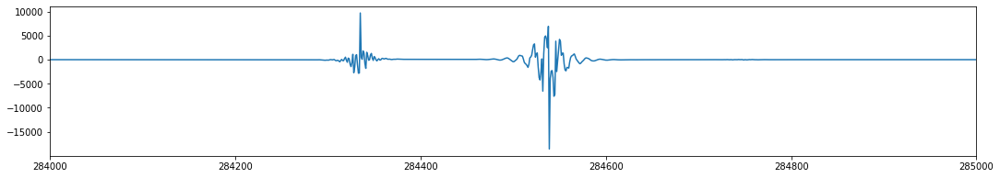

In [37]:
import matplotlib.pyplot as plt
plt.figure(figsize=(18, 3))
plt.plot(np.fft.fftshift(np.fft.fft(y)))
plt.xlim(2.84e5, 2.85e5)